# Temperature & Radius analysis

Created on 01 March 2020 for the Pentatrap experiment

@author: Menno Door<br>
@contact: door+fticr@mpi-k.de<br>
@license: MIT license

### Requirements:

The following code was written for Python 3.7/3.8. The required libraries are listed below with a rough description for their task in the code.

    fhds (inhouse data storage, https://git.mpi-hd.mpg.de/Pentatrap/fhds)
    h5py (data storage, easier to distribute)
    pandas (data organisation, calculation and visualization)
    numpy (calculation)
    matplotlib (plotting)
    scipy (chi square fitting)
    jupyter (Python notebook environment)
    ipywidgets (https://ipywidgets.readthedocs.io/en/latest/user_install.html)
    plotly (plotting, https://github.com/plotly/plotly.py#installation)
    qgrid (data visualization, https://github.com/quantopian/qgrid#installation)

### Remarks and TODOs

- this should work for magnetron as well as for cyclotron (be aware of B2 for cyclotron!)
- please be aware that I at the end only use the c4 shift, maybe you want to integrate higher order shifts as well as B2


In [1]:
# standard libs
from datetime import datetime
from pathlib import Path
import os, json
from pprint import pprint

# math and data
import numpy as np
import scipy
import pandas as pd
import h5py
from uncertainties import ufloat, umath

# visualization
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
%matplotlib inline
import matplotlib.pyplot as plt
import qgrid
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode()
plt.rcParams['figure.figsize'] = (10, 4)

%load_ext autoreload
%autoreload 2

# this package
from fhds import fhds, interface
from fticr_toolkit import *
from trap_control import fitaxialClass
from fticr_toolkit.fitaxial import mennofit
from fticr_toolkit.fit_dip import fit_dip as fit_dip_alex
from fticr_toolkit.fit_dip import fit_double_dip as fit_double_alex
from fticr_toolkit.fit_dip import dip_func as dip_func_alex 


### Step 1: Load raw data and inspect

The input_data filename should be either a folder following fhds rules (append ".fhds" to the folder name please) or a hdf5 file.

In [2]:
###   P A R A M E T E R   L I S T   ( this is especially used for batch processing using the papermill package )
measurement_folder = 'E:\\local_analysis\\Yb_CHAR_after_varactor_upgrade\\CHAR_DipFit_Systematics_both_traps_varactor_shifts'
input_file = 'Coilpulling_6.fhds'
output_folder = "./part1_data/"
use_settings_file = False
settings = {
    "reuse_fitdata": False,
}

In [3]:

data, meas_config, output_folder = data_conversion.load_data(measurement_folder=measurement_folder, 
                          input_data=input_file, 
                          output_folder="part1_data",
                          measurement_script = "coilpulling_wVAR"
                         )

if use_settings_file:
    settings.update( data_conversion.load_settings(measurement_folder) )
print("settings", settings)

#pprint(meas_config)
data_root = data["meas_data"]



 >>> WARNING!!! output_folder already exists! files will maybe be overwritten! <<< 


 >>> I hope you are in PART1, loading raw measurement data now... <<< 

settings {'reuse_fitdata': False}


In [4]:
####
# Chech the data structure, cycles and such
#
####

data = list(data_root.keys())
print("root group names / MAIN CYCLES : ", data )


root group names / MAIN CYCLES :  ['nuz_trap2_dUvar-0.001_1.spec', 'nuz_trap2_dUvar-0.001_10.spec', 'nuz_trap2_dUvar-0.001_11.spec', 'nuz_trap2_dUvar-0.001_12.spec', 'nuz_trap2_dUvar-0.001_13.spec', 'nuz_trap2_dUvar-0.001_14.spec', 'nuz_trap2_dUvar-0.001_15.spec', 'nuz_trap2_dUvar-0.001_16.spec', 'nuz_trap2_dUvar-0.001_17.spec', 'nuz_trap2_dUvar-0.001_18.spec', 'nuz_trap2_dUvar-0.001_19.spec', 'nuz_trap2_dUvar-0.001_2.spec', 'nuz_trap2_dUvar-0.001_20.spec', 'nuz_trap2_dUvar-0.001_21.spec', 'nuz_trap2_dUvar-0.001_22.spec', 'nuz_trap2_dUvar-0.001_23.spec', 'nuz_trap2_dUvar-0.001_24.spec', 'nuz_trap2_dUvar-0.001_25.spec', 'nuz_trap2_dUvar-0.001_26.spec', 'nuz_trap2_dUvar-0.001_27.spec', 'nuz_trap2_dUvar-0.001_28.spec', 'nuz_trap2_dUvar-0.001_29.spec', 'nuz_trap2_dUvar-0.001_3.spec', 'nuz_trap2_dUvar-0.001_30.spec', 'nuz_trap2_dUvar-0.001_31.spec', 'nuz_trap2_dUvar-0.001_32.spec', 'nuz_trap2_dUvar-0.001_33.spec', 'nuz_trap2_dUvar-0.001_34.spec', 'nuz_trap2_dUvar-0.001_35.spec', 'nuz_trap2_

In [5]:
## get the keys of the data we are intereseted in...

#raw_data_keys = data_conversion.get_data_paths( data_root, attr_type = ("amplitude", "phase") ) # super slow in fhds since all meta json files have to be read
raw_data_keys = data_conversion.get_data_paths( data_root, name_includes= ("amplitude") )
#pprint(raw_data_keys)

In [6]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.

@interact
def spectrum_plot(key=raw_data_keys, center = widgets.FloatText(0), span = widgets.FloatText(100), downsample_factor = widgets.IntText(1)):
    try:        
        spec = data_conversion.Spectrum(data_root[key])
        #print(spec.attrs.keys())
        trap = spec.attrs["trap"][-1]
        
        if center == 0:
            center = meas_config['traps'][int(trap)]['nu_z']
        
        spec.cut(center, span)
        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
        
        #print(data_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=2)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+str(spec.attrs["trap"]))
        #print(dict(spec.attrs))
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        #raise
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('/nuz_trap2_dUvar-0.001_1.spec', '/nuz_trap2_dUvar-…

### Step 2: Fit axial dip, all 10 averages

The **structure** is main cycle / subcycle (typ. 25) / position (typ. 2) / trap (typ. 2) / spectra (typ. 10). **If this changes you have to modify the loop!**

In [7]:
# refresher:
#print("data : ", data )
print("len data : ", len(data) )
#print("TRAP : ", trap)

len data :  1948


In [8]:
# fit settings

old_fit_confs = {
    2: {
        "center" :  meas_config['traps'][2]['nu_z'],
        "dip_center":  meas_config['traps'][2]['nu_z'],
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    },
    3: {
        "center" :  meas_config['traps'][3]['nu_z'],
        "dip_center":  meas_config['traps'][3]['nu_z'],
        "res_span" : 2000, 
        "span" : 5, 
        "q_guess" : 4200, 
        "dip_range" : 1, 
        "width_range" : [0.5,10]
    }
}

print(old_fit_confs)
    
# DANIELS FIT
DL_fit_confs = {
    2: {
        "res_span": 4000,
        "dip_span": 20,
        'min_dip_width': 0.5
    },
    3: {
        "res_span": 4000,
        "dip_span": 100,
        "supress_dispersive": False, 
        'min_dip_width': 1.5
    }
}
    
print(DL_fit_confs)

{2: {'center': 702557.54, 'dip_center': 702557.54, 'res_span': 2000, 'span': 5, 'q_guess': 4200, 'dip_range': 1, 'width_range': [0.5, 10]}, 3: {'center': 472036.93, 'dip_center': 472036.93, 'res_span': 2000, 'span': 5, 'q_guess': 4200, 'dip_range': 1, 'width_range': [0.5, 10]}}
{2: {'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}, 3: {'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}}


/nuz_trap2_dUvar-0.001_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408


/nuz_trap2_dUvar-0.001_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834


/nuz_trap2_dUvar-0.001_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174


/nuz_trap2_dUvar-0.001_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802


/nuz_trap2_dUvar-0.001_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744


/nuz_trap2_dUvar-0.001_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192


/nuz_trap2_dUvar-0.001_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020


/nuz_trap2_dUvar-0.001_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079


/nuz_trap2_dUvar-0.001_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405


/nuz_trap2_dUvar-0.001_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_25.spec


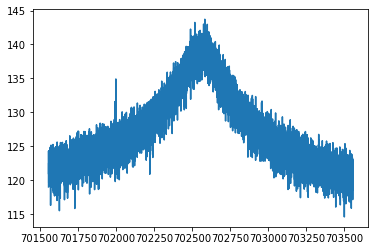

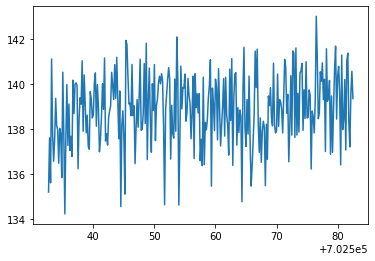

/nuz_trap2_dUvar-0.001_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_26.spec


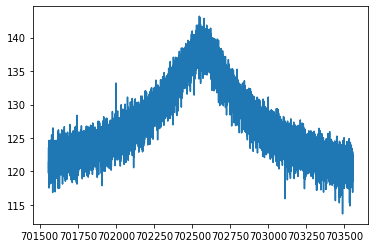

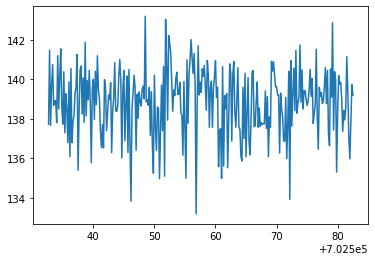

/nuz_trap2_dUvar-0.001_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_27.spec


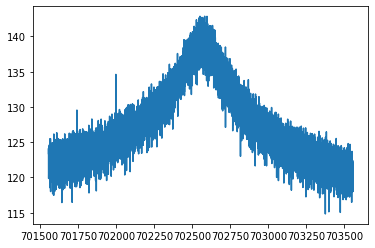

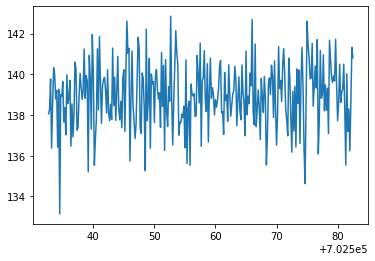

/nuz_trap2_dUvar-0.001_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_28.spec


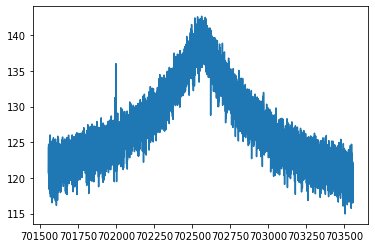

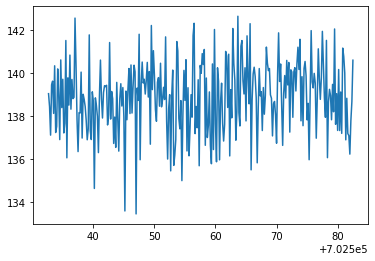

/nuz_trap2_dUvar-0.001_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_29.spec


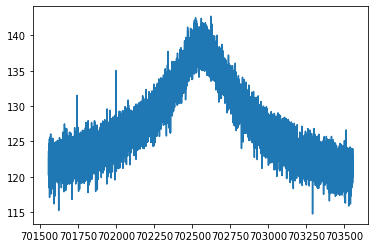

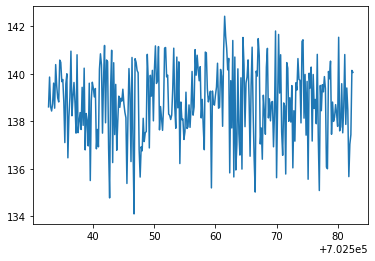

/nuz_trap2_dUvar-0.001_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_30.spec


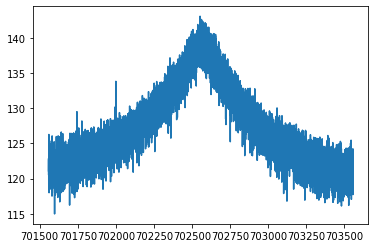

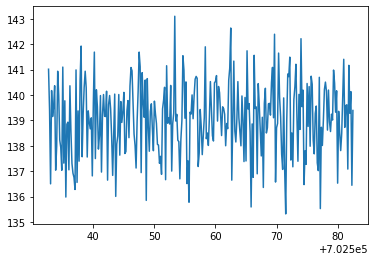

/nuz_trap2_dUvar-0.001_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_31.spec


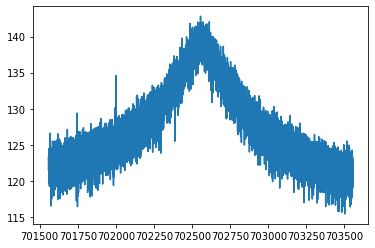

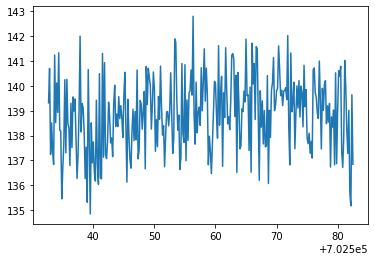

/nuz_trap2_dUvar-0.001_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_32.spec


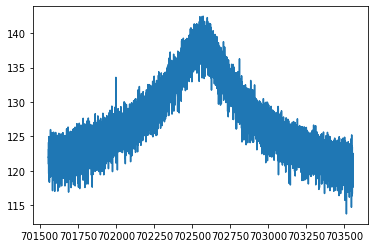

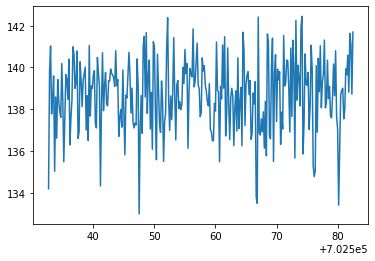

/nuz_trap2_dUvar-0.001_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_33.spec


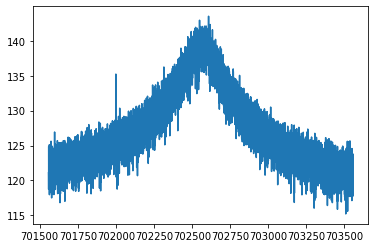

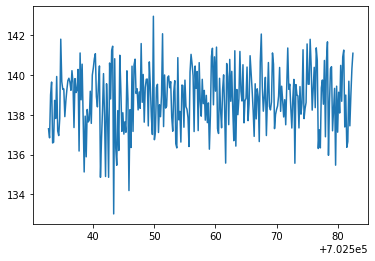

/nuz_trap2_dUvar-0.001_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_34.spec


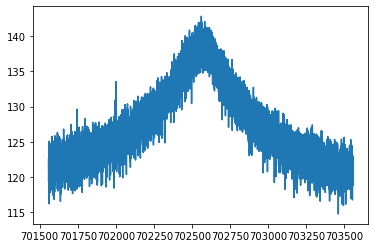

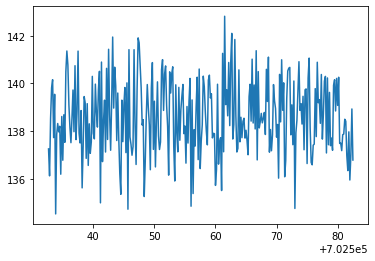

/nuz_trap2_dUvar-0.001_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_35.spec


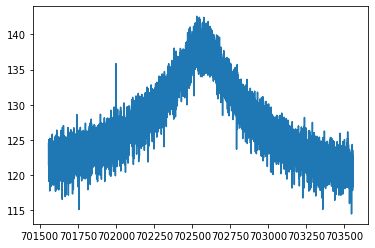

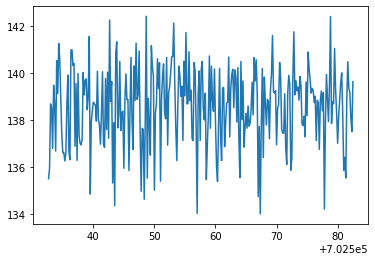

/nuz_trap2_dUvar-0.001_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_36.spec


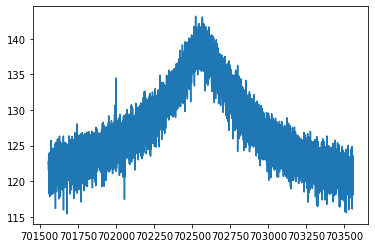

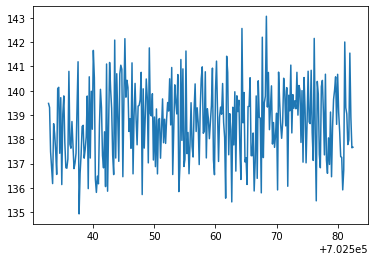

/nuz_trap2_dUvar-0.001_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_37.spec


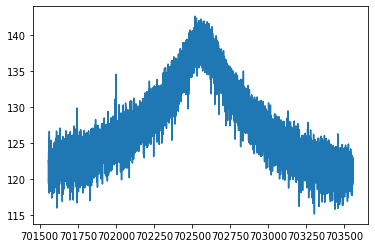

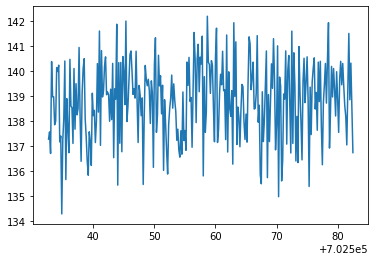

/nuz_trap2_dUvar-0.001_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_38.spec


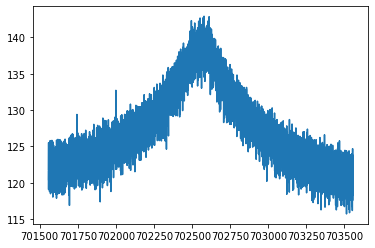

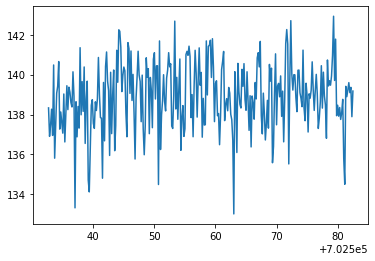

/nuz_trap2_dUvar-0.001_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_39.spec


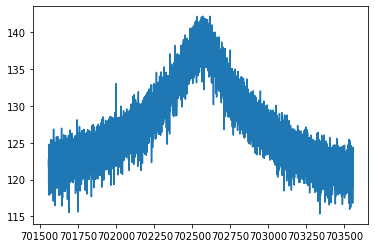

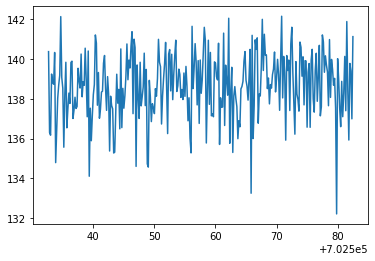

/nuz_trap2_dUvar-0.001_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_40.spec


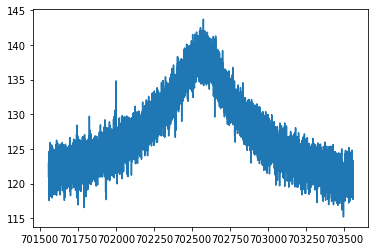

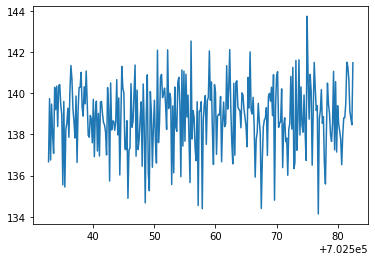

/nuz_trap2_dUvar-0.001_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.001_41.spec


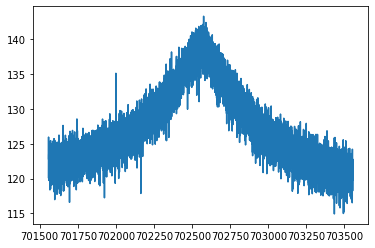

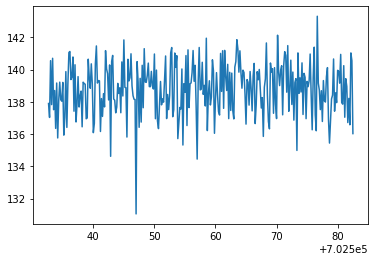

/nuz_trap2_dUvar-0.001_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.001_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_25.spec


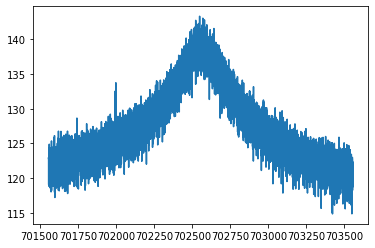

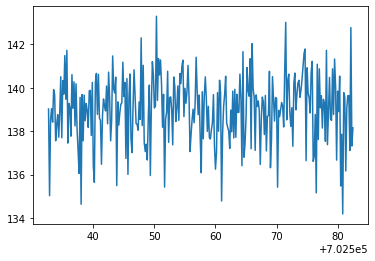

/nuz_trap2_dUvar-0.002_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_26.spec


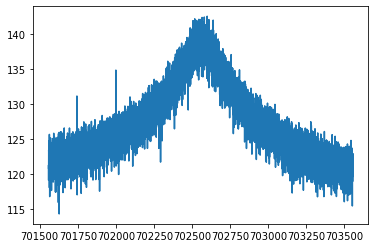

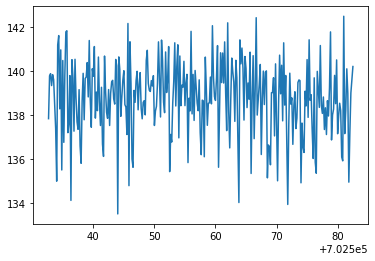

/nuz_trap2_dUvar-0.002_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_27.spec


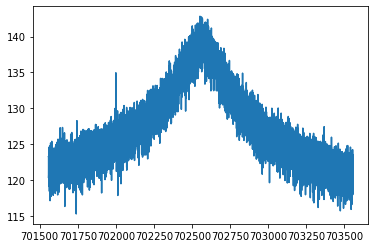

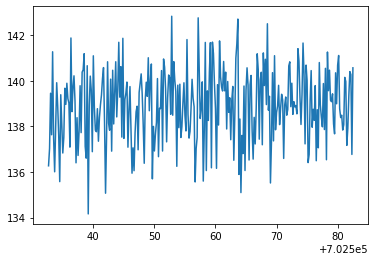

/nuz_trap2_dUvar-0.002_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_28.spec


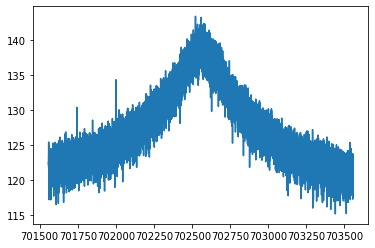

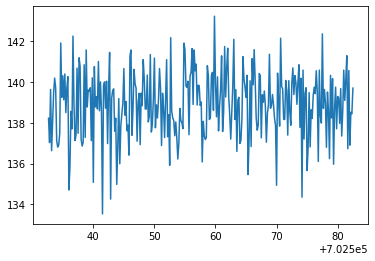

/nuz_trap2_dUvar-0.002_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_29.spec


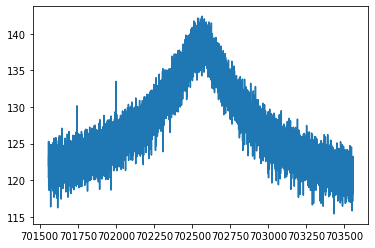

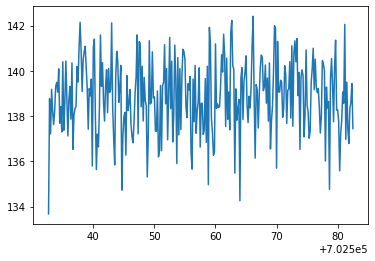

/nuz_trap2_dUvar-0.002_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_30.spec


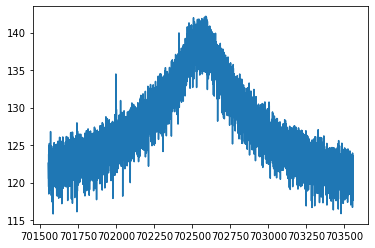

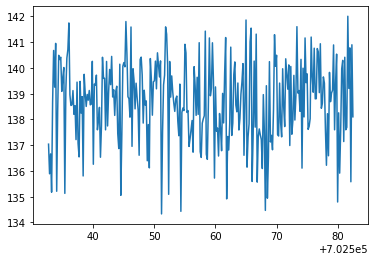

/nuz_trap2_dUvar-0.002_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_31.spec


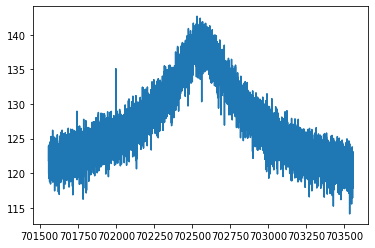

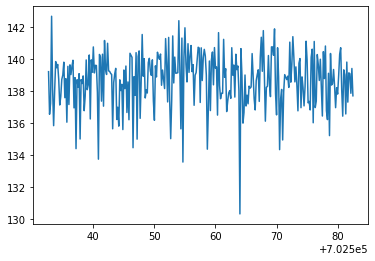

/nuz_trap2_dUvar-0.002_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_32.spec


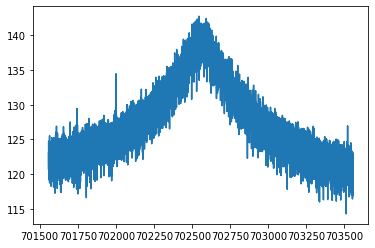

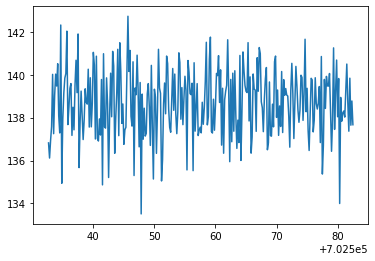

/nuz_trap2_dUvar-0.002_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_33.spec


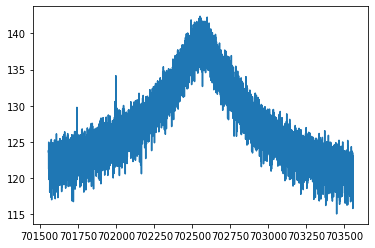

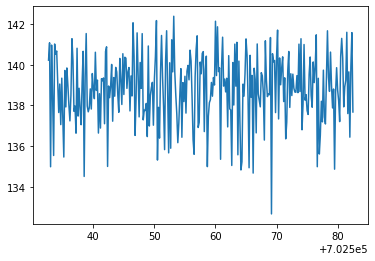

/nuz_trap2_dUvar-0.002_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_34.spec


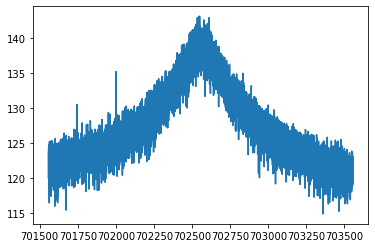

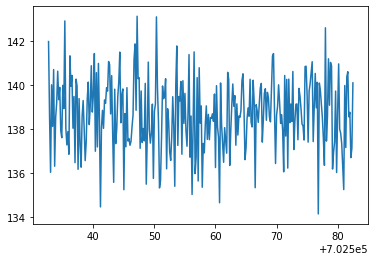

/nuz_trap2_dUvar-0.002_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_35.spec


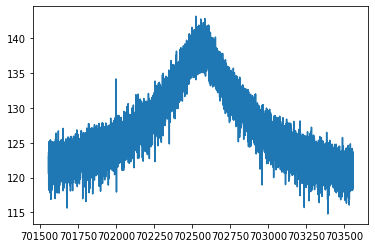

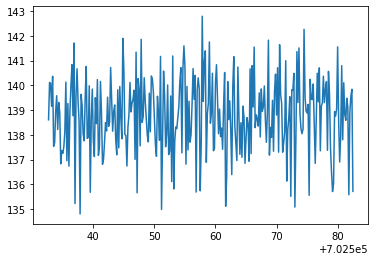

/nuz_trap2_dUvar-0.002_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_36.spec


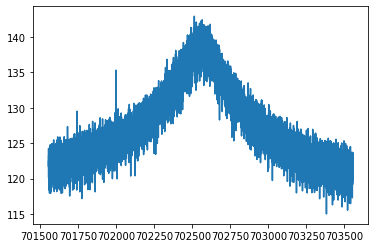

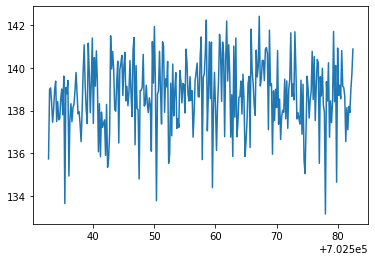

/nuz_trap2_dUvar-0.002_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_37.spec


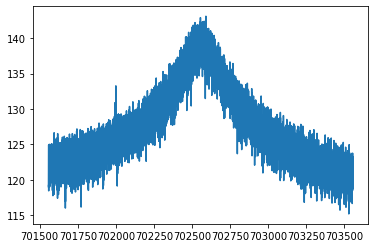

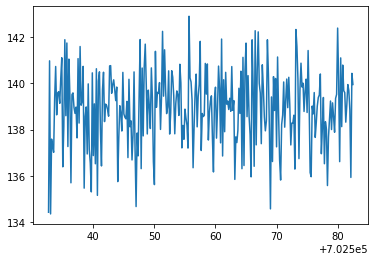

/nuz_trap2_dUvar-0.002_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_38.spec


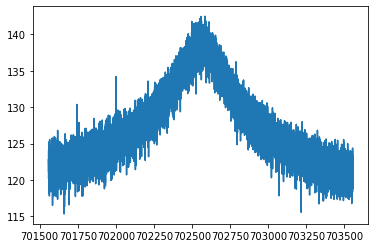

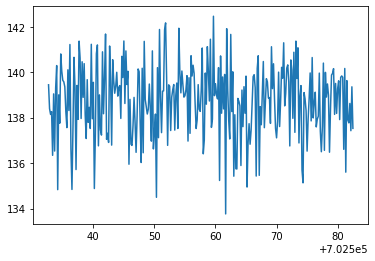

/nuz_trap2_dUvar-0.002_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_39.spec


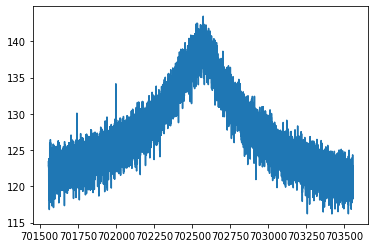

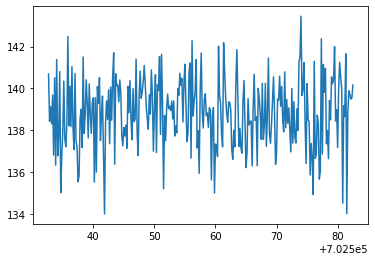

/nuz_trap2_dUvar-0.002_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_40.spec


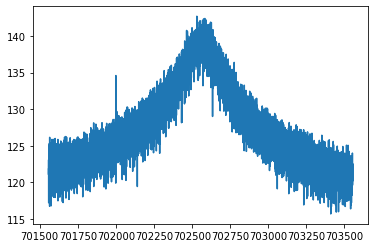

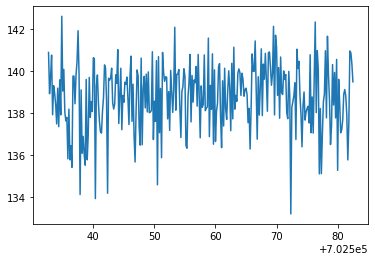

/nuz_trap2_dUvar-0.002_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.002_41.spec


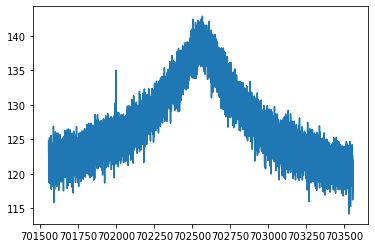

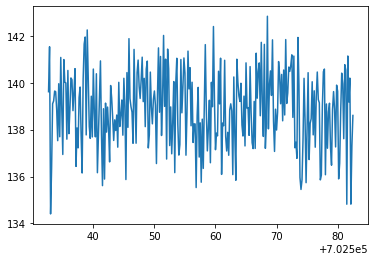

/nuz_trap2_dUvar-0.002_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.002_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
5,14,20220515_082510.969069,-0.001,2,702557.596997741144,0.034532439793,4.216480539693,0.308815325537,3.239598925917,702567.074604859576,6.322333770749,3497.466486841127,30.009781261192
6,15,20220515_084231.906903,-0.001,2,702557.597558183130,0.031132406622,4.384144394328,0.282988948121,2.534782340713,702559.086343689472,5.427403897419,3532.328002615541,30.646088387020
7,16,20220515_091533.527552,-0.001,2,702557.603254994960,0.029792837873,3.757462004530,0.258912157257,2.754192027269,702566.274069611914,6.050598883401,3507.476786809049,30.141850032079
8,17,20220515_100652.184278,-0.001,2,702557.567727978458,0.024345959049,3.618114069038,0.214458970948,2.009542588343,702559.407523197471,5.296072694952,3436.897224330904,29.163780758405
9,18,20220515_102808.412130,-0.001,2,702557.548839443480,0.033612100786,3.704823113430,0.282538134517,3.301514687465,702560.000870942953,6.634890475236,3516.518618400158,29.963439064724


/nuz_trap2_dUvar-0.003_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
56,17,20220515_093649.746755,-0.003,2,702557.574741372722,0.032565621234,4.193146561539,0.294254936315,2.964787897413,702558.746261706227,5.930356053747,3548.331796957800,30.279314757029
57,18,20220515_100832.764318,-0.003,2,702557.719188491697,0.028526774176,3.681651477073,0.246669131516,2.567853255032,702555.720163501333,6.020601303528,3402.374696786418,28.543036015873
58,19,20220515_105042.989795,-0.003,2,702557.647402853821,0.033696993197,3.893066993098,0.287772505672,3.195358932027,702555.079840850318,6.432170003355,3499.789497868871,30.173443824153
59,2,20220515_014632.312961,-0.003,2,702557.665869722143,0.030759682313,4.344084988236,0.272711020852,2.392425115702,702564.935965613462,5.466201387595,3433.259239196117,28.935301433267


/nuz_trap2_dUvar-0.003_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
57,18,20220515_100832.764318,-0.003,2,702557.719188491697,0.028526774176,3.681651477073,0.246669131516,2.567853255032,702555.720163501333,6.020601303528,3402.374696786418,28.543036015873
58,19,20220515_105042.989795,-0.003,2,702557.647402853821,0.033696993197,3.893066993098,0.287772505672,3.195358932027,702555.079840850318,6.432170003355,3499.789497868871,30.173443824153
59,2,20220515_014632.312961,-0.003,2,702557.665869722143,0.030759682313,4.344084988236,0.272711020852,2.392425115702,702564.935965613462,5.466201387595,3433.259239196117,28.935301433267
60,20,20220515_111435.876225,-0.003,2,702557.549294062541,0.032279202793,3.576666286454,0.270110476727,3.198351100852,702563.387889732025,6.724090797147,3460.863237285370,29.563205565923


/nuz_trap2_dUvar-0.003_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
58,19,20220515_105042.989795,-0.003,2,702557.647402853821,0.033696993197,3.893066993098,0.287772505672,3.195358932027,702555.079840850318,6.432170003355,3499.789497868871,30.173443824153
59,2,20220515_014632.312961,-0.003,2,702557.665869722143,0.030759682313,4.344084988236,0.272711020852,2.392425115702,702564.935965613462,5.466201387595,3433.259239196117,28.935301433267
60,20,20220515_111435.876225,-0.003,2,702557.549294062541,0.032279202793,3.576666286454,0.270110476727,3.198351100852,702563.387889732025,6.724090797147,3460.863237285370,29.563205565923
61,21,20220515_115409.261107,-0.003,2,702557.683885167236,0.028974274766,3.936982150537,0.246523465319,2.292176468733,702554.961377627449,5.315051674537,3583.796100100198,31.712550779441


/nuz_trap2_dUvar-0.003_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,2,20220515_014632.312961,-0.003,2,702557.665869722143,0.030759682313,4.344084988236,0.272711020852,2.392425115702,702564.935965613462,5.466201387595,3433.259239196117,28.935301433267
60,20,20220515_111435.876225,-0.003,2,702557.549294062541,0.032279202793,3.576666286454,0.270110476727,3.198351100852,702563.387889732025,6.724090797147,3460.863237285370,29.563205565923
61,21,20220515_115409.261107,-0.003,2,702557.683885167236,0.028974274766,3.936982150537,0.246523465319,2.292176468733,702554.961377627449,5.315051674537,3583.796100100198,31.712550779441
62,22,20220515_123106.043229,-0.003,2,702557.488058939809,0.029907288499,3.375400485631,0.239584901010,2.769515584867,702564.219334195484,6.325426062485,3517.620250511799,30.143772784348


/nuz_trap2_dUvar-0.003_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,20,20220515_111435.876225,-0.003,2,702557.549294062541,0.032279202793,3.576666286454,0.270110476727,3.198351100852,702563.387889732025,6.724090797147,3460.863237285370,29.563205565923
61,21,20220515_115409.261107,-0.003,2,702557.683885167236,0.028974274766,3.936982150537,0.246523465319,2.292176468733,702554.961377627449,5.315051674537,3583.796100100198,31.712550779441
62,22,20220515_123106.043229,-0.003,2,702557.488058939809,0.029907288499,3.375400485631,0.239584901010,2.769515584867,702564.219334195484,6.325426062485,3517.620250511799,30.143772784348
63,23,20220515_131711.271761,-0.003,2,702557.562229833798,0.031990613092,3.692684688754,0.265798197880,2.915077757862,702552.567965194234,6.287288252000,3501.327859430472,30.614213692375


/nuz_trap2_dUvar-0.003_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_25.spec


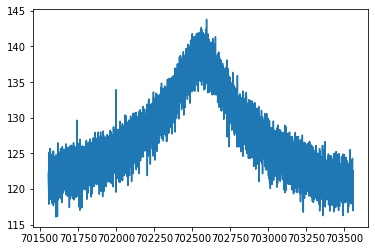

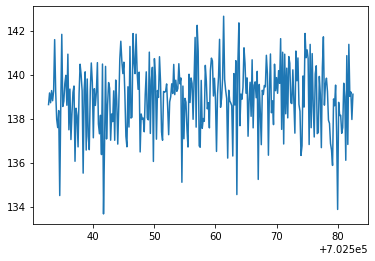

/nuz_trap2_dUvar-0.003_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_26.spec


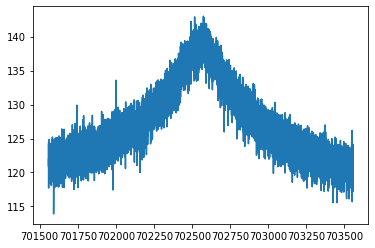

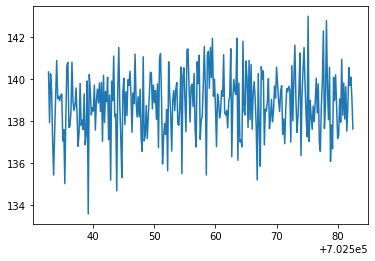

/nuz_trap2_dUvar-0.003_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_27.spec


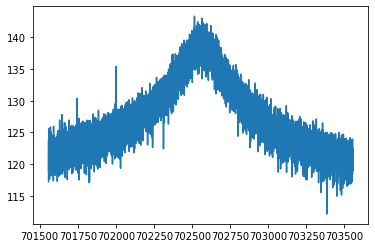

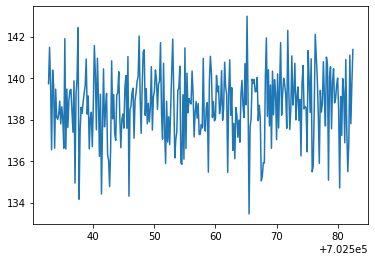

/nuz_trap2_dUvar-0.003_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_28.spec


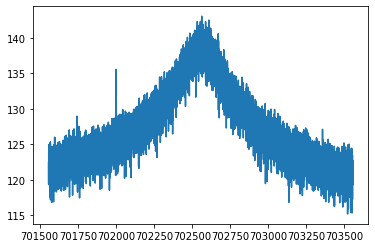

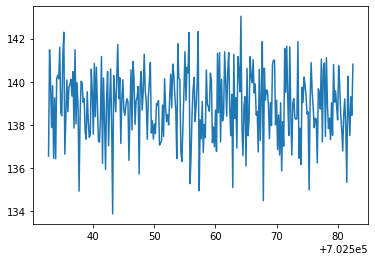

/nuz_trap2_dUvar-0.003_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_29.spec


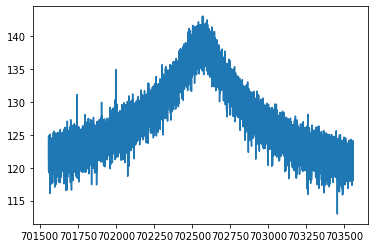

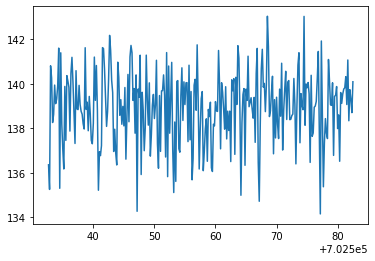

/nuz_trap2_dUvar-0.003_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,21,20220515_115409.261107,-0.003,2,702557.683885167236,0.028974274766,3.936982150537,0.246523465319,2.292176468733,702554.961377627449,5.315051674537,3583.796100100198,31.712550779441
62,22,20220515_123106.043229,-0.003,2,702557.488058939809,0.029907288499,3.375400485631,0.239584901010,2.769515584867,702564.219334195484,6.325426062485,3517.620250511799,30.143772784348
63,23,20220515_131711.271761,-0.003,2,702557.562229833798,0.031990613092,3.692684688754,0.265798197880,2.915077757862,702552.567965194234,6.287288252000,3501.327859430472,30.614213692375
64,24,20220515_134222.586361,-0.003,2,702557.710179128335,0.037014239118,3.913737684219,0.314403648130,3.736285217133,702559.750235946150,6.988282119609,3479.974005664033,30.318681831197


/nuz_trap2_dUvar-0.003_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_30.spec


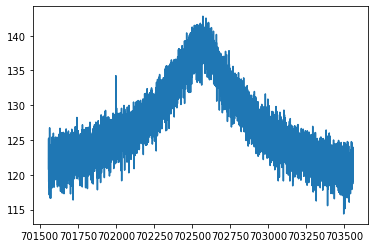

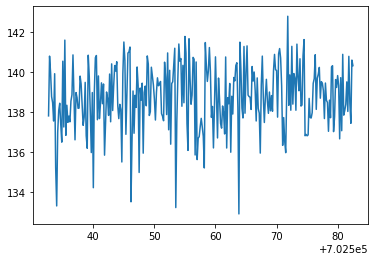

/nuz_trap2_dUvar-0.003_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_31.spec


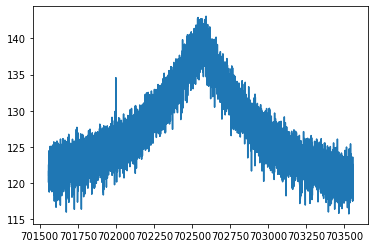

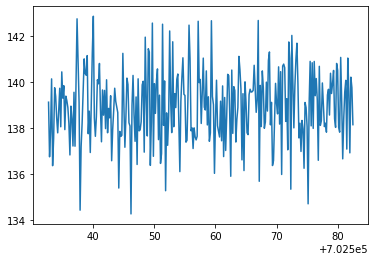

/nuz_trap2_dUvar-0.003_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_32.spec


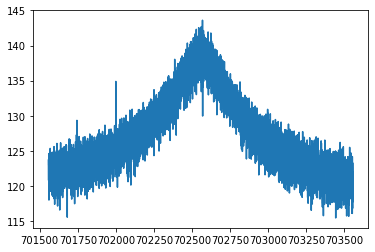

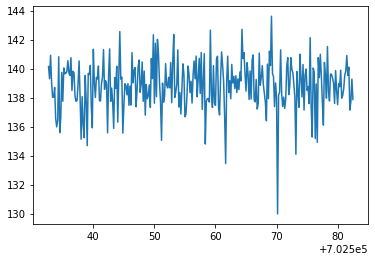

/nuz_trap2_dUvar-0.003_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_33.spec


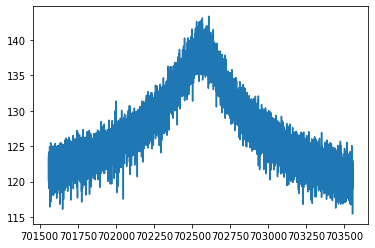

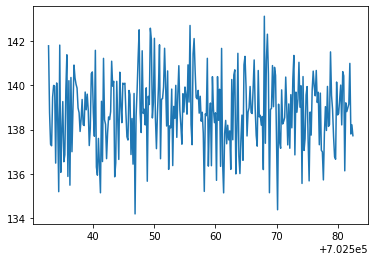

/nuz_trap2_dUvar-0.003_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_34.spec


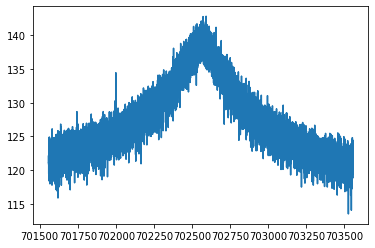

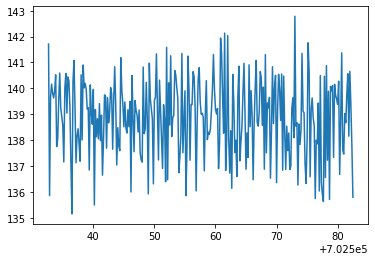

/nuz_trap2_dUvar-0.003_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_35.spec


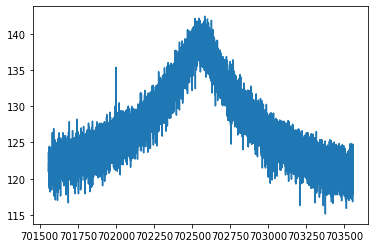

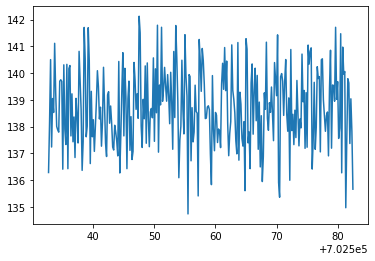

/nuz_trap2_dUvar-0.003_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_36.spec


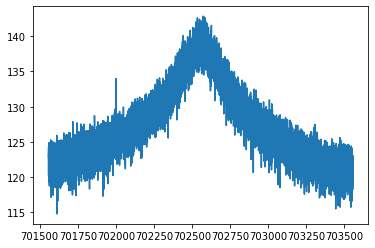

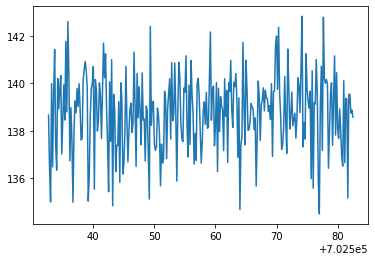

/nuz_trap2_dUvar-0.003_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_37.spec


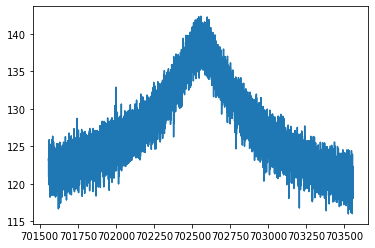

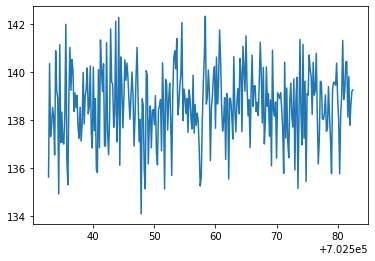

/nuz_trap2_dUvar-0.003_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_38.spec


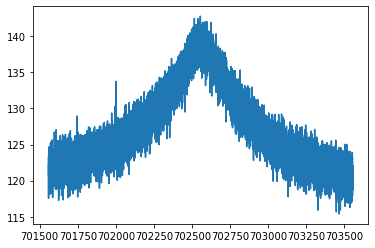

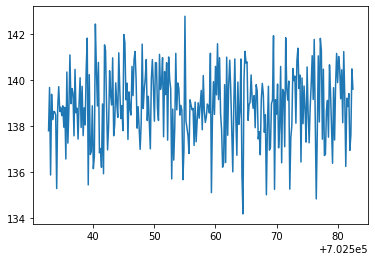

/nuz_trap2_dUvar-0.003_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_39.spec


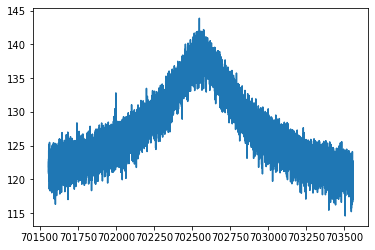

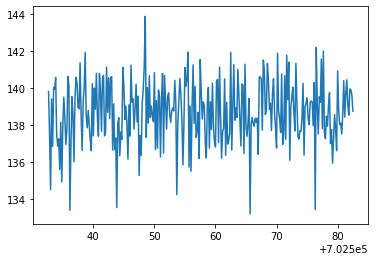

/nuz_trap2_dUvar-0.003_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
62,22,20220515_123106.043229,-0.003,2,702557.488058939809,0.029907288499,3.375400485631,0.239584901010,2.769515584867,702564.219334195484,6.325426062485,3517.620250511799,30.143772784348
63,23,20220515_131711.271761,-0.003,2,702557.562229833798,0.031990613092,3.692684688754,0.265798197880,2.915077757862,702552.567965194234,6.287288252000,3501.327859430472,30.614213692375
64,24,20220515_134222.586361,-0.003,2,702557.710179128335,0.037014239118,3.913737684219,0.314403648130,3.736285217133,702559.750235946150,6.988282119609,3479.974005664033,30.318681831197
65,3,20220515_021929.046039,-0.003,2,702557.582045433577,0.030947288681,4.390433045394,0.271328287409,2.295301833929,702563.120732614305,5.013675204772,3676.374629271590,33.117463077447


/nuz_trap2_dUvar-0.003_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_40.spec


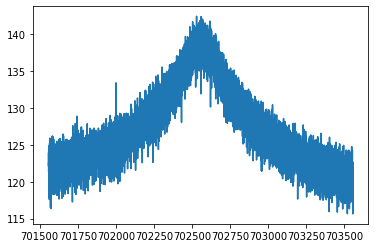

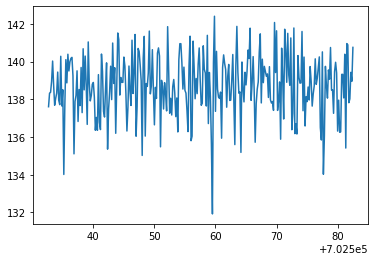

/nuz_trap2_dUvar-0.003_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.003_41.spec


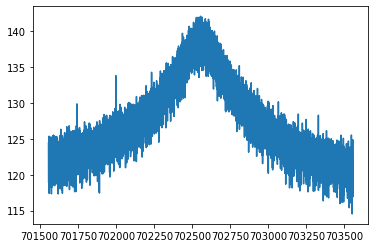

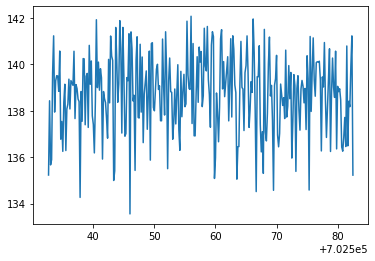

/nuz_trap2_dUvar-0.003_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,23,20220515_131711.271761,-0.003,2,702557.562229833798,0.031990613092,3.692684688754,0.265798197880,2.915077757862,702552.567965194234,6.287288252000,3501.327859430472,30.614213692375
64,24,20220515_134222.586361,-0.003,2,702557.710179128335,0.037014239118,3.913737684219,0.314403648130,3.736285217133,702559.750235946150,6.988282119609,3479.974005664033,30.318681831197
65,3,20220515_021929.046039,-0.003,2,702557.582045433577,0.030947288681,4.390433045394,0.271328287409,2.295301833929,702563.120732614305,5.013675204772,3676.374629271590,33.117463077447
66,4,20220515_025337.557080,-0.003,2,702557.512004853343,0.031857282574,4.400180967266,0.294817079078,2.777237011387,702555.229048662819,5.723476590181,3489.952724669151,29.971625841589


/nuz_trap2_dUvar-0.003_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,24,20220515_134222.586361,-0.003,2,702557.710179128335,0.037014239118,3.913737684219,0.314403648130,3.736285217133,702559.750235946150,6.988282119609,3479.974005664033,30.318681831197
65,3,20220515_021929.046039,-0.003,2,702557.582045433577,0.030947288681,4.390433045394,0.271328287409,2.295301833929,702563.120732614305,5.013675204772,3676.374629271590,33.117463077447
66,4,20220515_025337.557080,-0.003,2,702557.512004853343,0.031857282574,4.400180967266,0.294817079078,2.777237011387,702555.229048662819,5.723476590181,3489.952724669151,29.971625841589
67,5,20220515_033429.227350,-0.003,2,702557.571103963070,0.033311759896,3.821505187338,0.272744015840,2.873708876845,702559.507384324213,5.951507611848,3645.389850811819,33.722078653612


/nuz_trap2_dUvar-0.003_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,3,20220515_021929.046039,-0.003,2,702557.582045433577,0.030947288681,4.390433045394,0.271328287409,2.295301833929,702563.120732614305,5.013675204772,3676.374629271590,33.117463077447
66,4,20220515_025337.557080,-0.003,2,702557.512004853343,0.031857282574,4.400180967266,0.294817079078,2.777237011387,702555.229048662819,5.723476590181,3489.952724669151,29.971625841589
67,5,20220515_033429.227350,-0.003,2,702557.571103963070,0.033311759896,3.821505187338,0.272744015840,2.873708876845,702559.507384324213,5.951507611848,3645.389850811819,33.722078653612
68,6,20220515_035150.285055,-0.003,2,702557.532216953579,0.028710512100,4.205458436972,0.259740899464,2.311362868677,702556.876654300489,5.336063220455,3470.848707597128,29.572183236370


/nuz_trap2_dUvar-0.003_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
66,4,20220515_025337.557080,-0.003,2,702557.512004853343,0.031857282574,4.400180967266,0.294817079078,2.777237011387,702555.229048662819,5.723476590181,3489.952724669151,29.971625841589
67,5,20220515_033429.227350,-0.003,2,702557.571103963070,0.033311759896,3.821505187338,0.272744015840,2.873708876845,702559.507384324213,5.951507611848,3645.389850811819,33.722078653612
68,6,20220515_035150.285055,-0.003,2,702557.532216953579,0.028710512100,4.205458436972,0.259740899464,2.311362868677,702556.876654300489,5.336063220455,3470.848707597128,29.572183236370
69,7,20220515_044427.450952,-0.003,2,702557.560279747820,0.031451826162,4.187384581714,0.287297022339,2.850955328576,702562.641971594421,5.943394442669,3468.312500132428,29.527579736802


/nuz_trap2_dUvar-0.003_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,5,20220515_033429.227350,-0.003,2,702557.571103963070,0.033311759896,3.821505187338,0.272744015840,2.873708876845,702559.507384324213,5.951507611848,3645.389850811819,33.722078653612
68,6,20220515_035150.285055,-0.003,2,702557.532216953579,0.028710512100,4.205458436972,0.259740899464,2.311362868677,702556.876654300489,5.336063220455,3470.848707597128,29.572183236370
69,7,20220515_044427.450952,-0.003,2,702557.560279747820,0.031451826162,4.187384581714,0.287297022339,2.850955328576,702562.641971594421,5.943394442669,3468.312500132428,29.527579736802
70,8,20220515_045358.276637,-0.003,2,702557.630701959017,0.029652910304,4.140225338303,0.260110128538,2.357300687638,702561.981557002058,5.409001521849,3496.463688697753,30.198284328095


/nuz_trap2_dUvar-0.004_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,6,20220515_035150.285055,-0.003,2,702557.532216953579,0.028710512100,4.205458436972,0.259740899464,2.311362868677,702556.876654300489,5.336063220455,3470.848707597128,29.572183236370
69,7,20220515_044427.450952,-0.003,2,702557.560279747820,0.031451826162,4.187384581714,0.287297022339,2.850955328576,702562.641971594421,5.943394442669,3468.312500132428,29.527579736802
70,8,20220515_045358.276637,-0.003,2,702557.630701959017,0.029652910304,4.140225338303,0.260110128538,2.357300687638,702561.981557002058,5.409001521849,3496.463688697753,30.198284328095
71,9,20220515_052304.674150,-0.003,2,702557.590254522045,0.029097116155,3.815726697978,0.253307884547,2.554461366727,702561.876435907907,5.782720995342,3500.131477581741,29.995706950053


/nuz_trap2_dUvar-0.004_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
69,7,20220515_044427.450952,-0.003,2,702557.560279747820,0.031451826162,4.187384581714,0.287297022339,2.850955328576,702562.641971594421,5.943394442669,3468.312500132428,29.527579736802
70,8,20220515_045358.276637,-0.003,2,702557.630701959017,0.029652910304,4.140225338303,0.260110128538,2.357300687638,702561.981557002058,5.409001521849,3496.463688697753,30.198284328095
71,9,20220515_052304.674150,-0.003,2,702557.590254522045,0.029097116155,3.815726697978,0.253307884547,2.554461366727,702561.876435907907,5.782720995342,3500.131477581741,29.995706950053
72,1,20220515_012913.716589,-0.004,2,702557.657329270616,0.031976789622,4.028323413767,0.269987897071,2.634315792130,702552.938691119780,5.585729468328,3642.478634660151,33.022676195452


/nuz_trap2_dUvar-0.004_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,8,20220515_045358.276637,-0.003,2,702557.630701959017,0.029652910304,4.140225338303,0.260110128538,2.357300687638,702561.981557002058,5.409001521849,3496.463688697753,30.198284328095
71,9,20220515_052304.674150,-0.003,2,702557.590254522045,0.029097116155,3.815726697978,0.253307884547,2.554461366727,702561.876435907907,5.782720995342,3500.131477581741,29.995706950053
72,1,20220515_012913.716589,-0.004,2,702557.657329270616,0.031976789622,4.028323413767,0.269987897071,2.634315792130,702552.938691119780,5.585729468328,3642.478634660151,33.022676195452
73,10,20220515_062331.903226,-0.004,2,702557.603296762332,0.030918182468,3.863054052133,0.270365919637,2.859286966734,702562.162447717856,6.157008515609,3458.594884848215,29.333162456068


/nuz_trap2_dUvar-0.004_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
71,9,20220515_052304.674150,-0.003,2,702557.590254522045,0.029097116155,3.815726697978,0.253307884547,2.554461366727,702561.876435907907,5.782720995342,3500.131477581741,29.995706950053
72,1,20220515_012913.716589,-0.004,2,702557.657329270616,0.031976789622,4.028323413767,0.269987897071,2.634315792130,702552.938691119780,5.585729468328,3642.478634660151,33.022676195452
73,10,20220515_062331.903226,-0.004,2,702557.603296762332,0.030918182468,3.863054052133,0.270365919637,2.859286966734,702562.162447717856,6.157008515609,3458.594884848215,29.333162456068
74,11,20220515_065633.271126,-0.004,2,702557.523792010150,0.033136834168,3.732022629073,0.270740998436,2.978272693779,702555.695565614616,6.117437153845,3636.762591973913,32.951921479051


/nuz_trap2_dUvar-0.004_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,1,20220515_012913.716589,-0.004,2,702557.657329270616,0.031976789622,4.028323413767,0.269987897071,2.634315792130,702552.938691119780,5.585729468328,3642.478634660151,33.022676195452
73,10,20220515_062331.903226,-0.004,2,702557.603296762332,0.030918182468,3.863054052133,0.270365919637,2.859286966734,702562.162447717856,6.157008515609,3458.594884848215,29.333162456068
74,11,20220515_065633.271126,-0.004,2,702557.523792010150,0.033136834168,3.732022629073,0.270740998436,2.978272693779,702555.695565614616,6.117437153845,3636.762591973913,32.951921479051
75,12,20220515_071631.149709,-0.004,2,702557.534844215144,0.037783837360,4.479805500667,0.339626210944,3.492235188674,702555.789122227347,6.444776661892,3470.153417132843,30.225439562668


/nuz_trap2_dUvar-0.004_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
73,10,20220515_062331.903226,-0.004,2,702557.603296762332,0.030918182468,3.863054052133,0.270365919637,2.859286966734,702562.162447717856,6.157008515609,3458.594884848215,29.333162456068
74,11,20220515_065633.271126,-0.004,2,702557.523792010150,0.033136834168,3.732022629073,0.270740998436,2.978272693779,702555.695565614616,6.117437153845,3636.762591973913,32.951921479051
75,12,20220515_071631.149709,-0.004,2,702557.534844215144,0.037783837360,4.479805500667,0.339626210944,3.492235188674,702555.789122227347,6.444776661892,3470.153417132843,30.225439562668
76,13,20220515_074024.039758,-0.004,2,702557.586943811737,0.032222426910,3.950083279826,0.284228636251,3.037235535354,702559.697270631441,6.366884659633,3410.772661366003,28.845730823350


/nuz_trap2_dUvar-0.004_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,11,20220515_065633.271126,-0.004,2,702557.523792010150,0.033136834168,3.732022629073,0.270740998436,2.978272693779,702555.695565614616,6.117437153845,3636.762591973913,32.951921479051
75,12,20220515_071631.149709,-0.004,2,702557.534844215144,0.037783837360,4.479805500667,0.339626210944,3.492235188674,702555.789122227347,6.444776661892,3470.153417132843,30.225439562668
76,13,20220515_074024.039758,-0.004,2,702557.586943811737,0.032222426910,3.950083279826,0.284228636251,3.037235535354,702559.697270631441,6.366884659633,3410.772661366003,28.845730823350
77,14,20220515_081325.551966,-0.004,2,702557.666292651091,0.032071261221,4.655609890697,0.295721785518,2.531380425500,702545.608457605704,5.288273303876,3596.244237900918,31.766328856209


/nuz_trap2_dUvar-0.004_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,12,20220515_071631.149709,-0.004,2,702557.534844215144,0.037783837360,4.479805500667,0.339626210944,3.492235188674,702555.789122227347,6.444776661892,3470.153417132843,30.225439562668
76,13,20220515_074024.039758,-0.004,2,702557.586943811737,0.032222426910,3.950083279826,0.284228636251,3.037235535354,702559.697270631441,6.366884659633,3410.772661366003,28.845730823350
77,14,20220515_081325.551966,-0.004,2,702557.666292651091,0.032071261221,4.655609890697,0.295721785518,2.531380425500,702545.608457605704,5.288273303876,3596.244237900918,31.766328856209
78,15,20220515_084508.639041,-0.004,2,702557.601695409045,0.031720356724,3.867725519368,0.277019731658,2.988804532298,702555.441900511272,6.304163531369,3447.810950889322,29.492971967725


/nuz_trap2_dUvar-0.004_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,13,20220515_074024.039758,-0.004,2,702557.586943811737,0.032222426910,3.950083279826,0.284228636251,3.037235535354,702559.697270631441,6.366884659633,3410.772661366003,28.845730823350
77,14,20220515_081325.551966,-0.004,2,702557.666292651091,0.032071261221,4.655609890697,0.295721785518,2.531380425500,702545.608457605704,5.288273303876,3596.244237900918,31.766328856209
78,15,20220515_084508.639041,-0.004,2,702557.601695409045,0.031720356724,3.867725519368,0.277019731658,2.988804532298,702555.441900511272,6.304163531369,3447.810950889322,29.492971967725
79,16,20220515_090901.694584,-0.004,2,702557.567889399943,0.035853431632,4.368666574431,0.331267956713,3.519686448061,702560.456351702800,6.440701361985,3502.909931450422,30.219722976265


/nuz_trap2_dUvar-0.004_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
77,14,20220515_081325.551966,-0.004,2,702557.666292651091,0.032071261221,4.655609890697,0.295721785518,2.531380425500,702545.608457605704,5.288273303876,3596.244237900918,31.766328856209
78,15,20220515_084508.639041,-0.004,2,702557.601695409045,0.031720356724,3.867725519368,0.277019731658,2.988804532298,702555.441900511272,6.304163531369,3447.810950889322,29.492971967725
79,16,20220515_090901.694584,-0.004,2,702557.567889399943,0.035853431632,4.368666574431,0.331267956713,3.519686448061,702560.456351702800,6.440701361985,3502.909931450422,30.219722976265
80,17,20220515_094203.203331,-0.004,2,702557.585201055859,0.033237232433,4.045127674047,0.292810163712,3.097929791311,702563.281404171837,6.302256633389,3465.648352880361,29.448165543274


/nuz_trap2_dUvar-0.004_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,15,20220515_084508.639041,-0.004,2,702557.601695409045,0.031720356724,3.867725519368,0.277019731658,2.988804532298,702555.441900511272,6.304163531369,3447.810950889322,29.492971967725
79,16,20220515_090901.694584,-0.004,2,702557.567889399943,0.035853431632,4.368666574431,0.331267956713,3.519686448061,702560.456351702800,6.440701361985,3502.909931450422,30.219722976265
80,17,20220515_094203.203331,-0.004,2,702557.585201055859,0.033237232433,4.045127674047,0.292810163712,3.097929791311,702563.281404171837,6.302256633389,3465.648352880361,29.448165543274
81,18,20220515_102531.674238,-0.004,2,702557.623361583799,0.030490785592,3.819793045723,0.260209418069,2.686582350661,702555.026530558942,5.905933731431,3519.830855493531,30.347606474204


/nuz_trap2_dUvar-0.004_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,16,20220515_090901.694584,-0.004,2,702557.567889399943,0.035853431632,4.368666574431,0.331267956713,3.519686448061,702560.456351702800,6.440701361985,3502.909931450422,30.219722976265
80,17,20220515_094203.203331,-0.004,2,702557.585201055859,0.033237232433,4.045127674047,0.292810163712,3.097929791311,702563.281404171837,6.302256633389,3465.648352880361,29.448165543274
81,18,20220515_102531.674238,-0.004,2,702557.623361583799,0.030490785592,3.819793045723,0.260209418069,2.686582350661,702555.026530558942,5.905933731431,3519.830855493531,30.347606474204
82,19,20220515_105951.604522,-0.004,2,702557.590919177746,0.029847898891,3.549513694785,0.252898322810,2.839676291664,702562.905779953115,6.406134639128,3422.250231772530,28.592844690100


/nuz_trap2_dUvar-0.004_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
80,17,20220515_094203.203331,-0.004,2,702557.585201055859,0.033237232433,4.045127674047,0.292810163712,3.097929791311,702563.281404171837,6.302256633389,3465.648352880361,29.448165543274
81,18,20220515_102531.674238,-0.004,2,702557.623361583799,0.030490785592,3.819793045723,0.260209418069,2.686582350661,702555.026530558942,5.905933731431,3519.830855493531,30.347606474204
82,19,20220515_105951.604522,-0.004,2,702557.590919177746,0.029847898891,3.549513694785,0.252898322810,2.839676291664,702562.905779953115,6.406134639128,3422.250231772530,28.592844690100
83,2,20220515_014237.761699,-0.004,2,702557.585203935741,0.027760538067,3.999846391155,0.247156880027,2.263617144728,702563.390137378126,5.363292569461,3491.053090858733,29.611788311070


/nuz_trap2_dUvar-0.004_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,18,20220515_102531.674238,-0.004,2,702557.623361583799,0.030490785592,3.819793045723,0.260209418069,2.686582350661,702555.026530558942,5.905933731431,3519.830855493531,30.347606474204
82,19,20220515_105951.604522,-0.004,2,702557.590919177746,0.029847898891,3.549513694785,0.252898322810,2.839676291664,702562.905779953115,6.406134639128,3422.250231772530,28.592844690100
83,2,20220515_014237.761699,-0.004,2,702557.585203935741,0.027760538067,3.999846391155,0.247156880027,2.263617144728,702563.390137378126,5.363292569461,3491.053090858733,29.611788311070
84,20,20220515_114043.339333,-0.004,2,702557.637883272837,0.031070148181,3.959576801247,0.265311878988,2.628869038444,702552.844766704482,5.824473753651,3490.882630118338,29.702921794206


/nuz_trap2_dUvar-0.004_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
82,19,20220515_105951.604522,-0.004,2,702557.590919177746,0.029847898891,3.549513694785,0.252898322810,2.839676291664,702562.905779953115,6.406134639128,3422.250231772530,28.592844690100
83,2,20220515_014237.761699,-0.004,2,702557.585203935741,0.027760538067,3.999846391155,0.247156880027,2.263617144728,702563.390137378126,5.363292569461,3491.053090858733,29.611788311070
84,20,20220515_114043.339333,-0.004,2,702557.637883272837,0.031070148181,3.959576801247,0.265311878988,2.628869038444,702552.844766704482,5.824473753651,3490.882630118338,29.702921794206
85,21,20220515_120159.538274,-0.004,2,702557.539447270101,0.031487835554,3.953400349813,0.274704038054,2.843495606922,702562.377029405441,6.053852146778,3484.610745947179,30.074025999544


/nuz_trap2_dUvar-0.004_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,2,20220515_014237.761699,-0.004,2,702557.585203935741,0.027760538067,3.999846391155,0.247156880027,2.263617144728,702563.390137378126,5.363292569461,3491.053090858733,29.611788311070
84,20,20220515_114043.339333,-0.004,2,702557.637883272837,0.031070148181,3.959576801247,0.265311878988,2.628869038444,702552.844766704482,5.824473753651,3490.882630118338,29.702921794206
85,21,20220515_120159.538274,-0.004,2,702557.539447270101,0.031487835554,3.953400349813,0.274704038054,2.843495606922,702562.377029405441,6.053852146778,3484.610745947179,30.074025999544
86,22,20220515_122039.071845,-0.004,2,702557.633047972457,0.032057160006,3.403646798744,0.244313473910,2.734024464404,702557.897293001530,6.162978926474,3602.034154461484,32.997657721743


/nuz_trap2_dUvar-0.004_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,20,20220515_114043.339333,-0.004,2,702557.637883272837,0.031070148181,3.959576801247,0.265311878988,2.628869038444,702552.844766704482,5.824473753651,3490.882630118338,29.702921794206
85,21,20220515_120159.538274,-0.004,2,702557.539447270101,0.031487835554,3.953400349813,0.274704038054,2.843495606922,702562.377029405441,6.053852146778,3484.610745947179,30.074025999544
86,22,20220515_122039.071845,-0.004,2,702557.633047972457,0.032057160006,3.403646798744,0.244313473910,2.734024464404,702557.897293001530,6.162978926474,3602.034154461484,32.997657721743
87,23,20220515_125340.552608,-0.004,2,702557.568241759203,0.028803565657,3.443405315196,0.244190546244,2.783677318364,702555.334275591536,6.275878388824,3495.157493628240,29.943314794499


/nuz_trap2_dUvar-0.004_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_25.spec


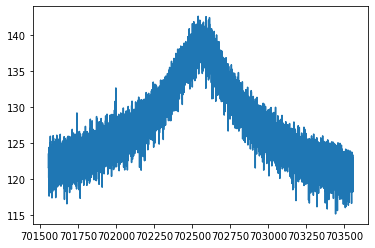

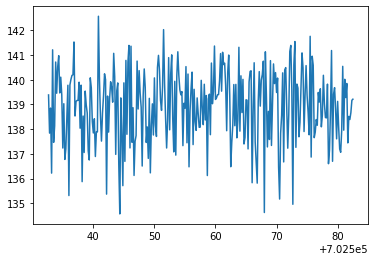

/nuz_trap2_dUvar-0.004_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_26.spec


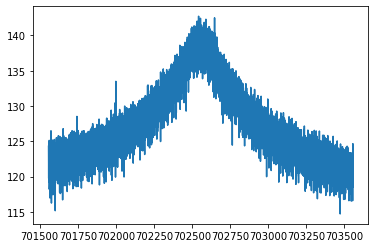

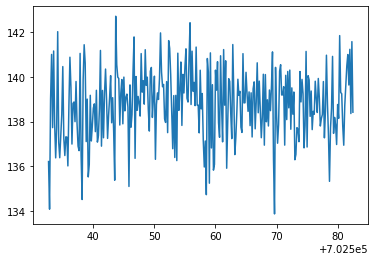

/nuz_trap2_dUvar-0.004_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_27.spec


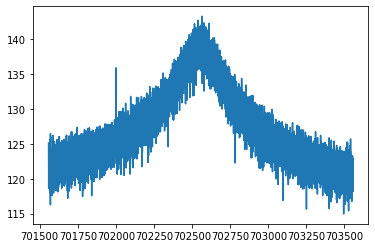

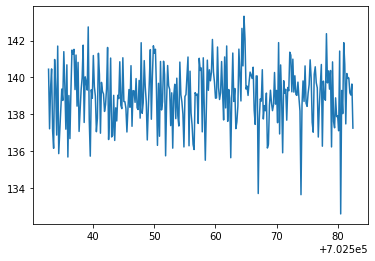

/nuz_trap2_dUvar-0.004_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_28.spec


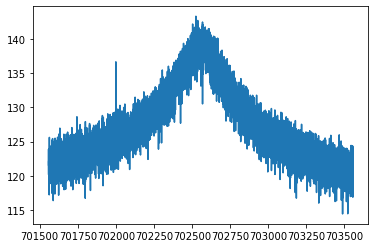

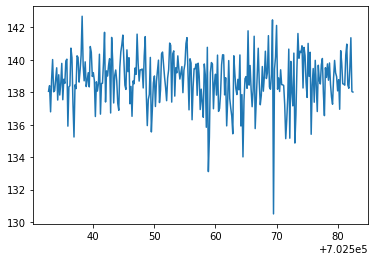

/nuz_trap2_dUvar-0.004_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_29.spec


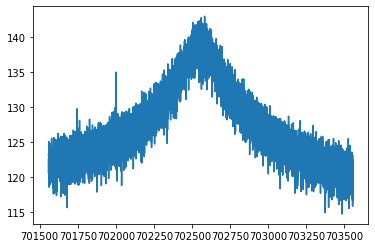

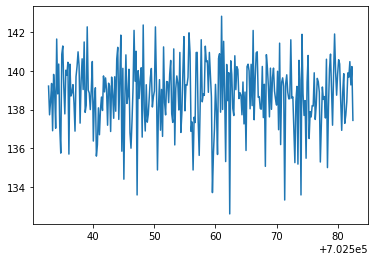

/nuz_trap2_dUvar-0.004_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,21,20220515_120159.538274,-0.004,2,702557.539447270101,0.031487835554,3.953400349813,0.274704038054,2.843495606922,702562.377029405441,6.053852146778,3484.610745947179,30.074025999544
86,22,20220515_122039.071845,-0.004,2,702557.633047972457,0.032057160006,3.403646798744,0.244313473910,2.734024464404,702557.897293001530,6.162978926474,3602.034154461484,32.997657721743
87,23,20220515_125340.552608,-0.004,2,702557.568241759203,0.028803565657,3.443405315196,0.244190546244,2.783677318364,702555.334275591536,6.275878388824,3495.157493628240,29.943314794499
88,24,20220515_133037.216325,-0.004,2,702557.575042866520,0.030122929213,3.497064393312,0.259232037245,3.081168163565,702563.764267569990,6.562639725661,3500.010589654653,29.759025399250


/nuz_trap2_dUvar-0.004_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_30.spec


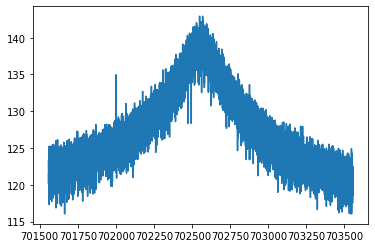

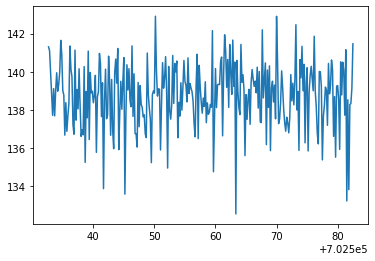

/nuz_trap2_dUvar-0.004_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_31.spec


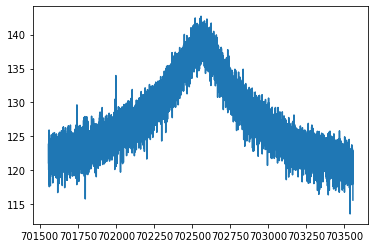

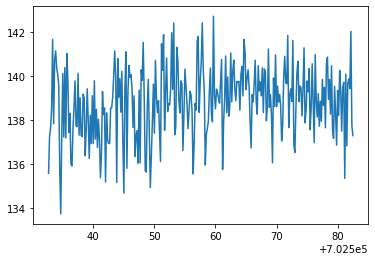

/nuz_trap2_dUvar-0.004_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_32.spec


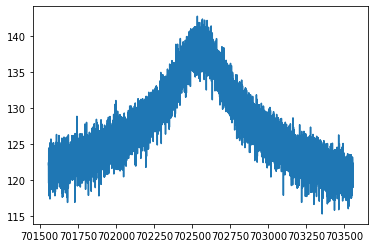

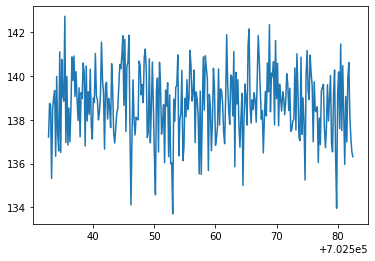

/nuz_trap2_dUvar-0.004_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_33.spec


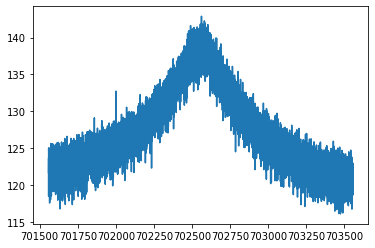

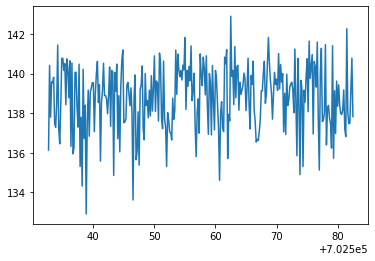

/nuz_trap2_dUvar-0.004_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_34.spec


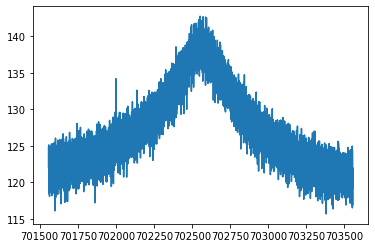

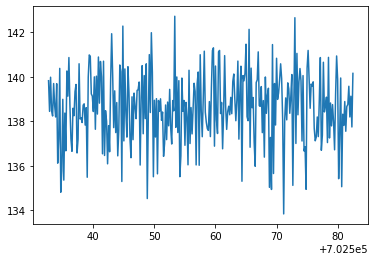

/nuz_trap2_dUvar-0.004_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_35.spec


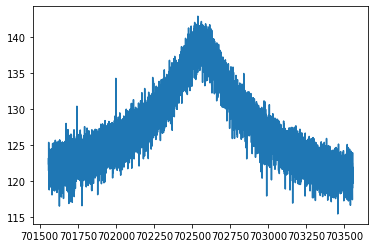

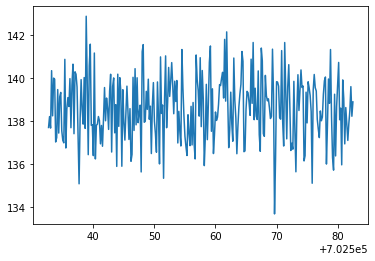

/nuz_trap2_dUvar-0.004_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_36.spec


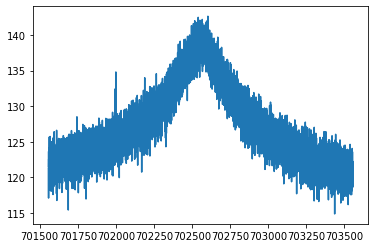

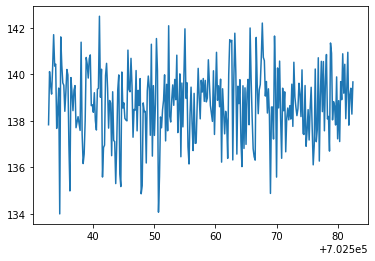

/nuz_trap2_dUvar-0.004_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_37.spec


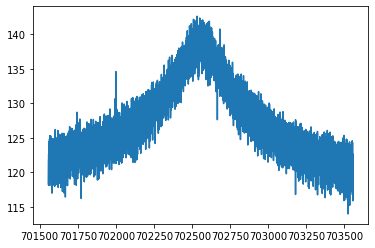

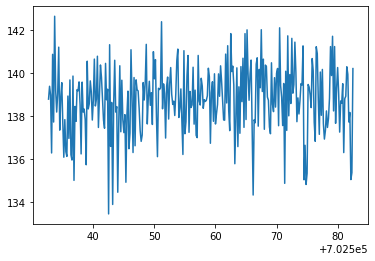

/nuz_trap2_dUvar-0.004_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_38.spec


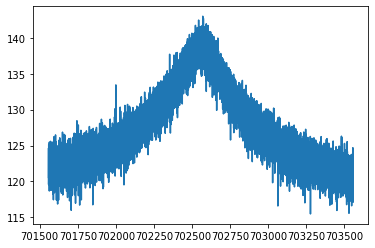

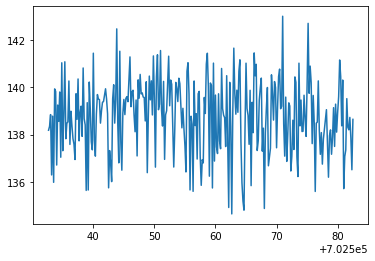

/nuz_trap2_dUvar-0.004_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_39.spec


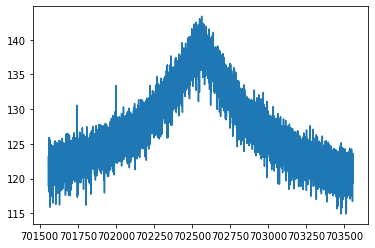

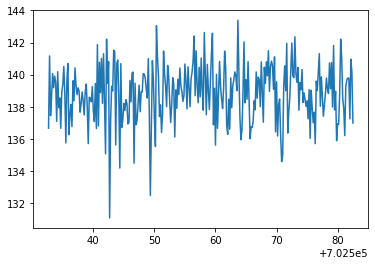

/nuz_trap2_dUvar-0.004_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
86,22,20220515_122039.071845,-0.004,2,702557.633047972457,0.032057160006,3.403646798744,0.244313473910,2.734024464404,702557.897293001530,6.162978926474,3602.034154461484,32.997657721743
87,23,20220515_125340.552608,-0.004,2,702557.568241759203,0.028803565657,3.443405315196,0.244190546244,2.783677318364,702555.334275591536,6.275878388824,3495.157493628240,29.943314794499
88,24,20220515_133037.216325,-0.004,2,702557.575042866520,0.030122929213,3.497064393312,0.259232037245,3.081168163565,702563.764267569990,6.562639725661,3500.010589654653,29.759025399250
89,3,20220515_024019.951984,-0.004,2,702557.661375080119,0.035753278425,4.503019715211,0.317182350827,3.014092468480,702558.906373011530,5.755342478941,3622.469999555480,32.869361069561


/nuz_trap2_dUvar-0.004_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.004_40.spec


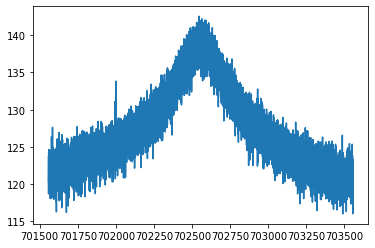

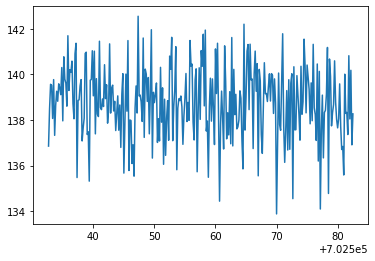

/nuz_trap2_dUvar-0.004_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
87,23,20220515_125340.552608,-0.004,2,702557.568241759203,0.028803565657,3.443405315196,0.244190546244,2.783677318364,702555.334275591536,6.275878388824,3495.157493628240,29.943314794499
88,24,20220515_133037.216325,-0.004,2,702557.575042866520,0.030122929213,3.497064393312,0.259232037245,3.081168163565,702563.764267569990,6.562639725661,3500.010589654653,29.759025399250
89,3,20220515_024019.951984,-0.004,2,702557.661375080119,0.035753278425,4.503019715211,0.317182350827,3.014092468480,702558.906373011530,5.755342478941,3622.469999555480,32.869361069561
90,4,20220515_030759.590008,-0.004,2,702557.566470405436,0.029064953886,3.692893621493,0.234237845997,2.229865640889,702556.848038902623,5.362288559456,3609.047020450808,33.955874510077


/nuz_trap2_dUvar-0.004_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
88,24,20220515_133037.216325,-0.004,2,702557.575042866520,0.030122929213,3.497064393312,0.259232037245,3.081168163565,702563.764267569990,6.562639725661,3500.010589654653,29.759025399250
89,3,20220515_024019.951984,-0.004,2,702557.661375080119,0.035753278425,4.503019715211,0.317182350827,3.014092468480,702558.906373011530,5.755342478941,3622.469999555480,32.869361069561
90,4,20220515_030759.590008,-0.004,2,702557.566470405436,0.029064953886,3.692893621493,0.234237845997,2.229865640889,702556.848038902623,5.362288559456,3609.047020450808,33.955874510077
91,5,20220515_033310.832979,-0.004,2,702557.598610099056,0.033937262968,3.660491502969,0.268399499506,2.952458199104,702553.991291057901,6.096675206735,3683.920110840531,35.089947412722


/nuz_trap2_dUvar-0.004_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,3,20220515_024019.951984,-0.004,2,702557.661375080119,0.035753278425,4.503019715211,0.317182350827,3.014092468480,702558.906373011530,5.755342478941,3622.469999555480,32.869361069561
90,4,20220515_030759.590008,-0.004,2,702557.566470405436,0.029064953886,3.692893621493,0.234237845997,2.229865640889,702556.848038902623,5.362288559456,3609.047020450808,33.955874510077
91,5,20220515_033310.832979,-0.004,2,702557.598610099056,0.033937262968,3.660491502969,0.268399499506,2.952458199104,702553.991291057901,6.096675206735,3683.920110840531,35.089947412722
92,6,20220515_041244.447476,-0.004,2,702557.618715729215,0.032444009730,4.084399897349,0.288009627653,2.966493748062,702555.934831977473,6.123144232571,3467.561788372776,29.499686405888


/nuz_trap2_dUvar-0.004_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
90,4,20220515_030759.590008,-0.004,2,702557.566470405436,0.029064953886,3.692893621493,0.234237845997,2.229865640889,702556.848038902623,5.362288559456,3609.047020450808,33.955874510077
91,5,20220515_033310.832979,-0.004,2,702557.598610099056,0.033937262968,3.660491502969,0.268399499506,2.952458199104,702553.991291057901,6.096675206735,3683.920110840531,35.089947412722
92,6,20220515_041244.447476,-0.004,2,702557.618715729215,0.032444009730,4.084399897349,0.288009627653,2.966493748062,702555.934831977473,6.123144232571,3467.561788372776,29.499686405888
93,7,20220515_044822.577953,-0.004,2,702557.560601491481,0.034886652892,3.799467952386,0.284353234757,3.150367296487,702558.162211844930,6.252145603414,3641.104224428359,33.958184681254


/nuz_trap2_dUvar-0.004_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,5,20220515_033310.832979,-0.004,2,702557.598610099056,0.033937262968,3.660491502969,0.268399499506,2.952458199104,702553.991291057901,6.096675206735,3683.920110840531,35.089947412722
92,6,20220515_041244.447476,-0.004,2,702557.618715729215,0.032444009730,4.084399897349,0.288009627653,2.966493748062,702555.934831977473,6.123144232571,3467.561788372776,29.499686405888
93,7,20220515_044822.577953,-0.004,2,702557.560601491481,0.034886652892,3.799467952386,0.284353234757,3.150367296487,702558.162211844930,6.252145603414,3641.104224428359,33.958184681254
94,8,20220515_052005.702171,-0.004,2,702557.622489440721,0.030507224297,3.964159723942,0.265331546664,2.637067359391,702562.118333603488,5.879978709831,3449.803594859210,29.537351451030


/nuz_trap2_dUvar-0.005_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
92,6,20220515_041244.447476,-0.004,2,702557.618715729215,0.032444009730,4.084399897349,0.288009627653,2.966493748062,702555.934831977473,6.123144232571,3467.561788372776,29.499686405888
93,7,20220515_044822.577953,-0.004,2,702557.560601491481,0.034886652892,3.799467952386,0.284353234757,3.150367296487,702558.162211844930,6.252145603414,3641.104224428359,33.958184681254
94,8,20220515_052005.702171,-0.004,2,702557.622489440721,0.030507224297,3.964159723942,0.265331546664,2.637067359391,702562.118333603488,5.879978709831,3449.803594859210,29.537351451030
95,9,20220515_053726.702804,-0.004,2,702557.693213308579,0.032568739152,3.910813009746,0.265305231830,2.620058166179,702558.693784079165,5.682802611330,3616.868807560501,33.375860429275


/nuz_trap2_dUvar-0.005_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,7,20220515_044822.577953,-0.004,2,702557.560601491481,0.034886652892,3.799467952386,0.284353234757,3.150367296487,702558.162211844930,6.252145603414,3641.104224428359,33.958184681254
94,8,20220515_052005.702171,-0.004,2,702557.622489440721,0.030507224297,3.964159723942,0.265331546664,2.637067359391,702562.118333603488,5.879978709831,3449.803594859210,29.537351451030
95,9,20220515_053726.702804,-0.004,2,702557.693213308579,0.032568739152,3.910813009746,0.265305231830,2.620058166179,702558.693784079165,5.682802611330,3616.868807560501,33.375860429275
96,1,20220515_012242.720413,-0.005,2,702557.607769860770,0.031273398138,3.827945514187,0.267819492886,2.828150417796,702562.567797578522,6.124400361011,3481.031256343103,29.616452725772


/nuz_trap2_dUvar-0.005_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,8,20220515_052005.702171,-0.004,2,702557.622489440721,0.030507224297,3.964159723942,0.265331546664,2.637067359391,702562.118333603488,5.879978709831,3449.803594859210,29.537351451030
95,9,20220515_053726.702804,-0.004,2,702557.693213308579,0.032568739152,3.910813009746,0.265305231830,2.620058166179,702558.693784079165,5.682802611330,3616.868807560501,33.375860429275
96,1,20220515_012242.720413,-0.005,2,702557.607769860770,0.031273398138,3.827945514187,0.267819492886,2.828150417796,702562.567797578522,6.124400361011,3481.031256343103,29.616452725772
97,10,20220515_061541.611316,-0.005,2,702557.591938833240,0.028890500573,3.695547093404,0.250440992561,2.629645236005,702554.858178640483,5.974709492951,3470.847249026723,29.593038625948


/nuz_trap2_dUvar-0.005_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,9,20220515_053726.702804,-0.004,2,702557.693213308579,0.032568739152,3.910813009746,0.265305231830,2.620058166179,702558.693784079165,5.682802611330,3616.868807560501,33.375860429275
96,1,20220515_012242.720413,-0.005,2,702557.607769860770,0.031273398138,3.827945514187,0.267819492886,2.828150417796,702562.567797578522,6.124400361011,3481.031256343103,29.616452725772
97,10,20220515_061541.611316,-0.005,2,702557.591938833240,0.028890500573,3.695547093404,0.250440992561,2.629645236005,702554.858178640483,5.974709492951,3470.847249026723,29.593038625948
98,11,20220515_063302.658135,-0.005,2,702557.654994086944,0.036003924502,3.581905691791,0.292264305298,3.736193746943,702558.509688497172,7.060704060585,3573.448785506186,31.181295791896


/nuz_trap2_dUvar-0.005_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,1,20220515_012242.720413,-0.005,2,702557.607769860770,0.031273398138,3.827945514187,0.267819492886,2.828150417796,702562.567797578522,6.124400361011,3481.031256343103,29.616452725772
97,10,20220515_061541.611316,-0.005,2,702557.591938833240,0.028890500573,3.695547093404,0.250440992561,2.629645236005,702554.858178640483,5.974709492951,3470.847249026723,29.593038625948
98,11,20220515_063302.658135,-0.005,2,702557.654994086944,0.036003924502,3.581905691791,0.292264305298,3.736193746943,702558.509688497172,7.060704060585,3573.448785506186,31.181295791896
99,12,20220515_070445.786620,-0.005,2,702557.637720972882,0.029483596278,3.993161859741,0.253827155445,2.374669450445,702555.133758782991,5.579736927524,3441.875588490327,29.328786474023


/nuz_trap2_dUvar-0.005_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
97,10,20220515_061541.611316,-0.005,2,702557.591938833240,0.028890500573,3.695547093404,0.250440992561,2.629645236005,702554.858178640483,5.974709492951,3470.847249026723,29.593038625948
98,11,20220515_063302.658135,-0.005,2,702557.654994086944,0.036003924502,3.581905691791,0.292264305298,3.736193746943,702558.509688497172,7.060704060585,3573.448785506186,31.181295791896
99,12,20220515_070445.786620,-0.005,2,702557.637720972882,0.029483596278,3.993161859741,0.253827155445,2.374669450445,702555.133758782991,5.579736927524,3441.875588490327,29.328786474023
100,13,20220515_074655.867510,-0.005,2,702557.647319504060,0.031166938616,3.837750632004,0.259491131615,2.644683313838,702549.425416225684,5.748755092538,3619.939917718086,32.512942619749


/nuz_trap2_dUvar-0.005_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,11,20220515_063302.658135,-0.005,2,702557.654994086944,0.036003924502,3.581905691791,0.292264305298,3.736193746943,702558.509688497172,7.060704060585,3573.448785506186,31.181295791896
99,12,20220515_070445.786620,-0.005,2,702557.637720972882,0.029483596278,3.993161859741,0.253827155445,2.374669450445,702555.133758782991,5.579736927524,3441.875588490327,29.328786474023
100,13,20220515_074655.867510,-0.005,2,702557.647319504060,0.031166938616,3.837750632004,0.259491131615,2.644683313838,702549.425416225684,5.748755092538,3619.939917718086,32.512942619749
101,14,20220515_081207.190089,-0.005,2,702557.595324297552,0.033645144346,3.999327131038,0.287152798868,2.999212121681,702559.564108468359,6.050617503434,3582.363037186517,32.303307717010


/nuz_trap2_dUvar-0.005_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,12,20220515_070445.786620,-0.005,2,702557.637720972882,0.029483596278,3.993161859741,0.253827155445,2.374669450445,702555.133758782991,5.579736927524,3441.875588490327,29.328786474023
100,13,20220515_074655.867510,-0.005,2,702557.647319504060,0.031166938616,3.837750632004,0.259491131615,2.644683313838,702549.425416225684,5.748755092538,3619.939917718086,32.512942619749
101,14,20220515_081207.190089,-0.005,2,702557.595324297552,0.033645144346,3.999327131038,0.287152798868,2.999212121681,702559.564108468359,6.050617503434,3582.363037186517,32.303307717010
102,15,20220515_083323.380570,-0.005,2,702557.606886839378,0.029901920457,3.906663069649,0.246701208887,2.278623233220,702554.190666755661,5.213449195549,3679.782435796893,34.562828723692


/nuz_trap2_dUvar-0.005_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
100,13,20220515_074655.867510,-0.005,2,702557.647319504060,0.031166938616,3.837750632004,0.259491131615,2.644683313838,702549.425416225684,5.748755092538,3619.939917718086,32.512942619749
101,14,20220515_081207.190089,-0.005,2,702557.595324297552,0.033645144346,3.999327131038,0.287152798868,2.999212121681,702559.564108468359,6.050617503434,3582.363037186517,32.303307717010
102,15,20220515_083323.380570,-0.005,2,702557.606886839378,0.029901920457,3.906663069649,0.246701208887,2.278623233220,702554.190666755661,5.213449195549,3679.782435796893,34.562828723692
103,16,20220515_090624.933212,-0.005,2,702557.579739860375,0.027859469747,4.074240421889,0.247649391076,2.189186625817,702556.730375502375,5.343046557398,3412.231296579502,29.113796041355


/nuz_trap2_dUvar-0.005_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
101,14,20220515_081207.190089,-0.005,2,702557.595324297552,0.033645144346,3.999327131038,0.287152798868,2.999212121681,702559.564108468359,6.050617503434,3582.363037186517,32.303307717010
102,15,20220515_083323.380570,-0.005,2,702557.606886839378,0.029901920457,3.906663069649,0.246701208887,2.278623233220,702554.190666755661,5.213449195549,3679.782435796893,34.562828723692
103,16,20220515_090624.933212,-0.005,2,702557.579739860375,0.027859469747,4.074240421889,0.247649391076,2.189186625817,702556.730375502375,5.343046557398,3412.231296579502,29.113796041355
104,17,20220515_093808.095401,-0.005,2,702557.644335547579,0.033489662510,3.615658628130,0.270785314025,3.162765804981,702542.391050158069,6.826509963466,3440.203947014203,29.214119628235


/nuz_trap2_dUvar-0.005_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
102,15,20220515_083323.380570,-0.005,2,702557.606886839378,0.029901920457,3.906663069649,0.246701208887,2.278623233220,702554.190666755661,5.213449195549,3679.782435796893,34.562828723692
103,16,20220515_090624.933212,-0.005,2,702557.579739860375,0.027859469747,4.074240421889,0.247649391076,2.189186625817,702556.730375502375,5.343046557398,3412.231296579502,29.113796041355
104,17,20220515_093808.095401,-0.005,2,702557.644335547579,0.033489662510,3.615658628130,0.270785314025,3.162765804981,702542.391050158069,6.826509963466,3440.203947014203,29.214119628235
105,18,20220515_103716.982359,-0.005,2,702557.570030009840,0.031735649244,4.267103454545,0.291130794566,2.827191692583,702561.648388641886,5.932095248683,3433.395228999149,28.926805773099


/nuz_trap2_dUvar-0.005_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,16,20220515_090624.933212,-0.005,2,702557.579739860375,0.027859469747,4.074240421889,0.247649391076,2.189186625817,702556.730375502375,5.343046557398,3412.231296579502,29.113796041355
104,17,20220515_093808.095401,-0.005,2,702557.644335547579,0.033489662510,3.615658628130,0.270785314025,3.162765804981,702542.391050158069,6.826509963466,3440.203947014203,29.214119628235
105,18,20220515_103716.982359,-0.005,2,702557.570030009840,0.031735649244,4.267103454545,0.291130794566,2.827191692583,702561.648388641886,5.932095248683,3433.395228999149,28.926805773099
106,19,20220515_110109.971453,-0.005,2,702557.608323740307,0.030361951063,3.357922910671,0.254393703941,3.148384333152,702560.317232920439,6.796617740158,3464.941514566704,29.284392454686


/nuz_trap2_dUvar-0.005_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,17,20220515_093808.095401,-0.005,2,702557.644335547579,0.033489662510,3.615658628130,0.270785314025,3.162765804981,702542.391050158069,6.826509963466,3440.203947014203,29.214119628235
105,18,20220515_103716.982359,-0.005,2,702557.570030009840,0.031735649244,4.267103454545,0.291130794566,2.827191692583,702561.648388641886,5.932095248683,3433.395228999149,28.926805773099
106,19,20220515_110109.971453,-0.005,2,702557.608323740307,0.030361951063,3.357922910671,0.254393703941,3.148384333152,702560.317232920439,6.796617740158,3464.941514566704,29.284392454686
107,2,20220515_020328.700356,-0.005,2,702557.626726329094,0.029289638894,3.516810194361,0.240325575374,2.593668976665,702554.817651365302,6.170901514484,3413.058652770510,29.029109617509


/nuz_trap2_dUvar-0.005_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
105,18,20220515_103716.982359,-0.005,2,702557.570030009840,0.031735649244,4.267103454545,0.291130794566,2.827191692583,702561.648388641886,5.932095248683,3433.395228999149,28.926805773099
106,19,20220515_110109.971453,-0.005,2,702557.608323740307,0.030361951063,3.357922910671,0.254393703941,3.148384333152,702560.317232920439,6.796617740158,3464.941514566704,29.284392454686
107,2,20220515_020328.700356,-0.005,2,702557.626726329094,0.029289638894,3.516810194361,0.240325575374,2.593668976665,702554.817651365302,6.170901514484,3413.058652770510,29.029109617509
108,20,20220515_112858.000270,-0.005,2,702557.625426534098,0.031528863493,3.596493129421,0.257942076734,2.877608397628,702557.367425170261,6.122882894293,3612.127593959392,31.986746950961


/nuz_trap2_dUvar-0.005_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,19,20220515_110109.971453,-0.005,2,702557.608323740307,0.030361951063,3.357922910671,0.254393703941,3.148384333152,702560.317232920439,6.796617740158,3464.941514566704,29.284392454686
107,2,20220515_020328.700356,-0.005,2,702557.626726329094,0.029289638894,3.516810194361,0.240325575374,2.593668976665,702554.817651365302,6.170901514484,3413.058652770510,29.029109617509
108,20,20220515_112858.000270,-0.005,2,702557.625426534098,0.031528863493,3.596493129421,0.257942076734,2.877608397628,702557.367425170261,6.122882894293,3612.127593959392,31.986746950961
109,21,20220515_120554.753255,-0.005,2,702557.525802102056,0.033731774258,4.239982000857,0.300334408311,3.021832352769,702560.439810181735,6.154998256159,3438.899280506835,29.153312574050


/nuz_trap2_dUvar-0.005_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,2,20220515_020328.700356,-0.005,2,702557.626726329094,0.029289638894,3.516810194361,0.240325575374,2.593668976665,702554.817651365302,6.170901514484,3413.058652770510,29.029109617509
108,20,20220515_112858.000270,-0.005,2,702557.625426534098,0.031528863493,3.596493129421,0.257942076734,2.877608397628,702557.367425170261,6.122882894293,3612.127593959392,31.986746950961
109,21,20220515_120554.753255,-0.005,2,702557.525802102056,0.033731774258,4.239982000857,0.300334408311,3.021832352769,702560.439810181735,6.154998256159,3438.899280506835,29.153312574050
110,22,20220515_121643.947082,-0.005,2,702557.534997129347,0.031014137320,3.823034842354,0.271741915231,2.962277106349,702560.062631528708,6.225656834703,3490.044183420470,29.577937516597


/nuz_trap2_dUvar-0.005_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
108,20,20220515_112858.000270,-0.005,2,702557.625426534098,0.031528863493,3.596493129421,0.257942076734,2.877608397628,702557.367425170261,6.122882894293,3612.127593959392,31.986746950961
109,21,20220515_120554.753255,-0.005,2,702557.525802102056,0.033731774258,4.239982000857,0.300334408311,3.021832352769,702560.439810181735,6.154998256159,3438.899280506835,29.153312574050
110,22,20220515_121643.947082,-0.005,2,702557.534997129347,0.031014137320,3.823034842354,0.271741915231,2.962277106349,702560.062631528708,6.225656834703,3490.044183420470,29.577937516597
111,23,20220515_124945.459408,-0.005,2,702557.516078975168,0.030358539592,3.692736502274,0.242333557437,2.401312617721,702560.701419281075,5.598261373817,3591.465928952438,31.487527331894


/nuz_trap2_dUvar-0.005_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_25.spec


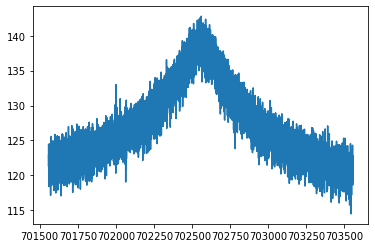

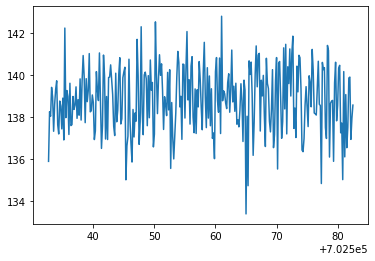

/nuz_trap2_dUvar-0.005_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_26.spec


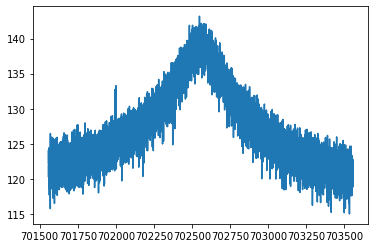

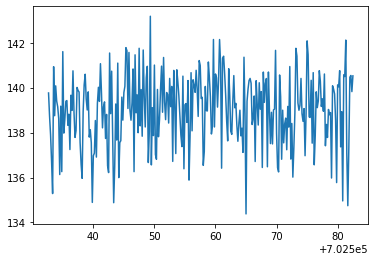

/nuz_trap2_dUvar-0.005_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_27.spec


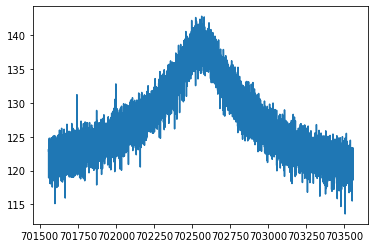

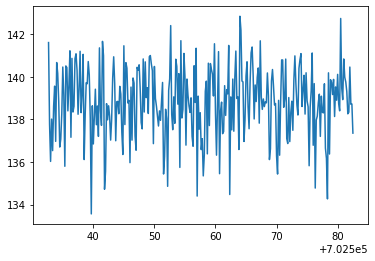

/nuz_trap2_dUvar-0.005_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_28.spec


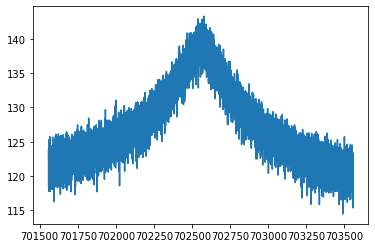

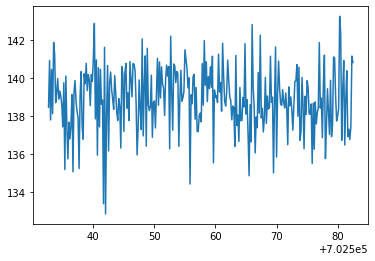

/nuz_trap2_dUvar-0.005_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_29.spec


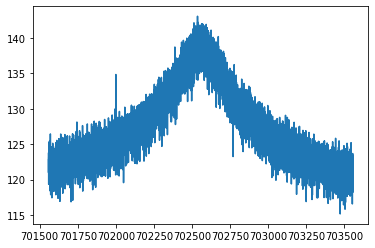

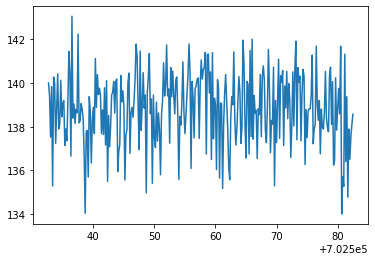

/nuz_trap2_dUvar-0.005_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
109,21,20220515_120554.753255,-0.005,2,702557.525802102056,0.033731774258,4.239982000857,0.300334408311,3.021832352769,702560.439810181735,6.154998256159,3438.899280506835,29.153312574050
110,22,20220515_121643.947082,-0.005,2,702557.534997129347,0.031014137320,3.823034842354,0.271741915231,2.962277106349,702560.062631528708,6.225656834703,3490.044183420470,29.577937516597
111,23,20220515_124945.459408,-0.005,2,702557.516078975168,0.030358539592,3.692736502274,0.242333557437,2.401312617721,702560.701419281075,5.598261373817,3591.465928952438,31.487527331894
112,24,20220515_131851.851194,-0.005,2,702557.585054884199,0.030220703121,3.604982135761,0.254270326993,2.788364595249,702553.856643749983,6.204947427930,3487.886419112896,30.390434049701


/nuz_trap2_dUvar-0.005_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_30.spec


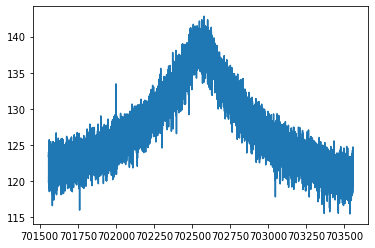

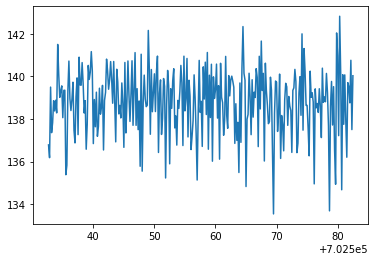

/nuz_trap2_dUvar-0.005_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_31.spec


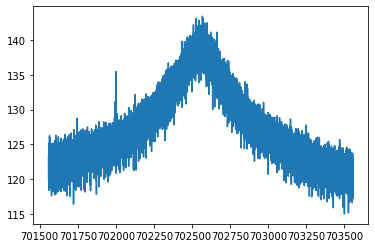

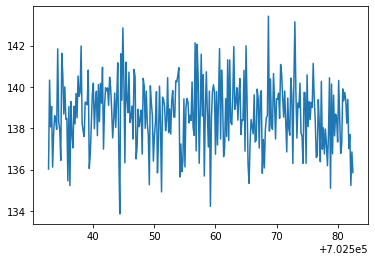

/nuz_trap2_dUvar-0.005_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_32.spec


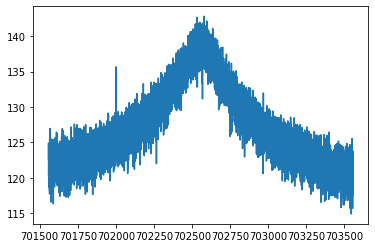

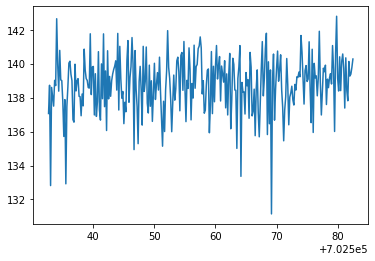

/nuz_trap2_dUvar-0.005_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_33.spec


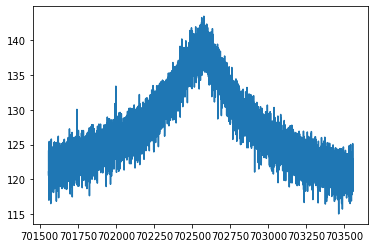

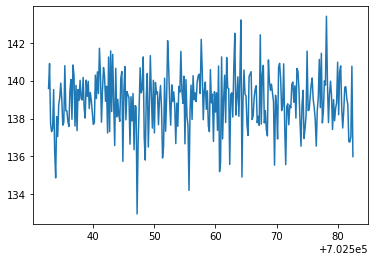

/nuz_trap2_dUvar-0.005_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_34.spec


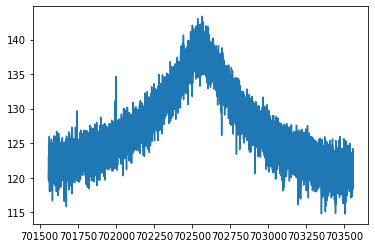

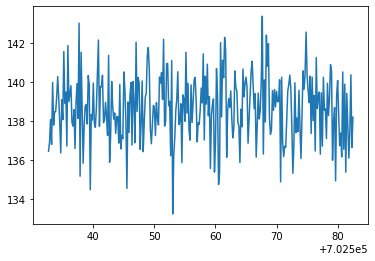

/nuz_trap2_dUvar-0.005_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_35.spec


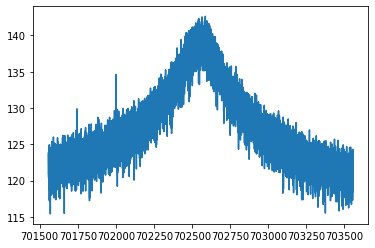

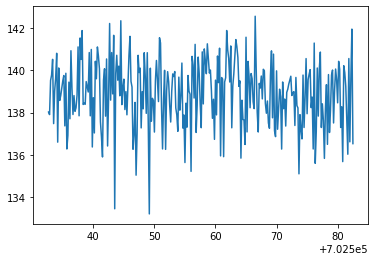

/nuz_trap2_dUvar-0.005_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_36.spec


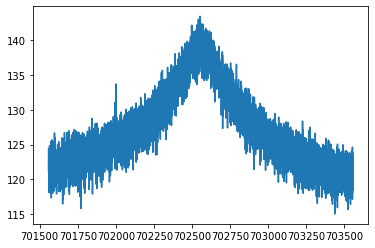

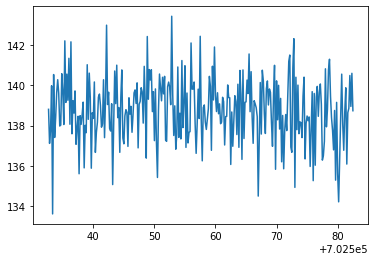

/nuz_trap2_dUvar-0.005_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_37.spec


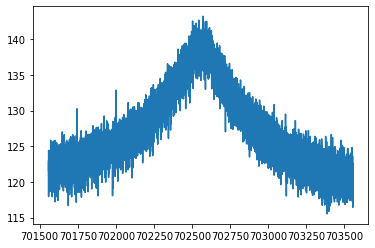

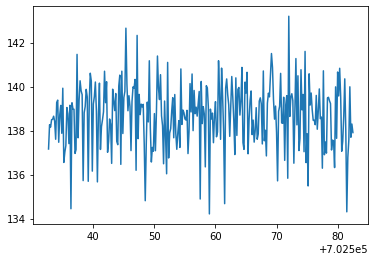

/nuz_trap2_dUvar-0.005_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_38.spec


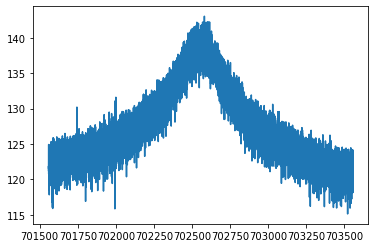

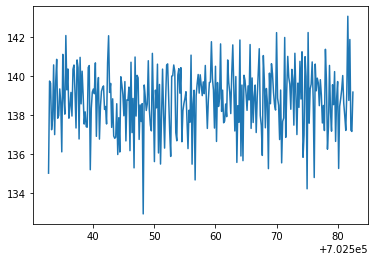

/nuz_trap2_dUvar-0.005_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_39.spec


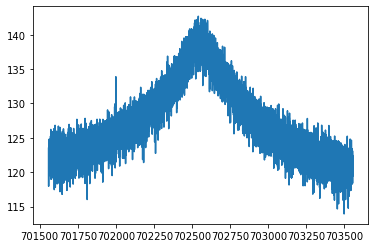

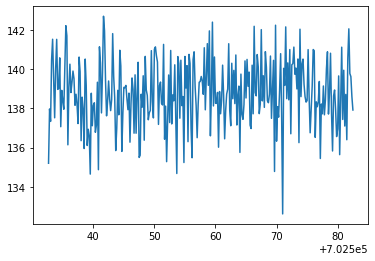

/nuz_trap2_dUvar-0.005_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,22,20220515_121643.947082,-0.005,2,702557.534997129347,0.031014137320,3.823034842354,0.271741915231,2.962277106349,702560.062631528708,6.225656834703,3490.044183420470,29.577937516597
111,23,20220515_124945.459408,-0.005,2,702557.516078975168,0.030358539592,3.692736502274,0.242333557437,2.401312617721,702560.701419281075,5.598261373817,3591.465928952438,31.487527331894
112,24,20220515_131851.851194,-0.005,2,702557.585054884199,0.030220703121,3.604982135761,0.254270326993,2.788364595249,702553.856643749983,6.204947427930,3487.886419112896,30.390434049701
113,3,20220515_023349.029669,-0.005,2,702557.550722614629,0.028270994114,4.063809562256,0.253853193374,2.331592473006,702561.109914090019,5.492032729707,3427.504570768272,28.977164192476


/nuz_trap2_dUvar-0.005_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_40.spec


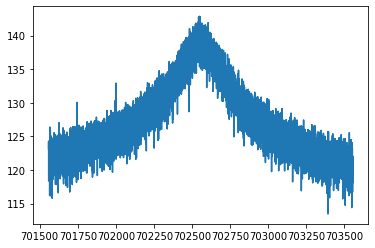

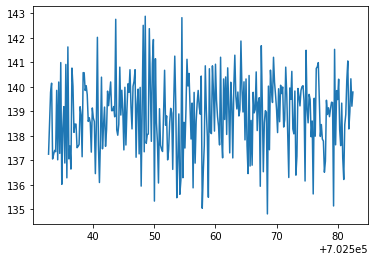

/nuz_trap2_dUvar-0.005_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.005_41.spec


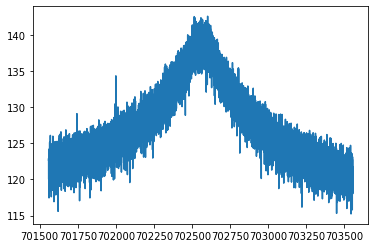

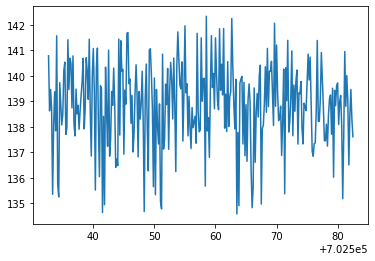

/nuz_trap2_dUvar-0.005_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
111,23,20220515_124945.459408,-0.005,2,702557.516078975168,0.030358539592,3.692736502274,0.242333557437,2.401312617721,702560.701419281075,5.598261373817,3591.465928952438,31.487527331894
112,24,20220515_131851.851194,-0.005,2,702557.585054884199,0.030220703121,3.604982135761,0.254270326993,2.788364595249,702553.856643749983,6.204947427930,3487.886419112896,30.390434049701
113,3,20220515_023349.029669,-0.005,2,702557.550722614629,0.028270994114,4.063809562256,0.253853193374,2.331592473006,702561.109914090019,5.492032729707,3427.504570768272,28.977164192476
114,4,20220515_030641.205979,-0.005,2,702557.585367192398,0.030931937033,3.375261301220,0.238237412455,2.620858296832,702556.405429130187,5.978430507003,3646.999922478184,33.344260557543


/nuz_trap2_dUvar-0.005_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
112,24,20220515_131851.851194,-0.005,2,702557.585054884199,0.030220703121,3.604982135761,0.254270326993,2.788364595249,702553.856643749983,6.204947427930,3487.886419112896,30.390434049701
113,3,20220515_023349.029669,-0.005,2,702557.550722614629,0.028270994114,4.063809562256,0.253853193374,2.331592473006,702561.109914090019,5.492032729707,3427.504570768272,28.977164192476
114,4,20220515_030641.205979,-0.005,2,702557.585367192398,0.030931937033,3.375261301220,0.238237412455,2.620858296832,702556.405429130187,5.978430507003,3646.999922478184,33.344260557543
115,5,20220515_031612.007007,-0.005,2,702557.571610211977,0.033112080273,4.133600705647,0.297940488075,3.112712331288,702561.934411699767,6.241970492688,3470.323860167326,29.673293305284


/nuz_trap2_dUvar-0.005_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,3,20220515_023349.029669,-0.005,2,702557.550722614629,0.028270994114,4.063809562256,0.253853193374,2.331592473006,702561.109914090019,5.492032729707,3427.504570768272,28.977164192476
114,4,20220515_030641.205979,-0.005,2,702557.585367192398,0.030931937033,3.375261301220,0.238237412455,2.620858296832,702556.405429130187,5.978430507003,3646.999922478184,33.344260557543
115,5,20220515_031612.007007,-0.005,2,702557.571610211977,0.033112080273,4.133600705647,0.297940488075,3.112712331288,702561.934411699767,6.241970492688,3470.323860167326,29.673293305284
116,6,20220515_040335.875451,-0.005,2,702557.611746856826,0.028865910904,3.578006517447,0.242041176114,2.567785947693,702555.896447209758,6.013404129974,3457.500158521805,29.756264653339


/nuz_trap2_dUvar-0.005_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,4,20220515_030641.205979,-0.005,2,702557.585367192398,0.030931937033,3.375261301220,0.238237412455,2.620858296832,702556.405429130187,5.978430507003,3646.999922478184,33.344260557543
115,5,20220515_031612.007007,-0.005,2,702557.571610211977,0.033112080273,4.133600705647,0.297940488075,3.112712331288,702561.934411699767,6.241970492688,3470.323860167326,29.673293305284
116,6,20220515_040335.875451,-0.005,2,702557.611746856826,0.028865910904,3.578006517447,0.242041176114,2.567785947693,702555.896447209758,6.013404129974,3457.500158521805,29.756264653339
117,7,20220515_043242.136366,-0.005,2,702557.600928519387,0.032442713164,3.868242189776,0.283432173586,3.160640389043,702544.436082881293,6.511568288893,3478.671510035419,29.995858023072


/nuz_trap2_dUvar-0.005_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,5,20220515_031612.007007,-0.005,2,702557.571610211977,0.033112080273,4.133600705647,0.297940488075,3.112712331288,702561.934411699767,6.241970492688,3470.323860167326,29.673293305284
116,6,20220515_040335.875451,-0.005,2,702557.611746856826,0.028865910904,3.578006517447,0.242041176114,2.567785947693,702555.896447209758,6.013404129974,3457.500158521805,29.756264653339
117,7,20220515_043242.136366,-0.005,2,702557.600928519387,0.032442713164,3.868242189776,0.283432173586,3.160640389043,702544.436082881293,6.511568288893,3478.671510035419,29.995858023072
118,8,20220515_045516.652357,-0.005,2,702557.641022957629,0.034508386955,3.749226744872,0.285034811995,3.296282603887,702550.292546225479,6.736536426299,3461.996254681188,29.562010947685


/nuz_trap2_dUvar-0.006_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,6,20220515_040335.875451,-0.005,2,702557.611746856826,0.028865910904,3.578006517447,0.242041176114,2.567785947693,702555.896447209758,6.013404129974,3457.500158521805,29.756264653339
117,7,20220515_043242.136366,-0.005,2,702557.600928519387,0.032442713164,3.868242189776,0.283432173586,3.160640389043,702544.436082881293,6.511568288893,3478.671510035419,29.995858023072
118,8,20220515_045516.652357,-0.005,2,702557.641022957629,0.034508386955,3.749226744872,0.285034811995,3.296282603887,702550.292546225479,6.736536426299,3461.996254681188,29.562010947685
119,9,20220515_052936.501042,-0.005,2,702557.606830391102,0.031369115550,4.061868462142,0.280594420215,2.843801414461,702558.905426961021,6.066238838277,3426.525517556438,28.818074391040


/nuz_trap2_dUvar-0.006_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,7,20220515_043242.136366,-0.005,2,702557.600928519387,0.032442713164,3.868242189776,0.283432173586,3.160640389043,702544.436082881293,6.511568288893,3478.671510035419,29.995858023072
118,8,20220515_045516.652357,-0.005,2,702557.641022957629,0.034508386955,3.749226744872,0.285034811995,3.296282603887,702550.292546225479,6.736536426299,3461.996254681188,29.562010947685
119,9,20220515_052936.501042,-0.005,2,702557.606830391102,0.031369115550,4.061868462142,0.280594420215,2.843801414461,702558.905426961021,6.066238838277,3426.525517556438,28.818074391040
120,1,20220515_013426.486618,-0.006,2,702557.634566763532,0.032511828512,3.984072837746,0.280013864477,2.916146045605,702549.261935993331,6.113958937894,3505.174663093331,30.184435586745


/nuz_trap2_dUvar-0.006_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,8,20220515_045516.652357,-0.005,2,702557.641022957629,0.034508386955,3.749226744872,0.285034811995,3.296282603887,702550.292546225479,6.736536426299,3461.996254681188,29.562010947685
119,9,20220515_052936.501042,-0.005,2,702557.606830391102,0.031369115550,4.061868462142,0.280594420215,2.843801414461,702558.905426961021,6.066238838277,3426.525517556438,28.818074391040
120,1,20220515_013426.486618,-0.006,2,702557.634566763532,0.032511828512,3.984072837746,0.280013864477,2.916146045605,702549.261935993331,6.113958937894,3505.174663093331,30.184435586745
121,10,20220515_060909.793544,-0.006,2,702557.679344523815,0.032143643052,4.182374326883,0.280190989534,2.678614034790,702555.828209840925,5.688138217073,3534.753229198800,30.783103006557


/nuz_trap2_dUvar-0.006_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,9,20220515_052936.501042,-0.005,2,702557.606830391102,0.031369115550,4.061868462142,0.280594420215,2.843801414461,702558.905426961021,6.066238838277,3426.525517556438,28.818074391040
120,1,20220515_013426.486618,-0.006,2,702557.634566763532,0.032511828512,3.984072837746,0.280013864477,2.916146045605,702549.261935993331,6.113958937894,3505.174663093331,30.184435586745
121,10,20220515_060909.793544,-0.006,2,702557.679344523815,0.032143643052,4.182374326883,0.280190989534,2.678614034790,702555.828209840925,5.688138217073,3534.753229198800,30.783103006557
122,11,20220515_065514.905163,-0.006,2,702557.516412926838,0.031691989067,3.744425864613,0.254922231422,2.600709449950,702554.891461841413,5.878448935977,3533.898922408057,32.753469921535


/nuz_trap2_dUvar-0.006_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,1,20220515_013426.486618,-0.006,2,702557.634566763532,0.032511828512,3.984072837746,0.280013864477,2.916146045605,702549.261935993331,6.113958937894,3505.174663093331,30.184435586745
121,10,20220515_060909.793544,-0.006,2,702557.679344523815,0.032143643052,4.182374326883,0.280190989534,2.678614034790,702555.828209840925,5.688138217073,3534.753229198800,30.783103006557
122,11,20220515_065514.905163,-0.006,2,702557.516412926838,0.031691989067,3.744425864613,0.254922231422,2.600709449950,702554.891461841413,5.878448935977,3533.898922408057,32.753469921535
123,12,20220515_072302.968976,-0.006,2,702557.582228013431,0.028166764034,3.606581644459,0.236903870003,2.415731955691,702558.226438616985,5.786068597813,3476.679567898475,30.408080631739


/nuz_trap2_dUvar-0.006_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
121,10,20220515_060909.793544,-0.006,2,702557.679344523815,0.032143643052,4.182374326883,0.280190989534,2.678614034790,702555.828209840925,5.688138217073,3534.753229198800,30.783103006557
122,11,20220515_065514.905163,-0.006,2,702557.516412926838,0.031691989067,3.744425864613,0.254922231422,2.600709449950,702554.891461841413,5.878448935977,3533.898922408057,32.753469921535
123,12,20220515_072302.968976,-0.006,2,702557.582228013431,0.028166764034,3.606581644459,0.236903870003,2.415731955691,702558.226438616985,5.786068597813,3476.679567898475,30.408080631739
124,13,20220515_073352.187738,-0.006,2,702557.579827955109,0.031876448090,3.948154886091,0.283572969212,3.040202250102,702555.643069093698,6.248188977116,3479.125290375392,29.776621431306


/nuz_trap2_dUvar-0.006_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,11,20220515_065514.905163,-0.006,2,702557.516412926838,0.031691989067,3.744425864613,0.254922231422,2.600709449950,702554.891461841413,5.878448935977,3533.898922408057,32.753469921535
123,12,20220515_072302.968976,-0.006,2,702557.582228013431,0.028166764034,3.606581644459,0.236903870003,2.415731955691,702558.226438616985,5.786068597813,3476.679567898475,30.408080631739
124,13,20220515_073352.187738,-0.006,2,702557.579827955109,0.031876448090,3.948154886091,0.283572969212,3.040202250102,702555.643069093698,6.248188977116,3479.125290375392,29.776621431306
125,14,20220515_080535.328578,-0.006,2,702557.551470263163,0.026936298922,3.672046220171,0.232613160797,2.298334264884,702553.774694221443,5.609138929651,3466.484685293964,29.224565772925


/nuz_trap2_dUvar-0.006_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,12,20220515_072302.968976,-0.006,2,702557.582228013431,0.028166764034,3.606581644459,0.236903870003,2.415731955691,702558.226438616985,5.786068597813,3476.679567898475,30.408080631739
124,13,20220515_073352.187738,-0.006,2,702557.579827955109,0.031876448090,3.948154886091,0.283572969212,3.040202250102,702555.643069093698,6.248188977116,3479.125290375392,29.776621431306
125,14,20220515_080535.328578,-0.006,2,702557.551470263163,0.026936298922,3.672046220171,0.232613160797,2.298334264884,702553.774694221443,5.609138929651,3466.484685293964,29.224565772925
126,15,20220515_084113.539506,-0.006,2,702557.585407721926,0.033487535903,4.513913328945,0.308740560328,2.863643313989,702559.433121612528,5.920915228776,3395.672722516423,29.365768709222


/nuz_trap2_dUvar-0.006_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,13,20220515_073352.187738,-0.006,2,702557.579827955109,0.031876448090,3.948154886091,0.283572969212,3.040202250102,702555.643069093698,6.248188977116,3479.125290375392,29.776621431306
125,14,20220515_080535.328578,-0.006,2,702557.551470263163,0.026936298922,3.672046220171,0.232613160797,2.298334264884,702553.774694221443,5.609138929651,3466.484685293964,29.224565772925
126,15,20220515_084113.539506,-0.006,2,702557.585407721926,0.033487535903,4.513913328945,0.308740560328,2.863643313989,702559.433121612528,5.920915228776,3395.672722516423,29.365768709222
127,16,20220515_093509.134738,-0.006,2,702557.515210145619,0.030476755834,3.520851524049,0.250397453228,2.834363591332,702556.114318775944,6.347271702801,3468.561424400559,29.807914454362


/nuz_trap2_dUvar-0.006_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
125,14,20220515_080535.328578,-0.006,2,702557.551470263163,0.026936298922,3.672046220171,0.232613160797,2.298334264884,702553.774694221443,5.609138929651,3466.484685293964,29.224565772925
126,15,20220515_084113.539506,-0.006,2,702557.585407721926,0.033487535903,4.513913328945,0.308740560328,2.863643313989,702559.433121612528,5.920915228776,3395.672722516423,29.365768709222
127,16,20220515_093509.134738,-0.006,2,702557.515210145619,0.030476755834,3.520851524049,0.250397453228,2.834363591332,702556.114318775944,6.347271702801,3468.561424400559,29.807914454362
128,17,20220515_094558.278291,-0.006,2,702557.672269201372,0.028382917187,3.919436166430,0.247071381740,2.348112598619,702554.960437132162,5.630617435907,3403.005594773950,28.456496155911


/nuz_trap2_dUvar-0.006_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
126,15,20220515_084113.539506,-0.006,2,702557.585407721926,0.033487535903,4.513913328945,0.308740560328,2.863643313989,702559.433121612528,5.920915228776,3395.672722516423,29.365768709222
127,16,20220515_093509.134738,-0.006,2,702557.515210145619,0.030476755834,3.520851524049,0.250397453228,2.834363591332,702556.114318775944,6.347271702801,3468.561424400559,29.807914454362
128,17,20220515_094558.278291,-0.006,2,702557.672269201372,0.028382917187,3.919436166430,0.247071381740,2.348112598619,702554.960437132162,5.630617435907,3403.005594773950,28.456496155911
129,18,20220515_102254.934129,-0.006,2,702557.510058787651,0.030601247473,4.146500856374,0.275730160487,2.682524478950,702555.824830670608,5.805606633343,3452.052850846258,30.225823596013


/nuz_trap2_dUvar-0.006_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
127,16,20220515_093509.134738,-0.006,2,702557.515210145619,0.030476755834,3.520851524049,0.250397453228,2.834363591332,702556.114318775944,6.347271702801,3468.561424400559,29.807914454362
128,17,20220515_094558.278291,-0.006,2,702557.672269201372,0.028382917187,3.919436166430,0.247071381740,2.348112598619,702554.960437132162,5.630617435907,3403.005594773950,28.456496155911
129,18,20220515_102254.934129,-0.006,2,702557.510058787651,0.030601247473,4.146500856374,0.275730160487,2.682524478950,702555.824830670608,5.805606633343,3452.052850846258,30.225823596013
130,19,20220515_110505.056846,-0.006,2,702557.673044377589,0.033633082957,4.017158890792,0.271009199572,2.586634195891,702552.793919128249,5.751467429717,3526.004054126895,32.438645099705


/nuz_trap2_dUvar-0.006_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
128,17,20220515_094558.278291,-0.006,2,702557.672269201372,0.028382917187,3.919436166430,0.247071381740,2.348112598619,702554.960437132162,5.630617435907,3403.005594773950,28.456496155911
129,18,20220515_102254.934129,-0.006,2,702557.510058787651,0.030601247473,4.146500856374,0.275730160487,2.682524478950,702555.824830670608,5.805606633343,3452.052850846258,30.225823596013
130,19,20220515_110505.056846,-0.006,2,702557.673044377589,0.033633082957,4.017158890792,0.271009199572,2.586634195891,702552.793919128249,5.751467429717,3526.004054126895,32.438645099705
131,2,20220515_015303.242615,-0.006,2,702557.625577525469,0.030481955583,4.078096577469,0.258009985834,2.339347274668,702556.376637004898,5.290797356661,3600.298369976319,33.588244726064


/nuz_trap2_dUvar-0.006_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
129,18,20220515_102254.934129,-0.006,2,702557.510058787651,0.030601247473,4.146500856374,0.275730160487,2.682524478950,702555.824830670608,5.805606633343,3452.052850846258,30.225823596013
130,19,20220515_110505.056846,-0.006,2,702557.673044377589,0.033633082957,4.017158890792,0.271009199572,2.586634195891,702552.793919128249,5.751467429717,3526.004054126895,32.438645099705
131,2,20220515_015303.242615,-0.006,2,702557.625577525469,0.030481955583,4.078096577469,0.258009985834,2.339347274668,702556.376637004898,5.290797356661,3600.298369976319,33.588244726064
132,20,20220515_113016.367875,-0.006,2,702557.613598684315,0.028708784200,3.396211895033,0.221230882950,2.252544737131,702553.553163095727,5.548688142121,3636.953381315605,33.531274532214


/nuz_trap2_dUvar-0.006_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,19,20220515_110505.056846,-0.006,2,702557.673044377589,0.033633082957,4.017158890792,0.271009199572,2.586634195891,702552.793919128249,5.751467429717,3526.004054126895,32.438645099705
131,2,20220515_015303.242615,-0.006,2,702557.625577525469,0.030481955583,4.078096577469,0.258009985834,2.339347274668,702556.376637004898,5.290797356661,3600.298369976319,33.588244726064
132,20,20220515_113016.367875,-0.006,2,702557.613598684315,0.028708784200,3.396211895033,0.221230882950,2.252544737131,702553.553163095727,5.548688142121,3636.953381315605,33.531274532214
133,21,20220515_120041.146852,-0.006,2,702557.594184517046,0.028764574415,3.743715956347,0.247945242034,2.519000966326,702551.734877194627,5.860830438504,3456.368806535920,30.170904316266


/nuz_trap2_dUvar-0.006_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
131,2,20220515_015303.242615,-0.006,2,702557.625577525469,0.030481955583,4.078096577469,0.258009985834,2.339347274668,702556.376637004898,5.290797356661,3600.298369976319,33.588244726064
132,20,20220515_113016.367875,-0.006,2,702557.613598684315,0.028708784200,3.396211895033,0.221230882950,2.252544737131,702553.553163095727,5.548688142121,3636.953381315605,33.531274532214
133,21,20220515_120041.146852,-0.006,2,702557.594184517046,0.028764574415,3.743715956347,0.247945242034,2.519000966326,702551.734877194627,5.860830438504,3456.368806535920,30.170904316266
134,22,20220515_123856.224800,-0.006,2,702557.484933704254,0.032372834566,4.003107263987,0.281448191302,2.939008391076,702551.597582058748,6.219995521438,3433.916895354464,28.981943555949


/nuz_trap2_dUvar-0.006_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_24.spec


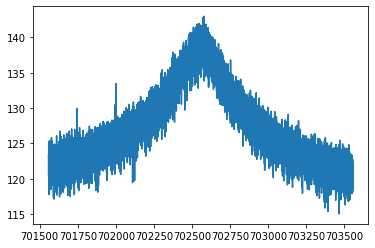

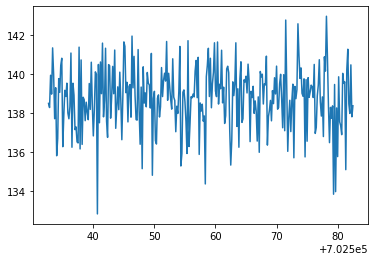

/nuz_trap2_dUvar-0.006_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_25.spec


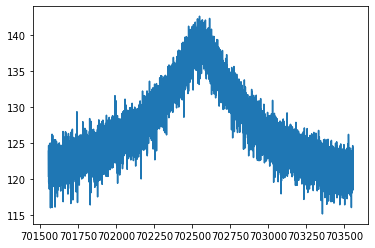

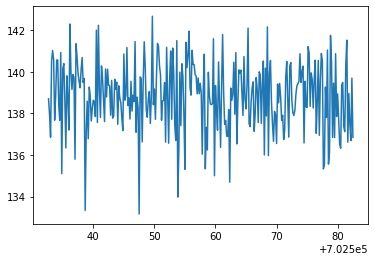

/nuz_trap2_dUvar-0.006_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_26.spec


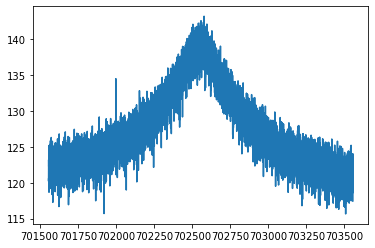

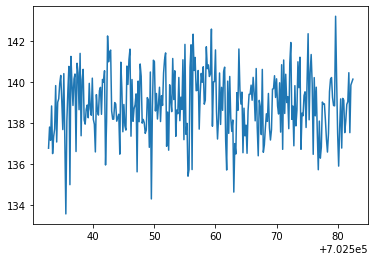

/nuz_trap2_dUvar-0.006_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_27.spec


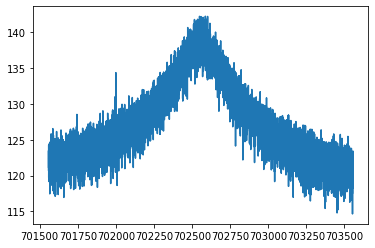

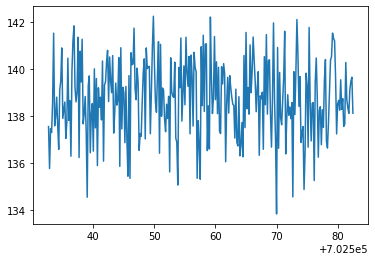

/nuz_trap2_dUvar-0.006_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_28.spec


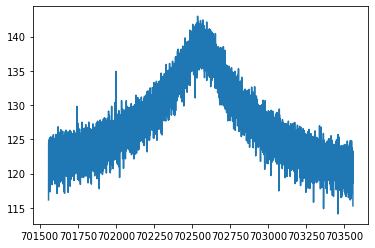

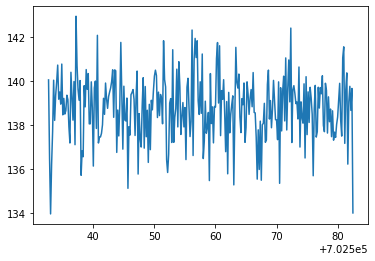

/nuz_trap2_dUvar-0.006_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_29.spec


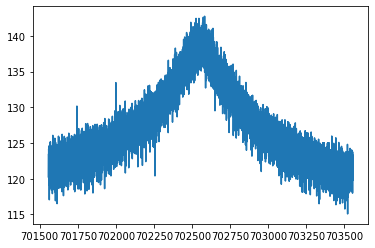

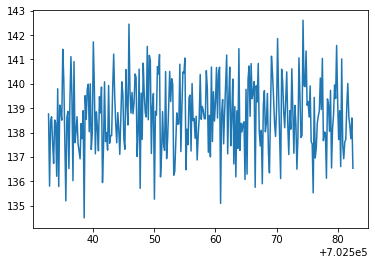

/nuz_trap2_dUvar-0.006_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,20,20220515_113016.367875,-0.006,2,702557.613598684315,0.028708784200,3.396211895033,0.221230882950,2.252544737131,702553.553163095727,5.548688142121,3636.953381315605,33.531274532214
133,21,20220515_120041.146852,-0.006,2,702557.594184517046,0.028764574415,3.743715956347,0.247945242034,2.519000966326,702551.734877194627,5.860830438504,3456.368806535920,30.170904316266
134,22,20220515_123856.224800,-0.006,2,702557.484933704254,0.032372834566,4.003107263987,0.281448191302,2.939008391076,702551.597582058748,6.219995521438,3433.916895354464,28.981943555949
135,23,20220515_130802.658280,-0.006,2,702557.529125566827,0.029510393816,3.971584640642,0.254921993881,2.428954375200,702550.110178561532,5.633587518762,3467.515253697733,29.616999965814


/nuz_trap2_dUvar-0.006_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_30.spec


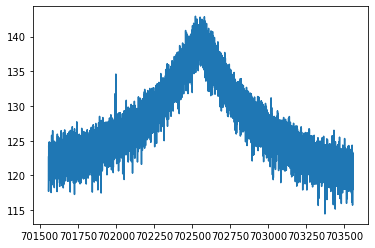

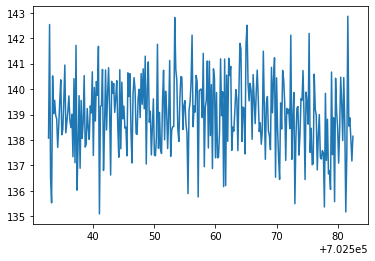

/nuz_trap2_dUvar-0.006_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_31.spec


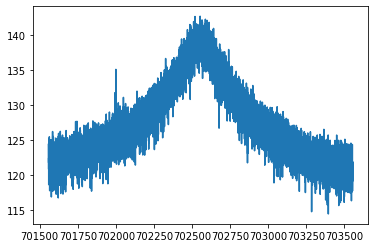

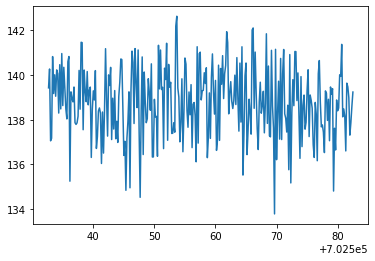

/nuz_trap2_dUvar-0.006_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_32.spec


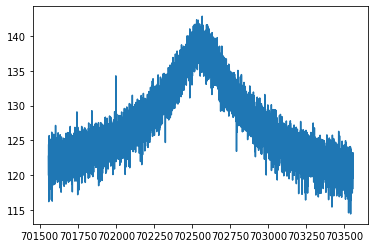

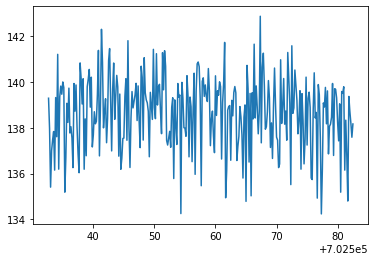

/nuz_trap2_dUvar-0.006_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_33.spec


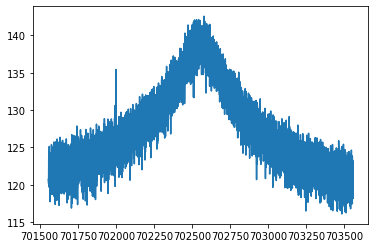

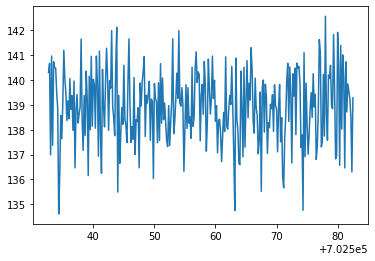

/nuz_trap2_dUvar-0.006_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_34.spec


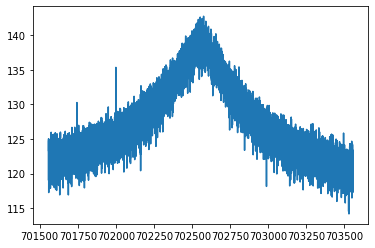

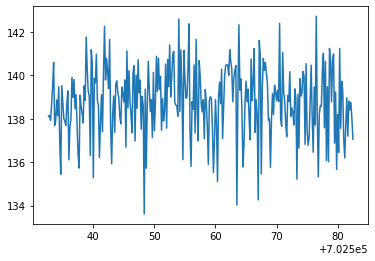

/nuz_trap2_dUvar-0.006_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_35.spec


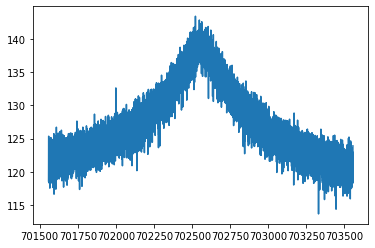

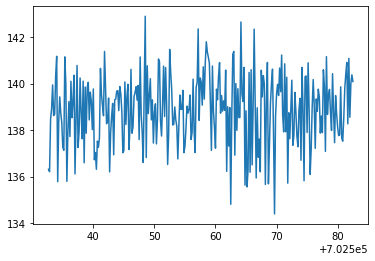

/nuz_trap2_dUvar-0.006_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_36.spec


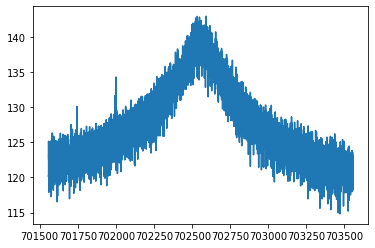

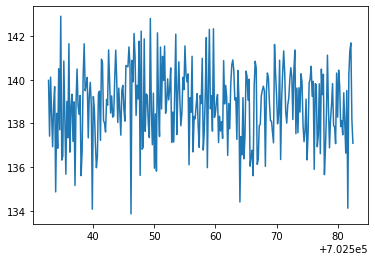

/nuz_trap2_dUvar-0.006_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_37.spec


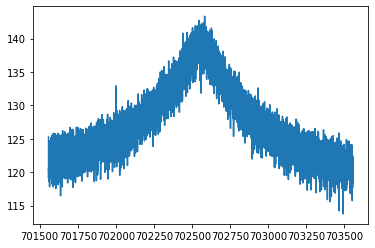

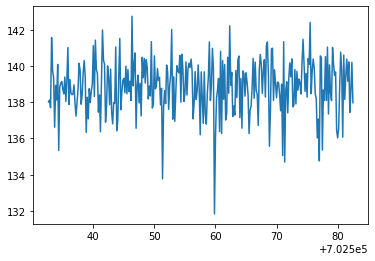

/nuz_trap2_dUvar-0.006_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_38.spec


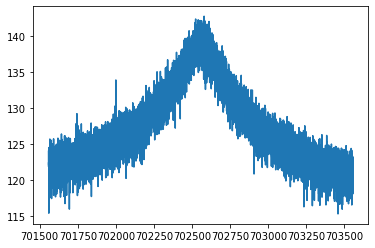

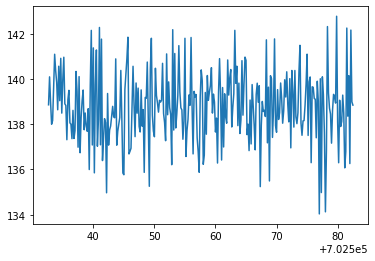

/nuz_trap2_dUvar-0.006_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_39.spec


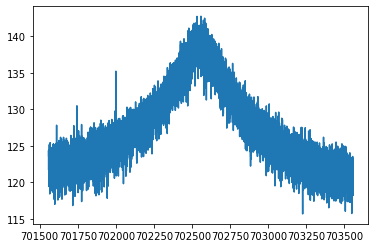

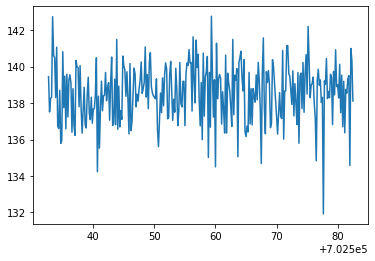

/nuz_trap2_dUvar-0.006_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,21,20220515_120041.146852,-0.006,2,702557.594184517046,0.028764574415,3.743715956347,0.247945242034,2.519000966326,702551.734877194627,5.860830438504,3456.368806535920,30.170904316266
134,22,20220515_123856.224800,-0.006,2,702557.484933704254,0.032372834566,4.003107263987,0.281448191302,2.939008391076,702551.597582058748,6.219995521438,3433.916895354464,28.981943555949
135,23,20220515_130802.658280,-0.006,2,702557.529125566827,0.029510393816,3.971584640642,0.254921993881,2.428954375200,702550.110178561532,5.633587518762,3467.515253697733,29.616999965814
136,3,20220515_022836.313941,-0.006,2,702557.555183283053,0.030217341485,3.421860308468,0.252563358239,3.000002897975,702553.033874057699,6.606993999339,3461.475672466539,29.422740202042


/nuz_trap2_dUvar-0.006_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_40.spec


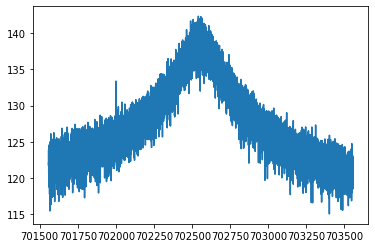

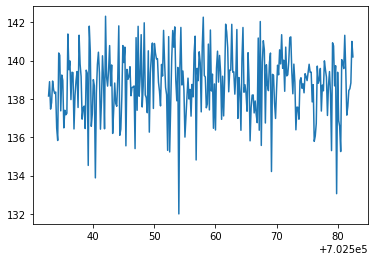

/nuz_trap2_dUvar-0.006_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.006_41.spec


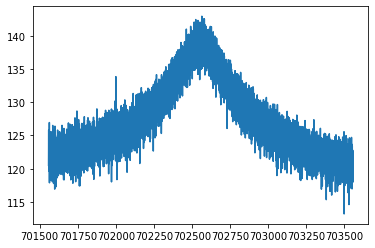

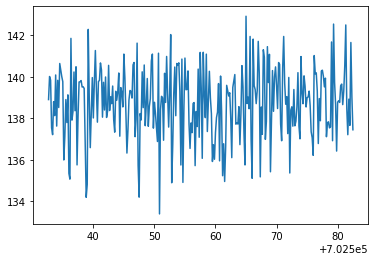

/nuz_trap2_dUvar-0.006_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
134,22,20220515_123856.224800,-0.006,2,702557.484933704254,0.032372834566,4.003107263987,0.281448191302,2.939008391076,702551.597582058748,6.219995521438,3433.916895354464,28.981943555949
135,23,20220515_130802.658280,-0.006,2,702557.529125566827,0.029510393816,3.971584640642,0.254921993881,2.428954375200,702550.110178561532,5.633587518762,3467.515253697733,29.616999965814
136,3,20220515_022836.313941,-0.006,2,702557.555183283053,0.030217341485,3.421860308468,0.252563358239,3.000002897975,702553.033874057699,6.606993999339,3461.475672466539,29.422740202042
137,4,20220515_031431.404497,-0.006,2,702557.606632758165,0.029217118350,3.794863017118,0.252765345414,2.563333252445,702559.470704323612,5.906987801573,3431.676972104794,29.197777957908


/nuz_trap2_dUvar-0.006_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
135,23,20220515_130802.658280,-0.006,2,702557.529125566827,0.029510393816,3.971584640642,0.254921993881,2.428954375200,702550.110178561532,5.633587518762,3467.515253697733,29.616999965814
136,3,20220515_022836.313941,-0.006,2,702557.555183283053,0.030217341485,3.421860308468,0.252563358239,3.000002897975,702553.033874057699,6.606993999339,3461.475672466539,29.422740202042
137,4,20220515_031431.404497,-0.006,2,702557.606632758165,0.029217118350,3.794863017118,0.252765345414,2.563333252445,702559.470704323612,5.906987801573,3431.676972104794,29.197777957908
138,5,20220515_032007.137698,-0.006,2,702557.678258560016,0.036694650048,3.862886933286,0.313207512608,3.844530361469,702548.148367495392,7.272678134473,3418.510245705703,28.885380969529


/nuz_trap2_dUvar-0.006_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
136,3,20220515_022836.313941,-0.006,2,702557.555183283053,0.030217341485,3.421860308468,0.252563358239,3.000002897975,702553.033874057699,6.606993999339,3461.475672466539,29.422740202042
137,4,20220515_031431.404497,-0.006,2,702557.606632758165,0.029217118350,3.794863017118,0.252765345414,2.563333252445,702559.470704323612,5.906987801573,3431.676972104794,29.197777957908
138,5,20220515_032007.137698,-0.006,2,702557.678258560016,0.036694650048,3.862886933286,0.313207512608,3.844530361469,702548.148367495392,7.272678134473,3418.510245705703,28.885380969529
139,6,20220515_041007.682961,-0.006,2,702557.612103659194,0.032326617428,3.950205382068,0.283740426815,3.037732488927,702553.941943392972,6.300823497752,3453.835539045225,29.467831402948


/nuz_trap2_dUvar-0.006_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
137,4,20220515_031431.404497,-0.006,2,702557.606632758165,0.029217118350,3.794863017118,0.252765345414,2.563333252445,702559.470704323612,5.906987801573,3431.676972104794,29.197777957908
138,5,20220515_032007.137698,-0.006,2,702557.678258560016,0.036694650048,3.862886933286,0.313207512608,3.844530361469,702548.148367495392,7.272678134473,3418.510245705703,28.885380969529
139,6,20220515_041007.682961,-0.006,2,702557.612103659194,0.032326617428,3.950205382068,0.283740426815,3.037732488927,702553.941943392972,6.300823497752,3453.835539045225,29.467831402948
140,7,20220515_043400.498324,-0.006,2,702557.560852417490,0.028826530344,3.838249703985,0.252567236978,2.534862824137,702546.862541435519,5.873736549969,3443.115949121043,29.248040942851


/nuz_trap2_dUvar-0.006_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,5,20220515_032007.137698,-0.006,2,702557.678258560016,0.036694650048,3.862886933286,0.313207512608,3.844530361469,702548.148367495392,7.272678134473,3418.510245705703,28.885380969529
139,6,20220515_041007.682961,-0.006,2,702557.612103659194,0.032326617428,3.950205382068,0.283740426815,3.037732488927,702553.941943392972,6.300823497752,3453.835539045225,29.467831402948
140,7,20220515_043400.498324,-0.006,2,702557.560852417490,0.028826530344,3.838249703985,0.252567236978,2.534862824137,702546.862541435519,5.873736549969,3443.115949121043,29.248040942851
141,8,20220515_045635.021477,-0.006,2,702557.586332041887,0.032561178208,4.134269537632,0.294007726194,3.037371073008,702553.331877764198,6.092233586793,3513.814003574155,30.305394105091


/nuz_trap2_dUvar-0.007_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,6,20220515_041007.682961,-0.006,2,702557.612103659194,0.032326617428,3.950205382068,0.283740426815,3.037732488927,702553.941943392972,6.300823497752,3453.835539045225,29.467831402948
140,7,20220515_043400.498324,-0.006,2,702557.560852417490,0.028826530344,3.838249703985,0.252567236978,2.534862824137,702546.862541435519,5.873736549969,3443.115949121043,29.248040942851
141,8,20220515_045635.021477,-0.006,2,702557.586332041887,0.032561178208,4.134269537632,0.294007726194,3.037371073008,702553.331877764198,6.092233586793,3513.814003574155,30.305394105091
142,9,20220515_054003.444603,-0.006,2,702557.608351612231,0.036360332176,3.953610597140,0.307880886667,3.526106266611,702549.392251290265,6.661727604412,3560.534729344979,32.388252101539


/nuz_trap2_dUvar-0.007_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
140,7,20220515_043400.498324,-0.006,2,702557.560852417490,0.028826530344,3.838249703985,0.252567236978,2.534862824137,702546.862541435519,5.873736549969,3443.115949121043,29.248040942851
141,8,20220515_045635.021477,-0.006,2,702557.586332041887,0.032561178208,4.134269537632,0.294007726194,3.037371073008,702553.331877764198,6.092233586793,3513.814003574155,30.305394105091
142,9,20220515_054003.444603,-0.006,2,702557.608351612231,0.036360332176,3.953610597140,0.307880886667,3.526106266611,702549.392251290265,6.661727604412,3560.534729344979,32.388252101539
143,1,20220515_013939.222280,-0.007,2,702557.563810304273,0.029015448867,3.597155828516,0.246876803409,2.651552111204,702559.223425574019,6.098255437732,3451.953908003974,29.602903883216


/nuz_trap2_dUvar-0.007_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
141,8,20220515_045635.021477,-0.006,2,702557.586332041887,0.032561178208,4.134269537632,0.294007726194,3.037371073008,702553.331877764198,6.092233586793,3513.814003574155,30.305394105091
142,9,20220515_054003.444603,-0.006,2,702557.608351612231,0.036360332176,3.953610597140,0.307880886667,3.526106266611,702549.392251290265,6.661727604412,3560.534729344979,32.388252101539
143,1,20220515_013939.222280,-0.007,2,702557.563810304273,0.029015448867,3.597155828516,0.246876803409,2.651552111204,702559.223425574019,6.098255437732,3451.953908003974,29.602903883216
144,10,20220515_060514.616162,-0.007,2,702557.641706871334,0.031815310989,3.930796168108,0.261799801945,2.543967238691,702554.622808183893,5.660915969341,3563.671832283951,32.612807371227


/nuz_trap2_dUvar-0.007_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,9,20220515_054003.444603,-0.006,2,702557.608351612231,0.036360332176,3.953610597140,0.307880886667,3.526106266611,702549.392251290265,6.661727604412,3560.534729344979,32.388252101539
143,1,20220515_013939.222280,-0.007,2,702557.563810304273,0.029015448867,3.597155828516,0.246876803409,2.651552111204,702559.223425574019,6.098255437732,3451.953908003974,29.602903883216
144,10,20220515_060514.616162,-0.007,2,702557.641706871334,0.031815310989,3.930796168108,0.261799801945,2.543967238691,702554.622808183893,5.660915969341,3563.671832283951,32.612807371227
145,11,20220515_064606.278892,-0.007,2,702557.596673929598,0.031514551735,3.838447065197,0.271509052025,2.888890870249,702558.901244510897,6.195735409901,3464.857594376656,29.550750205749


/nuz_trap2_dUvar-0.007_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
143,1,20220515_013939.222280,-0.007,2,702557.563810304273,0.029015448867,3.597155828516,0.246876803409,2.651552111204,702559.223425574019,6.098255437732,3451.953908003974,29.602903883216
144,10,20220515_060514.616162,-0.007,2,702557.641706871334,0.031815310989,3.930796168108,0.261799801945,2.543967238691,702554.622808183893,5.660915969341,3563.671832283951,32.612807371227
145,11,20220515_064606.278892,-0.007,2,702557.596673929598,0.031514551735,3.838447065197,0.271509052025,2.888890870249,702558.901244510897,6.195735409901,3464.857594376656,29.550750205749
146,12,20220515_071354.405043,-0.007,2,702557.550483973115,0.031184845729,3.906989205569,0.274883658167,2.924978373593,702547.665961678955,6.239517669247,3455.155345371871,29.239424254633


/nuz_trap2_dUvar-0.007_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,10,20220515_060514.616162,-0.007,2,702557.641706871334,0.031815310989,3.930796168108,0.261799801945,2.543967238691,702554.622808183893,5.660915969341,3563.671832283951,32.612807371227
145,11,20220515_064606.278892,-0.007,2,702557.596673929598,0.031514551735,3.838447065197,0.271509052025,2.888890870249,702558.901244510897,6.195735409901,3464.857594376656,29.550750205749
146,12,20220515_071354.405043,-0.007,2,702557.550483973115,0.031184845729,3.906989205569,0.274883658167,2.924978373593,702547.665961678955,6.239517669247,3455.155345371871,29.239424254633
147,13,20220515_075327.726476,-0.007,2,702557.515251875273,0.030821839752,3.935600576281,0.267468835352,2.722464272290,702558.427742898697,6.009943822327,3430.946955524171,29.642476626094


/nuz_trap2_dUvar-0.007_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,11,20220515_064606.278892,-0.007,2,702557.596673929598,0.031514551735,3.838447065197,0.271509052025,2.888890870249,702558.901244510897,6.195735409901,3464.857594376656,29.550750205749
146,12,20220515_071354.405043,-0.007,2,702557.550483973115,0.031184845729,3.906989205569,0.274883658167,2.924978373593,702547.665961678955,6.239517669247,3455.155345371871,29.239424254633
147,13,20220515_075327.726476,-0.007,2,702557.515251875273,0.030821839752,3.935600576281,0.267468835352,2.722464272290,702558.427742898697,6.009943822327,3430.946955524171,29.642476626094
148,14,20220515_080653.704894,-0.007,2,702557.607328261482,0.033751262468,4.016692262908,0.294901927951,3.176324321840,702551.461298656301,6.501440610212,3409.509851922749,29.496643237325


/nuz_trap2_dUvar-0.007_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
146,12,20220515_071354.405043,-0.007,2,702557.550483973115,0.031184845729,3.906989205569,0.274883658167,2.924978373593,702547.665961678955,6.239517669247,3455.155345371871,29.239424254633
147,13,20220515_075327.726476,-0.007,2,702557.515251875273,0.030821839752,3.935600576281,0.267468835352,2.722464272290,702558.427742898697,6.009943822327,3430.946955524171,29.642476626094
148,14,20220515_080653.704894,-0.007,2,702557.607328261482,0.033751262468,4.016692262908,0.294901927951,3.176324321840,702551.461298656301,6.501440610212,3409.509851922749,29.496643237325
149,15,20220515_085022.186345,-0.007,2,702557.719996885862,0.035483562022,4.222859400210,0.319964828294,3.459242723543,702559.358572545927,6.594719751808,3431.557239622717,29.053991862210


/nuz_trap2_dUvar-0.007_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
147,13,20220515_075327.726476,-0.007,2,702557.515251875273,0.030821839752,3.935600576281,0.267468835352,2.722464272290,702558.427742898697,6.009943822327,3430.946955524171,29.642476626094
148,14,20220515_080653.704894,-0.007,2,702557.607328261482,0.033751262468,4.016692262908,0.294901927951,3.176324321840,702551.461298656301,6.501440610212,3409.509851922749,29.496643237325
149,15,20220515_085022.186345,-0.007,2,702557.719996885862,0.035483562022,4.222859400210,0.319964828294,3.459242723543,702559.358572545927,6.594719751808,3431.557239622717,29.053991862210
150,16,20220515_092837.281506,-0.007,2,702557.583821827197,0.033997001983,3.708292498375,0.284861153536,3.331085572394,702555.561005285825,6.639952829292,3531.720452003806,31.872094470106


/nuz_trap2_dUvar-0.007_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,14,20220515_080653.704894,-0.007,2,702557.607328261482,0.033751262468,4.016692262908,0.294901927951,3.176324321840,702551.461298656301,6.501440610212,3409.509851922749,29.496643237325
149,15,20220515_085022.186345,-0.007,2,702557.719996885862,0.035483562022,4.222859400210,0.319964828294,3.459242723543,702559.358572545927,6.594719751808,3431.557239622717,29.053991862210
150,16,20220515_092837.281506,-0.007,2,702557.583821827197,0.033997001983,3.708292498375,0.284861153536,3.331085572394,702555.561005285825,6.639952829292,3531.720452003806,31.872094470106
151,17,20220515_095230.119361,-0.007,2,702557.594340942567,0.041055011844,4.597908726067,0.363673938276,3.785935764985,702554.403929266962,6.378640057562,3647.753029289947,33.976290032956


/nuz_trap2_dUvar-0.007_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
149,15,20220515_085022.186345,-0.007,2,702557.719996885862,0.035483562022,4.222859400210,0.319964828294,3.459242723543,702559.358572545927,6.594719751808,3431.557239622717,29.053991862210
150,16,20220515_092837.281506,-0.007,2,702557.583821827197,0.033997001983,3.708292498375,0.284861153536,3.331085572394,702555.561005285825,6.639952829292,3531.720452003806,31.872094470106
151,17,20220515_095230.119361,-0.007,2,702557.594340942567,0.041055011844,4.597908726067,0.363673938276,3.785935764985,702554.403929266962,6.378640057562,3647.753029289947,33.976290032956
152,18,20220515_101859.794474,-0.007,2,702557.640729381237,0.033064120630,3.782518053020,0.271596776759,2.978792766894,702541.552963680122,6.242655157350,3616.474000344738,32.466377957728


/nuz_trap2_dUvar-0.007_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
150,16,20220515_092837.281506,-0.007,2,702557.583821827197,0.033997001983,3.708292498375,0.284861153536,3.331085572394,702555.561005285825,6.639952829292,3531.720452003806,31.872094470106
151,17,20220515_095230.119361,-0.007,2,702557.594340942567,0.041055011844,4.597908726067,0.363673938276,3.785935764985,702554.403929266962,6.378640057562,3647.753029289947,33.976290032956
152,18,20220515_101859.794474,-0.007,2,702557.640729381237,0.033064120630,3.782518053020,0.271596776759,2.978792766894,702541.552963680122,6.242655157350,3616.474000344738,32.466377957728
153,19,20220515_105833.217107,-0.007,2,702557.634999023285,0.036148258744,3.337124359754,0.294507035233,4.278789870907,702549.157888122485,8.039618051436,3447.492500932235,29.305940808511


/nuz_trap2_dUvar-0.007_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,17,20220515_095230.119361,-0.007,2,702557.594340942567,0.041055011844,4.597908726067,0.363673938276,3.785935764985,702554.403929266962,6.378640057562,3647.753029289947,33.976290032956
152,18,20220515_101859.794474,-0.007,2,702557.640729381237,0.033064120630,3.782518053020,0.271596776759,2.978792766894,702541.552963680122,6.242655157350,3616.474000344738,32.466377957728
153,19,20220515_105833.217107,-0.007,2,702557.634999023285,0.036148258744,3.337124359754,0.294507035233,4.278789870907,702549.157888122485,8.039618051436,3447.492500932235,29.305940808511
154,2,20220515_020723.229840,-0.007,2,702557.613236736041,0.031204527405,3.667959399314,0.267368052364,3.035453635002,702554.068713466055,6.531876494340,3421.082235443904,29.292290009198


/nuz_trap2_dUvar-0.007_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
152,18,20220515_101859.794474,-0.007,2,702557.640729381237,0.033064120630,3.782518053020,0.271596776759,2.978792766894,702541.552963680122,6.242655157350,3616.474000344738,32.466377957728
153,19,20220515_105833.217107,-0.007,2,702557.634999023285,0.036148258744,3.337124359754,0.294507035233,4.278789870907,702549.157888122485,8.039618051436,3447.492500932235,29.305940808511
154,2,20220515_020723.229840,-0.007,2,702557.613236736041,0.031204527405,3.667959399314,0.267368052364,3.035453635002,702554.068713466055,6.531876494340,3421.082235443904,29.292290009198
155,20,20220515_112226.103037,-0.007,2,702557.713461733772,0.029465464694,4.076428774498,0.262305323554,2.473255384423,702549.881417163531,5.601801638622,3477.836345709265,29.751936522181


/nuz_trap2_dUvar-0.007_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,19,20220515_105833.217107,-0.007,2,702557.634999023285,0.036148258744,3.337124359754,0.294507035233,4.278789870907,702549.157888122485,8.039618051436,3447.492500932235,29.305940808511
154,2,20220515_020723.229840,-0.007,2,702557.613236736041,0.031204527405,3.667959399314,0.267368052364,3.035453635002,702554.068713466055,6.531876494340,3421.082235443904,29.292290009198
155,20,20220515_112226.103037,-0.007,2,702557.713461733772,0.029465464694,4.076428774498,0.262305323554,2.473255384423,702549.881417163531,5.601801638622,3477.836345709265,29.751936522181
156,21,20220515_121108.248728,-0.007,2,702557.509180134744,0.030883329108,3.661261654166,0.256484104789,2.795868437952,702553.264135846519,6.279694161114,3432.582737203360,28.927762347096


/nuz_trap2_dUvar-0.007_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
154,2,20220515_020723.229840,-0.007,2,702557.613236736041,0.031204527405,3.667959399314,0.267368052364,3.035453635002,702554.068713466055,6.531876494340,3421.082235443904,29.292290009198
155,20,20220515_112226.103037,-0.007,2,702557.713461733772,0.029465464694,4.076428774498,0.262305323554,2.473255384423,702549.881417163531,5.601801638622,3477.836345709265,29.751936522181
156,21,20220515_121108.248728,-0.007,2,702557.509180134744,0.030883329108,3.661261654166,0.256484104789,2.795868437952,702553.264135846519,6.279694161114,3432.582737203360,28.927762347096
157,22,20220515_123501.152702,-0.007,2,702557.555790438782,0.028373204897,4.031689906810,0.248967375944,2.247249802753,702560.191934171366,5.430631691521,3420.620575133142,29.138872496680


/nuz_trap2_dUvar-0.007_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_24.spec


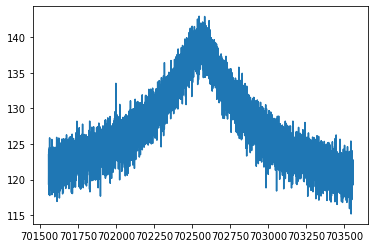

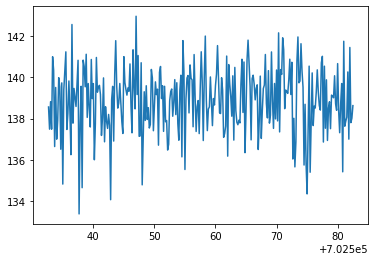

/nuz_trap2_dUvar-0.007_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_25.spec


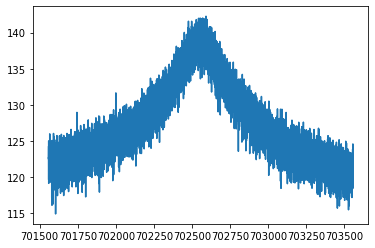

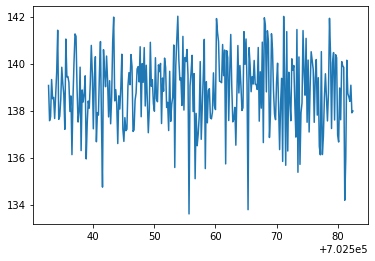

/nuz_trap2_dUvar-0.007_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_26.spec


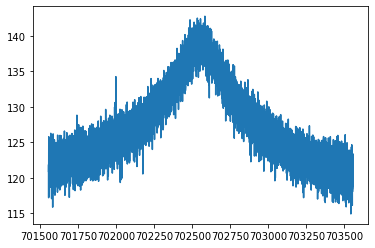

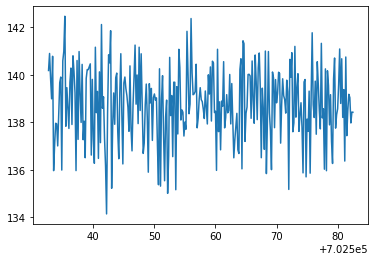

/nuz_trap2_dUvar-0.007_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_27.spec


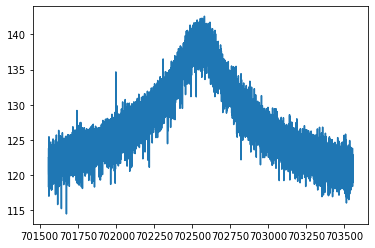

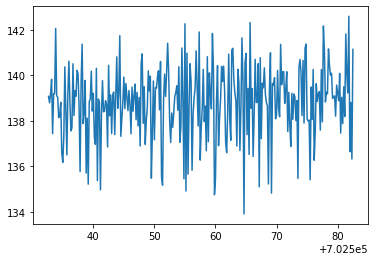

/nuz_trap2_dUvar-0.007_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_28.spec


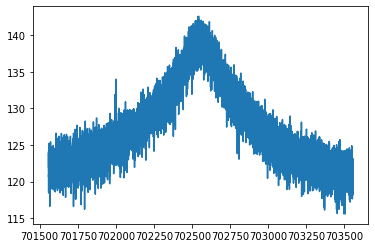

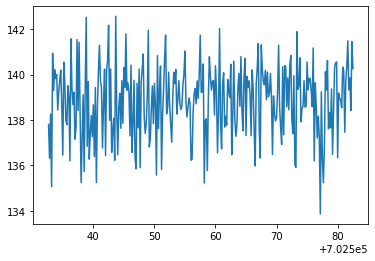

/nuz_trap2_dUvar-0.007_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_29.spec


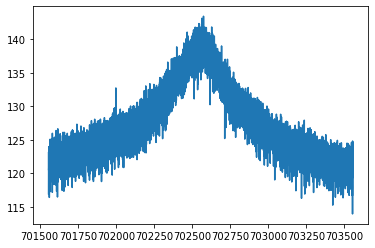

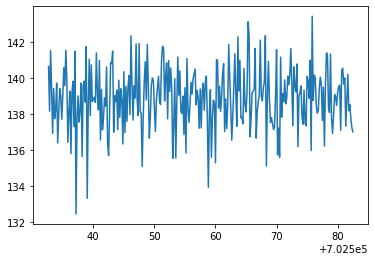

/nuz_trap2_dUvar-0.007_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,20,20220515_112226.103037,-0.007,2,702557.713461733772,0.029465464694,4.076428774498,0.262305323554,2.473255384423,702549.881417163531,5.601801638622,3477.836345709265,29.751936522181
156,21,20220515_121108.248728,-0.007,2,702557.509180134744,0.030883329108,3.661261654166,0.256484104789,2.795868437952,702553.264135846519,6.279694161114,3432.582737203360,28.927762347096
157,22,20220515_123501.152702,-0.007,2,702557.555790438782,0.028373204897,4.031689906810,0.248967375944,2.247249802753,702560.191934171366,5.430631691521,3420.620575133142,29.138872496680
158,23,20220515_130407.522919,-0.007,2,702557.602727041347,0.030309795258,3.493234415405,0.255350650040,2.981084861776,702550.077686588862,6.508112720398,3485.466408229014,29.477654851137


/nuz_trap2_dUvar-0.007_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_30.spec


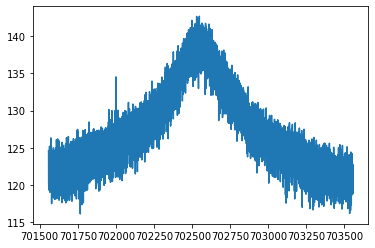

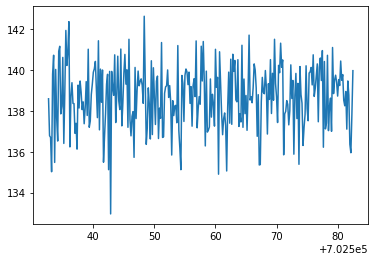

/nuz_trap2_dUvar-0.007_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_31.spec


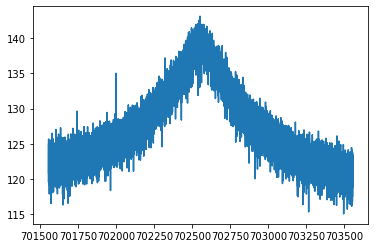

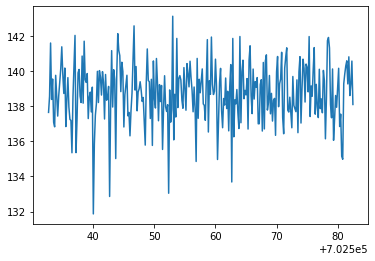

/nuz_trap2_dUvar-0.007_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_32.spec


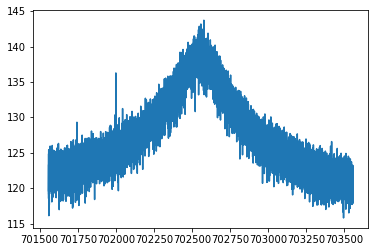

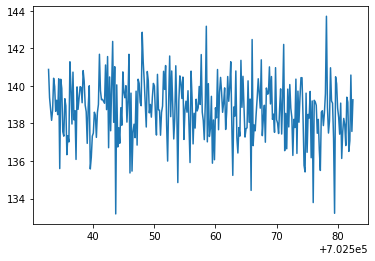

/nuz_trap2_dUvar-0.007_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_33.spec


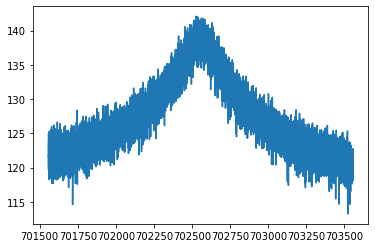

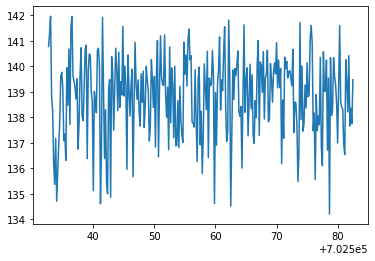

/nuz_trap2_dUvar-0.007_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_34.spec


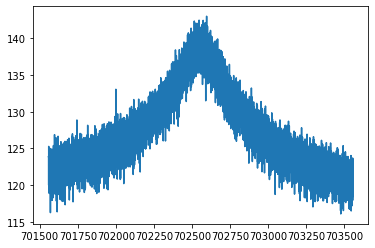

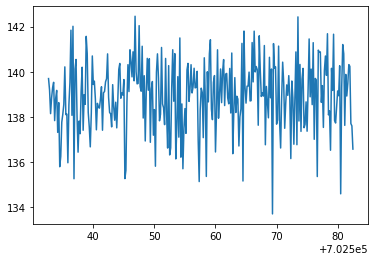

/nuz_trap2_dUvar-0.007_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_35.spec


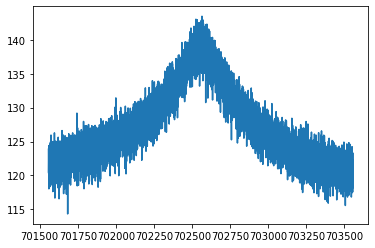

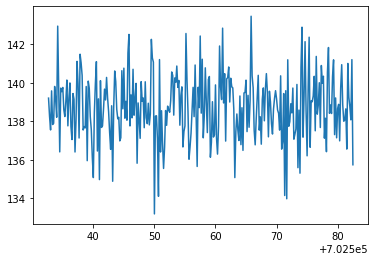

/nuz_trap2_dUvar-0.007_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_36.spec


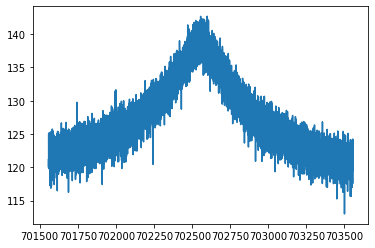

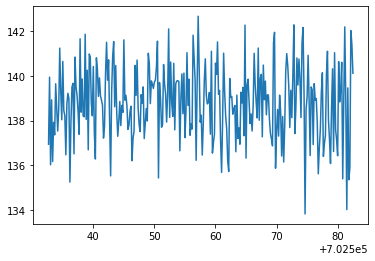

/nuz_trap2_dUvar-0.007_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_37.spec


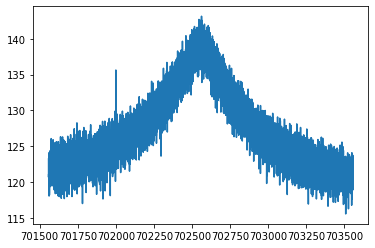

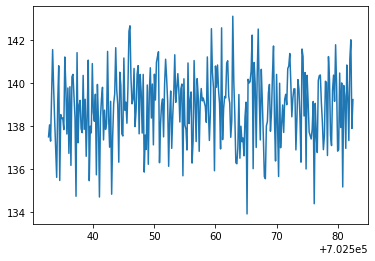

/nuz_trap2_dUvar-0.007_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_38.spec


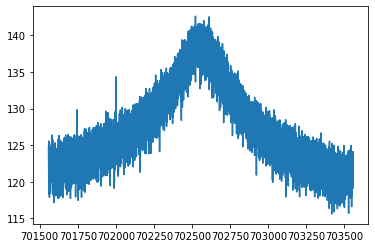

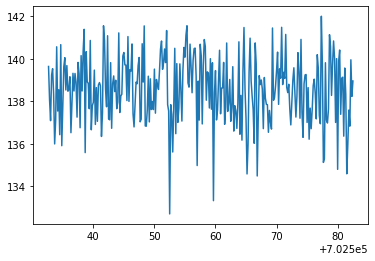

/nuz_trap2_dUvar-0.007_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_39.spec


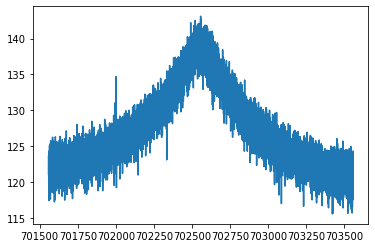

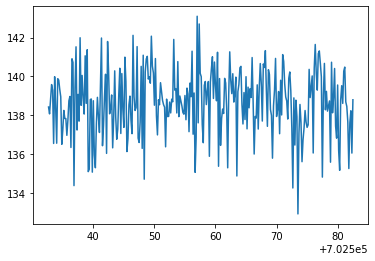

/nuz_trap2_dUvar-0.007_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,21,20220515_121108.248728,-0.007,2,702557.509180134744,0.030883329108,3.661261654166,0.256484104789,2.795868437952,702553.264135846519,6.279694161114,3432.582737203360,28.927762347096
157,22,20220515_123501.152702,-0.007,2,702557.555790438782,0.028373204897,4.031689906810,0.248967375944,2.247249802753,702560.191934171366,5.430631691521,3420.620575133142,29.138872496680
158,23,20220515_130407.522919,-0.007,2,702557.602727041347,0.030309795258,3.493234415405,0.255350650040,2.981084861776,702550.077686588862,6.508112720398,3485.466408229014,29.477654851137
159,3,20220515_022954.512309,-0.007,2,702557.616807531333,0.034248425325,4.007655357208,0.301523078659,3.348965629583,702558.235777705326,6.579698880643,3451.541681861092,29.778260902073


/nuz_trap2_dUvar-0.007_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.007_40.spec


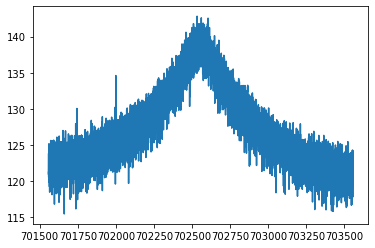

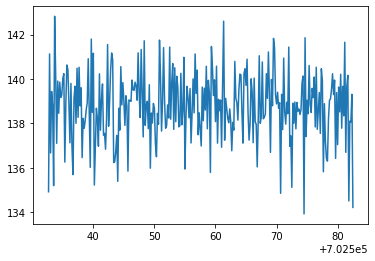

/nuz_trap2_dUvar-0.007_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,22,20220515_123501.152702,-0.007,2,702557.555790438782,0.028373204897,4.031689906810,0.248967375944,2.247249802753,702560.191934171366,5.430631691521,3420.620575133142,29.138872496680
158,23,20220515_130407.522919,-0.007,2,702557.602727041347,0.030309795258,3.493234415405,0.255350650040,2.981084861776,702550.077686588862,6.508112720398,3485.466408229014,29.477654851137
159,3,20220515_022954.512309,-0.007,2,702557.616807531333,0.034248425325,4.007655357208,0.301523078659,3.348965629583,702558.235777705326,6.579698880643,3451.541681861092,29.778260902073
160,4,20220515_025850.998193,-0.007,2,702557.559851902421,0.032350565678,3.598083442744,0.278346283646,3.392233097190,702552.894815658452,6.890661605678,3455.142531989612,29.587979572880


/nuz_trap2_dUvar-0.007_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
158,23,20220515_130407.522919,-0.007,2,702557.602727041347,0.030309795258,3.493234415405,0.255350650040,2.981084861776,702550.077686588862,6.508112720398,3485.466408229014,29.477654851137
159,3,20220515_022954.512309,-0.007,2,702557.616807531333,0.034248425325,4.007655357208,0.301523078659,3.348965629583,702558.235777705326,6.579698880643,3451.541681861092,29.778260902073
160,4,20220515_025850.998193,-0.007,2,702557.559851902421,0.032350565678,3.598083442744,0.278346283646,3.392233097190,702552.894815658452,6.890661605678,3455.142531989612,29.587979572880
161,5,20220515_032915.712744,-0.007,2,702557.577167241485,0.028072577476,3.606979072226,0.243776015494,2.592474117879,702556.504223084543,6.003609630352,3454.617670534107,29.453069975226


/nuz_trap2_dUvar-0.007_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,3,20220515_022954.512309,-0.007,2,702557.616807531333,0.034248425325,4.007655357208,0.301523078659,3.348965629583,702558.235777705326,6.579698880643,3451.541681861092,29.778260902073
160,4,20220515_025850.998193,-0.007,2,702557.559851902421,0.032350565678,3.598083442744,0.278346283646,3.392233097190,702552.894815658452,6.890661605678,3455.142531989612,29.587979572880
161,5,20220515_032915.712744,-0.007,2,702557.577167241485,0.028072577476,3.606979072226,0.243776015494,2.592474117879,702556.504223084543,6.003609630352,3454.617670534107,29.453069975226
162,6,20220515_040059.102423,-0.007,2,702557.632745749317,0.029079222377,3.880492187310,0.246924537647,2.364154798489,702546.739112946088,5.654836894193,3456.455079885484,30.034030533393


/nuz_trap2_dUvar-0.007_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
160,4,20220515_025850.998193,-0.007,2,702557.559851902421,0.032350565678,3.598083442744,0.278346283646,3.392233097190,702552.894815658452,6.890661605678,3455.142531989612,29.587979572880
161,5,20220515_032915.712744,-0.007,2,702557.577167241485,0.028072577476,3.606979072226,0.243776015494,2.592474117879,702556.504223084543,6.003609630352,3454.617670534107,29.453069975226
162,6,20220515_040059.102423,-0.007,2,702557.632745749317,0.029079222377,3.880492187310,0.246924537647,2.364154798489,702546.739112946088,5.654836894193,3456.455079885484,30.034030533393
163,7,20220515_043637.204504,-0.007,2,702557.575726214680,0.027659910673,3.329420293932,0.228633516520,2.550418860278,702549.747298185132,6.153036105910,3478.469710908296,29.392796753955


/nuz_trap2_dUvar-0.007_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,5,20220515_032915.712744,-0.007,2,702557.577167241485,0.028072577476,3.606979072226,0.243776015494,2.592474117879,702556.504223084543,6.003609630352,3454.617670534107,29.453069975226
162,6,20220515_040059.102423,-0.007,2,702557.632745749317,0.029079222377,3.880492187310,0.246924537647,2.364154798489,702546.739112946088,5.654836894193,3456.455079885484,30.034030533393
163,7,20220515_043637.204504,-0.007,2,702557.575726214680,0.027659910673,3.329420293932,0.228633516520,2.550418860278,702549.747298185132,6.153036105910,3478.469710908296,29.392796753955
164,8,20220515_051452.261226,-0.007,2,702557.670882818638,0.034722039997,3.802960538244,0.282531133078,3.155129296756,702546.439189219265,6.348008393703,3620.804111877697,33.684032542327


/nuz_trap2_dUvar-0.008_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
162,6,20220515_040059.102423,-0.007,2,702557.632745749317,0.029079222377,3.880492187310,0.246924537647,2.364154798489,702546.739112946088,5.654836894193,3456.455079885484,30.034030533393
163,7,20220515_043637.204504,-0.007,2,702557.575726214680,0.027659910673,3.329420293932,0.228633516520,2.550418860278,702549.747298185132,6.153036105910,3478.469710908296,29.392796753955
164,8,20220515_051452.261226,-0.007,2,702557.670882818638,0.034722039997,3.802960538244,0.282531133078,3.155129296756,702546.439189219265,6.348008393703,3620.804111877697,33.684032542327
165,9,20220515_054635.307388,-0.007,2,702557.680972184055,0.031107264196,4.211642077321,0.272581935169,2.536411143368,702542.442129832460,5.783154295912,3420.619931893634,29.543470719766


/nuz_trap2_dUvar-0.008_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,7,20220515_043637.204504,-0.007,2,702557.575726214680,0.027659910673,3.329420293932,0.228633516520,2.550418860278,702549.747298185132,6.153036105910,3478.469710908296,29.392796753955
164,8,20220515_051452.261226,-0.007,2,702557.670882818638,0.034722039997,3.802960538244,0.282531133078,3.155129296756,702546.439189219265,6.348008393703,3620.804111877697,33.684032542327
165,9,20220515_054635.307388,-0.007,2,702557.680972184055,0.031107264196,4.211642077321,0.272581935169,2.536411143368,702542.442129832460,5.783154295912,3420.619931893634,29.543470719766
166,1,20220515_012400.933330,-0.008,2,702557.705896168482,0.028885883349,4.256767230327,0.259150609296,2.238635968766,702550.630361982039,5.308182123843,3434.753431460556,30.093929660760


/nuz_trap2_dUvar-0.008_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
164,8,20220515_051452.261226,-0.007,2,702557.670882818638,0.034722039997,3.802960538244,0.282531133078,3.155129296756,702546.439189219265,6.348008393703,3620.804111877697,33.684032542327
165,9,20220515_054635.307388,-0.007,2,702557.680972184055,0.031107264196,4.211642077321,0.272581935169,2.536411143368,702542.442129832460,5.783154295912,3420.619931893634,29.543470719766
166,1,20220515_012400.933330,-0.008,2,702557.705896168482,0.028885883349,4.256767230327,0.259150609296,2.238635968766,702550.630361982039,5.308182123843,3434.753431460556,30.093929660760
167,10,20220515_061659.985820,-0.008,2,702557.587695906754,0.027929218365,3.409401606389,0.234588961875,2.595466516991,702553.622592265368,6.279226381454,3382.804049510865,28.739193138032


/nuz_trap2_dUvar-0.008_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
165,9,20220515_054635.307388,-0.007,2,702557.680972184055,0.031107264196,4.211642077321,0.272581935169,2.536411143368,702542.442129832460,5.783154295912,3420.619931893634,29.543470719766
166,1,20220515_012400.933330,-0.008,2,702557.705896168482,0.028885883349,4.256767230327,0.259150609296,2.238635968766,702550.630361982039,5.308182123843,3434.753431460556,30.093929660760
167,10,20220515_061659.985820,-0.008,2,702557.587695906754,0.027929218365,3.409401606389,0.234588961875,2.595466516991,702553.622592265368,6.279226381454,3382.804049510865,28.739193138032
168,11,20220515_062749.192771,-0.008,2,702557.683557917131,0.038257763260,3.763663681423,0.302781461111,3.604592239957,702551.419918335858,6.848575984972,3588.089127365288,33.073573599836


/nuz_trap2_dUvar-0.008_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
166,1,20220515_012400.933330,-0.008,2,702557.705896168482,0.028885883349,4.256767230327,0.259150609296,2.238635968766,702550.630361982039,5.308182123843,3434.753431460556,30.093929660760
167,10,20220515_061659.985820,-0.008,2,702557.587695906754,0.027929218365,3.409401606389,0.234588961875,2.595466516991,702553.622592265368,6.279226381454,3382.804049510865,28.739193138032
168,11,20220515_062749.192771,-0.008,2,702557.683557917131,0.038257763260,3.763663681423,0.302781461111,3.604592239957,702551.419918335858,6.848575984972,3588.089127365288,33.073573599836
169,12,20220515_070604.161196,-0.008,2,702557.619440385723,0.031330275331,4.159710131607,0.279594148702,2.738965566710,702545.254050314310,5.908072630574,3469.760958547058,29.785695409222


/nuz_trap2_dUvar-0.008_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,10,20220515_061659.985820,-0.008,2,702557.587695906754,0.027929218365,3.409401606389,0.234588961875,2.595466516991,702553.622592265368,6.279226381454,3382.804049510865,28.739193138032
168,11,20220515_062749.192771,-0.008,2,702557.683557917131,0.038257763260,3.763663681423,0.302781461111,3.604592239957,702551.419918335858,6.848575984972,3588.089127365288,33.073573599836
169,12,20220515_070604.161196,-0.008,2,702557.619440385723,0.031330275331,4.159710131607,0.279594148702,2.738965566710,702545.254050314310,5.908072630574,3469.760958547058,29.785695409222
170,13,20220515_074142.396509,-0.008,2,702557.675800597877,0.029228588782,4.189172564548,0.256473415785,2.247729012247,702550.937679817202,5.325291054836,3458.169240886631,29.671948794441


/nuz_trap2_dUvar-0.008_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
168,11,20220515_062749.192771,-0.008,2,702557.683557917131,0.038257763260,3.763663681423,0.302781461111,3.604592239957,702551.419918335858,6.848575984972,3588.089127365288,33.073573599836
169,12,20220515_070604.161196,-0.008,2,702557.619440385723,0.031330275331,4.159710131607,0.279594148702,2.738965566710,702545.254050314310,5.908072630574,3469.760958547058,29.785695409222
170,13,20220515_074142.396509,-0.008,2,702557.675800597877,0.029228588782,4.189172564548,0.256473415785,2.247729012247,702550.937679817202,5.325291054836,3458.169240886631,29.671948794441
171,14,20220515_080258.571130,-0.008,2,702557.638355367701,0.030433300023,3.755339463516,0.258833004884,2.742546136168,702557.893220948055,6.194416550834,3399.249639076617,28.725953029617


/nuz_trap2_dUvar-0.008_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
169,12,20220515_070604.161196,-0.008,2,702557.619440385723,0.031330275331,4.159710131607,0.279594148702,2.738965566710,702545.254050314310,5.908072630574,3469.760958547058,29.785695409222
170,13,20220515_074142.396509,-0.008,2,702557.675800597877,0.029228588782,4.189172564548,0.256473415785,2.247729012247,702550.937679817202,5.325291054836,3458.169240886631,29.671948794441
171,14,20220515_080258.571130,-0.008,2,702557.638355367701,0.030433300023,3.755339463516,0.258833004884,2.742546136168,702557.893220948055,6.194416550834,3399.249639076617,28.725953029617
172,15,20220515_083836.823314,-0.008,2,702557.586367439013,0.033372101080,4.157314929028,0.297809012308,3.064520754882,702556.265583588742,6.134451398295,3499.141043567371,30.835871114272


/nuz_trap2_dUvar-0.008_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,13,20220515_074142.396509,-0.008,2,702557.675800597877,0.029228588782,4.189172564548,0.256473415785,2.247729012247,702550.937679817202,5.325291054836,3458.169240886631,29.671948794441
171,14,20220515_080258.571130,-0.008,2,702557.638355367701,0.030433300023,3.755339463516,0.258833004884,2.742546136168,702557.893220948055,6.194416550834,3399.249639076617,28.725953029617
172,15,20220515_083836.823314,-0.008,2,702557.586367439013,0.033372101080,4.157314929028,0.297809012308,3.064520754882,702556.265583588742,6.134451398295,3499.141043567371,30.835871114272
173,16,20220515_093114.018952,-0.008,2,702557.508995278622,0.032755004165,3.853405066480,0.274525351985,2.933294066134,702554.471573120798,6.241796062280,3475.557986634291,30.181098274336


/nuz_trap2_dUvar-0.008_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
171,14,20220515_080258.571130,-0.008,2,702557.638355367701,0.030433300023,3.755339463516,0.258833004884,2.742546136168,702557.893220948055,6.194416550834,3399.249639076617,28.725953029617
172,15,20220515_083836.823314,-0.008,2,702557.586367439013,0.033372101080,4.157314929028,0.297809012308,3.064520754882,702556.265583588742,6.134451398295,3499.141043567371,30.835871114272
173,16,20220515_093114.018952,-0.008,2,702557.508995278622,0.032755004165,3.853405066480,0.274525351985,2.933294066134,702554.471573120798,6.241796062280,3475.557986634291,30.181098274336
174,17,20220515_100533.825055,-0.008,2,702557.606867841911,0.029382685824,3.156770265283,0.244659001849,3.199374905895,702557.619527295697,7.166282613766,3381.109942429217,28.714659529759


/nuz_trap2_dUvar-0.008_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
172,15,20220515_083836.823314,-0.008,2,702557.586367439013,0.033372101080,4.157314929028,0.297809012308,3.064520754882,702556.265583588742,6.134451398295,3499.141043567371,30.835871114272
173,16,20220515_093114.018952,-0.008,2,702557.508995278622,0.032755004165,3.853405066480,0.274525351985,2.933294066134,702554.471573120798,6.241796062280,3475.557986634291,30.181098274336
174,17,20220515_100533.825055,-0.008,2,702557.606867841911,0.029382685824,3.156770265283,0.244659001849,3.199374905895,702557.619527295697,7.166282613766,3381.109942429217,28.714659529759
175,18,20220515_103321.892097,-0.008,2,702557.625079651596,0.030390479779,3.616713457445,0.254030967764,2.785516631255,702556.041019247030,6.294950704996,3425.373545306193,29.419320744467


/nuz_trap2_dUvar-0.008_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
173,16,20220515_093114.018952,-0.008,2,702557.508995278622,0.032755004165,3.853405066480,0.274525351985,2.933294066134,702554.471573120798,6.241796062280,3475.557986634291,30.181098274336
174,17,20220515_100533.825055,-0.008,2,702557.606867841911,0.029382685824,3.156770265283,0.244659001849,3.199374905895,702557.619527295697,7.166282613766,3381.109942429217,28.714659529759
175,18,20220515_103321.892097,-0.008,2,702557.625079651596,0.030390479779,3.616713457445,0.254030967764,2.785516631255,702556.041019247030,6.294950704996,3425.373545306193,29.419320744467
176,19,20220515_105714.843523,-0.008,2,702557.564709706465,0.030876451202,4.038135202146,0.276307540254,2.783083165957,702557.501957706059,5.930101919293,3477.884415168895,29.885369687817


/nuz_trap2_dUvar-0.008_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
174,17,20220515_100533.825055,-0.008,2,702557.606867841911,0.029382685824,3.156770265283,0.244659001849,3.199374905895,702557.619527295697,7.166282613766,3381.109942429217,28.714659529759
175,18,20220515_103321.892097,-0.008,2,702557.625079651596,0.030390479779,3.616713457445,0.254030967764,2.785516631255,702556.041019247030,6.294950704996,3425.373545306193,29.419320744467
176,19,20220515_105714.843523,-0.008,2,702557.564709706465,0.030876451202,4.038135202146,0.276307540254,2.783083165957,702557.501957706059,5.930101919293,3477.884415168895,29.885369687817
177,2,20220515_020210.531892,-0.008,2,702557.528149256599,0.034242549867,3.763615685412,0.287524291473,3.338356188660,702556.022568509798,6.842797488471,3400.259669441553,29.498148686549


/nuz_trap2_dUvar-0.008_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,18,20220515_103321.892097,-0.008,2,702557.625079651596,0.030390479779,3.616713457445,0.254030967764,2.785516631255,702556.041019247030,6.294950704996,3425.373545306193,29.419320744467
176,19,20220515_105714.843523,-0.008,2,702557.564709706465,0.030876451202,4.038135202146,0.276307540254,2.783083165957,702557.501957706059,5.930101919293,3477.884415168895,29.885369687817
177,2,20220515_020210.531892,-0.008,2,702557.528149256599,0.034242549867,3.763615685412,0.287524291473,3.338356188660,702556.022568509798,6.842797488471,3400.259669441553,29.498148686549
178,20,20220515_111949.373318,-0.008,2,702557.583813552163,0.033246081958,3.630925537105,0.284873860844,3.491314888110,702549.983506330638,7.001132620978,3450.338679626170,29.251275227739


/nuz_trap2_dUvar-0.008_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,19,20220515_105714.843523,-0.008,2,702557.564709706465,0.030876451202,4.038135202146,0.276307540254,2.783083165957,702557.501957706059,5.930101919293,3477.884415168895,29.885369687817
177,2,20220515_020210.531892,-0.008,2,702557.528149256599,0.034242549867,3.763615685412,0.287524291473,3.338356188660,702556.022568509798,6.842797488471,3400.259669441553,29.498148686549
178,20,20220515_111949.373318,-0.008,2,702557.583813552163,0.033246081958,3.630925537105,0.284873860844,3.491314888110,702549.983506330638,7.001132620978,3450.338679626170,29.251275227739
179,21,20220515_115014.158110,-0.008,2,702557.614754725015,0.032767447252,3.719507306022,0.285360040180,3.401720413881,702558.286716128234,6.850176148196,3426.985755284897,29.174352024825


/nuz_trap2_dUvar-0.008_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
177,2,20220515_020210.531892,-0.008,2,702557.528149256599,0.034242549867,3.763615685412,0.287524291473,3.338356188660,702556.022568509798,6.842797488471,3400.259669441553,29.498148686549
178,20,20220515_111949.373318,-0.008,2,702557.583813552163,0.033246081958,3.630925537105,0.284873860844,3.491314888110,702549.983506330638,7.001132620978,3450.338679626170,29.251275227739
179,21,20220515_115014.158110,-0.008,2,702557.614754725015,0.032767447252,3.719507306022,0.285360040180,3.401720413881,702558.286716128234,6.850176148196,3426.985755284897,29.174352024825
180,22,20220515_122829.308388,-0.008,2,702557.581086685299,0.030484498034,4.028132582912,0.272757534451,2.732568176454,702548.601398000261,6.004234671614,3422.681148214226,29.478461215555


/nuz_trap2_dUvar-0.008_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
178,20,20220515_111949.373318,-0.008,2,702557.583813552163,0.033246081958,3.630925537105,0.284873860844,3.491314888110,702549.983506330638,7.001132620978,3450.338679626170,29.251275227739
179,21,20220515_115014.158110,-0.008,2,702557.614754725015,0.032767447252,3.719507306022,0.285360040180,3.401720413881,702558.286716128234,6.850176148196,3426.985755284897,29.174352024825
180,22,20220515_122829.308388,-0.008,2,702557.581086685299,0.030484498034,4.028132582912,0.272757534451,2.732568176454,702548.601398000261,6.004234671614,3422.681148214226,29.478461215555
181,23,20220515_130644.269228,-0.008,2,702557.550063278410,0.031090439438,4.228312758687,0.287019641506,2.810320929756,702553.948527367553,5.902464923428,3447.009207946125,29.389118702456


/nuz_trap2_dUvar-0.008_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_25.spec


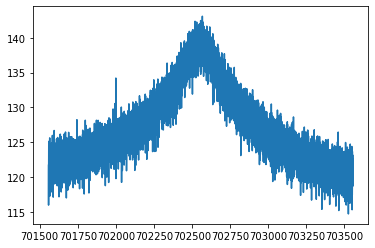

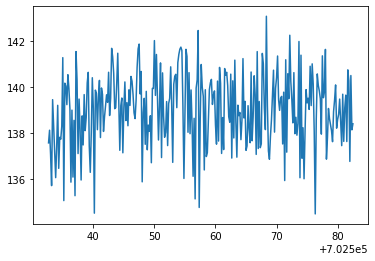

/nuz_trap2_dUvar-0.008_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_26.spec


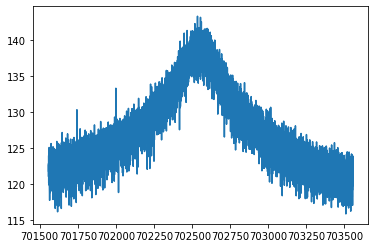

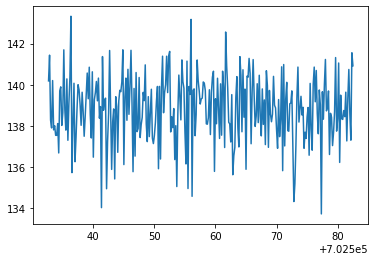

/nuz_trap2_dUvar-0.008_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_27.spec


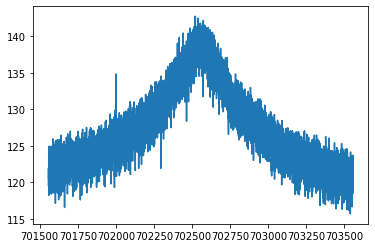

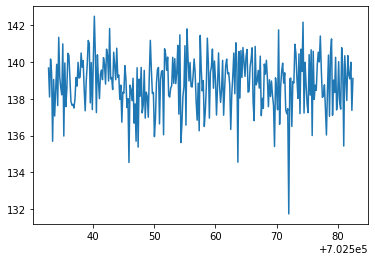

/nuz_trap2_dUvar-0.008_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_28.spec


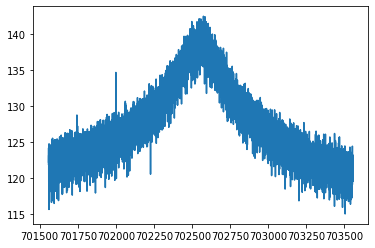

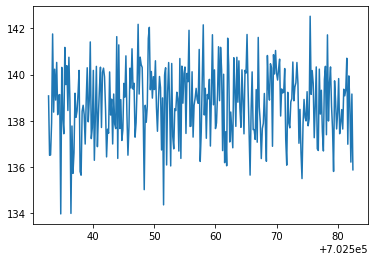

/nuz_trap2_dUvar-0.008_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_29.spec


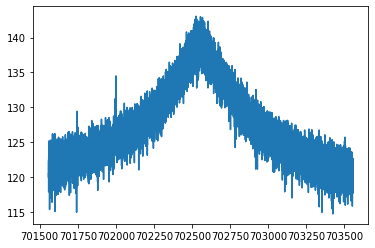

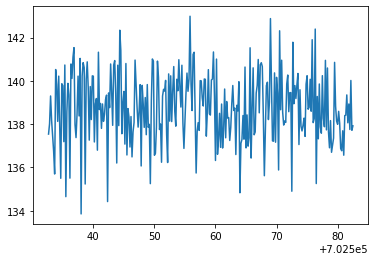

/nuz_trap2_dUvar-0.008_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,21,20220515_115014.158110,-0.008,2,702557.614754725015,0.032767447252,3.719507306022,0.285360040180,3.401720413881,702558.286716128234,6.850176148196,3426.985755284897,29.174352024825
180,22,20220515_122829.308388,-0.008,2,702557.581086685299,0.030484498034,4.028132582912,0.272757534451,2.732568176454,702548.601398000261,6.004234671614,3422.681148214226,29.478461215555
181,23,20220515_130644.269228,-0.008,2,702557.550063278410,0.031090439438,4.228312758687,0.287019641506,2.810320929756,702553.948527367553,5.902464923428,3447.009207946125,29.389118702456
182,24,20220515_134340.967199,-0.008,2,702557.562899705721,0.029820774514,3.956205622809,0.265209704817,2.661709589594,702551.155000522500,5.791631152400,3523.382719534073,30.536849388330


/nuz_trap2_dUvar-0.008_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_30.spec


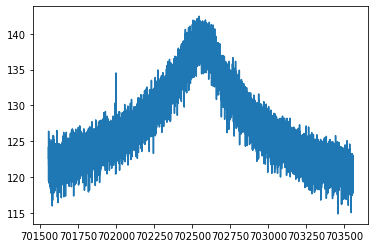

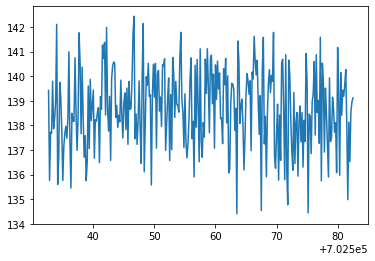

/nuz_trap2_dUvar-0.008_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_31.spec


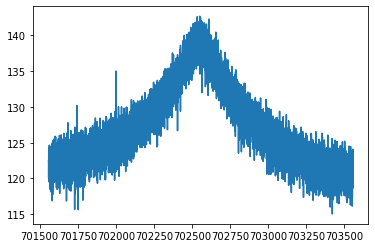

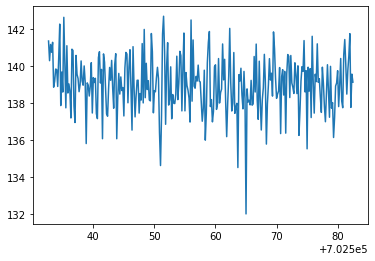

/nuz_trap2_dUvar-0.008_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_32.spec


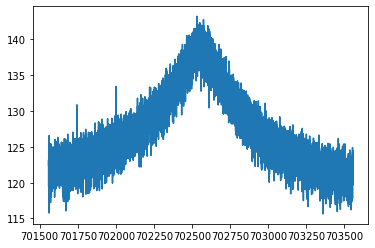

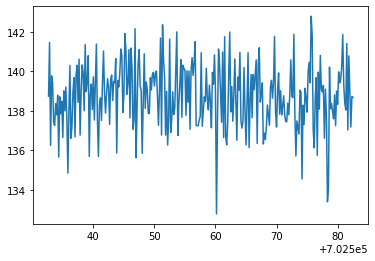

/nuz_trap2_dUvar-0.008_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_33.spec


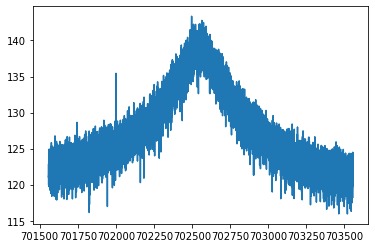

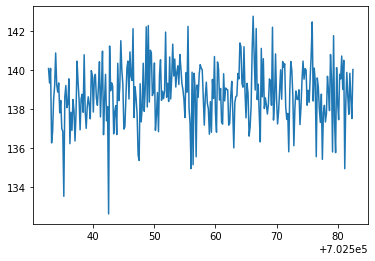

/nuz_trap2_dUvar-0.008_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_34.spec


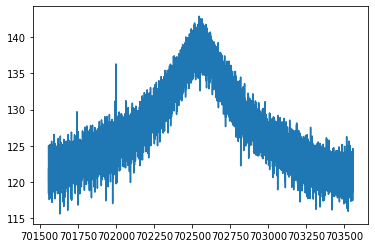

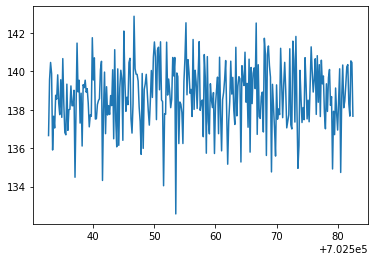

/nuz_trap2_dUvar-0.008_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_35.spec


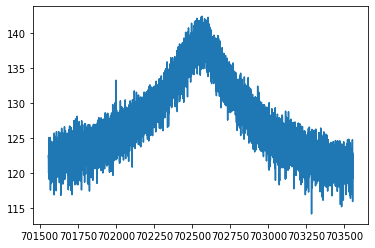

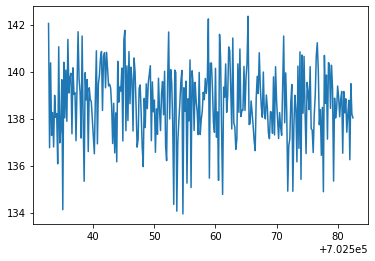

/nuz_trap2_dUvar-0.008_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_36.spec


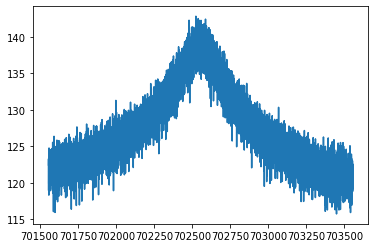

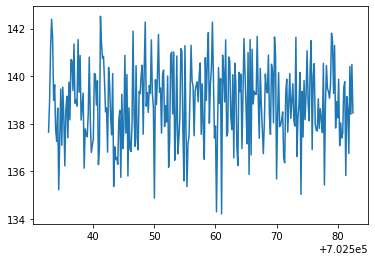

/nuz_trap2_dUvar-0.008_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_37.spec


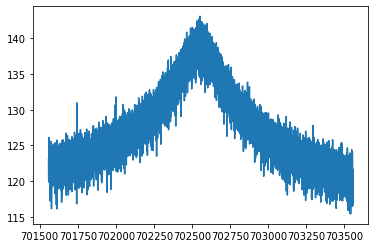

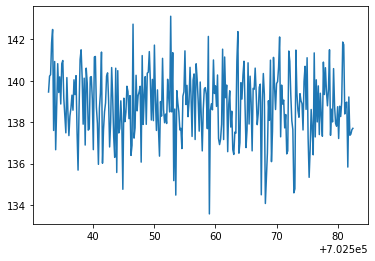

/nuz_trap2_dUvar-0.008_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_38.spec


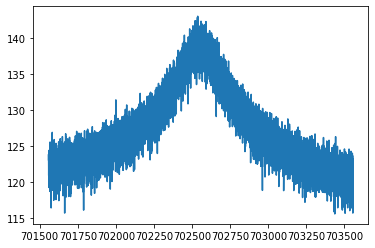

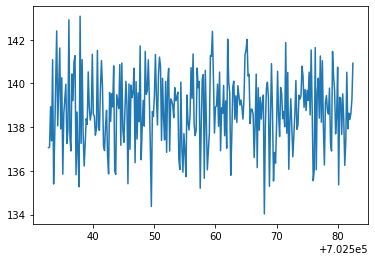

/nuz_trap2_dUvar-0.008_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_39.spec


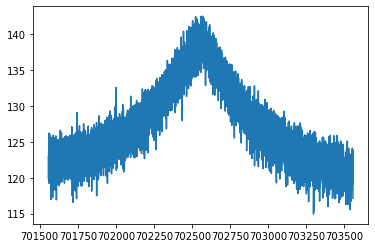

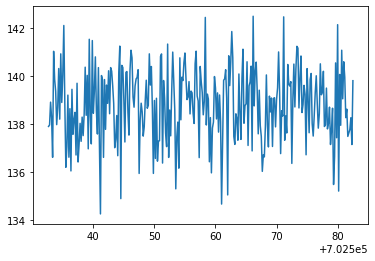

/nuz_trap2_dUvar-0.008_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
180,22,20220515_122829.308388,-0.008,2,702557.581086685299,0.030484498034,4.028132582912,0.272757534451,2.732568176454,702548.601398000261,6.004234671614,3422.681148214226,29.478461215555
181,23,20220515_130644.269228,-0.008,2,702557.550063278410,0.031090439438,4.228312758687,0.287019641506,2.810320929756,702553.948527367553,5.902464923428,3447.009207946125,29.389118702456
182,24,20220515_134340.967199,-0.008,2,702557.562899705721,0.029820774514,3.956205622809,0.265209704817,2.661709589594,702551.155000522500,5.791631152400,3523.382719534073,30.536849388330
183,3,20220515_023901.749559,-0.008,2,702557.582585432334,0.029793632864,3.971979213525,0.264558812676,2.611215613514,702554.240264937398,5.981038999747,3355.006136348335,28.362130276542


/nuz_trap2_dUvar-0.008_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_40.spec


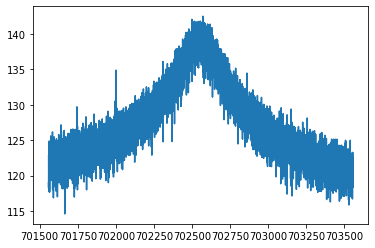

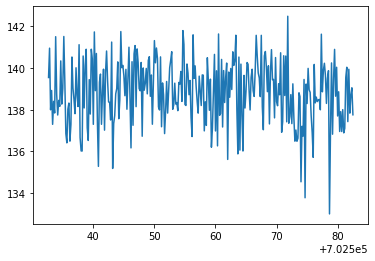

/nuz_trap2_dUvar-0.008_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.008_41.spec


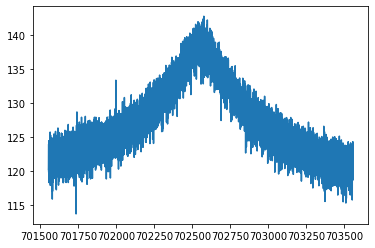

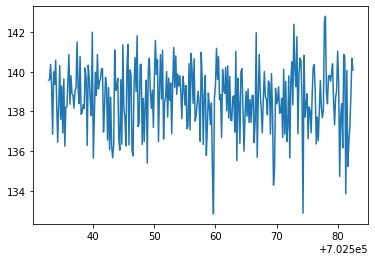

/nuz_trap2_dUvar-0.008_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181,23,20220515_130644.269228,-0.008,2,702557.550063278410,0.031090439438,4.228312758687,0.287019641506,2.810320929756,702553.948527367553,5.902464923428,3447.009207946125,29.389118702456
182,24,20220515_134340.967199,-0.008,2,702557.562899705721,0.029820774514,3.956205622809,0.265209704817,2.661709589594,702551.155000522500,5.791631152400,3523.382719534073,30.536849388330
183,3,20220515_023901.749559,-0.008,2,702557.582585432334,0.029793632864,3.971979213525,0.264558812676,2.611215613514,702554.240264937398,5.981038999747,3355.006136348335,28.362130276542
184,4,20220515_025219.171226,-0.008,2,702557.613528357004,0.031506244462,3.654475111536,0.265229290509,3.001069245650,702545.400166524458,6.577840427707,3424.748447641270,29.193525696806


/nuz_trap2_dUvar-0.008_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
182,24,20220515_134340.967199,-0.008,2,702557.562899705721,0.029820774514,3.956205622809,0.265209704817,2.661709589594,702551.155000522500,5.791631152400,3523.382719534073,30.536849388330
183,3,20220515_023901.749559,-0.008,2,702557.582585432334,0.029793632864,3.971979213525,0.264558812676,2.611215613514,702554.240264937398,5.981038999747,3355.006136348335,28.362130276542
184,4,20220515_025219.171226,-0.008,2,702557.613528357004,0.031506244462,3.654475111536,0.265229290509,3.001069245650,702545.400166524458,6.577840427707,3424.748447641270,29.193525696806
185,5,20220515_033152.457306,-0.008,2,702557.511079475633,0.029977879286,4.174350762692,0.247419091683,2.047851949005,702548.202263345593,5.086083770527,3508.999362613741,31.982085340779


/nuz_trap2_dUvar-0.008_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
183,3,20220515_023901.749559,-0.008,2,702557.582585432334,0.029793632864,3.971979213525,0.264558812676,2.611215613514,702554.240264937398,5.981038999747,3355.006136348335,28.362130276542
184,4,20220515_025219.171226,-0.008,2,702557.613528357004,0.031506244462,3.654475111536,0.265229290509,3.001069245650,702545.400166524458,6.577840427707,3424.748447641270,29.193525696806
185,5,20220515_033152.457306,-0.008,2,702557.511079475633,0.029977879286,4.174350762692,0.247419091683,2.047851949005,702548.202263345593,5.086083770527,3508.999362613741,31.982085340779
186,6,20220515_040730.982206,-0.008,2,702557.595845471718,0.031797026171,3.877313203482,0.280008050117,3.059070124577,702549.489027387579,6.405890893227,3441.392917919113,29.640424895125


/nuz_trap2_dUvar-0.008_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,4,20220515_025219.171226,-0.008,2,702557.613528357004,0.031506244462,3.654475111536,0.265229290509,3.001069245650,702545.400166524458,6.577840427707,3424.748447641270,29.193525696806
185,5,20220515_033152.457306,-0.008,2,702557.511079475633,0.029977879286,4.174350762692,0.247419091683,2.047851949005,702548.202263345593,5.086083770527,3508.999362613741,31.982085340779
186,6,20220515_040730.982206,-0.008,2,702557.595845471718,0.031797026171,3.877313203482,0.280008050117,3.059070124577,702549.489027387579,6.405890893227,3441.392917919113,29.640424895125
187,7,20220515_042610.308103,-0.008,2,702557.592849556706,0.028519727806,4.012051067686,0.244507857163,2.162534425863,702555.243349606753,5.251484326109,3492.462240776831,30.686767095898


/nuz_trap2_dUvar-0.008_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
185,5,20220515_033152.457306,-0.008,2,702557.511079475633,0.029977879286,4.174350762692,0.247419091683,2.047851949005,702548.202263345593,5.086083770527,3508.999362613741,31.982085340779
186,6,20220515_040730.982206,-0.008,2,702557.595845471718,0.031797026171,3.877313203482,0.280008050117,3.059070124577,702549.489027387579,6.405890893227,3441.392917919113,29.640424895125
187,7,20220515_042610.308103,-0.008,2,702557.592849556706,0.028519727806,4.012051067686,0.244507857163,2.162534425863,702555.243349606753,5.251484326109,3492.462240776831,30.686767095898
188,8,20220515_050701.987572,-0.008,2,702557.634477983345,0.031836524563,3.264506034137,0.252527532613,3.208184587138,702551.763717539608,7.131531889543,3390.314980595582,28.934861451803


/nuz_trap2_dUvar-0.009_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
186,6,20220515_040730.982206,-0.008,2,702557.595845471718,0.031797026171,3.877313203482,0.280008050117,3.059070124577,702549.489027387579,6.405890893227,3441.392917919113,29.640424895125
187,7,20220515_042610.308103,-0.008,2,702557.592849556706,0.028519727806,4.012051067686,0.244507857163,2.162534425863,702555.243349606753,5.251484326109,3492.462240776831,30.686767095898
188,8,20220515_050701.987572,-0.008,2,702557.634477983345,0.031836524563,3.264506034137,0.252527532613,3.208184587138,702551.763717539608,7.131531889543,3390.314980595582,28.934861451803
189,9,20220515_053845.085089,-0.008,2,702557.642411481123,0.034306125320,4.443193082138,0.300167544195,2.746461826761,702553.529843021883,5.599036036089,3576.517519753180,33.793544889181


/nuz_trap2_dUvar-0.009_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
187,7,20220515_042610.308103,-0.008,2,702557.592849556706,0.028519727806,4.012051067686,0.244507857163,2.162534425863,702555.243349606753,5.251484326109,3492.462240776831,30.686767095898
188,8,20220515_050701.987572,-0.008,2,702557.634477983345,0.031836524563,3.264506034137,0.252527532613,3.208184587138,702551.763717539608,7.131531889543,3390.314980595582,28.934861451803
189,9,20220515_053845.085089,-0.008,2,702557.642411481123,0.034306125320,4.443193082138,0.300167544195,2.746461826761,702553.529843021883,5.599036036089,3576.517519753180,33.793544889181
190,1,20220515_010940.022675,-0.009,2,702557.642033744371,0.033663783011,4.397022775290,0.305201175407,2.947539089419,702551.949269610224,6.011352906040,3436.397687601700,29.874069663858


/nuz_trap2_dUvar-0.009_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,8,20220515_050701.987572,-0.008,2,702557.634477983345,0.031836524563,3.264506034137,0.252527532613,3.208184587138,702551.763717539608,7.131531889543,3390.314980595582,28.934861451803
189,9,20220515_053845.085089,-0.008,2,702557.642411481123,0.034306125320,4.443193082138,0.300167544195,2.746461826761,702553.529843021883,5.599036036089,3576.517519753180,33.793544889181
190,1,20220515_010940.022675,-0.009,2,702557.642033744371,0.033663783011,4.397022775290,0.305201175407,2.947539089419,702551.949269610224,6.011352906040,3436.397687601700,29.874069663858
191,10,20220515_062450.266975,-0.009,2,702557.608503433294,0.032178127507,4.135194961815,0.292512760756,3.008685068197,702555.288549070712,6.394103380190,3309.913206858758,27.973178742703


/nuz_trap2_dUvar-0.009_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
189,9,20220515_053845.085089,-0.008,2,702557.642411481123,0.034306125320,4.443193082138,0.300167544195,2.746461826761,702553.529843021883,5.599036036089,3576.517519753180,33.793544889181
190,1,20220515_010940.022675,-0.009,2,702557.642033744371,0.033663783011,4.397022775290,0.305201175407,2.947539089419,702551.949269610224,6.011352906040,3436.397687601700,29.874069663858
191,10,20220515_062450.266975,-0.009,2,702557.608503433294,0.032178127507,4.135194961815,0.292512760756,3.008685068197,702555.288549070712,6.394103380190,3309.913206858758,27.973178742703
192,11,20220515_064724.655063,-0.009,2,702557.642979229800,0.034157371800,3.868451683675,0.295298284732,3.416935688032,702555.765833840007,6.834180275706,3398.710735475673,29.085055636867


/nuz_trap2_dUvar-0.009_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,1,20220515_010940.022675,-0.009,2,702557.642033744371,0.033663783011,4.397022775290,0.305201175407,2.947539089419,702551.949269610224,6.011352906040,3436.397687601700,29.874069663858
191,10,20220515_062450.266975,-0.009,2,702557.608503433294,0.032178127507,4.135194961815,0.292512760756,3.008685068197,702555.288549070712,6.394103380190,3309.913206858758,27.973178742703
192,11,20220515_064724.655063,-0.009,2,702557.642979229800,0.034157371800,3.868451683675,0.295298284732,3.416935688032,702555.765833840007,6.834180275706,3398.710735475673,29.085055636867
193,12,20220515_071749.510958,-0.009,2,702557.564600729733,0.031566682793,3.883687478227,0.260549702707,2.574511408345,702548.677371146623,5.631937925858,3645.255765167513,33.928851868721


/nuz_trap2_dUvar-0.009_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
191,10,20220515_062450.266975,-0.009,2,702557.608503433294,0.032178127507,4.135194961815,0.292512760756,3.008685068197,702555.288549070712,6.394103380190,3309.913206858758,27.973178742703
192,11,20220515_064724.655063,-0.009,2,702557.642979229800,0.034157371800,3.868451683675,0.295298284732,3.416935688032,702555.765833840007,6.834180275706,3398.710735475673,29.085055636867
193,12,20220515_071749.510958,-0.009,2,702557.564600729733,0.031566682793,3.883687478227,0.260549702707,2.574511408345,702548.677371146623,5.631937925858,3645.255765167513,33.928851868721
194,13,20220515_075722.862956,-0.009,2,702557.571425813367,0.029976070555,3.900496521881,0.262462150323,2.637968643666,702556.017688394641,5.984597009768,3397.635629336227,29.394495121276


/nuz_trap2_dUvar-0.009_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,11,20220515_064724.655063,-0.009,2,702557.642979229800,0.034157371800,3.868451683675,0.295298284732,3.416935688032,702555.765833840007,6.834180275706,3398.710735475673,29.085055636867
193,12,20220515_071749.510958,-0.009,2,702557.564600729733,0.031566682793,3.883687478227,0.260549702707,2.574511408345,702548.677371146623,5.631937925858,3645.255765167513,33.928851868721
194,13,20220515_075722.862956,-0.009,2,702557.571425813367,0.029976070555,3.900496521881,0.262462150323,2.637968643666,702556.017688394641,5.984597009768,3397.635629336227,29.394495121276
195,14,20220515_080140.174027,-0.009,2,702557.603206009720,0.027940770496,4.459161905960,0.259851602932,2.088548852156,702555.795452573337,5.027264023761,3425.486962254879,29.527243966335


/nuz_trap2_dUvar-0.009_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
193,12,20220515_071749.510958,-0.009,2,702557.564600729733,0.031566682793,3.883687478227,0.260549702707,2.574511408345,702548.677371146623,5.631937925858,3645.255765167513,33.928851868721
194,13,20220515_075722.862956,-0.009,2,702557.571425813367,0.029976070555,3.900496521881,0.262462150323,2.637968643666,702556.017688394641,5.984597009768,3397.635629336227,29.394495121276
195,14,20220515_080140.174027,-0.009,2,702557.603206009720,0.027940770496,4.459161905960,0.259851602932,2.088548852156,702555.795452573337,5.027264023761,3425.486962254879,29.527243966335
196,15,20220515_085417.322407,-0.009,2,702557.618079833221,0.030113741973,4.082913048809,0.271796484498,2.664602668970,702551.220511188498,5.986668647888,3354.671983590212,28.399269519369


/nuz_trap2_dUvar-0.009_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,13,20220515_075722.862956,-0.009,2,702557.571425813367,0.029976070555,3.900496521881,0.262462150323,2.637968643666,702556.017688394641,5.984597009768,3397.635629336227,29.394495121276
195,14,20220515_080140.174027,-0.009,2,702557.603206009720,0.027940770496,4.459161905960,0.259851602932,2.088548852156,702555.795452573337,5.027264023761,3425.486962254879,29.527243966335
196,15,20220515_085417.322407,-0.009,2,702557.618079833221,0.030113741973,4.082913048809,0.271796484498,2.664602668970,702551.220511188498,5.986668647888,3354.671983590212,28.399269519369
197,16,20220515_092047.054386,-0.009,2,702557.573330922867,0.026433708988,4.137739077686,0.240711851377,2.071138318588,702540.778672345681,5.253262476652,3418.430170709040,29.098079668471


/nuz_trap2_dUvar-0.009_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,14,20220515_080140.174027,-0.009,2,702557.603206009720,0.027940770496,4.459161905960,0.259851602932,2.088548852156,702555.795452573337,5.027264023761,3425.486962254879,29.527243966335
196,15,20220515_085417.322407,-0.009,2,702557.618079833221,0.030113741973,4.082913048809,0.271796484498,2.664602668970,702551.220511188498,5.986668647888,3354.671983590212,28.399269519369
197,16,20220515_092047.054386,-0.009,2,702557.573330922867,0.026433708988,4.137739077686,0.240711851377,2.071138318588,702540.778672345681,5.253262476652,3418.430170709040,29.098079668471
198,17,20220515_095506.853264,-0.009,2,702557.597767862026,0.031686601668,3.940683322471,0.268422620981,2.685568099679,702550.968142067781,5.860907098004,3526.398804514160,31.302231202860


/nuz_trap2_dUvar-0.009_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,15,20220515_085417.322407,-0.009,2,702557.618079833221,0.030113741973,4.082913048809,0.271796484498,2.664602668970,702551.220511188498,5.986668647888,3354.671983590212,28.399269519369
197,16,20220515_092047.054386,-0.009,2,702557.573330922867,0.026433708988,4.137739077686,0.240711851377,2.071138318588,702540.778672345681,5.253262476652,3418.430170709040,29.098079668471
198,17,20220515_095506.853264,-0.009,2,702557.597767862026,0.031686601668,3.940683322471,0.268422620981,2.685568099679,702550.968142067781,5.860907098004,3526.398804514160,31.302231202860
199,18,20220515_103558.612293,-0.009,2,702557.568199452246,0.030989095623,4.046366345214,0.276902176739,2.790427633788,702549.043770656688,6.109894733412,3389.861938659743,28.824366209903


/nuz_trap2_dUvar-0.009_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
197,16,20220515_092047.054386,-0.009,2,702557.573330922867,0.026433708988,4.137739077686,0.240711851377,2.071138318588,702540.778672345681,5.253262476652,3418.430170709040,29.098079668471
198,17,20220515_095506.853264,-0.009,2,702557.597767862026,0.031686601668,3.940683322471,0.268422620981,2.685568099679,702550.968142067781,5.860907098004,3526.398804514160,31.302231202860
199,18,20220515_103558.612293,-0.009,2,702557.568199452246,0.030989095623,4.046366345214,0.276902176739,2.790427633788,702549.043770656688,6.109894733412,3389.861938659743,28.824366209903
200,19,20220515_104411.120222,-0.009,2,702557.639371448546,0.032175416706,4.257123673705,0.279821980892,2.599340472773,702547.456487088115,5.569940702499,3568.572077364121,32.615950443814


/nuz_trap2_dUvar-0.009_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
198,17,20220515_095506.853264,-0.009,2,702557.597767862026,0.031686601668,3.940683322471,0.268422620981,2.685568099679,702550.968142067781,5.860907098004,3526.398804514160,31.302231202860
199,18,20220515_103558.612293,-0.009,2,702557.568199452246,0.030989095623,4.046366345214,0.276902176739,2.790427633788,702549.043770656688,6.109894733412,3389.861938659743,28.824366209903
200,19,20220515_104411.120222,-0.009,2,702557.639371448546,0.032175416706,4.257123673705,0.279821980892,2.599340472773,702547.456487088115,5.569940702499,3568.572077364121,32.615950443814
201,2,20220515_014514.131554,-0.009,2,702557.555579013308,0.033042436124,3.997378191170,0.288361570030,3.052551514823,702554.141094743623,6.411489562478,3387.352946866147,28.892320544877


/nuz_trap2_dUvar-0.009_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,18,20220515_103558.612293,-0.009,2,702557.568199452246,0.030989095623,4.046366345214,0.276902176739,2.790427633788,702549.043770656688,6.109894733412,3389.861938659743,28.824366209903
200,19,20220515_104411.120222,-0.009,2,702557.639371448546,0.032175416706,4.257123673705,0.279821980892,2.599340472773,702547.456487088115,5.569940702499,3568.572077364121,32.615950443814
201,2,20220515_014514.131554,-0.009,2,702557.555579013308,0.033042436124,3.997378191170,0.288361570030,3.052551514823,702554.141094743623,6.411489562478,3387.352946866147,28.892320544877
202,20,20220515_112107.750567,-0.009,2,702557.596029058681,0.031058520355,3.929775317783,0.273234538029,2.839830608547,702550.057609134819,6.225265615672,3391.055140947081,28.721305813591


/nuz_trap2_dUvar-0.009_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,19,20220515_104411.120222,-0.009,2,702557.639371448546,0.032175416706,4.257123673705,0.279821980892,2.599340472773,702547.456487088115,5.569940702499,3568.572077364121,32.615950443814
201,2,20220515_014514.131554,-0.009,2,702557.555579013308,0.033042436124,3.997378191170,0.288361570030,3.052551514823,702554.141094743623,6.411489562478,3387.352946866147,28.892320544877
202,20,20220515_112107.750567,-0.009,2,702557.596029058681,0.031058520355,3.929775317783,0.273234538029,2.839830608547,702550.057609134819,6.225265615672,3391.055140947081,28.721305813591
203,21,20220515_115132.522586,-0.009,2,702557.629002150148,0.029383702715,3.456621728699,0.239882989679,2.656539922431,702557.910178255988,6.304640405880,3400.146490808538,28.764140723289


/nuz_trap2_dUvar-0.009_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
201,2,20220515_014514.131554,-0.009,2,702557.555579013308,0.033042436124,3.997378191170,0.288361570030,3.052551514823,702554.141094743623,6.411489562478,3387.352946866147,28.892320544877
202,20,20220515_112107.750567,-0.009,2,702557.596029058681,0.031058520355,3.929775317783,0.273234538029,2.839830608547,702550.057609134819,6.225265615672,3391.055140947081,28.721305813591
203,21,20220515_115132.522586,-0.009,2,702557.629002150148,0.029383702715,3.456621728699,0.239882989679,2.656539922431,702557.910178255988,6.304640405880,3400.146490808538,28.764140723289
204,22,20220515_122710.943866,-0.009,2,702557.646894494304,0.030938251927,3.812273486024,0.263194322032,2.794834274668,702544.942044501775,6.130832045977,3499.889780835175,30.670630744246


/nuz_trap2_dUvar-0.009_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,20,20220515_112107.750567,-0.009,2,702557.596029058681,0.031058520355,3.929775317783,0.273234538029,2.839830608547,702550.057609134819,6.225265615672,3391.055140947081,28.721305813591
203,21,20220515_115132.522586,-0.009,2,702557.629002150148,0.029383702715,3.456621728699,0.239882989679,2.656539922431,702557.910178255988,6.304640405880,3400.146490808538,28.764140723289
204,22,20220515_122710.943866,-0.009,2,702557.646894494304,0.030938251927,3.812273486024,0.263194322032,2.794834274668,702544.942044501775,6.130832045977,3499.889780835175,30.670630744246
205,23,20220515_130012.398097,-0.009,2,702557.611880059936,0.031643779265,3.564525476172,0.262878675100,3.039627507089,702550.385428350535,6.652986395352,3418.173131591612,29.437782120182


/nuz_trap2_dUvar-0.009_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_25.spec


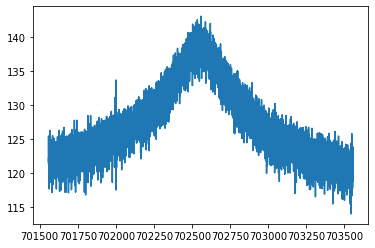

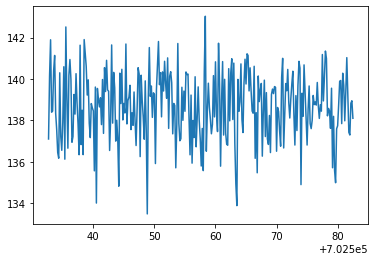

/nuz_trap2_dUvar-0.009_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_26.spec


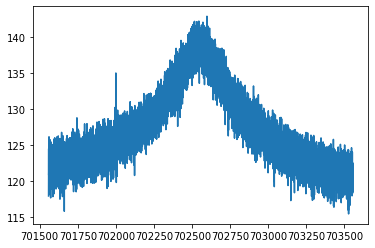

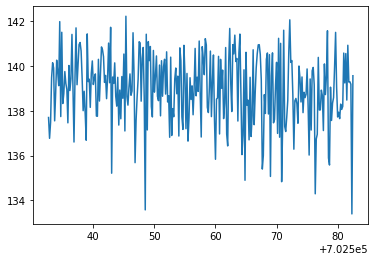

/nuz_trap2_dUvar-0.009_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_27.spec


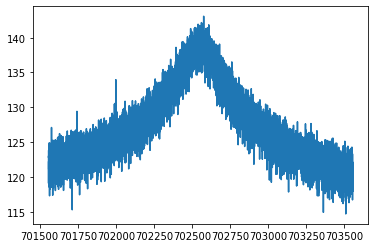

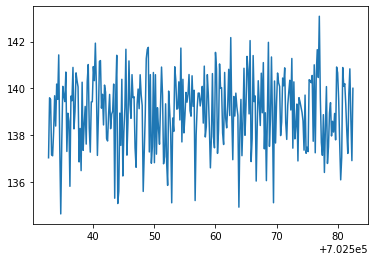

/nuz_trap2_dUvar-0.009_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_28.spec


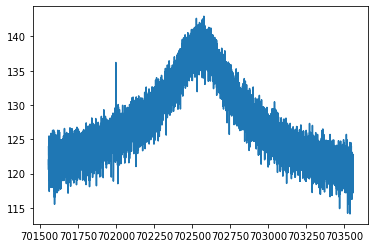

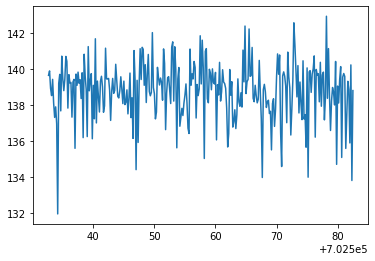

/nuz_trap2_dUvar-0.009_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_29.spec


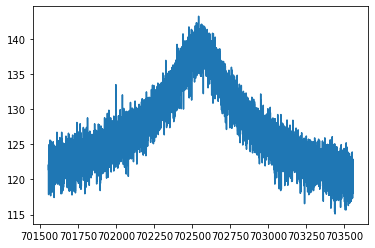

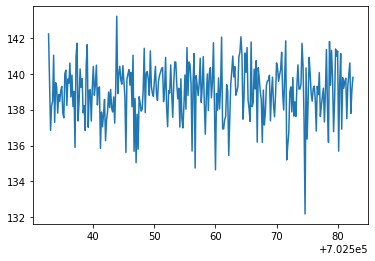

/nuz_trap2_dUvar-0.009_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,21,20220515_115132.522586,-0.009,2,702557.629002150148,0.029383702715,3.456621728699,0.239882989679,2.656539922431,702557.910178255988,6.304640405880,3400.146490808538,28.764140723289
204,22,20220515_122710.943866,-0.009,2,702557.646894494304,0.030938251927,3.812273486024,0.263194322032,2.794834274668,702544.942044501775,6.130832045977,3499.889780835175,30.670630744246
205,23,20220515_130012.398097,-0.009,2,702557.611880059936,0.031643779265,3.564525476172,0.262878675100,3.039627507089,702550.385428350535,6.652986395352,3418.173131591612,29.437782120182
206,24,20220515_133709.098416,-0.009,2,702557.633048012969,0.034227502415,3.929203970953,0.275715620629,2.821923022094,702544.113042577752,5.947923795402,3642.257639141140,34.301097462131


/nuz_trap2_dUvar-0.009_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_30.spec


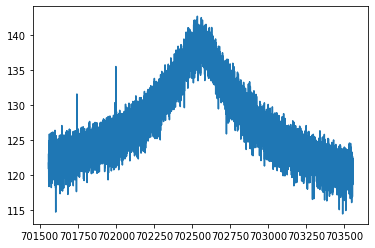

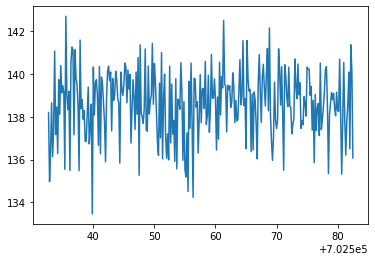

/nuz_trap2_dUvar-0.009_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_31.spec


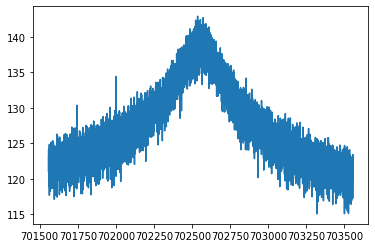

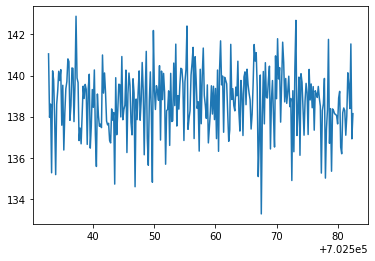

/nuz_trap2_dUvar-0.009_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_32.spec


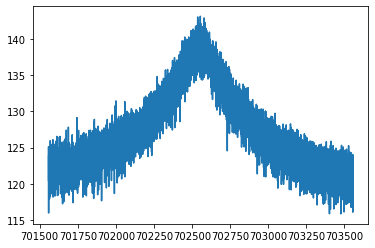

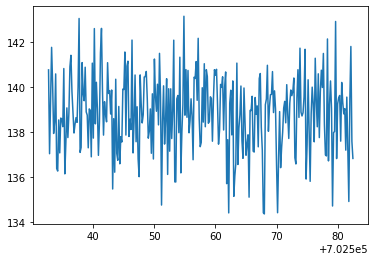

/nuz_trap2_dUvar-0.009_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_33.spec


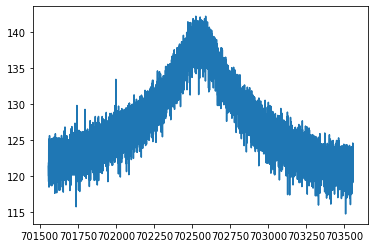

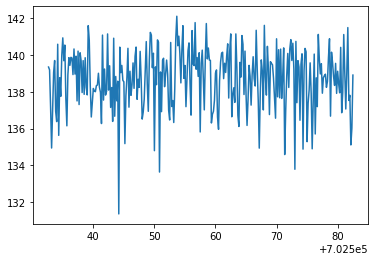

/nuz_trap2_dUvar-0.009_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_34.spec


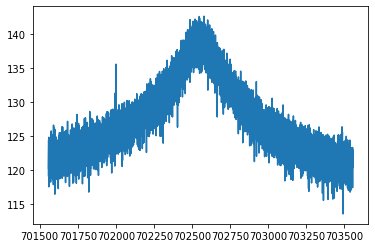

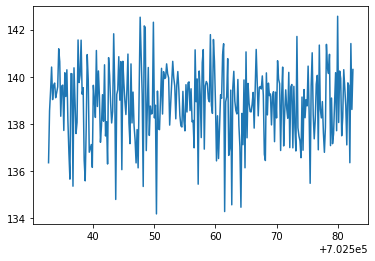

/nuz_trap2_dUvar-0.009_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_35.spec


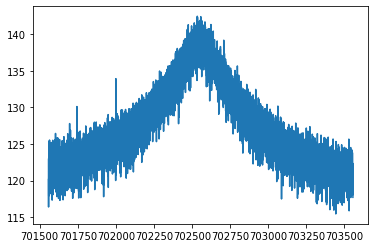

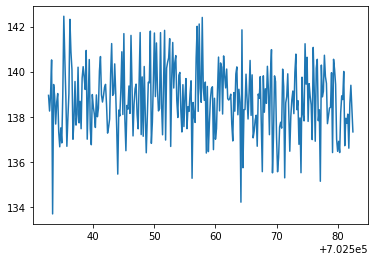

/nuz_trap2_dUvar-0.009_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_36.spec


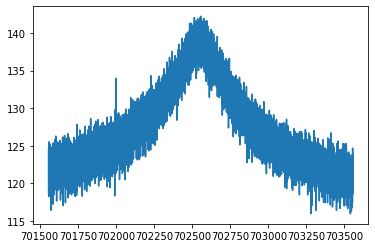

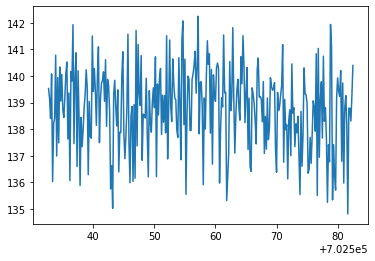

/nuz_trap2_dUvar-0.009_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_37.spec


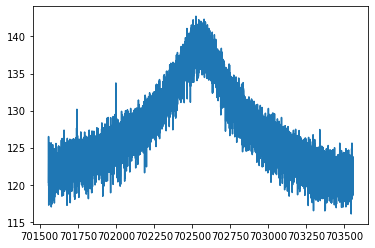

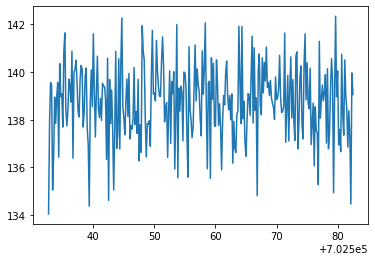

/nuz_trap2_dUvar-0.009_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_38.spec


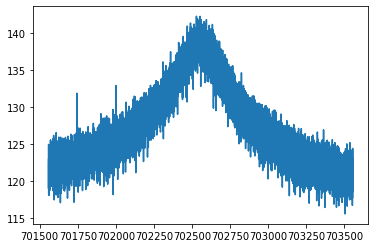

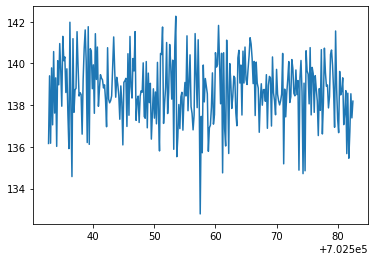

/nuz_trap2_dUvar-0.009_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_39.spec


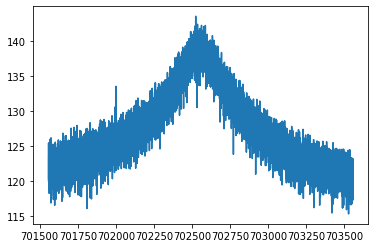

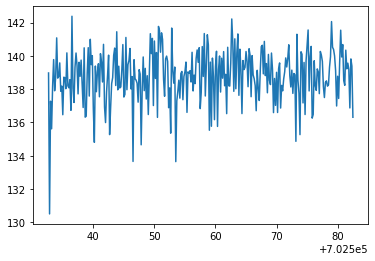

/nuz_trap2_dUvar-0.009_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
204,22,20220515_122710.943866,-0.009,2,702557.646894494304,0.030938251927,3.812273486024,0.263194322032,2.794834274668,702544.942044501775,6.130832045977,3499.889780835175,30.670630744246
205,23,20220515_130012.398097,-0.009,2,702557.611880059936,0.031643779265,3.564525476172,0.262878675100,3.039627507089,702550.385428350535,6.652986395352,3418.173131591612,29.437782120182
206,24,20220515_133709.098416,-0.009,2,702557.633048012969,0.034227502415,3.929203970953,0.275715620629,2.821923022094,702544.113042577752,5.947923795402,3642.257639141140,34.301097462131
207,3,20220515_023743.567390,-0.009,2,702557.634766281000,0.025233492641,3.973014573564,0.219179913320,1.793157062336,702553.860132907517,4.933294597552,3381.263601202780,28.863235243549


/nuz_trap2_dUvar-0.009_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.009_40.spec


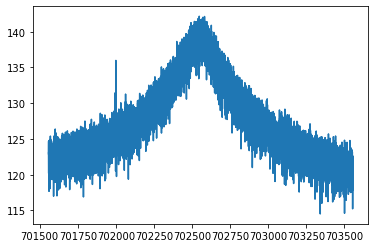

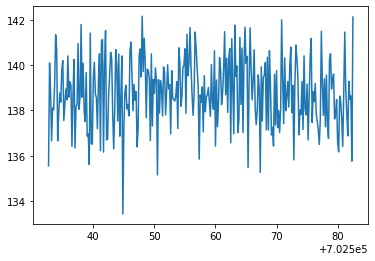

/nuz_trap2_dUvar-0.009_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,23,20220515_130012.398097,-0.009,2,702557.611880059936,0.031643779265,3.564525476172,0.262878675100,3.039627507089,702550.385428350535,6.652986395352,3418.173131591612,29.437782120182
206,24,20220515_133709.098416,-0.009,2,702557.633048012969,0.034227502415,3.929203970953,0.275715620629,2.821923022094,702544.113042577752,5.947923795402,3642.257639141140,34.301097462131
207,3,20220515_023743.567390,-0.009,2,702557.634766281000,0.025233492641,3.973014573564,0.219179913320,1.793157062336,702553.860132907517,4.933294597552,3381.263601202780,28.863235243549
208,4,20220515_024554.791081,-0.009,2,702557.546392426128,0.032214963025,3.708902592320,0.272452024400,3.072048206044,702554.848431445775,6.506161036864,3450.047107296813,30.232091719704


/nuz_trap2_dUvar-0.009_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,24,20220515_133709.098416,-0.009,2,702557.633048012969,0.034227502415,3.929203970953,0.275715620629,2.821923022094,702544.113042577752,5.947923795402,3642.257639141140,34.301097462131
207,3,20220515_023743.567390,-0.009,2,702557.634766281000,0.025233492641,3.973014573564,0.219179913320,1.793157062336,702553.860132907517,4.933294597552,3381.263601202780,28.863235243549
208,4,20220515_024554.791081,-0.009,2,702557.546392426128,0.032214963025,3.708902592320,0.272452024400,3.072048206044,702554.848431445775,6.506161036864,3450.047107296813,30.232091719704
209,5,20220515_034456.231596,-0.009,2,702557.498627186869,0.031512594788,3.168182773700,0.244553410480,3.162412949779,702551.827696946915,7.136264742766,3409.674008546951,29.469999450162


/nuz_trap2_dUvar-0.009_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,3,20220515_023743.567390,-0.009,2,702557.634766281000,0.025233492641,3.973014573564,0.219179913320,1.793157062336,702553.860132907517,4.933294597552,3381.263601202780,28.863235243549
208,4,20220515_024554.791081,-0.009,2,702557.546392426128,0.032214963025,3.708902592320,0.272452024400,3.072048206044,702554.848431445775,6.506161036864,3450.047107296813,30.232091719704
209,5,20220515_034456.231596,-0.009,2,702557.498627186869,0.031512594788,3.168182773700,0.244553410480,3.162412949779,702551.827696946915,7.136264742766,3409.674008546951,29.469999450162
210,6,20220515_035703.778326,-0.009,2,702557.685759275919,0.037789234318,3.619545133132,0.296443456684,3.754377836812,702535.273511399864,7.321889867159,3604.193911487551,33.366704650729


/nuz_trap2_dUvar-0.009_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,4,20220515_024554.791081,-0.009,2,702557.546392426128,0.032214963025,3.708902592320,0.272452024400,3.072048206044,702554.848431445775,6.506161036864,3450.047107296813,30.232091719704
209,5,20220515_034456.231596,-0.009,2,702557.498627186869,0.031512594788,3.168182773700,0.244553410480,3.162412949779,702551.827696946915,7.136264742766,3409.674008546951,29.469999450162
210,6,20220515_035703.778326,-0.009,2,702557.685759275919,0.037789234318,3.619545133132,0.296443456684,3.754377836812,702535.273511399864,7.321889867159,3604.193911487551,33.366704650729
211,7,20220515_043755.590247,-0.009,2,702557.566464832053,0.032225824280,3.395845273906,0.273608468417,3.580747289513,702548.402711253264,7.426505157742,3375.559404948310,28.736889359807


/nuz_trap2_dUvar-0.009_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
209,5,20220515_034456.231596,-0.009,2,702557.498627186869,0.031512594788,3.168182773700,0.244553410480,3.162412949779,702551.827696946915,7.136264742766,3409.674008546951,29.469999450162
210,6,20220515_035703.778326,-0.009,2,702557.685759275919,0.037789234318,3.619545133132,0.296443456684,3.754377836812,702535.273511399864,7.321889867159,3604.193911487551,33.366704650729
211,7,20220515_043755.590247,-0.009,2,702557.566464832053,0.032225824280,3.395845273906,0.273608468417,3.580747289513,702548.402711253264,7.426505157742,3375.559404948310,28.736889359807
212,8,20220515_045239.906240,-0.009,2,702557.539320245734,0.031275420639,4.039902621674,0.267938380417,2.573513110026,702553.807248649071,5.815856503531,3429.757848322612,29.707502394952


/nuz_trap2_dUvar-0.011_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
210,6,20220515_035703.778326,-0.009,2,702557.685759275919,0.037789234318,3.619545133132,0.296443456684,3.754377836812,702535.273511399864,7.321889867159,3604.193911487551,33.366704650729
211,7,20220515_043755.590247,-0.009,2,702557.566464832053,0.032225824280,3.395845273906,0.273608468417,3.580747289513,702548.402711253264,7.426505157742,3375.559404948310,28.736889359807
212,8,20220515_045239.906240,-0.009,2,702557.539320245734,0.031275420639,4.039902621674,0.267938380417,2.573513110026,702553.807248649071,5.815856503531,3429.757848322612,29.707502394952
213,9,20220515_053213.233861,-0.009,2,702557.540899907588,0.030475083551,3.866402868887,0.262128647602,2.675509332271,702549.406142767984,6.131383018134,3370.003113236879,28.606220507872


/nuz_trap2_dUvar-0.011_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,7,20220515_043755.590247,-0.009,2,702557.566464832053,0.032225824280,3.395845273906,0.273608468417,3.580747289513,702548.402711253264,7.426505157742,3375.559404948310,28.736889359807
212,8,20220515_045239.906240,-0.009,2,702557.539320245734,0.031275420639,4.039902621674,0.267938380417,2.573513110026,702553.807248649071,5.815856503531,3429.757848322612,29.707502394952
213,9,20220515_053213.233861,-0.009,2,702557.540899907588,0.030475083551,3.866402868887,0.262128647602,2.675509332271,702549.406142767984,6.131383018134,3370.003113236879,28.606220507872
214,1,20220515_012124.519709,-0.011,2,702557.636523002642,0.028380445070,3.790278772721,0.241074884872,2.346881625861,702548.272751569515,5.752631238318,3397.680500716976,28.952760720792


/nuz_trap2_dUvar-0.011_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,8,20220515_045239.906240,-0.009,2,702557.539320245734,0.031275420639,4.039902621674,0.267938380417,2.573513110026,702553.807248649071,5.815856503531,3429.757848322612,29.707502394952
213,9,20220515_053213.233861,-0.009,2,702557.540899907588,0.030475083551,3.866402868887,0.262128647602,2.675509332271,702549.406142767984,6.131383018134,3370.003113236879,28.606220507872
214,1,20220515_012124.519709,-0.011,2,702557.636523002642,0.028380445070,3.790278772721,0.241074884872,2.346881625861,702548.272751569515,5.752631238318,3397.680500716976,28.952760720792
215,10,20220515_061936.775375,-0.011,2,702557.604522318579,0.033188290237,3.841337411013,0.291502467845,3.357661091675,702553.532749850885,6.834914079032,3372.568378716502,28.494766247389


/nuz_trap2_dUvar-0.011_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
213,9,20220515_053213.233861,-0.009,2,702557.540899907588,0.030475083551,3.866402868887,0.262128647602,2.675509332271,702549.406142767984,6.131383018134,3370.003113236879,28.606220507872
214,1,20220515_012124.519709,-0.011,2,702557.636523002642,0.028380445070,3.790278772721,0.241074884872,2.346881625861,702548.272751569515,5.752631238318,3397.680500716976,28.952760720792
215,10,20220515_061936.775375,-0.011,2,702557.604522318579,0.033188290237,3.841337411013,0.291502467845,3.357661091675,702553.532749850885,6.834914079032,3372.568378716502,28.494766247389
216,11,20220515_063539.383687,-0.011,2,702557.598872908857,0.033268744490,3.703185923214,0.283309391205,3.374559756127,702540.612255556276,6.988222195516,3434.579601494686,29.393107461453


/nuz_trap2_dUvar-0.011_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
214,1,20220515_012124.519709,-0.011,2,702557.636523002642,0.028380445070,3.790278772721,0.241074884872,2.346881625861,702548.272751569515,5.752631238318,3397.680500716976,28.952760720792
215,10,20220515_061936.775375,-0.011,2,702557.604522318579,0.033188290237,3.841337411013,0.291502467845,3.357661091675,702553.532749850885,6.834914079032,3372.568378716502,28.494766247389
216,11,20220515_063539.383687,-0.011,2,702557.598872908857,0.033268744490,3.703185923214,0.283309391205,3.374559756127,702540.612255556276,6.988222195516,3434.579601494686,29.393107461453
217,12,20220515_071236.027365,-0.011,2,702557.656074272236,0.031684997633,3.885968676731,0.267968694425,2.761914795229,702552.032795022009,6.252969977095,3347.879591242582,28.331755649515


/nuz_trap2_dUvar-0.011_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
215,10,20220515_061936.775375,-0.011,2,702557.604522318579,0.033188290237,3.841337411013,0.291502467845,3.357661091675,702553.532749850885,6.834914079032,3372.568378716502,28.494766247389
216,11,20220515_063539.383687,-0.011,2,702557.598872908857,0.033268744490,3.703185923214,0.283309391205,3.374559756127,702540.612255556276,6.988222195516,3434.579601494686,29.393107461453
217,12,20220515_071236.027365,-0.011,2,702557.656074272236,0.031684997633,3.885968676731,0.267968694425,2.761914795229,702552.032795022009,6.252969977095,3347.879591242582,28.331755649515
218,13,20220515_074300.771202,-0.011,2,702557.592027713312,0.027436069639,4.077046002040,0.231076998774,1.876842237022,702547.606270507909,4.790719178415,3592.801930259996,33.397467236998


/nuz_trap2_dUvar-0.011_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
216,11,20220515_063539.383687,-0.011,2,702557.598872908857,0.033268744490,3.703185923214,0.283309391205,3.374559756127,702540.612255556276,6.988222195516,3434.579601494686,29.393107461453
217,12,20220515_071236.027365,-0.011,2,702557.656074272236,0.031684997633,3.885968676731,0.267968694425,2.761914795229,702552.032795022009,6.252969977095,3347.879591242582,28.331755649515
218,13,20220515_074300.771202,-0.011,2,702557.592027713312,0.027436069639,4.077046002040,0.231076998774,1.876842237022,702547.606270507909,4.790719178415,3592.801930259996,33.397467236998
219,14,20220515_081048.827896,-0.011,2,702557.650400448591,0.037340204683,4.102401568033,0.310399720384,3.382654254229,702541.740190166049,6.498431574365,3597.782588624057,33.733765832080


/nuz_trap2_dUvar-0.011_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,12,20220515_071236.027365,-0.011,2,702557.656074272236,0.031684997633,3.885968676731,0.267968694425,2.761914795229,702552.032795022009,6.252969977095,3347.879591242582,28.331755649515
218,13,20220515_074300.771202,-0.011,2,702557.592027713312,0.027436069639,4.077046002040,0.231076998774,1.876842237022,702547.606270507909,4.790719178415,3592.801930259996,33.397467236998
219,14,20220515_081048.827896,-0.011,2,702557.650400448591,0.037340204683,4.102401568033,0.310399720384,3.382654254229,702541.740190166049,6.498431574365,3597.782588624057,33.733765832080
220,15,20220515_085654.083426,-0.011,2,702557.561399880680,0.027224433808,3.731217359758,0.236163539401,2.310183443618,702547.260129786446,5.784465267043,3364.634208728568,28.473101575781


/nuz_trap2_dUvar-0.011_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,13,20220515_074300.771202,-0.011,2,702557.592027713312,0.027436069639,4.077046002040,0.231076998774,1.876842237022,702547.606270507909,4.790719178415,3592.801930259996,33.397467236998
219,14,20220515_081048.827896,-0.011,2,702557.650400448591,0.037340204683,4.102401568033,0.310399720384,3.382654254229,702541.740190166049,6.498431574365,3597.782588624057,33.733765832080
220,15,20220515_085654.083426,-0.011,2,702557.561399880680,0.027224433808,3.731217359758,0.236163539401,2.310183443618,702547.260129786446,5.784465267043,3364.634208728568,28.473101575781
221,16,20220515_091020.059032,-0.011,2,702557.542331108940,0.032593516420,4.226283499495,0.289511998965,2.817618566696,702551.399807645590,6.029447377968,3399.568536428678,29.392917349756


/nuz_trap2_dUvar-0.011_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,14,20220515_081048.827896,-0.011,2,702557.650400448591,0.037340204683,4.102401568033,0.310399720384,3.382654254229,702541.740190166049,6.498431574365,3597.782588624057,33.733765832080
220,15,20220515_085654.083426,-0.011,2,702557.561399880680,0.027224433808,3.731217359758,0.236163539401,2.310183443618,702547.260129786446,5.784465267043,3364.634208728568,28.473101575781
221,16,20220515_091020.059032,-0.011,2,702557.542331108940,0.032593516420,4.226283499495,0.289511998965,2.817618566696,702551.399807645590,6.029447377968,3399.568536428678,29.392917349756
222,17,20220515_095111.761745,-0.011,2,702557.582665098947,0.033040832164,3.691038791240,0.265387800362,2.872371609727,702546.961670808611,6.257126152918,3537.882459092784,31.995464615418


/nuz_trap2_dUvar-0.011_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
220,15,20220515_085654.083426,-0.011,2,702557.561399880680,0.027224433808,3.731217359758,0.236163539401,2.310183443618,702547.260129786446,5.784465267043,3364.634208728568,28.473101575781
221,16,20220515_091020.059032,-0.011,2,702557.542331108940,0.032593516420,4.226283499495,0.289511998965,2.817618566696,702551.399807645590,6.029447377968,3399.568536428678,29.392917349756
222,17,20220515_095111.761745,-0.011,2,702557.582665098947,0.033040832164,3.691038791240,0.265387800362,2.872371609727,702546.961670808611,6.257126152918,3537.882459092784,31.995464615418
223,18,20220515_101741.419383,-0.011,2,702557.585443180287,0.034379681197,3.738677957848,0.283185993408,3.240259230211,702546.989281396149,6.600556592097,3532.863208527291,32.410244160130


/nuz_trap2_dUvar-0.011_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
221,16,20220515_091020.059032,-0.011,2,702557.542331108940,0.032593516420,4.226283499495,0.289511998965,2.817618566696,702551.399807645590,6.029447377968,3399.568536428678,29.392917349756
222,17,20220515_095111.761745,-0.011,2,702557.582665098947,0.033040832164,3.691038791240,0.265387800362,2.872371609727,702546.961670808611,6.257126152918,3537.882459092784,31.995464615418
223,18,20220515_101741.419383,-0.011,2,702557.585443180287,0.034379681197,3.738677957848,0.283185993408,3.240259230211,702546.989281396149,6.600556592097,3532.863208527291,32.410244160130
224,19,20220515_110346.686945,-0.011,2,702557.664905016660,0.032443316139,3.676641024099,0.262694001872,2.875505962447,702549.736438520602,6.324088742886,3480.409128567767,30.947581358809


/nuz_trap2_dUvar-0.011_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
222,17,20220515_095111.761745,-0.011,2,702557.582665098947,0.033040832164,3.691038791240,0.265387800362,2.872371609727,702546.961670808611,6.257126152918,3537.882459092784,31.995464615418
223,18,20220515_101741.419383,-0.011,2,702557.585443180287,0.034379681197,3.738677957848,0.283185993408,3.240259230211,702546.989281396149,6.600556592097,3532.863208527291,32.410244160130
224,19,20220515_110346.686945,-0.011,2,702557.664905016660,0.032443316139,3.676641024099,0.262694001872,2.875505962447,702549.736438520602,6.324088742886,3480.409128567767,30.947581358809
225,2,20220515_020605.046572,-0.011,2,702557.609995815670,0.031519842020,3.754025551956,0.274097727344,3.089617609826,702550.565996332327,6.525740518219,3431.574931577137,29.439280731300


/nuz_trap2_dUvar-0.011_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
223,18,20220515_101741.419383,-0.011,2,702557.585443180287,0.034379681197,3.738677957848,0.283185993408,3.240259230211,702546.989281396149,6.600556592097,3532.863208527291,32.410244160130
224,19,20220515_110346.686945,-0.011,2,702557.664905016660,0.032443316139,3.676641024099,0.262694001872,2.875505962447,702549.736438520602,6.324088742886,3480.409128567767,30.947581358809
225,2,20220515_020605.046572,-0.011,2,702557.609995815670,0.031519842020,3.754025551956,0.274097727344,3.089617609826,702550.565996332327,6.525740518219,3431.574931577137,29.439280731300
226,20,20220515_112739.637407,-0.011,2,702557.554064977681,0.032766057152,3.944262273248,0.288868683607,3.185536097195,702544.054198981961,6.638311384124,3394.101900626306,28.957549538414


/nuz_trap2_dUvar-0.011_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
224,19,20220515_110346.686945,-0.011,2,702557.664905016660,0.032443316139,3.676641024099,0.262694001872,2.875505962447,702549.736438520602,6.324088742886,3480.409128567767,30.947581358809
225,2,20220515_020605.046572,-0.011,2,702557.609995815670,0.031519842020,3.754025551956,0.274097727344,3.089617609826,702550.565996332327,6.525740518219,3431.574931577137,29.439280731300
226,20,20220515_112739.637407,-0.011,2,702557.554064977681,0.032766057152,3.944262273248,0.288868683607,3.185536097195,702544.054198981961,6.638311384124,3394.101900626306,28.957549538414
227,21,20220515_114855.799110,-0.011,2,702557.638399071293,0.029836229329,4.347035173586,0.269883939702,2.423927818742,702535.191918972996,5.740020586202,3381.897807095940,28.784840796273


/nuz_trap2_dUvar-0.011_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
225,2,20220515_020605.046572,-0.011,2,702557.609995815670,0.031519842020,3.754025551956,0.274097727344,3.089617609826,702550.565996332327,6.525740518219,3431.574931577137,29.439280731300
226,20,20220515_112739.637407,-0.011,2,702557.554064977681,0.032766057152,3.944262273248,0.288868683607,3.185536097195,702544.054198981961,6.638311384124,3394.101900626306,28.957549538414
227,21,20220515_114855.799110,-0.011,2,702557.638399071293,0.029836229329,4.347035173586,0.269883939702,2.423927818742,702535.191918972996,5.740020586202,3381.897807095940,28.784840796273
228,22,20220515_122947.668512,-0.011,2,702557.537103519775,0.031687411197,3.943518396825,0.273356223332,2.819763767982,702549.516772074392,6.150959142931,3429.824627559105,29.770904082980


/nuz_trap2_dUvar-0.011_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,20,20220515_112739.637407,-0.011,2,702557.554064977681,0.032766057152,3.944262273248,0.288868683607,3.185536097195,702544.054198981961,6.638311384124,3394.101900626306,28.957549538414
227,21,20220515_114855.799110,-0.011,2,702557.638399071293,0.029836229329,4.347035173586,0.269883939702,2.423927818742,702535.191918972996,5.740020586202,3381.897807095940,28.784840796273
228,22,20220515_122947.668512,-0.011,2,702557.537103519775,0.031687411197,3.943518396825,0.273356223332,2.819763767982,702549.516772074392,6.150959142931,3429.824627559105,29.770904082980
229,23,20220515_131552.906703,-0.011,2,702557.617284466978,0.030284036242,3.668393220868,0.255445124681,2.782379797117,702543.416800868465,6.255329094907,3481.209277155192,30.566258531396


/nuz_trap2_dUvar-0.011_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_25.spec


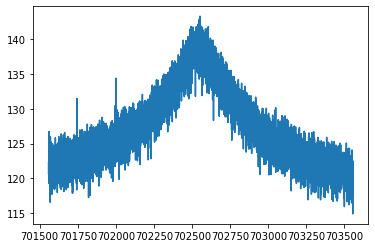

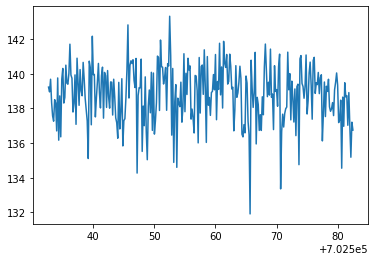

/nuz_trap2_dUvar-0.011_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_26.spec


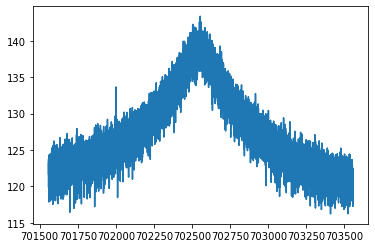

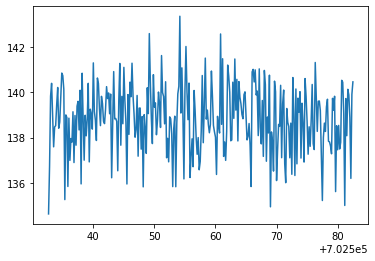

/nuz_trap2_dUvar-0.011_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_27.spec


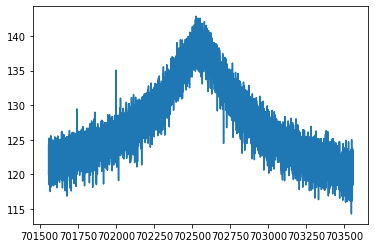

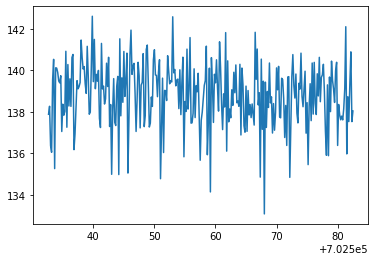

/nuz_trap2_dUvar-0.011_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_28.spec


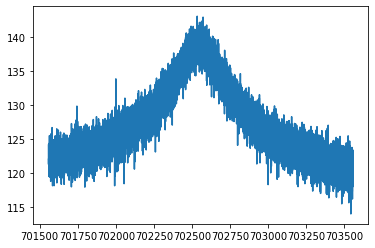

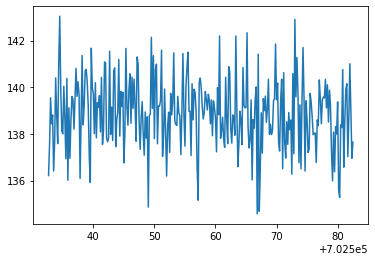

/nuz_trap2_dUvar-0.011_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_29.spec


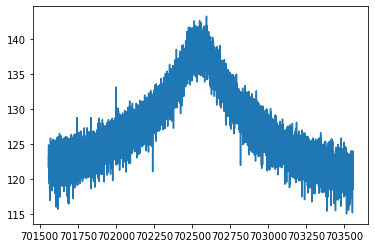

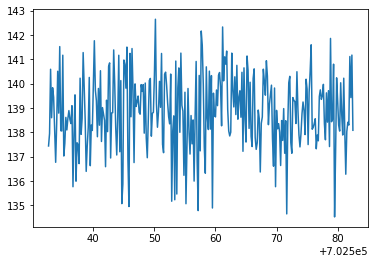

/nuz_trap2_dUvar-0.011_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
227,21,20220515_114855.799110,-0.011,2,702557.638399071293,0.029836229329,4.347035173586,0.269883939702,2.423927818742,702535.191918972996,5.740020586202,3381.897807095940,28.784840796273
228,22,20220515_122947.668512,-0.011,2,702557.537103519775,0.031687411197,3.943518396825,0.273356223332,2.819763767982,702549.516772074392,6.150959142931,3429.824627559105,29.770904082980
229,23,20220515_131552.906703,-0.011,2,702557.617284466978,0.030284036242,3.668393220868,0.255445124681,2.782379797117,702543.416800868465,6.255329094907,3481.209277155192,30.566258531396
230,24,20220515_132642.094503,-0.011,2,702557.641182419844,0.030951461767,3.790713505014,0.261952065194,2.799894619105,702539.709878816386,6.399593419345,3393.113112649608,29.153802199914


/nuz_trap2_dUvar-0.011_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_30.spec


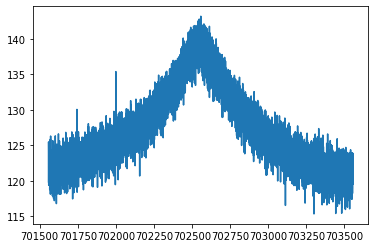

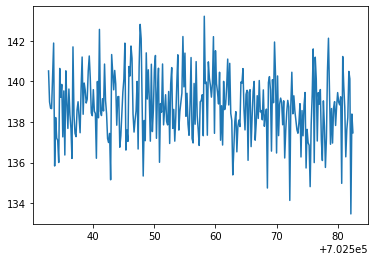

/nuz_trap2_dUvar-0.011_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_31.spec


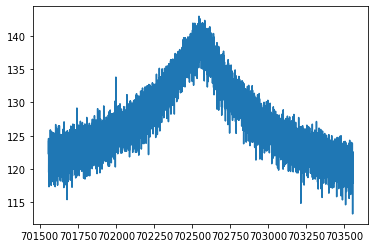

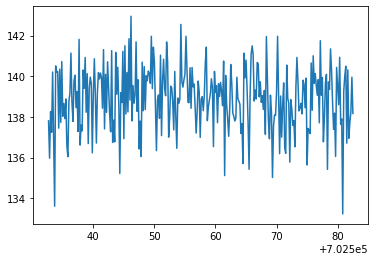

/nuz_trap2_dUvar-0.011_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_32.spec


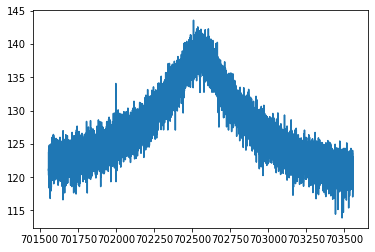

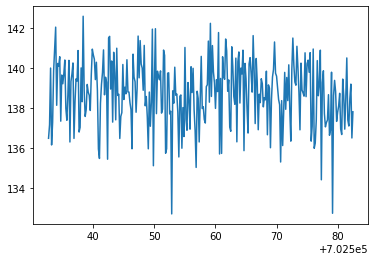

/nuz_trap2_dUvar-0.011_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_33.spec


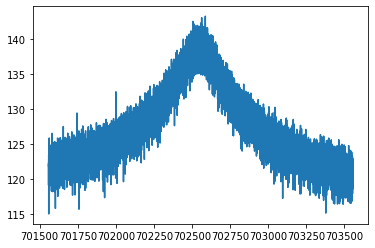

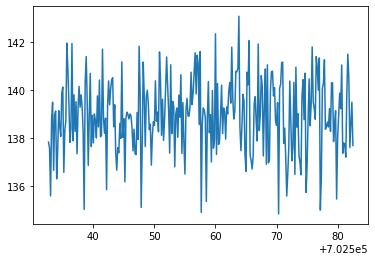

/nuz_trap2_dUvar-0.011_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_34.spec


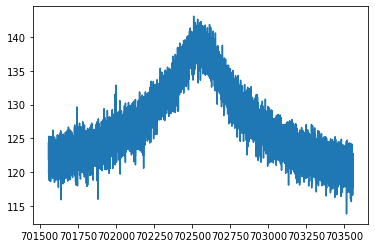

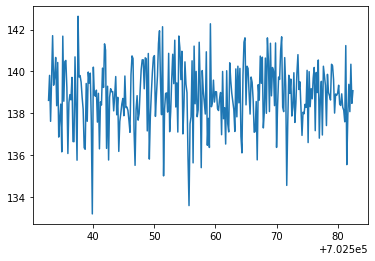

/nuz_trap2_dUvar-0.011_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_35.spec


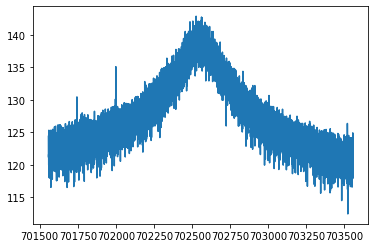

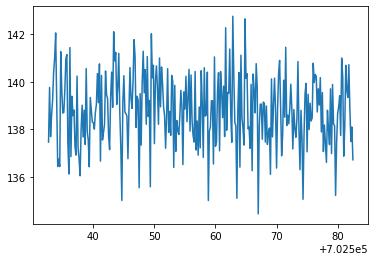

/nuz_trap2_dUvar-0.011_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_36.spec


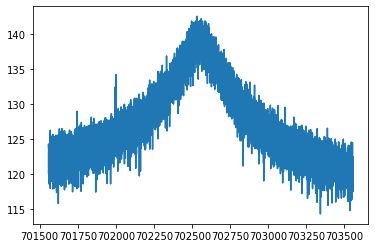

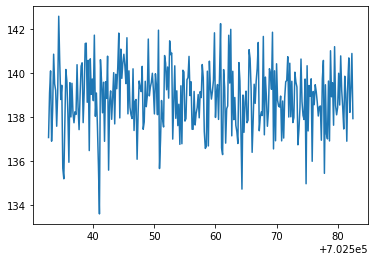

/nuz_trap2_dUvar-0.011_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_37.spec


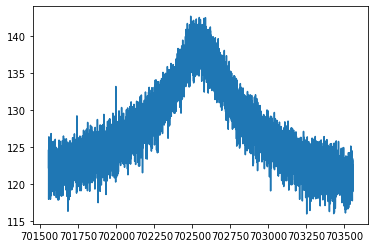

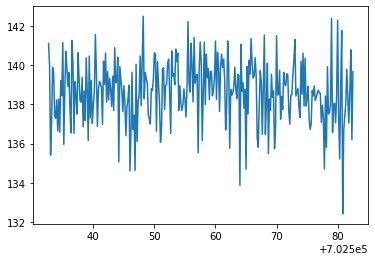

/nuz_trap2_dUvar-0.011_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_38.spec


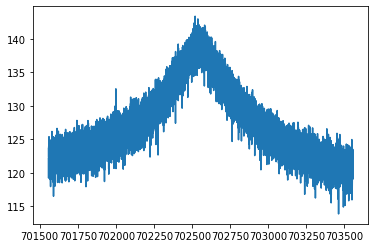

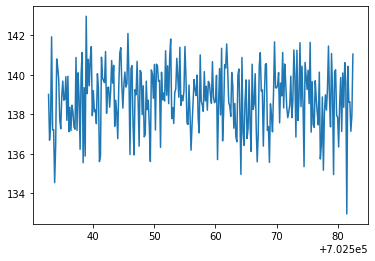

/nuz_trap2_dUvar-0.011_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_39.spec


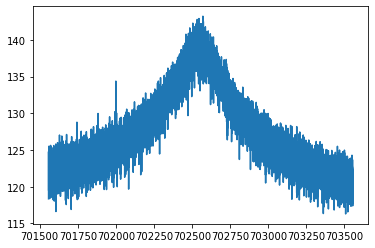

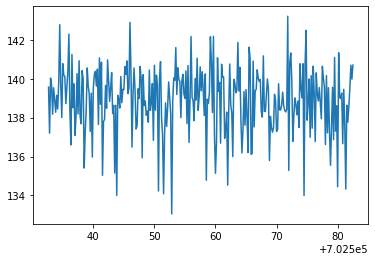

/nuz_trap2_dUvar-0.011_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
228,22,20220515_122947.668512,-0.011,2,702557.537103519775,0.031687411197,3.943518396825,0.273356223332,2.819763767982,702549.516772074392,6.150959142931,3429.824627559105,29.770904082980
229,23,20220515_131552.906703,-0.011,2,702557.617284466978,0.030284036242,3.668393220868,0.255445124681,2.782379797117,702543.416800868465,6.255329094907,3481.209277155192,30.566258531396
230,24,20220515_132642.094503,-0.011,2,702557.641182419844,0.030951461767,3.790713505014,0.261952065194,2.799894619105,702539.709878816386,6.399593419345,3393.113112649608,29.153802199914
231,3,20220515_023507.195471,-0.011,2,702557.548258493072,0.034492367496,4.531491490702,0.319097982891,3.100035510605,702542.724438156118,6.318835177932,3352.844664183882,28.533802797786


/nuz_trap2_dUvar-0.011_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_40.spec


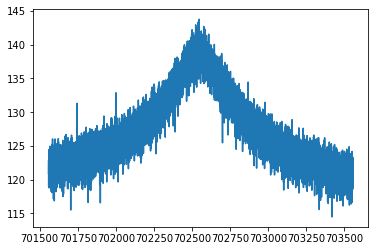

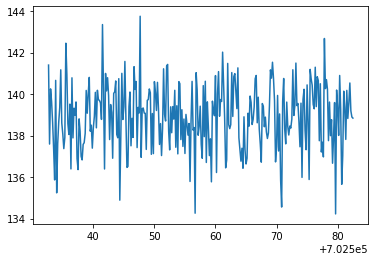

/nuz_trap2_dUvar-0.011_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.011_41.spec


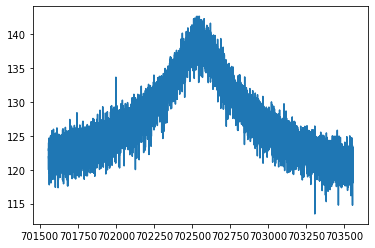

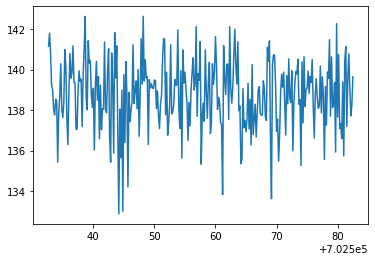

/nuz_trap2_dUvar-0.011_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
229,23,20220515_131552.906703,-0.011,2,702557.617284466978,0.030284036242,3.668393220868,0.255445124681,2.782379797117,702543.416800868465,6.255329094907,3481.209277155192,30.566258531396
230,24,20220515_132642.094503,-0.011,2,702557.641182419844,0.030951461767,3.790713505014,0.261952065194,2.799894619105,702539.709878816386,6.399593419345,3393.113112649608,29.153802199914
231,3,20220515_023507.195471,-0.011,2,702557.548258493072,0.034492367496,4.531491490702,0.319097982891,3.100035510605,702542.724438156118,6.318835177932,3352.844664183882,28.533802797786
232,4,20220515_025614.269480,-0.011,2,702557.577777919709,0.027882726227,3.437556603158,0.230853595793,2.462626867773,702552.763769798679,6.150846687150,3361.000220625967,28.751577067002


/nuz_trap2_dUvar-0.011_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,24,20220515_132642.094503,-0.011,2,702557.641182419844,0.030951461767,3.790713505014,0.261952065194,2.799894619105,702539.709878816386,6.399593419345,3393.113112649608,29.153802199914
231,3,20220515_023507.195471,-0.011,2,702557.548258493072,0.034492367496,4.531491490702,0.319097982891,3.100035510605,702542.724438156118,6.318835177932,3352.844664183882,28.533802797786
232,4,20220515_025614.269480,-0.011,2,702557.577777919709,0.027882726227,3.437556603158,0.230853595793,2.462626867773,702552.763769798679,6.150846687150,3361.000220625967,28.751577067002
233,5,20220515_032402.250517,-0.011,2,702557.620400303626,0.032428687469,3.587275783955,0.271774859381,3.237612340822,702550.152119251550,6.895375526636,3389.948045323496,28.707212633354


/nuz_trap2_dUvar-0.011_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
231,3,20220515_023507.195471,-0.011,2,702557.548258493072,0.034492367496,4.531491490702,0.319097982891,3.100035510605,702542.724438156118,6.318835177932,3352.844664183882,28.533802797786
232,4,20220515_025614.269480,-0.011,2,702557.577777919709,0.027882726227,3.437556603158,0.230853595793,2.462626867773,702552.763769798679,6.150846687150,3361.000220625967,28.751577067002
233,5,20220515_032402.250517,-0.011,2,702557.620400303626,0.032428687469,3.587275783955,0.271774859381,3.237612340822,702550.152119251550,6.895375526636,3389.948045323496,28.707212633354
234,6,20220515_040217.476719,-0.011,2,702557.532791617443,0.035701857020,4.362432176948,0.317009454989,3.192225965479,702550.757020441699,6.314014812079,3426.747979949532,29.967522107728


/nuz_trap2_dUvar-0.011_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
232,4,20220515_025614.269480,-0.011,2,702557.577777919709,0.027882726227,3.437556603158,0.230853595793,2.462626867773,702552.763769798679,6.150846687150,3361.000220625967,28.751577067002
233,5,20220515_032402.250517,-0.011,2,702557.620400303626,0.032428687469,3.587275783955,0.271774859381,3.237612340822,702550.152119251550,6.895375526636,3389.948045323496,28.707212633354
234,6,20220515_040217.476719,-0.011,2,702557.532791617443,0.035701857020,4.362432176948,0.317009454989,3.192225965479,702550.757020441699,6.314014812079,3426.747979949532,29.967522107728
235,7,20220515_042333.571326,-0.011,2,702557.556761616375,0.033097497977,3.767704942034,0.272202025076,2.949104595826,702548.896028726129,6.336970723709,3488.324119148833,32.031897644713


/nuz_trap2_dUvar-0.011_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
233,5,20220515_032402.250517,-0.011,2,702557.620400303626,0.032428687469,3.587275783955,0.271774859381,3.237612340822,702550.152119251550,6.895375526636,3389.948045323496,28.707212633354
234,6,20220515_040217.476719,-0.011,2,702557.532791617443,0.035701857020,4.362432176948,0.317009454989,3.192225965479,702550.757020441699,6.314014812079,3426.747979949532,29.967522107728
235,7,20220515_042333.571326,-0.011,2,702557.556761616375,0.033097497977,3.767704942034,0.272202025076,2.949104595826,702548.896028726129,6.336970723709,3488.324119148833,32.031897644713
236,8,20220515_050030.129371,-0.011,2,702557.583263686392,0.030853869307,4.127597871867,0.279608973543,2.780256761629,702544.863645512611,6.037323356220,3421.247831785213,29.229096961557


/nuz_trap2_dUvar-0.012_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
234,6,20220515_040217.476719,-0.011,2,702557.532791617443,0.035701857020,4.362432176948,0.317009454989,3.192225965479,702550.757020441699,6.314014812079,3426.747979949532,29.967522107728
235,7,20220515_042333.571326,-0.011,2,702557.556761616375,0.033097497977,3.767704942034,0.272202025076,2.949104595826,702548.896028726129,6.336970723709,3488.324119148833,32.031897644713
236,8,20220515_050030.129371,-0.011,2,702557.583263686392,0.030853869307,4.127597871867,0.279608973543,2.780256761629,702544.863645512611,6.037323356220,3421.247831785213,29.229096961557
237,9,20220515_052659.772385,-0.011,2,702557.633144634543,0.033380793323,3.586639761846,0.274519094530,3.306090723340,702544.041252973606,7.085813630504,3370.887283214858,28.820905166685


/nuz_trap2_dUvar-0.012_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,7,20220515_042333.571326,-0.011,2,702557.556761616375,0.033097497977,3.767704942034,0.272202025076,2.949104595826,702548.896028726129,6.336970723709,3488.324119148833,32.031897644713
236,8,20220515_050030.129371,-0.011,2,702557.583263686392,0.030853869307,4.127597871867,0.279608973543,2.780256761629,702544.863645512611,6.037323356220,3421.247831785213,29.229096961557
237,9,20220515_052659.772385,-0.011,2,702557.633144634543,0.033380793323,3.586639761846,0.274519094530,3.306090723340,702544.041252973606,7.085813630504,3370.887283214858,28.820905166685
238,1,20220515_011453.475651,-0.012,2,702557.805997495307,0.034317838843,4.585252454942,0.318332485389,3.101245147351,702531.900470131775,6.403992980811,3402.780253366297,29.099041124989


/nuz_trap2_dUvar-0.012_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
236,8,20220515_050030.129371,-0.011,2,702557.583263686392,0.030853869307,4.127597871867,0.279608973543,2.780256761629,702544.863645512611,6.037323356220,3421.247831785213,29.229096961557
237,9,20220515_052659.772385,-0.011,2,702557.633144634543,0.033380793323,3.586639761846,0.274519094530,3.306090723340,702544.041252973606,7.085813630504,3370.887283214858,28.820905166685
238,1,20220515_011453.475651,-0.012,2,702557.805997495307,0.034317838843,4.585252454942,0.318332485389,3.101245147351,702531.900470131775,6.403992980811,3402.780253366297,29.099041124989
239,10,20220515_061818.392169,-0.012,2,702557.665709959809,0.028537918347,3.468258059067,0.231139095193,2.469508438033,702548.306580503122,6.200995908703,3347.733726577796,28.243114362781


/nuz_trap2_dUvar-0.012_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
237,9,20220515_052659.772385,-0.011,2,702557.633144634543,0.033380793323,3.586639761846,0.274519094530,3.306090723340,702544.041252973606,7.085813630504,3370.887283214858,28.820905166685
238,1,20220515_011453.475651,-0.012,2,702557.805997495307,0.034317838843,4.585252454942,0.318332485389,3.101245147351,702531.900470131775,6.403992980811,3402.780253366297,29.099041124989
239,10,20220515_061818.392169,-0.012,2,702557.665709959809,0.028537918347,3.468258059067,0.231139095193,2.469508438033,702548.306580503122,6.200995908703,3347.733726577796,28.243114362781
240,11,20220515_062907.576285,-0.012,2,702557.662951405044,0.033473386390,4.011853310452,0.273887960017,2.701095495637,702545.714971136185,5.778789072611,3620.309822442628,33.550456056114


/nuz_trap2_dUvar-0.012_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
238,1,20220515_011453.475651,-0.012,2,702557.805997495307,0.034317838843,4.585252454942,0.318332485389,3.101245147351,702531.900470131775,6.403992980811,3402.780253366297,29.099041124989
239,10,20220515_061818.392169,-0.012,2,702557.665709959809,0.028537918347,3.468258059067,0.231139095193,2.469508438033,702548.306580503122,6.200995908703,3347.733726577796,28.243114362781
240,11,20220515_062907.576285,-0.012,2,702557.662951405044,0.033473386390,4.011853310452,0.273887960017,2.701095495637,702545.714971136185,5.778789072611,3620.309822442628,33.550456056114
241,12,20220515_072144.607478,-0.012,2,702557.647983135073,0.033509726683,4.538982712144,0.300222303431,2.684298496700,702547.963514349307,5.583826457218,3527.697382921980,31.815430970636


/nuz_trap2_dUvar-0.012_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
239,10,20220515_061818.392169,-0.012,2,702557.665709959809,0.028537918347,3.468258059067,0.231139095193,2.469508438033,702548.306580503122,6.200995908703,3347.733726577796,28.243114362781
240,11,20220515_062907.576285,-0.012,2,702557.662951405044,0.033473386390,4.011853310452,0.273887960017,2.701095495637,702545.714971136185,5.778789072611,3620.309822442628,33.550456056114
241,12,20220515_072144.607478,-0.012,2,702557.647983135073,0.033509726683,4.538982712144,0.300222303431,2.684298496700,702547.963514349307,5.583826457218,3527.697382921980,31.815430970636
242,13,20220515_075959.595571,-0.012,2,702557.545225250069,0.028816068253,4.195195919842,0.262626582020,2.388471777455,702546.988523816690,5.625644266107,3365.513480334825,28.632560162245


/nuz_trap2_dUvar-0.012_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
240,11,20220515_062907.576285,-0.012,2,702557.662951405044,0.033473386390,4.011853310452,0.273887960017,2.701095495637,702545.714971136185,5.778789072611,3620.309822442628,33.550456056114
241,12,20220515_072144.607478,-0.012,2,702557.647983135073,0.033509726683,4.538982712144,0.300222303431,2.684298496700,702547.963514349307,5.583826457218,3527.697382921980,31.815430970636
242,13,20220515_075959.595571,-0.012,2,702557.545225250069,0.028816068253,4.195195919842,0.262626582020,2.388471777455,702546.988523816690,5.625644266107,3365.513480334825,28.632560162245
243,14,20220515_081957.498747,-0.012,2,702557.584779586759,0.031058464778,4.255800825640,0.279020994351,2.616137216134,702543.421339570079,5.873808641577,3388.989587438785,29.130994051972


/nuz_trap2_dUvar-0.012_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,12,20220515_072144.607478,-0.012,2,702557.647983135073,0.033509726683,4.538982712144,0.300222303431,2.684298496700,702547.963514349307,5.583826457218,3527.697382921980,31.815430970636
242,13,20220515_075959.595571,-0.012,2,702557.545225250069,0.028816068253,4.195195919842,0.262626582020,2.388471777455,702546.988523816690,5.625644266107,3365.513480334825,28.632560162245
243,14,20220515_081957.498747,-0.012,2,702557.584779586759,0.031058464778,4.255800825640,0.279020994351,2.616137216134,702543.421339570079,5.873808641577,3388.989587438785,29.130994051972
244,15,20220515_084745.387125,-0.012,2,702557.592438452877,0.030083619136,3.856764225764,0.262258652630,2.684534242862,702552.102889916627,6.144145702314,3356.111842967749,28.770150832400


/nuz_trap2_dUvar-0.012_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,13,20220515_075959.595571,-0.012,2,702557.545225250069,0.028816068253,4.195195919842,0.262626582020,2.388471777455,702546.988523816690,5.625644266107,3365.513480334825,28.632560162245
243,14,20220515_081957.498747,-0.012,2,702557.584779586759,0.031058464778,4.255800825640,0.279020994351,2.616137216134,702543.421339570079,5.873808641577,3388.989587438785,29.130994051972
244,15,20220515_084745.387125,-0.012,2,702557.592438452877,0.030083619136,3.856764225764,0.262258652630,2.684534242862,702552.102889916627,6.144145702314,3356.111842967749,28.770150832400
245,16,20220515_091928.687629,-0.012,2,702557.593121412676,0.032700931281,4.689265708266,0.313054445408,2.820051403151,702544.629614768550,5.931922340166,3344.155809704964,28.199226317326


/nuz_trap2_dUvar-0.012_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,14,20220515_081957.498747,-0.012,2,702557.584779586759,0.031058464778,4.255800825640,0.279020994351,2.616137216134,702543.421339570079,5.873808641577,3388.989587438785,29.130994051972
244,15,20220515_084745.387125,-0.012,2,702557.592438452877,0.030083619136,3.856764225764,0.262258652630,2.684534242862,702552.102889916627,6.144145702314,3356.111842967749,28.770150832400
245,16,20220515_091928.687629,-0.012,2,702557.593121412676,0.032700931281,4.689265708266,0.313054445408,2.820051403151,702544.629614768550,5.931922340166,3344.155809704964,28.199226317326
246,17,20220515_095743.593821,-0.012,2,702557.552145770285,0.028455509706,3.978688021130,0.247750937375,2.277971457097,702551.049698594958,5.495651706442,3431.255614171764,29.598425563565


/nuz_trap2_dUvar-0.012_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
244,15,20220515_084745.387125,-0.012,2,702557.592438452877,0.030083619136,3.856764225764,0.262258652630,2.684534242862,702552.102889916627,6.144145702314,3356.111842967749,28.770150832400
245,16,20220515_091928.687629,-0.012,2,702557.593121412676,0.032700931281,4.689265708266,0.313054445408,2.820051403151,702544.629614768550,5.931922340166,3344.155809704964,28.199226317326
246,17,20220515_095743.593821,-0.012,2,702557.552145770285,0.028455509706,3.978688021130,0.247750937375,2.277971457097,702551.049698594958,5.495651706442,3431.255614171764,29.598425563565
247,18,20220515_103203.523947,-0.012,2,702557.588926439057,0.027643137727,4.157324977503,0.254835620382,2.295671107692,702544.968670235132,5.499250952108,3394.390515276641,28.777503879509


/nuz_trap2_dUvar-0.012_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,16,20220515_091928.687629,-0.012,2,702557.593121412676,0.032700931281,4.689265708266,0.313054445408,2.820051403151,702544.629614768550,5.931922340166,3344.155809704964,28.199226317326
246,17,20220515_095743.593821,-0.012,2,702557.552145770285,0.028455509706,3.978688021130,0.247750937375,2.277971457097,702551.049698594958,5.495651706442,3431.255614171764,29.598425563565
247,18,20220515_103203.523947,-0.012,2,702557.588926439057,0.027643137727,4.157324977503,0.254835620382,2.295671107692,702544.968670235132,5.499250952108,3394.390515276641,28.777503879509
248,19,20220515_105556.467081,-0.012,2,702557.527927938616,0.029928729107,3.818769745818,0.258654154938,2.680678479071,702549.306053971755,6.190094496724,3350.466331014817,28.637351514637


/nuz_trap2_dUvar-0.012_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
246,17,20220515_095743.593821,-0.012,2,702557.552145770285,0.028455509706,3.978688021130,0.247750937375,2.277971457097,702551.049698594958,5.495651706442,3431.255614171764,29.598425563565
247,18,20220515_103203.523947,-0.012,2,702557.588926439057,0.027643137727,4.157324977503,0.254835620382,2.295671107692,702544.968670235132,5.499250952108,3394.390515276641,28.777503879509
248,19,20220515_105556.467081,-0.012,2,702557.527927938616,0.029928729107,3.818769745818,0.258654154938,2.680678479071,702549.306053971755,6.190094496724,3350.466331014817,28.637351514637
249,2,20220515_014355.947134,-0.012,2,702557.587198643829,0.033299012011,3.971739308553,0.296867336444,3.320487399890,702546.201184867532,6.743046739379,3385.084317936317,28.727625577109


/nuz_trap2_dUvar-0.012_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,18,20220515_103203.523947,-0.012,2,702557.588926439057,0.027643137727,4.157324977503,0.254835620382,2.295671107692,702544.968670235132,5.499250952108,3394.390515276641,28.777503879509
248,19,20220515_105556.467081,-0.012,2,702557.527927938616,0.029928729107,3.818769745818,0.258654154938,2.680678479071,702549.306053971755,6.190094496724,3350.466331014817,28.637351514637
249,2,20220515_014355.947134,-0.012,2,702557.587198643829,0.033299012011,3.971739308553,0.296867336444,3.320487399890,702546.201184867532,6.743046739379,3385.084317936317,28.727625577109
250,20,20220515_112502.888380,-0.012,2,702557.607331278850,0.033553237276,4.311560646294,0.306596089623,3.088023671675,702548.587989827269,6.318314097595,3370.313200177497,28.414591619860


/nuz_trap2_dUvar-0.012_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,19,20220515_105556.467081,-0.012,2,702557.527927938616,0.029928729107,3.818769745818,0.258654154938,2.680678479071,702549.306053971755,6.190094496724,3350.466331014817,28.637351514637
249,2,20220515_014355.947134,-0.012,2,702557.587198643829,0.033299012011,3.971739308553,0.296867336444,3.320487399890,702546.201184867532,6.743046739379,3385.084317936317,28.727625577109
250,20,20220515_112502.888380,-0.012,2,702557.607331278850,0.033553237276,4.311560646294,0.306596089623,3.088023671675,702548.587989827269,6.318314097595,3370.313200177497,28.414591619860
251,21,20220515_121226.616902,-0.012,2,702557.547053836519,0.034644567525,4.519533708923,0.319670886505,3.096883869722,702547.262356178020,6.241997230646,3370.648550942321,28.467984628245


/nuz_trap2_dUvar-0.012_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,2,20220515_014355.947134,-0.012,2,702557.587198643829,0.033299012011,3.971739308553,0.296867336444,3.320487399890,702546.201184867532,6.743046739379,3385.084317936317,28.727625577109
250,20,20220515_112502.888380,-0.012,2,702557.607331278850,0.033553237276,4.311560646294,0.306596089623,3.088023671675,702548.587989827269,6.318314097595,3370.313200177497,28.414591619860
251,21,20220515_121226.616902,-0.012,2,702557.547053836519,0.034644567525,4.519533708923,0.319670886505,3.096883869722,702547.262356178020,6.241997230646,3370.648550942321,28.467984628245
252,22,20220515_122315.820474,-0.012,2,702557.529290252016,0.032966425662,4.534623291214,0.287835839632,2.457919649724,702544.873619883205,5.340911360066,3567.316168621333,32.261684957076


/nuz_trap2_dUvar-0.012_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
250,20,20220515_112502.888380,-0.012,2,702557.607331278850,0.033553237276,4.311560646294,0.306596089623,3.088023671675,702548.587989827269,6.318314097595,3370.313200177497,28.414591619860
251,21,20220515_121226.616902,-0.012,2,702557.547053836519,0.034644567525,4.519533708923,0.319670886505,3.096883869722,702547.262356178020,6.241997230646,3370.648550942321,28.467984628245
252,22,20220515_122315.820474,-0.012,2,702557.529290252016,0.032966425662,4.534623291214,0.287835839632,2.457919649724,702544.873619883205,5.340911360066,3567.316168621333,32.261684957076
253,23,20220515_124827.086869,-0.012,2,702557.689193480182,0.038103903223,4.285204717730,0.327876697256,3.500538937241,702545.609230397618,6.604314930528,3495.830614979408,31.442058189528


/nuz_trap2_dUvar-0.012_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_25.spec


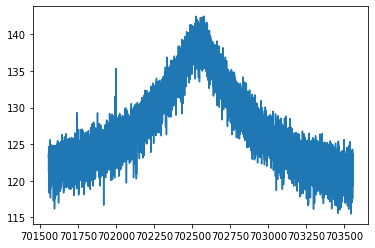

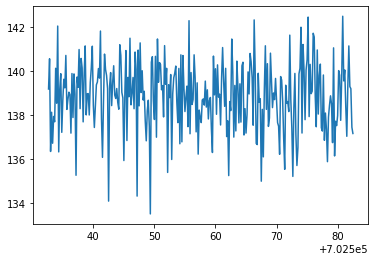

/nuz_trap2_dUvar-0.012_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_26.spec


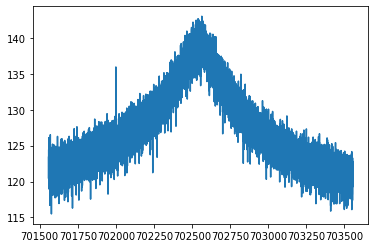

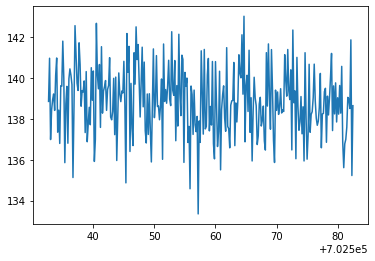

/nuz_trap2_dUvar-0.012_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_27.spec


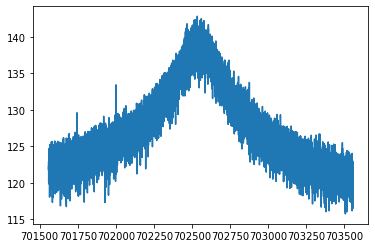

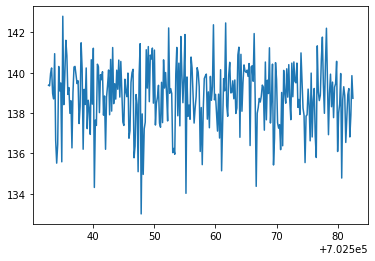

/nuz_trap2_dUvar-0.012_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_28.spec


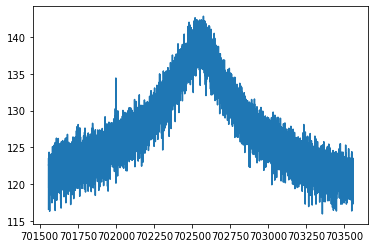

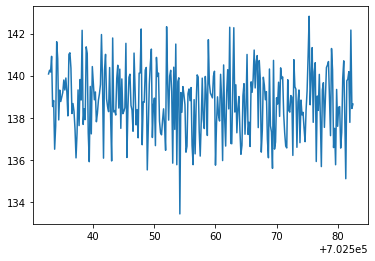

/nuz_trap2_dUvar-0.012_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_29.spec


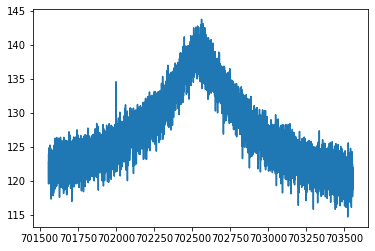

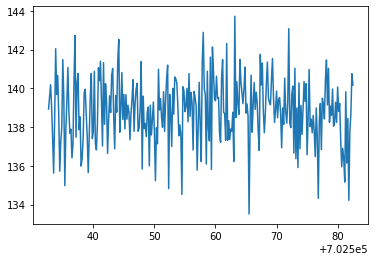

/nuz_trap2_dUvar-0.012_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
251,21,20220515_121226.616902,-0.012,2,702557.547053836519,0.034644567525,4.519533708923,0.319670886505,3.096883869722,702547.262356178020,6.241997230646,3370.648550942321,28.467984628245
252,22,20220515_122315.820474,-0.012,2,702557.529290252016,0.032966425662,4.534623291214,0.287835839632,2.457919649724,702544.873619883205,5.340911360066,3567.316168621333,32.261684957076
253,23,20220515_124827.086869,-0.012,2,702557.689193480182,0.038103903223,4.285204717730,0.327876697256,3.500538937241,702545.609230397618,6.604314930528,3495.830614979408,31.442058189528
254,24,20220515_133155.568395,-0.012,2,702557.585664715618,0.025731839557,2.960655868528,0.213678654651,2.672322303043,702551.442105067079,6.653611145837,3423.920160838647,29.218085776913


/nuz_trap2_dUvar-0.012_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_30.spec


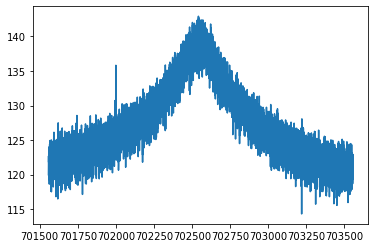

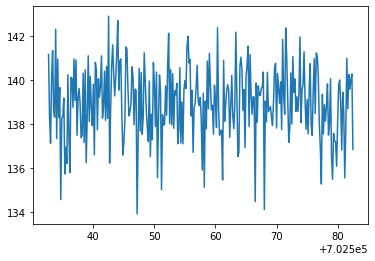

/nuz_trap2_dUvar-0.012_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_31.spec


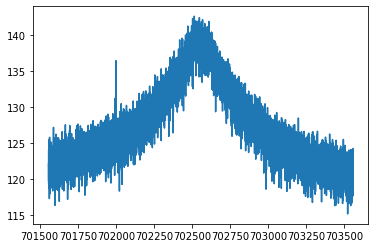

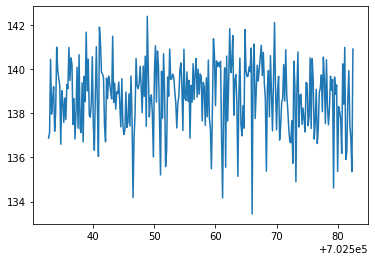

/nuz_trap2_dUvar-0.012_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_32.spec


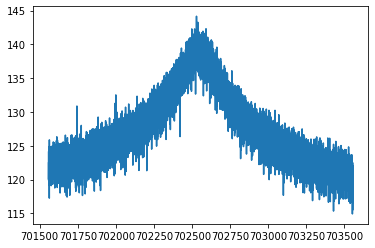

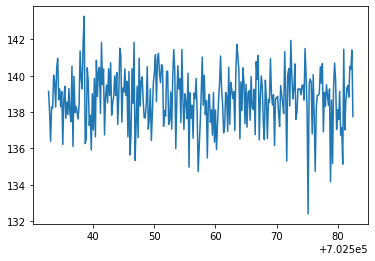

/nuz_trap2_dUvar-0.012_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_33.spec


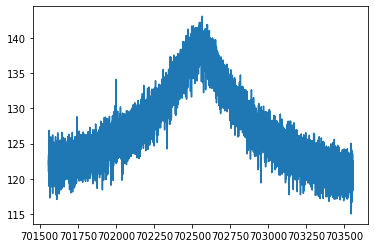

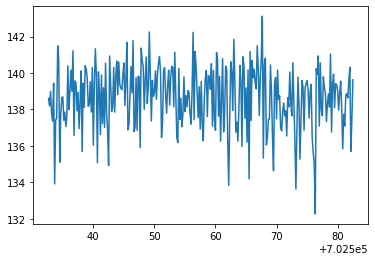

/nuz_trap2_dUvar-0.012_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_34.spec


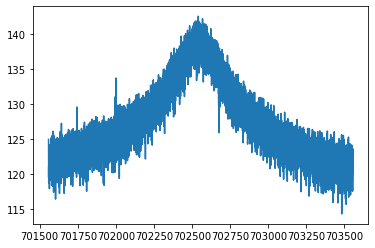

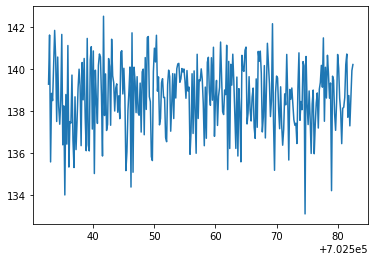

/nuz_trap2_dUvar-0.012_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_35.spec


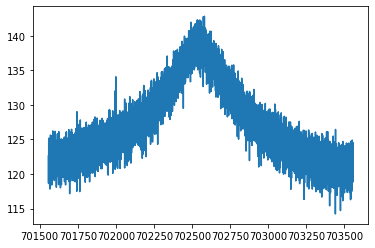

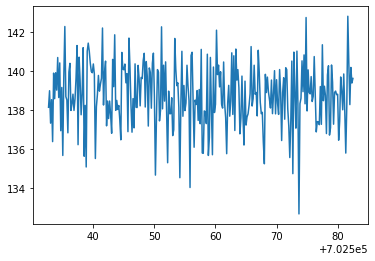

/nuz_trap2_dUvar-0.012_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_36.spec


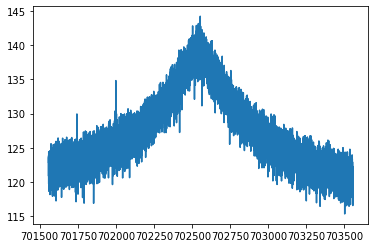

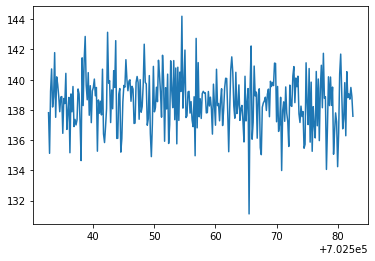

/nuz_trap2_dUvar-0.012_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_37.spec


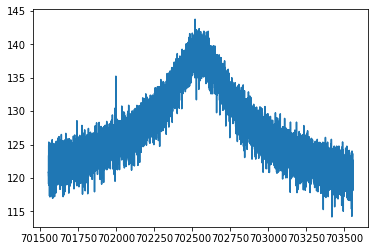

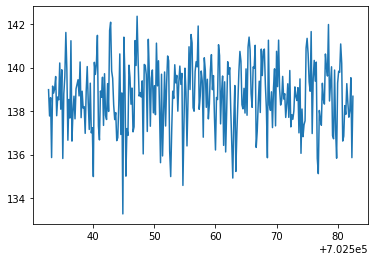

/nuz_trap2_dUvar-0.012_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_38.spec


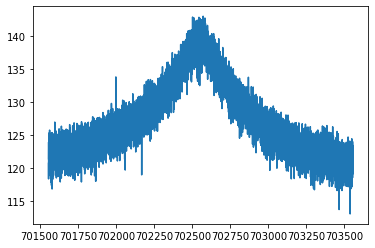

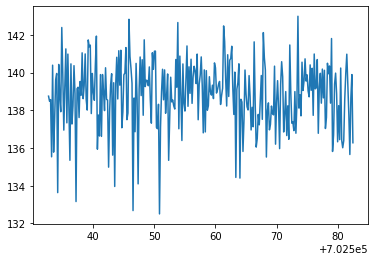

/nuz_trap2_dUvar-0.012_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_39.spec


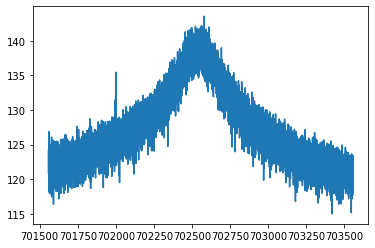

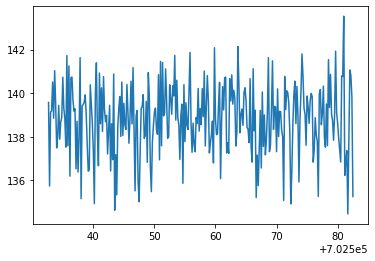

/nuz_trap2_dUvar-0.012_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
252,22,20220515_122315.820474,-0.012,2,702557.529290252016,0.032966425662,4.534623291214,0.287835839632,2.457919649724,702544.873619883205,5.340911360066,3567.316168621333,32.261684957076
253,23,20220515_124827.086869,-0.012,2,702557.689193480182,0.038103903223,4.285204717730,0.327876697256,3.500538937241,702545.609230397618,6.604314930528,3495.830614979408,31.442058189528
254,24,20220515_133155.568395,-0.012,2,702557.585664715618,0.025731839557,2.960655868528,0.213678654651,2.672322303043,702551.442105067079,6.653611145837,3423.920160838647,29.218085776913
255,3,20220515_021534.481812,-0.012,2,702557.643804971827,0.031774277304,3.993546131407,0.257429483384,2.395070333874,702544.642847787472,5.481828436818,3611.434391718828,33.605430018474


/nuz_trap2_dUvar-0.012_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_40.spec


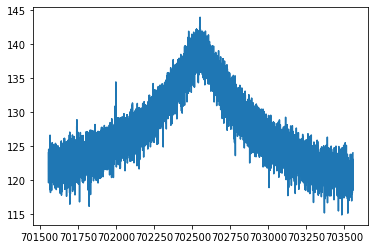

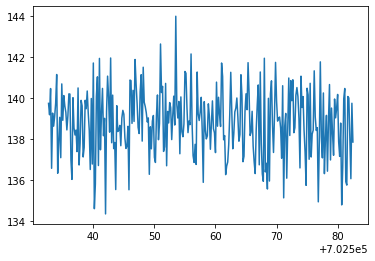

/nuz_trap2_dUvar-0.012_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.012_41.spec


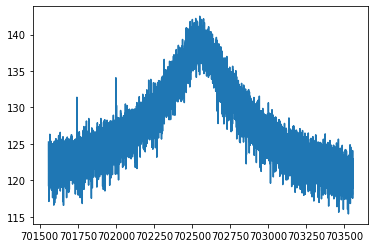

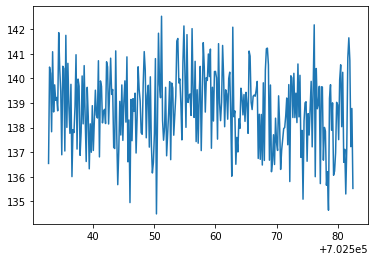

/nuz_trap2_dUvar-0.012_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
253,23,20220515_124827.086869,-0.012,2,702557.689193480182,0.038103903223,4.285204717730,0.327876697256,3.500538937241,702545.609230397618,6.604314930528,3495.830614979408,31.442058189528
254,24,20220515_133155.568395,-0.012,2,702557.585664715618,0.025731839557,2.960655868528,0.213678654651,2.672322303043,702551.442105067079,6.653611145837,3423.920160838647,29.218085776913
255,3,20220515_021534.481812,-0.012,2,702557.643804971827,0.031774277304,3.993546131407,0.257429483384,2.395070333874,702544.642847787472,5.481828436818,3611.434391718828,33.605430018474
256,4,20220515_031154.674934,-0.012,2,702557.574483072502,0.030770703999,4.203691574279,0.276086171214,2.612830222118,702544.764726263355,5.835677828221,3416.514386940735,30.184026864603


/nuz_trap2_dUvar-0.012_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
254,24,20220515_133155.568395,-0.012,2,702557.585664715618,0.025731839557,2.960655868528,0.213678654651,2.672322303043,702551.442105067079,6.653611145837,3423.920160838647,29.218085776913
255,3,20220515_021534.481812,-0.012,2,702557.643804971827,0.031774277304,3.993546131407,0.257429483384,2.395070333874,702544.642847787472,5.481828436818,3611.434391718828,33.605430018474
256,4,20220515_031154.674934,-0.012,2,702557.574483072502,0.030770703999,4.203691574279,0.276086171214,2.612830222118,702544.764726263355,5.835677828221,3416.514386940735,30.184026864603
257,5,20220515_032243.882130,-0.012,2,702557.685688112746,0.029768377361,3.296232907682,0.237683664901,2.823302972125,702541.111622611759,6.828906662514,3361.013098972197,28.491749108375


/nuz_trap2_dUvar-0.012_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,3,20220515_021534.481812,-0.012,2,702557.643804971827,0.031774277304,3.993546131407,0.257429483384,2.395070333874,702544.642847787472,5.481828436818,3611.434391718828,33.605430018474
256,4,20220515_031154.674934,-0.012,2,702557.574483072502,0.030770703999,4.203691574279,0.276086171214,2.612830222118,702544.764726263355,5.835677828221,3416.514386940735,30.184026864603
257,5,20220515_032243.882130,-0.012,2,702557.685688112746,0.029768377361,3.296232907682,0.237683664901,2.823302972125,702541.111622611759,6.828906662514,3361.013098972197,28.491749108375
258,6,20220515_034913.570632,-0.012,2,702557.492300846498,0.033921206480,4.103765361912,0.292081410586,3.031978605838,702544.019312496530,6.518382004622,3333.781619356217,28.348153584409


/nuz_trap2_dUvar-0.012_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
256,4,20220515_031154.674934,-0.012,2,702557.574483072502,0.030770703999,4.203691574279,0.276086171214,2.612830222118,702544.764726263355,5.835677828221,3416.514386940735,30.184026864603
257,5,20220515_032243.882130,-0.012,2,702557.685688112746,0.029768377361,3.296232907682,0.237683664901,2.823302972125,702541.111622611759,6.828906662514,3361.013098972197,28.491749108375
258,6,20220515_034913.570632,-0.012,2,702557.492300846498,0.033921206480,4.103765361912,0.292081410586,3.031978605838,702544.019312496530,6.518382004622,3333.781619356217,28.348153584409
259,7,20220515_044704.216493,-0.012,2,702557.636234569945,0.035505028636,4.579638560775,0.303129296297,2.629670386517,702545.962104909006,5.520425806324,3564.926881326785,32.761058204660


/nuz_trap2_dUvar-0.012_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
257,5,20220515_032243.882130,-0.012,2,702557.685688112746,0.029768377361,3.296232907682,0.237683664901,2.823302972125,702541.111622611759,6.828906662514,3361.013098972197,28.491749108375
258,6,20220515_034913.570632,-0.012,2,702557.492300846498,0.033921206480,4.103765361912,0.292081410586,3.031978605838,702544.019312496530,6.518382004622,3333.781619356217,28.348153584409
259,7,20220515_044704.216493,-0.012,2,702557.636234569945,0.035505028636,4.579638560775,0.303129296297,2.629670386517,702545.962104909006,5.520425806324,3564.926881326785,32.761058204660
260,8,20220515_051728.987368,-0.012,2,702557.613490557764,0.035125182806,3.809320442255,0.295212689606,3.462615155138,702544.252266407013,7.017331189305,3407.610915551168,29.742815383926


/nuz_trap2_dUvar-0.01_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
258,6,20220515_034913.570632,-0.012,2,702557.492300846498,0.033921206480,4.103765361912,0.292081410586,3.031978605838,702544.019312496530,6.518382004622,3333.781619356217,28.348153584409
259,7,20220515_044704.216493,-0.012,2,702557.636234569945,0.035505028636,4.579638560775,0.303129296297,2.629670386517,702545.962104909006,5.520425806324,3564.926881326785,32.761058204660
260,8,20220515_051728.987368,-0.012,2,702557.613490557764,0.035125182806,3.809320442255,0.295212689606,3.462615155138,702544.252266407013,7.017331189305,3407.610915551168,29.742815383926
261,9,20220515_054358.589759,-0.012,2,702557.665477551287,0.035310825004,4.217625631767,0.313608871090,3.340469435697,702551.512188403169,6.486622003738,3444.725500118910,29.936972389257


/nuz_trap2_dUvar-0.01_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
259,7,20220515_044704.216493,-0.012,2,702557.636234569945,0.035505028636,4.579638560775,0.303129296297,2.629670386517,702545.962104909006,5.520425806324,3564.926881326785,32.761058204660
260,8,20220515_051728.987368,-0.012,2,702557.613490557764,0.035125182806,3.809320442255,0.295212689606,3.462615155138,702544.252266407013,7.017331189305,3407.610915551168,29.742815383926
261,9,20220515_054358.589759,-0.012,2,702557.665477551287,0.035310825004,4.217625631767,0.313608871090,3.340469435697,702551.512188403169,6.486622003738,3444.725500118910,29.936972389257
262,1,20220515_011729.898047,-0.010,2,702557.602443465265,0.031432081261,4.083541979913,0.279347594809,2.782218509086,702554.287141753128,6.006714848314,3422.234027410842,28.926174629839


/nuz_trap2_dUvar-0.01_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,8,20220515_051728.987368,-0.012,2,702557.613490557764,0.035125182806,3.809320442255,0.295212689606,3.462615155138,702544.252266407013,7.017331189305,3407.610915551168,29.742815383926
261,9,20220515_054358.589759,-0.012,2,702557.665477551287,0.035310825004,4.217625631767,0.313608871090,3.340469435697,702551.512188403169,6.486622003738,3444.725500118910,29.936972389257
262,1,20220515_011729.898047,-0.010,2,702557.602443465265,0.031432081261,4.083541979913,0.279347594809,2.782218509086,702554.287141753128,6.006714848314,3422.234027410842,28.926174629839
263,10,20220515_055606.061768,-0.010,2,702557.711511011934,0.031316242031,4.068957319301,0.276550369068,2.743035016135,702549.271598720574,6.113043235322,3354.034194377734,28.631763263863


/nuz_trap2_dUvar-0.01_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,9,20220515_054358.589759,-0.012,2,702557.665477551287,0.035310825004,4.217625631767,0.313608871090,3.340469435697,702551.512188403169,6.486622003738,3444.725500118910,29.936972389257
262,1,20220515_011729.898047,-0.010,2,702557.602443465265,0.031432081261,4.083541979913,0.279347594809,2.782218509086,702554.287141753128,6.006714848314,3422.234027410842,28.926174629839
263,10,20220515_055606.061768,-0.010,2,702557.711511011934,0.031316242031,4.068957319301,0.276550369068,2.743035016135,702549.271598720574,6.113043235322,3354.034194377734,28.631763263863
264,11,20220515_064447.909334,-0.010,2,702557.539177138475,0.034316402315,4.112398501636,0.304468840091,3.279969279361,702550.561561721959,6.573852336664,3395.428883740075,28.938512884322


/nuz_trap2_dUvar-0.01_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,1,20220515_011729.898047,-0.010,2,702557.602443465265,0.031432081261,4.083541979913,0.279347594809,2.782218509086,702554.287141753128,6.006714848314,3422.234027410842,28.926174629839
263,10,20220515_055606.061768,-0.010,2,702557.711511011934,0.031316242031,4.068957319301,0.276550369068,2.743035016135,702549.271598720574,6.113043235322,3354.034194377734,28.631763263863
264,11,20220515_064447.909334,-0.010,2,702557.539177138475,0.034316402315,4.112398501636,0.304468840091,3.279969279361,702550.561561721959,6.573852336664,3395.428883740075,28.938512884322
265,12,20220515_072816.456760,-0.010,2,702557.550771151204,0.033827972057,4.077643080877,0.299118658339,3.199800679839,702551.999114047852,6.431490119773,3438.018177978698,29.561687264090


/nuz_trap2_dUvar-0.01_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
263,10,20220515_055606.061768,-0.010,2,702557.711511011934,0.031316242031,4.068957319301,0.276550369068,2.743035016135,702549.271598720574,6.113043235322,3354.034194377734,28.631763263863
264,11,20220515_064447.909334,-0.010,2,702557.539177138475,0.034316402315,4.112398501636,0.304468840091,3.279969279361,702550.561561721959,6.573852336664,3395.428883740075,28.938512884322
265,12,20220515_072816.456760,-0.010,2,702557.550771151204,0.033827972057,4.077643080877,0.299118658339,3.199800679839,702551.999114047852,6.431490119773,3438.018177978698,29.561687264090
266,13,20220515_073510.568718,-0.010,2,702557.612260078662,0.030673075022,4.344764793623,0.279535578944,2.548935388717,702543.969163345057,5.761945638612,3376.406601703579,28.833050746388


/nuz_trap2_dUvar-0.01_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,11,20220515_064447.909334,-0.010,2,702557.539177138475,0.034316402315,4.112398501636,0.304468840091,3.279969279361,702550.561561721959,6.573852336664,3395.428883740075,28.938512884322
265,12,20220515_072816.456760,-0.010,2,702557.550771151204,0.033827972057,4.077643080877,0.299118658339,3.199800679839,702551.999114047852,6.431490119773,3438.018177978698,29.561687264090
266,13,20220515_073510.568718,-0.010,2,702557.612260078662,0.030673075022,4.344764793623,0.279535578944,2.548935388717,702543.969163345057,5.761945638612,3376.406601703579,28.833050746388
267,14,20220515_082747.703342,-0.010,2,702557.594307271414,0.030092662250,4.025882479714,0.269493106497,2.661878227026,702552.846567640780,5.961765373015,3384.612323890603,28.691625741310


/nuz_trap2_dUvar-0.01_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,12,20220515_072816.456760,-0.010,2,702557.550771151204,0.033827972057,4.077643080877,0.299118658339,3.199800679839,702551.999114047852,6.431490119773,3438.018177978698,29.561687264090
266,13,20220515_073510.568718,-0.010,2,702557.612260078662,0.030673075022,4.344764793623,0.279535578944,2.548935388717,702543.969163345057,5.761945638612,3376.406601703579,28.833050746388
267,14,20220515_082747.703342,-0.010,2,702557.594307271414,0.030092662250,4.025882479714,0.269493106497,2.661878227026,702552.846567640780,5.961765373015,3384.612323890603,28.691625741310
268,15,20220515_085930.808667,-0.010,2,702557.566073293798,0.033041453086,3.724407026240,0.262952622825,2.787052664659,702542.436778561445,6.119523723084,3596.535740233116,33.148037722679


/nuz_trap2_dUvar-0.01_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
266,13,20220515_073510.568718,-0.010,2,702557.612260078662,0.030673075022,4.344764793623,0.279535578944,2.548935388717,702543.969163345057,5.761945638612,3376.406601703579,28.833050746388
267,14,20220515_082747.703342,-0.010,2,702557.594307271414,0.030092662250,4.025882479714,0.269493106497,2.661878227026,702552.846567640780,5.961765373015,3384.612323890603,28.691625741310
268,15,20220515_085930.808667,-0.010,2,702557.566073293798,0.033041453086,3.724407026240,0.262952622825,2.787052664659,702542.436778561445,6.119523723084,3596.535740233116,33.148037722679
269,16,20220515_092323.841830,-0.010,2,702557.484897416783,0.033443675271,4.152299230283,0.286692266339,2.836509300161,702549.397814551718,5.953290458255,3506.774416023866,31.459046586580


/nuz_trap2_dUvar-0.01_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,14,20220515_082747.703342,-0.010,2,702557.594307271414,0.030092662250,4.025882479714,0.269493106497,2.661878227026,702552.846567640780,5.961765373015,3384.612323890603,28.691625741310
268,15,20220515_085930.808667,-0.010,2,702557.566073293798,0.033041453086,3.724407026240,0.262952622825,2.787052664659,702542.436778561445,6.119523723084,3596.535740233116,33.148037722679
269,16,20220515_092323.841830,-0.010,2,702557.484897416783,0.033443675271,4.152299230283,0.286692266339,2.836509300161,702549.397814551718,5.953290458255,3506.774416023866,31.459046586580
270,17,20220515_095901.957164,-0.010,2,702557.597230581217,0.027749183385,4.034058297378,0.246880130617,2.221126416561,702551.835763522075,5.472100228888,3370.558514010954,28.790779900178


/nuz_trap2_dUvar-0.01_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,15,20220515_085930.808667,-0.010,2,702557.566073293798,0.033041453086,3.724407026240,0.262952622825,2.787052664659,702542.436778561445,6.119523723084,3596.535740233116,33.148037722679
269,16,20220515_092323.841830,-0.010,2,702557.484897416783,0.033443675271,4.152299230283,0.286692266339,2.836509300161,702549.397814551718,5.953290458255,3506.774416023866,31.459046586580
270,17,20220515_095901.957164,-0.010,2,702557.597230581217,0.027749183385,4.034058297378,0.246880130617,2.221126416561,702551.835763522075,5.472100228888,3370.558514010954,28.790779900178
271,18,20220515_103835.368214,-0.010,2,702557.584541706252,0.032180993577,4.121808415030,0.281563882207,2.764862749199,702551.218466892838,5.865352336482,3506.191399882962,31.162193655752


/nuz_trap2_dUvar-0.01_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
269,16,20220515_092323.841830,-0.010,2,702557.484897416783,0.033443675271,4.152299230283,0.286692266339,2.836509300161,702549.397814551718,5.953290458255,3506.774416023866,31.459046586580
270,17,20220515_095901.957164,-0.010,2,702557.597230581217,0.027749183385,4.034058297378,0.246880130617,2.221126416561,702551.835763522075,5.472100228888,3370.558514010954,28.790779900178
271,18,20220515_103835.368214,-0.010,2,702557.584541706252,0.032180993577,4.121808415030,0.281563882207,2.764862749199,702551.218466892838,5.865352336482,3506.191399882962,31.162193655752
272,19,20220515_110741.787688,-0.010,2,702557.607868958497,0.030784140434,3.654093152994,0.248919765729,2.585412735963,702547.555591068463,5.977219094290,3515.531451105212,32.457798535747


/nuz_trap2_dUvar-0.01_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
270,17,20220515_095901.957164,-0.010,2,702557.597230581217,0.027749183385,4.034058297378,0.246880130617,2.221126416561,702551.835763522075,5.472100228888,3370.558514010954,28.790779900178
271,18,20220515_103835.368214,-0.010,2,702557.584541706252,0.032180993577,4.121808415030,0.281563882207,2.764862749199,702551.218466892838,5.865352336482,3506.191399882962,31.162193655752
272,19,20220515_110741.787688,-0.010,2,702557.607868958497,0.030784140434,3.654093152994,0.248919765729,2.585412735963,702547.555591068463,5.977219094290,3515.531451105212,32.457798535747
273,2,20220515_014750.484068,-0.010,2,702557.640631317860,0.026169159420,3.956606301213,0.228552895597,1.980480857170,702548.422593437484,5.245025339871,3358.711314087182,28.641966406607


/nuz_trap2_dUvar-0.01_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,18,20220515_103835.368214,-0.010,2,702557.584541706252,0.032180993577,4.121808415030,0.281563882207,2.764862749199,702551.218466892838,5.865352336482,3506.191399882962,31.162193655752
272,19,20220515_110741.787688,-0.010,2,702557.607868958497,0.030784140434,3.654093152994,0.248919765729,2.585412735963,702547.555591068463,5.977219094290,3515.531451105212,32.457798535747
273,2,20220515_014750.484068,-0.010,2,702557.640631317860,0.026169159420,3.956606301213,0.228552895597,1.980480857170,702548.422593437484,5.245025339871,3358.711314087182,28.641966406607
274,20,20220515_113924.968759,-0.010,2,702557.637405176763,0.029633729362,4.599927944250,0.273774982646,2.196104008777,702550.047840125742,5.128122165933,3428.378286733274,29.727963403102


/nuz_trap2_dUvar-0.01_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
272,19,20220515_110741.787688,-0.010,2,702557.607868958497,0.030784140434,3.654093152994,0.248919765729,2.585412735963,702547.555591068463,5.977219094290,3515.531451105212,32.457798535747
273,2,20220515_014750.484068,-0.010,2,702557.640631317860,0.026169159420,3.956606301213,0.228552895597,1.980480857170,702548.422593437484,5.245025339871,3358.711314087182,28.641966406607
274,20,20220515_113924.968759,-0.010,2,702557.637405176763,0.029633729362,4.599927944250,0.273774982646,2.196104008777,702550.047840125742,5.128122165933,3428.378286733274,29.727963403102
275,21,20220515_114737.428433,-0.010,2,702557.545550106443,0.032881719225,3.753187800839,0.278802497136,3.178733354931,702545.101456887787,6.736866138218,3408.168415966402,29.101156973647


/nuz_trap2_dUvar-0.01_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
273,2,20220515_014750.484068,-0.010,2,702557.640631317860,0.026169159420,3.956606301213,0.228552895597,1.980480857170,702548.422593437484,5.245025339871,3358.711314087182,28.641966406607
274,20,20220515_113924.968759,-0.010,2,702557.637405176763,0.029633729362,4.599927944250,0.273774982646,2.196104008777,702550.047840125742,5.128122165933,3428.378286733274,29.727963403102
275,21,20220515_114737.428433,-0.010,2,702557.545550106443,0.032881719225,3.753187800839,0.278802497136,3.178733354931,702545.101456887787,6.736866138218,3408.168415966402,29.101156973647
276,22,20220515_123224.423308,-0.010,2,702557.620237448369,0.036565511338,3.932972156410,0.318066724418,3.855301551057,702548.312883367180,7.176796982611,3442.285765387728,29.762897508860


/nuz_trap2_dUvar-0.01_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
274,20,20220515_113924.968759,-0.010,2,702557.637405176763,0.029633729362,4.599927944250,0.273774982646,2.196104008777,702550.047840125742,5.128122165933,3428.378286733274,29.727963403102
275,21,20220515_114737.428433,-0.010,2,702557.545550106443,0.032881719225,3.753187800839,0.278802497136,3.178733354931,702545.101456887787,6.736866138218,3408.168415966402,29.101156973647
276,22,20220515_123224.423308,-0.010,2,702557.620237448369,0.036565511338,3.932972156410,0.318066724418,3.855301551057,702548.312883367180,7.176796982611,3442.285765387728,29.762897508860
277,23,20220515_124708.688157,-0.010,2,702557.537167235161,0.034832060808,3.935330016457,0.282031524708,2.918545138336,702550.269831230515,6.113130536135,3555.262650091489,33.094197007417


/nuz_trap2_dUvar-0.01_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_25.spec


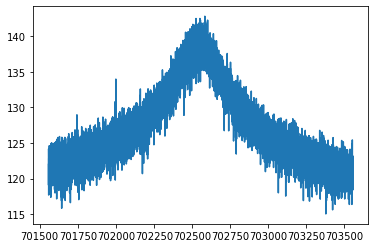

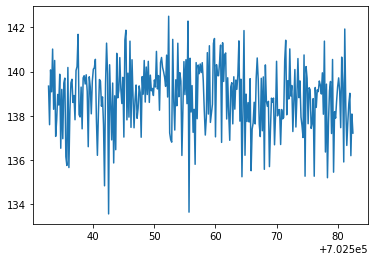

/nuz_trap2_dUvar-0.01_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_26.spec


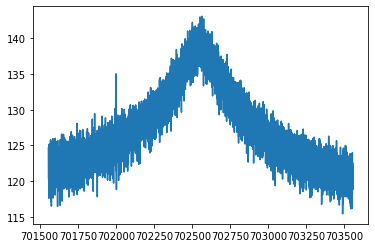

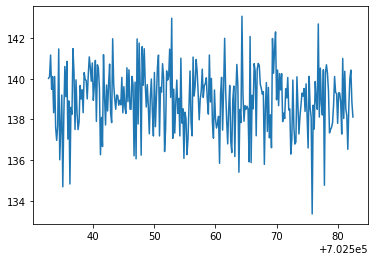

/nuz_trap2_dUvar-0.01_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_27.spec


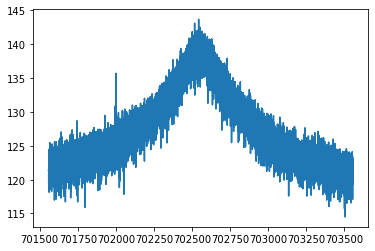

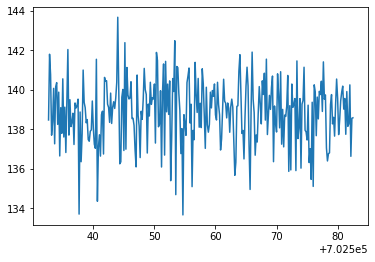

/nuz_trap2_dUvar-0.01_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_28.spec


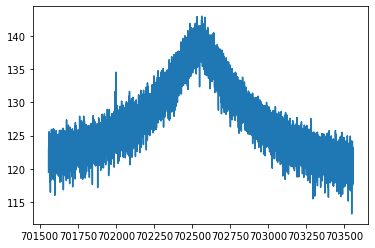

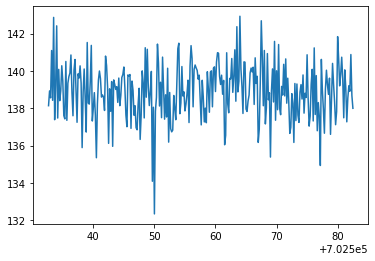

/nuz_trap2_dUvar-0.01_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_29.spec


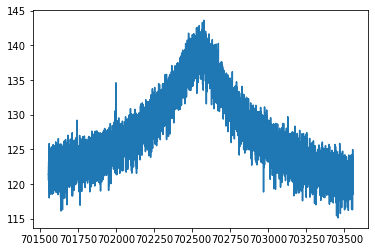

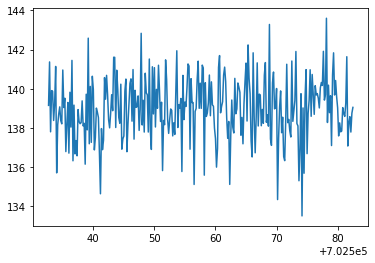

/nuz_trap2_dUvar-0.01_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,21,20220515_114737.428433,-0.010,2,702557.545550106443,0.032881719225,3.753187800839,0.278802497136,3.178733354931,702545.101456887787,6.736866138218,3408.168415966402,29.101156973647
276,22,20220515_123224.423308,-0.010,2,702557.620237448369,0.036565511338,3.932972156410,0.318066724418,3.855301551057,702548.312883367180,7.176796982611,3442.285765387728,29.762897508860
277,23,20220515_124708.688157,-0.010,2,702557.537167235161,0.034832060808,3.935330016457,0.282031524708,2.918545138336,702550.269831230515,6.113130536135,3555.262650091489,33.094197007417
278,24,20220515_134459.357005,-0.010,2,702557.578080101637,0.020504143983,1.320049207034,0.159749767449,4.368968293335,702548.007210965618,12.098731471370,3382.486428166838,29.113619778038


/nuz_trap2_dUvar-0.01_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_30.spec


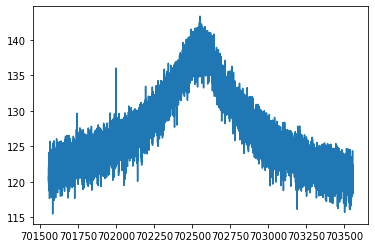

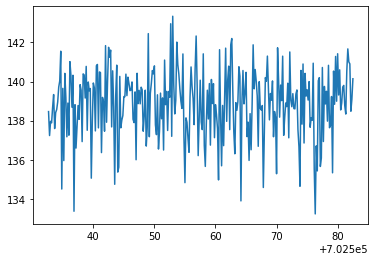

/nuz_trap2_dUvar-0.01_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_31.spec


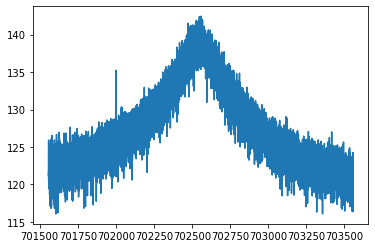

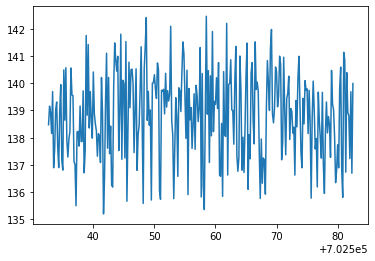

/nuz_trap2_dUvar-0.01_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_32.spec


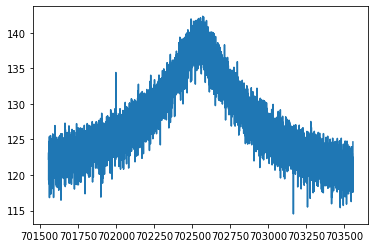

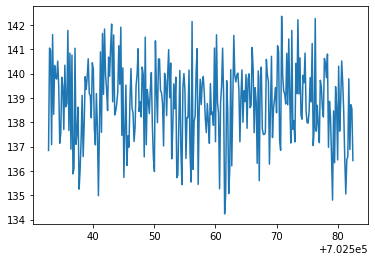

/nuz_trap2_dUvar-0.01_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_33.spec


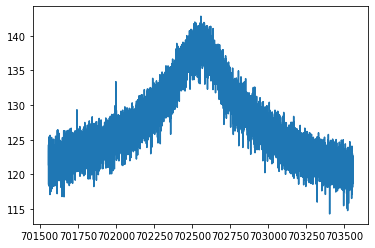

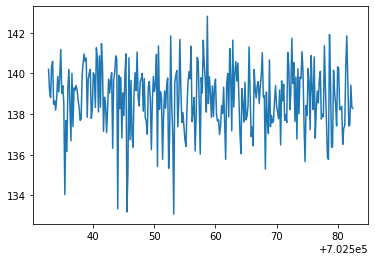

/nuz_trap2_dUvar-0.01_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_34.spec


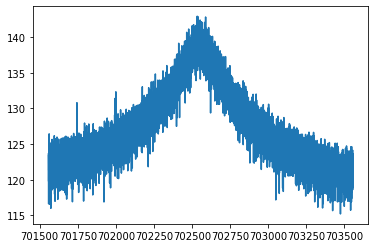

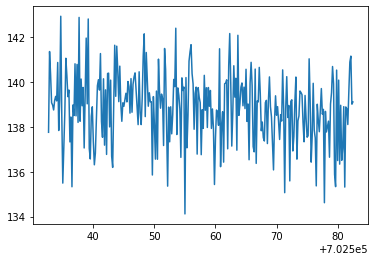

/nuz_trap2_dUvar-0.01_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_35.spec


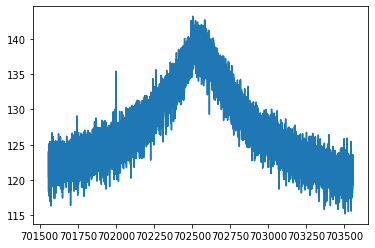

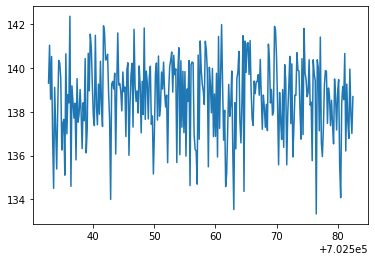

/nuz_trap2_dUvar-0.01_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_36.spec


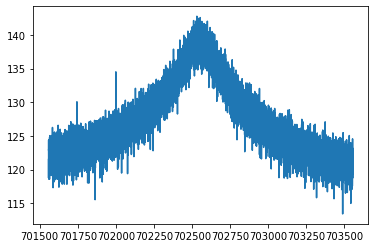

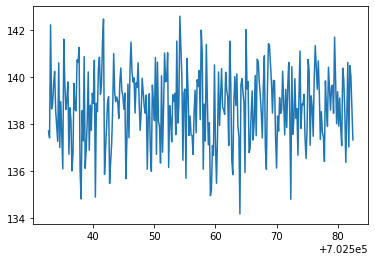

/nuz_trap2_dUvar-0.01_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_37.spec


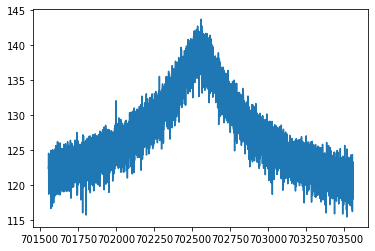

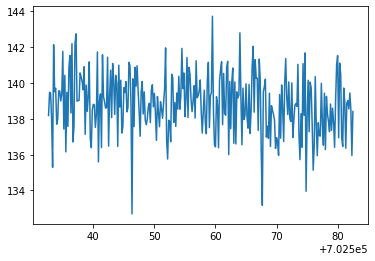

/nuz_trap2_dUvar-0.01_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_38.spec


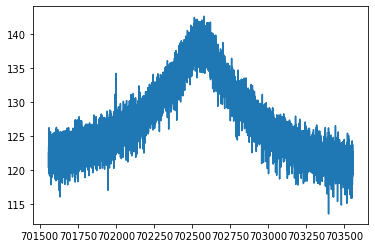

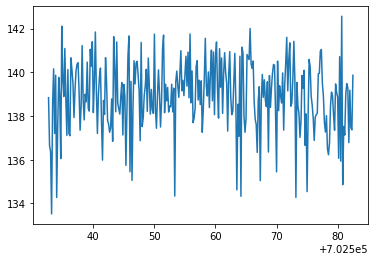

/nuz_trap2_dUvar-0.01_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_39.spec


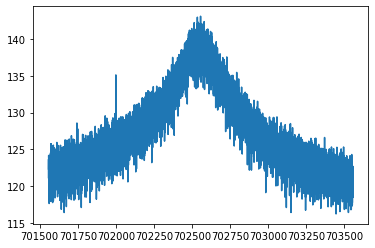

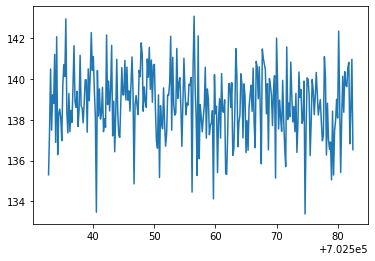

/nuz_trap2_dUvar-0.01_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
276,22,20220515_123224.423308,-0.010,2,702557.620237448369,0.036565511338,3.932972156410,0.318066724418,3.855301551057,702548.312883367180,7.176796982611,3442.285765387728,29.762897508860
277,23,20220515_124708.688157,-0.010,2,702557.537167235161,0.034832060808,3.935330016457,0.282031524708,2.918545138336,702550.269831230515,6.113130536135,3555.262650091489,33.094197007417
278,24,20220515_134459.357005,-0.010,2,702557.578080101637,0.020504143983,1.320049207034,0.159749767449,4.368968293335,702548.007210965618,12.098731471370,3382.486428166838,29.113619778038
279,3,20220515_022441.767798,-0.010,2,702557.649894076283,0.030791989048,3.847863476946,0.259732035726,2.643738923727,702550.768155979109,6.011999282307,3429.491770858576,29.797389581762


/nuz_trap2_dUvar-0.01_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_40.spec


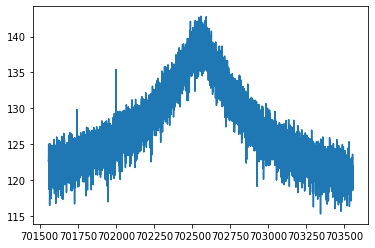

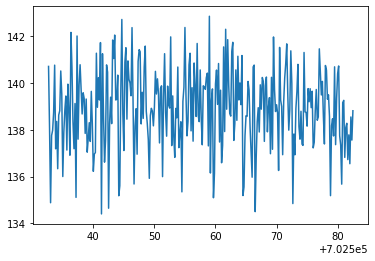

/nuz_trap2_dUvar-0.01_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar-0.01_41.spec


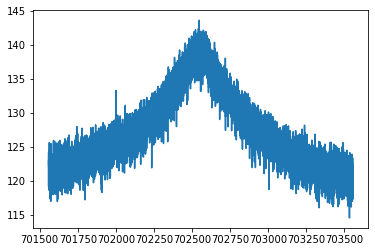

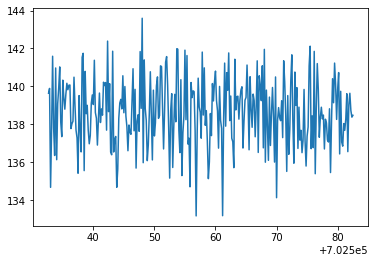

/nuz_trap2_dUvar-0.01_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,23,20220515_124708.688157,-0.010,2,702557.537167235161,0.034832060808,3.935330016457,0.282031524708,2.918545138336,702550.269831230515,6.113130536135,3555.262650091489,33.094197007417
278,24,20220515_134459.357005,-0.010,2,702557.578080101637,0.020504143983,1.320049207034,0.159749767449,4.368968293335,702548.007210965618,12.098731471370,3382.486428166838,29.113619778038
279,3,20220515_022441.767798,-0.010,2,702557.649894076283,0.030791989048,3.847863476946,0.259732035726,2.643738923727,702550.768155979109,6.011999282307,3429.491770858576,29.797389581762
280,4,20220515_030127.735007,-0.010,2,702557.550893943757,0.030405247644,3.180552261933,0.246155524328,3.164953361850,702548.732926161727,7.208441577484,3364.623920677728,28.852083390034


/nuz_trap2_dUvar-0.01_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
278,24,20220515_134459.357005,-0.010,2,702557.578080101637,0.020504143983,1.320049207034,0.159749767449,4.368968293335,702548.007210965618,12.098731471370,3382.486428166838,29.113619778038
279,3,20220515_022441.767798,-0.010,2,702557.649894076283,0.030791989048,3.847863476946,0.259732035726,2.643738923727,702550.768155979109,6.011999282307,3429.491770858576,29.797389581762
280,4,20220515_030127.735007,-0.010,2,702557.550893943757,0.030405247644,3.180552261933,0.246155524328,3.164953361850,702548.732926161727,7.208441577484,3364.623920677728,28.852083390034
281,5,20220515_033034.075570,-0.010,2,702557.556382417213,0.040432632488,4.815325173385,0.364385739312,3.505976134377,702551.228837180999,6.216148721817,3547.833752408088,32.626382800320


/nuz_trap2_dUvar-0.01_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
279,3,20220515_022441.767798,-0.010,2,702557.649894076283,0.030791989048,3.847863476946,0.259732035726,2.643738923727,702550.768155979109,6.011999282307,3429.491770858576,29.797389581762
280,4,20220515_030127.735007,-0.010,2,702557.550893943757,0.030405247644,3.180552261933,0.246155524328,3.164953361850,702548.732926161727,7.208441577484,3364.623920677728,28.852083390034
281,5,20220515_033034.075570,-0.010,2,702557.556382417213,0.040432632488,4.815325173385,0.364385739312,3.505976134377,702551.228837180999,6.216148721817,3547.833752408088,32.626382800320
282,6,20220515_040612.590561,-0.010,2,702557.632956047310,0.032628055946,4.129037891189,0.285575507151,2.884511605684,702543.743751207832,6.096542071825,3478.641808552108,30.114606649809


/nuz_trap2_dUvar-0.01_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
280,4,20220515_030127.735007,-0.010,2,702557.550893943757,0.030405247644,3.180552261933,0.246155524328,3.164953361850,702548.732926161727,7.208441577484,3364.623920677728,28.852083390034
281,5,20220515_033034.075570,-0.010,2,702557.556382417213,0.040432632488,4.815325173385,0.364385739312,3.505976134377,702551.228837180999,6.216148721817,3547.833752408088,32.626382800320
282,6,20220515_040612.590561,-0.010,2,702557.632956047310,0.032628055946,4.129037891189,0.285575507151,2.884511605684,702543.743751207832,6.096542071825,3478.641808552108,30.114606649809
283,7,20220515_044150.715335,-0.010,2,702557.471720901900,0.031352140926,3.317519951821,0.253327219613,3.183333902905,702554.384114317945,6.976567795743,3419.491638048855,29.013062309649


/nuz_trap2_dUvar-0.01_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
281,5,20220515_033034.075570,-0.010,2,702557.556382417213,0.040432632488,4.815325173385,0.364385739312,3.505976134377,702551.228837180999,6.216148721817,3547.833752408088,32.626382800320
282,6,20220515_040612.590561,-0.010,2,702557.632956047310,0.032628055946,4.129037891189,0.285575507151,2.884511605684,702543.743751207832,6.096542071825,3478.641808552108,30.114606649809
283,7,20220515_044150.715335,-0.010,2,702557.471720901900,0.031352140926,3.317519951821,0.253327219613,3.183333902905,702554.384114317945,6.976567795743,3419.491638048855,29.013062309649
284,8,20220515_050306.890767,-0.010,2,702557.605891015264,0.033679081746,4.154146106023,0.299628159067,3.113345544073,702550.611513913958,6.362181530287,3407.154552133205,29.207685919783


/nuz_trap2_dUvar0.001_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
282,6,20220515_040612.590561,-0.010,2,702557.632956047310,0.032628055946,4.129037891189,0.285575507151,2.884511605684,702543.743751207832,6.096542071825,3478.641808552108,30.114606649809
283,7,20220515_044150.715335,-0.010,2,702557.471720901900,0.031352140926,3.317519951821,0.253327219613,3.183333902905,702554.384114317945,6.976567795743,3419.491638048855,29.013062309649
284,8,20220515_050306.890767,-0.010,2,702557.605891015264,0.033679081746,4.154146106023,0.299628159067,3.113345544073,702550.611513913958,6.362181530287,3407.154552133205,29.207685919783
285,9,20220515_054121.832015,-0.010,2,702557.735336422455,0.033184786484,3.793837132290,0.281198152824,3.156434336610,702542.893988288706,6.696503498682,3422.098754081579,30.301412406955


/nuz_trap2_dUvar0.001_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
283,7,20220515_044150.715335,-0.010,2,702557.471720901900,0.031352140926,3.317519951821,0.253327219613,3.183333902905,702554.384114317945,6.976567795743,3419.491638048855,29.013062309649
284,8,20220515_050306.890767,-0.010,2,702557.605891015264,0.033679081746,4.154146106023,0.299628159067,3.113345544073,702550.611513913958,6.362181530287,3407.154552133205,29.207685919783
285,9,20220515_054121.832015,-0.010,2,702557.735336422455,0.033184786484,3.793837132290,0.281198152824,3.156434336610,702542.893988288706,6.696503498682,3422.098754081579,30.301412406955
286,1,20220515_012637.322269,0.001,2,702557.563485563383,0.034163673324,3.904488776394,0.281805515244,2.968471370439,702561.728422086686,6.041755986611,3622.243760038827,32.574820453982


/nuz_trap2_dUvar0.001_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
284,8,20220515_050306.890767,-0.010,2,702557.605891015264,0.033679081746,4.154146106023,0.299628159067,3.113345544073,702550.611513913958,6.362181530287,3407.154552133205,29.207685919783
285,9,20220515_054121.832015,-0.010,2,702557.735336422455,0.033184786484,3.793837132290,0.281198152824,3.156434336610,702542.893988288706,6.696503498682,3422.098754081579,30.301412406955
286,1,20220515_012637.322269,0.001,2,702557.563485563383,0.034163673324,3.904488776394,0.281805515244,2.968471370439,702561.728422086686,6.041755986611,3622.243760038827,32.574820453982
287,10,20220515_061304.854041,0.001,2,702557.652189149405,0.030918233516,3.666358313203,0.256477398928,2.807738051435,702568.678625962930,6.291038310004,3461.426969469545,29.513025243684


/nuz_trap2_dUvar0.001_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
285,9,20220515_054121.832015,-0.010,2,702557.735336422455,0.033184786484,3.793837132290,0.281198152824,3.156434336610,702542.893988288706,6.696503498682,3422.098754081579,30.301412406955
286,1,20220515_012637.322269,0.001,2,702557.563485563383,0.034163673324,3.904488776394,0.281805515244,2.968471370439,702561.728422086686,6.041755986611,3622.243760038827,32.574820453982
287,10,20220515_061304.854041,0.001,2,702557.652189149405,0.030918233516,3.666358313203,0.256477398928,2.807738051435,702568.678625962930,6.291038310004,3461.426969469545,29.513025243684
288,11,20220515_063025.935874,0.001,2,702557.665332695819,0.033107397133,3.564266897846,0.261291044601,2.977485917192,702564.911604241468,6.250317417410,3647.303653025091,33.820830251482


/nuz_trap2_dUvar0.001_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
286,1,20220515_012637.322269,0.001,2,702557.563485563383,0.034163673324,3.904488776394,0.281805515244,2.968471370439,702561.728422086686,6.041755986611,3622.243760038827,32.574820453982
287,10,20220515_061304.854041,0.001,2,702557.652189149405,0.030918233516,3.666358313203,0.256477398928,2.807738051435,702568.678625962930,6.291038310004,3461.426969469545,29.513025243684
288,11,20220515_063025.935874,0.001,2,702557.665332695819,0.033107397133,3.564266897846,0.261291044601,2.977485917192,702564.911604241468,6.250317417410,3647.303653025091,33.820830251482
289,12,20220515_070840.894306,0.001,2,702557.542012864258,0.031990138115,4.105888604211,0.286501576223,2.948302198740,702570.092028057319,6.152586380073,3470.475026476600,29.703237670179


/nuz_trap2_dUvar0.001_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
287,10,20220515_061304.854041,0.001,2,702557.652189149405,0.030918233516,3.666358313203,0.256477398928,2.807738051435,702568.678625962930,6.291038310004,3461.426969469545,29.513025243684
288,11,20220515_063025.935874,0.001,2,702557.665332695819,0.033107397133,3.564266897846,0.261291044601,2.977485917192,702564.911604241468,6.250317417410,3647.303653025091,33.820830251482
289,12,20220515_070840.894306,0.001,2,702557.542012864258,0.031990138115,4.105888604211,0.286501576223,2.948302198740,702570.092028057319,6.152586380073,3470.475026476600,29.703237670179
290,13,20220515_075604.477513,0.001,2,702557.508243264863,0.033289208643,3.853943626527,0.283170884117,3.166751260235,702568.510313484585,6.463591431140,3511.342984087911,30.119199917063


/nuz_trap2_dUvar0.001_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
288,11,20220515_063025.935874,0.001,2,702557.665332695819,0.033107397133,3.564266897846,0.261291044601,2.977485917192,702564.911604241468,6.250317417410,3647.303653025091,33.820830251482
289,12,20220515_070840.894306,0.001,2,702557.542012864258,0.031990138115,4.105888604211,0.286501576223,2.948302198740,702570.092028057319,6.152586380073,3470.475026476600,29.703237670179
290,13,20220515_075604.477513,0.001,2,702557.508243264863,0.033289208643,3.853943626527,0.283170884117,3.166751260235,702568.510313484585,6.463591431140,3511.342984087911,30.119199917063
291,14,20220515_080930.452044,0.001,2,702557.603568039834,0.036340177567,3.998601631272,0.298754444314,3.196552415802,702556.287362933159,6.091675362099,3703.878988910543,34.272438464392


/nuz_trap2_dUvar0.001_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
289,12,20220515_070840.894306,0.001,2,702557.542012864258,0.031990138115,4.105888604211,0.286501576223,2.948302198740,702570.092028057319,6.152586380073,3470.475026476600,29.703237670179
290,13,20220515_075604.477513,0.001,2,702557.508243264863,0.033289208643,3.853943626527,0.283170884117,3.166751260235,702568.510313484585,6.463591431140,3511.342984087911,30.119199917063
291,14,20220515_080930.452044,0.001,2,702557.603568039834,0.036340177567,3.998601631272,0.298754444314,3.196552415802,702556.287362933159,6.091675362099,3703.878988910543,34.272438464392
292,15,20220515_085140.551928,0.001,2,702557.751831457135,0.033849534389,4.228722183830,0.306989261625,3.192001620276,702563.611877313000,6.297306313255,3459.075035588367,29.576510248918


/nuz_trap2_dUvar0.001_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
290,13,20220515_075604.477513,0.001,2,702557.508243264863,0.033289208643,3.853943626527,0.283170884117,3.166751260235,702568.510313484585,6.463591431140,3511.342984087911,30.119199917063
291,14,20220515_080930.452044,0.001,2,702557.603568039834,0.036340177567,3.998601631272,0.298754444314,3.196552415802,702556.287362933159,6.091675362099,3703.878988910543,34.272438464392
292,15,20220515_085140.551928,0.001,2,702557.751831457135,0.033849534389,4.228722183830,0.306989261625,3.192001620276,702563.611877313000,6.297306313255,3459.075035588367,29.576510248918
293,16,20220515_093350.756892,0.001,2,702557.520747716422,0.029301402919,4.158802008768,0.260588425872,2.375369599695,702566.802171761286,5.448500155216,3489.067758986975,30.089454583034


/nuz_trap2_dUvar0.001_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
291,14,20220515_080930.452044,0.001,2,702557.603568039834,0.036340177567,3.998601631272,0.298754444314,3.196552415802,702556.287362933159,6.091675362099,3703.878988910543,34.272438464392
292,15,20220515_085140.551928,0.001,2,702557.751831457135,0.033849534389,4.228722183830,0.306989261625,3.192001620276,702563.611877313000,6.297306313255,3459.075035588367,29.576510248918
293,16,20220515_093350.756892,0.001,2,702557.520747716422,0.029301402919,4.158802008768,0.260588425872,2.375369599695,702566.802171761286,5.448500155216,3489.067758986975,30.089454583034
294,17,20220515_094321.559180,0.001,2,702557.543938592658,0.027927364403,3.750003446647,0.239908824648,2.378549174365,702571.221850040602,5.767258026897,3449.729040226057,29.179387356227


/nuz_trap2_dUvar0.001_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,15,20220515_085140.551928,0.001,2,702557.751831457135,0.033849534389,4.228722183830,0.306989261625,3.192001620276,702563.611877313000,6.297306313255,3459.075035588367,29.576510248918
293,16,20220515_093350.756892,0.001,2,702557.520747716422,0.029301402919,4.158802008768,0.260588425872,2.375369599695,702566.802171761286,5.448500155216,3489.067758986975,30.089454583034
294,17,20220515_094321.559180,0.001,2,702557.543938592658,0.027927364403,3.750003446647,0.239908824648,2.378549174365,702571.221850040602,5.767258026897,3449.729040226057,29.179387356227
295,18,20220515_101109.545900,0.001,2,702557.624932975741,0.032300484343,3.670090116905,0.267726578514,3.016049554101,702566.246772865183,6.504577538712,3458.142806790387,29.077873553399


/nuz_trap2_dUvar0.001_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,16,20220515_093350.756892,0.001,2,702557.520747716422,0.029301402919,4.158802008768,0.260588425872,2.375369599695,702566.802171761286,5.448500155216,3489.067758986975,30.089454583034
294,17,20220515_094321.559180,0.001,2,702557.543938592658,0.027927364403,3.750003446647,0.239908824648,2.378549174365,702571.221850040602,5.767258026897,3449.729040226057,29.179387356227
295,18,20220515_101109.545900,0.001,2,702557.624932975741,0.032300484343,3.670090116905,0.267726578514,3.016049554101,702566.246772865183,6.504577538712,3458.142806790387,29.077873553399
296,19,20220515_110623.423039,0.001,2,702557.639309307444,0.037763809496,3.861292850226,0.298100975764,3.329189802859,702558.531410214840,6.403133614335,3654.494600829891,33.386248342253


/nuz_trap2_dUvar0.001_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,17,20220515_094321.559180,0.001,2,702557.543938592658,0.027927364403,3.750003446647,0.239908824648,2.378549174365,702571.221850040602,5.767258026897,3449.729040226057,29.179387356227
295,18,20220515_101109.545900,0.001,2,702557.624932975741,0.032300484343,3.670090116905,0.267726578514,3.016049554101,702566.246772865183,6.504577538712,3458.142806790387,29.077873553399
296,19,20220515_110623.423039,0.001,2,702557.639309307444,0.037763809496,3.861292850226,0.298100975764,3.329189802859,702558.531410214840,6.403133614335,3654.494600829891,33.386248342253
297,2,20220515_020841.402487,0.001,2,702557.577509839088,0.031388974520,3.669879975611,0.270707658240,3.126804707599,702570.699761828058,6.539890494037,3516.172072940765,30.122047607475


/nuz_trap2_dUvar0.001_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,18,20220515_101109.545900,0.001,2,702557.624932975741,0.032300484343,3.670090116905,0.267726578514,3.016049554101,702566.246772865183,6.504577538712,3458.142806790387,29.077873553399
296,19,20220515_110623.423039,0.001,2,702557.639309307444,0.037763809496,3.861292850226,0.298100975764,3.329189802859,702558.531410214840,6.403133614335,3654.494600829891,33.386248342253
297,2,20220515_020841.402487,0.001,2,702557.577509839088,0.031388974520,3.669879975611,0.270707658240,3.126804707599,702570.699761828058,6.539890494037,3516.172072940765,30.122047607475
298,20,20220515_113648.222479,0.001,2,702557.568422227516,0.034368595818,3.838773020688,0.296671366690,3.460042844701,702562.685418133042,6.624466705419,3560.140485595907,30.678874062059


/nuz_trap2_dUvar0.001_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,19,20220515_110623.423039,0.001,2,702557.639309307444,0.037763809496,3.861292850226,0.298100975764,3.329189802859,702558.531410214840,6.403133614335,3654.494600829891,33.386248342253
297,2,20220515_020841.402487,0.001,2,702557.577509839088,0.031388974520,3.669879975611,0.270707658240,3.126804707599,702570.699761828058,6.539890494037,3516.172072940765,30.122047607475
298,20,20220515_113648.222479,0.001,2,702557.568422227516,0.034368595818,3.838773020688,0.296671366690,3.460042844701,702562.685418133042,6.624466705419,3560.140485595907,30.678874062059
299,21,20220515_115804.390855,0.001,2,702557.616347337025,0.032615962953,3.504075524532,0.260505992813,3.033509836247,702567.080833825399,6.408597178350,3614.567613517806,32.948488623054


/nuz_trap2_dUvar0.001_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
297,2,20220515_020841.402487,0.001,2,702557.577509839088,0.031388974520,3.669879975611,0.270707658240,3.126804707599,702570.699761828058,6.539890494037,3516.172072940765,30.122047607475
298,20,20220515_113648.222479,0.001,2,702557.568422227516,0.034368595818,3.838773020688,0.296671366690,3.460042844701,702562.685418133042,6.624466705419,3560.140485595907,30.678874062059
299,21,20220515_115804.390855,0.001,2,702557.616347337025,0.032615962953,3.504075524532,0.260505992813,3.033509836247,702567.080833825399,6.408597178350,3614.567613517806,32.948488623054
300,22,20220515_124251.362086,0.001,2,702557.586746600107,0.032352901242,4.041572113395,0.285678493895,2.958442877712,702564.513949142303,6.204071560145,3442.299931706997,29.094980631414


/nuz_trap2_dUvar0.001_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,20,20220515_113648.222479,0.001,2,702557.568422227516,0.034368595818,3.838773020688,0.296671366690,3.460042844701,702562.685418133042,6.624466705419,3560.140485595907,30.678874062059
299,21,20220515_115804.390855,0.001,2,702557.616347337025,0.032615962953,3.504075524532,0.260505992813,3.033509836247,702567.080833825399,6.408597178350,3614.567613517806,32.948488623054
300,22,20220515_124251.362086,0.001,2,702557.586746600107,0.032352901242,4.041572113395,0.285678493895,2.958442877712,702564.513949142303,6.204071560145,3442.299931706997,29.094980631414
301,23,20220515_130130.761196,0.001,2,702557.550654165098,0.030484399321,3.690550447650,0.262243222521,2.895311535160,702563.825795538607,6.308223777360,3461.233548238353,29.362331771051


/nuz_trap2_dUvar0.001_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_25.spec


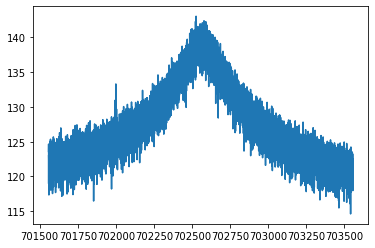

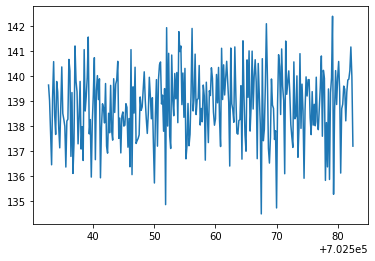

/nuz_trap2_dUvar0.001_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_26.spec


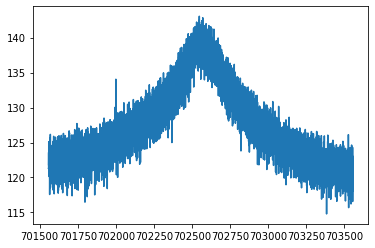

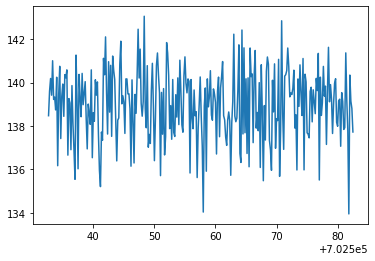

/nuz_trap2_dUvar0.001_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_27.spec


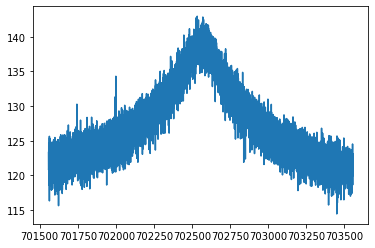

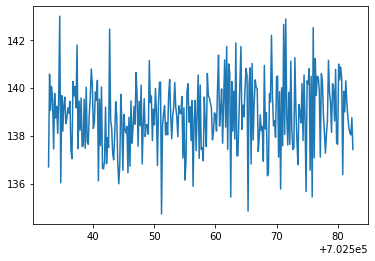

/nuz_trap2_dUvar0.001_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_28.spec


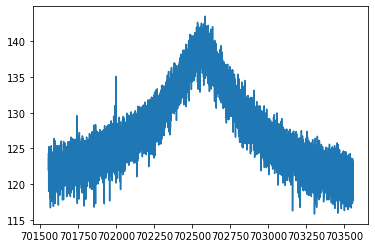

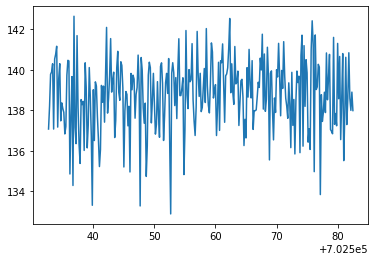

/nuz_trap2_dUvar0.001_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_29.spec


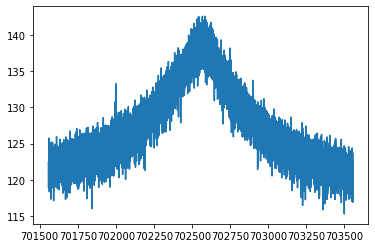

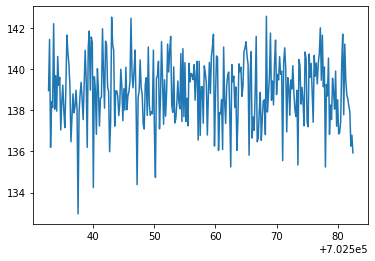

/nuz_trap2_dUvar0.001_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
299,21,20220515_115804.390855,0.001,2,702557.616347337025,0.032615962953,3.504075524532,0.260505992813,3.033509836247,702567.080833825399,6.408597178350,3614.567613517806,32.948488623054
300,22,20220515_124251.362086,0.001,2,702557.586746600107,0.032352901242,4.041572113395,0.285678493895,2.958442877712,702564.513949142303,6.204071560145,3442.299931706997,29.094980631414
301,23,20220515_130130.761196,0.001,2,702557.550654165098,0.030484399321,3.690550447650,0.262243222521,2.895311535160,702563.825795538607,6.308223777360,3461.233548238353,29.362331771051
302,24,20220515_133945.836150,0.001,2,702557.616912846453,0.033429198345,4.093791834198,0.287444559809,2.905782835028,702555.972008704557,5.798858145137,3652.881866858276,32.895575812682


/nuz_trap2_dUvar0.001_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_30.spec


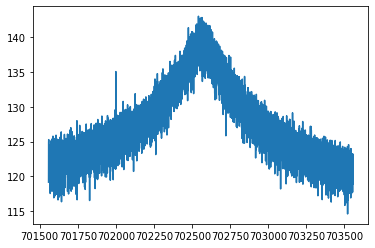

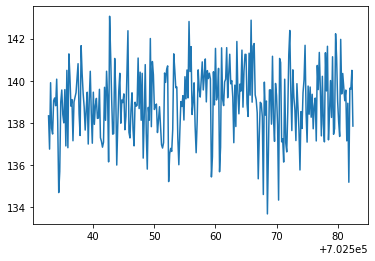

/nuz_trap2_dUvar0.001_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_31.spec


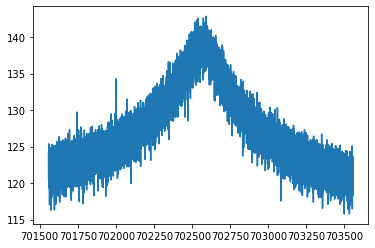

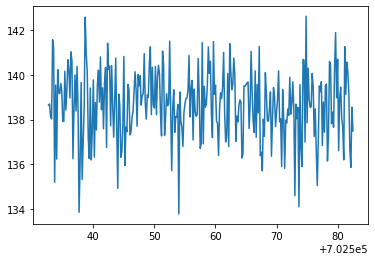

/nuz_trap2_dUvar0.001_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_32.spec


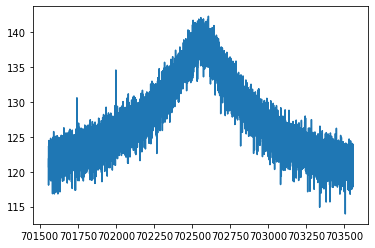

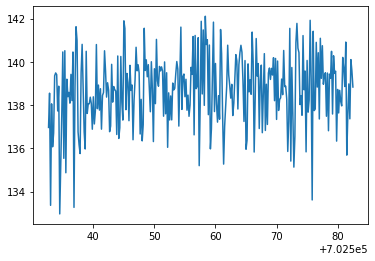

/nuz_trap2_dUvar0.001_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_33.spec


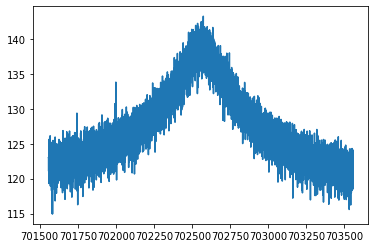

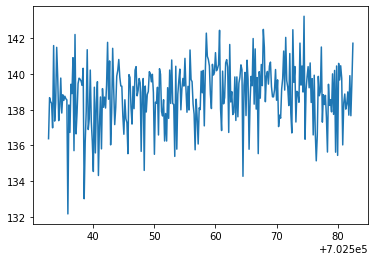

/nuz_trap2_dUvar0.001_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_34.spec


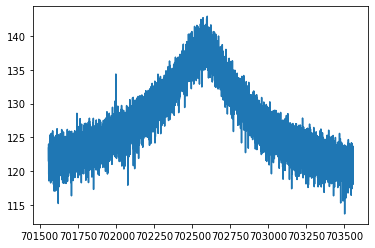

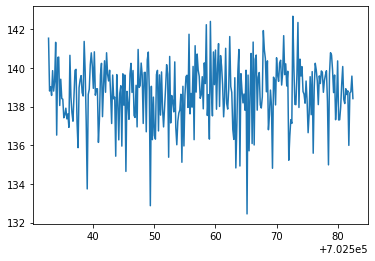

/nuz_trap2_dUvar0.001_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_35.spec


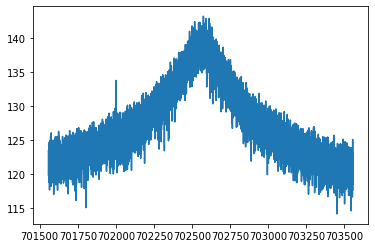

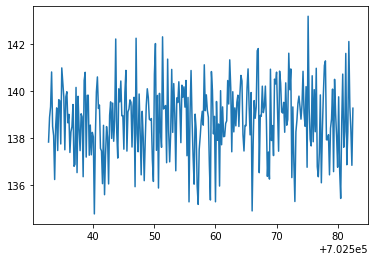

/nuz_trap2_dUvar0.001_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_36.spec


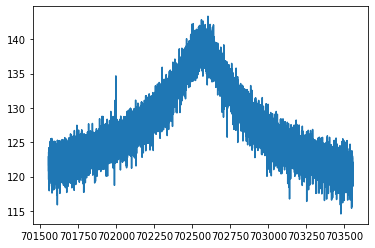

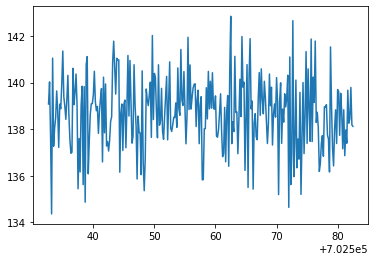

/nuz_trap2_dUvar0.001_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_37.spec


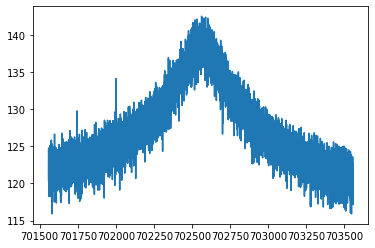

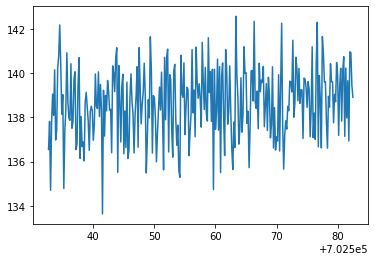

/nuz_trap2_dUvar0.001_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_38.spec


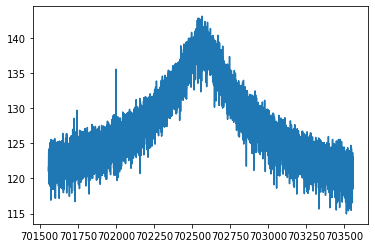

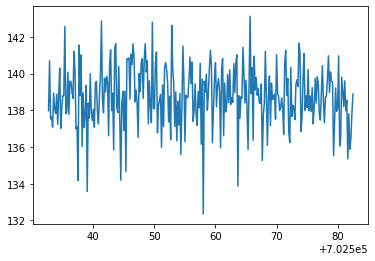

/nuz_trap2_dUvar0.001_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_39.spec


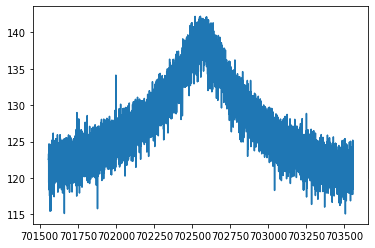

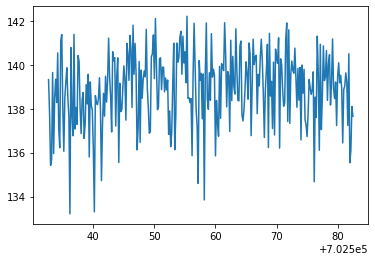

/nuz_trap2_dUvar0.001_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,22,20220515_124251.362086,0.001,2,702557.586746600107,0.032352901242,4.041572113395,0.285678493895,2.958442877712,702564.513949142303,6.204071560145,3442.299931706997,29.094980631414
301,23,20220515_130130.761196,0.001,2,702557.550654165098,0.030484399321,3.690550447650,0.262243222521,2.895311535160,702563.825795538607,6.308223777360,3461.233548238353,29.362331771051
302,24,20220515_133945.836150,0.001,2,702557.616912846453,0.033429198345,4.093791834198,0.287444559809,2.905782835028,702555.972008704557,5.798858145137,3652.881866858276,32.895575812682
303,3,20220515_022323.590956,0.001,2,702557.625283767004,0.031345442141,4.712178623328,0.295726968908,2.460738996266,702561.353052614140,5.298863475421,3470.683216697011,29.702021670647


/nuz_trap2_dUvar0.001_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.001_40.spec


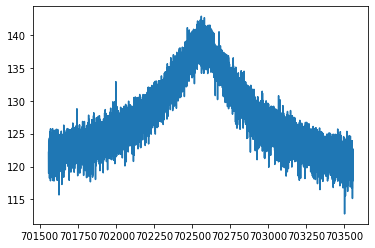

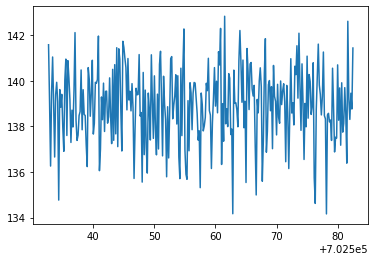

/nuz_trap2_dUvar0.001_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
301,23,20220515_130130.761196,0.001,2,702557.550654165098,0.030484399321,3.690550447650,0.262243222521,2.895311535160,702563.825795538607,6.308223777360,3461.233548238353,29.362331771051
302,24,20220515_133945.836150,0.001,2,702557.616912846453,0.033429198345,4.093791834198,0.287444559809,2.905782835028,702555.972008704557,5.798858145137,3652.881866858276,32.895575812682
303,3,20220515_022323.590956,0.001,2,702557.625283767004,0.031345442141,4.712178623328,0.295726968908,2.460738996266,702561.353052614140,5.298863475421,3470.683216697011,29.702021670647
304,4,20220515_031036.314947,0.001,2,702557.570041329949,0.031609924964,3.803712804035,0.269172108357,2.884837544318,702564.829877895303,5.964613541315,3643.221425702952,32.128016373067


/nuz_trap2_dUvar0.001_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
302,24,20220515_133945.836150,0.001,2,702557.616912846453,0.033429198345,4.093791834198,0.287444559809,2.905782835028,702555.972008704557,5.798858145137,3652.881866858276,32.895575812682
303,3,20220515_022323.590956,0.001,2,702557.625283767004,0.031345442141,4.712178623328,0.295726968908,2.460738996266,702561.353052614140,5.298863475421,3470.683216697011,29.702021670647
304,4,20220515_031036.314947,0.001,2,702557.570041329949,0.031609924964,3.803712804035,0.269172108357,2.884837544318,702564.829877895303,5.964613541315,3643.221425702952,32.128016373067
305,5,20220515_034219.472343,0.001,2,702557.571193501120,0.031448683543,3.798442384619,0.272232923179,2.961203618980,702557.201233248459,6.249628983091,3489.294369626201,30.044936890189


/nuz_trap2_dUvar0.001_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
303,3,20220515_022323.590956,0.001,2,702557.625283767004,0.031345442141,4.712178623328,0.295726968908,2.460738996266,702561.353052614140,5.298863475421,3470.683216697011,29.702021670647
304,4,20220515_031036.314947,0.001,2,702557.570041329949,0.031609924964,3.803712804035,0.269172108357,2.884837544318,702564.829877895303,5.964613541315,3643.221425702952,32.128016373067
305,5,20220515_034219.472343,0.001,2,702557.571193501120,0.031448683543,3.798442384619,0.272232923179,2.961203618980,702557.201233248459,6.249628983091,3489.294369626201,30.044936890189
306,6,20220515_035308.657459,0.001,2,702557.589158945135,0.029100633487,4.124701899003,0.263097322519,2.438749353094,702559.699804302305,5.548985292263,3450.180482677698,29.169889990106


/nuz_trap2_dUvar0.001_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
304,4,20220515_031036.314947,0.001,2,702557.570041329949,0.031609924964,3.803712804035,0.269172108357,2.884837544318,702564.829877895303,5.964613541315,3643.221425702952,32.128016373067
305,5,20220515_034219.472343,0.001,2,702557.571193501120,0.031448683543,3.798442384619,0.272232923179,2.961203618980,702557.201233248459,6.249628983091,3489.294369626201,30.044936890189
306,6,20220515_035308.657459,0.001,2,702557.589158945135,0.029100633487,4.124701899003,0.263097322519,2.438749353094,702559.699804302305,5.548985292263,3450.180482677698,29.169889990106
307,7,20220515_042215.216016,0.001,2,702557.596063339850,0.029273122615,3.856897322317,0.235303277117,2.091463781584,702563.871732664760,5.085506107758,3649.987843711805,33.279168822379


/nuz_trap2_dUvar0.001_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
305,5,20220515_034219.472343,0.001,2,702557.571193501120,0.031448683543,3.798442384619,0.272232923179,2.961203618980,702557.201233248459,6.249628983091,3489.294369626201,30.044936890189
306,6,20220515_035308.657459,0.001,2,702557.589158945135,0.029100633487,4.124701899003,0.263097322519,2.438749353094,702559.699804302305,5.548985292263,3450.180482677698,29.169889990106
307,7,20220515_042215.216016,0.001,2,702557.596063339850,0.029273122615,3.856897322317,0.235303277117,2.091463781584,702563.871732664760,5.085506107758,3649.987843711805,33.279168822379
308,8,20220515_050543.604748,0.001,2,702557.676937183365,0.032471639151,3.652809787349,0.270638503884,3.141921338547,702565.866850177292,6.735391906428,3403.246467889068,28.932382035809


/nuz_trap2_dUvar0.002_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
306,6,20220515_035308.657459,0.001,2,702557.589158945135,0.029100633487,4.124701899003,0.263097322519,2.438749353094,702559.699804302305,5.548985292263,3450.180482677698,29.169889990106
307,7,20220515_042215.216016,0.001,2,702557.596063339850,0.029273122615,3.856897322317,0.235303277117,2.091463781584,702563.871732664760,5.085506107758,3649.987843711805,33.279168822379
308,8,20220515_050543.604748,0.001,2,702557.676937183365,0.032471639151,3.652809787349,0.270638503884,3.141921338547,702565.866850177292,6.735391906428,3403.246467889068,28.932382035809
309,9,20220515_053331.596309,0.001,2,702557.634368841187,0.031501287250,4.020963148501,0.276489511395,2.812116259279,702558.844105758239,5.933443218324,3508.989720031800,29.985289243610


/nuz_trap2_dUvar0.002_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
307,7,20220515_042215.216016,0.001,2,702557.596063339850,0.029273122615,3.856897322317,0.235303277117,2.091463781584,702563.871732664760,5.085506107758,3649.987843711805,33.279168822379
308,8,20220515_050543.604748,0.001,2,702557.676937183365,0.032471639151,3.652809787349,0.270638503884,3.141921338547,702565.866850177292,6.735391906428,3403.246467889068,28.932382035809
309,9,20220515_053331.596309,0.001,2,702557.634368841187,0.031501287250,4.020963148501,0.276489511395,2.812116259279,702558.844105758239,5.933443218324,3508.989720031800,29.985289243610
310,1,20220515_013308.301122,0.002,2,702557.544551007682,0.038206728737,4.048111260285,0.330137777032,3.950530909546,702570.003852413967,7.070489863984,3534.938734519978,30.528028962191


/nuz_trap2_dUvar0.002_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
308,8,20220515_050543.604748,0.001,2,702557.676937183365,0.032471639151,3.652809787349,0.270638503884,3.141921338547,702565.866850177292,6.735391906428,3403.246467889068,28.932382035809
309,9,20220515_053331.596309,0.001,2,702557.634368841187,0.031501287250,4.020963148501,0.276489511395,2.812116259279,702558.844105758239,5.933443218324,3508.989720031800,29.985289243610
310,1,20220515_013308.301122,0.002,2,702557.544551007682,0.038206728737,4.048111260285,0.330137777032,3.950530909546,702570.003852413967,7.070489863984,3534.938734519978,30.528028962191
311,10,20220515_062213.538656,0.002,2,702557.588339979877,0.029768941175,3.697298913670,0.259275292182,2.838360282249,702569.802440567408,6.331536002107,3432.962231267784,28.753701328628


/nuz_trap2_dUvar0.002_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
309,9,20220515_053331.596309,0.001,2,702557.634368841187,0.031501287250,4.020963148501,0.276489511395,2.812116259279,702558.844105758239,5.933443218324,3508.989720031800,29.985289243610
310,1,20220515_013308.301122,0.002,2,702557.544551007682,0.038206728737,4.048111260285,0.330137777032,3.950530909546,702570.003852413967,7.070489863984,3534.938734519978,30.528028962191
311,10,20220515_062213.538656,0.002,2,702557.588339979877,0.029768941175,3.697298913670,0.259275292182,2.838360282249,702569.802440567408,6.331536002107,3432.962231267784,28.753701328628
312,11,20220515_063421.016798,0.002,2,702557.636042266386,0.035561264458,3.314327694354,0.277305337784,3.741012110007,702553.535833799746,7.413709424800,3518.713463388903,30.437138958265


/nuz_trap2_dUvar0.002_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
310,1,20220515_013308.301122,0.002,2,702557.544551007682,0.038206728737,4.048111260285,0.330137777032,3.950530909546,702570.003852413967,7.070489863984,3534.938734519978,30.528028962191
311,10,20220515_062213.538656,0.002,2,702557.588339979877,0.029768941175,3.697298913670,0.259275292182,2.838360282249,702569.802440567408,6.331536002107,3432.962231267784,28.753701328628
312,11,20220515_063421.016798,0.002,2,702557.636042266386,0.035561264458,3.314327694354,0.277305337784,3.741012110007,702553.535833799746,7.413709424800,3518.713463388903,30.437138958265
313,12,20220515_065813.921454,0.002,2,702557.619204539806,0.028154463189,3.399753945949,0.225315529293,2.382642504695,702561.467516970704,5.776811347526,3563.351589857282,31.413245944630


/nuz_trap2_dUvar0.002_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
311,10,20220515_062213.538656,0.002,2,702557.588339979877,0.029768941175,3.697298913670,0.259275292182,2.838360282249,702569.802440567408,6.331536002107,3432.962231267784,28.753701328628
312,11,20220515_063421.016798,0.002,2,702557.636042266386,0.035561264458,3.314327694354,0.277305337784,3.741012110007,702553.535833799746,7.413709424800,3518.713463388903,30.437138958265
313,12,20220515_065813.921454,0.002,2,702557.619204539806,0.028154463189,3.399753945949,0.225315529293,2.382642504695,702561.467516970704,5.776811347526,3563.351589857282,31.413245944630
314,13,20220515_073905.686603,0.002,2,702557.606361725135,0.030861599186,3.718900966774,0.266295082588,2.959768536230,702567.120095334947,6.331008117984,3493.032415135297,29.706039206132


/nuz_trap2_dUvar0.002_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
312,11,20220515_063421.016798,0.002,2,702557.636042266386,0.035561264458,3.314327694354,0.277305337784,3.741012110007,702553.535833799746,7.413709424800,3518.713463388903,30.437138958265
313,12,20220515_065813.921454,0.002,2,702557.619204539806,0.028154463189,3.399753945949,0.225315529293,2.382642504695,702561.467516970704,5.776811347526,3563.351589857282,31.413245944630
314,13,20220515_073905.686603,0.002,2,702557.606361725135,0.030861599186,3.718900966774,0.266295082588,2.959768536230,702567.120095334947,6.331008117984,3493.032415135297,29.706039206132
315,14,20220515_080416.940251,0.002,2,702557.651426280499,0.029321260091,4.636659893512,0.272807592406,2.175989485815,702568.345069231233,5.058498207044,3466.563241203965,29.268238993017


/nuz_trap2_dUvar0.002_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
313,12,20220515_065813.921454,0.002,2,702557.619204539806,0.028154463189,3.399753945949,0.225315529293,2.382642504695,702561.467516970704,5.776811347526,3563.351589857282,31.413245944630
314,13,20220515_073905.686603,0.002,2,702557.606361725135,0.030861599186,3.718900966774,0.266295082588,2.959768536230,702567.120095334947,6.331008117984,3493.032415135297,29.706039206132
315,14,20220515_080416.940251,0.002,2,702557.651426280499,0.029321260091,4.636659893512,0.272807592406,2.175989485815,702568.345069231233,5.058498207044,3466.563241203965,29.268238993017
316,15,20220515_084903.768487,0.002,2,702557.653654834139,0.034680706312,3.930438649549,0.300936727066,3.506248346884,702570.316942199832,6.815142750328,3480.448695023440,29.820981049137


/nuz_trap2_dUvar0.002_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,13,20220515_073905.686603,0.002,2,702557.606361725135,0.030861599186,3.718900966774,0.266295082588,2.959768536230,702567.120095334947,6.331008117984,3493.032415135297,29.706039206132
315,14,20220515_080416.940251,0.002,2,702557.651426280499,0.029321260091,4.636659893512,0.272807592406,2.175989485815,702568.345069231233,5.058498207044,3466.563241203965,29.268238993017
316,15,20220515_084903.768487,0.002,2,702557.653654834139,0.034680706312,3.930438649549,0.300936727066,3.506248346884,702570.316942199832,6.815142750328,3480.448695023440,29.820981049137
317,16,20220515_090743.311531,0.002,2,702557.520804724307,0.032325564194,3.708390950743,0.266627272919,2.952233373433,702569.684071176802,6.395771780498,3491.130588480677,29.903091937875


/nuz_trap2_dUvar0.002_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,14,20220515_080416.940251,0.002,2,702557.651426280499,0.029321260091,4.636659893512,0.272807592406,2.175989485815,702568.345069231233,5.058498207044,3466.563241203965,29.268238993017
316,15,20220515_084903.768487,0.002,2,702557.653654834139,0.034680706312,3.930438649549,0.300936727066,3.506248346884,702570.316942199832,6.815142750328,3480.448695023440,29.820981049137
317,16,20220515_090743.311531,0.002,2,702557.520804724307,0.032325564194,3.708390950743,0.266627272919,2.952233373433,702569.684071176802,6.395771780498,3491.130588480677,29.903091937875
318,17,20220515_093926.451012,0.002,2,702557.593861980247,0.033383123429,4.460322435468,0.308208210198,2.971165652870,702571.512710538693,6.062009729486,3440.577749751178,29.116934371680


/nuz_trap2_dUvar0.002_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
316,15,20220515_084903.768487,0.002,2,702557.653654834139,0.034680706312,3.930438649549,0.300936727066,3.506248346884,702570.316942199832,6.815142750328,3480.448695023440,29.820981049137
317,16,20220515_090743.311531,0.002,2,702557.520804724307,0.032325564194,3.708390950743,0.266627272919,2.952233373433,702569.684071176802,6.395771780498,3491.130588480677,29.903091937875
318,17,20220515_093926.451012,0.002,2,702557.593861980247,0.033383123429,4.460322435468,0.308208210198,2.971165652870,702571.512710538693,6.062009729486,3440.577749751178,29.116934371680
319,18,20220515_101623.047321,0.002,2,702557.529093280435,0.032908674395,3.657655637161,0.260375909614,2.813389378674,702565.852528086281,5.922541398184,3721.421845683351,34.294351804852


/nuz_trap2_dUvar0.002_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,16,20220515_090743.311531,0.002,2,702557.520804724307,0.032325564194,3.708390950743,0.266627272919,2.952233373433,702569.684071176802,6.395771780498,3491.130588480677,29.903091937875
318,17,20220515_093926.451012,0.002,2,702557.593861980247,0.033383123429,4.460322435468,0.308208210198,2.971165652870,702571.512710538693,6.062009729486,3440.577749751178,29.116934371680
319,18,20220515_101623.047321,0.002,2,702557.529093280435,0.032908674395,3.657655637161,0.260375909614,2.813389378674,702565.852528086281,5.922541398184,3721.421845683351,34.294351804852
320,19,20220515_105319.731179,0.002,2,702557.614777668961,0.028231900043,3.983372223860,0.253034822446,2.415615670842,702564.657027194044,5.486012760185,3534.273132843643,30.078973015238


/nuz_trap2_dUvar0.002_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
318,17,20220515_093926.451012,0.002,2,702557.593861980247,0.033383123429,4.460322435468,0.308208210198,2.971165652870,702571.512710538693,6.062009729486,3440.577749751178,29.116934371680
319,18,20220515_101623.047321,0.002,2,702557.529093280435,0.032908674395,3.657655637161,0.260375909614,2.813389378674,702565.852528086281,5.922541398184,3721.421845683351,34.294351804852
320,19,20220515_105319.731179,0.002,2,702557.614777668961,0.028231900043,3.983372223860,0.253034822446,2.415615670842,702564.657027194044,5.486012760185,3534.273132843643,30.078973015238
321,2,20220515_020052.340985,0.002,2,702557.651449433411,0.032280027502,4.320193194926,0.289304281330,2.740249711412,702565.000054303906,5.740204281245,3505.458199215493,30.116326678177


/nuz_trap2_dUvar0.002_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
319,18,20220515_101623.047321,0.002,2,702557.529093280435,0.032908674395,3.657655637161,0.260375909614,2.813389378674,702565.852528086281,5.922541398184,3721.421845683351,34.294351804852
320,19,20220515_105319.731179,0.002,2,702557.614777668961,0.028231900043,3.983372223860,0.253034822446,2.415615670842,702564.657027194044,5.486012760185,3534.273132843643,30.078973015238
321,2,20220515_020052.340985,0.002,2,702557.651449433411,0.032280027502,4.320193194926,0.289304281330,2.740249711412,702565.000054303906,5.740204281245,3505.458199215493,30.116326678177
322,20,20220515_112344.486652,0.002,2,702557.636677836068,0.030865266141,4.335284997150,0.279388817029,2.580693126950,702572.269937925972,5.601982668258,3521.813872846671,29.560222443331


/nuz_trap2_dUvar0.002_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,19,20220515_105319.731179,0.002,2,702557.614777668961,0.028231900043,3.983372223860,0.253034822446,2.415615670842,702564.657027194044,5.486012760185,3534.273132843643,30.078973015238
321,2,20220515_020052.340985,0.002,2,702557.651449433411,0.032280027502,4.320193194926,0.289304281330,2.740249711412,702565.000054303906,5.740204281245,3505.458199215493,30.116326678177
322,20,20220515_112344.486652,0.002,2,702557.636677836068,0.030865266141,4.335284997150,0.279388817029,2.580693126950,702572.269937925972,5.601982668258,3521.813872846671,29.560222443331
323,21,20220515_120949.866933,0.002,2,702557.554212311166,0.029904066223,3.530965280180,0.254311235807,2.911697480246,702562.013622047030,6.431300268809,3456.408033068275,29.360833341925


/nuz_trap2_dUvar0.002_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
321,2,20220515_020052.340985,0.002,2,702557.651449433411,0.032280027502,4.320193194926,0.289304281330,2.740249711412,702565.000054303906,5.740204281245,3505.458199215493,30.116326678177
322,20,20220515_112344.486652,0.002,2,702557.636677836068,0.030865266141,4.335284997150,0.279388817029,2.580693126950,702572.269937925972,5.601982668258,3521.813872846671,29.560222443331
323,21,20220515_120949.866933,0.002,2,702557.554212311166,0.029904066223,3.530965280180,0.254311235807,2.911697480246,702562.013622047030,6.431300268809,3456.408033068275,29.360833341925
324,22,20220515_124528.090401,0.002,2,702557.620737428777,0.035120357074,3.936432943236,0.281928288689,2.899619361382,702563.570829481119,6.020533994082,3601.722668686286,32.670787921014


/nuz_trap2_dUvar0.002_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
322,20,20220515_112344.486652,0.002,2,702557.636677836068,0.030865266141,4.335284997150,0.279388817029,2.580693126950,702572.269937925972,5.601982668258,3521.813872846671,29.560222443331
323,21,20220515_120949.866933,0.002,2,702557.554212311166,0.029904066223,3.530965280180,0.254311235807,2.911697480246,702562.013622047030,6.431300268809,3456.408033068275,29.360833341925
324,22,20220515_124528.090401,0.002,2,702557.620737428777,0.035120357074,3.936432943236,0.281928288689,2.899619361382,702563.570829481119,6.020533994082,3601.722668686286,32.670787921014
325,23,20220515_131039.420306,0.002,2,702557.532231329358,0.033437397661,3.851730668602,0.271190998134,2.816564968239,702565.007503047353,5.861360839599,3677.334936949931,33.746414411054


/nuz_trap2_dUvar0.002_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_25.spec


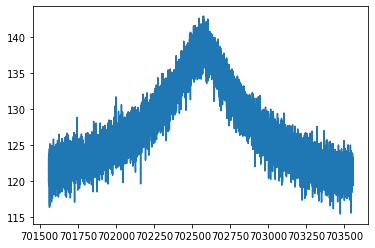

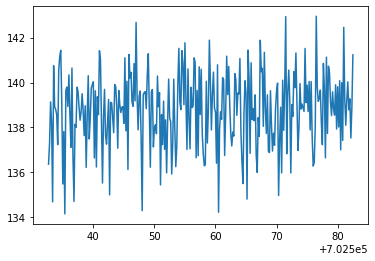

/nuz_trap2_dUvar0.002_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_26.spec


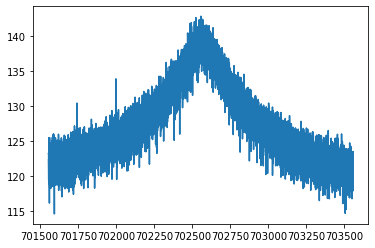

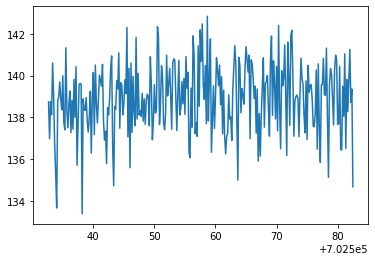

/nuz_trap2_dUvar0.002_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_27.spec


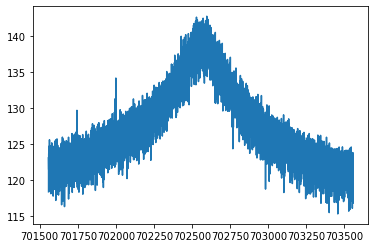

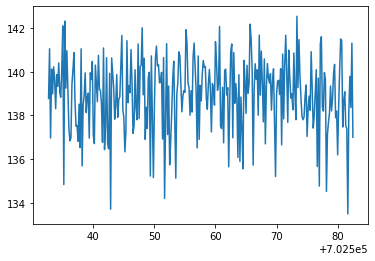

/nuz_trap2_dUvar0.002_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_28.spec


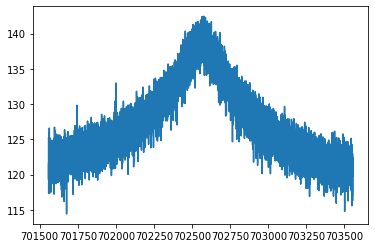

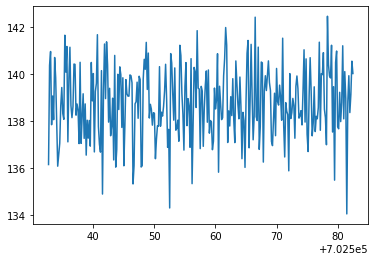

/nuz_trap2_dUvar0.002_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_29.spec


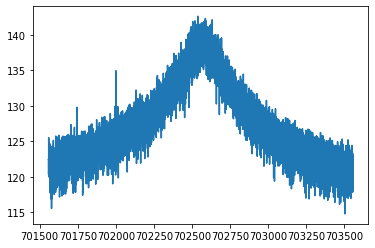

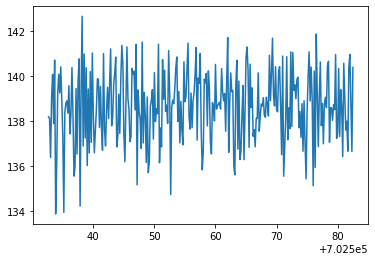

/nuz_trap2_dUvar0.002_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
323,21,20220515_120949.866933,0.002,2,702557.554212311166,0.029904066223,3.530965280180,0.254311235807,2.911697480246,702562.013622047030,6.431300268809,3456.408033068275,29.360833341925
324,22,20220515_124528.090401,0.002,2,702557.620737428777,0.035120357074,3.936432943236,0.281928288689,2.899619361382,702563.570829481119,6.020533994082,3601.722668686286,32.670787921014
325,23,20220515_131039.420306,0.002,2,702557.532231329358,0.033437397661,3.851730668602,0.271190998134,2.816564968239,702565.007503047353,5.861360839599,3677.334936949931,33.746414411054
326,24,20220515_133432.313275,0.002,2,702557.627369546681,0.030657636011,4.027981732042,0.259720512804,2.451507493415,702567.609420226421,5.363617422769,3686.079635792294,33.589633083146


/nuz_trap2_dUvar0.002_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_30.spec


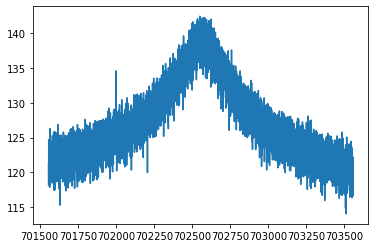

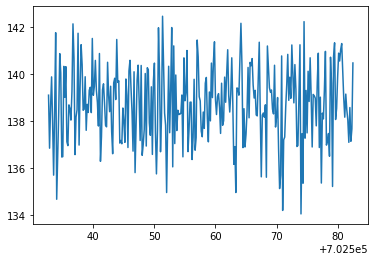

/nuz_trap2_dUvar0.002_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_31.spec


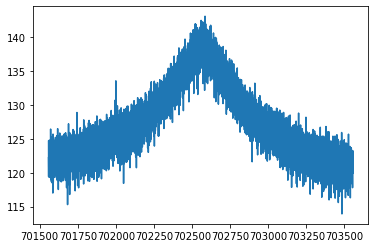

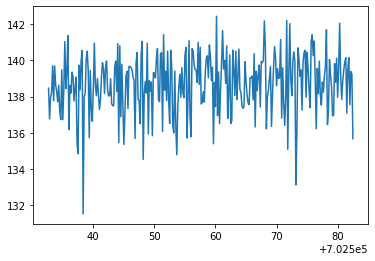

/nuz_trap2_dUvar0.002_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_32.spec


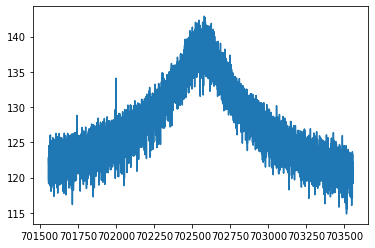

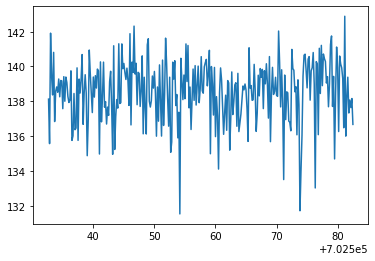

/nuz_trap2_dUvar0.002_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_33.spec


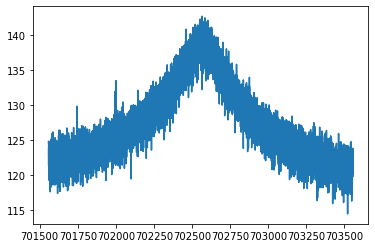

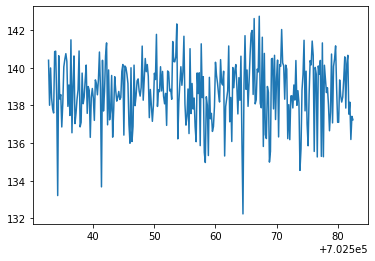

/nuz_trap2_dUvar0.002_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_34.spec


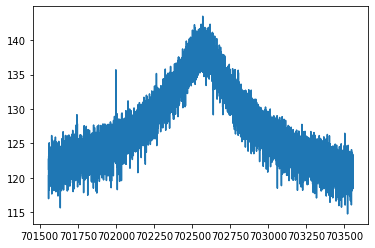

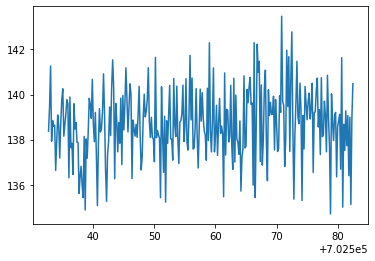

/nuz_trap2_dUvar0.002_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_35.spec


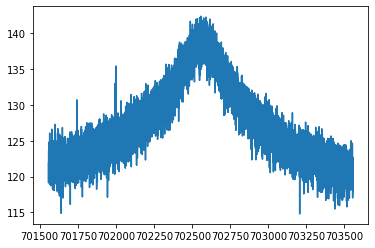

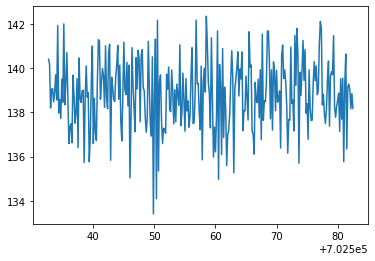

/nuz_trap2_dUvar0.002_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_36.spec


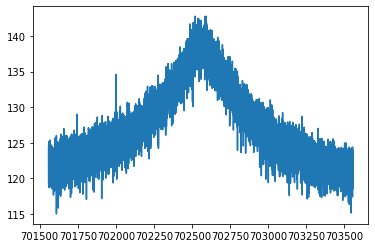

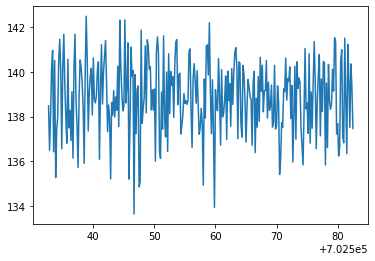

/nuz_trap2_dUvar0.002_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_37.spec


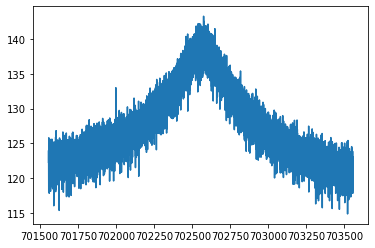

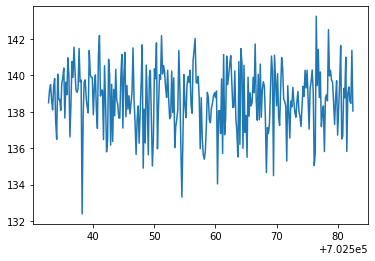

/nuz_trap2_dUvar0.002_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_38.spec


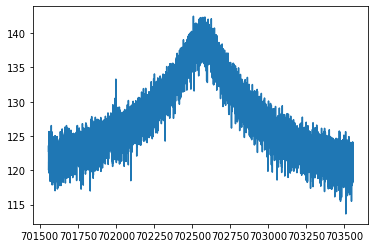

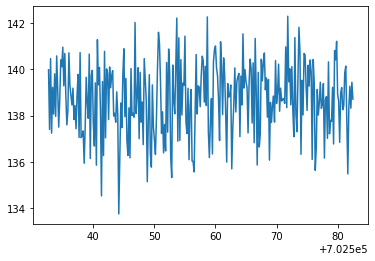

/nuz_trap2_dUvar0.002_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_39.spec


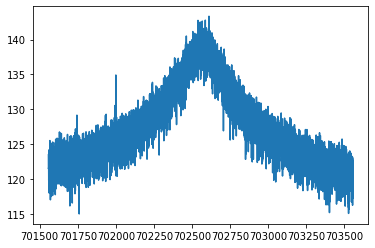

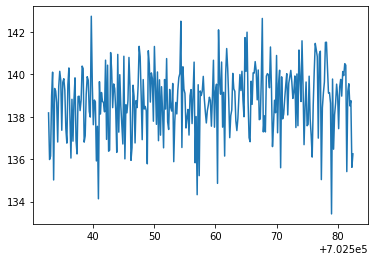

/nuz_trap2_dUvar0.002_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,22,20220515_124528.090401,0.002,2,702557.620737428777,0.035120357074,3.936432943236,0.281928288689,2.899619361382,702563.570829481119,6.020533994082,3601.722668686286,32.670787921014
325,23,20220515_131039.420306,0.002,2,702557.532231329358,0.033437397661,3.851730668602,0.271190998134,2.816564968239,702565.007503047353,5.861360839599,3677.334936949931,33.746414411054
326,24,20220515_133432.313275,0.002,2,702557.627369546681,0.030657636011,4.027981732042,0.259720512804,2.451507493415,702567.609420226421,5.363617422769,3686.079635792294,33.589633083146
327,3,20220515_021258.116206,0.002,2,702557.596636352944,0.026320818042,3.557208756203,0.225698126447,2.279334880485,702568.707623825525,5.705492060505,3462.338813260661,29.093366452903


/nuz_trap2_dUvar0.002_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_40.spec


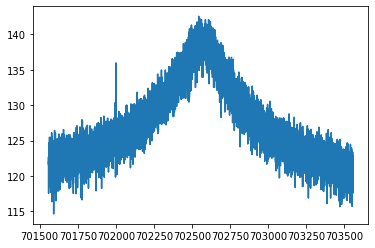

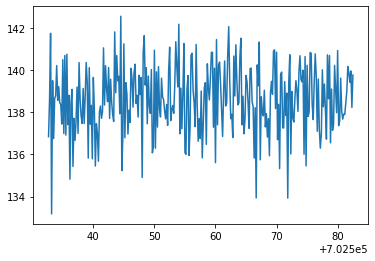

/nuz_trap2_dUvar0.002_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.002_41.spec


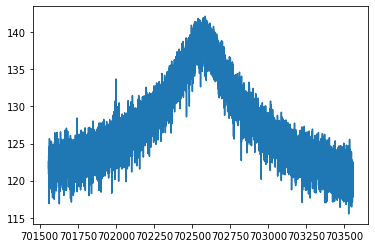

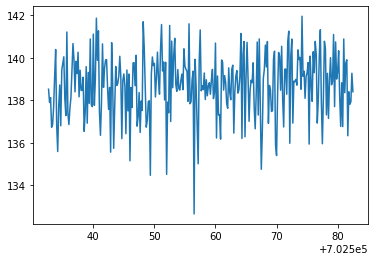

/nuz_trap2_dUvar0.002_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
325,23,20220515_131039.420306,0.002,2,702557.532231329358,0.033437397661,3.851730668602,0.271190998134,2.816564968239,702565.007503047353,5.861360839599,3677.334936949931,33.746414411054
326,24,20220515_133432.313275,0.002,2,702557.627369546681,0.030657636011,4.027981732042,0.259720512804,2.451507493415,702567.609420226421,5.363617422769,3686.079635792294,33.589633083146
327,3,20220515_021258.116206,0.002,2,702557.596636352944,0.026320818042,3.557208756203,0.225698126447,2.279334880485,702568.707623825525,5.705492060505,3462.338813260661,29.093366452903
328,4,20220515_024831.212607,0.002,2,702557.594568006578,0.032471835678,3.848787918884,0.275239782751,2.932695219141,702558.257048136787,6.206580518605,3491.764173739704,30.048493257284


/nuz_trap2_dUvar0.002_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
326,24,20220515_133432.313275,0.002,2,702557.627369546681,0.030657636011,4.027981732042,0.259720512804,2.451507493415,702567.609420226421,5.363617422769,3686.079635792294,33.589633083146
327,3,20220515_021258.116206,0.002,2,702557.596636352944,0.026320818042,3.557208756203,0.225698126447,2.279334880485,702568.707623825525,5.705492060505,3462.338813260661,29.093366452903
328,4,20220515_024831.212607,0.002,2,702557.594568006578,0.032471835678,3.848787918884,0.275239782751,2.932695219141,702558.257048136787,6.206580518605,3491.764173739704,30.048493257284
329,5,20220515_033942.730739,0.002,2,702557.587809444172,0.029016377873,3.433864803797,0.241477539314,2.716500485197,702565.998785470496,6.326421530231,3450.251203687540,29.594768046877


/nuz_trap2_dUvar0.002_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
327,3,20220515_021258.116206,0.002,2,702557.596636352944,0.026320818042,3.557208756203,0.225698126447,2.279334880485,702568.707623825525,5.705492060505,3462.338813260661,29.093366452903
328,4,20220515_024831.212607,0.002,2,702557.594568006578,0.032471835678,3.848787918884,0.275239782751,2.932695219141,702558.257048136787,6.206580518605,3491.764173739704,30.048493257284
329,5,20220515_033942.730739,0.002,2,702557.587809444172,0.029016377873,3.433864803797,0.241477539314,2.716500485197,702565.998785470496,6.326421530231,3450.251203687540,29.594768046877
330,6,20220515_034755.193060,0.002,2,702557.519523642375,0.032409822208,4.088929181391,0.278561615505,2.771622642423,702571.640119498596,5.998496011258,3487.341136547737,29.735461087246


/nuz_trap2_dUvar0.002_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
328,4,20220515_024831.212607,0.002,2,702557.594568006578,0.032471835678,3.848787918884,0.275239782751,2.932695219141,702558.257048136787,6.206580518605,3491.764173739704,30.048493257284
329,5,20220515_033942.730739,0.002,2,702557.587809444172,0.029016377873,3.433864803797,0.241477539314,2.716500485197,702565.998785470496,6.326421530231,3450.251203687540,29.594768046877
330,6,20220515_034755.193060,0.002,2,702557.519523642375,0.032409822208,4.088929181391,0.278561615505,2.771622642423,702571.640119498596,5.998496011258,3487.341136547737,29.735461087246
331,7,20220515_043913.975513,0.002,2,702557.607376891654,0.027020026544,3.839680469789,0.237807047971,2.242878145684,702559.709699346568,5.437429729676,3468.814766385051,29.311121425504


/nuz_trap2_dUvar0.002_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
329,5,20220515_033942.730739,0.002,2,702557.587809444172,0.029016377873,3.433864803797,0.241477539314,2.716500485197,702565.998785470496,6.326421530231,3450.251203687540,29.594768046877
330,6,20220515_034755.193060,0.002,2,702557.519523642375,0.032409822208,4.088929181391,0.278561615505,2.771622642423,702571.640119498596,5.998496011258,3487.341136547737,29.735461087246
331,7,20220515_043913.975513,0.002,2,702557.607376891654,0.027020026544,3.839680469789,0.237807047971,2.242878145684,702559.709699346568,5.437429729676,3468.814766385051,29.311121425504
332,8,20220515_051057.143801,0.002,2,702557.549411374610,0.033914658044,3.894148356355,0.282574519791,3.040679889030,702568.137217559735,6.129419700289,3639.724045812764,33.062110038918


/nuz_trap2_dUvar0.003_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
330,6,20220515_034755.193060,0.002,2,702557.519523642375,0.032409822208,4.088929181391,0.278561615505,2.771622642423,702571.640119498596,5.998496011258,3487.341136547737,29.735461087246
331,7,20220515_043913.975513,0.002,2,702557.607376891654,0.027020026544,3.839680469789,0.237807047971,2.242878145684,702559.709699346568,5.437429729676,3468.814766385051,29.311121425504
332,8,20220515_051057.143801,0.002,2,702557.549411374610,0.033914658044,3.894148356355,0.282574519791,3.040679889030,702568.137217559735,6.129419700289,3639.724045812764,33.062110038918
333,9,20220515_054240.211106,0.002,2,702557.646765715326,0.033177284855,3.241771141800,0.256286715934,3.327505792457,702568.275667784852,7.176571350463,3480.681300037664,30.043601503498


/nuz_trap2_dUvar0.003_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
331,7,20220515_043913.975513,0.002,2,702557.607376891654,0.027020026544,3.839680469789,0.237807047971,2.242878145684,702559.709699346568,5.437429729676,3468.814766385051,29.311121425504
332,8,20220515_051057.143801,0.002,2,702557.549411374610,0.033914658044,3.894148356355,0.282574519791,3.040679889030,702568.137217559735,6.129419700289,3639.724045812764,33.062110038918
333,9,20220515_054240.211106,0.002,2,702557.646765715326,0.033177284855,3.241771141800,0.256286715934,3.327505792457,702568.275667784852,7.176571350463,3480.681300037664,30.043601503498
334,1,20220515_011058.816397,0.003,2,702557.701952884323,0.032609465313,3.217242569255,0.257497208209,3.423034683178,702572.217588621192,7.270318860004,3514.923307186508,30.149528510601


/nuz_trap2_dUvar0.003_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
332,8,20220515_051057.143801,0.002,2,702557.549411374610,0.033914658044,3.894148356355,0.282574519791,3.040679889030,702568.137217559735,6.129419700289,3639.724045812764,33.062110038918
333,9,20220515_054240.211106,0.002,2,702557.646765715326,0.033177284855,3.241771141800,0.256286715934,3.327505792457,702568.275667784852,7.176571350463,3480.681300037664,30.043601503498
334,1,20220515_011058.816397,0.003,2,702557.701952884323,0.032609465313,3.217242569255,0.257497208209,3.423034683178,702572.217588621192,7.270318860004,3514.923307186508,30.149528510601
335,10,20220515_062055.170125,0.003,2,702557.625757315545,0.032041313882,3.470372504232,0.265854043331,3.270821186044,702563.486327595194,6.917774675748,3437.925908093854,29.083057311028


/nuz_trap2_dUvar0.003_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
333,9,20220515_054240.211106,0.002,2,702557.646765715326,0.033177284855,3.241771141800,0.256286715934,3.327505792457,702568.275667784852,7.176571350463,3480.681300037664,30.043601503498
334,1,20220515_011058.816397,0.003,2,702557.701952884323,0.032609465313,3.217242569255,0.257497208209,3.423034683178,702572.217588621192,7.270318860004,3514.923307186508,30.149528510601
335,10,20220515_062055.170125,0.003,2,702557.625757315545,0.032041313882,3.470372504232,0.265854043331,3.270821186044,702563.486327595194,6.917774675748,3437.925908093854,29.083057311028
336,11,20220515_063934.462588,0.003,2,702557.647620934644,0.033968495970,3.637826984709,0.281215899550,3.392714836008,702558.960699650925,6.832706289104,3483.869081825888,29.632268655447


/nuz_trap2_dUvar0.003_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
334,1,20220515_011058.816397,0.003,2,702557.701952884323,0.032609465313,3.217242569255,0.257497208209,3.423034683178,702572.217588621192,7.270318860004,3514.923307186508,30.149528510601
335,10,20220515_062055.170125,0.003,2,702557.625757315545,0.032041313882,3.470372504232,0.265854043331,3.270821186044,702563.486327595194,6.917774675748,3437.925908093854,29.083057311028
336,11,20220515_063934.462588,0.003,2,702557.647620934644,0.033968495970,3.637826984709,0.281215899550,3.392714836008,702558.960699650925,6.832706289104,3483.869081825888,29.632268655447
337,12,20220515_072421.345240,0.003,2,702557.569877704838,0.028906442927,3.918224658587,0.247370820285,2.336289795391,702571.159844966372,5.445312388572,3586.211678958047,31.523122108705


/nuz_trap2_dUvar0.003_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
335,10,20220515_062055.170125,0.003,2,702557.625757315545,0.032041313882,3.470372504232,0.265854043331,3.270821186044,702563.486327595194,6.917774675748,3437.925908093854,29.083057311028
336,11,20220515_063934.462588,0.003,2,702557.647620934644,0.033968495970,3.637826984709,0.281215899550,3.392714836008,702558.960699650925,6.832706289104,3483.869081825888,29.632268655447
337,12,20220515_072421.345240,0.003,2,702557.569877704838,0.028906442927,3.918224658587,0.247370820285,2.336289795391,702571.159844966372,5.445312388572,3586.211678958047,31.523122108705
338,13,20220515_074537.510176,0.003,2,702557.598868903238,0.029396823444,3.999624204302,0.249595913566,2.281985693469,702567.760805350146,5.202646541645,3674.216387273985,34.274138012927


/nuz_trap2_dUvar0.003_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
336,11,20220515_063934.462588,0.003,2,702557.647620934644,0.033968495970,3.637826984709,0.281215899550,3.392714836008,702558.960699650925,6.832706289104,3483.869081825888,29.632268655447
337,12,20220515_072421.345240,0.003,2,702557.569877704838,0.028906442927,3.918224658587,0.247370820285,2.336289795391,702571.159844966372,5.445312388572,3586.211678958047,31.523122108705
338,13,20220515_074537.510176,0.003,2,702557.598868903238,0.029396823444,3.999624204302,0.249595913566,2.281985693469,702567.760805350146,5.202646541645,3674.216387273985,34.274138012927
339,14,20220515_083142.797560,0.003,2,702557.566969872685,0.034092687094,4.215181851395,0.304496590754,3.155314246536,702569.310687384452,6.317067110892,3464.988070410592,29.480784358077


/nuz_trap2_dUvar0.003_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
337,12,20220515_072421.345240,0.003,2,702557.569877704838,0.028906442927,3.918224658587,0.247370820285,2.336289795391,702571.159844966372,5.445312388572,3586.211678958047,31.523122108705
338,13,20220515_074537.510176,0.003,2,702557.598868903238,0.029396823444,3.999624204302,0.249595913566,2.281985693469,702567.760805350146,5.202646541645,3674.216387273985,34.274138012927
339,14,20220515_083142.797560,0.003,2,702557.566969872685,0.034092687094,4.215181851395,0.304496590754,3.155314246536,702569.310687384452,6.317067110892,3464.988070410592,29.480784358077
340,15,20220515_083441.740634,0.003,2,702557.556040104362,0.032248790836,3.798040053398,0.254513533455,2.504475630623,702568.103640477988,5.583033970847,3692.349949327863,33.607091334986


/nuz_trap2_dUvar0.003_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
338,13,20220515_074537.510176,0.003,2,702557.598868903238,0.029396823444,3.999624204302,0.249595913566,2.281985693469,702567.760805350146,5.202646541645,3674.216387273985,34.274138012927
339,14,20220515_083142.797560,0.003,2,702557.566969872685,0.034092687094,4.215181851395,0.304496590754,3.155314246536,702569.310687384452,6.317067110892,3464.988070410592,29.480784358077
340,15,20220515_083441.740634,0.003,2,702557.556040104362,0.032248790836,3.798040053398,0.254513533455,2.504475630623,702568.103640477988,5.583033970847,3692.349949327863,33.607091334986
341,16,20220515_092955.654984,0.003,2,702557.565663542016,0.035419248727,3.765240764829,0.294657734113,3.499051746318,702570.178058226942,6.742332211302,3599.696125198389,31.731679373524


/nuz_trap2_dUvar0.003_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
339,14,20220515_083142.797560,0.003,2,702557.566969872685,0.034092687094,4.215181851395,0.304496590754,3.155314246536,702569.310687384452,6.317067110892,3464.988070410592,29.480784358077
340,15,20220515_083441.740634,0.003,2,702557.556040104362,0.032248790836,3.798040053398,0.254513533455,2.504475630623,702568.103640477988,5.583033970847,3692.349949327863,33.607091334986
341,16,20220515_092955.654984,0.003,2,702557.565663542016,0.035419248727,3.765240764829,0.294657734113,3.499051746318,702570.178058226942,6.742332211302,3599.696125198389,31.731679373524
342,17,20220515_094716.658447,0.003,2,702557.615184046910,0.029604660805,3.963795001203,0.260462335051,2.566221062745,702569.210713386303,5.916089439826,3401.889543421529,28.661913863484


/nuz_trap2_dUvar0.003_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
340,15,20220515_083441.740634,0.003,2,702557.556040104362,0.032248790836,3.798040053398,0.254513533455,2.504475630623,702568.103640477988,5.583033970847,3692.349949327863,33.607091334986
341,16,20220515_092955.654984,0.003,2,702557.565663542016,0.035419248727,3.765240764829,0.294657734113,3.499051746318,702570.178058226942,6.742332211302,3599.696125198389,31.731679373524
342,17,20220515_094716.658447,0.003,2,702557.615184046910,0.029604660805,3.963795001203,0.260462335051,2.566221062745,702569.210713386303,5.916089439826,3401.889543421529,28.661913863484
343,18,20220515_103440.249873,0.003,2,702557.598689060658,0.031207349783,3.948805694961,0.279240756345,2.966188195307,702562.316439592279,6.114473613265,3516.323725254887,29.995101487910


/nuz_trap2_dUvar0.003_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
341,16,20220515_092955.654984,0.003,2,702557.565663542016,0.035419248727,3.765240764829,0.294657734113,3.499051746318,702570.178058226942,6.742332211302,3599.696125198389,31.731679373524
342,17,20220515_094716.658447,0.003,2,702557.615184046910,0.029604660805,3.963795001203,0.260462335051,2.566221062745,702569.210713386303,5.916089439826,3401.889543421529,28.661913863484
343,18,20220515_103440.249873,0.003,2,702557.598689060658,0.031207349783,3.948805694961,0.279240756345,2.966188195307,702562.316439592279,6.114473613265,3516.323725254887,29.995101487910
344,19,20220515_111018.539888,0.003,2,702557.651521373424,0.029885347731,3.959066719418,0.253265027775,2.394732932327,702555.767691229703,5.389580324655,3608.714223714541,31.906396310994


/nuz_trap2_dUvar0.003_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
342,17,20220515_094716.658447,0.003,2,702557.615184046910,0.029604660805,3.963795001203,0.260462335051,2.566221062745,702569.210713386303,5.916089439826,3401.889543421529,28.661913863484
343,18,20220515_103440.249873,0.003,2,702557.598689060658,0.031207349783,3.948805694961,0.279240756345,2.966188195307,702562.316439592279,6.114473613265,3516.323725254887,29.995101487910
344,19,20220515_111018.539888,0.003,2,702557.651521373424,0.029885347731,3.959066719418,0.253265027775,2.394732932327,702555.767691229703,5.389580324655,3608.714223714541,31.906396310994
345,2,20220515_015657.788869,0.003,2,702557.615771924728,0.026994591633,3.760633606590,0.229887779027,2.158871048398,702565.752819954534,5.249791930536,3592.559456781059,31.546077790132


/nuz_trap2_dUvar0.003_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,18,20220515_103440.249873,0.003,2,702557.598689060658,0.031207349783,3.948805694961,0.279240756345,2.966188195307,702562.316439592279,6.114473613265,3516.323725254887,29.995101487910
344,19,20220515_111018.539888,0.003,2,702557.651521373424,0.029885347731,3.959066719418,0.253265027775,2.394732932327,702555.767691229703,5.389580324655,3608.714223714541,31.906396310994
345,2,20220515_015657.788869,0.003,2,702557.615771924728,0.026994591633,3.760633606590,0.229887779027,2.158871048398,702565.752819954534,5.249791930536,3592.559456781059,31.546077790132
346,20,20220515_111159.136809,0.003,2,702557.633417810197,0.031121330958,3.554493220928,0.256379517470,2.929631900208,702566.256866757409,6.360595101621,3532.001333343714,30.626304704580


/nuz_trap2_dUvar0.003_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
344,19,20220515_111018.539888,0.003,2,702557.651521373424,0.029885347731,3.959066719418,0.253265027775,2.394732932327,702555.767691229703,5.389580324655,3608.714223714541,31.906396310994
345,2,20220515_015657.788869,0.003,2,702557.615771924728,0.026994591633,3.760633606590,0.229887779027,2.158871048398,702565.752819954534,5.249791930536,3592.559456781059,31.546077790132
346,20,20220515_111159.136809,0.003,2,702557.633417810197,0.031121330958,3.554493220928,0.256379517470,2.929631900208,702566.256866757409,6.360595101621,3532.001333343714,30.626304704580
347,21,20220515_120831.488985,0.003,2,702557.578821076662,0.029585438404,3.885788320197,0.262502137091,2.694892543911,702568.058229544433,5.893598202339,3524.293025673210,30.141824807521


/nuz_trap2_dUvar0.003_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
345,2,20220515_015657.788869,0.003,2,702557.615771924728,0.026994591633,3.760633606590,0.229887779027,2.158871048398,702565.752819954534,5.249791930536,3592.559456781059,31.546077790132
346,20,20220515_111159.136809,0.003,2,702557.633417810197,0.031121330958,3.554493220928,0.256379517470,2.929631900208,702566.256866757409,6.360595101621,3532.001333343714,30.626304704580
347,21,20220515_120831.488985,0.003,2,702557.578821076662,0.029585438404,3.885788320197,0.262502137091,2.694892543911,702568.058229544433,5.893598202339,3524.293025673210,30.141824807521
348,22,20220515_121920.703645,0.003,2,702557.601723190630,0.030732083742,3.664601186941,0.245774853662,2.501738976200,702568.877809604164,5.697137662492,3652.204031083042,33.187777069269


/nuz_trap2_dUvar0.003_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
346,20,20220515_111159.136809,0.003,2,702557.633417810197,0.031121330958,3.554493220928,0.256379517470,2.929631900208,702566.256866757409,6.360595101621,3532.001333343714,30.626304704580
347,21,20220515_120831.488985,0.003,2,702557.578821076662,0.029585438404,3.885788320197,0.262502137091,2.694892543911,702568.058229544433,5.893598202339,3524.293025673210,30.141824807521
348,22,20220515_121920.703645,0.003,2,702557.601723190630,0.030732083742,3.664601186941,0.245774853662,2.501738976200,702568.877809604164,5.697137662492,3652.204031083042,33.187777069269
349,23,20220515_130921.049135,0.003,2,702557.635583281517,0.031428302476,3.897675203518,0.260000785113,2.555781722928,702557.642751961248,5.596372070571,3622.145133411989,32.639021612359


/nuz_trap2_dUvar0.003_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_25.spec


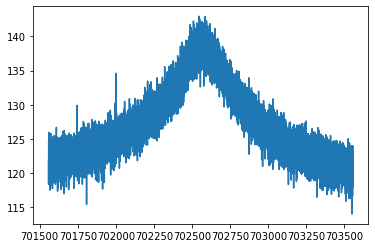

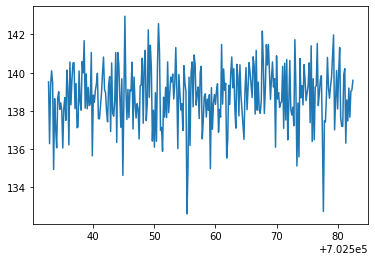

/nuz_trap2_dUvar0.003_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_26.spec


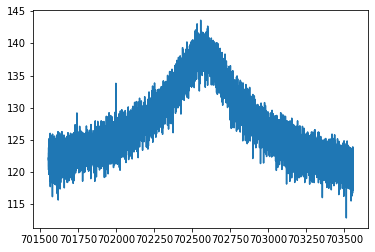

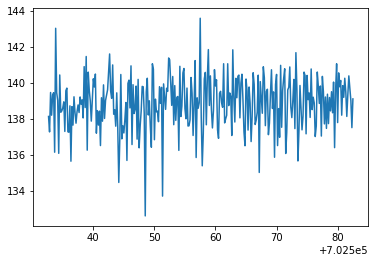

/nuz_trap2_dUvar0.003_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_27.spec


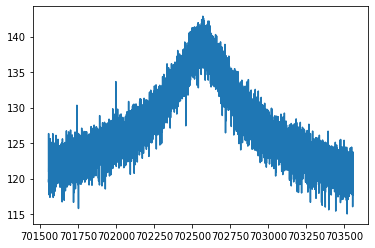

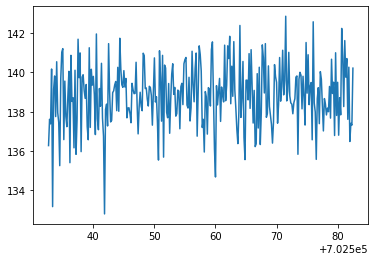

/nuz_trap2_dUvar0.003_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_28.spec


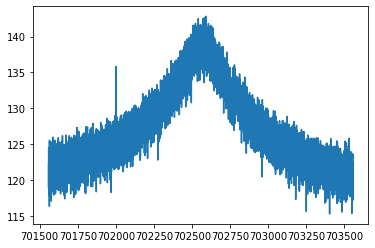

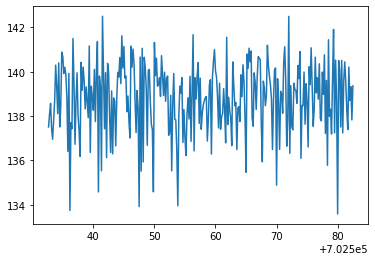

/nuz_trap2_dUvar0.003_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_29.spec


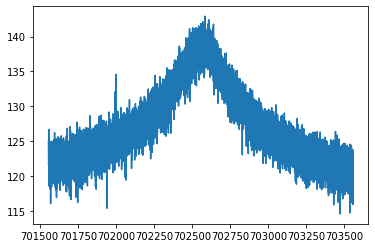

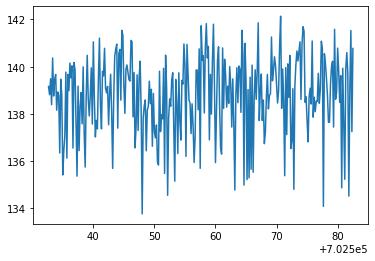

/nuz_trap2_dUvar0.003_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
347,21,20220515_120831.488985,0.003,2,702557.578821076662,0.029585438404,3.885788320197,0.262502137091,2.694892543911,702568.058229544433,5.893598202339,3524.293025673210,30.141824807521
348,22,20220515_121920.703645,0.003,2,702557.601723190630,0.030732083742,3.664601186941,0.245774853662,2.501738976200,702568.877809604164,5.697137662492,3652.204031083042,33.187777069269
349,23,20220515_130921.049135,0.003,2,702557.635583281517,0.031428302476,3.897675203518,0.260000785113,2.555781722928,702557.642751961248,5.596372070571,3622.145133411989,32.639021612359
350,24,20220515_132800.470027,0.003,2,702557.573375682929,0.030850882325,3.992160407578,0.272695130611,2.764001709577,702566.322142347344,5.945870618596,3497.115043365723,29.570383709501


/nuz_trap2_dUvar0.003_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_30.spec


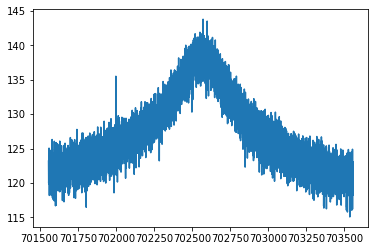

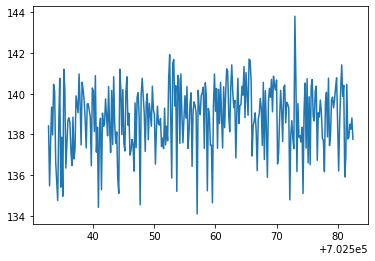

/nuz_trap2_dUvar0.003_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_31.spec


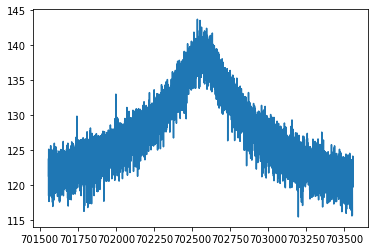

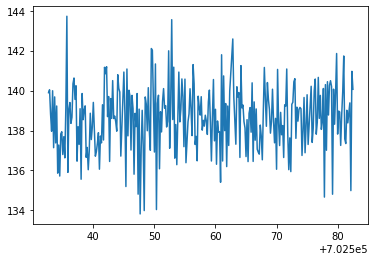

/nuz_trap2_dUvar0.003_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_32.spec


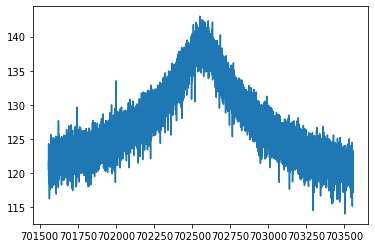

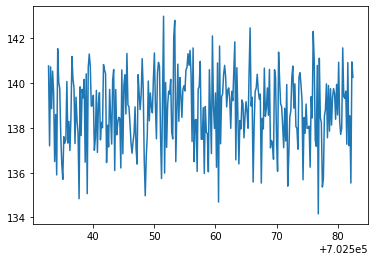

/nuz_trap2_dUvar0.003_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_33.spec


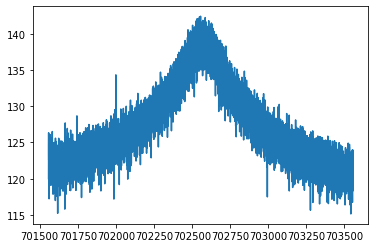

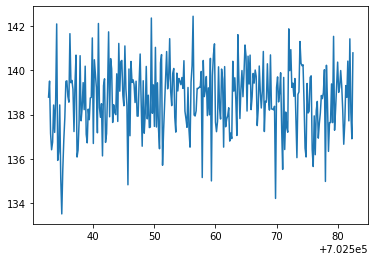

/nuz_trap2_dUvar0.003_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_34.spec


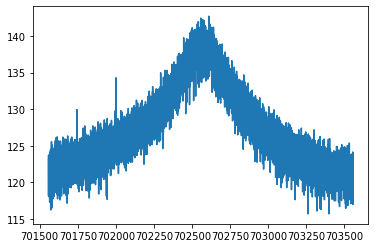

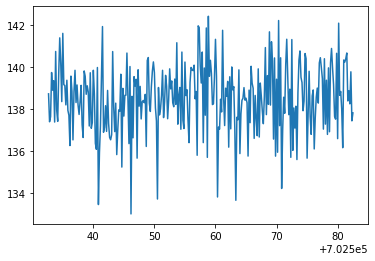

/nuz_trap2_dUvar0.003_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_35.spec


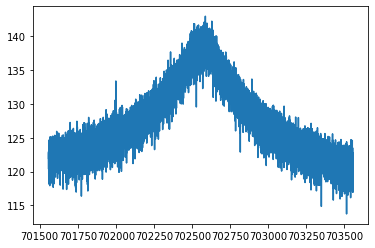

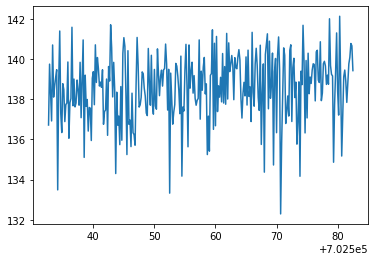

/nuz_trap2_dUvar0.003_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_36.spec


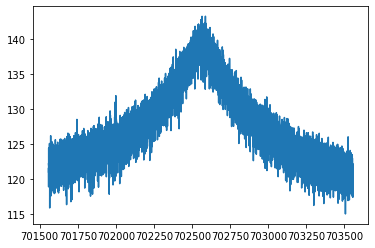

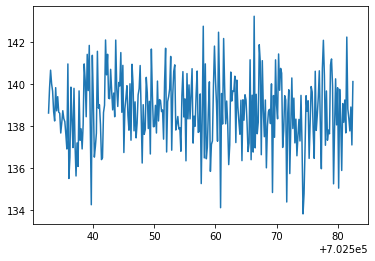

/nuz_trap2_dUvar0.003_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_37.spec


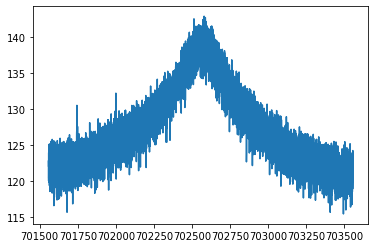

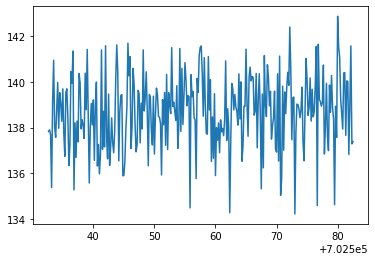

/nuz_trap2_dUvar0.003_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_38.spec


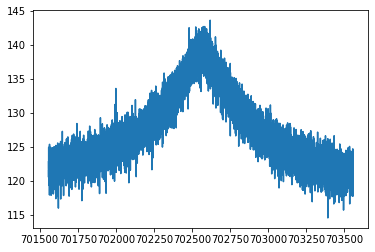

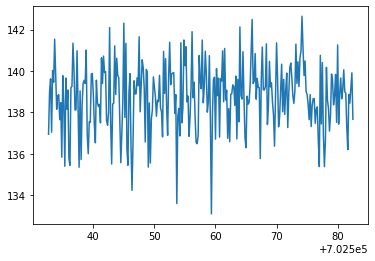

/nuz_trap2_dUvar0.003_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_39.spec


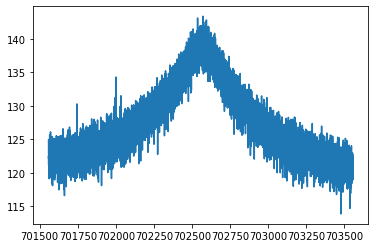

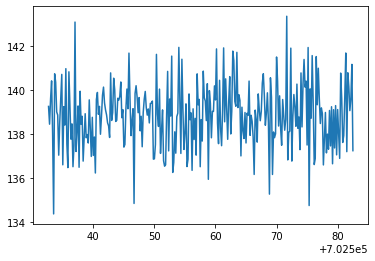

/nuz_trap2_dUvar0.003_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
348,22,20220515_121920.703645,0.003,2,702557.601723190630,0.030732083742,3.664601186941,0.245774853662,2.501738976200,702568.877809604164,5.697137662492,3652.204031083042,33.187777069269
349,23,20220515_130921.049135,0.003,2,702557.635583281517,0.031428302476,3.897675203518,0.260000785113,2.555781722928,702557.642751961248,5.596372070571,3622.145133411989,32.639021612359
350,24,20220515_132800.470027,0.003,2,702557.573375682929,0.030850882325,3.992160407578,0.272695130611,2.764001709577,702566.322142347344,5.945870618596,3497.115043365723,29.570383709501
351,3,20220515_022559.939358,0.003,2,702557.621177546564,0.029730313367,3.996690898917,0.265442541183,2.636273293664,702561.467659865972,5.727157961622,3523.916818212929,30.371492387420


/nuz_trap2_dUvar0.003_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.003_40.spec


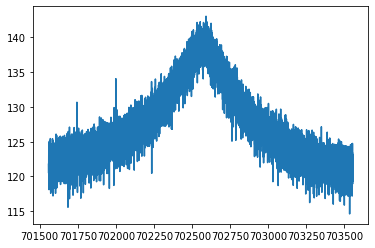

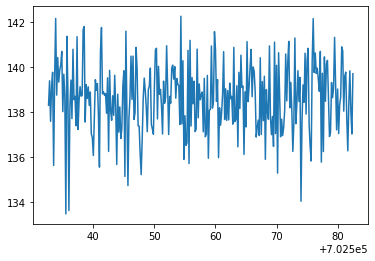

/nuz_trap2_dUvar0.003_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
349,23,20220515_130921.049135,0.003,2,702557.635583281517,0.031428302476,3.897675203518,0.260000785113,2.555781722928,702557.642751961248,5.596372070571,3622.145133411989,32.639021612359
350,24,20220515_132800.470027,0.003,2,702557.573375682929,0.030850882325,3.992160407578,0.272695130611,2.764001709577,702566.322142347344,5.945870618596,3497.115043365723,29.570383709501
351,3,20220515_022559.939358,0.003,2,702557.621177546564,0.029730313367,3.996690898917,0.265442541183,2.636273293664,702561.467659865972,5.727157961622,3523.916818212929,30.371492387420
352,4,20220515_030917.961866,0.003,2,702557.650664543733,0.032888913871,4.271860693574,0.284403176704,2.659324081966,702564.374195758021,5.510586489732,3637.359057167601,33.259578335813


/nuz_trap2_dUvar0.003_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,24,20220515_132800.470027,0.003,2,702557.573375682929,0.030850882325,3.992160407578,0.272695130611,2.764001709577,702566.322142347344,5.945870618596,3497.115043365723,29.570383709501
351,3,20220515_022559.939358,0.003,2,702557.621177546564,0.029730313367,3.996690898917,0.265442541183,2.636273293664,702561.467659865972,5.727157961622,3523.916818212929,30.371492387420
352,4,20220515_030917.961866,0.003,2,702557.650664543733,0.032888913871,4.271860693574,0.284403176704,2.659324081966,702564.374195758021,5.510586489732,3637.359057167601,33.259578335813
353,5,20220515_034614.603666,0.003,2,702557.636402642820,0.034380217485,3.620889999353,0.280484590087,3.386490217771,702569.485997822136,6.969626446408,3459.687233925453,29.289795568940


/nuz_trap2_dUvar0.003_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
351,3,20220515_022559.939358,0.003,2,702557.621177546564,0.029730313367,3.996690898917,0.265442541183,2.636273293664,702561.467659865972,5.727157961622,3523.916818212929,30.371492387420
352,4,20220515_030917.961866,0.003,2,702557.650664543733,0.032888913871,4.271860693574,0.284403176704,2.659324081966,702564.374195758021,5.510586489732,3637.359057167601,33.259578335813
353,5,20220515_034614.603666,0.003,2,702557.636402642820,0.034380217485,3.620889999353,0.280484590087,3.386490217771,702569.485997822136,6.969626446408,3459.687233925453,29.289795568940
354,6,20220515_041126.078643,0.003,2,702557.564020500984,0.030294516099,4.345171394262,0.277709169323,2.504786554785,702567.021216884139,5.522767694066,3474.241579831453,29.634521761412


/nuz_trap2_dUvar0.003_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
352,4,20220515_030917.961866,0.003,2,702557.650664543733,0.032888913871,4.271860693574,0.284403176704,2.659324081966,702564.374195758021,5.510586489732,3637.359057167601,33.259578335813
353,5,20220515_034614.603666,0.003,2,702557.636402642820,0.034380217485,3.620889999353,0.280484590087,3.386490217771,702569.485997822136,6.969626446408,3459.687233925453,29.289795568940
354,6,20220515_041126.078643,0.003,2,702557.564020500984,0.030294516099,4.345171394262,0.277709169323,2.504786554785,702567.021216884139,5.522767694066,3474.241579831453,29.634521761412
355,7,20220515_043123.784362,0.003,2,702557.651991860359,0.034528820777,3.886704310298,0.290142186514,3.232953850929,702560.535936378757,6.477305513344,3507.172247871776,30.148535703252


/nuz_trap2_dUvar0.003_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
353,5,20220515_034614.603666,0.003,2,702557.636402642820,0.034380217485,3.620889999353,0.280484590087,3.386490217771,702569.485997822136,6.969626446408,3459.687233925453,29.289795568940
354,6,20220515_041126.078643,0.003,2,702557.564020500984,0.030294516099,4.345171394262,0.277709169323,2.504786554785,702567.021216884139,5.522767694066,3474.241579831453,29.634521761412
355,7,20220515_043123.784362,0.003,2,702557.651991860359,0.034528820777,3.886704310298,0.290142186514,3.232953850929,702560.535936378757,6.477305513344,3507.172247871776,30.148535703252
356,8,20220515_050425.244797,0.003,2,702557.666076062713,0.028893920145,4.178083956034,0.257604479181,2.334589937501,702571.796401940170,5.505304112147,3442.327646925681,29.194902129769


/nuz_trap2_dUvar0.004_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
354,6,20220515_041126.078643,0.003,2,702557.564020500984,0.030294516099,4.345171394262,0.277709169323,2.504786554785,702567.021216884139,5.522767694066,3474.241579831453,29.634521761412
355,7,20220515_043123.784362,0.003,2,702557.651991860359,0.034528820777,3.886704310298,0.290142186514,3.232953850929,702560.535936378757,6.477305513344,3507.172247871776,30.148535703252
356,8,20220515_050425.244797,0.003,2,702557.666076062713,0.028893920145,4.178083956034,0.257604479181,2.334589937501,702571.796401940170,5.505304112147,3442.327646925681,29.194902129769
357,9,20220515_055030.382305,0.003,2,702557.642894223798,0.030683617261,3.738600752832,0.257582982073,2.744864954087,702567.407864156761,6.084419225458,3507.836035108031,30.188555266802


/nuz_trap2_dUvar0.004_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,7,20220515_043123.784362,0.003,2,702557.651991860359,0.034528820777,3.886704310298,0.290142186514,3.232953850929,702560.535936378757,6.477305513344,3507.172247871776,30.148535703252
356,8,20220515_050425.244797,0.003,2,702557.666076062713,0.028893920145,4.178083956034,0.257604479181,2.334589937501,702571.796401940170,5.505304112147,3442.327646925681,29.194902129769
357,9,20220515_055030.382305,0.003,2,702557.642894223798,0.030683617261,3.738600752832,0.257582982073,2.744864954087,702567.407864156761,6.084419225458,3507.836035108031,30.188555266802
358,1,20220515_011848.093037,0.004,2,702557.593502128148,0.025625754722,3.928877617915,0.229589158309,2.034691060031,702568.940958565450,5.134158595193,3500.885642214459,29.756669110095


/nuz_trap2_dUvar0.004_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
356,8,20220515_050425.244797,0.003,2,702557.666076062713,0.028893920145,4.178083956034,0.257604479181,2.334589937501,702571.796401940170,5.505304112147,3442.327646925681,29.194902129769
357,9,20220515_055030.382305,0.003,2,702557.642894223798,0.030683617261,3.738600752832,0.257582982073,2.744864954087,702567.407864156761,6.084419225458,3507.836035108031,30.188555266802
358,1,20220515_011848.093037,0.004,2,702557.593502128148,0.025625754722,3.928877617915,0.229589158309,2.034691060031,702568.940958565450,5.134158595193,3500.885642214459,29.756669110095
359,10,20220515_060751.391815,0.004,2,702557.635147365974,0.033355506682,3.457450172829,0.268155123599,3.327914798262,702568.737573009799,6.859253065055,3551.588631568985,31.317158458026


/nuz_trap2_dUvar0.004_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,9,20220515_055030.382305,0.003,2,702557.642894223798,0.030683617261,3.738600752832,0.257582982073,2.744864954087,702567.407864156761,6.084419225458,3507.836035108031,30.188555266802
358,1,20220515_011848.093037,0.004,2,702557.593502128148,0.025625754722,3.928877617915,0.229589158309,2.034691060031,702568.940958565450,5.134158595193,3500.885642214459,29.756669110095
359,10,20220515_060751.391815,0.004,2,702557.635147365974,0.033355506682,3.457450172829,0.268155123599,3.327914798262,702568.737573009799,6.859253065055,3551.588631568985,31.317158458026
360,11,20220515_062630.835142,0.004,2,702557.628038102644,0.028810704943,3.848336358582,0.240263260704,2.271566150562,702571.623496186221,5.309795804469,3672.944424953504,33.134179297210


/nuz_trap2_dUvar0.004_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
358,1,20220515_011848.093037,0.004,2,702557.593502128148,0.025625754722,3.928877617915,0.229589158309,2.034691060031,702568.940958565450,5.134158595193,3500.885642214459,29.756669110095
359,10,20220515_060751.391815,0.004,2,702557.635147365974,0.033355506682,3.457450172829,0.268155123599,3.327914798262,702568.737573009799,6.859253065055,3551.588631568985,31.317158458026
360,11,20220515_062630.835142,0.004,2,702557.628038102644,0.028810704943,3.848336358582,0.240263260704,2.271566150562,702571.623496186221,5.309795804469,3672.944424953504,33.134179297210
361,12,20220515_072539.733190,0.004,2,702557.664080814458,0.031657074041,3.885125864654,0.267553270447,2.763126484769,702560.586768628797,5.975042466689,3512.678987095875,30.270720926983


/nuz_trap2_dUvar0.004_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
359,10,20220515_060751.391815,0.004,2,702557.635147365974,0.033355506682,3.457450172829,0.268155123599,3.327914798262,702568.737573009799,6.859253065055,3551.588631568985,31.317158458026
360,11,20220515_062630.835142,0.004,2,702557.628038102644,0.028810704943,3.848336358582,0.240263260704,2.271566150562,702571.623496186221,5.309795804469,3672.944424953504,33.134179297210
361,12,20220515_072539.733190,0.004,2,702557.664080814458,0.031657074041,3.885125864654,0.267553270447,2.763126484769,702560.586768628797,5.975042466689,3512.678987095875,30.270720926983
362,13,20220515_074932.609148,0.004,2,702557.495739043807,0.030055030089,4.169332663816,0.264456240292,2.443758653634,702571.225922848913,5.534234042347,3515.300299443743,30.385327545588


/nuz_trap2_dUvar0.004_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,11,20220515_062630.835142,0.004,2,702557.628038102644,0.028810704943,3.848336358582,0.240263260704,2.271566150562,702571.623496186221,5.309795804469,3672.944424953504,33.134179297210
361,12,20220515_072539.733190,0.004,2,702557.664080814458,0.031657074041,3.885125864654,0.267553270447,2.763126484769,702560.586768628797,5.975042466689,3512.678987095875,30.270720926983
362,13,20220515_074932.609148,0.004,2,702557.495739043807,0.030055030089,4.169332663816,0.264456240292,2.443758653634,702571.225922848913,5.534234042347,3515.300299443743,30.385327545588
363,14,20220515_082906.055881,0.004,2,702557.663653417490,0.032682677511,4.243481068567,0.291972521989,2.907831643636,702569.133539261064,5.932307577295,3538.694039000320,30.174032598993


/nuz_trap2_dUvar0.004_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
361,12,20220515_072539.733190,0.004,2,702557.664080814458,0.031657074041,3.885125864654,0.267553270447,2.763126484769,702560.586768628797,5.975042466689,3512.678987095875,30.270720926983
362,13,20220515_074932.609148,0.004,2,702557.495739043807,0.030055030089,4.169332663816,0.264456240292,2.443758653634,702571.225922848913,5.534234042347,3515.300299443743,30.385327545588
363,14,20220515_082906.055881,0.004,2,702557.663653417490,0.032682677511,4.243481068567,0.291972521989,2.907831643636,702569.133539261064,5.932307577295,3538.694039000320,30.174032598993
364,15,20220515_083955.173927,0.004,2,702557.591356913326,0.030166777055,3.850362629235,0.258925063741,2.633069035205,702570.016318432987,5.903809222160,3514.658531019950,30.445249828061


/nuz_trap2_dUvar0.004_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
362,13,20220515_074932.609148,0.004,2,702557.495739043807,0.030055030089,4.169332663816,0.264456240292,2.443758653634,702571.225922848913,5.534234042347,3515.300299443743,30.385327545588
363,14,20220515_082906.055881,0.004,2,702557.663653417490,0.032682677511,4.243481068567,0.291972521989,2.907831643636,702569.133539261064,5.932307577295,3538.694039000320,30.174032598993
364,15,20220515_083955.173927,0.004,2,702557.591356913326,0.030166777055,3.850362629235,0.258925063741,2.633069035205,702570.016318432987,5.903809222160,3514.658531019950,30.445249828061
365,16,20220515_092205.459877,0.004,2,702557.543722989969,0.029394593715,4.094557031488,0.263277880783,2.516972745803,702573.401740017114,5.701902433765,3489.390315194315,29.541011625064


/nuz_trap2_dUvar0.004_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
363,14,20220515_082906.055881,0.004,2,702557.663653417490,0.032682677511,4.243481068567,0.291972521989,2.907831643636,702569.133539261064,5.932307577295,3538.694039000320,30.174032598993
364,15,20220515_083955.173927,0.004,2,702557.591356913326,0.030166777055,3.850362629235,0.258925063741,2.633069035205,702570.016318432987,5.903809222160,3514.658531019950,30.445249828061
365,16,20220515_092205.459877,0.004,2,702557.543722989969,0.029394593715,4.094557031488,0.263277880783,2.516972745803,702573.401740017114,5.701902433765,3489.390315194315,29.541011625064
366,17,20220515_100415.456368,0.004,2,702557.547099689720,0.032266678953,3.976258671347,0.282853334381,3.007870751004,702570.290371412528,6.336519822690,3448.068337384832,28.964040279234


/nuz_trap2_dUvar0.004_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
364,15,20220515_083955.173927,0.004,2,702557.591356913326,0.030166777055,3.850362629235,0.258925063741,2.633069035205,702570.016318432987,5.903809222160,3514.658531019950,30.445249828061
365,16,20220515_092205.459877,0.004,2,702557.543722989969,0.029394593715,4.094557031488,0.263277880783,2.516972745803,702573.401740017114,5.701902433765,3489.390315194315,29.541011625064
366,17,20220515_100415.456368,0.004,2,702557.547099689720,0.032266678953,3.976258671347,0.282853334381,3.007870751004,702570.290371412528,6.336519822690,3448.068337384832,28.964040279234
367,18,20220515_102136.560192,0.004,2,702557.667088691378,0.033906027916,3.804733531803,0.281627707426,3.159895937799,702563.615006851731,6.385331794335,3559.304867596748,30.869016091728


/nuz_trap2_dUvar0.004_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
365,16,20220515_092205.459877,0.004,2,702557.543722989969,0.029394593715,4.094557031488,0.263277880783,2.516972745803,702573.401740017114,5.701902433765,3489.390315194315,29.541011625064
366,17,20220515_100415.456368,0.004,2,702557.547099689720,0.032266678953,3.976258671347,0.282853334381,3.007870751004,702570.290371412528,6.336519822690,3448.068337384832,28.964040279234
367,18,20220515_102136.560192,0.004,2,702557.667088691378,0.033906027916,3.804733531803,0.281627707426,3.159895937799,702563.615006851731,6.385331794335,3559.304867596748,30.869016091728
368,19,20220515_104647.859040,0.004,2,702557.622044763295,0.028314544274,3.365716492973,0.226372886733,2.457554303971,702567.894907671958,5.911037809115,3576.056568302233,31.334781184529


/nuz_trap2_dUvar0.004_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,17,20220515_100415.456368,0.004,2,702557.547099689720,0.032266678953,3.976258671347,0.282853334381,3.007870751004,702570.290371412528,6.336519822690,3448.068337384832,28.964040279234
367,18,20220515_102136.560192,0.004,2,702557.667088691378,0.033906027916,3.804733531803,0.281627707426,3.159895937799,702563.615006851731,6.385331794335,3559.304867596748,30.869016091728
368,19,20220515_104647.859040,0.004,2,702557.622044763295,0.028314544274,3.365716492973,0.226372886733,2.457554303971,702567.894907671958,5.911037809115,3576.056568302233,31.334781184529
369,2,20220515_015815.980177,0.004,2,702557.653046137420,0.032522093485,3.632166601774,0.263185487600,2.987161671432,702572.926968891639,6.420537477626,3563.082882524283,30.699934853857


/nuz_trap2_dUvar0.004_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
367,18,20220515_102136.560192,0.004,2,702557.667088691378,0.033906027916,3.804733531803,0.281627707426,3.159895937799,702563.615006851731,6.385331794335,3559.304867596748,30.869016091728
368,19,20220515_104647.859040,0.004,2,702557.622044763295,0.028314544274,3.365716492973,0.226372886733,2.457554303971,702567.894907671958,5.911037809115,3576.056568302233,31.334781184529
369,2,20220515_015815.980177,0.004,2,702557.653046137420,0.032522093485,3.632166601774,0.263185487600,2.987161671432,702572.926968891639,6.420537477626,3563.082882524283,30.699934853857
370,20,20220515_113529.848900,0.004,2,702557.611991618527,0.033352570699,4.159772802900,0.292033195185,2.960202077948,702569.018028528197,6.011188674247,3557.925256006798,31.350479050995


/nuz_trap2_dUvar0.004_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
368,19,20220515_104647.859040,0.004,2,702557.622044763295,0.028314544274,3.365716492973,0.226372886733,2.457554303971,702567.894907671958,5.911037809115,3576.056568302233,31.334781184529
369,2,20220515_015815.980177,0.004,2,702557.653046137420,0.032522093485,3.632166601774,0.263185487600,2.987161671432,702572.926968891639,6.420537477626,3563.082882524283,30.699934853857
370,20,20220515_113529.848900,0.004,2,702557.611991618527,0.033352570699,4.159772802900,0.292033195185,2.960202077948,702569.018028528197,6.011188674247,3557.925256006798,31.350479050995
371,21,20220515_114342.286067,0.004,2,702557.572595499456,0.031050659785,4.277998010469,0.280778176942,2.645099539561,702573.145047409460,5.795441522451,3462.938848843627,29.280078083877


/nuz_trap2_dUvar0.004_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
369,2,20220515_015815.980177,0.004,2,702557.653046137420,0.032522093485,3.632166601774,0.263185487600,2.987161671432,702572.926968891639,6.420537477626,3563.082882524283,30.699934853857
370,20,20220515_113529.848900,0.004,2,702557.611991618527,0.033352570699,4.159772802900,0.292033195185,2.960202077948,702569.018028528197,6.011188674247,3557.925256006798,31.350479050995
371,21,20220515_114342.286067,0.004,2,702557.572595499456,0.031050659785,4.277998010469,0.280778176942,2.645099539561,702573.145047409460,5.795441522451,3462.938848843627,29.280078083877
372,22,20220515_122434.176718,0.004,2,702557.546812408138,0.030241480244,3.750532365493,0.248047327882,2.489502268551,702570.701203126577,5.707670176581,3602.214515838362,32.058557475716


/nuz_trap2_dUvar0.004_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
370,20,20220515_113529.848900,0.004,2,702557.611991618527,0.033352570699,4.159772802900,0.292033195185,2.960202077948,702569.018028528197,6.011188674247,3557.925256006798,31.350479050995
371,21,20220515_114342.286067,0.004,2,702557.572595499456,0.031050659785,4.277998010469,0.280778176942,2.645099539561,702573.145047409460,5.795441522451,3462.938848843627,29.280078083877
372,22,20220515_122434.176718,0.004,2,702557.546812408138,0.030241480244,3.750532365493,0.248047327882,2.489502268551,702570.701203126577,5.707670176581,3602.214515838362,32.058557475716
373,23,20220515_125458.938203,0.004,2,702557.542805273551,0.032039207283,4.058130213101,0.275789350196,2.765577157867,702574.910308213905,5.980301514785,3535.156461177628,30.567400488857


/nuz_trap2_dUvar0.004_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_25.spec


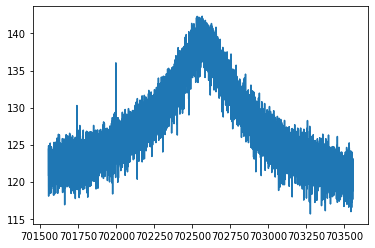

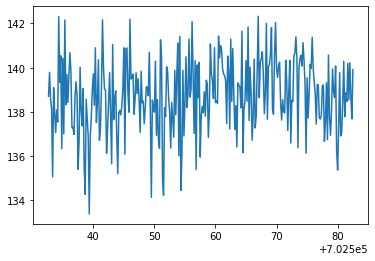

/nuz_trap2_dUvar0.004_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_26.spec


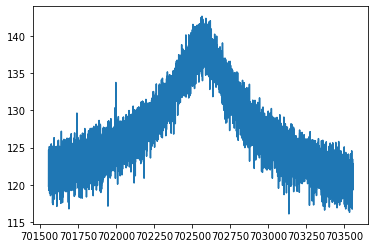

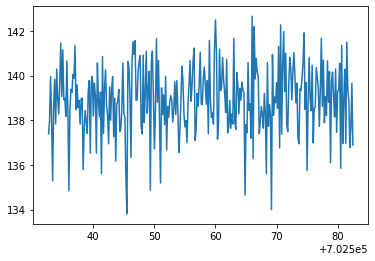

/nuz_trap2_dUvar0.004_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_27.spec


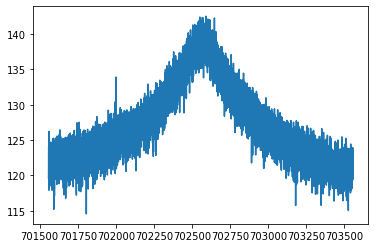

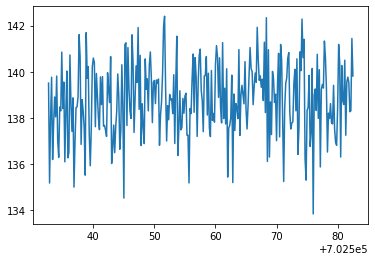

/nuz_trap2_dUvar0.004_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_28.spec


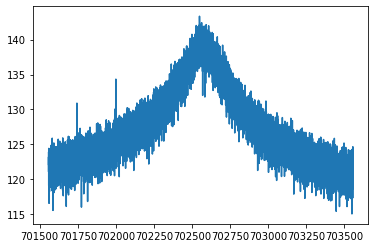

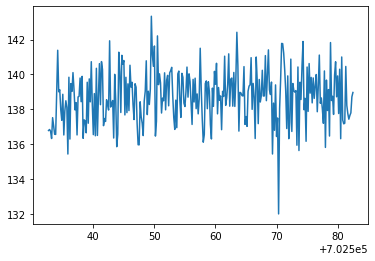

/nuz_trap2_dUvar0.004_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_29.spec


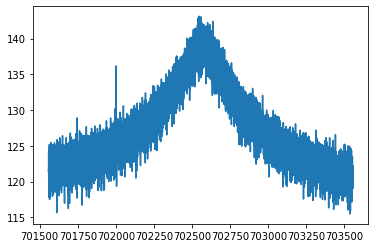

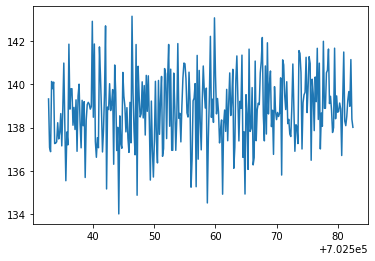

/nuz_trap2_dUvar0.004_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
371,21,20220515_114342.286067,0.004,2,702557.572595499456,0.031050659785,4.277998010469,0.280778176942,2.645099539561,702573.145047409460,5.795441522451,3462.938848843627,29.280078083877
372,22,20220515_122434.176718,0.004,2,702557.546812408138,0.030241480244,3.750532365493,0.248047327882,2.489502268551,702570.701203126577,5.707670176581,3602.214515838362,32.058557475716
373,23,20220515_125458.938203,0.004,2,702557.542805273551,0.032039207283,4.058130213101,0.275789350196,2.765577157867,702574.910308213905,5.980301514785,3535.156461177628,30.567400488857
374,24,20220515_132246.968610,0.004,2,702557.629908751347,0.031909720272,3.912674182771,0.273411551211,2.902808684042,702574.518257558695,6.223849194555,3516.720572757356,30.112578745567


/nuz_trap2_dUvar0.004_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_30.spec


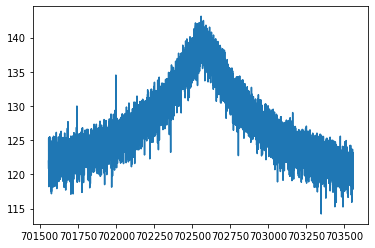

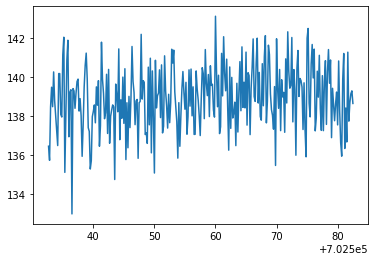

/nuz_trap2_dUvar0.004_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_31.spec


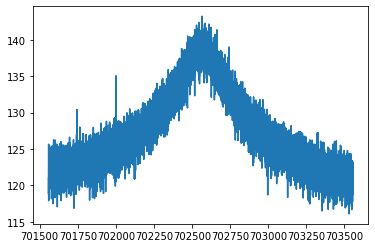

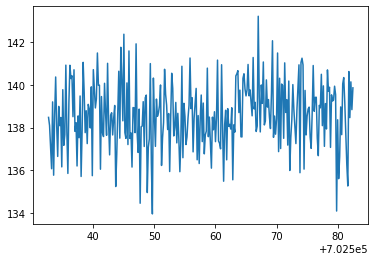

/nuz_trap2_dUvar0.004_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_32.spec


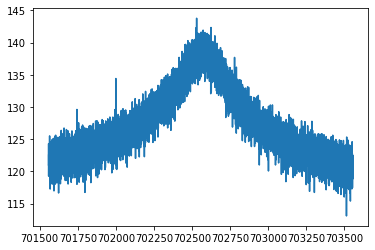

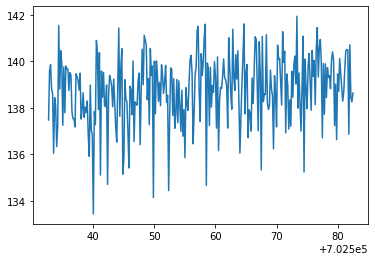

/nuz_trap2_dUvar0.004_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_33.spec


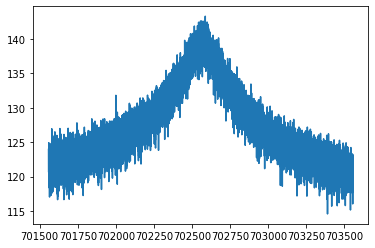

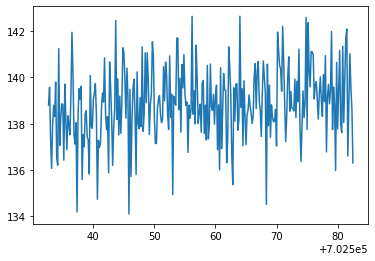

/nuz_trap2_dUvar0.004_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_34.spec


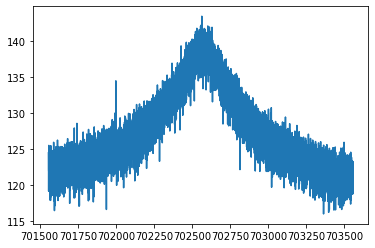

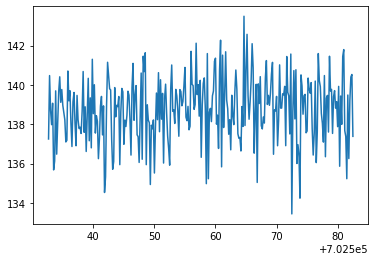

/nuz_trap2_dUvar0.004_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_35.spec


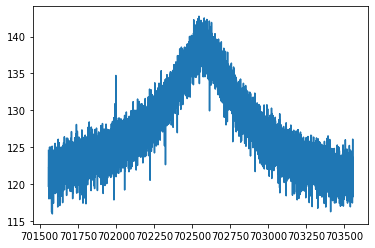

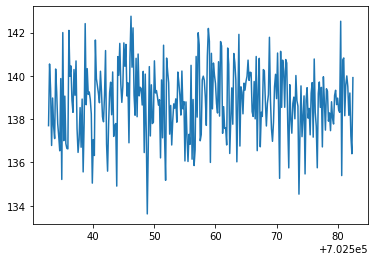

/nuz_trap2_dUvar0.004_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_36.spec


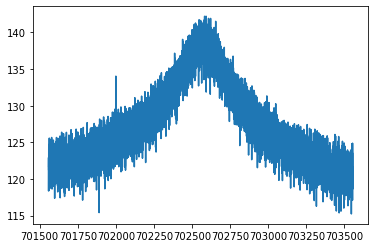

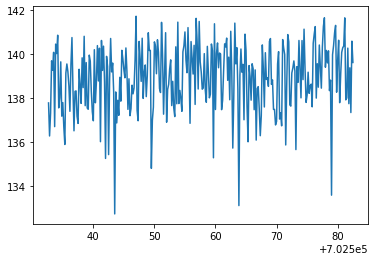

/nuz_trap2_dUvar0.004_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_37.spec


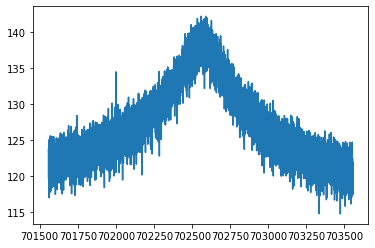

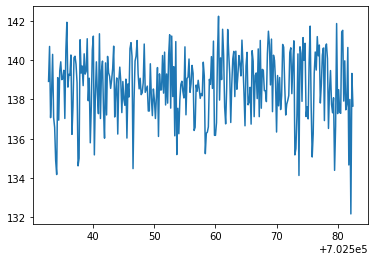

/nuz_trap2_dUvar0.004_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_38.spec


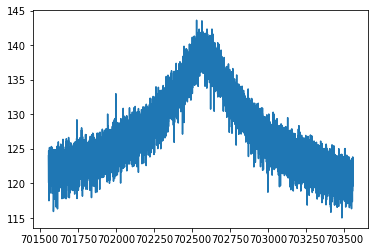

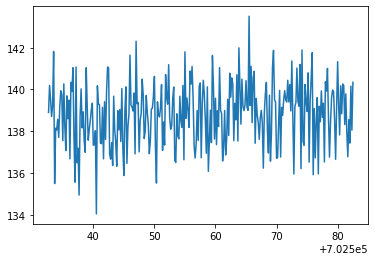

/nuz_trap2_dUvar0.004_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_39.spec


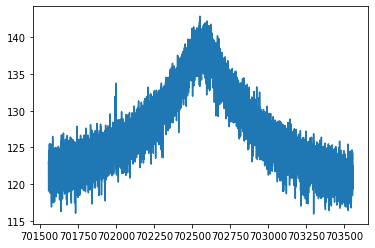

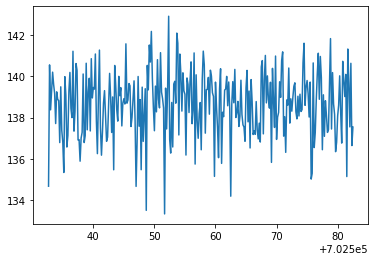

/nuz_trap2_dUvar0.004_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
372,22,20220515_122434.176718,0.004,2,702557.546812408138,0.030241480244,3.750532365493,0.248047327882,2.489502268551,702570.701203126577,5.707670176581,3602.214515838362,32.058557475716
373,23,20220515_125458.938203,0.004,2,702557.542805273551,0.032039207283,4.058130213101,0.275789350196,2.765577157867,702574.910308213905,5.980301514785,3535.156461177628,30.567400488857
374,24,20220515_132246.968610,0.004,2,702557.629908751347,0.031909720272,3.912674182771,0.273411551211,2.902808684042,702574.518257558695,6.223849194555,3516.720572757356,30.112578745567
375,3,20220515_023230.865917,0.004,2,702557.611712960294,0.031098562436,3.425416523594,0.257527907849,3.121963213913,702568.897243824322,6.872743450449,3420.176583330561,28.917585834990


/nuz_trap2_dUvar0.004_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_40.spec


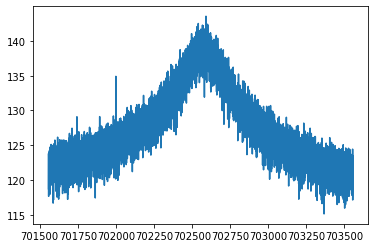

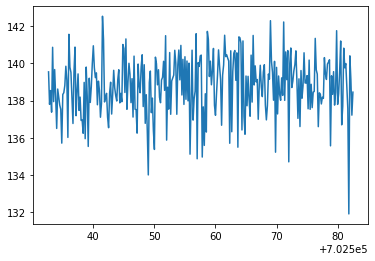

/nuz_trap2_dUvar0.004_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.004_41.spec


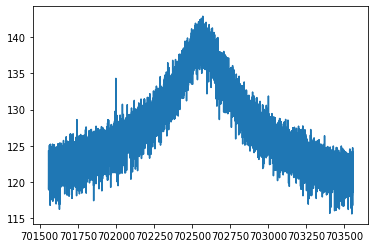

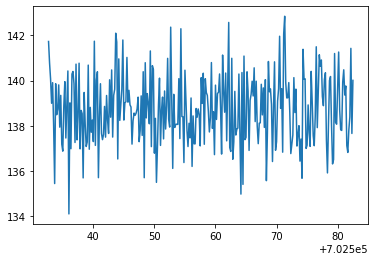

/nuz_trap2_dUvar0.004_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
373,23,20220515_125458.938203,0.004,2,702557.542805273551,0.032039207283,4.058130213101,0.275789350196,2.765577157867,702574.910308213905,5.980301514785,3535.156461177628,30.567400488857
374,24,20220515_132246.968610,0.004,2,702557.629908751347,0.031909720272,3.912674182771,0.273411551211,2.902808684042,702574.518257558695,6.223849194555,3516.720572757356,30.112578745567
375,3,20220515_023230.865917,0.004,2,702557.611712960294,0.031098562436,3.425416523594,0.257527907849,3.121963213913,702568.897243824322,6.872743450449,3420.176583330561,28.917585834990
376,4,20220515_030522.843276,0.004,2,702557.658203334198,0.036165785016,3.806907227572,0.289560858108,3.263449584007,702563.264654661296,6.481201299588,3584.898152861901,32.314912097300


/nuz_trap2_dUvar0.004_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
374,24,20220515_132246.968610,0.004,2,702557.629908751347,0.031909720272,3.912674182771,0.273411551211,2.902808684042,702574.518257558695,6.223849194555,3516.720572757356,30.112578745567
375,3,20220515_023230.865917,0.004,2,702557.611712960294,0.031098562436,3.425416523594,0.257527907849,3.121963213913,702568.897243824322,6.872743450449,3420.176583330561,28.917585834990
376,4,20220515_030522.843276,0.004,2,702557.658203334198,0.036165785016,3.806907227572,0.289560858108,3.263449584007,702563.264654661296,6.481201299588,3584.898152861901,32.314912097300
377,5,20220515_033824.352839,0.004,2,702557.571123266476,0.029398592111,3.802232946394,0.249948120712,2.472561518255,702560.533764432766,5.735381722399,3483.639465725268,30.367434185975


/nuz_trap2_dUvar0.004_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
375,3,20220515_023230.865917,0.004,2,702557.611712960294,0.031098562436,3.425416523594,0.257527907849,3.121963213913,702568.897243824322,6.872743450449,3420.176583330561,28.917585834990
376,4,20220515_030522.843276,0.004,2,702557.658203334198,0.036165785016,3.806907227572,0.289560858108,3.263449584007,702563.264654661296,6.481201299588,3584.898152861901,32.314912097300
377,5,20220515_033824.352839,0.004,2,702557.571123266476,0.029398592111,3.802232946394,0.249948120712,2.472561518255,702560.533764432766,5.735381722399,3483.639465725268,30.367434185975
378,6,20220515_041757.926515,0.004,2,702557.570616864134,0.032939702934,3.651003810210,0.281251336280,3.410214271237,702576.071936949040,7.058991956978,3448.685937630798,28.948691296260


/nuz_trap2_dUvar0.004_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
376,4,20220515_030522.843276,0.004,2,702557.658203334198,0.036165785016,3.806907227572,0.289560858108,3.263449584007,702563.264654661296,6.481201299588,3584.898152861901,32.314912097300
377,5,20220515_033824.352839,0.004,2,702557.571123266476,0.029398592111,3.802232946394,0.249948120712,2.472561518255,702560.533764432766,5.735381722399,3483.639465725268,30.367434185975
378,6,20220515_041757.926515,0.004,2,702557.570616864134,0.032939702934,3.651003810210,0.281251336280,3.410214271237,702576.071936949040,7.058991956978,3448.685937630798,28.948691296260
379,7,20220515_044032.360232,0.004,2,702557.585866044858,0.035324485907,4.048003825204,0.317476395993,3.693810637586,702568.505157238687,6.840526233608,3502.470509985729,29.649251141929


/nuz_trap2_dUvar0.004_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
377,5,20220515_033824.352839,0.004,2,702557.571123266476,0.029398592111,3.802232946394,0.249948120712,2.472561518255,702560.533764432766,5.735381722399,3483.639465725268,30.367434185975
378,6,20220515_041757.926515,0.004,2,702557.570616864134,0.032939702934,3.651003810210,0.281251336280,3.410214271237,702576.071936949040,7.058991956978,3448.685937630798,28.948691296260
379,7,20220515_044032.360232,0.004,2,702557.585866044858,0.035324485907,4.048003825204,0.317476395993,3.693810637586,702568.505157238687,6.840526233608,3502.470509985729,29.649251141929
380,8,20220515_045121.544905,0.004,2,702557.602432462270,0.035685742284,4.329786582239,0.312277164946,3.162061001413,702572.505576873780,6.194078952618,3550.103333838053,31.018961388168


/nuz_trap2_dUvar0.005_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
378,6,20220515_041757.926515,0.004,2,702557.570616864134,0.032939702934,3.651003810210,0.281251336280,3.410214271237,702576.071936949040,7.058991956978,3448.685937630798,28.948691296260
379,7,20220515_044032.360232,0.004,2,702557.585866044858,0.035324485907,4.048003825204,0.317476395993,3.693810637586,702568.505157238687,6.840526233608,3502.470509985729,29.649251141929
380,8,20220515_045121.544905,0.004,2,702557.602432462270,0.035685742284,4.329786582239,0.312277164946,3.162061001413,702572.505576873780,6.194078952618,3550.103333838053,31.018961388168
381,9,20220515_052818.145695,0.004,2,702557.626888738130,0.031442637771,4.013724808108,0.275844920625,2.841657571022,702572.599415533012,6.128632827174,3472.580386373385,29.303946805993


/nuz_trap2_dUvar0.005_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
379,7,20220515_044032.360232,0.004,2,702557.585866044858,0.035324485907,4.048003825204,0.317476395993,3.693810637586,702568.505157238687,6.840526233608,3502.470509985729,29.649251141929
380,8,20220515_045121.544905,0.004,2,702557.602432462270,0.035685742284,4.329786582239,0.312277164946,3.162061001413,702572.505576873780,6.194078952618,3550.103333838053,31.018961388168
381,9,20220515_052818.145695,0.004,2,702557.626888738130,0.031442637771,4.013724808108,0.275844920625,2.841657571022,702572.599415533012,6.128632827174,3472.580386373385,29.303946805993
382,1,20220515_013821.024698,0.005,2,702557.698848444968,0.030963726487,4.039890571521,0.267838948438,2.599272558781,702562.844387384132,5.713583765298,3513.502077878145,30.195506499058


/nuz_trap2_dUvar0.005_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
380,8,20220515_045121.544905,0.004,2,702557.602432462270,0.035685742284,4.329786582239,0.312277164946,3.162061001413,702572.505576873780,6.194078952618,3550.103333838053,31.018961388168
381,9,20220515_052818.145695,0.004,2,702557.626888738130,0.031442637771,4.013724808108,0.275844920625,2.841657571022,702572.599415533012,6.128632827174,3472.580386373385,29.303946805993
382,1,20220515_013821.024698,0.005,2,702557.698848444968,0.030963726487,4.039890571521,0.267838948438,2.599272558781,702562.844387384132,5.713583765298,3513.502077878145,30.195506499058
383,10,20220515_060356.249200,0.005,2,702557.597674419987,0.033850297030,3.705133247977,0.269772909586,2.948895406363,702566.368835726986,5.986799421748,3756.617642781089,34.956583074720


/nuz_trap2_dUvar0.005_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
381,9,20220515_052818.145695,0.004,2,702557.626888738130,0.031442637771,4.013724808108,0.275844920625,2.841657571022,702572.599415533012,6.128632827174,3472.580386373385,29.303946805993
382,1,20220515_013821.024698,0.005,2,702557.698848444968,0.030963726487,4.039890571521,0.267838948438,2.599272558781,702562.844387384132,5.713583765298,3513.502077878145,30.195506499058
383,10,20220515_060356.249200,0.005,2,702557.597674419987,0.033850297030,3.705133247977,0.269772909586,2.948895406363,702566.368835726986,5.986799421748,3756.617642781089,34.956583074720
384,11,20220515_065119.763649,0.005,2,702557.554418058950,0.031425202943,3.895307321741,0.268646057014,2.781246297892,702570.781750415801,6.064689886673,3509.441781815296,30.488783316828


/nuz_trap2_dUvar0.005_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
382,1,20220515_013821.024698,0.005,2,702557.698848444968,0.030963726487,4.039890571521,0.267838948438,2.599272558781,702562.844387384132,5.713583765298,3513.502077878145,30.195506499058
383,10,20220515_060356.249200,0.005,2,702557.597674419987,0.033850297030,3.705133247977,0.269772909586,2.948895406363,702566.368835726986,5.986799421748,3756.617642781089,34.956583074720
384,11,20220515_065119.763649,0.005,2,702557.554418058950,0.031425202943,3.895307321741,0.268646057014,2.781246297892,702570.781750415801,6.064689886673,3509.441781815296,30.488783316828
385,12,20220515_070050.650075,0.005,2,702557.597345306654,0.030986772569,3.846448591319,0.267938645250,2.829003504252,702568.446115612634,6.140739288019,3487.619873125293,30.747436868263


/nuz_trap2_dUvar0.005_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
383,10,20220515_060356.249200,0.005,2,702557.597674419987,0.033850297030,3.705133247977,0.269772909586,2.948895406363,702566.368835726986,5.986799421748,3756.617642781089,34.956583074720
384,11,20220515_065119.763649,0.005,2,702557.554418058950,0.031425202943,3.895307321741,0.268646057014,2.781246297892,702570.781750415801,6.064689886673,3509.441781815296,30.488783316828
385,12,20220515_070050.650075,0.005,2,702557.597345306654,0.030986772569,3.846448591319,0.267938645250,2.829003504252,702568.446115612634,6.140739288019,3487.619873125293,30.747436868263
386,13,20220515_075446.084554,0.005,2,702557.615423394134,0.031374357554,4.128749945028,0.273551995330,2.625574669991,702568.987116329372,5.758155854766,3502.792109547034,30.215528889025


/nuz_trap2_dUvar0.005_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
384,11,20220515_065119.763649,0.005,2,702557.554418058950,0.031425202943,3.895307321741,0.268646057014,2.781246297892,702570.781750415801,6.064689886673,3509.441781815296,30.488783316828
385,12,20220515_070050.650075,0.005,2,702557.597345306654,0.030986772569,3.846448591319,0.267938645250,2.829003504252,702568.446115612634,6.140739288019,3487.619873125293,30.747436868263
386,13,20220515_075446.084554,0.005,2,702557.615423394134,0.031374357554,4.128749945028,0.273551995330,2.625574669991,702568.987116329372,5.758155854766,3502.792109547034,30.215528889025
387,14,20220515_081839.041675,0.005,2,702557.661625419860,0.031076912109,3.774127424453,0.259589267580,2.772570437277,702574.584906094708,6.197620074935,3502.423387209693,30.027511409429


/nuz_trap2_dUvar0.005_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
385,12,20220515_070050.650075,0.005,2,702557.597345306654,0.030986772569,3.846448591319,0.267938645250,2.829003504252,702568.446115612634,6.140739288019,3487.619873125293,30.747436868263
386,13,20220515_075446.084554,0.005,2,702557.615423394134,0.031374357554,4.128749945028,0.273551995330,2.625574669991,702568.987116329372,5.758155854766,3502.792109547034,30.215528889025
387,14,20220515_081839.041675,0.005,2,702557.661625419860,0.031076912109,3.774127424453,0.259589267580,2.772570437277,702574.584906094708,6.197620074935,3502.423387209693,30.027511409429
388,15,20220515_090049.177752,0.005,2,702557.621324862586,0.032947737476,3.902610304857,0.268021013787,2.715481825103,702571.282694845111,5.788529273002,3679.351305037754,34.239311176515


/nuz_trap2_dUvar0.005_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
386,13,20220515_075446.084554,0.005,2,702557.615423394134,0.031374357554,4.128749945028,0.273551995330,2.625574669991,702568.987116329372,5.758155854766,3502.792109547034,30.215528889025
387,14,20220515_081839.041675,0.005,2,702557.661625419860,0.031076912109,3.774127424453,0.259589267580,2.772570437277,702574.584906094708,6.197620074935,3502.423387209693,30.027511409429
388,15,20220515_090049.177752,0.005,2,702557.621324862586,0.032947737476,3.902610304857,0.268021013787,2.715481825103,702571.282694845111,5.788529273002,3679.351305037754,34.239311176515
389,16,20220515_093232.380779,0.005,2,702557.566699182848,0.029480759288,3.769271145599,0.252353117463,2.603636611127,702573.149075157009,5.903235136104,3548.765161178564,30.514524169116


/nuz_trap2_dUvar0.005_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
387,14,20220515_081839.041675,0.005,2,702557.661625419860,0.031076912109,3.774127424453,0.259589267580,2.772570437277,702574.584906094708,6.197620074935,3502.423387209693,30.027511409429
388,15,20220515_090049.177752,0.005,2,702557.621324862586,0.032947737476,3.902610304857,0.268021013787,2.715481825103,702571.282694845111,5.788529273002,3679.351305037754,34.239311176515
389,16,20220515_093232.380779,0.005,2,702557.566699182848,0.029480759288,3.769271145599,0.252353117463,2.603636611127,702573.149075157009,5.903235136104,3548.765161178564,30.514524169116
390,17,20220515_100020.323568,0.005,2,702557.546689130599,0.032511654722,4.226239391464,0.291015023794,2.866855882262,702566.214973876136,5.964738960630,3478.245638682406,29.951317658561


/nuz_trap2_dUvar0.005_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
388,15,20220515_090049.177752,0.005,2,702557.621324862586,0.032947737476,3.902610304857,0.268021013787,2.715481825103,702571.282694845111,5.788529273002,3679.351305037754,34.239311176515
389,16,20220515_093232.380779,0.005,2,702557.566699182848,0.029480759288,3.769271145599,0.252353117463,2.603636611127,702573.149075157009,5.903235136104,3548.765161178564,30.514524169116
390,17,20220515_100020.323568,0.005,2,702557.546689130599,0.032511654722,4.226239391464,0.291015023794,2.866855882262,702566.214973876136,5.964738960630,3478.245638682406,29.951317658561
391,18,20220515_101346.290930,0.005,2,702557.522446509800,0.032143861683,3.688803663922,0.258641888583,2.783909937076,702572.739607138792,6.076320040016,3626.066413771963,32.517932196501


/nuz_trap2_dUvar0.005_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
389,16,20220515_093232.380779,0.005,2,702557.566699182848,0.029480759288,3.769271145599,0.252353117463,2.603636611127,702573.149075157009,5.903235136104,3548.765161178564,30.514524169116
390,17,20220515_100020.323568,0.005,2,702557.546689130599,0.032511654722,4.226239391464,0.291015023794,2.866855882262,702566.214973876136,5.964738960630,3478.245638682406,29.951317658561
391,18,20220515_101346.290930,0.005,2,702557.522446509800,0.032143861683,3.688803663922,0.258641888583,2.783909937076,702572.739607138792,6.076320040016,3626.066413771963,32.517932196501
392,19,20220515_110900.167116,0.005,2,702557.576976445620,0.034214956560,4.220448619598,0.305197663951,3.198646175181,702573.102389298030,6.113607371591,3652.995046439114,32.694431925461


/nuz_trap2_dUvar0.005_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,17,20220515_100020.323568,0.005,2,702557.546689130599,0.032511654722,4.226239391464,0.291015023794,2.866855882262,702566.214973876136,5.964738960630,3478.245638682406,29.951317658561
391,18,20220515_101346.290930,0.005,2,702557.522446509800,0.032143861683,3.688803663922,0.258641888583,2.783909937076,702572.739607138792,6.076320040016,3626.066413771963,32.517932196501
392,19,20220515_110900.167116,0.005,2,702557.576976445620,0.034214956560,4.220448619598,0.305197663951,3.198646175181,702573.102389298030,6.113607371591,3652.995046439114,32.694431925461
393,2,20220515_015026.868208,0.005,2,702557.550067106145,0.033020623780,4.641471830259,0.289372146097,2.363417457728,702567.241328073433,5.027387945499,3680.475634344561,33.830412868831


/nuz_trap2_dUvar0.005_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
391,18,20220515_101346.290930,0.005,2,702557.522446509800,0.032143861683,3.688803663922,0.258641888583,2.783909937076,702572.739607138792,6.076320040016,3626.066413771963,32.517932196501
392,19,20220515_110900.167116,0.005,2,702557.576976445620,0.034214956560,4.220448619598,0.305197663951,3.198646175181,702573.102389298030,6.113607371591,3652.995046439114,32.694431925461
393,2,20220515_015026.868208,0.005,2,702557.550067106145,0.033020623780,4.641471830259,0.289372146097,2.363417457728,702567.241328073433,5.027387945499,3680.475634344561,33.830412868831
394,20,20220515_111554.242623,0.005,2,702557.562975038076,0.029424501033,4.287887772427,0.269351067542,2.435561684694,702571.549095641938,5.426561475723,3535.589785900188,30.644246699114


/nuz_trap2_dUvar0.005_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,19,20220515_110900.167116,0.005,2,702557.576976445620,0.034214956560,4.220448619598,0.305197663951,3.198646175181,702573.102389298030,6.113607371591,3652.995046439114,32.694431925461
393,2,20220515_015026.868208,0.005,2,702557.550067106145,0.033020623780,4.641471830259,0.289372146097,2.363417457728,702567.241328073433,5.027387945499,3680.475634344561,33.830412868831
394,20,20220515_111554.242623,0.005,2,702557.562975038076,0.029424501033,4.287887772427,0.269351067542,2.435561684694,702571.549095641938,5.426561475723,3535.589785900188,30.644246699114
395,21,20220515_121344.993831,0.005,2,702557.611498389975,0.029351828273,3.655110174329,0.250282836473,2.671752829412,702562.146938889055,6.064746669308,3469.390256841611,29.247630027282


/nuz_trap2_dUvar0.005_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
393,2,20220515_015026.868208,0.005,2,702557.550067106145,0.033020623780,4.641471830259,0.289372146097,2.363417457728,702567.241328073433,5.027387945499,3680.475634344561,33.830412868831
394,20,20220515_111554.242623,0.005,2,702557.562975038076,0.029424501033,4.287887772427,0.269351067542,2.435561684694,702571.549095641938,5.426561475723,3535.589785900188,30.644246699114
395,21,20220515_121344.993831,0.005,2,702557.611498389975,0.029351828273,3.655110174329,0.250282836473,2.671752829412,702562.146938889055,6.064746669308,3469.390256841611,29.247630027282
396,22,20220515_123342.792306,0.005,2,702557.532448326005,0.033282920552,3.957268393683,0.286464525212,3.119262025352,702575.063079412328,6.565836448311,3436.505018221467,29.223738441341


/nuz_trap2_dUvar0.005_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
394,20,20220515_111554.242623,0.005,2,702557.562975038076,0.029424501033,4.287887772427,0.269351067542,2.435561684694,702571.549095641938,5.426561475723,3535.589785900188,30.644246699114
395,21,20220515_121344.993831,0.005,2,702557.611498389975,0.029351828273,3.655110174329,0.250282836473,2.671752829412,702562.146938889055,6.064746669308,3469.390256841611,29.247630027282
396,22,20220515_123342.792306,0.005,2,702557.532448326005,0.033282920552,3.957268393683,0.286464525212,3.119262025352,702575.063079412328,6.565836448311,3436.505018221467,29.223738441341
397,23,20220515_125735.668486,0.005,2,702557.584807947511,0.026770180248,3.504717491465,0.224847249670,2.294487143618,702568.400272732018,5.681625354874,3520.338568300034,30.126084973626


/nuz_trap2_dUvar0.005_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_25.spec


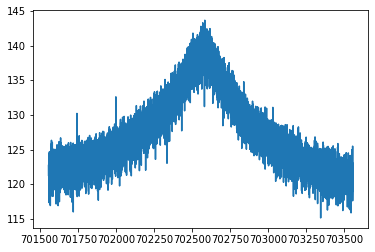

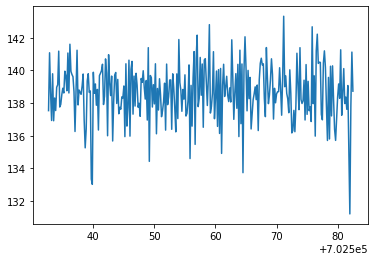

/nuz_trap2_dUvar0.005_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_26.spec


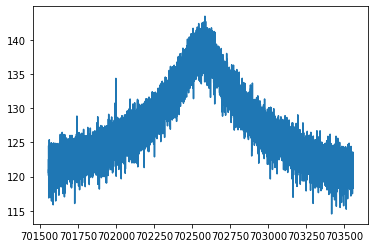

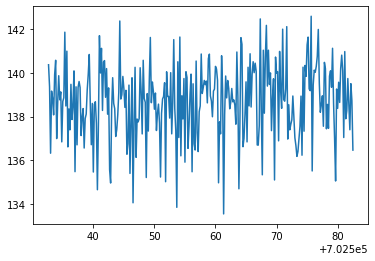

/nuz_trap2_dUvar0.005_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_27.spec


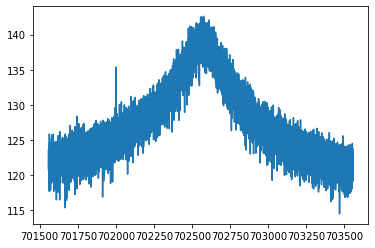

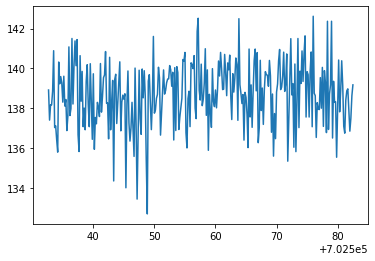

/nuz_trap2_dUvar0.005_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_28.spec


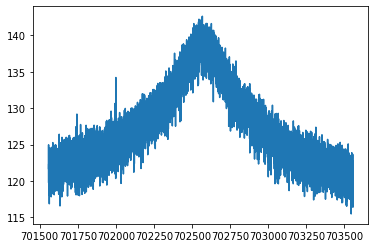

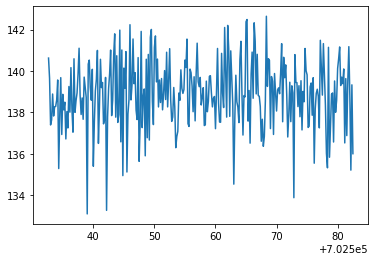

/nuz_trap2_dUvar0.005_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_29.spec


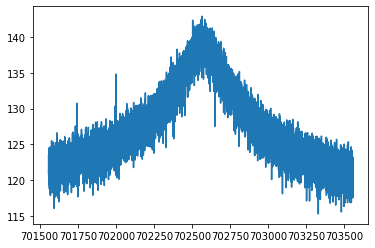

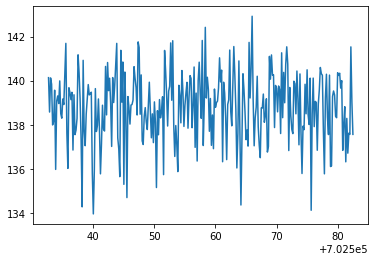

/nuz_trap2_dUvar0.005_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,21,20220515_121344.993831,0.005,2,702557.611498389975,0.029351828273,3.655110174329,0.250282836473,2.671752829412,702562.146938889055,6.064746669308,3469.390256841611,29.247630027282
396,22,20220515_123342.792306,0.005,2,702557.532448326005,0.033282920552,3.957268393683,0.286464525212,3.119262025352,702575.063079412328,6.565836448311,3436.505018221467,29.223738441341
397,23,20220515_125735.668486,0.005,2,702557.584807947511,0.026770180248,3.504717491465,0.224847249670,2.294487143618,702568.400272732018,5.681625354874,3520.338568300034,30.126084973626
398,24,20220515_133827.477997,0.005,2,702557.661060620565,0.035702971195,3.723895900316,0.278064767232,3.089303411379,702564.368918998516,6.240431473974,3677.124938183566,34.612070113925


/nuz_trap2_dUvar0.005_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_30.spec


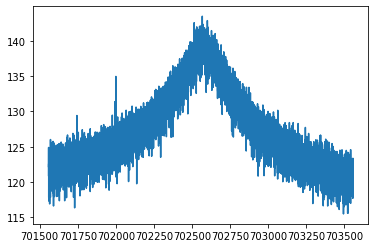

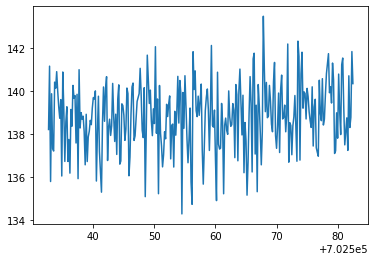

/nuz_trap2_dUvar0.005_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_31.spec


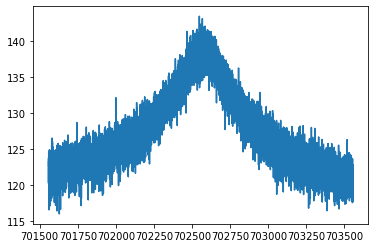

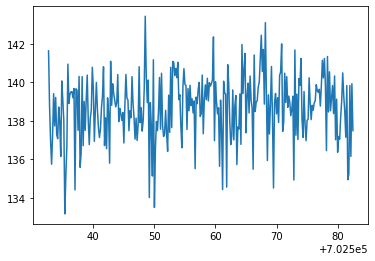

/nuz_trap2_dUvar0.005_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_32.spec


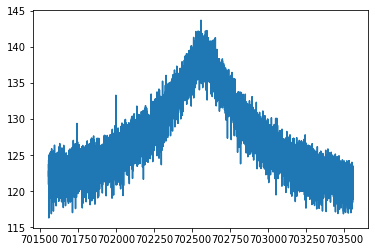

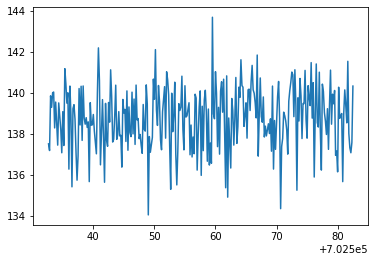

/nuz_trap2_dUvar0.005_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_33.spec


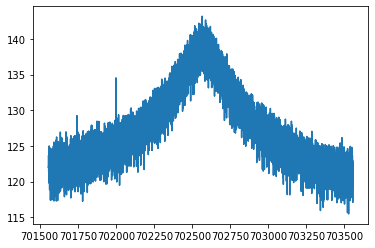

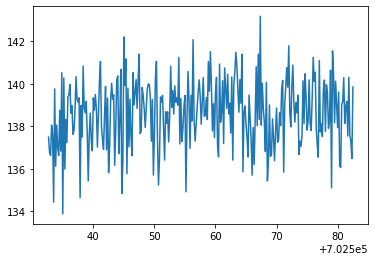

/nuz_trap2_dUvar0.005_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_34.spec


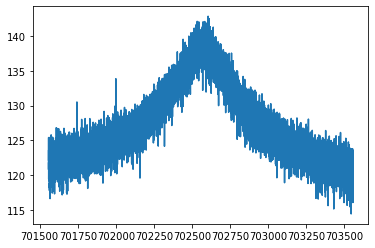

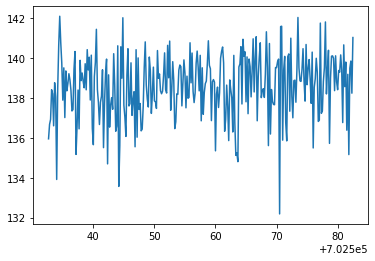

/nuz_trap2_dUvar0.005_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_35.spec


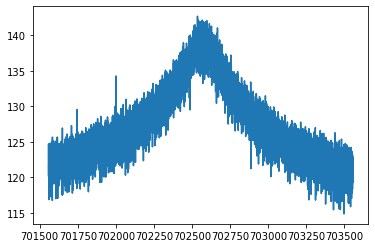

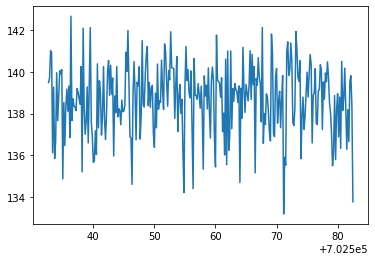

/nuz_trap2_dUvar0.005_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_36.spec


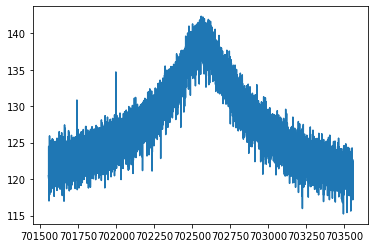

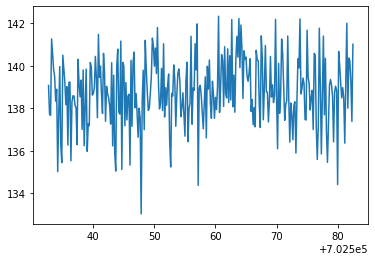

/nuz_trap2_dUvar0.005_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_37.spec


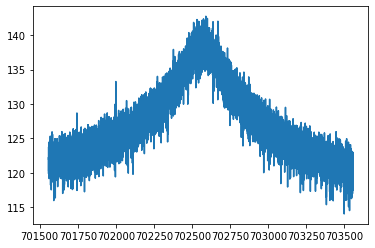

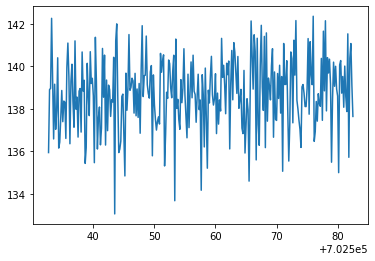

/nuz_trap2_dUvar0.005_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_38.spec


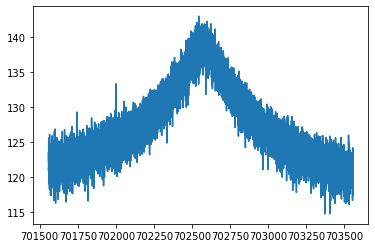

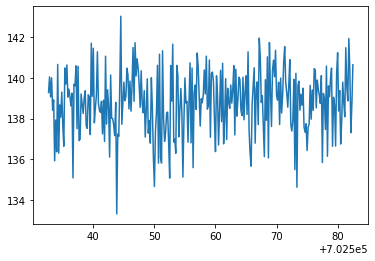

/nuz_trap2_dUvar0.005_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_39.spec


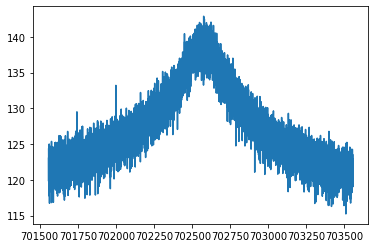

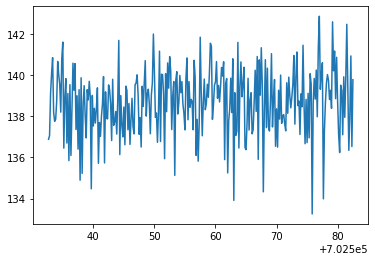

/nuz_trap2_dUvar0.005_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
396,22,20220515_123342.792306,0.005,2,702557.532448326005,0.033282920552,3.957268393683,0.286464525212,3.119262025352,702575.063079412328,6.565836448311,3436.505018221467,29.223738441341
397,23,20220515_125735.668486,0.005,2,702557.584807947511,0.026770180248,3.504717491465,0.224847249670,2.294487143618,702568.400272732018,5.681625354874,3520.338568300034,30.126084973626
398,24,20220515_133827.477997,0.005,2,702557.661060620565,0.035702971195,3.723895900316,0.278064767232,3.089303411379,702564.368918998516,6.240431473974,3677.124938183566,34.612070113925
399,3,20220515_024256.286212,0.005,2,702557.548754557618,0.037087529076,3.685763016797,0.295148987737,3.588691312366,702572.143944985117,6.780697381254,3701.633382626277,34.673085852530


/nuz_trap2_dUvar0.005_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.005_40.spec


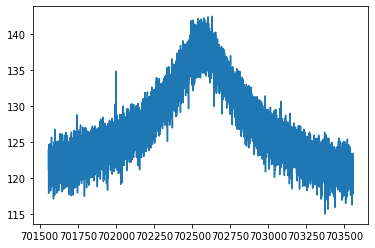

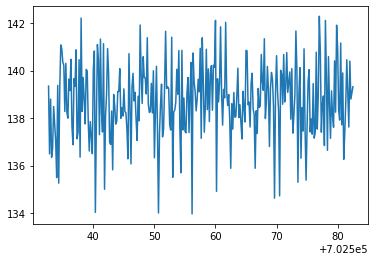

/nuz_trap2_dUvar0.005_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
397,23,20220515_125735.668486,0.005,2,702557.584807947511,0.026770180248,3.504717491465,0.224847249670,2.294487143618,702568.400272732018,5.681625354874,3520.338568300034,30.126084973626
398,24,20220515_133827.477997,0.005,2,702557.661060620565,0.035702971195,3.723895900316,0.278064767232,3.089303411379,702564.368918998516,6.240431473974,3677.124938183566,34.612070113925
399,3,20220515_024256.286212,0.005,2,702557.548754557618,0.037087529076,3.685763016797,0.295148987737,3.588691312366,702572.143944985117,6.780697381254,3701.633382626277,34.673085852530
400,4,20220515_024942.433800,0.005,2,702557.609723145026,0.031200208863,4.105140897488,0.272663454881,2.664340021121,702574.699143528123,5.865959271900,3512.923689461451,30.456025773884


/nuz_trap2_dUvar0.005_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
398,24,20220515_133827.477997,0.005,2,702557.661060620565,0.035702971195,3.723895900316,0.278064767232,3.089303411379,702564.368918998516,6.240431473974,3677.124938183566,34.612070113925
399,3,20220515_024256.286212,0.005,2,702557.548754557618,0.037087529076,3.685763016797,0.295148987737,3.588691312366,702572.143944985117,6.780697381254,3701.633382626277,34.673085852530
400,4,20220515_024942.433800,0.005,2,702557.609723145026,0.031200208863,4.105140897488,0.272663454881,2.664340021121,702574.699143528123,5.865959271900,3512.923689461451,30.456025773884
401,5,20220515_032757.349702,0.005,2,702557.626222436666,0.034906325347,3.748476356959,0.295108570382,3.580837945959,702568.594979646499,6.998690300480,3481.810748209356,29.484253755380


/nuz_trap2_dUvar0.005_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
399,3,20220515_024256.286212,0.005,2,702557.548754557618,0.037087529076,3.685763016797,0.295148987737,3.588691312366,702572.143944985117,6.780697381254,3701.633382626277,34.673085852530
400,4,20220515_024942.433800,0.005,2,702557.609723145026,0.031200208863,4.105140897488,0.272663454881,2.664340021121,702574.699143528123,5.865959271900,3512.923689461451,30.456025773884
401,5,20220515_032757.349702,0.005,2,702557.626222436666,0.034906325347,3.748476356959,0.295108570382,3.580837945959,702568.594979646499,6.998690300480,3481.810748209356,29.484253755380
402,6,20220515_041521.204660,0.005,2,702557.586093851598,0.030099494826,4.161706108990,0.272649656244,2.622387902615,702573.314168267651,5.822563968376,3462.201621274631,29.173556524174


/nuz_trap2_dUvar0.005_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
400,4,20220515_024942.433800,0.005,2,702557.609723145026,0.031200208863,4.105140897488,0.272663454881,2.664340021121,702574.699143528123,5.865959271900,3512.923689461451,30.456025773884
401,5,20220515_032757.349702,0.005,2,702557.626222436666,0.034906325347,3.748476356959,0.295108570382,3.580837945959,702568.594979646499,6.998690300480,3481.810748209356,29.484253755380
402,6,20220515_041521.204660,0.005,2,702557.586093851598,0.030099494826,4.161706108990,0.272649656244,2.622387902615,702573.314168267651,5.822563968376,3462.201621274631,29.173556524174
403,7,20220515_044309.084529,0.005,2,702557.531108888099,0.035999177456,4.174091395290,0.315102317238,3.424026298888,702569.848039543955,6.700021442634,3421.220101840935,28.929001179884


/nuz_trap2_dUvar0.005_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
401,5,20220515_032757.349702,0.005,2,702557.626222436666,0.034906325347,3.748476356959,0.295108570382,3.580837945959,702568.594979646499,6.998690300480,3481.810748209356,29.484253755380
402,6,20220515_041521.204660,0.005,2,702557.586093851598,0.030099494826,4.161706108990,0.272649656244,2.622387902615,702573.314168267651,5.822563968376,3462.201621274631,29.173556524174
403,7,20220515_044309.084529,0.005,2,702557.531108888099,0.035999177456,4.174091395290,0.315102317238,3.424026298888,702569.848039543955,6.700021442634,3421.220101840935,28.929001179884
404,8,20220515_051847.342158,0.005,2,702557.593845211901,0.033516850261,4.059779478722,0.296241835461,3.221086323152,702575.579444896197,6.456788318526,3526.302703698211,30.466099040410


/nuz_trap2_dUvar0.006_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
402,6,20220515_041521.204660,0.005,2,702557.586093851598,0.030099494826,4.161706108990,0.272649656244,2.622387902615,702573.314168267651,5.822563968376,3462.201621274631,29.173556524174
403,7,20220515_044309.084529,0.005,2,702557.531108888099,0.035999177456,4.174091395290,0.315102317238,3.424026298888,702569.848039543955,6.700021442634,3421.220101840935,28.929001179884
404,8,20220515_051847.342158,0.005,2,702557.593845211901,0.033516850261,4.059779478722,0.296241835461,3.221086323152,702575.579444896197,6.456788318526,3526.302703698211,30.466099040410
405,9,20220515_052541.418363,0.005,2,702557.562381190946,0.031936680925,3.830863108169,0.276478151909,3.038123960722,702570.606037284480,6.501120413438,3425.142273699330,29.134781230989


/nuz_trap2_dUvar0.006_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
403,7,20220515_044309.084529,0.005,2,702557.531108888099,0.035999177456,4.174091395290,0.315102317238,3.424026298888,702569.848039543955,6.700021442634,3421.220101840935,28.929001179884
404,8,20220515_051847.342158,0.005,2,702557.593845211901,0.033516850261,4.059779478722,0.296241835461,3.221086323152,702575.579444896197,6.456788318526,3526.302703698211,30.466099040410
405,9,20220515_052541.418363,0.005,2,702557.562381190946,0.031936680925,3.830863108169,0.276478151909,3.038123960722,702570.606037284480,6.501120413438,3425.142273699330,29.134781230989
406,1,20220515_011611.666145,0.006,2,702557.681730927201,0.030911553485,3.780676787872,0.258500684412,2.713239884326,702569.781719419523,6.135124598468,3456.914312185211,29.525877602787


/nuz_trap2_dUvar0.006_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
404,8,20220515_051847.342158,0.005,2,702557.593845211901,0.033516850261,4.059779478722,0.296241835461,3.221086323152,702575.579444896197,6.456788318526,3526.302703698211,30.466099040410
405,9,20220515_052541.418363,0.005,2,702557.562381190946,0.031936680925,3.830863108169,0.276478151909,3.038123960722,702570.606037284480,6.501120413438,3425.142273699330,29.134781230989
406,1,20220515_011611.666145,0.006,2,702557.681730927201,0.030911553485,3.780676787872,0.258500684412,2.713239884326,702569.781719419523,6.135124598468,3456.914312185211,29.525877602787
407,10,20220515_060119.506700,0.006,2,702557.687233309378,0.034756441320,3.947959194664,0.286611780164,3.093825167191,702573.869147076388,6.290598966382,3606.499059979259,32.625074053430


/nuz_trap2_dUvar0.006_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
405,9,20220515_052541.418363,0.005,2,702557.562381190946,0.031936680925,3.830863108169,0.276478151909,3.038123960722,702570.606037284480,6.501120413438,3425.142273699330,29.134781230989
406,1,20220515_011611.666145,0.006,2,702557.681730927201,0.030911553485,3.780676787872,0.258500684412,2.713239884326,702569.781719419523,6.135124598468,3456.914312185211,29.525877602787
407,10,20220515_060119.506700,0.006,2,702557.687233309378,0.034756441320,3.947959194664,0.286611780164,3.093825167191,702573.869147076388,6.290598966382,3606.499059979259,32.625074053430
408,11,20220515_065238.132829,0.006,2,702557.677942106384,0.033577250996,4.038866725484,0.272079273830,2.624703822544,702566.982044075849,5.475464490267,3762.315704852305,34.997566907832


/nuz_trap2_dUvar0.006_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
406,1,20220515_011611.666145,0.006,2,702557.681730927201,0.030911553485,3.780676787872,0.258500684412,2.713239884326,702569.781719419523,6.135124598468,3456.914312185211,29.525877602787
407,10,20220515_060119.506700,0.006,2,702557.687233309378,0.034756441320,3.947959194664,0.286611780164,3.093825167191,702573.869147076388,6.290598966382,3606.499059979259,32.625074053430
408,11,20220515_065238.132829,0.006,2,702557.677942106384,0.033577250996,4.038866725484,0.272079273830,2.624703822544,702566.982044075849,5.475464490267,3762.315704852305,34.997566907832
409,12,20220515_071907.860735,0.006,2,702557.616427780828,0.036944065966,4.077489467538,0.301518657427,3.172716078211,702570.638184136362,6.231950216581,3632.070135707135,32.827384235130


/nuz_trap2_dUvar0.006_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
407,10,20220515_060119.506700,0.006,2,702557.687233309378,0.034756441320,3.947959194664,0.286611780164,3.093825167191,702573.869147076388,6.290598966382,3606.499059979259,32.625074053430
408,11,20220515_065238.132829,0.006,2,702557.677942106384,0.033577250996,4.038866725484,0.272079273830,2.624703822544,702566.982044075849,5.475464490267,3762.315704852305,34.997566907832
409,12,20220515_071907.860735,0.006,2,702557.616427780828,0.036944065966,4.077489467538,0.301518657427,3.172716078211,702570.638184136362,6.231950216581,3632.070135707135,32.827384235130
410,13,20220515_074419.127663,0.006,2,702557.596779192914,0.030328583157,3.755672473366,0.242506798288,2.343662315796,702572.130482336855,5.538964803368,3628.968732563876,33.035134477453


/nuz_trap2_dUvar0.006_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
408,11,20220515_065238.132829,0.006,2,702557.677942106384,0.033577250996,4.038866725484,0.272079273830,2.624703822544,702566.982044075849,5.475464490267,3762.315704852305,34.997566907832
409,12,20220515_071907.860735,0.006,2,702557.616427780828,0.036944065966,4.077489467538,0.301518657427,3.172716078211,702570.638184136362,6.231950216581,3632.070135707135,32.827384235130
410,13,20220515_074419.127663,0.006,2,702557.596779192914,0.030328583157,3.755672473366,0.242506798288,2.343662315796,702572.130482336855,5.538964803368,3628.968732563876,33.035134477453
411,14,20220515_082234.235661,0.006,2,702557.609712524107,0.032406637700,3.555911802568,0.276522736210,3.449464218650,702573.895382376970,7.118558533713,3450.749205459146,29.717306807190


/nuz_trap2_dUvar0.006_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
409,12,20220515_071907.860735,0.006,2,702557.616427780828,0.036944065966,4.077489467538,0.301518657427,3.172716078211,702570.638184136362,6.231950216581,3632.070135707135,32.827384235130
410,13,20220515_074419.127663,0.006,2,702557.596779192914,0.030328583157,3.755672473366,0.242506798288,2.343662315796,702572.130482336855,5.538964803368,3628.968732563876,33.035134477453
411,14,20220515_082234.235661,0.006,2,702557.609712524107,0.032406637700,3.555911802568,0.276522736210,3.449464218650,702573.895382376970,7.118558533713,3450.749205459146,29.717306807190
412,15,20220515_085258.929871,0.006,2,702557.606981462915,0.030007227233,3.484573503046,0.251295508234,2.899519667860,702567.407726080040,6.457501325562,3479.836883721211,29.844781623574


/nuz_trap2_dUvar0.006_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
410,13,20220515_074419.127663,0.006,2,702557.596779192914,0.030328583157,3.755672473366,0.242506798288,2.343662315796,702572.130482336855,5.538964803368,3628.968732563876,33.035134477453
411,14,20220515_082234.235661,0.006,2,702557.609712524107,0.032406637700,3.555911802568,0.276522736210,3.449464218650,702573.895382376970,7.118558533713,3450.749205459146,29.717306807190
412,15,20220515_085258.929871,0.006,2,702557.606981462915,0.030007227233,3.484573503046,0.251295508234,2.899519667860,702567.407726080040,6.457501325562,3479.836883721211,29.844781623574
413,16,20220515_091810.315153,0.006,2,702557.571262530866,0.033587427030,3.797789521745,0.292583571341,3.496235172230,702576.909812928294,6.998058788530,3478.288077320881,29.492264683656


/nuz_trap2_dUvar0.006_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
411,14,20220515_082234.235661,0.006,2,702557.609712524107,0.032406637700,3.555911802568,0.276522736210,3.449464218650,702573.895382376970,7.118558533713,3450.749205459146,29.717306807190
412,15,20220515_085258.929871,0.006,2,702557.606981462915,0.030007227233,3.484573503046,0.251295508234,2.899519667860,702567.407726080040,6.457501325562,3479.836883721211,29.844781623574
413,16,20220515_091810.315153,0.006,2,702557.571262530866,0.033587427030,3.797789521745,0.292583571341,3.496235172230,702576.909812928294,6.998058788530,3478.288077320881,29.492264683656
414,17,20220515_094835.022566,0.006,2,702557.618883896735,0.035910417776,3.925509146669,0.306006940444,3.552133527433,702566.108087115223,6.660860284960,3581.833633744538,31.757125246321


/nuz_trap2_dUvar0.006_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
412,15,20220515_085258.929871,0.006,2,702557.606981462915,0.030007227233,3.484573503046,0.251295508234,2.899519667860,702567.407726080040,6.457501325562,3479.836883721211,29.844781623574
413,16,20220515_091810.315153,0.006,2,702557.571262530866,0.033587427030,3.797789521745,0.292583571341,3.496235172230,702576.909812928294,6.998058788530,3478.288077320881,29.492264683656
414,17,20220515_094835.022566,0.006,2,702557.618883896735,0.035910417776,3.925509146669,0.306006940444,3.552133527433,702566.108087115223,6.660860284960,3581.833633744538,31.757125246321
415,18,20220515_100951.156862,0.006,2,702557.577020918136,0.031301381949,3.510197639102,0.272258782782,3.426987325871,702575.467163500027,7.105918511635,3470.069657059389,29.392040404756


/nuz_trap2_dUvar0.006_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,16,20220515_091810.315153,0.006,2,702557.571262530866,0.033587427030,3.797789521745,0.292583571341,3.496235172230,702576.909812928294,6.998058788530,3478.288077320881,29.492264683656
414,17,20220515_094835.022566,0.006,2,702557.618883896735,0.035910417776,3.925509146669,0.306006940444,3.552133527433,702566.108087115223,6.660860284960,3581.833633744538,31.757125246321
415,18,20220515_100951.156862,0.006,2,702557.577020918136,0.031301381949,3.510197639102,0.272258782782,3.426987325871,702575.467163500027,7.105918511635,3470.069657059389,29.392040404756
416,19,20220515_110228.328524,0.006,2,702557.667181053082,0.035191267707,3.737824149721,0.296661275877,3.643596806738,702563.525844512042,7.128789736499,3424.065403568608,29.186805228824


/nuz_trap2_dUvar0.006_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
414,17,20220515_094835.022566,0.006,2,702557.618883896735,0.035910417776,3.925509146669,0.306006940444,3.552133527433,702566.108087115223,6.660860284960,3581.833633744538,31.757125246321
415,18,20220515_100951.156862,0.006,2,702557.577020918136,0.031301381949,3.510197639102,0.272258782782,3.426987325871,702575.467163500027,7.105918511635,3470.069657059389,29.392040404756
416,19,20220515_110228.328524,0.006,2,702557.667181053082,0.035191267707,3.737824149721,0.296661275877,3.643596806738,702563.525844512042,7.128789736499,3424.065403568608,29.186805228824
417,2,20220515_014908.670137,0.006,2,702557.615545455017,0.032413182522,3.745823457088,0.266574867411,2.872001348705,702566.582329387660,6.153632508754,3558.604022563632,30.961573931057


/nuz_trap2_dUvar0.006_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
415,18,20220515_100951.156862,0.006,2,702557.577020918136,0.031301381949,3.510197639102,0.272258782782,3.426987325871,702575.467163500027,7.105918511635,3470.069657059389,29.392040404756
416,19,20220515_110228.328524,0.006,2,702557.667181053082,0.035191267707,3.737824149721,0.296661275877,3.643596806738,702563.525844512042,7.128789736499,3424.065403568608,29.186805228824
417,2,20220515_014908.670137,0.006,2,702557.615545455017,0.032413182522,3.745823457088,0.266574867411,2.872001348705,702566.582329387660,6.153632508754,3558.604022563632,30.961573931057
418,20,20220515_113134.740870,0.006,2,702557.571648925659,0.035084983332,4.024496760683,0.291817077694,3.048947111514,702567.241875302861,5.989469891917,3692.247041967723,33.896762350574


/nuz_trap2_dUvar0.006_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
416,19,20220515_110228.328524,0.006,2,702557.667181053082,0.035191267707,3.737824149721,0.296661275877,3.643596806738,702563.525844512042,7.128789736499,3424.065403568608,29.186805228824
417,2,20220515_014908.670137,0.006,2,702557.615545455017,0.032413182522,3.745823457088,0.266574867411,2.872001348705,702566.582329387660,6.153632508754,3558.604022563632,30.961573931057
418,20,20220515_113134.740870,0.006,2,702557.571648925659,0.035084983332,4.024496760683,0.291817077694,3.048947111514,702567.241875302861,5.989469891917,3692.247041967723,33.896762350574
419,21,20220515_120436.307595,0.006,2,702557.605861049378,0.033049586154,3.958386894821,0.287984433980,3.143982611026,702572.166972840438,6.442045700800,3493.649246731784,29.973888989559


/nuz_trap2_dUvar0.006_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
417,2,20220515_014908.670137,0.006,2,702557.615545455017,0.032413182522,3.745823457088,0.266574867411,2.872001348705,702566.582329387660,6.153632508754,3558.604022563632,30.961573931057
418,20,20220515_113134.740870,0.006,2,702557.571648925659,0.035084983332,4.024496760683,0.291817077694,3.048947111514,702567.241875302861,5.989469891917,3692.247041967723,33.896762350574
419,21,20220515_120436.307595,0.006,2,702557.605861049378,0.033049586154,3.958386894821,0.287984433980,3.143982611026,702572.166972840438,6.442045700800,3493.649246731784,29.973888989559
420,22,20220515_122552.560981,0.006,2,702557.574654688709,0.032385410504,4.246281742253,0.286066141516,2.771407119299,702575.357723979512,5.910994644779,3520.467860880110,30.890907355491


/nuz_trap2_dUvar0.006_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
418,20,20220515_113134.740870,0.006,2,702557.571648925659,0.035084983332,4.024496760683,0.291817077694,3.048947111514,702567.241875302861,5.989469891917,3692.247041967723,33.896762350574
419,21,20220515_120436.307595,0.006,2,702557.605861049378,0.033049586154,3.958386894821,0.287984433980,3.143982611026,702572.166972840438,6.442045700800,3493.649246731784,29.973888989559
420,22,20220515_122552.560981,0.006,2,702557.574654688709,0.032385410504,4.246281742253,0.286066141516,2.771407119299,702575.357723979512,5.910994644779,3520.467860880110,30.890907355491
421,23,20220515_130249.152609,0.006,2,702557.642992025358,0.030380979367,3.806336379834,0.257743655561,2.692782715870,702573.442501173005,6.228389649534,3396.976491464293,28.815879564893


/nuz_trap2_dUvar0.006_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_25.spec


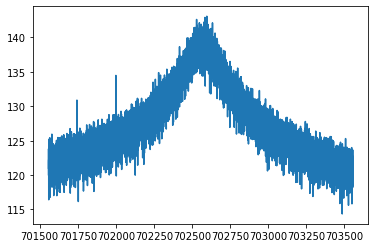

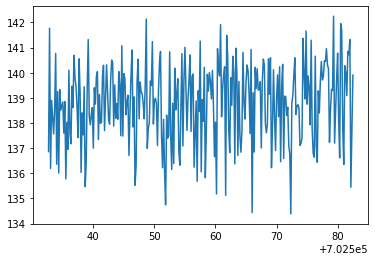

/nuz_trap2_dUvar0.006_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_26.spec


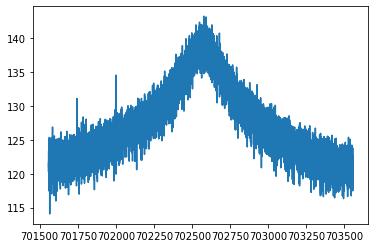

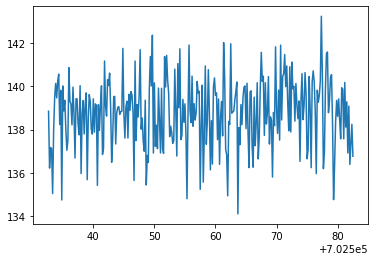

/nuz_trap2_dUvar0.006_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_27.spec


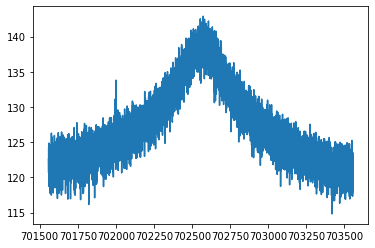

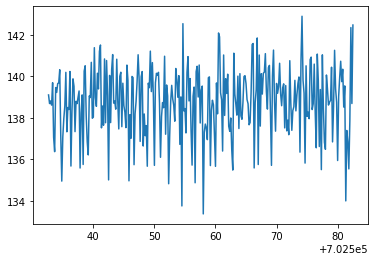

/nuz_trap2_dUvar0.006_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_28.spec


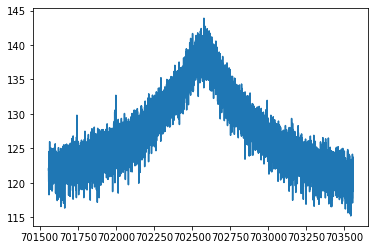

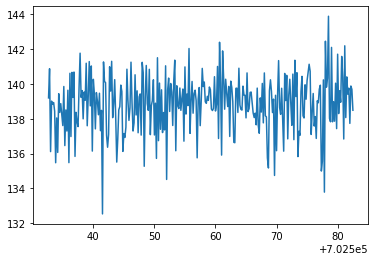

/nuz_trap2_dUvar0.006_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_29.spec


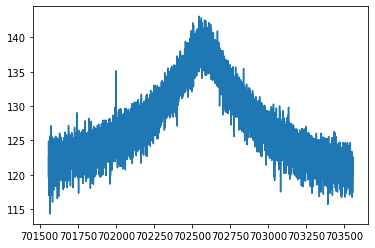

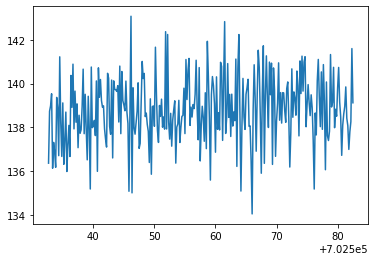

/nuz_trap2_dUvar0.006_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
419,21,20220515_120436.307595,0.006,2,702557.605861049378,0.033049586154,3.958386894821,0.287984433980,3.143982611026,702572.166972840438,6.442045700800,3493.649246731784,29.973888989559
420,22,20220515_122552.560981,0.006,2,702557.574654688709,0.032385410504,4.246281742253,0.286066141516,2.771407119299,702575.357723979512,5.910994644779,3520.467860880110,30.890907355491
421,23,20220515_130249.152609,0.006,2,702557.642992025358,0.030380979367,3.806336379834,0.257743655561,2.692782715870,702573.442501173005,6.228389649534,3396.976491464293,28.815879564893
422,24,20220515_133550.726223,0.006,2,702557.635833282256,0.032485271797,3.723273627849,0.255606205210,2.610266376293,702561.631348227500,5.786199083226,3626.881030190502,33.232979818631


/nuz_trap2_dUvar0.006_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_30.spec


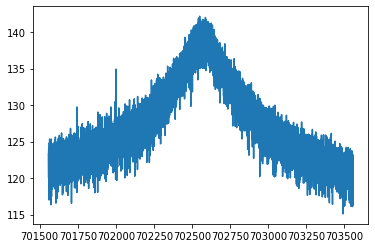

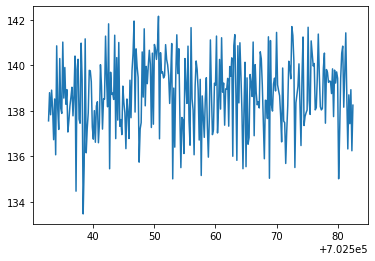

/nuz_trap2_dUvar0.006_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_31.spec


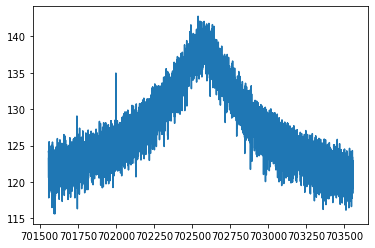

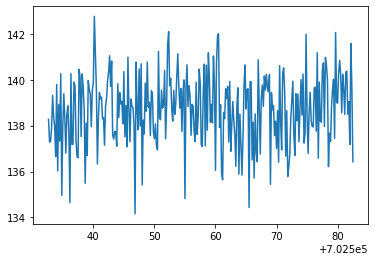

/nuz_trap2_dUvar0.006_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_32.spec


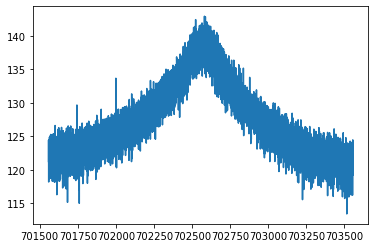

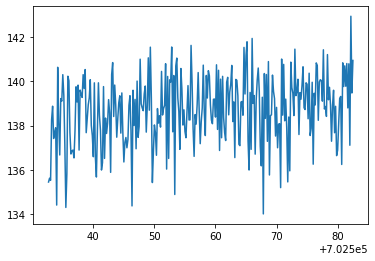

/nuz_trap2_dUvar0.006_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_33.spec


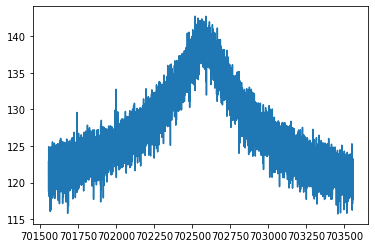

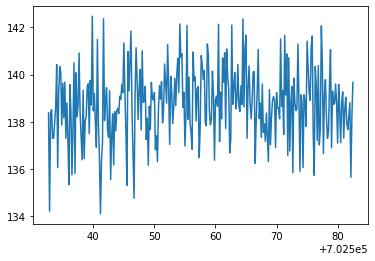

/nuz_trap2_dUvar0.006_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_34.spec


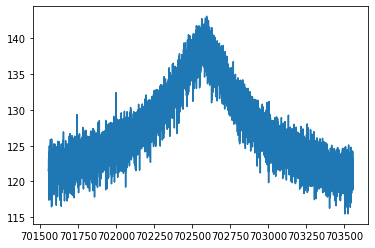

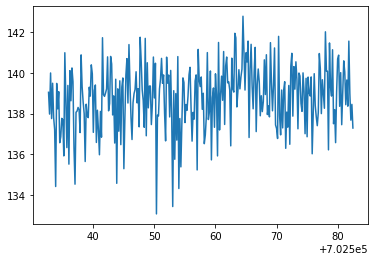

/nuz_trap2_dUvar0.006_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_35.spec


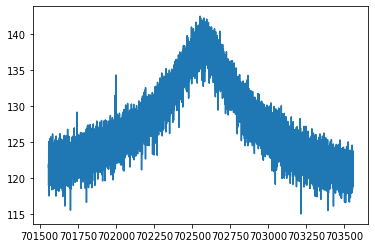

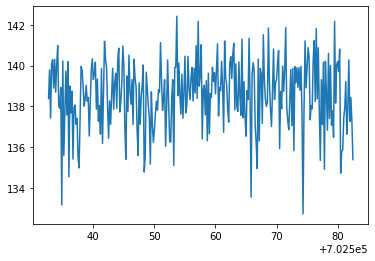

/nuz_trap2_dUvar0.006_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_36.spec


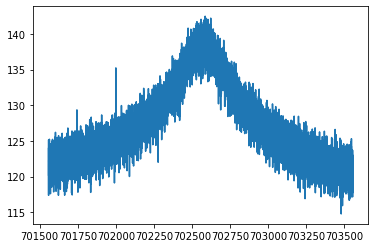

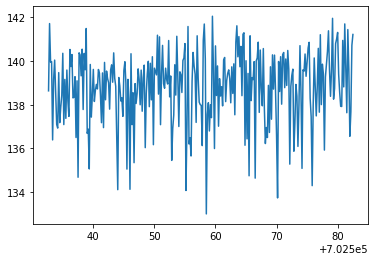

/nuz_trap2_dUvar0.006_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_37.spec


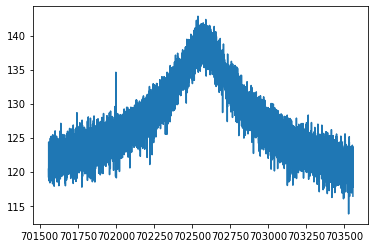

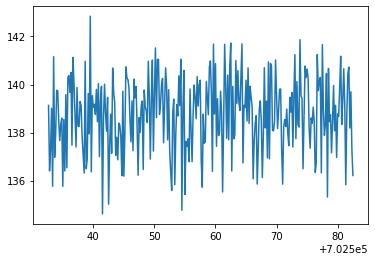

/nuz_trap2_dUvar0.006_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_38.spec


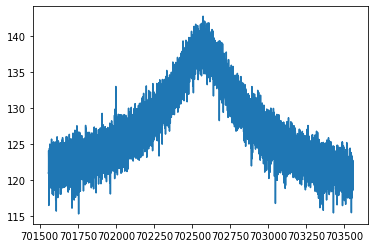

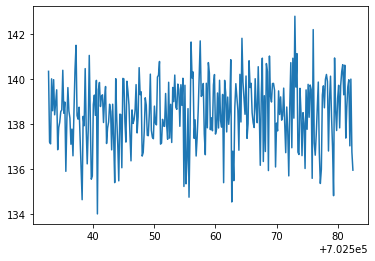

/nuz_trap2_dUvar0.006_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_39.spec


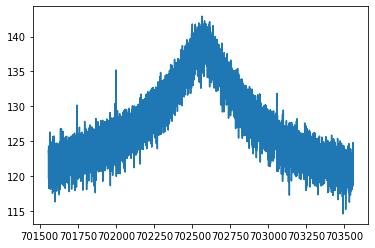

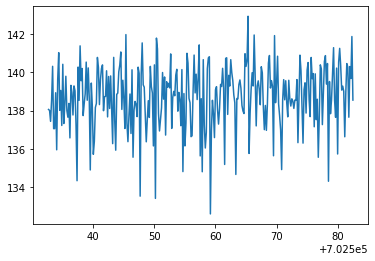

/nuz_trap2_dUvar0.006_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,22,20220515_122552.560981,0.006,2,702557.574654688709,0.032385410504,4.246281742253,0.286066141516,2.771407119299,702575.357723979512,5.910994644779,3520.467860880110,30.890907355491
421,23,20220515_130249.152609,0.006,2,702557.642992025358,0.030380979367,3.806336379834,0.257743655561,2.692782715870,702573.442501173005,6.228389649534,3396.976491464293,28.815879564893
422,24,20220515_133550.726223,0.006,2,702557.635833282256,0.032485271797,3.723273627849,0.255606205210,2.610266376293,702561.631348227500,5.786199083226,3626.881030190502,33.232979818631
423,3,20220515_023112.687022,0.006,2,702557.603228436434,0.033828633323,4.340479294718,0.307642036741,3.077000058788,702568.615362618817,6.226589152118,3424.000215465302,28.782015745044


/nuz_trap2_dUvar0.006_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_40.spec


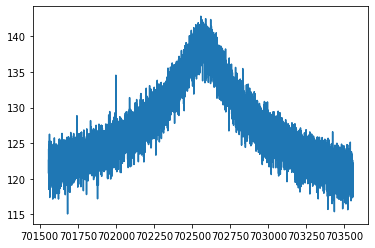

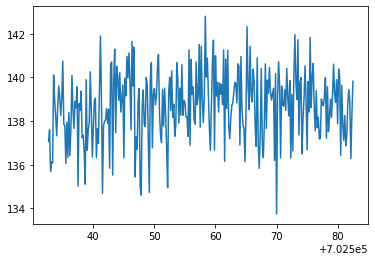

/nuz_trap2_dUvar0.006_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.006_41.spec


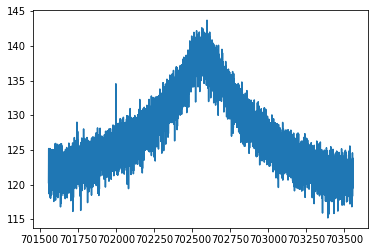

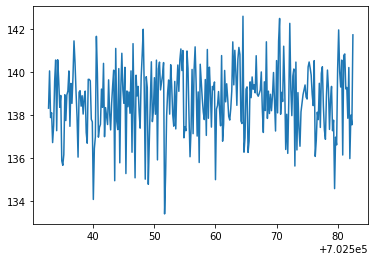

/nuz_trap2_dUvar0.006_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
421,23,20220515_130249.152609,0.006,2,702557.642992025358,0.030380979367,3.806336379834,0.257743655561,2.692782715870,702573.442501173005,6.228389649534,3396.976491464293,28.815879564893
422,24,20220515_133550.726223,0.006,2,702557.635833282256,0.032485271797,3.723273627849,0.255606205210,2.610266376293,702561.631348227500,5.786199083226,3626.881030190502,33.232979818631
423,3,20220515_023112.687022,0.006,2,702557.603228436434,0.033828633323,4.340479294718,0.307642036741,3.077000058788,702568.615362618817,6.226589152118,3424.000215465302,28.782015745044
424,4,20220515_025732.631170,0.006,2,702557.579755104380,0.029770390386,3.799734176993,0.257617372798,2.665453999795,702568.917720431229,6.061812050652,3441.697011244889,29.391112381368


/nuz_trap2_dUvar0.006_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,24,20220515_133550.726223,0.006,2,702557.635833282256,0.032485271797,3.723273627849,0.255606205210,2.610266376293,702561.631348227500,5.786199083226,3626.881030190502,33.232979818631
423,3,20220515_023112.687022,0.006,2,702557.603228436434,0.033828633323,4.340479294718,0.307642036741,3.077000058788,702568.615362618817,6.226589152118,3424.000215465302,28.782015745044
424,4,20220515_025732.631170,0.006,2,702557.579755104380,0.029770390386,3.799734176993,0.257617372798,2.665453999795,702568.917720431229,6.061812050652,3441.697011244889,29.391112381368
425,5,20220515_034101.094907,0.006,2,702557.599685420864,0.034285115569,3.863059795698,0.292628080285,3.342299749314,702570.852106019389,6.694154323541,3494.826260339869,30.034872036207


/nuz_trap2_dUvar0.006_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
423,3,20220515_023112.687022,0.006,2,702557.603228436434,0.033828633323,4.340479294718,0.307642036741,3.077000058788,702568.615362618817,6.226589152118,3424.000215465302,28.782015745044
424,4,20220515_025732.631170,0.006,2,702557.579755104380,0.029770390386,3.799734176993,0.257617372798,2.665453999795,702568.917720431229,6.061812050652,3441.697011244889,29.391112381368
425,5,20220515_034101.094907,0.006,2,702557.599685420864,0.034285115569,3.863059795698,0.292628080285,3.342299749314,702570.852106019389,6.694154323541,3494.826260339869,30.034872036207
426,6,20220515_041639.552574,0.006,2,702557.574011595920,0.030694466752,3.976682379048,0.271516311547,2.760744817931,702566.910088252276,5.973905699794,3484.345809561767,29.759575432213


/nuz_trap2_dUvar0.006_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,4,20220515_025732.631170,0.006,2,702557.579755104380,0.029770390386,3.799734176993,0.257617372798,2.665453999795,702568.917720431229,6.061812050652,3441.697011244889,29.391112381368
425,5,20220515_034101.094907,0.006,2,702557.599685420864,0.034285115569,3.863059795698,0.292628080285,3.342299749314,702570.852106019389,6.694154323541,3494.826260339869,30.034872036207
426,6,20220515_041639.552574,0.006,2,702557.574011595920,0.030694466752,3.976682379048,0.271516311547,2.760744817931,702566.910088252276,5.973905699794,3484.345809561767,29.759575432213
427,7,20220515_044940.964533,0.006,2,702557.559261409449,0.031415789145,3.985926220806,0.267518098338,2.634662182386,702566.071638099966,5.582179398419,3672.325472949093,33.717166452595


/nuz_trap2_dUvar0.006_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,5,20220515_034101.094907,0.006,2,702557.599685420864,0.034285115569,3.863059795698,0.292628080285,3.342299749314,702570.852106019389,6.694154323541,3494.826260339869,30.034872036207
426,6,20220515_041639.552574,0.006,2,702557.574011595920,0.030694466752,3.976682379048,0.271516311547,2.760744817931,702566.910088252276,5.973905699794,3484.345809561767,29.759575432213
427,7,20220515_044940.964533,0.006,2,702557.559261409449,0.031415789145,3.985926220806,0.267518098338,2.634662182386,702566.071638099966,5.582179398419,3672.325472949093,33.717166452595
428,8,20220515_045753.390557,0.006,2,702557.661061911145,0.031533405523,3.922228961482,0.268931279022,2.763088744393,702564.788809713325,6.060507562929,3454.456007000008,29.437240325377


/nuz_trap2_dUvar0.007_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
426,6,20220515_041639.552574,0.006,2,702557.574011595920,0.030694466752,3.976682379048,0.271516311547,2.760744817931,702566.910088252276,5.973905699794,3484.345809561767,29.759575432213
427,7,20220515_044940.964533,0.006,2,702557.559261409449,0.031415789145,3.985926220806,0.267518098338,2.634662182386,702566.071638099966,5.582179398419,3672.325472949093,33.717166452595
428,8,20220515_045753.390557,0.006,2,702557.661061911145,0.031533405523,3.922228961482,0.268931279022,2.763088744393,702564.788809713325,6.060507562929,3454.456007000008,29.437240325377
429,9,20220515_054753.669958,0.006,2,702557.593160715769,0.026901765644,3.776465789906,0.232839578835,2.229067524486,702577.306778342230,5.680069493052,3428.609679195622,29.381800857411


/nuz_trap2_dUvar0.007_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
427,7,20220515_044940.964533,0.006,2,702557.559261409449,0.031415789145,3.985926220806,0.267518098338,2.634662182386,702566.071638099966,5.582179398419,3672.325472949093,33.717166452595
428,8,20220515_045753.390557,0.006,2,702557.661061911145,0.031533405523,3.922228961482,0.268931279022,2.763088744393,702564.788809713325,6.060507562929,3454.456007000008,29.437240325377
429,9,20220515_054753.669958,0.006,2,702557.593160715769,0.026901765644,3.776465789906,0.232839578835,2.229067524486,702577.306778342230,5.680069493052,3428.609679195622,29.381800857411
430,1,20220515_012755.516211,0.007,2,702557.646246715682,0.034590777940,3.447889995538,0.267957003997,3.317084643052,702575.175439918647,6.714141988233,3720.207286665873,34.785245390695


/nuz_trap2_dUvar0.007_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
428,8,20220515_045753.390557,0.006,2,702557.661061911145,0.031533405523,3.922228961482,0.268931279022,2.763088744393,702564.788809713325,6.060507562929,3454.456007000008,29.437240325377
429,9,20220515_054753.669958,0.006,2,702557.593160715769,0.026901765644,3.776465789906,0.232839578835,2.229067524486,702577.306778342230,5.680069493052,3428.609679195622,29.381800857411
430,1,20220515_012755.516211,0.007,2,702557.646246715682,0.034590777940,3.447889995538,0.267957003997,3.317084643052,702575.175439918647,6.714141988233,3720.207286665873,34.785245390695
431,10,20220515_061146.499128,0.007,2,702557.643344129319,0.034537704963,3.861402428225,0.293460689212,3.371661526520,702565.121791759739,6.721197742800,3462.249057061393,30.247186840767


/nuz_trap2_dUvar0.007_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
429,9,20220515_054753.669958,0.006,2,702557.593160715769,0.026901765644,3.776465789906,0.232839578835,2.229067524486,702577.306778342230,5.680069493052,3428.609679195622,29.381800857411
430,1,20220515_012755.516211,0.007,2,702557.646246715682,0.034590777940,3.447889995538,0.267957003997,3.317084643052,702575.175439918647,6.714141988233,3720.207286665873,34.785245390695
431,10,20220515_061146.499128,0.007,2,702557.643344129319,0.034537704963,3.861402428225,0.293460689212,3.371661526520,702565.121791759739,6.721197742800,3462.249057061393,30.247186840767
432,11,20220515_064052.816365,0.007,2,702557.682954797754,0.033569340864,3.401859805568,0.270620087228,3.511239621745,702570.272580010351,7.185886642879,3504.532098848763,30.478463285186


/nuz_trap2_dUvar0.007_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
430,1,20220515_012755.516211,0.007,2,702557.646246715682,0.034590777940,3.447889995538,0.267957003997,3.317084643052,702575.175439918647,6.714141988233,3720.207286665873,34.785245390695
431,10,20220515_061146.499128,0.007,2,702557.643344129319,0.034537704963,3.861402428225,0.293460689212,3.371661526520,702565.121791759739,6.721197742800,3462.249057061393,30.247186840767
432,11,20220515_064052.816365,0.007,2,702557.682954797754,0.033569340864,3.401859805568,0.270620087228,3.511239621745,702570.272580010351,7.185886642879,3504.532098848763,30.478463285186
433,12,20220515_065932.286074,0.007,2,702557.584939062479,0.031492998531,3.515587740757,0.260621110324,3.038456090744,702564.957159938989,6.515585764375,3518.821067375718,30.633917278306


/nuz_trap2_dUvar0.007_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
431,10,20220515_061146.499128,0.007,2,702557.643344129319,0.034537704963,3.861402428225,0.293460689212,3.371661526520,702565.121791759739,6.721197742800,3462.249057061393,30.247186840767
432,11,20220515_064052.816365,0.007,2,702557.682954797754,0.033569340864,3.401859805568,0.270620087228,3.511239621745,702570.272580010351,7.185886642879,3504.532098848763,30.478463285186
433,12,20220515_065932.286074,0.007,2,702557.584939062479,0.031492998531,3.515587740757,0.260621110324,3.038456090744,702564.957159938989,6.515585764375,3518.821067375718,30.633917278306
434,13,20220515_075050.977147,0.007,2,702557.560759595479,0.029486773146,3.897481549853,0.256503379444,2.549165857573,702569.453921910841,5.691185413371,3568.043575380863,30.880187758961


/nuz_trap2_dUvar0.007_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
432,11,20220515_064052.816365,0.007,2,702557.682954797754,0.033569340864,3.401859805568,0.270620087228,3.511239621745,702570.272580010351,7.185886642879,3504.532098848763,30.478463285186
433,12,20220515_065932.286074,0.007,2,702557.584939062479,0.031492998531,3.515587740757,0.260621110324,3.038456090744,702564.957159938989,6.515585764375,3518.821067375718,30.633917278306
434,13,20220515_075050.977147,0.007,2,702557.560759595479,0.029486773146,3.897481549853,0.256503379444,2.549165857573,702569.453921910841,5.691185413371,3568.043575380863,30.880187758961
435,14,20220515_080812.092056,0.007,2,702557.616920739412,0.035699107988,3.904131188264,0.285493090216,3.044978359978,702569.594045161735,5.997810778486,3766.172030184433,34.786788033774


/nuz_trap2_dUvar0.007_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
433,12,20220515_065932.286074,0.007,2,702557.584939062479,0.031492998531,3.515587740757,0.260621110324,3.038456090744,702564.957159938989,6.515585764375,3518.821067375718,30.633917278306
434,13,20220515_075050.977147,0.007,2,702557.560759595479,0.029486773146,3.897481549853,0.256503379444,2.549165857573,702569.453921910841,5.691185413371,3568.043575380863,30.880187758961
435,14,20220515_080812.092056,0.007,2,702557.616920739412,0.035699107988,3.904131188264,0.285493090216,3.044978359978,702569.594045161735,5.997810778486,3766.172030184433,34.786788033774
436,15,20220515_085812.445159,0.007,2,702557.489299697336,0.030921782599,3.984865628901,0.250619640080,2.293748018552,702573.742004664498,5.380203738650,3631.770111776055,33.136099082491


/nuz_trap2_dUvar0.007_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,13,20220515_075050.977147,0.007,2,702557.560759595479,0.029486773146,3.897481549853,0.256503379444,2.549165857573,702569.453921910841,5.691185413371,3568.043575380863,30.880187758961
435,14,20220515_080812.092056,0.007,2,702557.616920739412,0.035699107988,3.904131188264,0.285493090216,3.044978359978,702569.594045161735,5.997810778486,3766.172030184433,34.786788033774
436,15,20220515_085812.445159,0.007,2,702557.489299697336,0.030921782599,3.984865628901,0.250619640080,2.293748018552,702573.742004664498,5.380203738650,3631.770111776055,33.136099082491
437,16,20220515_091415.167545,0.007,2,702557.584794838796,0.034904323736,4.072991392056,0.304303357237,3.330049186785,702572.679577316158,6.659562402465,3445.616099466235,29.593197579175


/nuz_trap2_dUvar0.007_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
435,14,20220515_080812.092056,0.007,2,702557.616920739412,0.035699107988,3.904131188264,0.285493090216,3.044978359978,702569.594045161735,5.997810778486,3766.172030184433,34.786788033774
436,15,20220515_085812.445159,0.007,2,702557.489299697336,0.030921782599,3.984865628901,0.250619640080,2.293748018552,702573.742004664498,5.380203738650,3631.770111776055,33.136099082491
437,16,20220515_091415.167545,0.007,2,702557.584794838796,0.034904323736,4.072991392056,0.304303357237,3.330049186785,702572.679577316158,6.659562402465,3445.616099466235,29.593197579175
438,17,20220515_100138.704866,0.007,2,702557.537936226698,0.032667992703,3.269927531635,0.261002326420,3.443397137052,702577.964929653797,7.477098143787,3446.538602312607,29.448654868012


/nuz_trap2_dUvar0.007_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
436,15,20220515_085812.445159,0.007,2,702557.489299697336,0.030921782599,3.984865628901,0.250619640080,2.293748018552,702573.742004664498,5.380203738650,3631.770111776055,33.136099082491
437,16,20220515_091415.167545,0.007,2,702557.584794838796,0.034904323736,4.072991392056,0.304303357237,3.330049186785,702572.679577316158,6.659562402465,3445.616099466235,29.593197579175
438,17,20220515_100138.704866,0.007,2,702557.537936226698,0.032667992703,3.269927531635,0.261002326420,3.443397137052,702577.964929653797,7.477098143787,3446.538602312607,29.448654868012
439,18,20220515_102018.168484,0.007,2,702557.586930665304,0.033025633058,3.642312791049,0.275954684208,3.261146115027,702573.562142087263,6.680895886231,3567.919968938305,31.353647800142


/nuz_trap2_dUvar0.007_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
437,16,20220515_091415.167545,0.007,2,702557.584794838796,0.034904323736,4.072991392056,0.304303357237,3.330049186785,702572.679577316158,6.659562402465,3445.616099466235,29.593197579175
438,17,20220515_100138.704866,0.007,2,702557.537936226698,0.032667992703,3.269927531635,0.261002326420,3.443397137052,702577.964929653797,7.477098143787,3446.538602312607,29.448654868012
439,18,20220515_102018.168484,0.007,2,702557.586930665304,0.033025633058,3.642312791049,0.275954684208,3.261146115027,702573.562142087263,6.680895886231,3567.919968938305,31.353647800142
440,19,20220515_104924.609989,0.007,2,702557.581159808091,0.028947574813,3.950793940510,0.253990972450,2.470761784425,702575.775723578292,5.721253979090,3521.245371341548,30.346124409260


/nuz_trap2_dUvar0.007_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
438,17,20220515_100138.704866,0.007,2,702557.537936226698,0.032667992703,3.269927531635,0.261002326420,3.443397137052,702577.964929653797,7.477098143787,3446.538602312607,29.448654868012
439,18,20220515_102018.168484,0.007,2,702557.586930665304,0.033025633058,3.642312791049,0.275954684208,3.261146115027,702573.562142087263,6.680895886231,3567.919968938305,31.353647800142
440,19,20220515_104924.609989,0.007,2,702557.581159808091,0.028947574813,3.950793940510,0.253990972450,2.470761784425,702575.775723578292,5.721253979090,3521.245371341548,30.346124409260
441,2,20220515_021117.753738,0.007,2,702557.624017408467,0.034468796658,3.801308731599,0.295099122045,3.489351585739,702563.407518981141,6.979338845448,3395.292641338159,28.795506579808


/nuz_trap2_dUvar0.007_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
439,18,20220515_102018.168484,0.007,2,702557.586930665304,0.033025633058,3.642312791049,0.275954684208,3.261146115027,702573.562142087263,6.680895886231,3567.919968938305,31.353647800142
440,19,20220515_104924.609989,0.007,2,702557.581159808091,0.028947574813,3.950793940510,0.253990972450,2.470761784425,702575.775723578292,5.721253979090,3521.245371341548,30.346124409260
441,2,20220515_021117.753738,0.007,2,702557.624017408467,0.034468796658,3.801308731599,0.295099122045,3.489351585739,702563.407518981141,6.979338845448,3395.292641338159,28.795506579808
442,20,20220515_113253.112358,0.007,2,702557.545701837866,0.031251788119,4.181919673421,0.267785512151,2.475743966397,702574.997016627807,5.409754441225,3685.004299943478,33.887724515119


/nuz_trap2_dUvar0.007_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
440,19,20220515_104924.609989,0.007,2,702557.581159808091,0.028947574813,3.950793940510,0.253990972450,2.470761784425,702575.775723578292,5.721253979090,3521.245371341548,30.346124409260
441,2,20220515_021117.753738,0.007,2,702557.624017408467,0.034468796658,3.801308731599,0.295099122045,3.489351585739,702563.407518981141,6.979338845448,3395.292641338159,28.795506579808
442,20,20220515_113253.112358,0.007,2,702557.545701837866,0.031251788119,4.181919673421,0.267785512151,2.475743966397,702574.997016627807,5.409754441225,3685.004299943478,33.887724515119
443,21,20220515_120317.906522,0.007,2,702557.641073754756,0.036409665064,4.088196922948,0.317323152306,3.605395132771,702565.873991130269,6.679328678377,3534.904084979464,30.641482793888


/nuz_trap2_dUvar0.007_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
441,2,20220515_021117.753738,0.007,2,702557.624017408467,0.034468796658,3.801308731599,0.295099122045,3.489351585739,702563.407518981141,6.979338845448,3395.292641338159,28.795506579808
442,20,20220515_113253.112358,0.007,2,702557.545701837866,0.031251788119,4.181919673421,0.267785512151,2.475743966397,702574.997016627807,5.409754441225,3685.004299943478,33.887724515119
443,21,20220515_120317.906522,0.007,2,702557.641073754756,0.036409665064,4.088196922948,0.317323152306,3.605395132771,702565.873991130269,6.679328678377,3534.904084979464,30.641482793888
444,22,20220515_121525.563739,0.007,2,702557.527587548946,0.029604351441,4.368515309106,0.271113879597,2.384141494943,702570.335389309097,5.512807931290,3401.176788118280,29.025378134103


/nuz_trap2_dUvar0.007_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
442,20,20220515_113253.112358,0.007,2,702557.545701837866,0.031251788119,4.181919673421,0.267785512151,2.475743966397,702574.997016627807,5.409754441225,3685.004299943478,33.887724515119
443,21,20220515_120317.906522,0.007,2,702557.641073754756,0.036409665064,4.088196922948,0.317323152306,3.605395132771,702565.873991130269,6.679328678377,3534.904084979464,30.641482793888
444,22,20220515_121525.563739,0.007,2,702557.527587548946,0.029604351441,4.368515309106,0.271113879597,2.384141494943,702570.335389309097,5.512807931290,3401.176788118280,29.025378134103
445,23,20220515_131434.523713,0.007,2,702557.599049982615,0.034963113508,4.797136909841,0.321680466856,2.823416241414,702569.652234548354,5.422923852056,3684.283720240731,33.705666190732


/nuz_trap2_dUvar0.007_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_25.spec


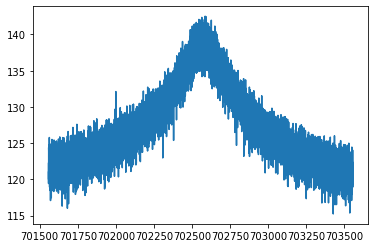

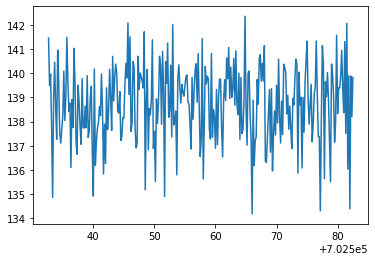

/nuz_trap2_dUvar0.007_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_26.spec


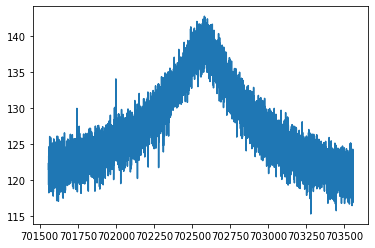

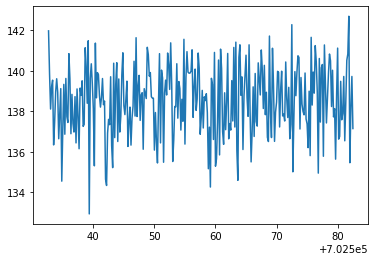

/nuz_trap2_dUvar0.007_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_27.spec


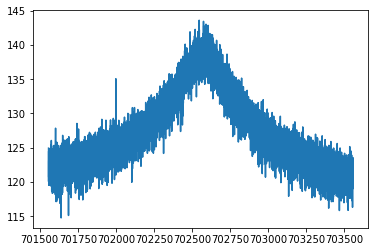

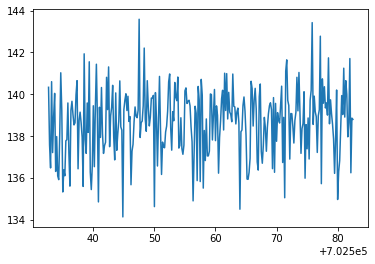

/nuz_trap2_dUvar0.007_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_28.spec


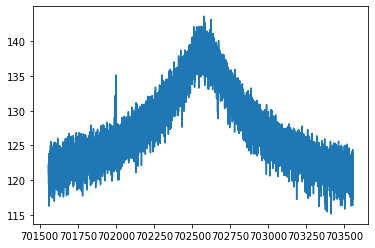

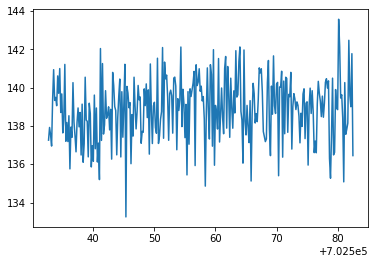

/nuz_trap2_dUvar0.007_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_29.spec


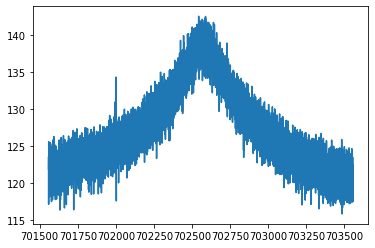

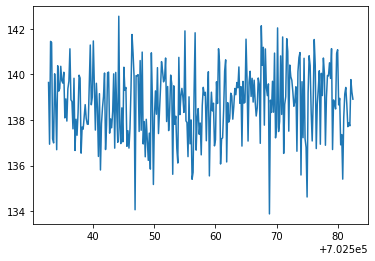

/nuz_trap2_dUvar0.007_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
443,21,20220515_120317.906522,0.007,2,702557.641073754756,0.036409665064,4.088196922948,0.317323152306,3.605395132771,702565.873991130269,6.679328678377,3534.904084979464,30.641482793888
444,22,20220515_121525.563739,0.007,2,702557.527587548946,0.029604351441,4.368515309106,0.271113879597,2.384141494943,702570.335389309097,5.512807931290,3401.176788118280,29.025378134103
445,23,20220515_131434.523713,0.007,2,702557.599049982615,0.034963113508,4.797136909841,0.321680466856,2.823416241414,702569.652234548354,5.422923852056,3684.283720240731,33.705666190732
446,24,20220515_132010.214039,0.007,2,702557.629846397322,0.032583102374,4.016095333073,0.281043984517,2.955069972975,702576.842233590549,6.220167564620,3543.397170692894,30.357128716471


/nuz_trap2_dUvar0.007_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_30.spec


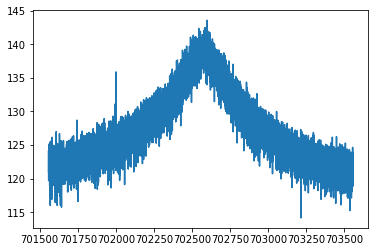

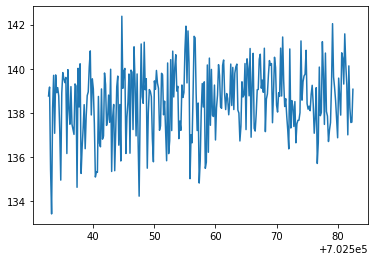

/nuz_trap2_dUvar0.007_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_31.spec


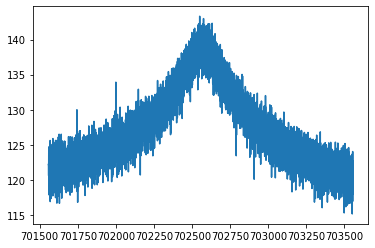

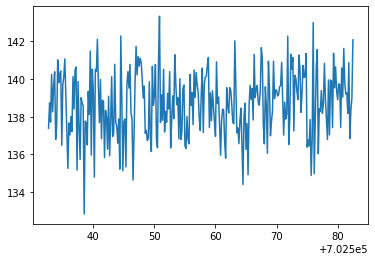

/nuz_trap2_dUvar0.007_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_32.spec


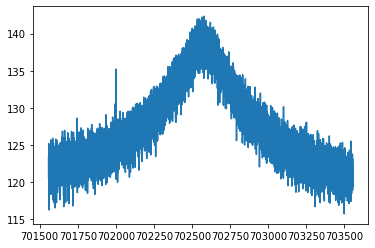

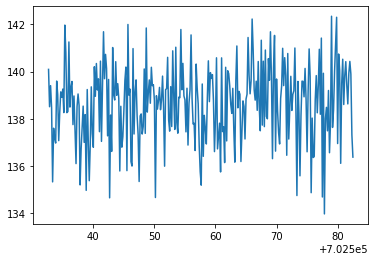

/nuz_trap2_dUvar0.007_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_33.spec


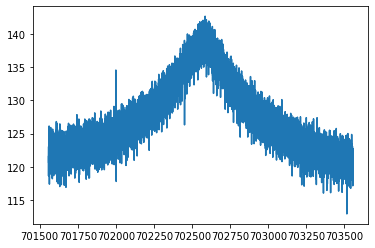

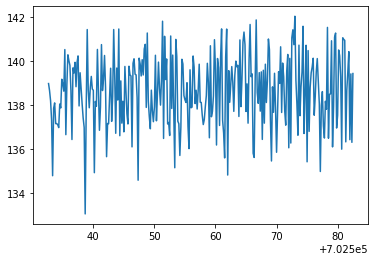

/nuz_trap2_dUvar0.007_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_34.spec


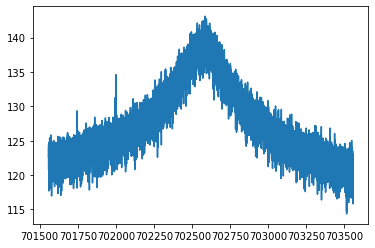

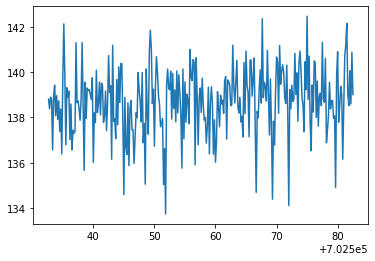

/nuz_trap2_dUvar0.007_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_35.spec


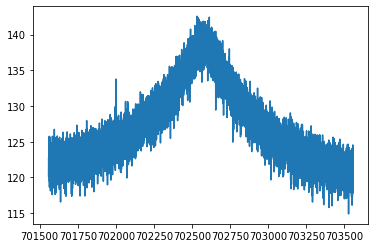

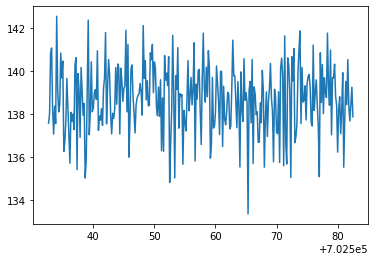

/nuz_trap2_dUvar0.007_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_36.spec


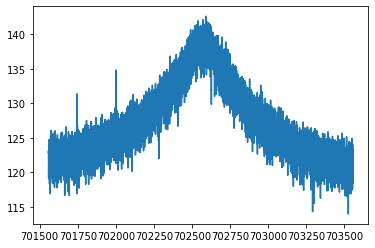

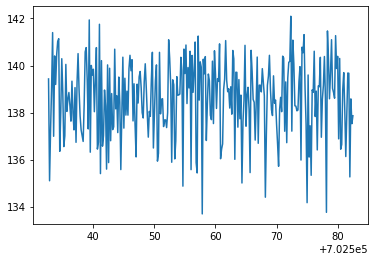

/nuz_trap2_dUvar0.007_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_37.spec


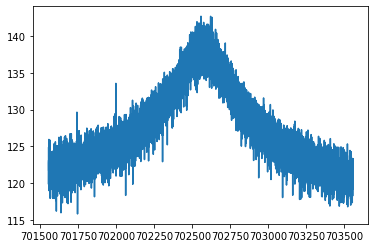

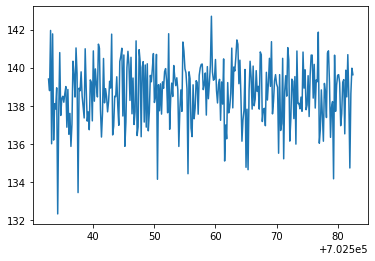

/nuz_trap2_dUvar0.007_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_38.spec


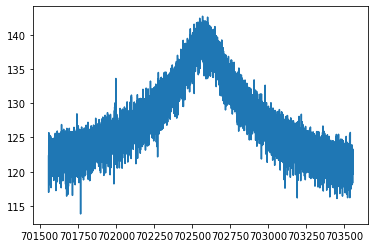

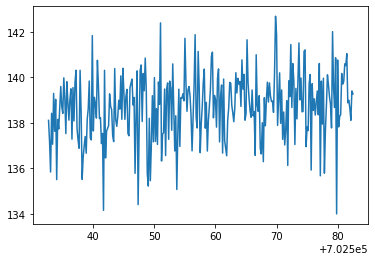

/nuz_trap2_dUvar0.007_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_39.spec


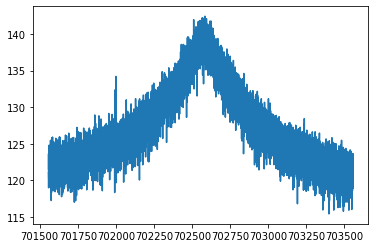

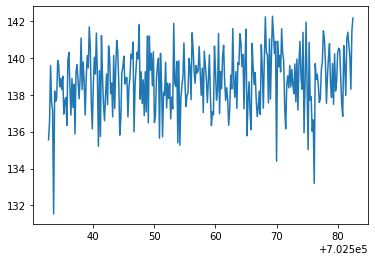

/nuz_trap2_dUvar0.007_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
444,22,20220515_121525.563739,0.007,2,702557.527587548946,0.029604351441,4.368515309106,0.271113879597,2.384141494943,702570.335389309097,5.512807931290,3401.176788118280,29.025378134103
445,23,20220515_131434.523713,0.007,2,702557.599049982615,0.034963113508,4.797136909841,0.321680466856,2.823416241414,702569.652234548354,5.422923852056,3684.283720240731,33.705666190732
446,24,20220515_132010.214039,0.007,2,702557.629846397322,0.032583102374,4.016095333073,0.281043984517,2.955069972975,702576.842233590549,6.220167564620,3543.397170692894,30.357128716471
447,3,20220515_022205.419963,0.007,2,702557.575836874312,0.030120457059,3.907367602970,0.257015728034,2.524824414860,702570.092375721200,5.676907124036,3571.537798936282,31.130644286650


/nuz_trap2_dUvar0.007_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.007_40.spec


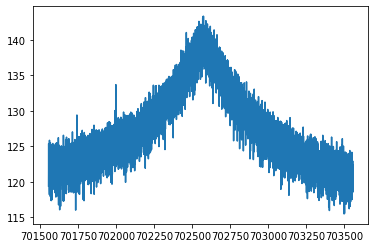

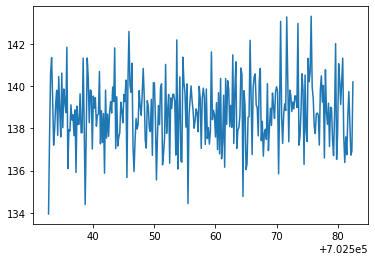

/nuz_trap2_dUvar0.007_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,23,20220515_131434.523713,0.007,2,702557.599049982615,0.034963113508,4.797136909841,0.321680466856,2.823416241414,702569.652234548354,5.422923852056,3684.283720240731,33.705666190732
446,24,20220515_132010.214039,0.007,2,702557.629846397322,0.032583102374,4.016095333073,0.281043984517,2.955069972975,702576.842233590549,6.220167564620,3543.397170692894,30.357128716471
447,3,20220515_022205.419963,0.007,2,702557.575836874312,0.030120457059,3.907367602970,0.257015728034,2.524824414860,702570.092375721200,5.676907124036,3571.537798936282,31.130644286650
448,4,20220515_030404.462508,0.007,2,702557.503512722091,0.033232672698,3.915355093533,0.284608386719,3.150016209951,702575.970691935858,6.663792274231,3421.884504153980,29.019531149187


/nuz_trap2_dUvar0.007_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
446,24,20220515_132010.214039,0.007,2,702557.629846397322,0.032583102374,4.016095333073,0.281043984517,2.955069972975,702576.842233590549,6.220167564620,3543.397170692894,30.357128716471
447,3,20220515_022205.419963,0.007,2,702557.575836874312,0.030120457059,3.907367602970,0.257015728034,2.524824414860,702570.092375721200,5.676907124036,3571.537798936282,31.130644286650
448,4,20220515_030404.462508,0.007,2,702557.503512722091,0.033232672698,3.915355093533,0.284608386719,3.150016209951,702575.970691935858,6.663792274231,3421.884504153980,29.019531149187
449,5,20220515_033547.596208,0.007,2,702557.578084118664,0.030513265414,4.237942932250,0.264350477756,2.357903094788,702575.153950490290,5.364123511135,3597.828894663556,32.275623048256


/nuz_trap2_dUvar0.007_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,3,20220515_022205.419963,0.007,2,702557.575836874312,0.030120457059,3.907367602970,0.257015728034,2.524824414860,702570.092375721200,5.676907124036,3571.537798936282,31.130644286650
448,4,20220515_030404.462508,0.007,2,702557.503512722091,0.033232672698,3.915355093533,0.284608386719,3.150016209951,702575.970691935858,6.663792274231,3421.884504153980,29.019531149187
449,5,20220515_033547.596208,0.007,2,702557.578084118664,0.030513265414,4.237942932250,0.264350477756,2.357903094788,702575.153950490290,5.364123511135,3597.828894663556,32.275623048256
450,6,20220515_035545.383654,0.007,2,702557.526128225494,0.035420708737,4.249374292308,0.302720142107,3.033193487687,702569.258661356522,5.970979133099,3622.363322057208,32.571295584816


/nuz_trap2_dUvar0.007_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
448,4,20220515_030404.462508,0.007,2,702557.503512722091,0.033232672698,3.915355093533,0.284608386719,3.150016209951,702575.970691935858,6.663792274231,3421.884504153980,29.019531149187
449,5,20220515_033547.596208,0.007,2,702557.578084118664,0.030513265414,4.237942932250,0.264350477756,2.357903094788,702575.153950490290,5.364123511135,3597.828894663556,32.275623048256
450,6,20220515_035545.383654,0.007,2,702557.526128225494,0.035420708737,4.249374292308,0.302720142107,3.033193487687,702569.258661356522,5.970979133099,3622.363322057208,32.571295584816
451,7,20220515_042056.855740,0.007,2,702557.461109124124,0.030923798966,3.848810855902,0.254359619069,2.528818417391,702575.334010318620,5.710938379692,3641.672730411884,33.496655579992


/nuz_trap2_dUvar0.007_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
449,5,20220515_033547.596208,0.007,2,702557.578084118664,0.030513265414,4.237942932250,0.264350477756,2.357903094788,702575.153950490290,5.364123511135,3597.828894663556,32.275623048256
450,6,20220515_035545.383654,0.007,2,702557.526128225494,0.035420708737,4.249374292308,0.302720142107,3.033193487687,702569.258661356522,5.970979133099,3622.363322057208,32.571295584816
451,7,20220515_042056.855740,0.007,2,702557.461109124124,0.030923798966,3.848810855902,0.254359619069,2.528818417391,702575.334010318620,5.710938379692,3641.672730411884,33.496655579992
452,8,20220515_051610.630131,0.007,2,702557.611916418420,0.029655041702,3.531675094301,0.239632017844,2.560621318661,702573.145988744451,5.959160627429,3597.566031455692,32.253412003025


/nuz_trap2_dUvar0.008_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
450,6,20220515_035545.383654,0.007,2,702557.526128225494,0.035420708737,4.249374292308,0.302720142107,3.033193487687,702569.258661356522,5.970979133099,3622.363322057208,32.571295584816
451,7,20220515_042056.855740,0.007,2,702557.461109124124,0.030923798966,3.848810855902,0.254359619069,2.528818417391,702575.334010318620,5.710938379692,3641.672730411884,33.496655579992
452,8,20220515_051610.630131,0.007,2,702557.611916418420,0.029655041702,3.531675094301,0.239632017844,2.560621318661,702573.145988744451,5.959160627429,3597.566031455692,32.253412003025
453,9,20220515_053608.344534,0.007,2,702557.601224091835,0.030384562499,3.558751572902,0.245334560815,2.646778765988,702573.805178361596,5.972132195003,3654.017240027166,33.373599952313


/nuz_trap2_dUvar0.008_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
451,7,20220515_042056.855740,0.007,2,702557.461109124124,0.030923798966,3.848810855902,0.254359619069,2.528818417391,702575.334010318620,5.710938379692,3641.672730411884,33.496655579992
452,8,20220515_051610.630131,0.007,2,702557.611916418420,0.029655041702,3.531675094301,0.239632017844,2.560621318661,702573.145988744451,5.959160627429,3597.566031455692,32.253412003025
453,9,20220515_053608.344534,0.007,2,702557.601224091835,0.030384562499,3.558751572902,0.245334560815,2.646778765988,702573.805178361596,5.972132195003,3654.017240027166,33.373599952313
454,1,20220515_011217.054573,0.008,2,702557.624207512708,0.032168700040,4.114318890150,0.282068521541,2.879919831767,702578.726065832074,6.174116677337,3504.699375195069,30.150652191451


/nuz_trap2_dUvar0.008_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
452,8,20220515_051610.630131,0.007,2,702557.611916418420,0.029655041702,3.531675094301,0.239632017844,2.560621318661,702573.145988744451,5.959160627429,3597.566031455692,32.253412003025
453,9,20220515_053608.344534,0.007,2,702557.601224091835,0.030384562499,3.558751572902,0.245334560815,2.646778765988,702573.805178361596,5.972132195003,3654.017240027166,33.373599952313
454,1,20220515_011217.054573,0.008,2,702557.624207512708,0.032168700040,4.114318890150,0.282068521541,2.879919831767,702578.726065832074,6.174116677337,3504.699375195069,30.150652191451
455,10,20220515_061423.227911,0.008,2,702557.610935367062,0.030672478758,4.534401627220,0.286705607580,2.552775025857,702577.735848697368,5.676659994053,3434.920504751226,29.609150513989


/nuz_trap2_dUvar0.008_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
453,9,20220515_053608.344534,0.007,2,702557.601224091835,0.030384562499,3.558751572902,0.245334560815,2.646778765988,702573.805178361596,5.972132195003,3654.017240027166,33.373599952313
454,1,20220515_011217.054573,0.008,2,702557.624207512708,0.032168700040,4.114318890150,0.282068521541,2.879919831767,702578.726065832074,6.174116677337,3504.699375195069,30.150652191451
455,10,20220515_061423.227911,0.008,2,702557.610935367062,0.030672478758,4.534401627220,0.286705607580,2.552775025857,702577.735848697368,5.676659994053,3434.920504751226,29.609150513989
456,11,20220515_063816.091057,0.008,2,702557.560070442618,0.030296386694,4.497952303930,0.277081368098,2.409031384662,702579.762529814732,5.498491964029,3492.482413538833,29.939899593326


/nuz_trap2_dUvar0.008_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
454,1,20220515_011217.054573,0.008,2,702557.624207512708,0.032168700040,4.114318890150,0.282068521541,2.879919831767,702578.726065832074,6.174116677337,3504.699375195069,30.150652191451
455,10,20220515_061423.227911,0.008,2,702557.610935367062,0.030672478758,4.534401627220,0.286705607580,2.552775025857,702577.735848697368,5.676659994053,3434.920504751226,29.609150513989
456,11,20220515_063816.091057,0.008,2,702557.560070442618,0.030296386694,4.497952303930,0.277081368098,2.409031384662,702579.762529814732,5.498491964029,3492.482413538833,29.939899593326
457,12,20220515_072026.223668,0.008,2,702557.596348866122,0.033487398909,3.847280386152,0.271435557201,2.858026853494,702574.959310134756,5.978231738584,3713.470892615557,34.719618616605


/nuz_trap2_dUvar0.008_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
455,10,20220515_061423.227911,0.008,2,702557.610935367062,0.030672478758,4.534401627220,0.286705607580,2.552775025857,702577.735848697368,5.676659994053,3434.920504751226,29.609150513989
456,11,20220515_063816.091057,0.008,2,702557.560070442618,0.030296386694,4.497952303930,0.277081368098,2.409031384662,702579.762529814732,5.498491964029,3492.482413538833,29.939899593326
457,12,20220515_072026.223668,0.008,2,702557.596348866122,0.033487398909,3.847280386152,0.271435557201,2.858026853494,702574.959310134756,5.978231738584,3713.470892615557,34.719618616605
458,13,20220515_075209.359549,0.008,2,702557.617273297743,0.034982018631,3.462886066965,0.288278604897,3.888241766924,702578.108794402797,7.654387655382,3500.288213900536,30.253118302533


/nuz_trap2_dUvar0.008_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
456,11,20220515_063816.091057,0.008,2,702557.560070442618,0.030296386694,4.497952303930,0.277081368098,2.409031384662,702579.762529814732,5.498491964029,3492.482413538833,29.939899593326
457,12,20220515_072026.223668,0.008,2,702557.596348866122,0.033487398909,3.847280386152,0.271435557201,2.858026853494,702574.959310134756,5.978231738584,3713.470892615557,34.719618616605
458,13,20220515_075209.359549,0.008,2,702557.617273297743,0.034982018631,3.462886066965,0.288278604897,3.888241766924,702578.108794402797,7.654387655382,3500.288213900536,30.253118302533
459,14,20220515_083024.408173,0.008,2,702557.588515112409,0.030078139008,3.670834128721,0.257408093069,2.814419307453,702572.400955483085,6.488215867703,3361.691417761019,28.433387705757


/nuz_trap2_dUvar0.008_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
457,12,20220515_072026.223668,0.008,2,702557.596348866122,0.033487398909,3.847280386152,0.271435557201,2.858026853494,702574.959310134756,5.978231738584,3713.470892615557,34.719618616605
458,13,20220515_075209.359549,0.008,2,702557.617273297743,0.034982018631,3.462886066965,0.288278604897,3.888241766924,702578.108794402797,7.654387655382,3500.288213900536,30.253118302533
459,14,20220515_083024.408173,0.008,2,702557.588515112409,0.030078139008,3.670834128721,0.257408093069,2.814419307453,702572.400955483085,6.488215867703,3361.691417761019,28.433387705757
460,15,20220515_090325.989372,0.008,2,702557.613329463871,0.032070183302,3.826935157562,0.267450487651,2.844360125282,702576.011865223642,6.174808360769,3569.711372051944,31.702985180985


/nuz_trap2_dUvar0.008_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
458,13,20220515_075209.359549,0.008,2,702557.617273297743,0.034982018631,3.462886066965,0.288278604897,3.888241766924,702578.108794402797,7.654387655382,3500.288213900536,30.253118302533
459,14,20220515_083024.408173,0.008,2,702557.588515112409,0.030078139008,3.670834128721,0.257408093069,2.814419307453,702572.400955483085,6.488215867703,3361.691417761019,28.433387705757
460,15,20220515_090325.989372,0.008,2,702557.613329463871,0.032070183302,3.826935157562,0.267450487651,2.844360125282,702576.011865223642,6.174808360769,3569.711372051944,31.702985180985
461,16,20220515_091256.788740,0.008,2,702557.481571450247,0.029583241313,3.304783293160,0.237986981219,2.859851900606,702576.909668365610,6.651432092893,3508.757407773036,30.314434554334


/nuz_trap2_dUvar0.008_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
459,14,20220515_083024.408173,0.008,2,702557.588515112409,0.030078139008,3.670834128721,0.257408093069,2.814419307453,702572.400955483085,6.488215867703,3361.691417761019,28.433387705757
460,15,20220515_090325.989372,0.008,2,702557.613329463871,0.032070183302,3.826935157562,0.267450487651,2.844360125282,702576.011865223642,6.174808360769,3569.711372051944,31.702985180985
461,16,20220515_091256.788740,0.008,2,702557.481571450247,0.029583241313,3.304783293160,0.237986981219,2.859851900606,702576.909668365610,6.651432092893,3508.757407773036,30.314434554334
462,17,20220515_095625.232625,0.008,2,702557.590681431349,0.029671865575,3.807552553878,0.250272490806,2.490707291288,702572.068335595890,5.898281925373,3450.419777645381,30.037785852113


/nuz_trap2_dUvar0.008_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
460,15,20220515_090325.989372,0.008,2,702557.613329463871,0.032070183302,3.826935157562,0.267450487651,2.844360125282,702576.011865223642,6.174808360769,3569.711372051944,31.702985180985
461,16,20220515_091256.788740,0.008,2,702557.481571450247,0.029583241313,3.304783293160,0.237986981219,2.859851900606,702576.909668365610,6.651432092893,3508.757407773036,30.314434554334
462,17,20220515_095625.232625,0.008,2,702557.590681431349,0.029671865575,3.807552553878,0.250272490806,2.490707291288,702572.068335595890,5.898281925373,3450.419777645381,30.037785852113
463,18,20220515_102926.778380,0.008,2,702557.663669853238,0.032170060827,3.775197623025,0.271372627279,3.022386394914,702571.078772675712,6.542722659067,3422.940343272246,29.134252503060


/nuz_trap2_dUvar0.008_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
461,16,20220515_091256.788740,0.008,2,702557.481571450247,0.029583241313,3.304783293160,0.237986981219,2.859851900606,702576.909668365610,6.651432092893,3508.757407773036,30.314434554334
462,17,20220515_095625.232625,0.008,2,702557.590681431349,0.029671865575,3.807552553878,0.250272490806,2.490707291288,702572.068335595890,5.898281925373,3450.419777645381,30.037785852113
463,18,20220515_102926.778380,0.008,2,702557.663669853238,0.032170060827,3.775197623025,0.271372627279,3.022386394914,702571.078772675712,6.542722659067,3422.940343272246,29.134252503060
464,19,20220515_104806.218108,0.008,2,702557.660461447784,0.029870054094,3.490044629398,0.239459127324,2.636973586500,702572.294557750341,6.162102265743,3530.899670391078,30.461342003930


/nuz_trap2_dUvar0.008_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
462,17,20220515_095625.232625,0.008,2,702557.590681431349,0.029671865575,3.807552553878,0.250272490806,2.490707291288,702572.068335595890,5.898281925373,3450.419777645381,30.037785852113
463,18,20220515_102926.778380,0.008,2,702557.663669853238,0.032170060827,3.775197623025,0.271372627279,3.022386394914,702571.078772675712,6.542722659067,3422.940343272246,29.134252503060
464,19,20220515_104806.218108,0.008,2,702557.660461447784,0.029870054094,3.490044629398,0.239459127324,2.636973586500,702572.294557750341,6.162102265743,3530.899670391078,30.461342003930
465,2,20220515_015934.152770,0.008,2,702557.649391199811,0.032075215661,3.918230316100,0.270446320931,2.852494768872,702580.333256662358,6.397633116367,3446.186137350665,29.870424515958


/nuz_trap2_dUvar0.008_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
463,18,20220515_102926.778380,0.008,2,702557.663669853238,0.032170060827,3.775197623025,0.271372627279,3.022386394914,702571.078772675712,6.542722659067,3422.940343272246,29.134252503060
464,19,20220515_104806.218108,0.008,2,702557.660461447784,0.029870054094,3.490044629398,0.239459127324,2.636973586500,702572.294557750341,6.162102265743,3530.899670391078,30.461342003930
465,2,20220515_015934.152770,0.008,2,702557.649391199811,0.032075215661,3.918230316100,0.270446320931,2.852494768872,702580.333256662358,6.397633116367,3446.186137350665,29.870424515958
466,20,20220515_112621.272928,0.008,2,702557.677279404947,0.031319411614,3.546611063518,0.256380568565,2.950074369385,702569.356013332494,6.703391922047,3368.649897109025,28.418985689775


/nuz_trap2_dUvar0.008_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
464,19,20220515_104806.218108,0.008,2,702557.660461447784,0.029870054094,3.490044629398,0.239459127324,2.636973586500,702572.294557750341,6.162102265743,3530.899670391078,30.461342003930
465,2,20220515_015934.152770,0.008,2,702557.649391199811,0.032075215661,3.918230316100,0.270446320931,2.852494768872,702580.333256662358,6.397633116367,3446.186137350665,29.870424515958
466,20,20220515_112621.272928,0.008,2,702557.677279404947,0.031319411614,3.546611063518,0.256380568565,2.950074369385,702569.356013332494,6.703391922047,3368.649897109025,28.418985689775
467,21,20220515_114619.062643,0.008,2,702557.600443008123,0.033817082247,3.971498198711,0.298537360346,3.418683477672,702579.757612957503,6.935557382608,3437.779231050310,29.278783226537


/nuz_trap2_dUvar0.008_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
465,2,20220515_015934.152770,0.008,2,702557.649391199811,0.032075215661,3.918230316100,0.270446320931,2.852494768872,702580.333256662358,6.397633116367,3446.186137350665,29.870424515958
466,20,20220515_112621.272928,0.008,2,702557.677279404947,0.031319411614,3.546611063518,0.256380568565,2.950074369385,702569.356013332494,6.703391922047,3368.649897109025,28.418985689775
467,21,20220515_114619.062643,0.008,2,702557.600443008123,0.033817082247,3.971498198711,0.298537360346,3.418683477672,702579.757612957503,6.935557382608,3437.779231050310,29.278783226537
468,22,20220515_123737.876126,0.008,2,702557.595692865085,0.029298662984,3.713368466977,0.255257723133,2.729925838982,702568.417887322488,6.205944303669,3420.241540177698,29.195561052000


/nuz_trap2_dUvar0.008_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_24.spec


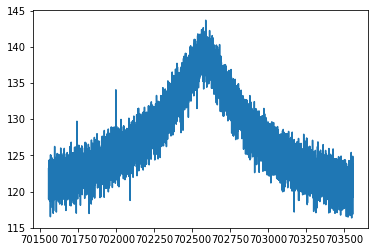

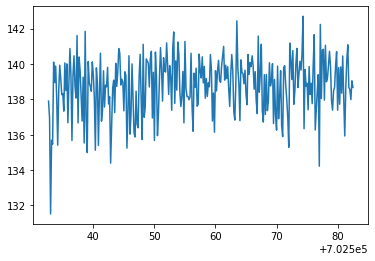

/nuz_trap2_dUvar0.008_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_25.spec


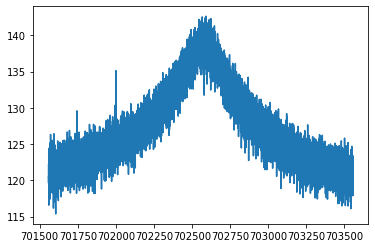

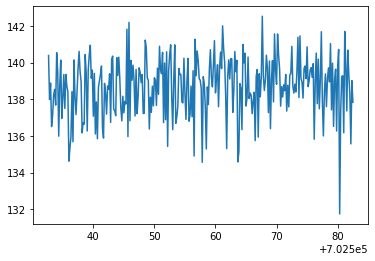

/nuz_trap2_dUvar0.008_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_26.spec


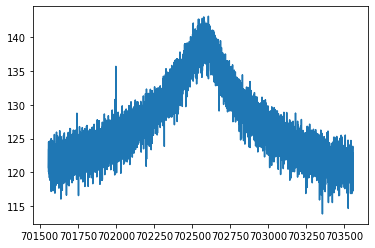

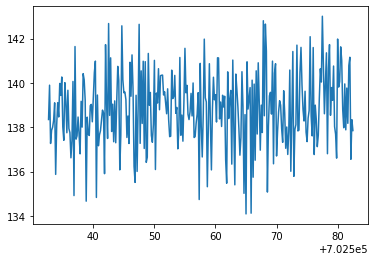

/nuz_trap2_dUvar0.008_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_27.spec


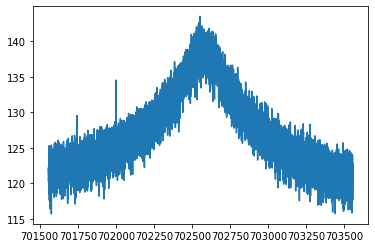

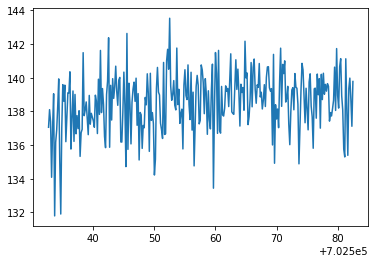

/nuz_trap2_dUvar0.008_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_28.spec


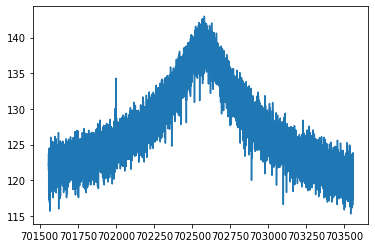

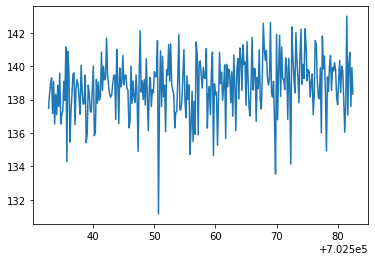

/nuz_trap2_dUvar0.008_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_29.spec


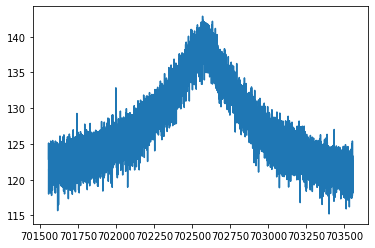

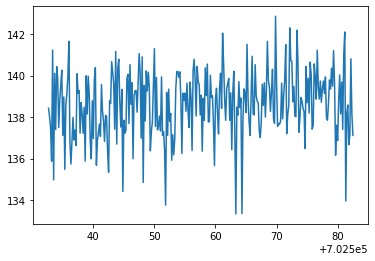

/nuz_trap2_dUvar0.008_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
466,20,20220515_112621.272928,0.008,2,702557.677279404947,0.031319411614,3.546611063518,0.256380568565,2.950074369385,702569.356013332494,6.703391922047,3368.649897109025,28.418985689775
467,21,20220515_114619.062643,0.008,2,702557.600443008123,0.033817082247,3.971498198711,0.298537360346,3.418683477672,702579.757612957503,6.935557382608,3437.779231050310,29.278783226537
468,22,20220515_123737.876126,0.008,2,702557.595692865085,0.029298662984,3.713368466977,0.255257723133,2.729925838982,702568.417887322488,6.205944303669,3420.241540177698,29.195561052000
469,23,20220515_125103.819953,0.008,2,702557.592598671326,0.031942078239,3.867024937582,0.268493209943,2.763983507931,702564.397804600885,6.043189072969,3492.650299129010,30.850298571334


/nuz_trap2_dUvar0.008_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_30.spec


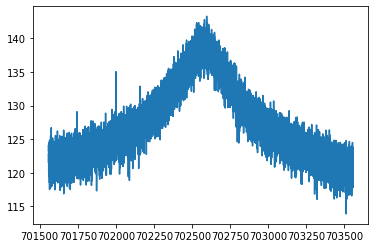

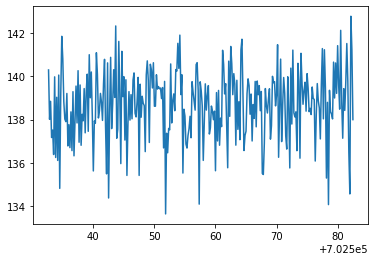

/nuz_trap2_dUvar0.008_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_31.spec


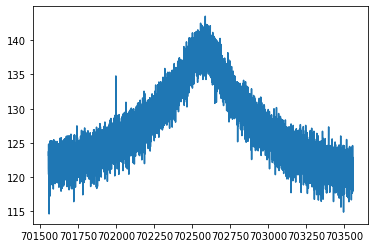

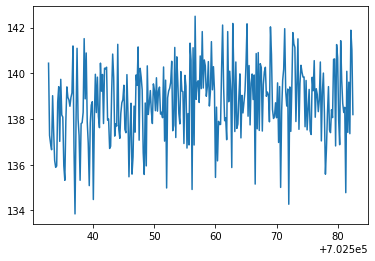

/nuz_trap2_dUvar0.008_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_32.spec


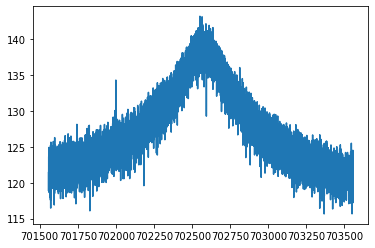

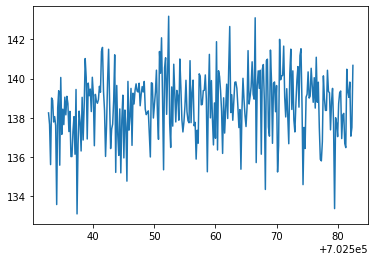

/nuz_trap2_dUvar0.008_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_33.spec


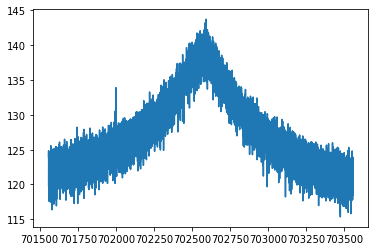

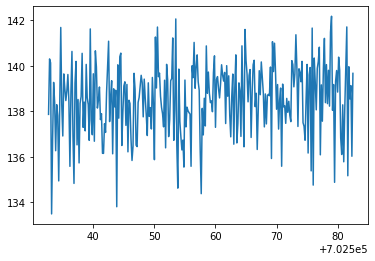

/nuz_trap2_dUvar0.008_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_34.spec


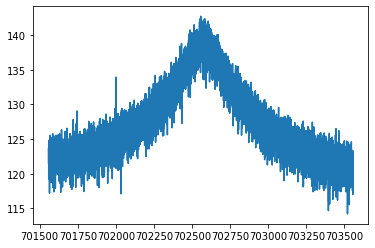

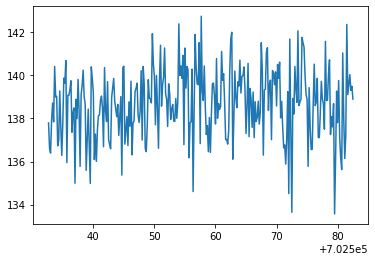

/nuz_trap2_dUvar0.008_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_35.spec


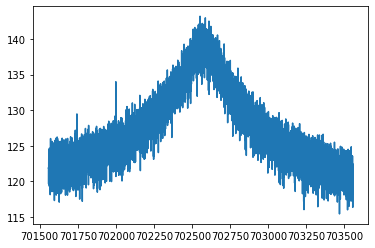

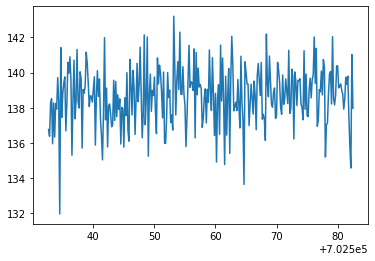

/nuz_trap2_dUvar0.008_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_36.spec


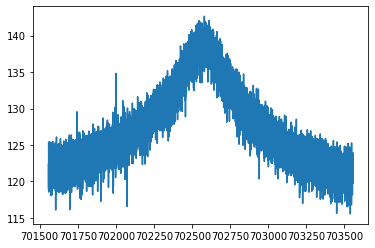

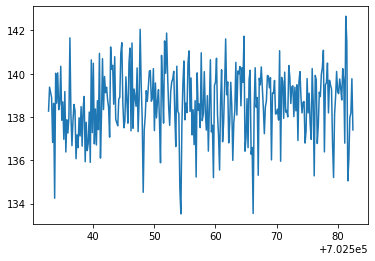

/nuz_trap2_dUvar0.008_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_37.spec


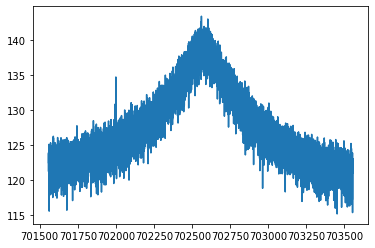

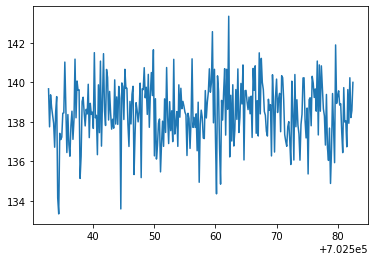

/nuz_trap2_dUvar0.008_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_38.spec


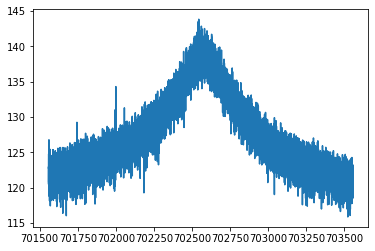

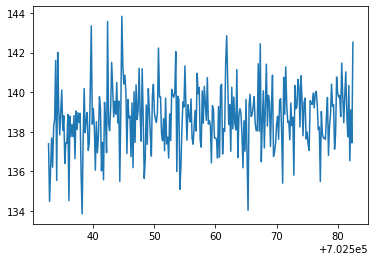

/nuz_trap2_dUvar0.008_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_39.spec


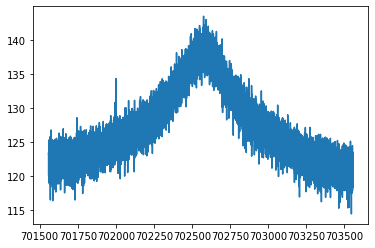

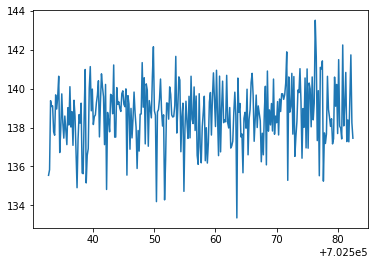

/nuz_trap2_dUvar0.008_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
467,21,20220515_114619.062643,0.008,2,702557.600443008123,0.033817082247,3.971498198711,0.298537360346,3.418683477672,702579.757612957503,6.935557382608,3437.779231050310,29.278783226537
468,22,20220515_123737.876126,0.008,2,702557.595692865085,0.029298662984,3.713368466977,0.255257723133,2.729925838982,702568.417887322488,6.205944303669,3420.241540177698,29.195561052000
469,23,20220515_125103.819953,0.008,2,702557.592598671326,0.031942078239,3.867024937582,0.268493209943,2.763983507931,702564.397804600885,6.043189072969,3492.650299129010,30.850298571334
470,3,20220515_023625.378091,0.008,2,702557.578800802235,0.026168612269,3.839210503504,0.230975149915,2.152298191645,702578.431553504779,5.601160565626,3396.363299071812,29.005107429273


/nuz_trap2_dUvar0.008_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.008_40.spec


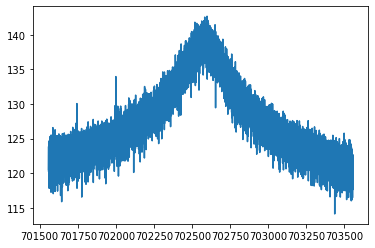

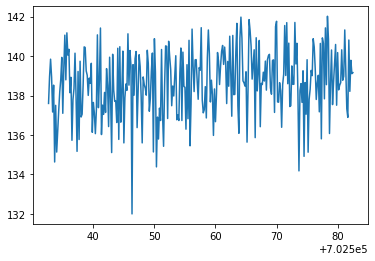

/nuz_trap2_dUvar0.008_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
468,22,20220515_123737.876126,0.008,2,702557.595692865085,0.029298662984,3.713368466977,0.255257723133,2.729925838982,702568.417887322488,6.205944303669,3420.241540177698,29.195561052000
469,23,20220515_125103.819953,0.008,2,702557.592598671326,0.031942078239,3.867024937582,0.268493209943,2.763983507931,702564.397804600885,6.043189072969,3492.650299129010,30.850298571334
470,3,20220515_023625.378091,0.008,2,702557.578800802235,0.026168612269,3.839210503504,0.230975149915,2.152298191645,702578.431553504779,5.601160565626,3396.363299071812,29.005107429273
471,4,20220515_024436.623494,0.008,2,702557.487348046037,0.033244970259,3.787283761598,0.273132800685,3.022141490835,702576.298917121137,6.305906890219,3632.700470205311,32.801458096366


/nuz_trap2_dUvar0.008_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
469,23,20220515_125103.819953,0.008,2,702557.592598671326,0.031942078239,3.867024937582,0.268493209943,2.763983507931,702564.397804600885,6.043189072969,3492.650299129010,30.850298571334
470,3,20220515_023625.378091,0.008,2,702557.578800802235,0.026168612269,3.839210503504,0.230975149915,2.152298191645,702578.431553504779,5.601160565626,3396.363299071812,29.005107429273
471,4,20220515_024436.623494,0.008,2,702557.487348046037,0.033244970259,3.787283761598,0.273132800685,3.022141490835,702576.298917121137,6.305906890219,3632.700470205311,32.801458096366
472,5,20220515_032638.987902,0.008,2,702557.573251534021,0.032084362291,4.154214146149,0.291862717400,2.991627170199,702568.902941432432,6.275539637419,3394.602988228492,28.957055394188


/nuz_trap2_dUvar0.008_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
470,3,20220515_023625.378091,0.008,2,702557.578800802235,0.026168612269,3.839210503504,0.230975149915,2.152298191645,702578.431553504779,5.601160565626,3396.363299071812,29.005107429273
471,4,20220515_024436.623494,0.008,2,702557.487348046037,0.033244970259,3.787283761598,0.273132800685,3.022141490835,702576.298917121137,6.305906890219,3632.700470205311,32.801458096366
472,5,20220515_032638.987902,0.008,2,702557.573251534021,0.032084362291,4.154214146149,0.291862717400,2.991627170199,702568.902941432432,6.275539637419,3394.602988228492,28.957055394188
473,6,20220515_035822.344253,0.008,2,702557.605097759981,0.031640513283,3.825784066851,0.256015712410,2.566191557799,702574.482698798529,5.657745759856,3721.715531467739,35.072001482144


/nuz_trap2_dUvar0.008_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
471,4,20220515_024436.623494,0.008,2,702557.487348046037,0.033244970259,3.787283761598,0.273132800685,3.022141490835,702576.298917121137,6.305906890219,3632.700470205311,32.801458096366
472,5,20220515_032638.987902,0.008,2,702557.573251534021,0.032084362291,4.154214146149,0.291862717400,2.991627170199,702568.902941432432,6.275539637419,3394.602988228492,28.957055394188
473,6,20220515_035822.344253,0.008,2,702557.605097759981,0.031640513283,3.825784066851,0.256015712410,2.566191557799,702574.482698798529,5.657745759856,3721.715531467739,35.072001482144
474,7,20220515_044545.836647,0.008,2,702557.639300202485,0.032085157618,4.114415858019,0.268012359167,2.538526433639,702576.103345896350,5.617413182012,3629.616038064352,33.041728600146


/nuz_trap2_dUvar0.008_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
472,5,20220515_032638.987902,0.008,2,702557.573251534021,0.032084362291,4.154214146149,0.291862717400,2.991627170199,702568.902941432432,6.275539637419,3394.602988228492,28.957055394188
473,6,20220515_035822.344253,0.008,2,702557.605097759981,0.031640513283,3.825784066851,0.256015712410,2.566191557799,702574.482698798529,5.657745759856,3721.715531467739,35.072001482144
474,7,20220515_044545.836647,0.008,2,702557.639300202485,0.032085157618,4.114415858019,0.268012359167,2.538526433639,702576.103345896350,5.617413182012,3629.616038064352,33.041728600146
475,8,20220515_051215.505528,0.008,2,702557.594227412599,0.032435887355,3.683569949692,0.254211679367,2.638490313550,702572.668070410844,5.854501689411,3689.840031310658,33.704613266594


/nuz_trap2_dUvar0.009_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
473,6,20220515_035822.344253,0.008,2,702557.605097759981,0.031640513283,3.825784066851,0.256015712410,2.566191557799,702574.482698798529,5.657745759856,3721.715531467739,35.072001482144
474,7,20220515_044545.836647,0.008,2,702557.639300202485,0.032085157618,4.114415858019,0.268012359167,2.538526433639,702576.103345896350,5.617413182012,3629.616038064352,33.041728600146
475,8,20220515_051215.505528,0.008,2,702557.594227412599,0.032435887355,3.683569949692,0.254211679367,2.638490313550,702572.668070410844,5.854501689411,3689.840031310658,33.704613266594
476,9,20220515_052423.045871,0.008,2,702557.587519022869,0.030761610931,4.091523925726,0.271761195327,2.688681963207,702580.261386157712,6.178239147885,3388.380420275492,29.016658417043


/nuz_trap2_dUvar0.009_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,7,20220515_044545.836647,0.008,2,702557.639300202485,0.032085157618,4.114415858019,0.268012359167,2.538526433639,702576.103345896350,5.617413182012,3629.616038064352,33.041728600146
475,8,20220515_051215.505528,0.008,2,702557.594227412599,0.032435887355,3.683569949692,0.254211679367,2.638490313550,702572.668070410844,5.854501689411,3689.840031310658,33.704613266594
476,9,20220515_052423.045871,0.008,2,702557.587519022869,0.030761610931,4.091523925726,0.271761195327,2.688681963207,702580.261386157712,6.178239147885,3388.380420275492,29.016658417043
477,1,20220515_012519.130456,0.009,2,702557.570955640171,0.031902275502,4.099637517603,0.266562499799,2.505767262674,702574.230860827025,5.371222895735,3775.202077781233,35.179042229857


/nuz_trap2_dUvar0.009_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,8,20220515_051215.505528,0.008,2,702557.594227412599,0.032435887355,3.683569949692,0.254211679367,2.638490313550,702572.668070410844,5.854501689411,3689.840031310658,33.704613266594
476,9,20220515_052423.045871,0.008,2,702557.587519022869,0.030761610931,4.091523925726,0.271761195327,2.688681963207,702580.261386157712,6.178239147885,3388.380420275492,29.016658417043
477,1,20220515_012519.130456,0.009,2,702557.570955640171,0.031902275502,4.099637517603,0.266562499799,2.505767262674,702574.230860827025,5.371222895735,3775.202077781233,35.179042229857
478,10,20220515_060237.870220,0.009,2,702557.645119345747,0.031263972530,4.164001605562,0.257418272330,2.276191928220,702575.683257083409,5.245947822257,3676.496064727807,33.687038158649


/nuz_trap2_dUvar0.009_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
476,9,20220515_052423.045871,0.008,2,702557.587519022869,0.030761610931,4.091523925726,0.271761195327,2.688681963207,702580.261386157712,6.178239147885,3388.380420275492,29.016658417043
477,1,20220515_012519.130456,0.009,2,702557.570955640171,0.031902275502,4.099637517603,0.266562499799,2.505767262674,702574.230860827025,5.371222895735,3775.202077781233,35.179042229857
478,10,20220515_060237.870220,0.009,2,702557.645119345747,0.031263972530,4.164001605562,0.257418272330,2.276191928220,702575.683257083409,5.245947822257,3676.496064727807,33.687038158649
479,11,20220515_065356.539773,0.009,2,702557.648997549783,0.036604593725,4.321031428181,0.304375690535,2.989303641737,702575.324471732019,5.908655686321,3691.759220298798,33.849357334670


/nuz_trap2_dUvar0.009_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
477,1,20220515_012519.130456,0.009,2,702557.570955640171,0.031902275502,4.099637517603,0.266562499799,2.505767262674,702574.230860827025,5.371222895735,3775.202077781233,35.179042229857
478,10,20220515_060237.870220,0.009,2,702557.645119345747,0.031263972530,4.164001605562,0.257418272330,2.276191928220,702575.683257083409,5.245947822257,3676.496064727807,33.687038158649
479,11,20220515_065356.539773,0.009,2,702557.648997549783,0.036604593725,4.321031428181,0.304375690535,2.989303641737,702575.324471732019,5.908655686321,3691.759220298798,33.849357334670
480,12,20220515_072658.096687,0.009,2,702557.537768797134,0.031278409710,3.919148133194,0.265499964177,2.725533737636,702578.561841259012,6.136930375862,3496.738857611654,30.337551078699


/nuz_trap2_dUvar0.009_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
478,10,20220515_060237.870220,0.009,2,702557.645119345747,0.031263972530,4.164001605562,0.257418272330,2.276191928220,702575.683257083409,5.245947822257,3676.496064727807,33.687038158649
479,11,20220515_065356.539773,0.009,2,702557.648997549783,0.036604593725,4.321031428181,0.304375690535,2.989303641737,702575.324471732019,5.908655686321,3691.759220298798,33.849357334670
480,12,20220515_072658.096687,0.009,2,702557.537768797134,0.031278409710,3.919148133194,0.265499964177,2.725533737636,702578.561841259012,6.136930375862,3496.738857611654,30.337551078699
481,13,20220515_073747.308273,0.009,2,702557.571045772755,0.033512070411,4.141240801671,0.298543973378,3.165435516785,702577.375685921172,6.672932836241,3353.815692199484,28.416639632509


/nuz_trap2_dUvar0.009_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
479,11,20220515_065356.539773,0.009,2,702557.648997549783,0.036604593725,4.321031428181,0.304375690535,2.989303641737,702575.324471732019,5.908655686321,3691.759220298798,33.849357334670
480,12,20220515_072658.096687,0.009,2,702557.537768797134,0.031278409710,3.919148133194,0.265499964177,2.725533737636,702578.561841259012,6.136930375862,3496.738857611654,30.337551078699
481,13,20220515_073747.308273,0.009,2,702557.571045772755,0.033512070411,4.141240801671,0.298543973378,3.165435516785,702577.375685921172,6.672932836241,3353.815692199484,28.416639632509
482,14,20220515_082352.593801,0.009,2,702557.611153418780,0.029203706195,3.418424690277,0.240783685625,2.756578602635,702577.951808772283,6.616774853961,3411.872917323622,29.080839082339


/nuz_trap2_dUvar0.009_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
480,12,20220515_072658.096687,0.009,2,702557.537768797134,0.031278409710,3.919148133194,0.265499964177,2.725533737636,702578.561841259012,6.136930375862,3496.738857611654,30.337551078699
481,13,20220515_073747.308273,0.009,2,702557.571045772755,0.033512070411,4.141240801671,0.298543973378,3.165435516785,702577.375685921172,6.672932836241,3353.815692199484,28.416639632509
482,14,20220515_082352.593801,0.009,2,702557.611153418780,0.029203706195,3.418424690277,0.240783685625,2.756578602635,702577.951808772283,6.616774853961,3411.872917323622,29.080839082339
483,15,20220515_083600.100572,0.009,2,702557.662466976210,0.031004925510,3.631416376869,0.241346658699,2.459236712213,702572.194502277998,5.714112768325,3660.328386228682,33.767961242040


/nuz_trap2_dUvar0.009_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
481,13,20220515_073747.308273,0.009,2,702557.571045772755,0.033512070411,4.141240801671,0.298543973378,3.165435516785,702577.375685921172,6.672932836241,3353.815692199484,28.416639632509
482,14,20220515_082352.593801,0.009,2,702557.611153418780,0.029203706195,3.418424690277,0.240783685625,2.756578602635,702577.951808772283,6.616774853961,3411.872917323622,29.080839082339
483,15,20220515_083600.100572,0.009,2,702557.662466976210,0.031004925510,3.631416376869,0.241346658699,2.459236712213,702572.194502277998,5.714112768325,3660.328386228682,33.767961242040
484,16,20220515_092718.927609,0.009,2,702557.545239617932,0.031155348606,3.662920004796,0.249214311889,2.600823663475,702573.894152825233,5.824261054194,3688.097276510422,34.879642390988


/nuz_trap2_dUvar0.009_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
482,14,20220515_082352.593801,0.009,2,702557.611153418780,0.029203706195,3.418424690277,0.240783685625,2.756578602635,702577.951808772283,6.616774853961,3411.872917323622,29.080839082339
483,15,20220515_083600.100572,0.009,2,702557.662466976210,0.031004925510,3.631416376869,0.241346658699,2.459236712213,702572.194502277998,5.714112768325,3660.328386228682,33.767961242040
484,16,20220515_092718.927609,0.009,2,702557.545239617932,0.031155348606,3.662920004796,0.249214311889,2.600823663475,702573.894152825233,5.824261054194,3688.097276510422,34.879642390988
485,17,20220515_100257.081491,0.009,2,702557.610108480905,0.030901795705,3.690846652615,0.264988413436,2.984991703200,702574.350080563687,6.603957104205,3413.940948187062,29.265799647873


/nuz_trap2_dUvar0.009_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,15,20220515_083600.100572,0.009,2,702557.662466976210,0.031004925510,3.631416376869,0.241346658699,2.459236712213,702572.194502277998,5.714112768325,3660.328386228682,33.767961242040
484,16,20220515_092718.927609,0.009,2,702557.545239617932,0.031155348606,3.662920004796,0.249214311889,2.600823663475,702573.894152825233,5.824261054194,3688.097276510422,34.879642390988
485,17,20220515_100257.081491,0.009,2,702557.610108480905,0.030901795705,3.690846652615,0.264988413436,2.984991703200,702574.350080563687,6.603957104205,3413.940948187062,29.265799647873
486,18,20220515_102650.029794,0.009,2,702557.556851837318,0.030802194868,3.565543688952,0.262807801348,3.096672889840,702574.117370762862,6.679742450209,3487.989887288356,29.651329578047


/nuz_trap2_dUvar0.009_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
484,16,20220515_092718.927609,0.009,2,702557.545239617932,0.031155348606,3.662920004796,0.249214311889,2.600823663475,702573.894152825233,5.824261054194,3688.097276510422,34.879642390988
485,17,20220515_100257.081491,0.009,2,702557.610108480905,0.030901795705,3.690846652615,0.264988413436,2.984991703200,702574.350080563687,6.603957104205,3413.940948187062,29.265799647873
486,18,20220515_102650.029794,0.009,2,702557.556851837318,0.030802194868,3.565543688952,0.262807801348,3.096672889840,702574.117370762862,6.679742450209,3487.989887288356,29.651329578047
487,19,20220515_105438.097471,0.009,2,702557.583746439079,0.030091384594,3.843064769569,0.264998530593,2.849393435426,702582.770809410838,6.510024006164,3412.194474086070,29.376583977810


/nuz_trap2_dUvar0.009_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
485,17,20220515_100257.081491,0.009,2,702557.610108480905,0.030901795705,3.690846652615,0.264988413436,2.984991703200,702574.350080563687,6.603957104205,3413.940948187062,29.265799647873
486,18,20220515_102650.029794,0.009,2,702557.556851837318,0.030802194868,3.565543688952,0.262807801348,3.096672889840,702574.117370762862,6.679742450209,3487.989887288356,29.651329578047
487,19,20220515_105438.097471,0.009,2,702557.583746439079,0.030091384594,3.843064769569,0.264998530593,2.849393435426,702582.770809410838,6.510024006164,3412.194474086070,29.376583977810
488,2,20220515_014119.569984,0.009,2,702557.709464653395,0.033084640823,4.042439225888,0.293830590368,3.164628465236,702566.018092225771,6.421533765086,3441.825454160144,29.812952570470


/nuz_trap2_dUvar0.009_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
486,18,20220515_102650.029794,0.009,2,702557.556851837318,0.030802194868,3.565543688952,0.262807801348,3.096672889840,702574.117370762862,6.679742450209,3487.989887288356,29.651329578047
487,19,20220515_105438.097471,0.009,2,702557.583746439079,0.030091384594,3.843064769569,0.264998530593,2.849393435426,702582.770809410838,6.510024006164,3412.194474086070,29.376583977810
488,2,20220515_014119.569984,0.009,2,702557.709464653395,0.033084640823,4.042439225888,0.293830590368,3.164628465236,702566.018092225771,6.421533765086,3441.825454160144,29.812952570470
489,20,20220515_111830.990558,0.009,2,702557.572898948682,0.029403287224,4.570446773743,0.273313369184,2.270651088446,702577.155267042923,5.320483831861,3446.923216498434,29.622240842809


/nuz_trap2_dUvar0.009_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
487,19,20220515_105438.097471,0.009,2,702557.583746439079,0.030091384594,3.843064769569,0.264998530593,2.849393435426,702582.770809410838,6.510024006164,3412.194474086070,29.376583977810
488,2,20220515_014119.569984,0.009,2,702557.709464653395,0.033084640823,4.042439225888,0.293830590368,3.164628465236,702566.018092225771,6.421533765086,3441.825454160144,29.812952570470
489,20,20220515_111830.990558,0.009,2,702557.572898948682,0.029403287224,4.570446773743,0.273313369184,2.270651088446,702577.155267042923,5.320483831861,3446.923216498434,29.622240842809
490,21,20220515_115250.907635,0.009,2,702557.595217848546,0.026551676451,3.680225227046,0.228463375904,2.251695640781,702583.048824573169,5.922722192517,3393.574779008830,28.461910383832


/nuz_trap2_dUvar0.009_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
488,2,20220515_014119.569984,0.009,2,702557.709464653395,0.033084640823,4.042439225888,0.293830590368,3.164628465236,702566.018092225771,6.421533765086,3441.825454160144,29.812952570470
489,20,20220515_111830.990558,0.009,2,702557.572898948682,0.029403287224,4.570446773743,0.273313369184,2.270651088446,702577.155267042923,5.320483831861,3446.923216498434,29.622240842809
490,21,20220515_115250.907635,0.009,2,702557.595217848546,0.026551676451,3.680225227046,0.228463375904,2.251695640781,702583.048824573169,5.922722192517,3393.574779008830,28.461910383832
491,22,20220515_123619.515099,0.009,2,702557.591622152482,0.025832180632,3.687263658930,0.223349284267,2.145481431055,702581.694048607023,5.708189325475,3420.545266623470,29.204204970124


/nuz_trap2_dUvar0.009_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
489,20,20220515_111830.990558,0.009,2,702557.572898948682,0.029403287224,4.570446773743,0.273313369184,2.270651088446,702577.155267042923,5.320483831861,3446.923216498434,29.622240842809
490,21,20220515_115250.907635,0.009,2,702557.595217848546,0.026551676451,3.680225227046,0.228463375904,2.251695640781,702583.048824573169,5.922722192517,3393.574779008830,28.461910383832
491,22,20220515_123619.515099,0.009,2,702557.591622152482,0.025832180632,3.687263658930,0.223349284267,2.145481431055,702581.694048607023,5.708189325475,3420.545266623470,29.204204970124
492,23,20220515_130525.904601,0.009,2,702557.571567779058,0.028595746134,3.324032695976,0.243438398308,2.973885805432,702582.175373713835,7.035607216173,3396.985005014885,28.886908313842


/nuz_trap2_dUvar0.009_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_25.spec


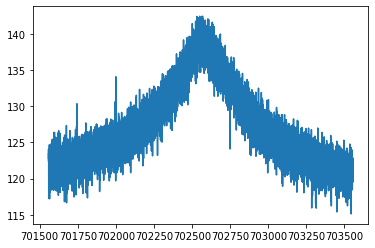

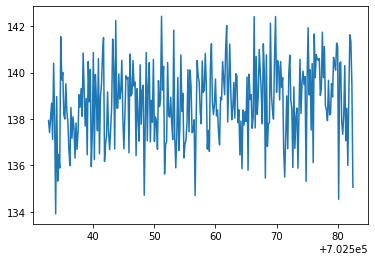

/nuz_trap2_dUvar0.009_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_26.spec


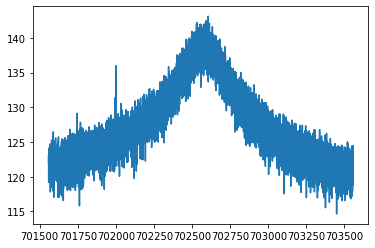

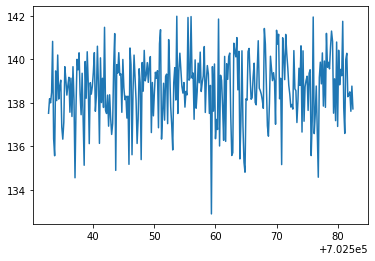

/nuz_trap2_dUvar0.009_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_27.spec


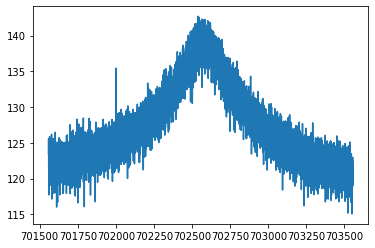

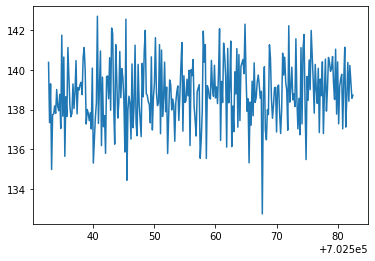

/nuz_trap2_dUvar0.009_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_28.spec


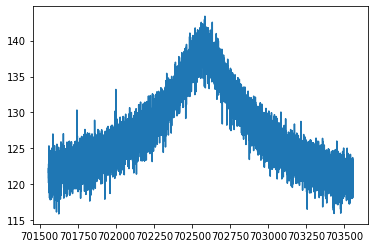

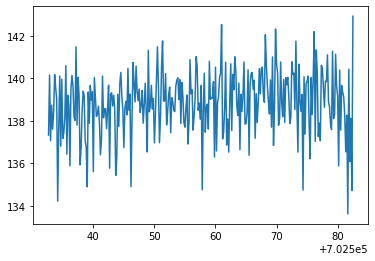

/nuz_trap2_dUvar0.009_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_29.spec


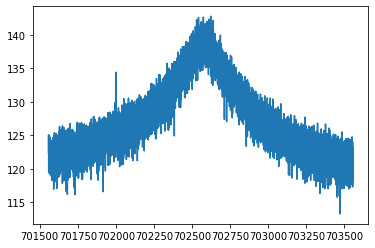

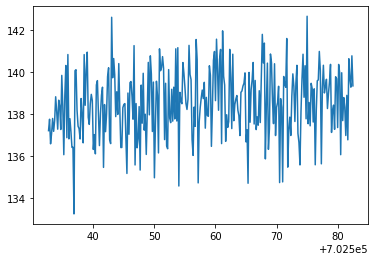

/nuz_trap2_dUvar0.009_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
490,21,20220515_115250.907635,0.009,2,702557.595217848546,0.026551676451,3.680225227046,0.228463375904,2.251695640781,702583.048824573169,5.922722192517,3393.574779008830,28.461910383832
491,22,20220515_123619.515099,0.009,2,702557.591622152482,0.025832180632,3.687263658930,0.223349284267,2.145481431055,702581.694048607023,5.708189325475,3420.545266623470,29.204204970124
492,23,20220515_130525.904601,0.009,2,702557.571567779058,0.028595746134,3.324032695976,0.243438398308,2.973885805432,702582.175373713835,7.035607216173,3396.985005014885,28.886908313842
493,24,20220515_132918.849091,0.009,2,702557.575736274943,0.029539817327,3.896988733027,0.263707283352,2.745795715744,702577.041466092458,6.197738854564,3436.022133687968,29.351429157780


/nuz_trap2_dUvar0.009_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_30.spec


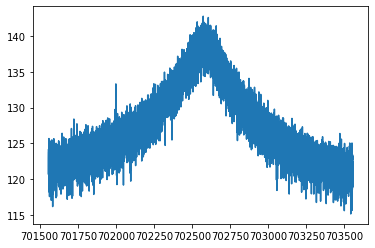

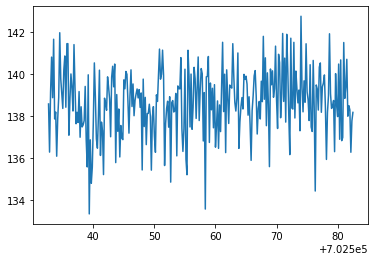

/nuz_trap2_dUvar0.009_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_31.spec


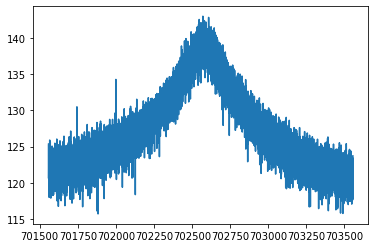

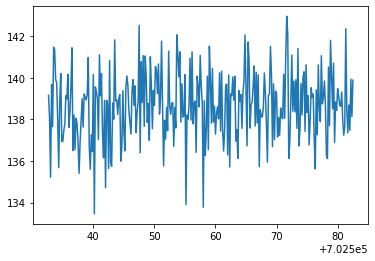

/nuz_trap2_dUvar0.009_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_32.spec


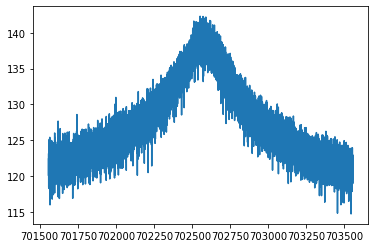

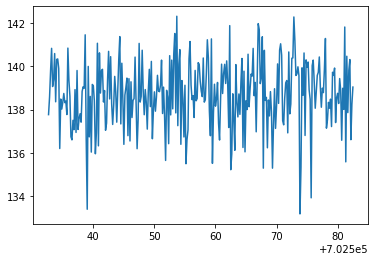

/nuz_trap2_dUvar0.009_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_33.spec


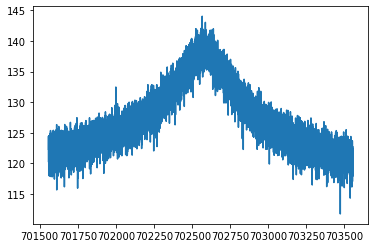

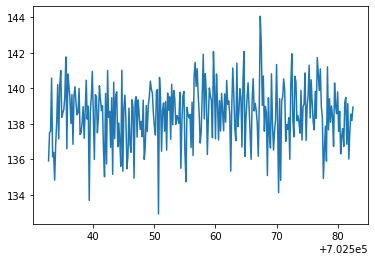

/nuz_trap2_dUvar0.009_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_34.spec


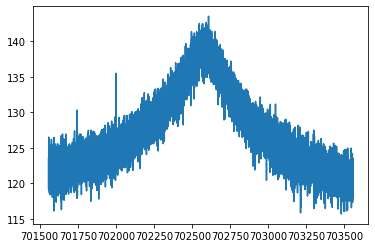

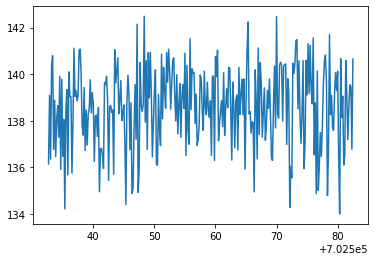

/nuz_trap2_dUvar0.009_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_35.spec


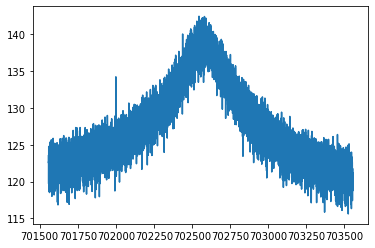

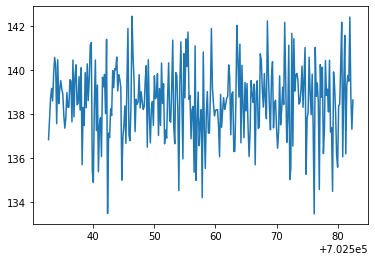

/nuz_trap2_dUvar0.009_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_36.spec


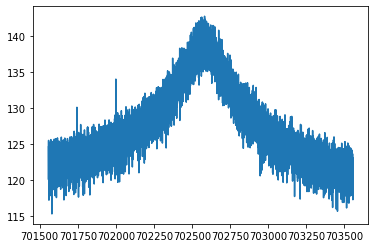

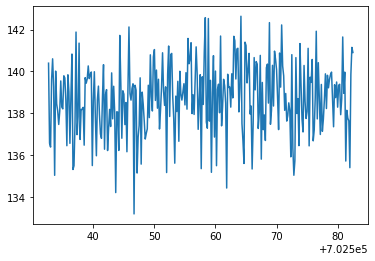

/nuz_trap2_dUvar0.009_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_37.spec


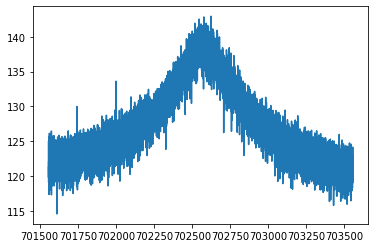

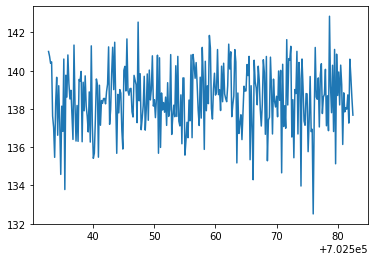

/nuz_trap2_dUvar0.009_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_38.spec


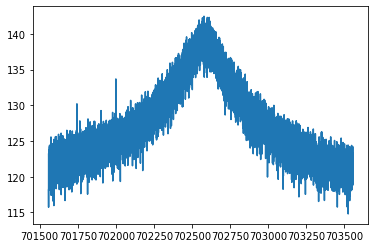

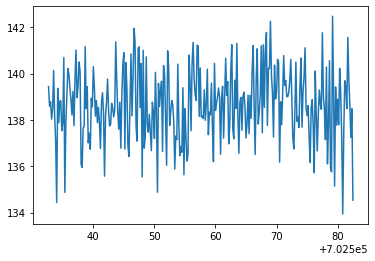

/nuz_trap2_dUvar0.009_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_39.spec


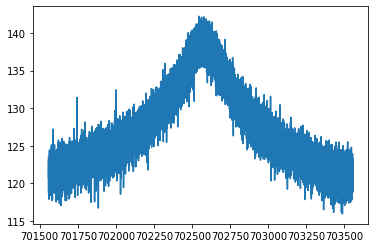

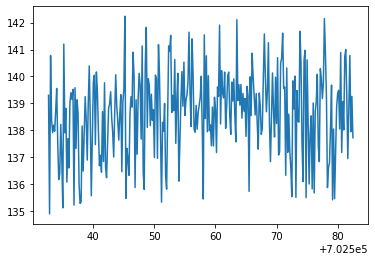

/nuz_trap2_dUvar0.009_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
491,22,20220515_123619.515099,0.009,2,702557.591622152482,0.025832180632,3.687263658930,0.223349284267,2.145481431055,702581.694048607023,5.708189325475,3420.545266623470,29.204204970124
492,23,20220515_130525.904601,0.009,2,702557.571567779058,0.028595746134,3.324032695976,0.243438398308,2.973885805432,702582.175373713835,7.035607216173,3396.985005014885,28.886908313842
493,24,20220515_132918.849091,0.009,2,702557.575736274943,0.029539817327,3.896988733027,0.263707283352,2.745795715744,702577.041466092458,6.197738854564,3436.022133687968,29.351429157780
494,3,20220515_022047.235623,0.009,2,702557.668994501466,0.035043143513,3.564586848661,0.279681736666,3.433721258841,702566.243258973234,6.831697505575,3576.683487129539,31.717560746033


/nuz_trap2_dUvar0.009_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_40.spec


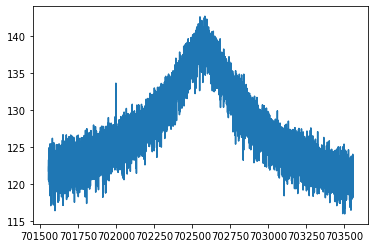

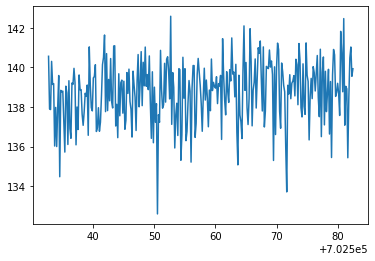

/nuz_trap2_dUvar0.009_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.009_41.spec


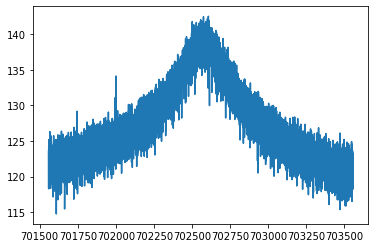

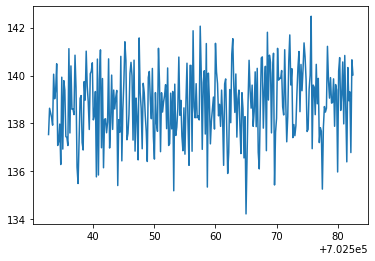

/nuz_trap2_dUvar0.009_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
492,23,20220515_130525.904601,0.009,2,702557.571567779058,0.028595746134,3.324032695976,0.243438398308,2.973885805432,702582.175373713835,7.035607216173,3396.985005014885,28.886908313842
493,24,20220515_132918.849091,0.009,2,702557.575736274943,0.029539817327,3.896988733027,0.263707283352,2.745795715744,702577.041466092458,6.197738854564,3436.022133687968,29.351429157780
494,3,20220515_022047.235623,0.009,2,702557.668994501466,0.035043143513,3.564586848661,0.279681736666,3.433721258841,702566.243258973234,6.831697505575,3576.683487129539,31.717560746033
495,4,20220515_025100.790423,0.009,2,702557.577192593249,0.031998664339,3.413422624300,0.270130453230,3.463325729195,702570.282212495105,7.197232020902,3448.098729291603,29.624530270821


/nuz_trap2_dUvar0.009_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
493,24,20220515_132918.849091,0.009,2,702557.575736274943,0.029539817327,3.896988733027,0.263707283352,2.745795715744,702577.041466092458,6.197738854564,3436.022133687968,29.351429157780
494,3,20220515_022047.235623,0.009,2,702557.668994501466,0.035043143513,3.564586848661,0.279681736666,3.433721258841,702566.243258973234,6.831697505575,3576.683487129539,31.717560746033
495,4,20220515_025100.790423,0.009,2,702557.577192593249,0.031998664339,3.413422624300,0.270130453230,3.463325729195,702570.282212495105,7.197232020902,3448.098729291603,29.624530270821
496,5,20220515_033705.979180,0.009,2,702557.636243438581,0.030728777909,3.573112592913,0.245523544458,2.632095974535,702571.161959342542,6.138834921900,3505.101320792690,31.020750555198


/nuz_trap2_dUvar0.009_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
494,3,20220515_022047.235623,0.009,2,702557.668994501466,0.035043143513,3.564586848661,0.279681736666,3.433721258841,702566.243258973234,6.831697505575,3576.683487129539,31.717560746033
495,4,20220515_025100.790423,0.009,2,702557.577192593249,0.031998664339,3.413422624300,0.270130453230,3.463325729195,702570.282212495105,7.197232020902,3448.098729291603,29.624530270821
496,5,20220515_033705.979180,0.009,2,702557.636243438581,0.030728777909,3.573112592913,0.245523544458,2.632095974535,702571.161959342542,6.138834921900,3505.101320792690,31.020750555198
497,6,20220515_035031.923639,0.009,2,702557.579691369087,0.025089263601,3.585016268641,0.217594994839,2.128284914973,702581.006814178661,5.706533450446,3433.632617704932,29.302004529325


/nuz_trap2_dUvar0.009_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,4,20220515_025100.790423,0.009,2,702557.577192593249,0.031998664339,3.413422624300,0.270130453230,3.463325729195,702570.282212495105,7.197232020902,3448.098729291603,29.624530270821
496,5,20220515_033705.979180,0.009,2,702557.636243438581,0.030728777909,3.573112592913,0.245523544458,2.632095974535,702571.161959342542,6.138834921900,3505.101320792690,31.020750555198
497,6,20220515_035031.923639,0.009,2,702557.579691369087,0.025089263601,3.585016268641,0.217594994839,2.128284914973,702581.006814178661,5.706533450446,3433.632617704932,29.302004529325
498,7,20220515_043005.425339,0.009,2,702557.522597774165,0.032119622415,3.450651540729,0.259271406025,3.128080433965,702571.148910200805,6.850114867938,3454.195747612180,29.928378747442


/nuz_trap2_dUvar0.009_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
496,5,20220515_033705.979180,0.009,2,702557.636243438581,0.030728777909,3.573112592913,0.245523544458,2.632095974535,702571.161959342542,6.138834921900,3505.101320792690,31.020750555198
497,6,20220515_035031.923639,0.009,2,702557.579691369087,0.025089263601,3.585016268641,0.217594994839,2.128284914973,702581.006814178661,5.706533450446,3433.632617704932,29.302004529325
498,7,20220515_043005.425339,0.009,2,702557.522597774165,0.032119622415,3.450651540729,0.259271406025,3.128080433965,702571.148910200805,6.850114867938,3454.195747612180,29.928378747442
499,8,20220515_051333.892691,0.009,2,702557.645358974696,0.028471045694,3.896875172600,0.232139165366,2.044744877779,702568.274424089119,5.012243220329,3662.969654160844,34.639422294983


/nuz_trap2_dUvar0.011_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
497,6,20220515_035031.923639,0.009,2,702557.579691369087,0.025089263601,3.585016268641,0.217594994839,2.128284914973,702581.006814178661,5.706533450446,3433.632617704932,29.302004529325
498,7,20220515_043005.425339,0.009,2,702557.522597774165,0.032119622415,3.450651540729,0.259271406025,3.128080433965,702571.148910200805,6.850114867938,3454.195747612180,29.928378747442
499,8,20220515_051333.892691,0.009,2,702557.645358974696,0.028471045694,3.896875172600,0.232139165366,2.044744877779,702568.274424089119,5.012243220329,3662.969654160844,34.639422294983
500,9,20220515_054516.938057,0.009,2,702557.641598269460,0.031479476176,4.123673498075,0.270840678239,2.637677450604,702580.467362067429,6.038412512700,3446.803461987172,29.641660019870


/nuz_trap2_dUvar0.011_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
498,7,20220515_043005.425339,0.009,2,702557.522597774165,0.032119622415,3.450651540729,0.259271406025,3.128080433965,702571.148910200805,6.850114867938,3454.195747612180,29.928378747442
499,8,20220515_051333.892691,0.009,2,702557.645358974696,0.028471045694,3.896875172600,0.232139165366,2.044744877779,702568.274424089119,5.012243220329,3662.969654160844,34.639422294983
500,9,20220515_054516.938057,0.009,2,702557.641598269460,0.031479476176,4.123673498075,0.270840678239,2.637677450604,702580.467362067429,6.038412512700,3446.803461987172,29.641660019870
501,1,20220515_011335.260322,0.011,2,702557.646789865568,0.032731120608,3.877560958529,0.279346879919,3.143705276761,702583.795993016451,6.738852640100,3489.513082737128,30.192633065642


/nuz_trap2_dUvar0.011_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
499,8,20220515_051333.892691,0.009,2,702557.645358974696,0.028471045694,3.896875172600,0.232139165366,2.044744877779,702568.274424089119,5.012243220329,3662.969654160844,34.639422294983
500,9,20220515_054516.938057,0.009,2,702557.641598269460,0.031479476176,4.123673498075,0.270840678239,2.637677450604,702580.467362067429,6.038412512700,3446.803461987172,29.641660019870
501,1,20220515_011335.260322,0.011,2,702557.646789865568,0.032731120608,3.877560958529,0.279346879919,3.143705276761,702583.795993016451,6.738852640100,3489.513082737128,30.192633065642
502,10,20220515_055447.691477,0.011,2,702557.556499699596,0.028645327758,3.622901399826,0.246562422861,2.696715157728,702583.037242493592,6.453960407902,3431.791636611239,29.124263159278


/nuz_trap2_dUvar0.011_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
500,9,20220515_054516.938057,0.009,2,702557.641598269460,0.031479476176,4.123673498075,0.270840678239,2.637677450604,702580.467362067429,6.038412512700,3446.803461987172,29.641660019870
501,1,20220515_011335.260322,0.011,2,702557.646789865568,0.032731120608,3.877560958529,0.279346879919,3.143705276761,702583.795993016451,6.738852640100,3489.513082737128,30.192633065642
502,10,20220515_055447.691477,0.011,2,702557.556499699596,0.028645327758,3.622901399826,0.246562422861,2.696715157728,702583.037242493592,6.453960407902,3431.791636611239,29.124263159278
503,11,20220515_064211.185366,0.011,2,702557.614873306593,0.030052012343,4.287477364673,0.274993452413,2.607492175663,702582.488501934567,5.955999810590,3425.014647269883,29.121415177559


/nuz_trap2_dUvar0.011_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,1,20220515_011335.260322,0.011,2,702557.646789865568,0.032731120608,3.877560958529,0.279346879919,3.143705276761,702583.795993016451,6.738852640100,3489.513082737128,30.192633065642
502,10,20220515_055447.691477,0.011,2,702557.556499699596,0.028645327758,3.622901399826,0.246562422861,2.696715157728,702583.037242493592,6.453960407902,3431.791636611239,29.124263159278
503,11,20220515_064211.185366,0.011,2,702557.614873306593,0.030052012343,4.287477364673,0.274993452413,2.607492175663,702582.488501934567,5.955999810590,3425.014647269883,29.121415177559
504,12,20220515_071117.660057,0.011,2,702557.585157842375,0.028450903027,3.931184260108,0.248126007306,2.372367432485,702577.213456217549,5.783957740488,3423.017862567395,29.110606256866


/nuz_trap2_dUvar0.011_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
502,10,20220515_055447.691477,0.011,2,702557.556499699596,0.028645327758,3.622901399826,0.246562422861,2.696715157728,702583.037242493592,6.453960407902,3431.791636611239,29.124263159278
503,11,20220515_064211.185366,0.011,2,702557.614873306593,0.030052012343,4.287477364673,0.274993452413,2.607492175663,702582.488501934567,5.955999810590,3425.014647269883,29.121415177559
504,12,20220515_071117.660057,0.011,2,702557.585157842375,0.028450903027,3.931184260108,0.248126007306,2.372367432485,702577.213456217549,5.783957740488,3423.017862567395,29.110606256866
505,13,20220515_075841.224746,0.011,2,702557.591599719133,0.030609456514,3.722480785996,0.261238664652,2.837096611275,702573.590860174270,6.438198249773,3399.574495129458,29.152907078789


/nuz_trap2_dUvar0.011_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
503,11,20220515_064211.185366,0.011,2,702557.614873306593,0.030052012343,4.287477364673,0.274993452413,2.607492175663,702582.488501934567,5.955999810590,3425.014647269883,29.121415177559
504,12,20220515_071117.660057,0.011,2,702557.585157842375,0.028450903027,3.931184260108,0.248126007306,2.372367432485,702577.213456217549,5.783957740488,3423.017862567395,29.110606256866
505,13,20220515_075841.224746,0.011,2,702557.591599719133,0.030609456514,3.722480785996,0.261238664652,2.837096611275,702573.590860174270,6.438198249773,3399.574495129458,29.152907078789
506,14,20220515_081602.280602,0.011,2,702557.625315779820,0.034852115499,4.172159617472,0.304245406211,3.224157869619,702574.307189874351,6.516614165126,3450.709610784481,29.815073296457


/nuz_trap2_dUvar0.011_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
504,12,20220515_071117.660057,0.011,2,702557.585157842375,0.028450903027,3.931184260108,0.248126007306,2.372367432485,702577.213456217549,5.783957740488,3423.017862567395,29.110606256866
505,13,20220515_075841.224746,0.011,2,702557.591599719133,0.030609456514,3.722480785996,0.261238664652,2.837096611275,702573.590860174270,6.438198249773,3399.574495129458,29.152907078789
506,14,20220515_081602.280602,0.011,2,702557.625315779820,0.034852115499,4.172159617472,0.304245406211,3.224157869619,702574.307189874351,6.516614165126,3450.709610784481,29.815073296457
507,15,20220515_090207.610248,0.011,2,702557.552159994957,0.036142151744,3.994709934935,0.301163357655,3.373724975136,702579.863619868760,6.654083491205,3607.638854918001,33.392954529488


/nuz_trap2_dUvar0.011_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
505,13,20220515_075841.224746,0.011,2,702557.591599719133,0.030609456514,3.722480785996,0.261238664652,2.837096611275,702573.590860174270,6.438198249773,3399.574495129458,29.152907078789
506,14,20220515_081602.280602,0.011,2,702557.625315779820,0.034852115499,4.172159617472,0.304245406211,3.224157869619,702574.307189874351,6.516614165126,3450.709610784481,29.815073296457
507,15,20220515_090207.610248,0.011,2,702557.552159994957,0.036142151744,3.994709934935,0.301163357655,3.373724975136,702579.863619868760,6.654083491205,3607.638854918001,33.392954529488
508,16,20220515_092600.571609,0.011,2,702557.505214371718,0.034056542682,3.431119857782,0.260159667159,3.110867320776,702573.559081315063,6.594025072231,3659.272410718764,33.786834444952


/nuz_trap2_dUvar0.011_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
506,14,20220515_081602.280602,0.011,2,702557.625315779820,0.034852115499,4.172159617472,0.304245406211,3.224157869619,702574.307189874351,6.516614165126,3450.709610784481,29.815073296457
507,15,20220515_090207.610248,0.011,2,702557.552159994957,0.036142151744,3.994709934935,0.301163357655,3.373724975136,702579.863619868760,6.654083491205,3607.638854918001,33.392954529488
508,16,20220515_092600.571609,0.011,2,702557.505214371718,0.034056542682,3.431119857782,0.260159667159,3.110867320776,702573.559081315063,6.594025072231,3659.272410718764,33.786834444952
509,17,20220515_094953.394583,0.011,2,702557.609494779375,0.029199404830,3.532506106009,0.229409110493,2.315335883739,702574.276744060917,5.670124548373,3624.245430606912,33.509893510857


/nuz_trap2_dUvar0.011_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
507,15,20220515_090207.610248,0.011,2,702557.552159994957,0.036142151744,3.994709934935,0.301163357655,3.373724975136,702579.863619868760,6.654083491205,3607.638854918001,33.392954529488
508,16,20220515_092600.571609,0.011,2,702557.505214371718,0.034056542682,3.431119857782,0.260159667159,3.110867320776,702573.559081315063,6.594025072231,3659.272410718764,33.786834444952
509,17,20220515_094953.394583,0.011,2,702557.609494779375,0.029199404830,3.532506106009,0.229409110493,2.315335883739,702574.276744060917,5.670124548373,3624.245430606912,33.509893510857
510,18,20220515_101227.896885,0.011,2,702557.677266372018,0.032424101737,3.315207050768,0.259386819658,3.354346736145,702569.085229708347,7.269186460952,3402.301014674739,28.968591358580


/nuz_trap2_dUvar0.011_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
508,16,20220515_092600.571609,0.011,2,702557.505214371718,0.034056542682,3.431119857782,0.260159667159,3.110867320776,702573.559081315063,6.594025072231,3659.272410718764,33.786834444952
509,17,20220515_094953.394583,0.011,2,702557.609494779375,0.029199404830,3.532506106009,0.229409110493,2.315335883739,702574.276744060917,5.670124548373,3624.245430606912,33.509893510857
510,18,20220515_101227.896885,0.011,2,702557.677266372018,0.032424101737,3.315207050768,0.259386819658,3.354346736145,702569.085229708347,7.269186460952,3402.301014674739,28.968591358580
511,19,20220515_105201.360990,0.011,2,702557.599929616437,0.033146203943,3.876800893482,0.290263803737,3.357159407887,702580.524032562505,6.963191262001,3431.378896898204,29.267375659773


/nuz_trap2_dUvar0.011_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
509,17,20220515_094953.394583,0.011,2,702557.609494779375,0.029199404830,3.532506106009,0.229409110493,2.315335883739,702574.276744060917,5.670124548373,3624.245430606912,33.509893510857
510,18,20220515_101227.896885,0.011,2,702557.677266372018,0.032424101737,3.315207050768,0.259386819658,3.354346736145,702569.085229708347,7.269186460952,3402.301014674739,28.968591358580
511,19,20220515_105201.360990,0.011,2,702557.599929616437,0.033146203943,3.876800893482,0.290263803737,3.357159407887,702580.524032562505,6.963191262001,3431.378896898204,29.267375659773
512,2,20220515_020959.590024,0.011,2,702557.630255624535,0.029693085524,3.376259995699,0.238194468492,2.708547585289,702566.754656059900,6.585656543811,3336.444855979947,27.798762364445


/nuz_trap2_dUvar0.011_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
510,18,20220515_101227.896885,0.011,2,702557.677266372018,0.032424101737,3.315207050768,0.259386819658,3.354346736145,702569.085229708347,7.269186460952,3402.301014674739,28.968591358580
511,19,20220515_105201.360990,0.011,2,702557.599929616437,0.033146203943,3.876800893482,0.290263803737,3.357159407887,702580.524032562505,6.963191262001,3431.378896898204,29.267375659773
512,2,20220515_020959.590024,0.011,2,702557.630255624535,0.029693085524,3.376259995699,0.238194468492,2.708547585289,702566.754656059900,6.585656543811,3336.444855979947,27.798762364445
513,20,20220515_113806.600447,0.011,2,702557.537363423500,0.031312242866,3.767297394069,0.264116322307,2.871638456647,702577.111148814671,6.321652136810,3520.440330751394,30.704962607852


/nuz_trap2_dUvar0.011_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
511,19,20220515_105201.360990,0.011,2,702557.599929616437,0.033146203943,3.876800893482,0.290263803737,3.357159407887,702580.524032562505,6.963191262001,3431.378896898204,29.267375659773
512,2,20220515_020959.590024,0.011,2,702557.630255624535,0.029693085524,3.376259995699,0.238194468492,2.708547585289,702566.754656059900,6.585656543811,3336.444855979947,27.798762364445
513,20,20220515_113806.600447,0.011,2,702557.537363423500,0.031312242866,3.767297394069,0.264116322307,2.871638456647,702577.111148814671,6.321652136810,3520.440330751394,30.704962607852
514,21,20220515_115646.026503,0.011,2,702557.658319298760,0.030581238114,4.340504503969,0.257903090258,2.144237930018,702575.300337795634,5.030711781665,3654.383977429491,34.020142275827


/nuz_trap2_dUvar0.011_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
512,2,20220515_020959.590024,0.011,2,702557.630255624535,0.029693085524,3.376259995699,0.238194468492,2.708547585289,702566.754656059900,6.585656543811,3336.444855979947,27.798762364445
513,20,20220515_113806.600447,0.011,2,702557.537363423500,0.031312242866,3.767297394069,0.264116322307,2.871638456647,702577.111148814671,6.321652136810,3520.440330751394,30.704962607852
514,21,20220515_115646.026503,0.011,2,702557.658319298760,0.030581238114,4.340504503969,0.257903090258,2.144237930018,702575.300337795634,5.030711781665,3654.383977429491,34.020142275827
515,22,20220515_122157.444780,0.011,2,702557.596027301159,0.033306899959,3.744515846189,0.264445323009,2.767408416076,702566.342858242453,5.997478715887,3608.544380212340,33.869998060423


/nuz_trap2_dUvar0.011_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
513,20,20220515_113806.600447,0.011,2,702557.537363423500,0.031312242866,3.767297394069,0.264116322307,2.871638456647,702577.111148814671,6.321652136810,3520.440330751394,30.704962607852
514,21,20220515_115646.026503,0.011,2,702557.658319298760,0.030581238114,4.340504503969,0.257903090258,2.144237930018,702575.300337795634,5.030711781665,3654.383977429491,34.020142275827
515,22,20220515_122157.444780,0.011,2,702557.596027301159,0.033306899959,3.744515846189,0.264445323009,2.767408416076,702566.342858242453,5.997478715887,3608.544380212340,33.869998060423
516,23,20220515_125854.030439,0.011,2,702557.581723126001,0.029215656407,3.856292205830,0.252394177712,2.548064404412,702582.366367794224,6.150237695586,3416.099141602742,28.982046535402


/nuz_trap2_dUvar0.011_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_25.spec


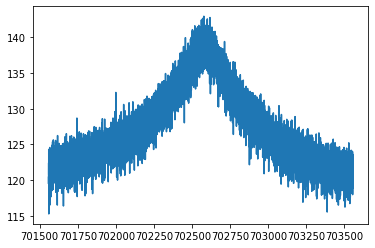

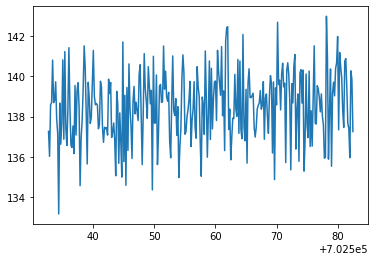

/nuz_trap2_dUvar0.011_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_26.spec


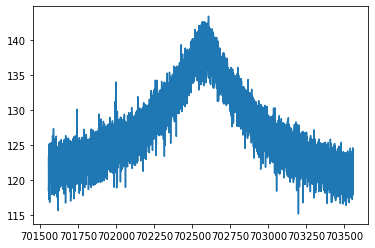

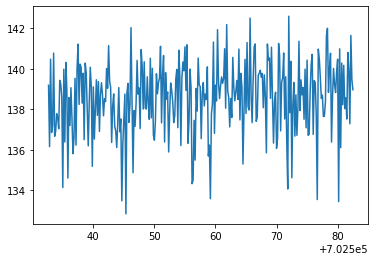

/nuz_trap2_dUvar0.011_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_27.spec


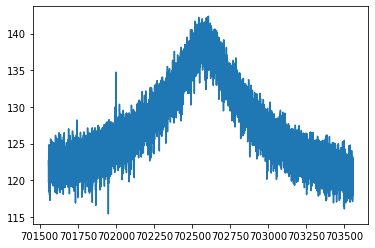

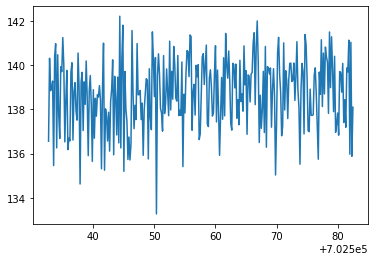

/nuz_trap2_dUvar0.011_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_28.spec


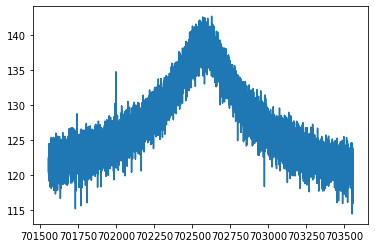

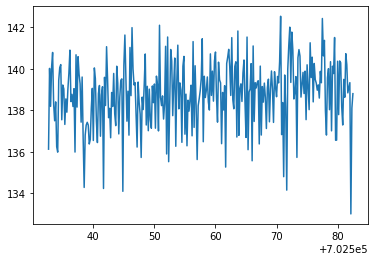

/nuz_trap2_dUvar0.011_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_29.spec


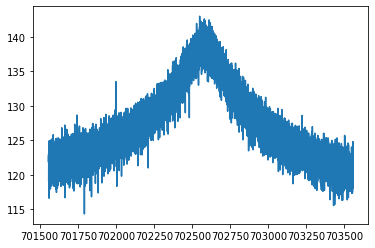

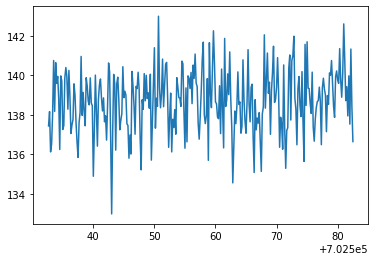

/nuz_trap2_dUvar0.011_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
514,21,20220515_115646.026503,0.011,2,702557.658319298760,0.030581238114,4.340504503969,0.257903090258,2.144237930018,702575.300337795634,5.030711781665,3654.383977429491,34.020142275827
515,22,20220515_122157.444780,0.011,2,702557.596027301159,0.033306899959,3.744515846189,0.264445323009,2.767408416076,702566.342858242453,5.997478715887,3608.544380212340,33.869998060423
516,23,20220515_125854.030439,0.011,2,702557.581723126001,0.029215656407,3.856292205830,0.252394177712,2.548064404412,702582.366367794224,6.150237695586,3416.099141602742,28.982046535402
517,24,20220515_132128.604561,0.011,2,702557.575459075626,0.027196613251,3.546967446364,0.225487409427,2.274972914056,702578.611751898308,5.869339441638,3462.289114893000,29.891495049677


/nuz_trap2_dUvar0.011_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_30.spec


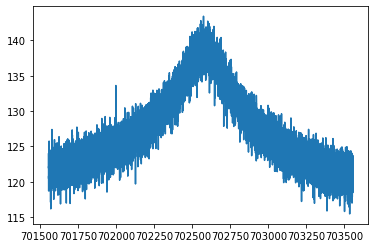

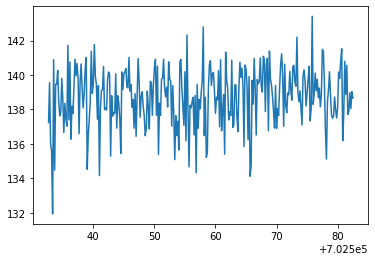

/nuz_trap2_dUvar0.011_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_31.spec


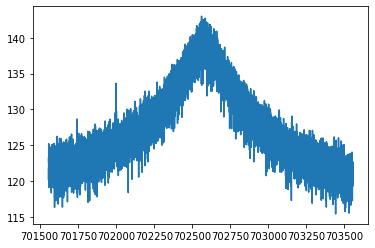

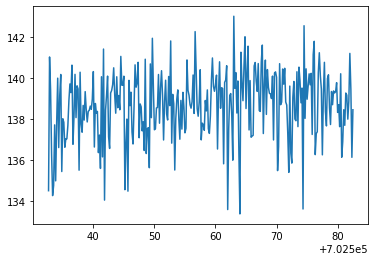

/nuz_trap2_dUvar0.011_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_32.spec


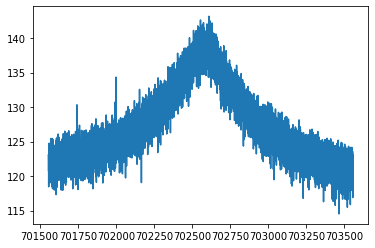

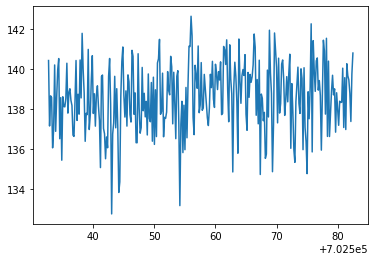

/nuz_trap2_dUvar0.011_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_33.spec


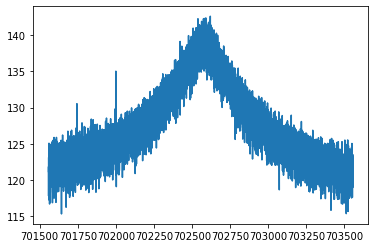

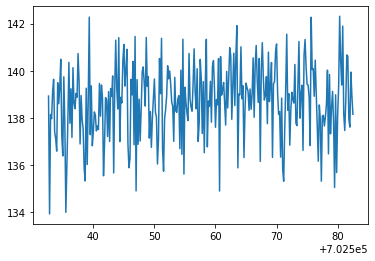

/nuz_trap2_dUvar0.011_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_34.spec


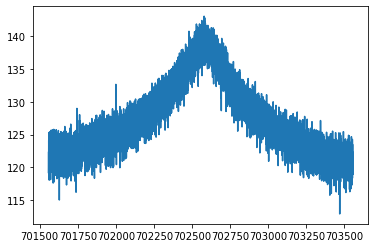

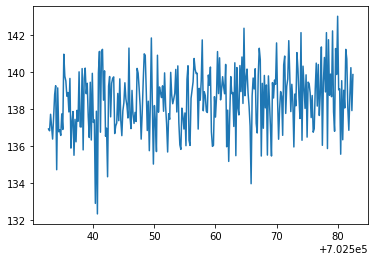

/nuz_trap2_dUvar0.011_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_35.spec


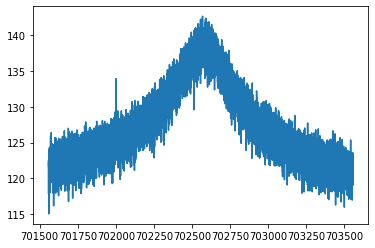

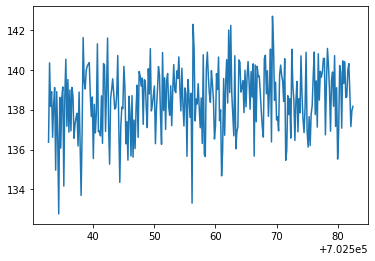

/nuz_trap2_dUvar0.011_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_36.spec


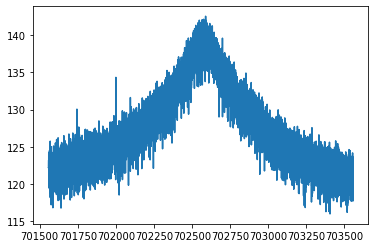

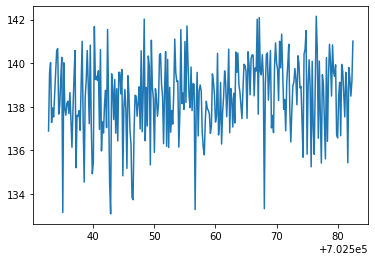

/nuz_trap2_dUvar0.011_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_37.spec


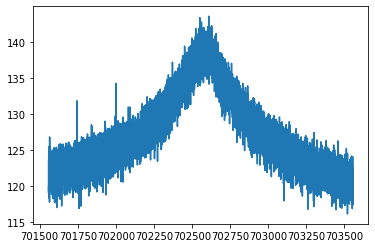

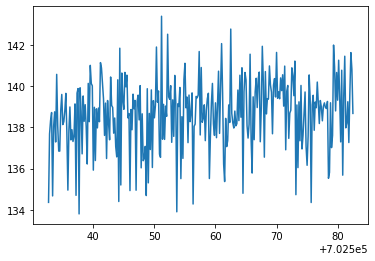

/nuz_trap2_dUvar0.011_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_38.spec


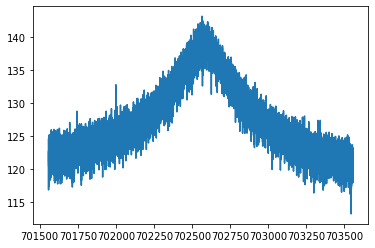

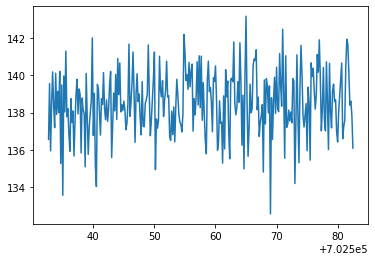

/nuz_trap2_dUvar0.011_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_39.spec


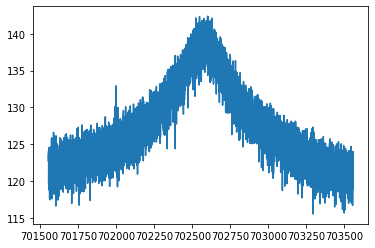

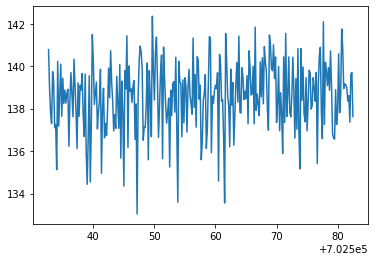

/nuz_trap2_dUvar0.011_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
515,22,20220515_122157.444780,0.011,2,702557.596027301159,0.033306899959,3.744515846189,0.264445323009,2.767408416076,702566.342858242453,5.997478715887,3608.544380212340,33.869998060423
516,23,20220515_125854.030439,0.011,2,702557.581723126001,0.029215656407,3.856292205830,0.252394177712,2.548064404412,702582.366367794224,6.150237695586,3416.099141602742,28.982046535402
517,24,20220515_132128.604561,0.011,2,702557.575459075626,0.027196613251,3.546967446364,0.225487409427,2.274972914056,702578.611751898308,5.869339441638,3462.289114893000,29.891495049677
518,3,20220515_021416.296455,0.011,2,702557.533507349552,0.029955317613,4.056330661040,0.256464164517,2.398940120418,702577.180314859259,5.686532539145,3480.648511442477,30.304593299423


/nuz_trap2_dUvar0.011_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.011_40.spec


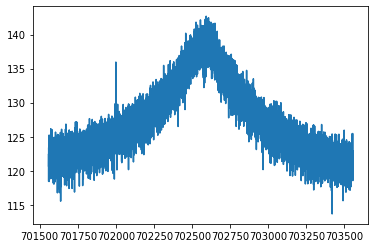

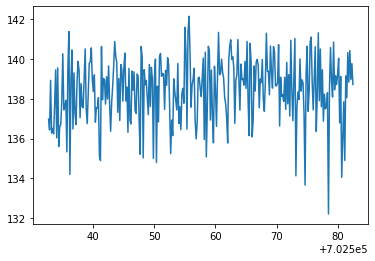

/nuz_trap2_dUvar0.011_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,23,20220515_125854.030439,0.011,2,702557.581723126001,0.029215656407,3.856292205830,0.252394177712,2.548064404412,702582.366367794224,6.150237695586,3416.099141602742,28.982046535402
517,24,20220515_132128.604561,0.011,2,702557.575459075626,0.027196613251,3.546967446364,0.225487409427,2.274972914056,702578.611751898308,5.869339441638,3462.289114893000,29.891495049677
518,3,20220515_021416.296455,0.011,2,702557.533507349552,0.029955317613,4.056330661040,0.256464164517,2.398940120418,702577.180314859259,5.686532539145,3480.648511442477,30.304593299423
519,4,20220515_030009.375947,0.011,2,702557.476310329628,0.034207812034,4.173406130277,0.292476124852,2.987603531642,702582.500130954431,6.597192373006,3357.902089167370,28.483582599429


/nuz_trap2_dUvar0.011_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,24,20220515_132128.604561,0.011,2,702557.575459075626,0.027196613251,3.546967446364,0.225487409427,2.274972914056,702578.611751898308,5.869339441638,3462.289114893000,29.891495049677
518,3,20220515_021416.296455,0.011,2,702557.533507349552,0.029955317613,4.056330661040,0.256464164517,2.398940120418,702577.180314859259,5.686532539145,3480.648511442477,30.304593299423
519,4,20220515_030009.375947,0.011,2,702557.476310329628,0.034207812034,4.173406130277,0.292476124852,2.987603531642,702582.500130954431,6.597192373006,3357.902089167370,28.483582599429
520,5,20220515_031730.374378,0.011,2,702557.637904918054,0.031594505893,3.512723412978,0.256600769729,2.965151534802,702564.275094860932,6.662191621456,3393.147145412050,29.154951396200


/nuz_trap2_dUvar0.011_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
518,3,20220515_021416.296455,0.011,2,702557.533507349552,0.029955317613,4.056330661040,0.256464164517,2.398940120418,702577.180314859259,5.686532539145,3480.648511442477,30.304593299423
519,4,20220515_030009.375947,0.011,2,702557.476310329628,0.034207812034,4.173406130277,0.292476124852,2.987603531642,702582.500130954431,6.597192373006,3357.902089167370,28.483582599429
520,5,20220515_031730.374378,0.011,2,702557.637904918054,0.031594505893,3.512723412978,0.256600769729,2.965151534802,702564.275094860932,6.662191621456,3393.147145412050,29.154951396200
521,6,20220515_035427.022533,0.011,2,702557.537781362073,0.030053698434,3.514985334883,0.247512915852,2.795425764507,702577.926783585106,6.580915772595,3422.416707914162,29.417743132614


/nuz_trap2_dUvar0.011_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
519,4,20220515_030009.375947,0.011,2,702557.476310329628,0.034207812034,4.173406130277,0.292476124852,2.987603531642,702582.500130954431,6.597192373006,3357.902089167370,28.483582599429
520,5,20220515_031730.374378,0.011,2,702557.637904918054,0.031594505893,3.512723412978,0.256600769729,2.965151534802,702564.275094860932,6.662191621456,3393.147145412050,29.154951396200
521,6,20220515_035427.022533,0.011,2,702557.537781362073,0.030053698434,3.514985334883,0.247512915852,2.795425764507,702577.926783585106,6.580915772595,3422.416707914162,29.417743132614
522,7,20220515_043518.854283,0.011,2,702557.599570938386,0.030621834825,4.159490515990,0.272178700787,2.642487245626,702581.903182966053,6.123273453637,3386.699364938399,28.947960632821


/nuz_trap2_dUvar0.011_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
520,5,20220515_031730.374378,0.011,2,702557.637904918054,0.031594505893,3.512723412978,0.256600769729,2.965151534802,702564.275094860932,6.662191621456,3393.147145412050,29.154951396200
521,6,20220515_035427.022533,0.011,2,702557.537781362073,0.030053698434,3.514985334883,0.247512915852,2.795425764507,702577.926783585106,6.580915772595,3422.416707914162,29.417743132614
522,7,20220515_043518.854283,0.011,2,702557.599570938386,0.030621834825,4.159490515990,0.272178700787,2.642487245626,702581.903182966053,6.123273453637,3386.699364938399,28.947960632821
523,8,20220515_050938.758892,0.011,2,702557.644332713098,0.032921709028,3.600776785141,0.269637784545,3.176650109725,702570.717499683145,6.892984780876,3392.886408973347,28.689443099672


/nuz_trap2_dUvar0.01_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
521,6,20220515_035427.022533,0.011,2,702557.537781362073,0.030053698434,3.514985334883,0.247512915852,2.795425764507,702577.926783585106,6.580915772595,3422.416707914162,29.417743132614
522,7,20220515_043518.854283,0.011,2,702557.599570938386,0.030621834825,4.159490515990,0.272178700787,2.642487245626,702581.903182966053,6.123273453637,3386.699364938399,28.947960632821
523,8,20220515_050938.758892,0.011,2,702557.644332713098,0.032921709028,3.600776785141,0.269637784545,3.176650109725,702570.717499683145,6.892984780876,3392.886408973347,28.689443099672
524,9,20220515_054912.017953,0.011,2,702557.585208560573,0.033356631453,3.834065765888,0.285187801113,3.262735150496,702581.335459543508,6.977390679111,3404.862587178941,29.396412352461


/nuz_trap2_dUvar0.01_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,7,20220515_043518.854283,0.011,2,702557.599570938386,0.030621834825,4.159490515990,0.272178700787,2.642487245626,702581.903182966053,6.123273453637,3386.699364938399,28.947960632821
523,8,20220515_050938.758892,0.011,2,702557.644332713098,0.032921709028,3.600776785141,0.269637784545,3.176650109725,702570.717499683145,6.892984780876,3392.886408973347,28.689443099672
524,9,20220515_054912.017953,0.011,2,702557.585208560573,0.033356631453,3.834065765888,0.285187801113,3.262735150496,702581.335459543508,6.977390679111,3404.862587178941,29.396412352461
525,1,20220515_013702.853172,0.010,2,702557.636016607517,0.032526214824,4.256082194040,0.287912746618,2.763588894107,702566.802713862155,6.059687087090,3350.875369821001,28.831337404954


/nuz_trap2_dUvar0.01_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
523,8,20220515_050938.758892,0.011,2,702557.644332713098,0.032921709028,3.600776785141,0.269637784545,3.176650109725,702570.717499683145,6.892984780876,3392.886408973347,28.689443099672
524,9,20220515_054912.017953,0.011,2,702557.585208560573,0.033356631453,3.834065765888,0.285187801113,3.262735150496,702581.335459543508,6.977390679111,3404.862587178941,29.396412352461
525,1,20220515_013702.853172,0.010,2,702557.636016607517,0.032526214824,4.256082194040,0.287912746618,2.763588894107,702566.802713862155,6.059687087090,3350.875369821001,28.831337404954
526,10,20220515_061028.146655,0.010,2,702557.677140450687,0.029105843048,4.004150714462,0.251061805233,2.375813430593,702576.139282852295,5.723487287585,3435.459954048095,29.569347046339


/nuz_trap2_dUvar0.01_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
524,9,20220515_054912.017953,0.011,2,702557.585208560573,0.033356631453,3.834065765888,0.285187801113,3.262735150496,702581.335459543508,6.977390679111,3404.862587178941,29.396412352461
525,1,20220515_013702.853172,0.010,2,702557.636016607517,0.032526214824,4.256082194040,0.287912746618,2.763588894107,702566.802713862155,6.059687087090,3350.875369821001,28.831337404954
526,10,20220515_061028.146655,0.010,2,702557.677140450687,0.029105843048,4.004150714462,0.251061805233,2.375813430593,702576.139282852295,5.723487287585,3435.459954048095,29.569347046339
527,11,20220515_065001.403669,0.010,2,702557.581505079870,0.033350016373,3.906524509318,0.285405309384,3.157330875386,702579.802802415332,6.832072350581,3378.785180298744,28.867673431154


/nuz_trap2_dUvar0.01_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
525,1,20220515_013702.853172,0.010,2,702557.636016607517,0.032526214824,4.256082194040,0.287912746618,2.763588894107,702566.802713862155,6.059687087090,3350.875369821001,28.831337404954
526,10,20220515_061028.146655,0.010,2,702557.677140450687,0.029105843048,4.004150714462,0.251061805233,2.375813430593,702576.139282852295,5.723487287585,3435.459954048095,29.569347046339
527,11,20220515_065001.403669,0.010,2,702557.581505079870,0.033350016373,3.906524509318,0.285405309384,3.157330875386,702579.802802415332,6.832072350581,3378.785180298744,28.867673431154
528,12,20220515_070327.418634,0.010,2,702557.662933866028,0.033526323240,4.511836091317,0.301230627682,2.795168291435,702575.088918725029,5.898739182132,3460.337917174599,29.654606050672


/nuz_trap2_dUvar0.01_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
526,10,20220515_061028.146655,0.010,2,702557.677140450687,0.029105843048,4.004150714462,0.251061805233,2.375813430593,702576.139282852295,5.723487287585,3435.459954048095,29.569347046339
527,11,20220515_065001.403669,0.010,2,702557.581505079870,0.033350016373,3.906524509318,0.285405309384,3.157330875386,702579.802802415332,6.832072350581,3378.785180298744,28.867673431154
528,12,20220515_070327.418634,0.010,2,702557.662933866028,0.033526323240,4.511836091317,0.301230627682,2.795168291435,702575.088918725029,5.898739182132,3460.337917174599,29.654606050672
529,13,20220515_072957.055584,0.010,2,702557.589778521913,0.027102071728,3.860092793355,0.234484189788,2.185229164251,702579.356196781504,5.654340284119,3403.221463427348,29.234867985276


/nuz_trap2_dUvar0.01_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
527,11,20220515_065001.403669,0.010,2,702557.581505079870,0.033350016373,3.906524509318,0.285405309384,3.157330875386,702579.802802415332,6.832072350581,3378.785180298744,28.867673431154
528,12,20220515_070327.418634,0.010,2,702557.662933866028,0.033526323240,4.511836091317,0.301230627682,2.795168291435,702575.088918725029,5.898739182132,3460.337917174599,29.654606050672
529,13,20220515_072957.055584,0.010,2,702557.589778521913,0.027102071728,3.860092793355,0.234484189788,2.185229164251,702579.356196781504,5.654340284119,3403.221463427348,29.234867985276
530,14,20220515_081443.906248,0.010,2,702557.654713172000,0.033341110423,4.166895055695,0.287931381859,2.878937989516,702571.841843094327,6.142443329708,3445.520866097675,30.011756625591


/nuz_trap2_dUvar0.01_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
528,12,20220515_070327.418634,0.010,2,702557.662933866028,0.033526323240,4.511836091317,0.301230627682,2.795168291435,702575.088918725029,5.898739182132,3460.337917174599,29.654606050672
529,13,20220515_072957.055584,0.010,2,702557.589778521913,0.027102071728,3.860092793355,0.234484189788,2.185229164251,702579.356196781504,5.654340284119,3403.221463427348,29.234867985276
530,14,20220515_081443.906248,0.010,2,702557.654713172000,0.033341110423,4.166895055695,0.287931381859,2.878937989516,702571.841843094327,6.142443329708,3445.520866097675,30.011756625591
531,15,20220515_084627.014085,0.010,2,702557.571763342828,0.029460092906,4.133255044145,0.265154066581,2.545517833595,702581.760450704955,5.973591735449,3410.431439854089,28.994486349077


/nuz_trap2_dUvar0.01_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
529,13,20220515_072957.055584,0.010,2,702557.589778521913,0.027102071728,3.860092793355,0.234484189788,2.185229164251,702579.356196781504,5.654340284119,3403.221463427348,29.234867985276
530,14,20220515_081443.906248,0.010,2,702557.654713172000,0.033341110423,4.166895055695,0.287931381859,2.878937989516,702571.841843094327,6.142443329708,3445.520866097675,30.011756625591
531,15,20220515_084627.014085,0.010,2,702557.571763342828,0.029460092906,4.133255044145,0.265154066581,2.545517833595,702581.760450704955,5.973591735449,3410.431439854089,28.994486349077
532,16,20220515_091138.426825,0.010,2,702557.523393995012,0.035902768705,3.898156360041,0.302138269089,3.540004066460,702576.548562660348,7.060104302591,3446.646331647619,29.610628411435


/nuz_trap2_dUvar0.01_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
530,14,20220515_081443.906248,0.010,2,702557.654713172000,0.033341110423,4.166895055695,0.287931381859,2.878937989516,702571.841843094327,6.142443329708,3445.520866097675,30.011756625591
531,15,20220515_084627.014085,0.010,2,702557.571763342828,0.029460092906,4.133255044145,0.265154066581,2.545517833595,702581.760450704955,5.973591735449,3410.431439854089,28.994486349077
532,16,20220515_091138.426825,0.010,2,702557.523393995012,0.035902768705,3.898156360041,0.302138269089,3.540004066460,702576.548562660348,7.060104302591,3446.646331647619,29.610628411435
533,17,20220515_094044.829048,0.010,2,702557.641458196798,0.031936517381,3.789842186789,0.270726839991,3.009523366954,702577.854138143477,6.760540985569,3344.917716128602,28.366988851706


/nuz_trap2_dUvar0.01_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
531,15,20220515_084627.014085,0.010,2,702557.571763342828,0.029460092906,4.133255044145,0.265154066581,2.545517833595,702581.760450704955,5.973591735449,3410.431439854089,28.994486349077
532,16,20220515_091138.426825,0.010,2,702557.523393995012,0.035902768705,3.898156360041,0.302138269089,3.540004066460,702576.548562660348,7.060104302591,3446.646331647619,29.610628411435
533,17,20220515_094044.829048,0.010,2,702557.641458196798,0.031936517381,3.789842186789,0.270726839991,3.009523366954,702577.854138143477,6.760540985569,3344.917716128602,28.366988851706
534,18,20220515_103045.170539,0.010,2,702557.535363451578,0.031258626245,3.790068052191,0.265993472804,2.908345745122,702580.344076279900,6.521497082228,3447.987244679139,29.497955407629


/nuz_trap2_dUvar0.01_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
532,16,20220515_091138.426825,0.010,2,702557.523393995012,0.035902768705,3.898156360041,0.302138269089,3.540004066460,702576.548562660348,7.060104302591,3446.646331647619,29.610628411435
533,17,20220515_094044.829048,0.010,2,702557.641458196798,0.031936517381,3.789842186789,0.270726839991,3.009523366954,702577.854138143477,6.760540985569,3344.917716128602,28.366988851706
534,18,20220515_103045.170539,0.010,2,702557.535363451578,0.031258626245,3.790068052191,0.265993472804,2.908345745122,702580.344076279900,6.521497082228,3447.987244679139,29.497955407629
535,19,20220515_104134.319603,0.010,2,702557.525372282136,0.033576083305,4.091761227261,0.278566534983,2.763840601217,702577.373325318680,5.793336385236,3707.198388802631,34.793259727966


/nuz_trap2_dUvar0.01_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
533,17,20220515_094044.829048,0.010,2,702557.641458196798,0.031936517381,3.789842186789,0.270726839991,3.009523366954,702577.854138143477,6.760540985569,3344.917716128602,28.366988851706
534,18,20220515_103045.170539,0.010,2,702557.535363451578,0.031258626245,3.790068052191,0.265993472804,2.908345745122,702580.344076279900,6.521497082228,3447.987244679139,29.497955407629
535,19,20220515_104134.319603,0.010,2,702557.525372282136,0.033576083305,4.091761227261,0.278566534983,2.763840601217,702577.373325318680,5.793336385236,3707.198388802631,34.793259727966
536,2,20220515_015145.070826,0.010,2,702557.652403702028,0.032763692131,4.442029539306,0.279800335232,2.452497987348,702578.492818183382,5.445607971408,3608.048517516255,32.910706906249


/nuz_trap2_dUvar0.01_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
534,18,20220515_103045.170539,0.010,2,702557.535363451578,0.031258626245,3.790068052191,0.265993472804,2.908345745122,702580.344076279900,6.521497082228,3447.987244679139,29.497955407629
535,19,20220515_104134.319603,0.010,2,702557.525372282136,0.033576083305,4.091761227261,0.278566534983,2.763840601217,702577.373325318680,5.793336385236,3707.198388802631,34.793259727966
536,2,20220515_015145.070826,0.010,2,702557.652403702028,0.032763692131,4.442029539306,0.279800335232,2.452497987348,702578.492818183382,5.445607971408,3608.048517516255,32.910706906249
537,20,20220515_111712.618952,0.010,2,702557.576055899728,0.031181560832,3.586003476365,0.260646227404,2.951130254109,702566.001966174925,6.536462700963,3424.720688915854,29.646924243221


/nuz_trap2_dUvar0.01_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
535,19,20220515_104134.319603,0.010,2,702557.525372282136,0.033576083305,4.091761227261,0.278566534983,2.763840601217,702577.373325318680,5.793336385236,3707.198388802631,34.793259727966
536,2,20220515_015145.070826,0.010,2,702557.652403702028,0.032763692131,4.442029539306,0.279800335232,2.452497987348,702578.492818183382,5.445607971408,3608.048517516255,32.910706906249
537,20,20220515_111712.618952,0.010,2,702557.576055899728,0.031181560832,3.586003476365,0.260646227404,2.951130254109,702566.001966174925,6.536462700963,3424.720688915854,29.646924243221
538,21,20220515_120713.117813,0.010,2,702557.685610690736,0.031135090243,3.842149045325,0.261231804974,2.746453593145,702580.076174613438,6.324305826957,3441.786715288913,29.758062405787


/nuz_trap2_dUvar0.01_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
536,2,20220515_015145.070826,0.010,2,702557.652403702028,0.032763692131,4.442029539306,0.279800335232,2.452497987348,702578.492818183382,5.445607971408,3608.048517516255,32.910706906249
537,20,20220515_111712.618952,0.010,2,702557.576055899728,0.031181560832,3.586003476365,0.260646227404,2.951130254109,702566.001966174925,6.536462700963,3424.720688915854,29.646924243221
538,21,20220515_120713.117813,0.010,2,702557.685610690736,0.031135090243,3.842149045325,0.261231804974,2.746453593145,702580.076174613438,6.324305826957,3441.786715288913,29.758062405787
539,22,20220515_124409.722832,0.010,2,702557.616753612761,0.033950158474,4.283043606059,0.295117466105,2.917550702032,702578.206659090007,6.083190700567,3539.811509696853,31.980528120586


/nuz_trap2_dUvar0.01_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
537,20,20220515_111712.618952,0.010,2,702557.576055899728,0.031181560832,3.586003476365,0.260646227404,2.951130254109,702566.001966174925,6.536462700963,3424.720688915854,29.646924243221
538,21,20220515_120713.117813,0.010,2,702557.685610690736,0.031135090243,3.842149045325,0.261231804974,2.746453593145,702580.076174613438,6.324305826957,3441.786715288913,29.758062405787
539,22,20220515_124409.722832,0.010,2,702557.616753612761,0.033950158474,4.283043606059,0.295117466105,2.917550702032,702578.206659090007,6.083190700567,3539.811509696853,31.980528120586
540,23,20220515_131316.139144,0.010,2,702557.634489902761,0.036190608510,3.938252226945,0.299077162645,3.400811266502,702576.368650285294,6.528724050409,3680.149724424669,34.304617695707


/nuz_trap2_dUvar0.01_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_25.spec


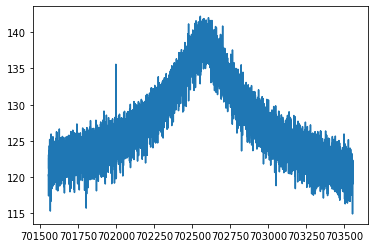

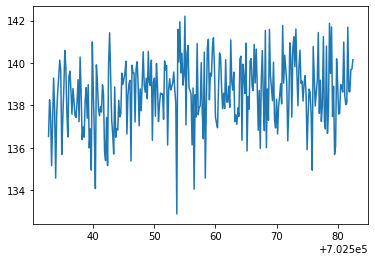

/nuz_trap2_dUvar0.01_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_26.spec


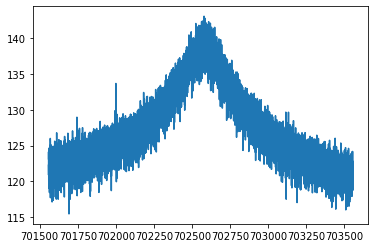

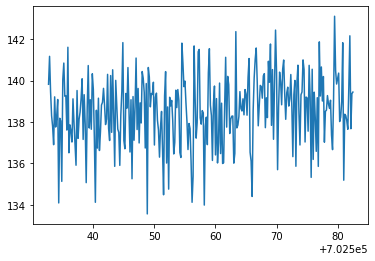

/nuz_trap2_dUvar0.01_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_27.spec


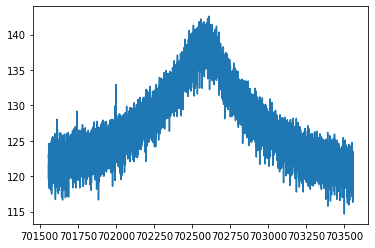

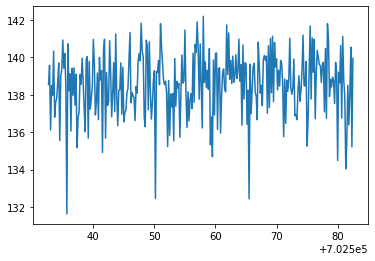

/nuz_trap2_dUvar0.01_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_28.spec


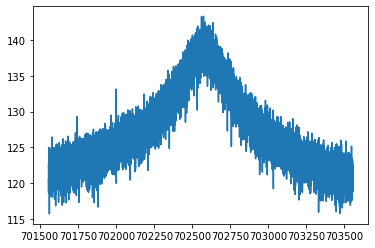

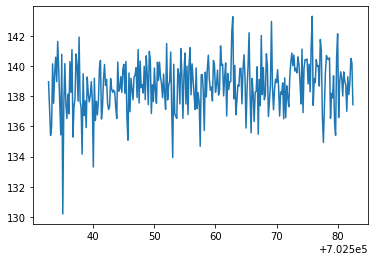

/nuz_trap2_dUvar0.01_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_29.spec


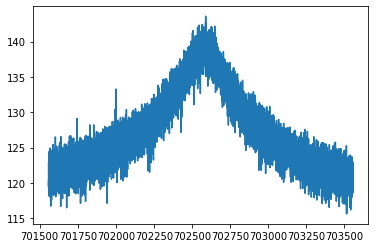

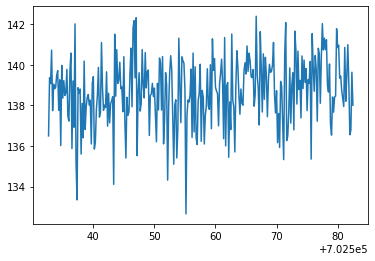

/nuz_trap2_dUvar0.01_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
538,21,20220515_120713.117813,0.010,2,702557.685610690736,0.031135090243,3.842149045325,0.261231804974,2.746453593145,702580.076174613438,6.324305826957,3441.786715288913,29.758062405787
539,22,20220515_124409.722832,0.010,2,702557.616753612761,0.033950158474,4.283043606059,0.295117466105,2.917550702032,702578.206659090007,6.083190700567,3539.811509696853,31.980528120586
540,23,20220515_131316.139144,0.010,2,702557.634489902761,0.036190608510,3.938252226945,0.299077162645,3.400811266502,702576.368650285294,6.528724050409,3680.149724424669,34.304617695707
541,24,20220515_133313.951780,0.010,2,702557.565297033405,0.026689939255,3.611731163489,0.231999703159,2.391681524761,702580.230297866510,6.089388281168,3385.661207951151,28.778737453587


/nuz_trap2_dUvar0.01_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_30.spec


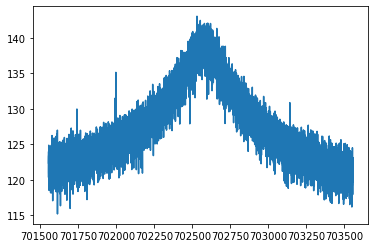

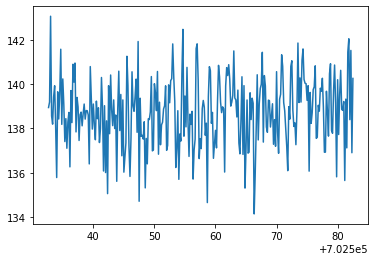

/nuz_trap2_dUvar0.01_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_31.spec


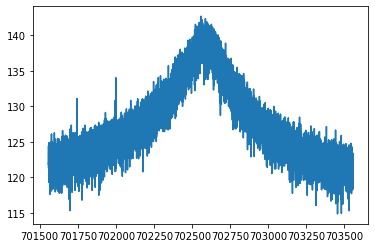

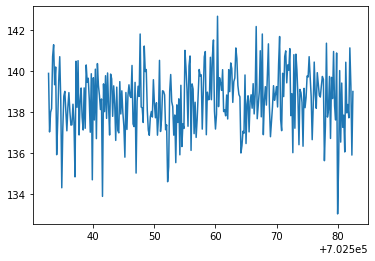

/nuz_trap2_dUvar0.01_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_32.spec


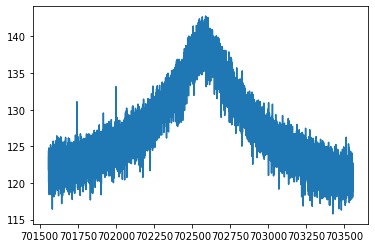

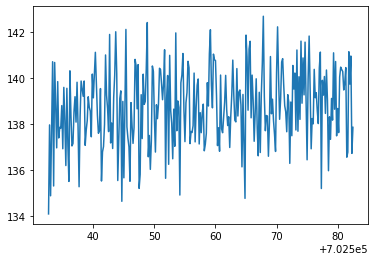

/nuz_trap2_dUvar0.01_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_33.spec


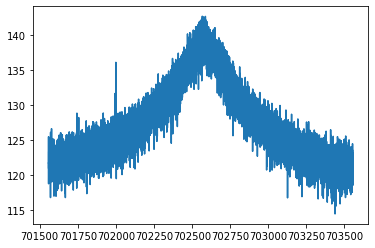

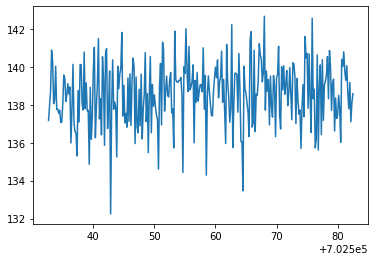

/nuz_trap2_dUvar0.01_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_34.spec


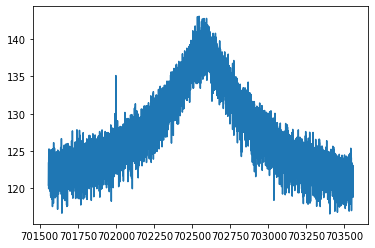

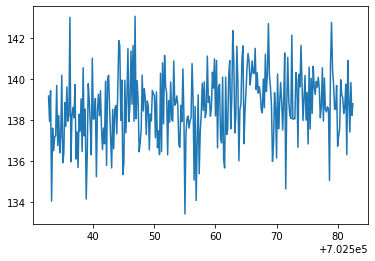

/nuz_trap2_dUvar0.01_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_35.spec


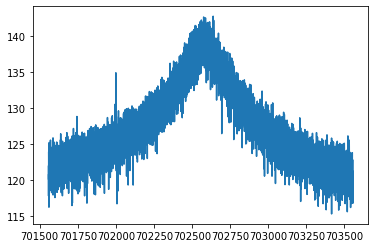

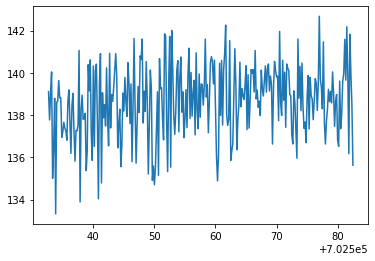

/nuz_trap2_dUvar0.01_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_36.spec


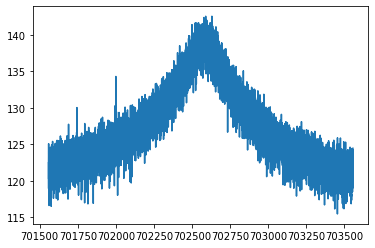

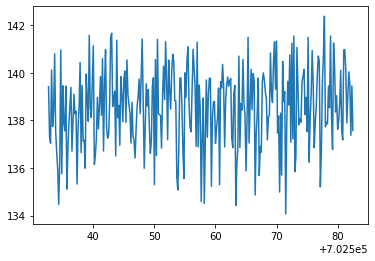

/nuz_trap2_dUvar0.01_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_37.spec


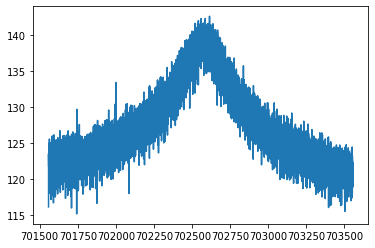

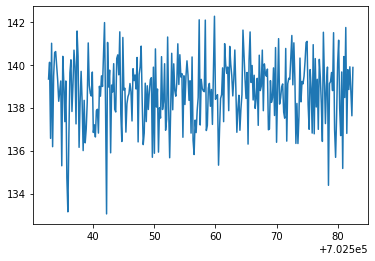

/nuz_trap2_dUvar0.01_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_38.spec


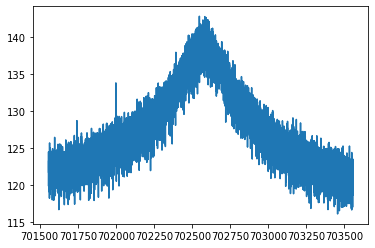

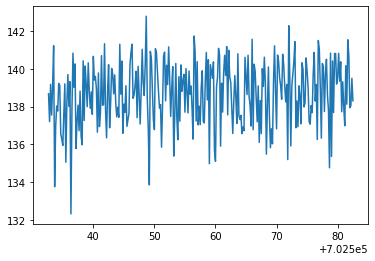

/nuz_trap2_dUvar0.01_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_39.spec


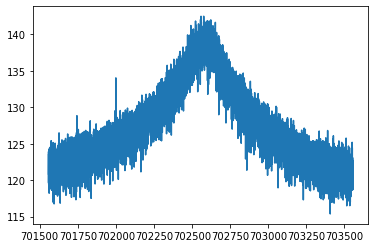

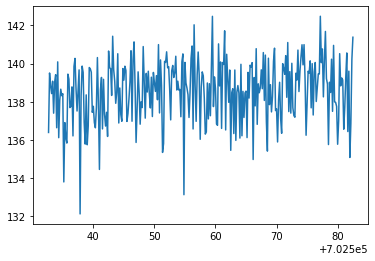

/nuz_trap2_dUvar0.01_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
539,22,20220515_124409.722832,0.010,2,702557.616753612761,0.033950158474,4.283043606059,0.295117466105,2.917550702032,702578.206659090007,6.083190700567,3539.811509696853,31.980528120586
540,23,20220515_131316.139144,0.010,2,702557.634489902761,0.036190608510,3.938252226945,0.299077162645,3.400811266502,702576.368650285294,6.528724050409,3680.149724424669,34.304617695707
541,24,20220515_133313.951780,0.010,2,702557.565297033405,0.026689939255,3.611731163489,0.231999703159,2.391681524761,702580.230297866510,6.089388281168,3385.661207951151,28.778737453587
542,3,20220515_021810.870143,0.010,2,702557.587473108666,0.033044764138,3.728912656600,0.263083806943,2.810513788738,702578.743102719076,6.287719779961,3569.648737203761,33.808796398188


/nuz_trap2_dUvar0.01_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.01_40.spec


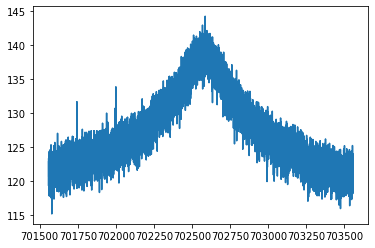

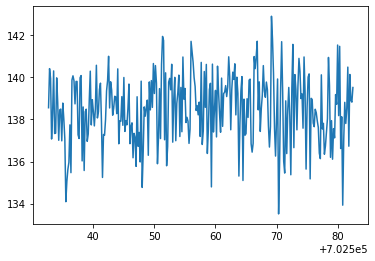

/nuz_trap2_dUvar0.01_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
540,23,20220515_131316.139144,0.010,2,702557.634489902761,0.036190608510,3.938252226945,0.299077162645,3.400811266502,702576.368650285294,6.528724050409,3680.149724424669,34.304617695707
541,24,20220515_133313.951780,0.010,2,702557.565297033405,0.026689939255,3.611731163489,0.231999703159,2.391681524761,702580.230297866510,6.089388281168,3385.661207951151,28.778737453587
542,3,20220515_021810.870143,0.010,2,702557.587473108666,0.033044764138,3.728912656600,0.263083806943,2.810513788738,702578.743102719076,6.287719779961,3569.648737203761,33.808796398188
543,4,20220515_030246.090630,0.010,2,702557.531429294962,0.029493441708,3.980392557156,0.249343720424,2.334091619073,702579.990068792133,5.918000333181,3333.634161575588,28.700134824904


/nuz_trap2_dUvar0.01_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
541,24,20220515_133313.951780,0.010,2,702557.565297033405,0.026689939255,3.611731163489,0.231999703159,2.391681524761,702580.230297866510,6.089388281168,3385.661207951151,28.778737453587
542,3,20220515_021810.870143,0.010,2,702557.587473108666,0.033044764138,3.728912656600,0.263083806943,2.810513788738,702578.743102719076,6.287719779961,3569.648737203761,33.808796398188
543,4,20220515_030246.090630,0.010,2,702557.531429294962,0.029493441708,3.980392557156,0.249343720424,2.334091619073,702579.990068792133,5.918000333181,3333.634161575588,28.700134824904
544,5,20220515_032125.521594,0.010,2,702557.554389876546,0.034625794106,4.307967467446,0.309380896678,3.145353870882,702572.016652334132,6.408965325126,3397.780025096093,29.011134749002


/nuz_trap2_dUvar0.01_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
542,3,20220515_021810.870143,0.010,2,702557.587473108666,0.033044764138,3.728912656600,0.263083806943,2.810513788738,702578.743102719076,6.287719779961,3569.648737203761,33.808796398188
543,4,20220515_030246.090630,0.010,2,702557.531429294962,0.029493441708,3.980392557156,0.249343720424,2.334091619073,702579.990068792133,5.918000333181,3333.634161575588,28.700134824904
544,5,20220515_032125.521594,0.010,2,702557.554389876546,0.034625794106,4.307967467446,0.309380896678,3.145353870882,702572.016652334132,6.408965325126,3397.780025096093,29.011134749002
545,6,20220515_035940.727647,0.010,2,702557.594735106453,0.031127174322,3.756448280489,0.262525051831,2.798354313544,702567.792011205223,6.013966514435,3588.042976213243,32.590484923262


/nuz_trap2_dUvar0.01_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
543,4,20220515_030246.090630,0.010,2,702557.531429294962,0.029493441708,3.980392557156,0.249343720424,2.334091619073,702579.990068792133,5.918000333181,3333.634161575588,28.700134824904
544,5,20220515_032125.521594,0.010,2,702557.554389876546,0.034625794106,4.307967467446,0.309380896678,3.145353870882,702572.016652334132,6.408965325126,3397.780025096093,29.011134749002
545,6,20220515_035940.727647,0.010,2,702557.594735106453,0.031127174322,3.756448280489,0.262525051831,2.798354313544,702567.792011205223,6.013966514435,3588.042976213243,32.590484923262
546,7,20220515_042451.958419,0.010,2,702557.655094969436,0.035110648842,3.746401317886,0.287720717645,3.371068787507,702565.577790896292,6.637459408871,3570.374580144257,32.553611708226


/nuz_trap2_dUvar0.01_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
544,5,20220515_032125.521594,0.010,2,702557.554389876546,0.034625794106,4.307967467446,0.309380896678,3.145353870882,702572.016652334132,6.408965325126,3397.780025096093,29.011134749002
545,6,20220515_035940.727647,0.010,2,702557.594735106453,0.031127174322,3.756448280489,0.262525051831,2.798354313544,702567.792011205223,6.013966514435,3588.042976213243,32.590484923262
546,7,20220515_042451.958419,0.010,2,702557.655094969436,0.035110648842,3.746401317886,0.287720717645,3.371068787507,702565.577790896292,6.637459408871,3570.374580144257,32.553611708226
547,8,20220515_045911.777030,0.010,2,702557.631385723711,0.031802884595,3.831405622779,0.268275838441,2.889376362143,702578.019685886800,6.466118286147,3430.273907181513,29.515656808960


/nuz_trap2_dUvar0.0_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
545,6,20220515_035940.727647,0.010,2,702557.594735106453,0.031127174322,3.756448280489,0.262525051831,2.798354313544,702567.792011205223,6.013966514435,3588.042976213243,32.590484923262
546,7,20220515_042451.958419,0.010,2,702557.655094969436,0.035110648842,3.746401317886,0.287720717645,3.371068787507,702565.577790896292,6.637459408871,3570.374580144257,32.553611708226
547,8,20220515_045911.777030,0.010,2,702557.631385723711,0.031802884595,3.831405622779,0.268275838441,2.889376362143,702578.019685886800,6.466118286147,3430.273907181513,29.515656808960
548,9,20220515_053449.984390,0.010,2,702557.722673303797,0.033401374717,3.777098074403,0.285440079467,3.329779972301,702574.100305005442,6.970944804041,3386.712510025566,29.071924586224


/nuz_trap2_dUvar0.0_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
546,7,20220515_042451.958419,0.010,2,702557.655094969436,0.035110648842,3.746401317886,0.287720717645,3.371068787507,702565.577790896292,6.637459408871,3570.374580144257,32.553611708226
547,8,20220515_045911.777030,0.010,2,702557.631385723711,0.031802884595,3.831405622779,0.268275838441,2.889376362143,702578.019685886800,6.466118286147,3430.273907181513,29.515656808960
548,9,20220515_053449.984390,0.010,2,702557.722673303797,0.033401374717,3.777098074403,0.285440079467,3.329779972301,702574.100305005442,6.970944804041,3386.712510025566,29.071924586224
549,1,20220515_013150.109364,0.000,2,702557.631513142725,0.034018267357,4.769409332073,0.317422783533,2.768898761968,702563.851593604195,5.482207809024,3566.236383581920,31.125843077028


/nuz_trap2_dUvar0.0_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
547,8,20220515_045911.777030,0.010,2,702557.631385723711,0.031802884595,3.831405622779,0.268275838441,2.889376362143,702578.019685886800,6.466118286147,3430.273907181513,29.515656808960
548,9,20220515_053449.984390,0.010,2,702557.722673303797,0.033401374717,3.777098074403,0.285440079467,3.329779972301,702574.100305005442,6.970944804041,3386.712510025566,29.071924586224
549,1,20220515_013150.109364,0.000,2,702557.631513142725,0.034018267357,4.769409332073,0.317422783533,2.768898761968,702563.851593604195,5.482207809024,3566.236383581920,31.125843077028
550,10,20220515_055842.798231,0.000,2,702557.667062359629,0.033290733432,4.416247854582,0.300375469803,2.855322552730,702567.929055648274,5.884886998837,3475.354026392152,29.620818738997


/nuz_trap2_dUvar0.0_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
548,9,20220515_053449.984390,0.010,2,702557.722673303797,0.033401374717,3.777098074403,0.285440079467,3.329779972301,702574.100305005442,6.970944804041,3386.712510025566,29.071924586224
549,1,20220515_013150.109364,0.000,2,702557.631513142725,0.034018267357,4.769409332073,0.317422783533,2.768898761968,702563.851593604195,5.482207809024,3566.236383581920,31.125843077028
550,10,20220515_055842.798231,0.000,2,702557.667062359629,0.033290733432,4.416247854582,0.300375469803,2.855322552730,702567.929055648274,5.884886998837,3475.354026392152,29.620818738997
551,11,20220515_063144.296560,0.000,2,702557.722899081185,0.032518144587,3.676292947859,0.268471473371,2.992180112831,702552.658791019581,6.233568113850,3594.133779867265,31.720264700691


/nuz_trap2_dUvar0.0_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
549,1,20220515_013150.109364,0.000,2,702557.631513142725,0.034018267357,4.769409332073,0.317422783533,2.768898761968,702563.851593604195,5.482207809024,3566.236383581920,31.125843077028
550,10,20220515_055842.798231,0.000,2,702557.667062359629,0.033290733432,4.416247854582,0.300375469803,2.855322552730,702567.929055648274,5.884886998837,3475.354026392152,29.620818738997
551,11,20220515_063144.296560,0.000,2,702557.722899081185,0.032518144587,3.676292947859,0.268471473371,2.992180112831,702552.658791019581,6.233568113850,3594.133779867265,31.720264700691
552,12,20220515_070722.526423,0.000,2,702557.599396135891,0.026423609754,3.731183971993,0.230751007787,2.207740021064,702559.720008042641,5.404313548068,3502.566252456441,30.120703898874


/nuz_trap2_dUvar0.0_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
550,10,20220515_055842.798231,0.000,2,702557.667062359629,0.033290733432,4.416247854582,0.300375469803,2.855322552730,702567.929055648274,5.884886998837,3475.354026392152,29.620818738997
551,11,20220515_063144.296560,0.000,2,702557.722899081185,0.032518144587,3.676292947859,0.268471473371,2.992180112831,702552.658791019581,6.233568113850,3594.133779867265,31.720264700691
552,12,20220515_070722.526423,0.000,2,702557.599396135891,0.026423609754,3.731183971993,0.230751007787,2.207740021064,702559.720008042641,5.404313548068,3502.566252456441,30.120703898874
553,13,20220515_073115.453149,0.000,2,702557.602691605221,0.030727835861,3.727717021542,0.261785822432,2.818569883070,702561.596168719814,6.127706008417,3506.425772525456,29.937490782083


/nuz_trap2_dUvar0.0_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
551,11,20220515_063144.296560,0.000,2,702557.722899081185,0.032518144587,3.676292947859,0.268471473371,2.992180112831,702552.658791019581,6.233568113850,3594.133779867265,31.720264700691
552,12,20220515_070722.526423,0.000,2,702557.599396135891,0.026423609754,3.731183971993,0.230751007787,2.207740021064,702559.720008042641,5.404313548068,3502.566252456441,30.120703898874
553,13,20220515_073115.453149,0.000,2,702557.602691605221,0.030727835861,3.727717021542,0.261785822432,2.818569883070,702561.596168719814,6.127706008417,3506.425772525456,29.937490782083
554,14,20220515_082115.869132,0.000,2,702557.607035714318,0.028263522169,3.499317947536,0.237093275428,2.562176853194,702567.276475296705,6.147466226885,3424.628317103597,29.062630800744


/nuz_trap2_dUvar0.0_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
552,12,20220515_070722.526423,0.000,2,702557.599396135891,0.026423609754,3.731183971993,0.230751007787,2.207740021064,702559.720008042641,5.404313548068,3502.566252456441,30.120703898874
553,13,20220515_073115.453149,0.000,2,702557.602691605221,0.030727835861,3.727717021542,0.261785822432,2.818569883070,702561.596168719814,6.127706008417,3506.425772525456,29.937490782083
554,14,20220515_082115.869132,0.000,2,702557.607035714318,0.028263522169,3.499317947536,0.237093275428,2.562176853194,702567.276475296705,6.147466226885,3424.628317103597,29.062630800744
555,15,20220515_084350.263526,0.000,2,702557.558747013914,0.030177955037,3.343252405371,0.247212063701,2.972325864421,702569.019750323263,6.522704120594,3568.275082795615,30.584411918722


/nuz_trap2_dUvar0.0_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
553,13,20220515_073115.453149,0.000,2,702557.602691605221,0.030727835861,3.727717021542,0.261785822432,2.818569883070,702561.596168719814,6.127706008417,3506.425772525456,29.937490782083
554,14,20220515_082115.869132,0.000,2,702557.607035714318,0.028263522169,3.499317947536,0.237093275428,2.562176853194,702567.276475296705,6.147466226885,3424.628317103597,29.062630800744
555,15,20220515_084350.263526,0.000,2,702557.558747013914,0.030177955037,3.343252405371,0.247212063701,2.972325864421,702569.019750323263,6.522704120594,3568.275082795615,30.584411918722
556,16,20220515_091651.895477,0.000,2,702557.594335619360,0.028864044245,3.765758163381,0.252996386295,2.611768823628,702555.417650868767,5.924548949560,3459.539281444465,29.284498859922


/nuz_trap2_dUvar0.0_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
554,14,20220515_082115.869132,0.000,2,702557.607035714318,0.028263522169,3.499317947536,0.237093275428,2.562176853194,702567.276475296705,6.147466226885,3424.628317103597,29.062630800744
555,15,20220515_084350.263526,0.000,2,702557.558747013914,0.030177955037,3.343252405371,0.247212063701,2.972325864421,702569.019750323263,6.522704120594,3568.275082795615,30.584411918722
556,16,20220515_091651.895477,0.000,2,702557.594335619360,0.028864044245,3.765758163381,0.252996386295,2.611768823628,702555.417650868767,5.924548949560,3459.539281444465,29.284498859922
557,17,20220515_095348.482534,0.000,2,702557.577360197087,0.030079068465,3.773693368855,0.252511863050,2.548237749995,702558.362551670987,5.581762962877,3662.093206905470,33.251209068460


/nuz_trap2_dUvar0.0_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,15,20220515_084350.263526,0.000,2,702557.558747013914,0.030177955037,3.343252405371,0.247212063701,2.972325864421,702569.019750323263,6.522704120594,3568.275082795615,30.584411918722
556,16,20220515_091651.895477,0.000,2,702557.594335619360,0.028864044245,3.765758163381,0.252996386295,2.611768823628,702555.417650868767,5.924548949560,3459.539281444465,29.284498859922
557,17,20220515_095348.482534,0.000,2,702557.577360197087,0.030079068465,3.773693368855,0.252511863050,2.548237749995,702558.362551670987,5.581762962877,3662.093206905470,33.251209068460
558,18,20220515_102413.295291,0.000,2,702557.667577725602,0.032145892236,3.412460957402,0.257774662921,3.146869453289,702551.595970762894,6.710217967300,3519.072929151642,30.445890601398


/nuz_trap2_dUvar0.0_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
556,16,20220515_091651.895477,0.000,2,702557.594335619360,0.028864044245,3.765758163381,0.252996386295,2.611768823628,702555.417650868767,5.924548949560,3459.539281444465,29.284498859922
557,17,20220515_095348.482534,0.000,2,702557.577360197087,0.030079068465,3.773693368855,0.252511863050,2.548237749995,702558.362551670987,5.581762962877,3662.093206905470,33.251209068460
558,18,20220515_102413.295291,0.000,2,702557.667577725602,0.032145892236,3.412460957402,0.257774662921,3.146869453289,702551.595970762894,6.710217967300,3519.072929151642,30.445890601398
559,19,20220515_104252.735481,0.000,2,702557.575407261611,0.032806811455,3.666480619661,0.262468557203,2.836016220239,702563.874030397157,5.894288457433,3739.209694167509,35.341714630522


/nuz_trap2_dUvar0.0_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
557,17,20220515_095348.482534,0.000,2,702557.577360197087,0.030079068465,3.773693368855,0.252511863050,2.548237749995,702558.362551670987,5.581762962877,3662.093206905470,33.251209068460
558,18,20220515_102413.295291,0.000,2,702557.667577725602,0.032145892236,3.412460957402,0.257774662921,3.146869453289,702551.595970762894,6.710217967300,3519.072929151642,30.445890601398
559,19,20220515_104252.735481,0.000,2,702557.575407261611,0.032806811455,3.666480619661,0.262468557203,2.836016220239,702563.874030397157,5.894288457433,3739.209694167509,35.341714630522
560,2,20220515_015539.617364,0.000,2,702557.585586075555,0.027580243698,3.333838299592,0.222771595019,2.393839694334,702564.433685114607,5.848472453045,3558.128277017031,31.018104226130


/nuz_trap2_dUvar0.0_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
558,18,20220515_102413.295291,0.000,2,702557.667577725602,0.032145892236,3.412460957402,0.257774662921,3.146869453289,702551.595970762894,6.710217967300,3519.072929151642,30.445890601398
559,19,20220515_104252.735481,0.000,2,702557.575407261611,0.032806811455,3.666480619661,0.262468557203,2.836016220239,702563.874030397157,5.894288457433,3739.209694167509,35.341714630522
560,2,20220515_015539.617364,0.000,2,702557.585586075555,0.027580243698,3.333838299592,0.222771595019,2.393839694334,702564.433685114607,5.848472453045,3558.128277017031,31.018104226130
561,20,20220515_113411.480784,0.000,2,702557.576921845088,0.029613705696,3.111879312317,0.237694744825,3.030169675445,702565.390444130055,6.691723694706,3596.987545942144,32.368766658860


/nuz_trap2_dUvar0.0_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
559,19,20220515_104252.735481,0.000,2,702557.575407261611,0.032806811455,3.666480619661,0.262468557203,2.836016220239,702563.874030397157,5.894288457433,3739.209694167509,35.341714630522
560,2,20220515_015539.617364,0.000,2,702557.585586075555,0.027580243698,3.333838299592,0.222771595019,2.393839694334,702564.433685114607,5.848472453045,3558.128277017031,31.018104226130
561,20,20220515_113411.480784,0.000,2,702557.576921845088,0.029613705696,3.111879312317,0.237694744825,3.030169675445,702565.390444130055,6.691723694706,3596.987545942144,32.368766658860
562,21,20220515_115922.774475,0.000,2,702557.557805839228,0.031810168986,3.788048741240,0.269695491935,2.906299299098,702563.052909991588,6.134375384822,3547.635589638201,30.847782337494


/nuz_trap2_dUvar0.0_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,2,20220515_015539.617364,0.000,2,702557.585586075555,0.027580243698,3.333838299592,0.222771595019,2.393839694334,702564.433685114607,5.848472453045,3558.128277017031,31.018104226130
561,20,20220515_113411.480784,0.000,2,702557.576921845088,0.029613705696,3.111879312317,0.237694744825,3.030169675445,702565.390444130055,6.691723694706,3596.987545942144,32.368766658860
562,21,20220515_115922.774475,0.000,2,702557.557805839228,0.031810168986,3.788048741240,0.269695491935,2.906299299098,702563.052909991588,6.134375384822,3547.635589638201,30.847782337494
563,22,20220515_124132.958982,0.000,2,702557.573767821072,0.033165689876,4.079056409794,0.300559870722,3.247603536111,702558.572745571379,6.438243197779,3441.072884016672,28.880768622267


/nuz_trap2_dUvar0.0_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
561,20,20220515_113411.480784,0.000,2,702557.576921845088,0.029613705696,3.111879312317,0.237694744825,3.030169675445,702565.390444130055,6.691723694706,3596.987545942144,32.368766658860
562,21,20220515_115922.774475,0.000,2,702557.557805839228,0.031810168986,3.788048741240,0.269695491935,2.906299299098,702563.052909991588,6.134375384822,3547.635589638201,30.847782337494
563,22,20220515_124132.958982,0.000,2,702557.573767821072,0.033165689876,4.079056409794,0.300559870722,3.247603536111,702558.572745571379,6.438243197779,3441.072884016672,28.880768622267
564,23,20220515_125617.300046,0.000,2,702557.623379079974,0.030379289950,4.064963549992,0.267649806902,2.586344778236,702563.585617653211,5.701243690892,3497.212081646715,29.601856046465


/nuz_trap2_dUvar0.0_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_25.spec


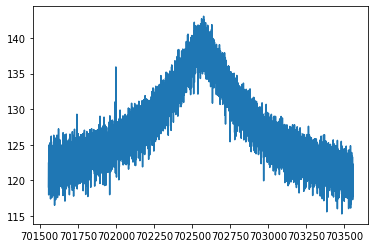

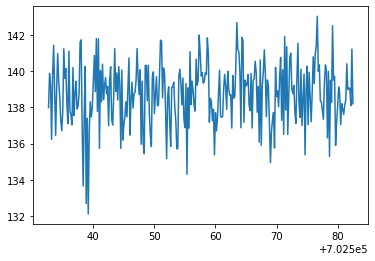

/nuz_trap2_dUvar0.0_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_26.spec


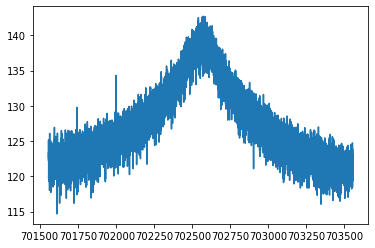

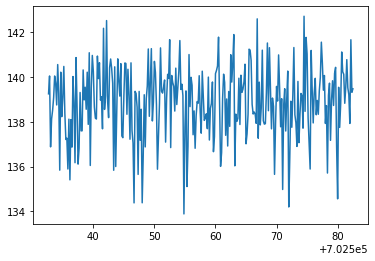

/nuz_trap2_dUvar0.0_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_27.spec


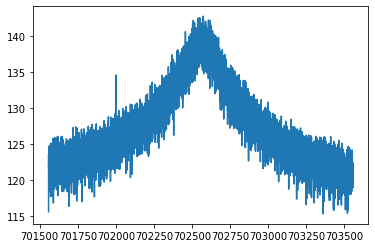

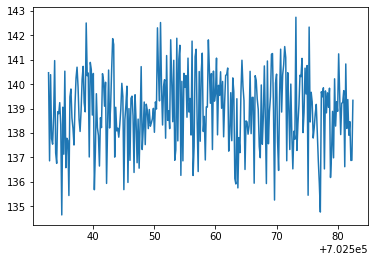

/nuz_trap2_dUvar0.0_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_28.spec


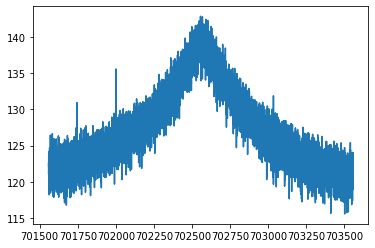

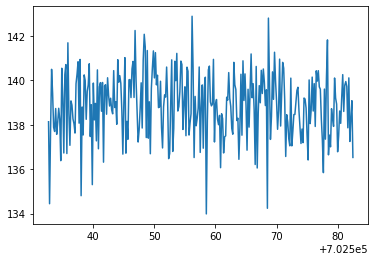

/nuz_trap2_dUvar0.0_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_29.spec


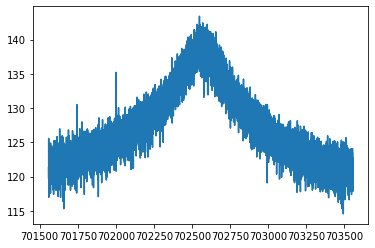

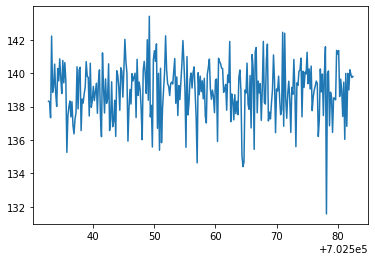

/nuz_trap2_dUvar0.0_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
562,21,20220515_115922.774475,0.000,2,702557.557805839228,0.031810168986,3.788048741240,0.269695491935,2.906299299098,702563.052909991588,6.134375384822,3547.635589638201,30.847782337494
563,22,20220515_124132.958982,0.000,2,702557.573767821072,0.033165689876,4.079056409794,0.300559870722,3.247603536111,702558.572745571379,6.438243197779,3441.072884016672,28.880768622267
564,23,20220515_125617.300046,0.000,2,702557.623379079974,0.030379289950,4.064963549992,0.267649806902,2.586344778236,702563.585617653211,5.701243690892,3497.212081646715,29.601856046465
565,24,20220515_132405.353321,0.000,2,702557.610947164008,0.031845016736,4.017977806399,0.278264826041,2.826653464724,702559.497188241803,6.007586822527,3476.877774511441,29.894678342940


/nuz_trap2_dUvar0.0_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_30.spec


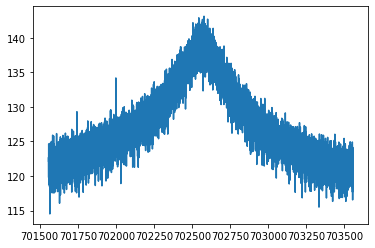

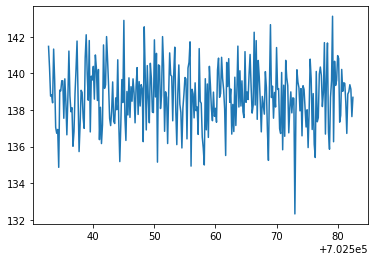

/nuz_trap2_dUvar0.0_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_31.spec


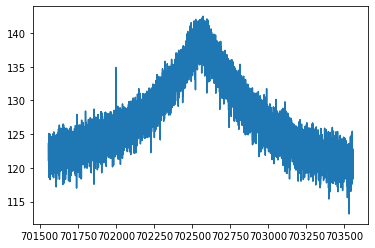

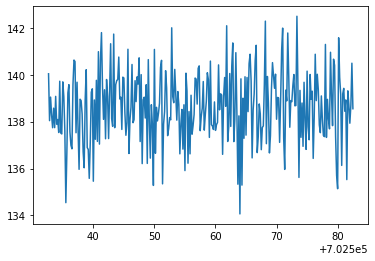

/nuz_trap2_dUvar0.0_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_32.spec


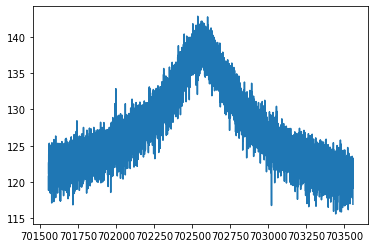

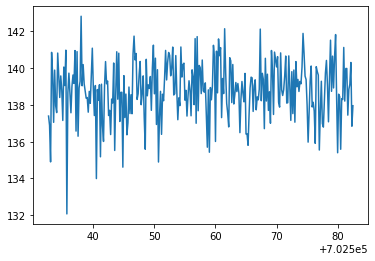

/nuz_trap2_dUvar0.0_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_33.spec


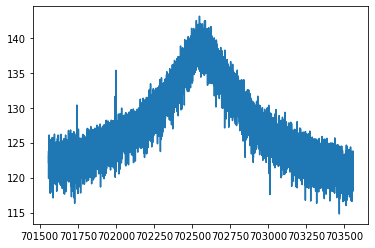

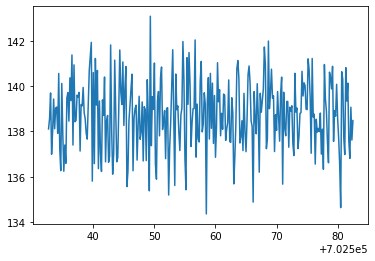

/nuz_trap2_dUvar0.0_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_34.spec


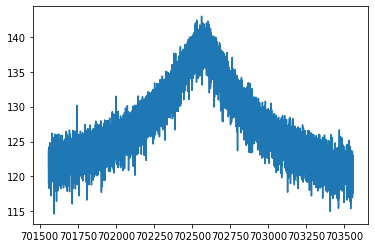

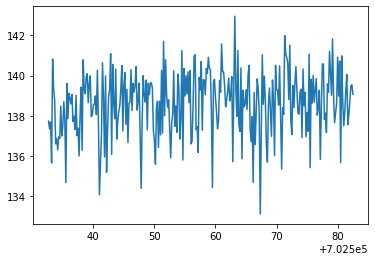

/nuz_trap2_dUvar0.0_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_35.spec


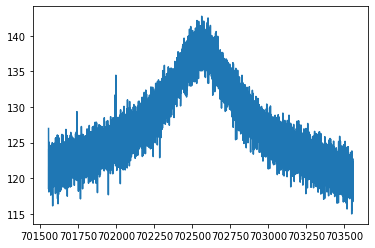

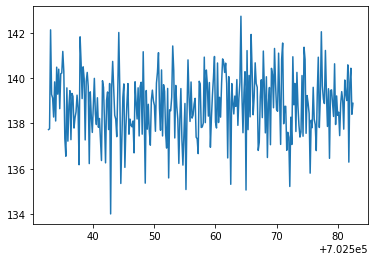

/nuz_trap2_dUvar0.0_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_36.spec


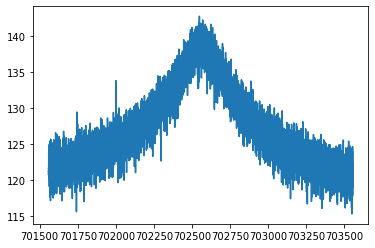

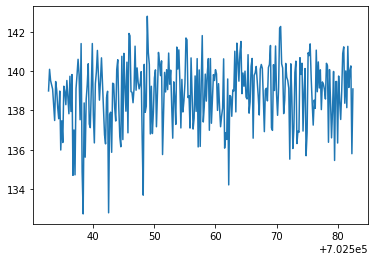

/nuz_trap2_dUvar0.0_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_37.spec


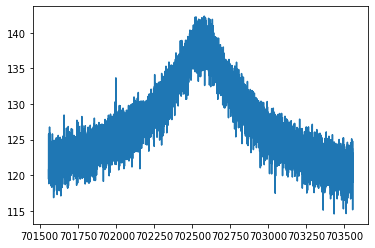

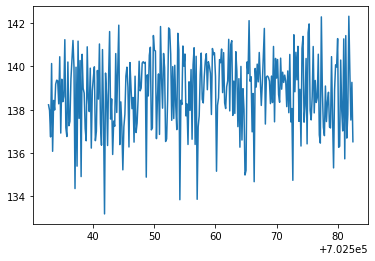

/nuz_trap2_dUvar0.0_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_38.spec


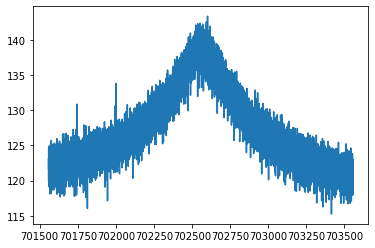

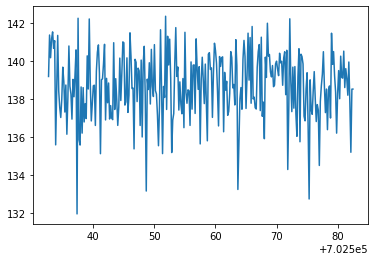

/nuz_trap2_dUvar0.0_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_39.spec


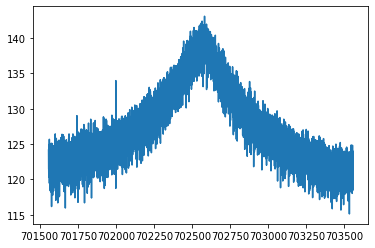

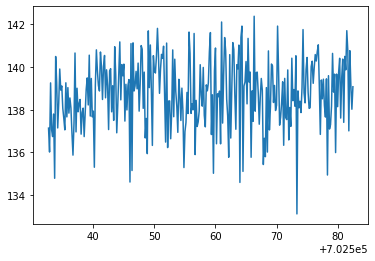

/nuz_trap2_dUvar0.0_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
563,22,20220515_124132.958982,0.000,2,702557.573767821072,0.033165689876,4.079056409794,0.300559870722,3.247603536111,702558.572745571379,6.438243197779,3441.072884016672,28.880768622267
564,23,20220515_125617.300046,0.000,2,702557.623379079974,0.030379289950,4.064963549992,0.267649806902,2.586344778236,702563.585617653211,5.701243690892,3497.212081646715,29.601856046465
565,24,20220515_132405.353321,0.000,2,702557.610947164008,0.031845016736,4.017977806399,0.278264826041,2.826653464724,702559.497188241803,6.007586822527,3476.877774511441,29.894678342940
566,3,20220515_022718.129889,0.000,2,702557.575003874605,0.029808879697,3.994409228359,0.262521068145,2.543238973628,702557.061683798674,5.633116847741,3523.595209559620,30.289153244924


/nuz_trap2_dUvar0.0_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_40.spec


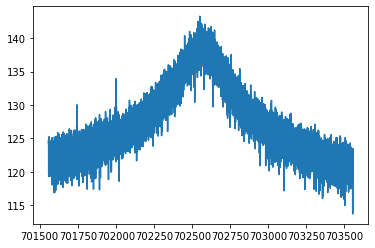

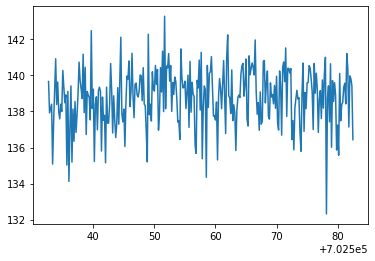

/nuz_trap2_dUvar0.0_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}
!!! No dip found !!!
Make sure that you provide the correct nu_z frequency
fit failed for /nuz_trap2_dUvar0.0_41.spec


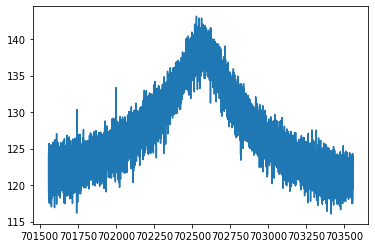

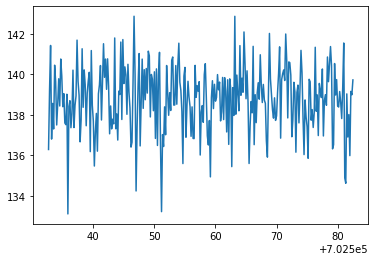

/nuz_trap2_dUvar0.0_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,23,20220515_125617.300046,0.000,2,702557.623379079974,0.030379289950,4.064963549992,0.267649806902,2.586344778236,702563.585617653211,5.701243690892,3497.212081646715,29.601856046465
565,24,20220515_132405.353321,0.000,2,702557.610947164008,0.031845016736,4.017977806399,0.278264826041,2.826653464724,702559.497188241803,6.007586822527,3476.877774511441,29.894678342940
566,3,20220515_022718.129889,0.000,2,702557.575003874605,0.029808879697,3.994409228359,0.262521068145,2.543238973628,702557.061683798674,5.633116847741,3523.595209559620,30.289153244924
567,4,20220515_025455.903122,0.000,2,702557.615749031887,0.031156672844,3.616124144295,0.263547365141,3.010852788223,702562.762467946508,6.492974378635,3456.548854402710,29.367018780939


/nuz_trap2_dUvar0.0_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
565,24,20220515_132405.353321,0.000,2,702557.610947164008,0.031845016736,4.017977806399,0.278264826041,2.826653464724,702559.497188241803,6.007586822527,3476.877774511441,29.894678342940
566,3,20220515_022718.129889,0.000,2,702557.575003874605,0.029808879697,3.994409228359,0.262521068145,2.543238973628,702557.061683798674,5.633116847741,3523.595209559620,30.289153244924
567,4,20220515_025455.903122,0.000,2,702557.615749031887,0.031156672844,3.616124144295,0.263547365141,3.010852788223,702562.762467946508,6.492974378635,3456.548854402710,29.367018780939
568,5,20220515_031848.733426,0.000,2,702557.685554845841,0.035116946130,3.813582570285,0.295234331276,3.487816866747,702568.585005379980,6.867832229307,3484.361915937109,29.703757445488


/nuz_trap2_dUvar0.0_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
566,3,20220515_022718.129889,0.000,2,702557.575003874605,0.029808879697,3.994409228359,0.262521068145,2.543238973628,702557.061683798674,5.633116847741,3523.595209559620,30.289153244924
567,4,20220515_025455.903122,0.000,2,702557.615749031887,0.031156672844,3.616124144295,0.263547365141,3.010852788223,702562.762467946508,6.492974378635,3456.548854402710,29.367018780939
568,5,20220515_031848.733426,0.000,2,702557.685554845841,0.035116946130,3.813582570285,0.295234331276,3.487816866747,702568.585005379980,6.867832229307,3484.361915937109,29.703757445488
569,6,20220515_040849.332929,0.000,2,702557.517087999382,0.034218486208,4.048908716761,0.296670385278,3.176563036541,702559.903451411985,6.388955127972,3459.089913314170,29.560333412221


/nuz_trap2_dUvar0.0_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
567,4,20220515_025455.903122,0.000,2,702557.615749031887,0.031156672844,3.616124144295,0.263547365141,3.010852788223,702562.762467946508,6.492974378635,3456.548854402710,29.367018780939
568,5,20220515_031848.733426,0.000,2,702557.685554845841,0.035116946130,3.813582570285,0.295234331276,3.487816866747,702568.585005379980,6.867832229307,3484.361915937109,29.703757445488
569,6,20220515_040849.332929,0.000,2,702557.517087999382,0.034218486208,4.048908716761,0.296670385278,3.176563036541,702559.903451411985,6.388955127972,3459.089913314170,29.560333412221
570,7,20220515_042728.678028,0.000,2,702557.528317347984,0.027190949907,3.937704318142,0.228305305729,1.956545652732,702567.403128948295,4.999562083939,3548.880058488122,31.110283840543


/nuz_trap2_dUvar0.0_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 20, 'min_dip_width': 0.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
568,5,20220515_031848.733426,0.000,2,702557.685554845841,0.035116946130,3.813582570285,0.295234331276,3.487816866747,702568.585005379980,6.867832229307,3484.361915937109,29.703757445488
569,6,20220515_040849.332929,0.000,2,702557.517087999382,0.034218486208,4.048908716761,0.296670385278,3.176563036541,702559.903451411985,6.388955127972,3459.089913314170,29.560333412221
570,7,20220515_042728.678028,0.000,2,702557.528317347984,0.027190949907,3.937704318142,0.228305305729,1.956545652732,702567.403128948295,4.999562083939,3548.880058488122,31.110283840543
571,8,20220515_050148.516491,0.000,2,702557.671732352930,0.030862982068,4.416731093964,0.284635627894,2.564743534290,702557.908968740492,5.512213859950,3477.566893596219,29.577988247654


/nuz_trap3_dUvar-0.001_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
569,6,20220515_040849.332929,0.000,2,702557.517087999382,0.034218486208,4.048908716761,0.296670385278,3.176563036541,702559.903451411985,6.388955127972,3459.089913314170,29.560333412221
570,7,20220515_042728.678028,0.000,2,702557.528317347984,0.027190949907,3.937704318142,0.228305305729,1.956545652732,702567.403128948295,4.999562083939,3548.880058488122,31.110283840543
571,8,20220515_050148.516491,0.000,2,702557.671732352930,0.030862982068,4.416731093964,0.284635627894,2.564743534290,702557.908968740492,5.512213859950,3477.566893596219,29.577988247654
572,9,20220515_055307.121806,0.000,2,702557.637406704132,0.033351144097,4.399244045277,0.303678872836,2.947163128934,702568.290642191540,5.983732440171,3473.969618676714,29.723150748924


/nuz_trap3_dUvar-0.001_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
570,7,20220515_042728.678028,0.000,2,702557.528317347984,0.027190949907,3.937704318142,0.228305305729,1.956545652732,702567.403128948295,4.999562083939,3548.880058488122,31.110283840543
571,8,20220515_050148.516491,0.000,2,702557.671732352930,0.030862982068,4.416731093964,0.284635627894,2.564743534290,702557.908968740492,5.512213859950,3477.566893596219,29.577988247654
572,9,20220515_055307.121806,0.000,2,702557.637406704132,0.033351144097,4.399244045277,0.303678872836,2.947163128934,702568.290642191540,5.983732440171,3473.969618676714,29.723150748924
573,1,20220515_013031.955865,-0.001,3,472036.937325134873,0.061244457081,31.401512418389,0.670228916802,4.354053550442,472037.009534994140,0.445819433587,13632.060064871610,1924.273427293830


/nuz_trap3_dUvar-0.001_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
571,8,20220515_050148.516491,0.000,2,702557.671732352930,0.030862982068,4.416731093964,0.284635627894,2.564743534290,702557.908968740492,5.512213859950,3477.566893596219,29.577988247654
572,9,20220515_055307.121806,0.000,2,702557.637406704132,0.033351144097,4.399244045277,0.303678872836,2.947163128934,702568.290642191540,5.983732440171,3473.969618676714,29.723150748924
573,1,20220515_013031.955865,-0.001,3,472036.937325134873,0.061244457081,31.401512418389,0.670228916802,4.354053550442,472037.009534994140,0.445819433587,13632.060064871610,1924.273427293830
574,10,20220515_060633.063231,-0.001,3,472036.974016880034,0.060578612188,31.219204261985,0.665726159286,4.329279284781,472036.607778637612,0.441732060372,13727.730182767491,2105.778235525135


/nuz_trap3_dUvar-0.001_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
572,9,20220515_055307.121806,0.000,2,702557.637406704132,0.033351144097,4.399244045277,0.303678872836,2.947163128934,702568.290642191540,5.983732440171,3473.969618676714,29.723150748924
573,1,20220515_013031.955865,-0.001,3,472036.937325134873,0.061244457081,31.401512418389,0.670228916802,4.354053550442,472037.009534994140,0.445819433587,13632.060064871610,1924.273427293830
574,10,20220515_060633.063231,-0.001,3,472036.974016880034,0.060578612188,31.219204261985,0.665726159286,4.329279284781,472036.607778637612,0.441732060372,13727.730182767491,2105.778235525135
575,11,20220515_064843.074450,-0.001,3,472036.973626088526,0.062041539945,30.748124178668,0.678292428513,4.565509896824,472037.006872531783,0.451767912636,13787.786917578303,2119.123542195373


/nuz_trap3_dUvar-0.001_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
573,1,20220515_013031.955865,-0.001,3,472036.937325134873,0.061244457081,31.401512418389,0.670228916802,4.354053550442,472037.009534994140,0.445819433587,13632.060064871610,1924.273427293830
574,10,20220515_060633.063231,-0.001,3,472036.974016880034,0.060578612188,31.219204261985,0.665726159286,4.329279284781,472036.607778637612,0.441732060372,13727.730182767491,2105.778235525135
575,11,20220515_064843.074450,-0.001,3,472036.973626088526,0.062041539945,30.748124178668,0.678292428513,4.565509896824,472037.006872531783,0.451767912636,13787.786917578303,2119.123542195373
576,12,20220515_070209.108862,-0.001,3,472036.874840976147,0.060279025315,31.163121580663,0.663884952887,4.316278511054,472036.578094019147,0.440288339180,13753.447693089609,2132.526980382141


/nuz_trap3_dUvar-0.001_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
574,10,20220515_060633.063231,-0.001,3,472036.974016880034,0.060578612188,31.219204261985,0.665726159286,4.329279284781,472036.607778637612,0.441732060372,13727.730182767491,2105.778235525135
575,11,20220515_064843.074450,-0.001,3,472036.973626088526,0.062041539945,30.748124178668,0.678292428513,4.565509896824,472037.006872531783,0.451767912636,13787.786917578303,2119.123542195373
576,12,20220515_070209.108862,-0.001,3,472036.874840976147,0.060279025315,31.163121580663,0.663884952887,4.316278511054,472036.578094019147,0.440288339180,13753.447693089609,2132.526980382141
577,13,20220515_074814.286678,-0.001,3,472036.992515549588,0.058980045163,31.419681173356,0.650193033437,4.105580343196,472036.985614753794,0.429135572964,13769.269930771768,2093.292483662567


/nuz_trap3_dUvar-0.001_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
575,11,20220515_064843.074450,-0.001,3,472036.973626088526,0.062041539945,30.748124178668,0.678292428513,4.565509896824,472037.006872531783,0.451767912636,13787.786917578303,2119.123542195373
576,12,20220515_070209.108862,-0.001,3,472036.874840976147,0.060279025315,31.163121580663,0.663884952887,4.316278511054,472036.578094019147,0.440288339180,13753.447693089609,2132.526980382141
577,13,20220515_074814.286678,-0.001,3,472036.992515549588,0.058980045163,31.419681173356,0.650193033437,4.105580343196,472036.985614753794,0.429135572964,13769.269930771768,2093.292483662567
578,14,20220515_082511.016169,-0.001,3,472036.877941189974,0.061810648124,31.406588919489,0.671753012146,4.371919319945,472036.823111950769,0.443960790026,13741.053388641189,2098.239487897725


/nuz_trap3_dUvar-0.001_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
576,12,20220515_070209.108862,-0.001,3,472036.874840976147,0.060279025315,31.163121580663,0.663884952887,4.316278511054,472036.578094019147,0.440288339180,13753.447693089609,2132.526980382141
577,13,20220515_074814.286678,-0.001,3,472036.992515549588,0.058980045163,31.419681173356,0.650193033437,4.105580343196,472036.985614753794,0.429135572964,13769.269930771768,2093.292483662567
578,14,20220515_082511.016169,-0.001,3,472036.877941189974,0.061810648124,31.406588919489,0.671753012146,4.371919319945,472036.823111950769,0.443960790026,13741.053388641189,2098.239487897725
579,15,20220515_084231.946037,-0.001,3,472037.105175220175,0.058471017689,30.875544720492,0.641742579807,4.069249799906,472036.304299647221,0.428057129034,13728.962688779728,2040.650154255364


/nuz_trap3_dUvar-0.001_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
577,13,20220515_074814.286678,-0.001,3,472036.992515549588,0.058980045163,31.419681173356,0.650193033437,4.105580343196,472036.985614753794,0.429135572964,13769.269930771768,2093.292483662567
578,14,20220515_082511.016169,-0.001,3,472036.877941189974,0.061810648124,31.406588919489,0.671753012146,4.371919319945,472036.823111950769,0.443960790026,13741.053388641189,2098.239487897725
579,15,20220515_084231.946037,-0.001,3,472037.105175220175,0.058471017689,30.875544720492,0.641742579807,4.069249799906,472036.304299647221,0.428057129034,13728.962688779728,2040.650154255364
580,16,20220515_091533.581015,-0.001,3,472036.911082943610,0.063450228799,31.102341713294,0.691010988324,4.675299951116,472037.591975838062,0.459121980780,13732.393627576894,2090.774721289056


/nuz_trap3_dUvar-0.001_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
578,14,20220515_082511.016169,-0.001,3,472036.877941189974,0.061810648124,31.406588919489,0.671753012146,4.371919319945,472036.823111950769,0.443960790026,13741.053388641189,2098.239487897725
579,15,20220515_084231.946037,-0.001,3,472037.105175220175,0.058471017689,30.875544720492,0.641742579807,4.069249799906,472036.304299647221,0.428057129034,13728.962688779728,2040.650154255364
580,16,20220515_091533.581015,-0.001,3,472036.911082943610,0.063450228799,31.102341713294,0.691010988324,4.675299951116,472037.591975838062,0.459121980780,13732.393627576894,2090.774721289056
581,17,20220515_100652.227365,-0.001,3,472036.927233603550,0.059725070093,32.261063483834,0.654461633201,4.038503819658,472037.776027071523,0.427327713535,13734.450253642857,2101.654187799742


/nuz_trap3_dUvar-0.001_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
579,15,20220515_084231.946037,-0.001,3,472037.105175220175,0.058471017689,30.875544720492,0.641742579807,4.069249799906,472036.304299647221,0.428057129034,13728.962688779728,2040.650154255364
580,16,20220515_091533.581015,-0.001,3,472036.911082943610,0.063450228799,31.102341713294,0.691010988324,4.675299951116,472037.591975838062,0.459121980780,13732.393627576894,2090.774721289056
581,17,20220515_100652.227365,-0.001,3,472036.927233603550,0.059725070093,32.261063483834,0.654461633201,4.038503819658,472037.776027071523,0.427327713535,13734.450253642857,2101.654187799742
582,18,20220515_102808.462862,-0.001,3,472036.891042055271,0.060838566819,31.228882228331,0.666529697450,4.335784723999,472037.007073213637,0.442296685167,13721.930820099253,2011.046170952915


/nuz_trap3_dUvar-0.001_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
580,16,20220515_091533.581015,-0.001,3,472036.911082943610,0.063450228799,31.102341713294,0.691010988324,4.675299951116,472037.591975838062,0.459121980780,13732.393627576894,2090.774721289056
581,17,20220515_100652.227365,-0.001,3,472036.927233603550,0.059725070093,32.261063483834,0.654461633201,4.038503819658,472037.776027071523,0.427327713535,13734.450253642857,2101.654187799742
582,18,20220515_102808.462862,-0.001,3,472036.891042055271,0.060838566819,31.228882228331,0.666529697450,4.335784723999,472037.007073213637,0.442296685167,13721.930820099253,2011.046170952915
583,19,20220515_104015.996552,-0.001,3,472036.896680877660,0.062193258158,30.510692871086,0.678505493746,4.600310388231,472037.196562787693,0.456056386574,13690.549907925270,2093.665797431883


/nuz_trap3_dUvar-0.001_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
581,17,20220515_100652.227365,-0.001,3,472036.927233603550,0.059725070093,32.261063483834,0.654461633201,4.038503819658,472037.776027071523,0.427327713535,13734.450253642857,2101.654187799742
582,18,20220515_102808.462862,-0.001,3,472036.891042055271,0.060838566819,31.228882228331,0.666529697450,4.335784723999,472037.007073213637,0.442296685167,13721.930820099253,2011.046170952915
583,19,20220515_104015.996552,-0.001,3,472036.896680877660,0.062193258158,30.510692871086,0.678505493746,4.600310388231,472037.196562787693,0.456056386574,13690.549907925270,2093.665797431883
584,2,20220515_020446.918265,-0.001,3,472036.929656562745,0.057653859439,30.229546763193,0.629945089711,4.008614313583,472036.730571220571,0.423205890621,13779.217653422740,2132.908600307890


/nuz_trap3_dUvar-0.001_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
582,18,20220515_102808.462862,-0.001,3,472036.891042055271,0.060838566819,31.228882228331,0.666529697450,4.335784723999,472037.007073213637,0.442296685167,13721.930820099253,2011.046170952915
583,19,20220515_104015.996552,-0.001,3,472036.896680877660,0.062193258158,30.510692871086,0.678505493746,4.600310388231,472037.196562787693,0.456056386574,13690.549907925270,2093.665797431883
584,2,20220515_020446.918265,-0.001,3,472036.929656562745,0.057653859439,30.229546763193,0.629945089711,4.008614313583,472036.730571220571,0.423205890621,13779.217653422740,2132.908600307890
585,20,20220515_114201.760877,-0.001,3,472036.907279072504,0.063962628079,31.584476482961,0.704535115810,4.790722143947,472038.157032954448,0.464752164125,13739.001360657840,2114.159629248478


/nuz_trap3_dUvar-0.001_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583,19,20220515_104015.996552,-0.001,3,472036.896680877660,0.062193258158,30.510692871086,0.678505493746,4.600310388231,472037.196562787693,0.456056386574,13690.549907925270,2093.665797431883
584,2,20220515_020446.918265,-0.001,3,472036.929656562745,0.057653859439,30.229546763193,0.629945089711,4.008614313583,472036.730571220571,0.423205890621,13779.217653422740,2132.908600307890
585,20,20220515_114201.760877,-0.001,3,472036.907279072504,0.063962628079,31.584476482961,0.704535115810,4.790722143947,472038.157032954448,0.464752164125,13739.001360657840,2114.159629248478
586,21,20220515_115527.691637,-0.001,3,472036.898765545979,0.061274947716,31.545405546238,0.669527175753,4.324780635494,472036.886936127674,0.443024080859,13684.972264138714,2015.385190849674


/nuz_trap3_dUvar-0.001_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
584,2,20220515_020446.918265,-0.001,3,472036.929656562745,0.057653859439,30.229546763193,0.629945089711,4.008614313583,472036.730571220571,0.423205890621,13779.217653422740,2132.908600307890
585,20,20220515_114201.760877,-0.001,3,472036.907279072504,0.063962628079,31.584476482961,0.704535115810,4.790722143947,472038.157032954448,0.464752164125,13739.001360657840,2114.159629248478
586,21,20220515_115527.691637,-0.001,3,472036.898765545979,0.061274947716,31.545405546238,0.669527175753,4.324780635494,472036.886936127674,0.443024080859,13684.972264138714,2015.385190849674
587,22,20220515_121802.375173,-0.001,3,472036.881762692472,0.059952757088,31.805228530385,0.658697587349,4.157919882777,472036.724939574720,0.431564052566,13794.280996228137,2110.890299161752


/nuz_trap3_dUvar-0.001_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
585,20,20220515_114201.760877,-0.001,3,472036.907279072504,0.063962628079,31.584476482961,0.704535115810,4.790722143947,472038.157032954448,0.464752164125,13739.001360657840,2114.159629248478
586,21,20220515_115527.691637,-0.001,3,472036.898765545979,0.061274947716,31.545405546238,0.669527175753,4.324780635494,472036.886936127674,0.443024080859,13684.972264138714,2015.385190849674
587,22,20220515_121802.375173,-0.001,3,472036.881762692472,0.059952757088,31.805228530385,0.658697587349,4.157919882777,472036.724939574720,0.431564052566,13794.280996228137,2110.890299161752
588,23,20220515_131157.822571,-0.001,3,472037.032288529270,0.059163554879,31.216984528431,0.650419797853,4.135236954945,472036.648343726527,0.430167225855,13786.729279085284,2042.606758962105


/nuz_trap3_dUvar-0.001_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
586,21,20220515_115527.691637,-0.001,3,472036.898765545979,0.061274947716,31.545405546238,0.669527175753,4.324780635494,472036.886936127674,0.443024080859,13684.972264138714,2015.385190849674
587,22,20220515_121802.375173,-0.001,3,472036.881762692472,0.059952757088,31.805228530385,0.658697587349,4.157919882777,472036.724939574720,0.431564052566,13794.280996228137,2110.890299161752
588,23,20220515_131157.822571,-0.001,3,472037.032288529270,0.059163554879,31.216984528431,0.650419797853,4.135236954945,472036.648343726527,0.430167225855,13786.729279085284,2042.606758962105
589,24,20220515_134104.261594,-0.001,3,472037.027232086344,0.064076212314,31.997291351043,0.704141362896,4.718452911106,472037.339595091646,0.461713489354,13728.904616165079,2094.493027319462


/nuz_trap3_dUvar-0.001_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
587,22,20220515_121802.375173,-0.001,3,472036.881762692472,0.059952757088,31.805228530385,0.658697587349,4.157919882777,472036.724939574720,0.431564052566,13794.280996228137,2110.890299161752
588,23,20220515_131157.822571,-0.001,3,472037.032288529270,0.059163554879,31.216984528431,0.650419797853,4.135236954945,472036.648343726527,0.430167225855,13786.729279085284,2042.606758962105
589,24,20220515_134104.261594,-0.001,3,472037.027232086344,0.064076212314,31.997291351043,0.704141362896,4.718452911106,472037.339595091646,0.461713489354,13728.904616165079,2094.493027319462
590,25,20220515_140734.096559,-0.001,3,472037.075637566682,0.060426579863,31.839234595447,0.660365960378,4.167258767395,472036.353291598265,0.434104096558,13723.280013321228,2039.307870558239


/nuz_trap3_dUvar-0.001_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
588,23,20220515_131157.822571,-0.001,3,472037.032288529270,0.059163554879,31.216984528431,0.650419797853,4.135236954945,472036.648343726527,0.430167225855,13786.729279085284,2042.606758962105
589,24,20220515_134104.261594,-0.001,3,472037.027232086344,0.064076212314,31.997291351043,0.704141362896,4.718452911106,472037.339595091646,0.461713489354,13728.904616165079,2094.493027319462
590,25,20220515_140734.096559,-0.001,3,472037.075637566682,0.060426579863,31.839234595447,0.660365960378,4.167258767395,472036.353291598265,0.434104096558,13723.280013321228,2039.307870558239
591,26,20220515_143403.879918,-0.001,3,472036.855552162626,0.058116000967,31.986001571526,0.638147456786,3.879084080439,472037.145380267058,0.416710096101,13804.969343602588,2098.837138904680


/nuz_trap3_dUvar-0.001_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
589,24,20220515_134104.261594,-0.001,3,472037.027232086344,0.064076212314,31.997291351043,0.704141362896,4.718452911106,472037.339595091646,0.461713489354,13728.904616165079,2094.493027319462
590,25,20220515_140734.096559,-0.001,3,472037.075637566682,0.060426579863,31.839234595447,0.660365960378,4.167258767395,472036.353291598265,0.434104096558,13723.280013321228,2039.307870558239
591,26,20220515_143403.879918,-0.001,3,472036.855552162626,0.058116000967,31.986001571526,0.638147456786,3.879084080439,472037.145380267058,0.416710096101,13804.969343602588,2098.837138904680
592,27,20220515_152556.135257,-0.001,3,472036.969130367681,0.061811701125,30.080914282268,0.675918601174,4.636787702910,472036.729922937404,0.457167323381,13701.727890611250,2100.418648413980


/nuz_trap3_dUvar-0.001_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
590,25,20220515_140734.096559,-0.001,3,472037.075637566682,0.060426579863,31.839234595447,0.660365960378,4.167258767395,472036.353291598265,0.434104096558,13723.280013321228,2039.307870558239
591,26,20220515_143403.879918,-0.001,3,472036.855552162626,0.058116000967,31.986001571526,0.638147456786,3.879084080439,472037.145380267058,0.416710096101,13804.969343602588,2098.837138904680
592,27,20220515_152556.135257,-0.001,3,472036.969130367681,0.061811701125,30.080914282268,0.675918601174,4.636787702910,472036.729922937404,0.457167323381,13701.727890611250,2100.418648413980
593,28,20220515_154830.677394,-0.001,3,472036.985900341591,0.059091296051,30.948726896534,0.649096985062,4.155966392245,472037.274529624265,0.430905387451,13793.811103709733,2147.908092814974


/nuz_trap3_dUvar-0.001_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
591,26,20220515_143403.879918,-0.001,3,472036.855552162626,0.058116000967,31.986001571526,0.638147456786,3.879084080439,472037.145380267058,0.416710096101,13804.969343602588,2098.837138904680
592,27,20220515_152556.135257,-0.001,3,472036.969130367681,0.061811701125,30.080914282268,0.675918601174,4.636787702910,472036.729922937404,0.457167323381,13701.727890611250,2100.418648413980
593,28,20220515_154830.677394,-0.001,3,472036.985900341591,0.059091296051,30.948726896534,0.649096985062,4.155966392245,472037.274529624265,0.430905387451,13793.811103709733,2147.908092814974
594,29,20220515_160828.592113,-0.001,3,472037.081124989490,0.061540371870,30.862727771577,0.674749950013,4.502003545547,472036.956545719353,0.448967710576,13774.943629526622,2031.692002992344


/nuz_trap3_dUvar-0.001_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
592,27,20220515_152556.135257,-0.001,3,472036.969130367681,0.061811701125,30.080914282268,0.675918601174,4.636787702910,472036.729922937404,0.457167323381,13701.727890611250,2100.418648413980
593,28,20220515_154830.677394,-0.001,3,472036.985900341591,0.059091296051,30.948726896534,0.649096985062,4.155966392245,472037.274529624265,0.430905387451,13793.811103709733,2147.908092814974
594,29,20220515_160828.592113,-0.001,3,472037.081124989490,0.061540371870,30.862727771577,0.674749950013,4.502003545547,472036.956545719353,0.448967710576,13774.943629526622,2031.692002992344
595,3,20220515_021652.722848,-0.001,3,472036.934379651211,0.059947156748,31.629537692384,0.655838906270,4.140465879644,472037.110984725819,0.432453967788,13725.092221759960,2052.145394736875


/nuz_trap3_dUvar-0.001_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
593,28,20220515_154830.677394,-0.001,3,472036.985900341591,0.059091296051,30.948726896534,0.649096985062,4.155966392245,472037.274529624265,0.430905387451,13793.811103709733,2147.908092814974
594,29,20220515_160828.592113,-0.001,3,472037.081124989490,0.061540371870,30.862727771577,0.674749950013,4.502003545547,472036.956545719353,0.448967710576,13774.943629526622,2031.692002992344
595,3,20220515_021652.722848,-0.001,3,472036.934379651211,0.059947156748,31.629537692384,0.655838906270,4.140465879644,472037.110984725819,0.432453967788,13725.092221759960,2052.145394736875
596,30,20220515_164130.304138,-0.001,3,472037.041277982993,0.063443773632,31.178006268365,0.693112878268,4.694931537132,472037.029574120766,0.459825449277,13738.619972935025,2103.867146005846


/nuz_trap3_dUvar-0.001_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
594,29,20220515_160828.592113,-0.001,3,472037.081124989490,0.061540371870,30.862727771577,0.674749950013,4.502003545547,472036.956545719353,0.448967710576,13774.943629526622,2031.692002992344
595,3,20220515_021652.722848,-0.001,3,472036.934379651211,0.059947156748,31.629537692384,0.655838906270,4.140465879644,472037.110984725819,0.432453967788,13725.092221759960,2052.145394736875
596,30,20220515_164130.304138,-0.001,3,472037.041277982993,0.063443773632,31.178006268365,0.693112878268,4.694931537132,472037.029574120766,0.459825449277,13738.619972935025,2103.867146005846
597,31,20220515_173012.521086,-0.001,3,472036.992968224455,0.060731756305,29.805951716946,0.666302342754,4.554976621383,472036.775140070647,0.451066628898,13766.261889075236,2099.810532383787


/nuz_trap3_dUvar-0.001_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,3,20220515_021652.722848,-0.001,3,472036.934379651211,0.059947156748,31.629537692384,0.655838906270,4.140465879644,472037.110984725819,0.432453967788,13725.092221759960,2052.145394736875
596,30,20220515_164130.304138,-0.001,3,472037.041277982993,0.063443773632,31.178006268365,0.693112878268,4.694931537132,472037.029574120766,0.459825449277,13738.619972935025,2103.867146005846
597,31,20220515_173012.521086,-0.001,3,472036.992968224455,0.060731756305,29.805951716946,0.666302342754,4.554976621383,472036.775140070647,0.451066628898,13766.261889075236,2099.810532383787
598,32,20220515_174852.046275,-0.001,3,472037.086070026038,0.061395997006,30.938831489886,0.674419978514,4.486968249899,472036.592613900139,0.448419137737,13768.096709052821,2120.726155728174


/nuz_trap3_dUvar-0.001_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
596,30,20220515_164130.304138,-0.001,3,472037.041277982993,0.063443773632,31.178006268365,0.693112878268,4.694931537132,472037.029574120766,0.459825449277,13738.619972935025,2103.867146005846
597,31,20220515_173012.521086,-0.001,3,472036.992968224455,0.060731756305,29.805951716946,0.666302342754,4.554976621383,472036.775140070647,0.451066628898,13766.261889075236,2099.810532383787
598,32,20220515_174852.046275,-0.001,3,472037.086070026038,0.061395997006,30.938831489886,0.674419978514,4.486968249899,472036.592613900139,0.448419137737,13768.096709052821,2120.726155728174
599,33,20220515_181403.496089,-0.001,3,472036.908553263231,0.062148624856,30.570670785339,0.684098630142,4.677408048004,472037.118558596296,0.457553486347,13766.439185425521,2095.579265876572


/nuz_trap3_dUvar-0.001_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
597,31,20220515_173012.521086,-0.001,3,472036.992968224455,0.060731756305,29.805951716946,0.666302342754,4.554976621383,472036.775140070647,0.451066628898,13766.261889075236,2099.810532383787
598,32,20220515_174852.046275,-0.001,3,472037.086070026038,0.061395997006,30.938831489886,0.674419978514,4.486968249899,472036.592613900139,0.448419137737,13768.096709052821,2120.726155728174
599,33,20220515_181403.496089,-0.001,3,472036.908553263231,0.062148624856,30.570670785339,0.684098630142,4.677408048004,472037.118558596296,0.457553486347,13766.439185425521,2095.579265876572
600,34,20220515_183756.541312,-0.001,3,472036.952585809049,0.062481122340,32.558488787534,0.691312574601,4.475361325300,472037.305973680981,0.446494618151,13853.833124709307,2146.255103134687


/nuz_trap3_dUvar-0.001_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
598,32,20220515_174852.046275,-0.001,3,472037.086070026038,0.061395997006,30.938831489886,0.674419978514,4.486968249899,472036.592613900139,0.448419137737,13768.096709052821,2120.726155728174
599,33,20220515_181403.496089,-0.001,3,472036.908553263231,0.062148624856,30.570670785339,0.684098630142,4.677408048004,472037.118558596296,0.457553486347,13766.439185425521,2095.579265876572
600,34,20220515_183756.541312,-0.001,3,472036.952585809049,0.062481122340,32.558488787534,0.691312574601,4.475361325300,472037.305973680981,0.446494618151,13853.833124709307,2146.255103134687
601,35,20220515_191453.389669,-0.001,3,472036.971906256571,0.059316772712,31.412582090609,0.655369489417,4.173373152154,472036.615142256080,0.432900383327,13758.246703096696,2100.833145515284


/nuz_trap3_dUvar-0.001_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
599,33,20220515_181403.496089,-0.001,3,472036.908553263231,0.062148624856,30.570670785339,0.684098630142,4.677408048004,472037.118558596296,0.457553486347,13766.439185425521,2095.579265876572
600,34,20220515_183756.541312,-0.001,3,472036.952585809049,0.062481122340,32.558488787534,0.691312574601,4.475361325300,472037.305973680981,0.446494618151,13853.833124709307,2146.255103134687
601,35,20220515_191453.389669,-0.001,3,472036.971906256571,0.059316772712,31.412582090609,0.655369489417,4.173373152154,472036.615142256080,0.432900383327,13758.246703096696,2100.833145515284
602,36,20220515_200612.513424,-0.001,3,472036.990738264110,0.059023318097,30.792614009340,0.651546179954,4.214208100255,472036.945027022448,0.433255152720,13809.633313388402,2151.895896462240


/nuz_trap3_dUvar-0.001_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
600,34,20220515_183756.541312,-0.001,3,472036.952585809049,0.062481122340,32.558488787534,0.691312574601,4.475361325300,472037.305973680981,0.446494618151,13853.833124709307,2146.255103134687
601,35,20220515_191453.389669,-0.001,3,472036.971906256571,0.059316772712,31.412582090609,0.655369489417,4.173373152154,472036.615142256080,0.432900383327,13758.246703096696,2100.833145515284
602,36,20220515_200612.513424,-0.001,3,472036.990738264110,0.059023318097,30.792614009340,0.651546179954,4.214208100255,472036.945027022448,0.433255152720,13809.633313388402,2151.895896462240
603,37,20220515_202728.859303,-0.001,3,472036.938514842594,0.059521656278,30.358940609720,0.659177685742,4.380021074896,472037.148500639712,0.442195211814,13776.712627088815,2071.662412505046


/nuz_trap3_dUvar-0.001_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
601,35,20220515_191453.389669,-0.001,3,472036.971906256571,0.059316772712,31.412582090609,0.655369489417,4.173373152154,472036.615142256080,0.432900383327,13758.246703096696,2100.833145515284
602,36,20220515_200612.513424,-0.001,3,472036.990738264110,0.059023318097,30.792614009340,0.651546179954,4.214208100255,472036.945027022448,0.433255152720,13809.633313388402,2151.895896462240
603,37,20220515_202728.859303,-0.001,3,472036.938514842594,0.059521656278,30.358940609720,0.659177685742,4.380021074896,472037.148500639712,0.442195211814,13776.712627088815,2071.662412505046
604,38,20220515_210939.434073,-0.001,3,472037.071504134103,0.060940527277,30.947129809322,0.669212445708,4.417139703047,472037.376355087385,0.444519891474,13783.967949801578,2126.410046280671


/nuz_trap3_dUvar-0.001_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
602,36,20220515_200612.513424,-0.001,3,472036.990738264110,0.059023318097,30.792614009340,0.651546179954,4.214208100255,472036.945027022448,0.433255152720,13809.633313388402,2151.895896462240
603,37,20220515_202728.859303,-0.001,3,472036.938514842594,0.059521656278,30.358940609720,0.659177685742,4.380021074896,472037.148500639712,0.442195211814,13776.712627088815,2071.662412505046
604,38,20220515_210939.434073,-0.001,3,472037.071504134103,0.060940527277,30.947129809322,0.669212445708,4.417139703047,472037.376355087385,0.444519891474,13783.967949801578,2126.410046280671
605,39,20220515_211633.583702,-0.001,3,472037.059087694797,0.063280345541,29.969985099259,0.692962567514,4.898009952473,472036.316448645492,0.466738385658,13809.583281581281,2146.407097895496


/nuz_trap3_dUvar-0.001_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
603,37,20220515_202728.859303,-0.001,3,472036.938514842594,0.059521656278,30.358940609720,0.659177685742,4.380021074896,472037.148500639712,0.442195211814,13776.712627088815,2071.662412505046
604,38,20220515_210939.434073,-0.001,3,472037.071504134103,0.060940527277,30.947129809322,0.669212445708,4.417139703047,472037.376355087385,0.444519891474,13783.967949801578,2126.410046280671
605,39,20220515_211633.583702,-0.001,3,472037.059087694797,0.063280345541,29.969985099259,0.692962567514,4.898009952473,472036.316448645492,0.466738385658,13809.583281581281,2146.407097895496
606,4,20220515_024713.073644,-0.001,3,472036.901311626541,0.059674313278,32.919115429772,0.657400688695,3.991522930185,472037.048662784451,0.425716739066,13709.157191233875,2065.868189008656


/nuz_trap3_dUvar-0.001_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
604,38,20220515_210939.434073,-0.001,3,472037.071504134103,0.060940527277,30.947129809322,0.669212445708,4.417139703047,472037.376355087385,0.444519891474,13783.967949801578,2126.410046280671
605,39,20220515_211633.583702,-0.001,3,472037.059087694797,0.063280345541,29.969985099259,0.692962567514,4.898009952473,472036.316448645492,0.466738385658,13809.583281581281,2146.407097895496
606,4,20220515_024713.073644,-0.001,3,472036.901311626541,0.059674313278,32.919115429772,0.657400688695,3.991522930185,472037.048662784451,0.425716739066,13709.157191233875,2065.868189008656
607,40,20220515_220515.999231,-0.001,3,472037.003898443887,0.058460287703,30.620386281284,0.645974927852,4.168721757335,472037.083386611892,0.430142155618,13834.048328115887,2168.187254679720


/nuz_trap3_dUvar-0.001_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
605,39,20220515_211633.583702,-0.001,3,472037.059087694797,0.063280345541,29.969985099259,0.692962567514,4.898009952473,472036.316448645492,0.466738385658,13809.583281581281,2146.407097895496
606,4,20220515_024713.073644,-0.001,3,472036.901311626541,0.059674313278,32.919115429772,0.657400688695,3.991522930185,472037.048662784451,0.425716739066,13709.157191233875,2065.868189008656
607,40,20220515_220515.999231,-0.001,3,472037.003898443887,0.058460287703,30.620386281284,0.645974927852,4.168721757335,472037.083386611892,0.430142155618,13834.048328115887,2168.187254679720
608,41,20220515_222118.762976,-0.001,3,472036.987810563005,0.062236580898,30.763237641950,0.678066496080,4.553467606536,472036.493690702773,0.453743012916,13698.391223613195,1974.273395847592


/nuz_trap3_dUvar-0.001_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
606,4,20220515_024713.073644,-0.001,3,472036.901311626541,0.059674313278,32.919115429772,0.657400688695,3.991522930185,472037.048662784451,0.425716739066,13709.157191233875,2065.868189008656
607,40,20220515_220515.999231,-0.001,3,472037.003898443887,0.058460287703,30.620386281284,0.645974927852,4.168721757335,472037.083386611892,0.430142155618,13834.048328115887,2168.187254679720
608,41,20220515_222118.762976,-0.001,3,472036.987810563005,0.062236580898,30.763237641950,0.678066496080,4.553467606536,472036.493690702773,0.453743012916,13698.391223613195,1974.273395847592
609,5,20220515_034337.908067,-0.001,3,472036.777613794664,0.060990246627,30.657577107565,0.669963518455,4.469202033267,472036.489718448720,0.448574257669,13722.617779591026,2006.434317546476


/nuz_trap3_dUvar-0.001_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
607,40,20220515_220515.999231,-0.001,3,472037.003898443887,0.058460287703,30.620386281284,0.645974927852,4.168721757335,472037.083386611892,0.430142155618,13834.048328115887,2168.187254679720
608,41,20220515_222118.762976,-0.001,3,472036.987810563005,0.062236580898,30.763237641950,0.678066496080,4.553467606536,472036.493690702773,0.453743012916,13698.391223613195,1974.273395847592
609,5,20220515_034337.908067,-0.001,3,472036.777613794664,0.060990246627,30.657577107565,0.669963518455,4.469202033267,472036.489718448720,0.448574257669,13722.617779591026,2006.434317546476
610,6,20220515_041402.875885,-0.001,3,472036.831057918258,0.061080922502,31.554221010391,0.672169827274,4.364624923743,472037.531230474589,0.443812904894,13726.046789381475,2115.546630901397


/nuz_trap3_dUvar-0.001_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
608,41,20220515_222118.762976,-0.001,3,472036.987810563005,0.062236580898,30.763237641950,0.678066496080,4.553467606536,472036.493690702773,0.453743012916,13698.391223613195,1974.273395847592
609,5,20220515_034337.908067,-0.001,3,472036.777613794664,0.060990246627,30.657577107565,0.669963518455,4.469202033267,472036.489718448720,0.448574257669,13722.617779591026,2006.434317546476
610,6,20220515_041402.875885,-0.001,3,472036.831057918258,0.061080922502,31.554221010391,0.672169827274,4.364624923743,472037.531230474589,0.443812904894,13726.046789381475,2115.546630901397
611,7,20220515_041938.542299,-0.001,3,472036.791669400409,0.059033219971,29.893048424441,0.647380488894,4.286613092825,472037.359075211047,0.437393543759,13776.724342971935,2124.976992375040


/nuz_trap3_dUvar-0.001_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,5,20220515_034337.908067,-0.001,3,472036.777613794664,0.060990246627,30.657577107565,0.669963518455,4.469202033267,472036.489718448720,0.448574257669,13722.617779591026,2006.434317546476
610,6,20220515_041402.875885,-0.001,3,472036.831057918258,0.061080922502,31.554221010391,0.672169827274,4.364624923743,472037.531230474589,0.443812904894,13726.046789381475,2115.546630901397
611,7,20220515_041938.542299,-0.001,3,472036.791669400409,0.059033219971,29.893048424441,0.647380488894,4.286613092825,472037.359075211047,0.437393543759,13776.724342971935,2124.976992375040
612,8,20220515_052124.131987,-0.001,3,472036.777888463228,0.062744377324,31.073260024427,0.688555544350,4.656065474401,472037.252832331345,0.456085532885,13798.277251467392,2125.125054233775


/nuz_trap3_dUvar-0.002_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,6,20220515_041402.875885,-0.001,3,472036.831057918258,0.061080922502,31.554221010391,0.672169827274,4.364624923743,472037.531230474589,0.443812904894,13726.046789381475,2115.546630901397
611,7,20220515_041938.542299,-0.001,3,472036.791669400409,0.059033219971,29.893048424441,0.647380488894,4.286613092825,472037.359075211047,0.437393543759,13776.724342971935,2124.976992375040
612,8,20220515_052124.131987,-0.001,3,472036.777888463228,0.062744377324,31.073260024427,0.688555544350,4.656065474401,472037.252832331345,0.456085532885,13798.277251467392,2125.125054233775
613,9,20220515_055148.800351,-0.001,3,472036.827250621107,0.059878326234,30.453275620058,0.653655195480,4.279592312989,472037.416642139375,0.438962420210,13723.264631050644,2113.531629980315


/nuz_trap3_dUvar-0.002_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
611,7,20220515_041938.542299,-0.001,3,472036.791669400409,0.059033219971,29.893048424441,0.647380488894,4.286613092825,472037.359075211047,0.437393543759,13776.724342971935,2124.976992375040
612,8,20220515_052124.131987,-0.001,3,472036.777888463228,0.062744377324,31.073260024427,0.688555544350,4.656065474401,472037.252832331345,0.456085532885,13798.277251467392,2125.125054233775
613,9,20220515_055148.800351,-0.001,3,472036.827250621107,0.059878326234,30.453275620058,0.653655195480,4.279592312989,472037.416642139375,0.438962420210,13723.264631050644,2113.531629980315
614,1,20220515_012006.361177,-0.002,3,472036.845961176965,0.061780960040,31.069959874158,0.672491623266,4.430867688991,472035.493938077067,0.447507843283,13718.798995896994,2028.876191116860


/nuz_trap3_dUvar-0.002_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
612,8,20220515_052124.131987,-0.001,3,472036.777888463228,0.062744377324,31.073260024427,0.688555544350,4.656065474401,472037.252832331345,0.456085532885,13798.277251467392,2125.125054233775
613,9,20220515_055148.800351,-0.001,3,472036.827250621107,0.059878326234,30.453275620058,0.653655195480,4.279592312989,472037.416642139375,0.438962420210,13723.264631050644,2113.531629980315
614,1,20220515_012006.361177,-0.002,3,472036.845961176965,0.061780960040,31.069959874158,0.672491623266,4.430867688991,472035.493938077067,0.447507843283,13718.798995896994,2028.876191116860
615,10,20220515_060001.198143,-0.002,3,472036.929538081633,0.061790403876,30.822449497500,0.676193525077,4.523187932299,472035.123415408889,0.450677220518,13765.945766968805,2113.938386436632


/nuz_trap3_dUvar-0.002_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
613,9,20220515_055148.800351,-0.001,3,472036.827250621107,0.059878326234,30.453275620058,0.653655195480,4.279592312989,472037.416642139375,0.438962420210,13723.264631050644,2113.531629980315
614,1,20220515_012006.361177,-0.002,3,472036.845961176965,0.061780960040,31.069959874158,0.672491623266,4.430867688991,472035.493938077067,0.447507843283,13718.798995896994,2028.876191116860
615,10,20220515_060001.198143,-0.002,3,472036.929538081633,0.061790403876,30.822449497500,0.676193525077,4.523187932299,472035.123415408889,0.450677220518,13765.945766968805,2113.938386436632
616,11,20220515_064329.586765,-0.002,3,472036.829396045418,0.060891742122,31.024407783344,0.668044609505,4.385642357509,472035.079326060950,0.444429989693,13745.184214270828,2055.538843684380


/nuz_trap3_dUvar-0.002_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
614,1,20220515_012006.361177,-0.002,3,472036.845961176965,0.061780960040,31.069959874158,0.672491623266,4.430867688991,472035.493938077067,0.447507843283,13718.798995896994,2028.876191116860
615,10,20220515_060001.198143,-0.002,3,472036.929538081633,0.061790403876,30.822449497500,0.676193525077,4.523187932299,472035.123415408889,0.450677220518,13765.945766968805,2113.938386436632
616,11,20220515_064329.586765,-0.002,3,472036.829396045418,0.060891742122,31.024407783344,0.668044609505,4.385642357509,472035.079326060950,0.444429989693,13745.184214270828,2055.538843684380
617,12,20220515_071512.827055,-0.002,3,472036.917067964678,0.060802058907,30.822150248732,0.665796143594,4.385979787900,472035.184047811956,0.443675938191,13768.603927844448,2080.024871324778


/nuz_trap3_dUvar-0.002_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
615,10,20220515_060001.198143,-0.002,3,472036.929538081633,0.061790403876,30.822449497500,0.676193525077,4.523187932299,472035.123415408889,0.450677220518,13765.945766968805,2113.938386436632
616,11,20220515_064329.586765,-0.002,3,472036.829396045418,0.060891742122,31.024407783344,0.668044609505,4.385642357509,472035.079326060950,0.444429989693,13745.184214270828,2055.538843684380
617,12,20220515_071512.827055,-0.002,3,472036.917067964678,0.060802058907,30.822150248732,0.665796143594,4.385979787900,472035.184047811956,0.443675938191,13768.603927844448,2080.024871324778
618,13,20220515_073628.970487,-0.002,3,472036.922967257095,0.061649764539,30.487826810223,0.677973297912,4.602741755003,472035.678277027502,0.455792986447,13702.564875964485,1958.436252095860


/nuz_trap3_dUvar-0.002_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
616,11,20220515_064329.586765,-0.002,3,472036.829396045418,0.060891742122,31.024407783344,0.668044609505,4.385642357509,472035.079326060950,0.444429989693,13745.184214270828,2055.538843684380
617,12,20220515_071512.827055,-0.002,3,472036.917067964678,0.060802058907,30.822150248732,0.665796143594,4.385979787900,472035.184047811956,0.443675938191,13768.603927844448,2080.024871324778
618,13,20220515_073628.970487,-0.002,3,472036.922967257095,0.061649764539,30.487826810223,0.677973297912,4.602741755003,472035.678277027502,0.455792986447,13702.564875964485,1958.436252095860
619,14,20220515_082629.390315,-0.002,3,472036.874884215125,0.060378242790,31.002430216967,0.662477154322,4.317964361764,472035.550800409692,0.440212762977,13766.749639531745,2003.801973006452


/nuz_trap3_dUvar-0.002_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
617,12,20220515_071512.827055,-0.002,3,472036.917067964678,0.060802058907,30.822150248732,0.665796143594,4.385979787900,472035.184047811956,0.443675938191,13768.603927844448,2080.024871324778
618,13,20220515_073628.970487,-0.002,3,472036.922967257095,0.061649764539,30.487826810223,0.677973297912,4.602741755003,472035.678277027502,0.455792986447,13702.564875964485,1958.436252095860
619,14,20220515_082629.390315,-0.002,3,472036.874884215125,0.060378242790,31.002430216967,0.662477154322,4.317964361764,472035.550800409692,0.440212762977,13766.749639531745,2003.801973006452
620,15,20220515_083718.504197,-0.002,3,472036.947458595096,0.059941046310,30.950104664789,0.659089974307,4.281471717976,472034.908810525434,0.438610367778,13763.030925613750,2112.562129727647


/nuz_trap3_dUvar-0.002_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
618,13,20220515_073628.970487,-0.002,3,472036.922967257095,0.061649764539,30.487826810223,0.677973297912,4.602741755003,472035.678277027502,0.455792986447,13702.564875964485,1958.436252095860
619,14,20220515_082629.390315,-0.002,3,472036.874884215125,0.060378242790,31.002430216967,0.662477154322,4.317964361764,472035.550800409692,0.440212762977,13766.749639531745,2003.801973006452
620,15,20220515_083718.504197,-0.002,3,472036.947458595096,0.059941046310,30.950104664789,0.659089974307,4.281471717976,472034.908810525434,0.438610367778,13763.030925613750,2112.562129727647
621,16,20220515_090506.619143,-0.002,3,472037.003904639860,0.059992863145,30.604683729729,0.657317335540,4.302139755643,472034.513462811301,0.441967150209,13679.223769189692,1957.217781039300


/nuz_trap3_dUvar-0.002_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
619,14,20220515_082629.390315,-0.002,3,472036.874884215125,0.060378242790,31.002430216967,0.662477154322,4.317964361764,472035.550800409692,0.440212762977,13766.749639531745,2003.801973006452
620,15,20220515_083718.504197,-0.002,3,472036.947458595096,0.059941046310,30.950104664789,0.659089974307,4.281471717976,472034.908810525434,0.438610367778,13763.030925613750,2112.562129727647
621,16,20220515_090506.619143,-0.002,3,472037.003904639860,0.059992863145,30.604683729729,0.657317335540,4.302139755643,472034.513462811301,0.441967150209,13679.223769189692,1957.217781039300
622,17,20220515_094439.976516,-0.002,3,472036.953671439260,0.060150942393,30.775502428463,0.661505572014,4.337299490959,472034.858462627861,0.442432250499,13722.928305566118,2020.333042419314


/nuz_trap3_dUvar-0.002_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
620,15,20220515_083718.504197,-0.002,3,472036.947458595096,0.059941046310,30.950104664789,0.659089974307,4.281471717976,472034.908810525434,0.438610367778,13763.030925613750,2112.562129727647
621,16,20220515_090506.619143,-0.002,3,472037.003904639860,0.059992863145,30.604683729729,0.657317335540,4.302139755643,472034.513462811301,0.441967150209,13679.223769189692,1957.217781039300
622,17,20220515_094439.976516,-0.002,3,472036.953671439260,0.060150942393,30.775502428463,0.661505572014,4.337299490959,472034.858462627861,0.442432250499,13722.928305566118,2020.333042419314
623,18,20220515_101504.716233,-0.002,3,472036.928710406239,0.057618109501,29.937438693719,0.627726124907,4.013867269391,472034.916636524722,0.425949944924,13695.869149801181,2084.222244132096


/nuz_trap3_dUvar-0.002_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
621,16,20220515_090506.619143,-0.002,3,472037.003904639860,0.059992863145,30.604683729729,0.657317335540,4.302139755643,472034.513462811301,0.441967150209,13679.223769189692,1957.217781039300
622,17,20220515_094439.976516,-0.002,3,472036.953671439260,0.060150942393,30.775502428463,0.661505572014,4.337299490959,472034.858462627861,0.442432250499,13722.928305566118,2020.333042419314
623,18,20220515_101504.716233,-0.002,3,472036.928710406239,0.057618109501,29.937438693719,0.627726124907,4.013867269391,472034.916636524722,0.425949944924,13695.869149801181,2084.222244132096
624,19,20220515_104529.545825,-0.002,3,472036.962412189576,0.059648067728,31.697632320729,0.653185326667,4.096388484490,472034.756465340732,0.429796041114,13760.011341148707,2118.628011816593


/nuz_trap3_dUvar-0.002_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
622,17,20220515_094439.976516,-0.002,3,472036.953671439260,0.060150942393,30.775502428463,0.661505572014,4.337299490959,472034.858462627861,0.442432250499,13722.928305566118,2020.333042419314
623,18,20220515_101504.716233,-0.002,3,472036.928710406239,0.057618109501,29.937438693719,0.627726124907,4.013867269391,472034.916636524722,0.425949944924,13695.869149801181,2084.222244132096
624,19,20220515_104529.545825,-0.002,3,472036.962412189576,0.059648067728,31.697632320729,0.653185326667,4.096388484490,472034.756465340732,0.429796041114,13760.011341148707,2118.628011816593
625,2,20220515_015421.458322,-0.002,3,472036.972215812188,0.060342975426,30.626888075873,0.662729665486,4.376768938356,472034.256743791106,0.441734548771,13834.029485330804,2138.315039262185


/nuz_trap3_dUvar-0.002_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
623,18,20220515_101504.716233,-0.002,3,472036.928710406239,0.057618109501,29.937438693719,0.627726124907,4.013867269391,472034.916636524722,0.425949944924,13695.869149801181,2084.222244132096
624,19,20220515_104529.545825,-0.002,3,472036.962412189576,0.059648067728,31.697632320729,0.653185326667,4.096388484490,472034.756465340732,0.429796041114,13760.011341148707,2118.628011816593
625,2,20220515_015421.458322,-0.002,3,472036.972215812188,0.060342975426,30.626888075873,0.662729665486,4.376768938356,472034.256743791106,0.441734548771,13834.029485330804,2138.315039262185
626,20,20220515_111317.562163,-0.002,3,472036.984075507731,0.061643298153,32.214693028347,0.678498992500,4.349755678240,472035.184692585201,0.443027994771,13755.942584633773,2015.212129437839


/nuz_trap3_dUvar-0.002_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
624,19,20220515_104529.545825,-0.002,3,472036.962412189576,0.059648067728,31.697632320729,0.653185326667,4.096388484490,472034.756465340732,0.429796041114,13760.011341148707,2118.628011816593
625,2,20220515_015421.458322,-0.002,3,472036.972215812188,0.060342975426,30.626888075873,0.662729665486,4.376768938356,472034.256743791106,0.441734548771,13834.029485330804,2138.315039262185
626,20,20220515_111317.562163,-0.002,3,472036.984075507731,0.061643298153,32.214693028347,0.678498992500,4.349755678240,472035.184692585201,0.443027994771,13755.942584633773,2015.212129437839
627,21,20220515_114500.737608,-0.002,3,472036.993482799211,0.058566751152,30.382739605435,0.641977892355,4.140156840452,472035.691646655265,0.431877084740,13718.147838209848,2110.560383534925


/nuz_trap3_dUvar-0.002_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
625,2,20220515_015421.458322,-0.002,3,472036.972215812188,0.060342975426,30.626888075873,0.662729665486,4.376768938356,472034.256743791106,0.441734548771,13834.029485330804,2138.315039262185
626,20,20220515_111317.562163,-0.002,3,472036.984075507731,0.061643298153,32.214693028347,0.678498992500,4.349755678240,472035.184692585201,0.443027994771,13755.942584633773,2015.212129437839
627,21,20220515_114500.737608,-0.002,3,472036.993482799211,0.058566751152,30.382739605435,0.641977892355,4.140156840452,472035.691646655265,0.431877084740,13718.147838209848,2110.560383534925
628,22,20220515_124014.646015,-0.002,3,472036.905265425798,0.060876001108,31.103864293933,0.669008228009,4.387461880761,472035.175302653108,0.444771023134,13734.794147162662,2086.908866397774


/nuz_trap3_dUvar-0.002_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
626,20,20220515_111317.562163,-0.002,3,472036.984075507731,0.061643298153,32.214693028347,0.678498992500,4.349755678240,472035.184692585201,0.443027994771,13755.942584633773,2015.212129437839
627,21,20220515_114500.737608,-0.002,3,472036.993482799211,0.058566751152,30.382739605435,0.641977892355,4.140156840452,472035.691646655265,0.431877084740,13718.147838209848,2110.560383534925
628,22,20220515_124014.646015,-0.002,3,472036.905265425798,0.060876001108,31.103864293933,0.669008228009,4.387461880761,472035.175302653108,0.444771023134,13734.794147162662,2086.908866397774
629,23,20220515_125222.230225,-0.002,3,472036.951862630027,0.058439337192,31.013582204533,0.642986216631,4.066831551544,472034.638735288987,0.426775320830,13796.364711256208,2114.985104181233


/nuz_trap3_dUvar-0.002_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,21,20220515_114500.737608,-0.002,3,472036.993482799211,0.058566751152,30.382739605435,0.641977892355,4.140156840452,472035.691646655265,0.431877084740,13718.147838209848,2110.560383534925
628,22,20220515_124014.646015,-0.002,3,472036.905265425798,0.060876001108,31.103864293933,0.669008228009,4.387461880761,472035.175302653108,0.444771023134,13734.794147162662,2086.908866397774
629,23,20220515_125222.230225,-0.002,3,472036.951862630027,0.058439337192,31.013582204533,0.642986216631,4.066831551544,472034.638735288987,0.426775320830,13796.364711256208,2114.985104181233
630,24,20220515_132523.778946,-0.002,3,472036.870189432520,0.059495784247,31.402259363366,0.655800374258,4.177053620105,472035.705175017880,0.433741342192,13741.666886207136,2090.625993367365


/nuz_trap3_dUvar-0.002_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
628,22,20220515_124014.646015,-0.002,3,472036.905265425798,0.060876001108,31.103864293933,0.669008228009,4.387461880761,472035.175302653108,0.444771023134,13734.794147162662,2086.908866397774
629,23,20220515_125222.230225,-0.002,3,472036.951862630027,0.058439337192,31.013582204533,0.642986216631,4.066831551544,472034.638735288987,0.426775320830,13796.364711256208,2114.985104181233
630,24,20220515_132523.778946,-0.002,3,472036.870189432520,0.059495784247,31.402259363366,0.655800374258,4.177053620105,472035.705175017880,0.433741342192,13741.666886207136,2090.625993367365
631,25,20220515_140615.739035,-0.002,3,472036.955123744265,0.057656875843,31.376111647348,0.635009446202,3.918484942973,472034.900156728283,0.419688562789,13769.578870303616,2117.375211758613


/nuz_trap3_dUvar-0.002_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
629,23,20220515_125222.230225,-0.002,3,472036.951862630027,0.058439337192,31.013582204533,0.642986216631,4.066831551544,472034.638735288987,0.426775320830,13796.364711256208,2114.985104181233
630,24,20220515_132523.778946,-0.002,3,472036.870189432520,0.059495784247,31.402259363366,0.655800374258,4.177053620105,472035.705175017880,0.433741342192,13741.666886207136,2090.625993367365
631,25,20220515_140615.739035,-0.002,3,472036.955123744265,0.057656875843,31.376111647348,0.635009446202,3.918484942973,472034.900156728283,0.419688562789,13769.578870303616,2117.375211758613
632,26,20220515_144859.370341,-0.002,3,472037.007718900219,0.060472815164,30.597370658513,0.668861811614,4.470556957607,472035.330802932789,0.446483737795,13804.560989597710,2075.122295713882


/nuz_trap3_dUvar-0.002_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
630,24,20220515_132523.778946,-0.002,3,472036.870189432520,0.059495784247,31.402259363366,0.655800374258,4.177053620105,472035.705175017880,0.433741342192,13741.666886207136,2090.625993367365
631,25,20220515_140615.739035,-0.002,3,472036.955123744265,0.057656875843,31.376111647348,0.635009446202,3.918484942973,472034.900156728283,0.419688562789,13769.578870303616,2117.375211758613
632,26,20220515_144859.370341,-0.002,3,472037.007718900219,0.060472815164,30.597370658513,0.668861811614,4.470556957607,472035.330802932789,0.446483737795,13804.560989597710,2075.122295713882
633,27,20220515_145553.474073,-0.002,3,472036.958164212119,0.060488715799,30.364958715014,0.663809313956,4.430151603393,472035.440278099850,0.446493987373,13728.930342657704,2098.002416457536


/nuz_trap3_dUvar-0.002_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
631,25,20220515_140615.739035,-0.002,3,472036.955123744265,0.057656875843,31.376111647348,0.635009446202,3.918484942973,472034.900156728283,0.419688562789,13769.578870303616,2117.375211758613
632,26,20220515_144859.370341,-0.002,3,472037.007718900219,0.060472815164,30.597370658513,0.668861811614,4.470556957607,472035.330802932789,0.446483737795,13804.560989597710,2075.122295713882
633,27,20220515_145553.474073,-0.002,3,472036.958164212119,0.060488715799,30.364958715014,0.663809313956,4.430151603393,472035.440278099850,0.446493987373,13728.930342657704,2098.002416457536
634,28,20220515_155502.583848,-0.002,3,472036.940725999302,0.060217489025,29.791972531671,0.659198280874,4.453062500313,472034.483111005626,0.447740226348,13729.353397380413,2105.875160610532


/nuz_trap3_dUvar-0.002_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
632,26,20220515_144859.370341,-0.002,3,472037.007718900219,0.060472815164,30.597370658513,0.668861811614,4.470556957607,472035.330802932789,0.446483737795,13804.560989597710,2075.122295713882
633,27,20220515_145553.474073,-0.002,3,472036.958164212119,0.060488715799,30.364958715014,0.663809313956,4.430151603393,472035.440278099850,0.446493987373,13728.930342657704,2098.002416457536
634,28,20220515_155502.583848,-0.002,3,472036.940725999302,0.060217489025,29.791972531671,0.659198280874,4.453062500313,472034.483111005626,0.447740226348,13729.353397380413,2105.875160610532
635,29,20220515_161105.347703,-0.002,3,472036.992789854936,0.061392964612,31.034526803881,0.670660547023,4.414586121662,472034.930291180965,0.445936898899,13750.408860629279,2124.045578517763


/nuz_trap3_dUvar-0.002_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
633,27,20220515_145553.474073,-0.002,3,472036.958164212119,0.060488715799,30.364958715014,0.663809313956,4.430151603393,472035.440278099850,0.446493987373,13728.930342657704,2098.002416457536
634,28,20220515_155502.583848,-0.002,3,472036.940725999302,0.060217489025,29.791972531671,0.659198280874,4.453062500313,472034.483111005626,0.447740226348,13729.353397380413,2105.875160610532
635,29,20220515_161105.347703,-0.002,3,472036.992789854936,0.061392964612,31.034526803881,0.670660547023,4.414586121662,472034.930291180965,0.445936898899,13750.408860629279,2124.045578517763
636,3,20220515_024138.150132,-0.002,3,472037.021380531136,0.061133635809,31.513694942930,0.666146769736,4.279790814572,472034.787543808518,0.441584254894,13674.642023188197,2059.855438804889


/nuz_trap3_dUvar-0.002_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
634,28,20220515_155502.583848,-0.002,3,472036.940725999302,0.060217489025,29.791972531671,0.659198280874,4.453062500313,472034.483111005626,0.447740226348,13729.353397380413,2105.875160610532
635,29,20220515_161105.347703,-0.002,3,472036.992789854936,0.061392964612,31.034526803881,0.670660547023,4.414586121662,472034.930291180965,0.445936898899,13750.408860629279,2124.045578517763
636,3,20220515_024138.150132,-0.002,3,472037.021380531136,0.061133635809,31.513694942930,0.666146769736,4.279790814572,472034.787543808518,0.441584254894,13674.642023188197,2059.855438804889
637,30,20220515_165710.836174,-0.002,3,472036.815116150130,0.059909471987,31.185019268330,0.658178767274,4.238227372706,472035.665935881087,0.435263505080,13801.950449876344,2141.173527186247


/nuz_trap3_dUvar-0.002_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
635,29,20220515_161105.347703,-0.002,3,472036.992789854936,0.061392964612,31.034526803881,0.670660547023,4.414586121662,472034.930291180965,0.445936898899,13750.408860629279,2124.045578517763
636,3,20220515_024138.150132,-0.002,3,472037.021380531136,0.061133635809,31.513694942930,0.666146769736,4.279790814572,472034.787543808518,0.441584254894,13674.642023188197,2059.855438804889
637,30,20220515_165710.836174,-0.002,3,472036.815116150130,0.059909471987,31.185019268330,0.658178767274,4.238227372706,472035.665935881087,0.435263505080,13801.950449876344,2141.173527186247
638,31,20220515_171155.220303,-0.002,3,472037.099107472517,0.063879012233,31.875302304265,0.701441960353,4.700940099657,472035.162434600294,0.459255006736,13796.608106873400,2137.855506713530


/nuz_trap3_dUvar-0.002_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
636,3,20220515_024138.150132,-0.002,3,472037.021380531136,0.061133635809,31.513694942930,0.666146769736,4.279790814572,472034.787543808518,0.441584254894,13674.642023188197,2059.855438804889
637,30,20220515_165710.836174,-0.002,3,472036.815116150130,0.059909471987,31.185019268330,0.658178767274,4.238227372706,472035.665935881087,0.435263505080,13801.950449876344,2141.173527186247
638,31,20220515_171155.220303,-0.002,3,472037.099107472517,0.063879012233,31.875302304265,0.701441960353,4.700940099657,472035.162434600294,0.459255006736,13796.608106873400,2137.855506713530
639,32,20220515_173429.847158,-0.002,3,472036.970635051257,0.060355403291,30.953308303952,0.658204092905,4.262997944373,472034.850474084320,0.437832451899,13765.767857902818,2113.018053361671


/nuz_trap3_dUvar-0.002_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
637,30,20220515_165710.836174,-0.002,3,472036.815116150130,0.059909471987,31.185019268330,0.658178767274,4.238227372706,472035.665935881087,0.435263505080,13801.950449876344,2141.173527186247
638,31,20220515_171155.220303,-0.002,3,472037.099107472517,0.063879012233,31.875302304265,0.701441960353,4.700940099657,472035.162434600294,0.459255006736,13796.608106873400,2137.855506713530
639,32,20220515_173429.847158,-0.002,3,472036.970635051257,0.060355403291,30.953308303952,0.658204092905,4.262997944373,472034.850474084320,0.437832451899,13765.767857902818,2113.018053361671
640,33,20220515_182430.573026,-0.002,3,472037.031307733851,0.057774259274,30.207647742802,0.635967481154,4.090604082425,472034.996422680910,0.428477786766,13750.232705250291,2123.639094867378


/nuz_trap3_dUvar-0.002_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
638,31,20220515_171155.220303,-0.002,3,472037.099107472517,0.063879012233,31.875302304265,0.701441960353,4.700940099657,472035.162434600294,0.459255006736,13796.608106873400,2137.855506713530
639,32,20220515_173429.847158,-0.002,3,472036.970635051257,0.060355403291,30.953308303952,0.658204092905,4.262997944373,472034.850474084320,0.437832451899,13765.767857902818,2113.018053361671
640,33,20220515_182430.573026,-0.002,3,472037.031307733851,0.057774259274,30.207647742802,0.635967481154,4.090604082425,472034.996422680910,0.428477786766,13750.232705250291,2123.639094867378
641,34,20220515_190759.221174,-0.002,3,472036.979188937054,0.065277584304,31.300476649148,0.711171774220,4.913335125243,472035.146534808213,0.473405137216,13653.852766522297,1940.316619643374


/nuz_trap3_dUvar-0.002_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
639,32,20220515_173429.847158,-0.002,3,472036.970635051257,0.060355403291,30.953308303952,0.658204092905,4.262997944373,472034.850474084320,0.437832451899,13765.767857902818,2113.018053361671
640,33,20220515_182430.573026,-0.002,3,472037.031307733851,0.057774259274,30.207647742802,0.635967481154,4.090604082425,472034.996422680910,0.428477786766,13750.232705250291,2123.639094867378
641,34,20220515_190759.221174,-0.002,3,472036.979188937054,0.065277584304,31.300476649148,0.711171774220,4.913335125243,472035.146534808213,0.473405137216,13653.852766522297,1940.316619643374
642,35,20220515_193152.383161,-0.002,3,472037.074924960325,0.060070791382,30.718256808182,0.657033267500,4.283666717438,472035.076018704392,0.439523197327,13728.935939506575,2089.311243519551


/nuz_trap3_dUvar-0.002_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
640,33,20220515_182430.573026,-0.002,3,472037.031307733851,0.057774259274,30.207647742802,0.635967481154,4.090604082425,472034.996422680910,0.428477786766,13750.232705250291,2123.639094867378
641,34,20220515_190759.221174,-0.002,3,472036.979188937054,0.065277584304,31.300476649148,0.711171774220,4.913335125243,472035.146534808213,0.473405137216,13653.852766522297,1940.316619643374
642,35,20220515_193152.383161,-0.002,3,472037.074924960325,0.060070791382,30.718256808182,0.657033267500,4.283666717438,472035.076018704392,0.439523197327,13728.935939506575,2089.311243519551
643,36,20220515_194755.200932,-0.002,3,472036.978027841367,0.059401533856,30.181630757366,0.653465856166,4.323862315715,472035.186475114315,0.439701418631,13778.107839141876,2132.658212982183


/nuz_trap3_dUvar-0.002_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
641,34,20220515_190759.221174,-0.002,3,472036.979188937054,0.065277584304,31.300476649148,0.711171774220,4.913335125243,472035.146534808213,0.473405137216,13653.852766522297,1940.316619643374
642,35,20220515_193152.383161,-0.002,3,472037.074924960325,0.060070791382,30.718256808182,0.657033267500,4.283666717438,472035.076018704392,0.439523197327,13728.935939506575,2089.311243519551
643,36,20220515_194755.200932,-0.002,3,472036.978027841367,0.059401533856,30.181630757366,0.653465856166,4.323862315715,472035.186475114315,0.439701418631,13778.107839141876,2132.658212982183
644,37,20220515_201306.608545,-0.002,3,472037.019630381372,0.061339120072,30.583148170485,0.668784507029,4.457908488545,472035.137652138481,0.447500132274,13759.666487220138,2129.645058192486


/nuz_trap3_dUvar-0.002_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
642,35,20220515_193152.383161,-0.002,3,472037.074924960325,0.060070791382,30.718256808182,0.657033267500,4.283666717438,472035.076018704392,0.439523197327,13728.935939506575,2089.311243519551
643,36,20220515_194755.200932,-0.002,3,472036.978027841367,0.059401533856,30.181630757366,0.653465856166,4.323862315715,472035.186475114315,0.439701418631,13778.107839141876,2132.658212982183
644,37,20220515_201306.608545,-0.002,3,472037.019630381372,0.061339120072,30.583148170485,0.668784507029,4.457908488545,472035.137652138481,0.447500132274,13759.666487220138,2129.645058192486
645,38,20220515_204726.826892,-0.002,3,472036.903699436400,0.062068858177,30.948626197784,0.683428437329,4.605298554742,472035.237285313371,0.455109509930,13748.522349214278,2111.532899468978


/nuz_trap3_dUvar-0.002_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
643,36,20220515_194755.200932,-0.002,3,472036.978027841367,0.059401533856,30.181630757366,0.653465856166,4.323862315715,472035.186475114315,0.439701418631,13778.107839141876,2132.658212982183
644,37,20220515_201306.608545,-0.002,3,472037.019630381372,0.061339120072,30.583148170485,0.668784507029,4.457908488545,472035.137652138481,0.447500132274,13759.666487220138,2129.645058192486
645,38,20220515_204726.826892,-0.002,3,472036.903699436400,0.062068858177,30.948626197784,0.683428437329,4.605298554742,472035.237285313371,0.455109509930,13748.522349214278,2111.532899468978
646,39,20220515_212937.468021,-0.002,3,472037.113465741684,0.060379999504,30.626978855225,0.659775602264,4.335909189158,472035.320985149068,0.439929310259,13808.749671163072,2122.315542301430


/nuz_trap3_dUvar-0.002_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
644,37,20220515_201306.608545,-0.002,3,472037.019630381372,0.061339120072,30.583148170485,0.668784507029,4.457908488545,472035.137652138481,0.447500132274,13759.666487220138,2129.645058192486
645,38,20220515_204726.826892,-0.002,3,472036.903699436400,0.062068858177,30.948626197784,0.683428437329,4.605298554742,472035.237285313371,0.455109509930,13748.522349214278,2111.532899468978
646,39,20220515_212937.468021,-0.002,3,472037.113465741684,0.060379999504,30.626978855225,0.659775602264,4.335909189158,472035.320985149068,0.439929310259,13808.749671163072,2122.315542301430
647,4,20220515_031313.077905,-0.002,3,472036.806061454467,0.059207399661,30.168431206103,0.646474286119,4.228507709277,472035.459388522082,0.435174093580,13767.936314474367,2061.487053692081


/nuz_trap3_dUvar-0.002_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,38,20220515_204726.826892,-0.002,3,472036.903699436400,0.062068858177,30.948626197784,0.683428437329,4.605298554742,472035.237285313371,0.455109509930,13748.522349214278,2111.532899468978
646,39,20220515_212937.468021,-0.002,3,472037.113465741684,0.060379999504,30.626978855225,0.659775602264,4.335909189158,472035.320985149068,0.439929310259,13808.749671163072,2122.315542301430
647,4,20220515_031313.077905,-0.002,3,472036.806061454467,0.059207399661,30.168431206103,0.646474286119,4.228507709277,472035.459388522082,0.435174093580,13767.936314474367,2061.487053692081
648,40,20220515_215330.629660,-0.002,3,472036.990289575770,0.060898873678,31.596159971779,0.670295030081,4.333040896273,472036.279227786348,0.443066845154,13695.017459435421,1974.021894016835


/nuz_trap3_dUvar-0.002_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
646,39,20220515_212937.468021,-0.002,3,472037.113465741684,0.060379999504,30.626978855225,0.659775602264,4.335909189158,472035.320985149068,0.439929310259,13808.749671163072,2122.315542301430
647,4,20220515_031313.077905,-0.002,3,472036.806061454467,0.059207399661,30.168431206103,0.646474286119,4.228507709277,472035.459388522082,0.435174093580,13767.936314474367,2061.487053692081
648,40,20220515_215330.629660,-0.002,3,472036.990289575770,0.060898873678,31.596159971779,0.670295030081,4.333040896273,472036.279227786348,0.443066845154,13695.017459435421,1974.021894016835
649,41,20220515_223145.810803,-0.002,3,472036.953654950368,0.060680608455,31.457326860706,0.669161763904,4.340002386502,472035.162383847870,0.442347897045,13741.338447580207,2096.467053794875


/nuz_trap3_dUvar-0.002_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
647,4,20220515_031313.077905,-0.002,3,472036.806061454467,0.059207399661,30.168431206103,0.646474286119,4.228507709277,472035.459388522082,0.435174093580,13767.936314474367,2061.487053692081
648,40,20220515_215330.629660,-0.002,3,472036.990289575770,0.060898873678,31.596159971779,0.670295030081,4.333040896273,472036.279227786348,0.443066845154,13695.017459435421,1974.021894016835
649,41,20220515_223145.810803,-0.002,3,472036.953654950368,0.060680608455,31.457326860706,0.669161763904,4.340002386502,472035.162383847870,0.442347897045,13741.338447580207,2096.467053794875
650,5,20220515_032520.659351,-0.002,3,472036.900624098256,0.060988504697,32.166081738597,0.666398974364,4.196739077002,472034.936961575237,0.435398835936,13757.342557099922,2091.716722646188


/nuz_trap3_dUvar-0.002_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
648,40,20220515_215330.629660,-0.002,3,472036.990289575770,0.060898873678,31.596159971779,0.670295030081,4.333040896273,472036.279227786348,0.443066845154,13695.017459435421,1974.021894016835
649,41,20220515_223145.810803,-0.002,3,472036.953654950368,0.060680608455,31.457326860706,0.669161763904,4.340002386502,472035.162383847870,0.442347897045,13741.338447580207,2096.467053794875
650,5,20220515_032520.659351,-0.002,3,472036.900624098256,0.060988504697,32.166081738597,0.666398974364,4.196739077002,472034.936961575237,0.435398835936,13757.342557099922,2091.716722646188
651,6,20220515_040454.272494,-0.002,3,472036.880043343466,0.059819524988,30.965085245550,0.652167279235,4.185104553899,472036.048379017971,0.433929416514,13746.367377696903,2107.081814429984


/nuz_trap3_dUvar-0.002_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
649,41,20220515_223145.810803,-0.002,3,472036.953654950368,0.060680608455,31.457326860706,0.669161763904,4.340002386502,472035.162383847870,0.442347897045,13741.338447580207,2096.467053794875
650,5,20220515_032520.659351,-0.002,3,472036.900624098256,0.060988504697,32.166081738597,0.666398974364,4.196739077002,472034.936961575237,0.435398835936,13757.342557099922,2091.716722646188
651,6,20220515_040454.272494,-0.002,3,472036.880043343466,0.059819524988,30.965085245550,0.652167279235,4.185104553899,472036.048379017971,0.433929416514,13746.367377696903,2107.081814429984
652,7,20220515_042847.102771,-0.002,3,472036.771021335910,0.062089419212,32.282462621091,0.680800256019,4.367398350817,472034.866539503331,0.443307826914,13790.208542982287,2130.815929711656


/nuz_trap3_dUvar-0.002_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
650,5,20220515_032520.659351,-0.002,3,472036.900624098256,0.060988504697,32.166081738597,0.666398974364,4.196739077002,472034.936961575237,0.435398835936,13757.342557099922,2091.716722646188
651,6,20220515_040454.272494,-0.002,3,472036.880043343466,0.059819524988,30.965085245550,0.652167279235,4.185104553899,472036.048379017971,0.433929416514,13746.367377696903,2107.081814429984
652,7,20220515_042847.102771,-0.002,3,472036.771021335910,0.062089419212,32.282462621091,0.680800256019,4.367398350817,472034.866539503331,0.443307826914,13790.208542982287,2130.815929711656
653,8,20220515_050820.433330,-0.002,3,472036.810442623682,0.058594295262,31.296332898132,0.642169639951,4.016378088053,472035.172860056395,0.424226967690,13794.015452327852,2144.418337087745


/nuz_trap3_dUvar-0.003_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
651,6,20220515_040454.272494,-0.002,3,472036.880043343466,0.059819524988,30.965085245550,0.652167279235,4.185104553899,472036.048379017971,0.433929416514,13746.367377696903,2107.081814429984
652,7,20220515_042847.102771,-0.002,3,472036.771021335910,0.062089419212,32.282462621091,0.680800256019,4.367398350817,472034.866539503331,0.443307826914,13790.208542982287,2130.815929711656
653,8,20220515_050820.433330,-0.002,3,472036.810442623682,0.058594295262,31.296332898132,0.642169639951,4.016378088053,472035.172860056395,0.424226967690,13794.015452327852,2144.418337087745
654,9,20220515_053054.909995,-0.002,3,472036.966680682963,0.060853392318,31.802974561566,0.668216735764,4.274685200875,472034.713351996033,0.438600945131,13777.822656742679,2135.501753405129


/nuz_trap3_dUvar-0.003_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
652,7,20220515_042847.102771,-0.002,3,472036.771021335910,0.062089419212,32.282462621091,0.680800256019,4.367398350817,472034.866539503331,0.443307826914,13790.208542982287,2130.815929711656
653,8,20220515_050820.433330,-0.002,3,472036.810442623682,0.058594295262,31.296332898132,0.642169639951,4.016378088053,472035.172860056395,0.424226967690,13794.015452327852,2144.418337087745
654,9,20220515_053054.909995,-0.002,3,472036.966680682963,0.060853392318,31.802974561566,0.668216735764,4.274685200875,472034.713351996033,0.438600945131,13777.822656742679,2135.501753405129
655,1,20220515_013544.711825,-0.003,3,472036.831776139967,0.061778712422,31.199342821168,0.673052590467,4.414312304325,472033.947619889979,0.447801321861,13710.364448696982,2022.578141907294


/nuz_trap3_dUvar-0.003_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
653,8,20220515_050820.433330,-0.002,3,472036.810442623682,0.058594295262,31.296332898132,0.642169639951,4.016378088053,472035.172860056395,0.424226967690,13794.015452327852,2144.418337087745
654,9,20220515_053054.909995,-0.002,3,472036.966680682963,0.060853392318,31.802974561566,0.668216735764,4.274685200875,472034.713351996033,0.438600945131,13777.822656742679,2135.501753405129
655,1,20220515_013544.711825,-0.003,3,472036.831776139967,0.061778712422,31.199342821168,0.673052590467,4.414312304325,472033.947619889979,0.447801321861,13710.364448696982,2022.578141907294
656,10,20220515_055724.479461,-0.003,3,472036.905914364557,0.061868380226,32.446277637342,0.685188390684,4.405132722880,472033.808335301874,0.444867711329,13822.211201056358,2042.820968497022


/nuz_trap3_dUvar-0.003_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
654,9,20220515_053054.909995,-0.002,3,472036.966680682963,0.060853392318,31.802974561566,0.668216735764,4.274685200875,472034.713351996033,0.438600945131,13777.822656742679,2135.501753405129
655,1,20220515_013544.711825,-0.003,3,472036.831776139967,0.061778712422,31.199342821168,0.673052590467,4.414312304325,472033.947619889979,0.447801321861,13710.364448696982,2022.578141907294
656,10,20220515_055724.479461,-0.003,3,472036.905914364557,0.061868380226,32.446277637342,0.685188390684,4.405132722880,472033.808335301874,0.444867711329,13822.211201056358,2042.820968497022
657,11,20220515_063657.776848,-0.003,3,472036.994830819080,0.061309780830,30.205241996493,0.669955976620,4.521238610728,472032.492472820973,0.453193216191,13728.683104424839,2130.250144482749


/nuz_trap3_dUvar-0.003_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
655,1,20220515_013544.711825,-0.003,3,472036.831776139967,0.061778712422,31.199342821168,0.673052590467,4.414312304325,472033.947619889979,0.447801321861,13710.364448696982,2022.578141907294
656,10,20220515_055724.479461,-0.003,3,472036.905914364557,0.061868380226,32.446277637342,0.685188390684,4.405132722880,472033.808335301874,0.444867711329,13822.211201056358,2042.820968497022
657,11,20220515_063657.776848,-0.003,3,472036.994830819080,0.061309780830,30.205241996493,0.669955976620,4.521238610728,472032.492472820973,0.453193216191,13728.683104424839,2130.250144482749
658,12,20220515_070959.343444,-0.003,3,472037.020469714073,0.058169231031,30.540480890183,0.640873919887,4.099459044240,472033.006325618248,0.430065800282,13766.728355019679,2089.785242936760


/nuz_trap3_dUvar-0.003_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
656,10,20220515_055724.479461,-0.003,3,472036.905914364557,0.061868380226,32.446277637342,0.685188390684,4.405132722880,472033.808335301874,0.444867711329,13822.211201056358,2042.820968497022
657,11,20220515_063657.776848,-0.003,3,472036.994830819080,0.061309780830,30.205241996493,0.669955976620,4.521238610728,472032.492472820973,0.453193216191,13728.683104424839,2130.250144482749
658,12,20220515_070959.343444,-0.003,3,472037.020469714073,0.058169231031,30.540480890183,0.640873919887,4.099459044240,472033.006325618248,0.430065800282,13766.728355019679,2089.785242936760
659,13,20220515_073233.865839,-0.003,3,472036.881339869695,0.058220497170,29.697460051753,0.638306648207,4.185600620808,472032.913326837355,0.433838667037,13779.909941745262,2118.895685812538


/nuz_trap3_dUvar-0.003_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
657,11,20220515_063657.776848,-0.003,3,472036.994830819080,0.061309780830,30.205241996493,0.669955976620,4.521238610728,472032.492472820973,0.453193216191,13728.683104424839,2130.250144482749
658,12,20220515_070959.343444,-0.003,3,472037.020469714073,0.058169231031,30.540480890183,0.640873919887,4.099459044240,472033.006325618248,0.430065800282,13766.728355019679,2089.785242936760
659,13,20220515_073233.865839,-0.003,3,472036.881339869695,0.058220497170,29.697460051753,0.638306648207,4.185600620808,472032.913326837355,0.433838667037,13779.909941745262,2118.895685812538
660,14,20220515_081720.715477,-0.003,3,472036.917959017272,0.060827387485,31.808170910983,0.669715878921,4.289522942624,472033.542413546063,0.440914373786,13746.737967890100,2041.122847007635


/nuz_trap3_dUvar-0.003_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
658,12,20220515_070959.343444,-0.003,3,472037.020469714073,0.058169231031,30.540480890183,0.640873919887,4.099459044240,472033.006325618248,0.430065800282,13766.728355019679,2089.785242936760
659,13,20220515_073233.865839,-0.003,3,472036.881339869695,0.058220497170,29.697460051753,0.638306648207,4.185600620808,472032.913326837355,0.433838667037,13779.909941745262,2118.895685812538
660,14,20220515_081720.715477,-0.003,3,472036.917959017272,0.060827387485,31.808170910983,0.669715878921,4.289522942624,472033.542413546063,0.440914373786,13746.737967890100,2041.122847007635
661,15,20220515_085535.748706,-0.003,3,472036.919804312813,0.059183381978,30.020532400982,0.646541731030,4.244735518219,472033.331295917626,0.436788781135,13781.628346169739,2103.996964164726


/nuz_trap3_dUvar-0.003_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
659,13,20220515_073233.865839,-0.003,3,472036.881339869695,0.058220497170,29.697460051753,0.638306648207,4.185600620808,472032.913326837355,0.433838667037,13779.909941745262,2118.895685812538
660,14,20220515_081720.715477,-0.003,3,472036.917959017272,0.060827387485,31.808170910983,0.669715878921,4.289522942624,472033.542413546063,0.440914373786,13746.737967890100,2041.122847007635
661,15,20220515_085535.748706,-0.003,3,472036.919804312813,0.059183381978,30.020532400982,0.646541731030,4.244735518219,472033.331295917626,0.436788781135,13781.628346169739,2103.996964164726
662,16,20220515_092442.255669,-0.003,3,472036.984393955441,0.060888455403,30.883299018788,0.670297168842,4.430106887193,472032.650098695711,0.447022013458,13791.704770554617,2121.881742028485


/nuz_trap3_dUvar-0.003_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
660,14,20220515_081720.715477,-0.003,3,472036.917959017272,0.060827387485,31.808170910983,0.669715878921,4.289522942624,472033.542413546063,0.440914373786,13746.737967890100,2041.122847007635
661,15,20220515_085535.748706,-0.003,3,472036.919804312813,0.059183381978,30.020532400982,0.646541731030,4.244735518219,472033.331295917626,0.436788781135,13781.628346169739,2103.996964164726
662,16,20220515_092442.255669,-0.003,3,472036.984393955441,0.060888455403,30.883299018788,0.670297168842,4.430106887193,472032.650098695711,0.447022013458,13791.704770554617,2121.881742028485
663,17,20220515_093649.786865,-0.003,3,472037.034600617480,0.061039930603,30.335619543682,0.666292050075,4.456536936597,472033.286316883634,0.448325881191,13763.564602906577,2116.514183739022


/nuz_trap3_dUvar-0.003_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
661,15,20220515_085535.748706,-0.003,3,472036.919804312813,0.059183381978,30.020532400982,0.646541731030,4.244735518219,472033.331295917626,0.436788781135,13781.628346169739,2103.996964164726
662,16,20220515_092442.255669,-0.003,3,472036.984393955441,0.060888455403,30.883299018788,0.670297168842,4.430106887193,472032.650098695711,0.447022013458,13791.704770554617,2121.881742028485
663,17,20220515_093649.786865,-0.003,3,472037.034600617480,0.061039930603,30.335619543682,0.666292050075,4.456536936597,472033.286316883634,0.448325881191,13763.564602906577,2116.514183739022
664,18,20220515_100832.808412,-0.003,3,472036.786118881020,0.060745023539,30.313676195131,0.660006891351,4.369643836042,472033.289064816956,0.446690560101,13666.315087419571,2073.058998907654


/nuz_trap3_dUvar-0.003_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,16,20220515_092442.255669,-0.003,3,472036.984393955441,0.060888455403,30.883299018788,0.670297168842,4.430106887193,472032.650098695711,0.447022013458,13791.704770554617,2121.881742028485
663,17,20220515_093649.786865,-0.003,3,472037.034600617480,0.061039930603,30.335619543682,0.666292050075,4.456536936597,472033.286316883634,0.448325881191,13763.564602906577,2116.514183739022
664,18,20220515_100832.808412,-0.003,3,472036.786118881020,0.060745023539,30.313676195131,0.660006891351,4.369643836042,472033.289064816956,0.446690560101,13666.315087419571,2073.058998907654
665,19,20220515_105043.046948,-0.003,3,472036.868287073157,0.059524814937,31.007801499320,0.655414999377,4.218790117237,472032.875861368433,0.436544409786,13774.817201409645,2032.603217798104


/nuz_trap3_dUvar-0.003_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
663,17,20220515_093649.786865,-0.003,3,472037.034600617480,0.061039930603,30.335619543682,0.666292050075,4.456536936597,472033.286316883634,0.448325881191,13763.564602906577,2116.514183739022
664,18,20220515_100832.808412,-0.003,3,472036.786118881020,0.060745023539,30.313676195131,0.660006891351,4.369643836042,472033.289064816956,0.446690560101,13666.315087419571,2073.058998907654
665,19,20220515_105043.046948,-0.003,3,472036.868287073157,0.059524814937,31.007801499320,0.655414999377,4.218790117237,472032.875861368433,0.436544409786,13774.817201409645,2032.603217798104
666,2,20220515_014632.354507,-0.003,3,472037.011223916430,0.060322472414,30.690651991687,0.661733732905,4.340014352782,472032.614462372381,0.444784571030,13704.956851915820,2091.022730341653


/nuz_trap3_dUvar-0.003_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
664,18,20220515_100832.808412,-0.003,3,472036.786118881020,0.060745023539,30.313676195131,0.660006891351,4.369643836042,472033.289064816956,0.446690560101,13666.315087419571,2073.058998907654
665,19,20220515_105043.046948,-0.003,3,472036.868287073157,0.059524814937,31.007801499320,0.655414999377,4.218790117237,472032.875861368433,0.436544409786,13774.817201409645,2032.603217798104
666,2,20220515_014632.354507,-0.003,3,472037.011223916430,0.060322472414,30.690651991687,0.661733732905,4.340014352782,472032.614462372381,0.444784571030,13704.956851915820,2091.022730341653
667,20,20220515_111435.929366,-0.003,3,472036.930810908088,0.060070967985,31.267585427092,0.659086672212,4.229050266878,472033.290280647809,0.436094630109,13807.796137484980,2112.184398289472


/nuz_trap3_dUvar-0.003_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
665,19,20220515_105043.046948,-0.003,3,472036.868287073157,0.059524814937,31.007801499320,0.655414999377,4.218790117237,472032.875861368433,0.436544409786,13774.817201409645,2032.603217798104
666,2,20220515_014632.354507,-0.003,3,472037.011223916430,0.060322472414,30.690651991687,0.661733732905,4.340014352782,472032.614462372381,0.444784571030,13704.956851915820,2091.022730341653
667,20,20220515_111435.929366,-0.003,3,472036.930810908088,0.060070967985,31.267585427092,0.659086672212,4.229050266878,472033.290280647809,0.436094630109,13807.796137484980,2112.184398289472
668,21,20220515_115409.312214,-0.003,3,472036.822295500489,0.058956596459,30.194375087558,0.645132799883,4.202421996101,472033.836982536537,0.435744767277,13726.653982299424,2001.048935827214


/nuz_trap3_dUvar-0.003_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
666,2,20220515_014632.354507,-0.003,3,472037.011223916430,0.060322472414,30.690651991687,0.661733732905,4.340014352782,472032.614462372381,0.444784571030,13704.956851915820,2091.022730341653
667,20,20220515_111435.929366,-0.003,3,472036.930810908088,0.060070967985,31.267585427092,0.659086672212,4.229050266878,472033.290280647809,0.436094630109,13807.796137484980,2112.184398289472
668,21,20220515_115409.312214,-0.003,3,472036.822295500489,0.058956596459,30.194375087558,0.645132799883,4.202421996101,472033.836982536537,0.435744767277,13726.653982299424,2001.048935827214
669,22,20220515_123106.104421,-0.003,3,472037.033345283417,0.060974478703,32.178589031465,0.671056111185,4.250301443254,472032.626139556698,0.438673010238,13796.853590564126,2157.215101847971


/nuz_trap3_dUvar-0.003_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,20,20220515_111435.929366,-0.003,3,472036.930810908088,0.060070967985,31.267585427092,0.659086672212,4.229050266878,472033.290280647809,0.436094630109,13807.796137484980,2112.184398289472
668,21,20220515_115409.312214,-0.003,3,472036.822295500489,0.058956596459,30.194375087558,0.645132799883,4.202421996101,472033.836982536537,0.435744767277,13726.653982299424,2001.048935827214
669,22,20220515_123106.104421,-0.003,3,472037.033345283417,0.060974478703,32.178589031465,0.671056111185,4.250301443254,472032.626139556698,0.438673010238,13796.853590564126,2157.215101847971
670,23,20220515_131711.318386,-0.003,3,472037.043271826173,0.063020562573,31.165089420920,0.687742121473,4.614046415284,472033.370970357966,0.457070030767,13751.178186700427,2124.155672289121


/nuz_trap3_dUvar-0.003_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
668,21,20220515_115409.312214,-0.003,3,472036.822295500489,0.058956596459,30.194375087558,0.645132799883,4.202421996101,472033.836982536537,0.435744767277,13726.653982299424,2001.048935827214
669,22,20220515_123106.104421,-0.003,3,472037.033345283417,0.060974478703,32.178589031465,0.671056111185,4.250301443254,472032.626139556698,0.438673010238,13796.853590564126,2157.215101847971
670,23,20220515_131711.318386,-0.003,3,472037.043271826173,0.063020562573,31.165089420920,0.687742121473,4.614046415284,472033.370970357966,0.457070030767,13751.178186700427,2124.155672289121
671,24,20220515_134222.655547,-0.003,3,472036.941139056697,0.058289207345,31.285290242853,0.641490325322,3.998878168341,472032.301063408493,0.426311415370,13754.948184851331,2017.100138539965


/nuz_trap3_dUvar-0.003_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
669,22,20220515_123106.104421,-0.003,3,472037.033345283417,0.060974478703,32.178589031465,0.671056111185,4.250301443254,472032.626139556698,0.438673010238,13796.853590564126,2157.215101847971
670,23,20220515_131711.318386,-0.003,3,472037.043271826173,0.063020562573,31.165089420920,0.687742121473,4.614046415284,472033.370970357966,0.457070030767,13751.178186700427,2124.155672289121
671,24,20220515_134222.655547,-0.003,3,472036.941139056697,0.058289207345,31.285290242853,0.641490325322,3.998878168341,472032.301063408493,0.426311415370,13754.948184851331,2017.100138539965
672,25,20220515_141247.606051,-0.003,3,472037.112528173719,0.063522711684,31.577570784744,0.690640844784,4.583193282255,472033.206551171606,0.456776952324,13726.627651889634,2111.192545256160


/nuz_trap3_dUvar-0.003_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
670,23,20220515_131711.318386,-0.003,3,472037.043271826173,0.063020562573,31.165089420920,0.687742121473,4.614046415284,472033.370970357966,0.457070030767,13751.178186700427,2124.155672289121
671,24,20220515_134222.655547,-0.003,3,472036.941139056697,0.058289207345,31.285290242853,0.641490325322,3.998878168341,472032.301063408493,0.426311415370,13754.948184851331,2017.100138539965
672,25,20220515_141247.606051,-0.003,3,472037.112528173719,0.063522711684,31.577570784744,0.690640844784,4.583193282255,472033.206551171606,0.456776952324,13726.627651889634,2111.192545256160
673,26,20220515_142218.502556,-0.003,3,472036.889987795148,0.062422433296,31.082920529923,0.687151186394,4.625464284068,472032.861451084900,0.456841217013,13786.901774304717,2126.538494995075


/nuz_trap3_dUvar-0.003_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
671,24,20220515_134222.655547,-0.003,3,472036.941139056697,0.058289207345,31.285290242853,0.641490325322,3.998878168341,472032.301063408493,0.426311415370,13754.948184851331,2017.100138539965
672,25,20220515_141247.606051,-0.003,3,472037.112528173719,0.063522711684,31.577570784744,0.690640844784,4.583193282255,472033.206551171606,0.456776952324,13726.627651889634,2111.192545256160
673,26,20220515_142218.502556,-0.003,3,472036.889987795148,0.062422433296,31.082920529923,0.687151186394,4.625464284068,472032.861451084900,0.456841217013,13786.901774304717,2126.538494995075
674,27,20220515_151924.257546,-0.003,3,472036.983451935870,0.062213280999,30.609495037685,0.682478629541,4.634522381703,472033.137317082786,0.457745201383,13751.203042418329,2120.639133006654


/nuz_trap3_dUvar-0.003_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
672,25,20220515_141247.606051,-0.003,3,472037.112528173719,0.063522711684,31.577570784744,0.690640844784,4.583193282255,472033.206551171606,0.456776952324,13726.627651889634,2111.192545256160
673,26,20220515_142218.502556,-0.003,3,472036.889987795148,0.062422433296,31.082920529923,0.687151186394,4.625464284068,472032.861451084900,0.456841217013,13786.901774304717,2126.538494995075
674,27,20220515_151924.257546,-0.003,3,472036.983451935870,0.062213280999,30.609495037685,0.682478629541,4.634522381703,472033.137317082786,0.457745201383,13751.203042418329,2120.639133006654
675,28,20220515_153408.554471,-0.003,3,472036.931886877224,0.058697813754,31.332572505241,0.646477818675,4.059778178328,472033.256143392238,0.429242587014,13731.408880323468,2119.843160928138


/nuz_trap3_dUvar-0.003_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
673,26,20220515_142218.502556,-0.003,3,472036.889987795148,0.062422433296,31.082920529923,0.687151186394,4.625464284068,472032.861451084900,0.456841217013,13786.901774304717,2126.538494995075
674,27,20220515_151924.257546,-0.003,3,472036.983451935870,0.062213280999,30.609495037685,0.682478629541,4.634522381703,472033.137317082786,0.457745201383,13751.203042418329,2120.639133006654
675,28,20220515_153408.554471,-0.003,3,472036.931886877224,0.058697813754,31.332572505241,0.646477818675,4.059778178328,472033.256143392238,0.429242587014,13731.408880323468,2119.843160928138
676,29,20220515_160038.309278,-0.003,3,472037.044721196464,0.061910480105,30.484566735073,0.676721108101,4.567662336718,472032.433338977455,0.455942453835,13722.745829882298,2094.107272165506


/nuz_trap3_dUvar-0.003_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
674,27,20220515_151924.257546,-0.003,3,472036.983451935870,0.062213280999,30.609495037685,0.682478629541,4.634522381703,472033.137317082786,0.457745201383,13751.203042418329,2120.639133006654
675,28,20220515_153408.554471,-0.003,3,472036.931886877224,0.058697813754,31.332572505241,0.646477818675,4.059778178328,472033.256143392238,0.429242587014,13731.408880323468,2119.843160928138
676,29,20220515_160038.309278,-0.003,3,472037.044721196464,0.061910480105,30.484566735073,0.676721108101,4.567662336718,472032.433338977455,0.455942453835,13722.745829882298,2094.107272165506
677,3,20220515_021929.094434,-0.003,3,472036.783275612863,0.062058032707,31.307518420839,0.680911886640,4.508088048630,472033.871242538851,0.451799675041,13735.085196494401,2028.137994060538


/nuz_trap3_dUvar-0.003_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
675,28,20220515_153408.554471,-0.003,3,472036.931886877224,0.058697813754,31.332572505241,0.646477818675,4.059778178328,472033.256143392238,0.429242587014,13731.408880323468,2119.843160928138
676,29,20220515_160038.309278,-0.003,3,472037.044721196464,0.061910480105,30.484566735073,0.676721108101,4.567662336718,472032.433338977455,0.455942453835,13722.745829882298,2094.107272165506
677,3,20220515_021929.094434,-0.003,3,472036.783275612863,0.062058032707,31.307518420839,0.680911886640,4.508088048630,472033.871242538851,0.451799675041,13735.085196494401,2028.137994060538
678,30,20220515_165038.966662,-0.003,3,472036.935405455297,0.060332855612,30.912675271133,0.663731416068,4.340136349959,472032.909979563556,0.442531309364,13780.903996284365,2092.011257713738


/nuz_trap3_dUvar-0.003_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
676,29,20220515_160038.309278,-0.003,3,472037.044721196464,0.061910480105,30.484566735073,0.676721108101,4.567662336718,472032.433338977455,0.455942453835,13722.745829882298,2094.107272165506
677,3,20220515_021929.094434,-0.003,3,472036.783275612863,0.062058032707,31.307518420839,0.680911886640,4.508088048630,472033.871242538851,0.451799675041,13735.085196494401,2028.137994060538
678,30,20220515_165038.966662,-0.003,3,472036.935405455297,0.060332855612,30.912675271133,0.663731416068,4.340136349959,472032.909979563556,0.442531309364,13780.903996284365,2092.011257713738
679,31,20220515_170246.580903,-0.003,3,472036.952579225879,0.060197843724,30.731469553875,0.661270172758,4.335589108428,472033.397883848404,0.442276573327,13761.805756659031,2088.101990313023


/nuz_trap3_dUvar-0.003_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
677,3,20220515_021929.094434,-0.003,3,472036.783275612863,0.062058032707,31.307518420839,0.680911886640,4.508088048630,472033.871242538851,0.451799675041,13735.085196494401,2028.137994060538
678,30,20220515_165038.966662,-0.003,3,472036.935405455297,0.060332855612,30.912675271133,0.663731416068,4.340136349959,472032.909979563556,0.442531309364,13780.903996284365,2092.011257713738
679,31,20220515_170246.580903,-0.003,3,472036.952579225879,0.060197843724,30.731469553875,0.661270172758,4.335589108428,472033.397883848404,0.442276573327,13761.805756659031,2088.101990313023
680,32,20220515_180155.824010,-0.003,3,472036.853384382674,0.060159245167,31.044686914463,0.660364625335,4.277893158098,472033.653869088041,0.439745204714,13747.470503384486,2059.279921389653


/nuz_trap3_dUvar-0.003_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
678,30,20220515_165038.966662,-0.003,3,472036.935405455297,0.060332855612,30.912675271133,0.663731416068,4.340136349959,472032.909979563556,0.442531309364,13780.903996284365,2092.011257713738
679,31,20220515_170246.580903,-0.003,3,472036.952579225879,0.060197843724,30.731469553875,0.661270172758,4.335589108428,472033.397883848404,0.442276573327,13761.805756659031,2088.101990313023
680,32,20220515_180155.824010,-0.003,3,472036.853384382674,0.060159245167,31.044686914463,0.660364625335,4.277893158098,472033.653869088041,0.439745204714,13747.470503384486,2059.279921389653
681,33,20220515_182035.427315,-0.003,3,472036.962902174040,0.061688836628,31.042991317185,0.680871796410,4.550583185459,472032.950745164300,0.452494286380,13802.997856404874,2139.642906845977


/nuz_trap3_dUvar-0.003_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
679,31,20220515_170246.580903,-0.003,3,472036.952579225879,0.060197843724,30.731469553875,0.661270172758,4.335589108428,472033.397883848404,0.442276573327,13761.805756659031,2088.101990313023
680,32,20220515_180155.824010,-0.003,3,472036.853384382674,0.060159245167,31.044686914463,0.660364625335,4.277893158098,472033.653869088041,0.439745204714,13747.470503384486,2059.279921389653
681,33,20220515_182035.427315,-0.003,3,472036.962902174040,0.061688836628,31.042991317185,0.680871796410,4.550583185459,472032.950745164300,0.452494286380,13802.997856404874,2139.642906845977
682,34,20220515_185218.692400,-0.003,3,472037.096910468244,0.059016174417,31.072576808952,0.647147424245,4.098388234401,472032.658942955139,0.430926987990,13762.969292241887,2000.047831598354


/nuz_trap3_dUvar-0.003_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
680,32,20220515_180155.824010,-0.003,3,472036.853384382674,0.060159245167,31.044686914463,0.660364625335,4.277893158098,472033.653869088041,0.439745204714,13747.470503384486,2059.279921389653
681,33,20220515_182035.427315,-0.003,3,472036.962902174040,0.061688836628,31.042991317185,0.680871796410,4.550583185459,472032.950745164300,0.452494286380,13802.997856404874,2139.642906845977
682,34,20220515_185218.692400,-0.003,3,472037.096910468244,0.059016174417,31.072576808952,0.647147424245,4.098388234401,472032.658942955139,0.430926987990,13762.969292241887,2000.047831598354
683,35,20220515_192125.295635,-0.003,3,472036.883506389800,0.059165536724,30.234240988561,0.649319963279,4.248489574966,472032.649276994052,0.438293392566,13757.605581038386,2110.173110490316


/nuz_trap3_dUvar-0.003_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
681,33,20220515_182035.427315,-0.003,3,472036.962902174040,0.061688836628,31.042991317185,0.680871796410,4.550583185459,472032.950745164300,0.452494286380,13802.997856404874,2139.642906845977
682,34,20220515_185218.692400,-0.003,3,472037.096910468244,0.059016174417,31.072576808952,0.647147424245,4.098388234401,472032.658942955139,0.430926987990,13762.969292241887,2000.047831598354
683,35,20220515_192125.295635,-0.003,3,472036.883506389800,0.059165536724,30.234240988561,0.649319963279,4.248489574966,472032.649276994052,0.438293392566,13757.605581038386,2110.173110490316
684,36,20220515_195427.079167,-0.003,3,472036.951093917771,0.060729165550,31.546525659221,0.667597394211,4.301488508359,472033.948911395739,0.440372512690,13772.768038909722,2106.152549990161


/nuz_trap3_dUvar-0.003_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
682,34,20220515_185218.692400,-0.003,3,472037.096910468244,0.059016174417,31.072576808952,0.647147424245,4.098388234401,472032.658942955139,0.430926987990,13762.969292241887,2000.047831598354
683,35,20220515_192125.295635,-0.003,3,472036.883506389800,0.059165536724,30.234240988561,0.649319963279,4.248489574966,472032.649276994052,0.438293392566,13757.605581038386,2110.173110490316
684,36,20220515_195427.079167,-0.003,3,472036.951093917771,0.060729165550,31.546525659221,0.667597394211,4.301488508359,472033.948911395739,0.440372512690,13772.768038909722,2106.152549990161
685,37,20220515_201820.140134,-0.003,3,472036.895350589941,0.060521411641,31.675081827979,0.665877718531,4.256726584278,472033.665995703603,0.441004305784,13674.140194585740,1965.446671880925


/nuz_trap3_dUvar-0.003_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
683,35,20220515_192125.295635,-0.003,3,472036.883506389800,0.059165536724,30.234240988561,0.649319963279,4.248489574966,472032.649276994052,0.438293392566,13757.605581038386,2110.173110490316
684,36,20220515_195427.079167,-0.003,3,472036.951093917771,0.060729165550,31.546525659221,0.667597394211,4.301488508359,472033.948911395739,0.440372512690,13772.768038909722,2106.152549990161
685,37,20220515_201820.140134,-0.003,3,472036.895350589941,0.060521411641,31.675081827979,0.665877718531,4.256726584278,472033.665995703603,0.441004305784,13674.140194585740,1965.446671880925
686,38,20220515_205121.979747,-0.003,3,472036.984138055937,0.063395066952,31.171528612861,0.693842148894,4.702733482177,472034.322524556890,0.460490627424,13756.400821805304,2078.583544623985


/nuz_trap3_dUvar-0.003_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
684,36,20220515_195427.079167,-0.003,3,472036.951093917771,0.060729165550,31.546525659221,0.667597394211,4.301488508359,472033.948911395739,0.440372512690,13772.768038909722,2106.152549990161
685,37,20220515_201820.140134,-0.003,3,472036.895350589941,0.060521411641,31.675081827979,0.665877718531,4.256726584278,472033.665995703603,0.441004305784,13674.140194585740,1965.446671880925
686,38,20220515_205121.979747,-0.003,3,472036.984138055937,0.063395066952,31.171528612861,0.693842148894,4.702733482177,472034.322524556890,0.460490627424,13756.400821805304,2078.583544623985
687,39,20220515_212700.705666,-0.003,3,472036.976093968085,0.060785340542,31.660365743238,0.666008909871,4.258528216834,472033.310080130177,0.439244374341,13757.518698352469,2108.779015518360


/nuz_trap3_dUvar-0.003_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
685,37,20220515_201820.140134,-0.003,3,472036.895350589941,0.060521411641,31.675081827979,0.665877718531,4.256726584278,472033.665995703603,0.441004305784,13674.140194585740,1965.446671880925
686,38,20220515_205121.979747,-0.003,3,472036.984138055937,0.063395066952,31.171528612861,0.693842148894,4.702733482177,472034.322524556890,0.460490627424,13756.400821805304,2078.583544623985
687,39,20220515_212700.705666,-0.003,3,472036.976093968085,0.060785340542,31.660365743238,0.666008909871,4.258528216834,472033.310080130177,0.439244374341,13757.518698352469,2108.779015518360
688,4,20220515_025337.597924,-0.003,3,472036.990891189664,0.058169554073,31.066060202348,0.643221327347,4.058580007741,472033.145436539431,0.428402092899,13753.830212940318,2128.476785915057


/nuz_trap3_dUvar-0.003_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
686,38,20220515_205121.979747,-0.003,3,472036.984138055937,0.063395066952,31.171528612861,0.693842148894,4.702733482177,472034.322524556890,0.460490627424,13756.400821805304,2078.583544623985
687,39,20220515_212700.705666,-0.003,3,472036.976093968085,0.060785340542,31.660365743238,0.666008909871,4.258528216834,472033.310080130177,0.439244374341,13757.518698352469,2108.779015518360
688,4,20220515_025337.597924,-0.003,3,472036.990891189664,0.058169554073,31.066060202348,0.643221327347,4.058580007741,472033.145436539431,0.428402092899,13753.830212940318,2128.476785915057
689,40,20220515_220357.637698,-0.003,3,472036.875841287139,0.060243354393,30.543199569354,0.666013333731,4.435051038075,472033.638655292278,0.445555161348,13808.898644980818,2130.345149637446


/nuz_trap3_dUvar-0.003_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
687,39,20220515_212700.705666,-0.003,3,472036.976093968085,0.060785340542,31.660365743238,0.666008909871,4.258528216834,472033.310080130177,0.439244374341,13757.518698352469,2108.779015518360
688,4,20220515_025337.597924,-0.003,3,472036.990891189664,0.058169554073,31.066060202348,0.643221327347,4.058580007741,472033.145436539431,0.428402092899,13753.830212940318,2128.476785915057
689,40,20220515_220357.637698,-0.003,3,472036.875841287139,0.060243354393,30.543199569354,0.666013333731,4.435051038075,472033.638655292278,0.445555161348,13808.898644980818,2130.345149637446
690,41,20220515_222355.516689,-0.003,3,472037.038760067488,0.061096064926,29.418510910113,0.670012828432,4.661597974834,472033.675027331803,0.457084625182,13774.780805143577,2122.013154242536


/nuz_trap3_dUvar-0.003_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
688,4,20220515_025337.597924,-0.003,3,472036.990891189664,0.058169554073,31.066060202348,0.643221327347,4.058580007741,472033.145436539431,0.428402092899,13753.830212940318,2128.476785915057
689,40,20220515_220357.637698,-0.003,3,472036.875841287139,0.060243354393,30.543199569354,0.666013333731,4.435051038075,472033.638655292278,0.445555161348,13808.898644980818,2130.345149637446
690,41,20220515_222355.516689,-0.003,3,472037.038760067488,0.061096064926,29.418510910113,0.670012828432,4.661597974834,472033.675027331803,0.457084625182,13774.780805143577,2122.013154242536
691,5,20220515_033429.270246,-0.003,3,472036.860766436730,0.062401288861,30.395254461359,0.684165949044,4.689019235832,472032.699963892403,0.461131917472,13736.887688252400,2106.964390506060


/nuz_trap3_dUvar-0.003_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
689,40,20220515_220357.637698,-0.003,3,472036.875841287139,0.060243354393,30.543199569354,0.666013333731,4.435051038075,472033.638655292278,0.445555161348,13808.898644980818,2130.345149637446
690,41,20220515_222355.516689,-0.003,3,472037.038760067488,0.061096064926,29.418510910113,0.670012828432,4.661597974834,472033.675027331803,0.457084625182,13774.780805143577,2122.013154242536
691,5,20220515_033429.270246,-0.003,3,472036.860766436730,0.062401288861,30.395254461359,0.684165949044,4.689019235832,472032.699963892403,0.461131917472,13736.887688252400,2106.964390506060
692,6,20220515_035150.340208,-0.003,3,472036.967108002515,0.059721600795,31.687277816530,0.656388876512,4.126370024356,472032.031980636821,0.434545644797,13722.343130897279,2100.928356711363


/nuz_trap3_dUvar-0.003_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
690,41,20220515_222355.516689,-0.003,3,472037.038760067488,0.061096064926,29.418510910113,0.670012828432,4.661597974834,472033.675027331803,0.457084625182,13774.780805143577,2122.013154242536
691,5,20220515_033429.270246,-0.003,3,472036.860766436730,0.062401288861,30.395254461359,0.684165949044,4.689019235832,472032.699963892403,0.461131917472,13736.887688252400,2106.964390506060
692,6,20220515_035150.340208,-0.003,3,472036.967108002515,0.059721600795,31.687277816530,0.656388876512,4.126370024356,472032.031980636821,0.434545644797,13722.343130897279,2100.928356711363
693,7,20220515_044427.520422,-0.003,3,472036.867276937119,0.058597362279,31.027045544246,0.647833193863,4.127688383933,472033.887372683384,0.430231564701,13799.518188064319,2131.747539759765


/nuz_trap3_dUvar-0.003_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
691,5,20220515_033429.270246,-0.003,3,472036.860766436730,0.062401288861,30.395254461359,0.684165949044,4.689019235832,472032.699963892403,0.461131917472,13736.887688252400,2106.964390506060
692,6,20220515_035150.340208,-0.003,3,472036.967108002515,0.059721600795,31.687277816530,0.656388876512,4.126370024356,472032.031980636821,0.434545644797,13722.343130897279,2100.928356711363
693,7,20220515_044427.520422,-0.003,3,472036.867276937119,0.058597362279,31.027045544246,0.647833193863,4.127688383933,472033.887372683384,0.430231564701,13799.518188064319,2131.747539759765
694,8,20220515_045358.322729,-0.003,3,472036.917857074121,0.058746917432,31.550593729237,0.640873477338,3.953208515295,472033.240934689762,0.424172087776,13723.840505294687,2094.363974438317


/nuz_trap3_dUvar-0.004_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
692,6,20220515_035150.340208,-0.003,3,472036.967108002515,0.059721600795,31.687277816530,0.656388876512,4.126370024356,472032.031980636821,0.434545644797,13722.343130897279,2100.928356711363
693,7,20220515_044427.520422,-0.003,3,472036.867276937119,0.058597362279,31.027045544246,0.647833193863,4.127688383933,472033.887372683384,0.430231564701,13799.518188064319,2131.747539759765
694,8,20220515_045358.322729,-0.003,3,472036.917857074121,0.058746917432,31.550593729237,0.640873477338,3.953208515295,472033.240934689762,0.424172087776,13723.840505294687,2094.363974438317
695,9,20220515_052304.732100,-0.003,3,472036.895408101904,0.059788048124,30.384525558784,0.656959352547,4.332362784364,472033.523636700411,0.441513797694,13770.849633370110,2112.810423652492


/nuz_trap3_dUvar-0.004_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
693,7,20220515_044427.520422,-0.003,3,472036.867276937119,0.058597362279,31.027045544246,0.647833193863,4.127688383933,472033.887372683384,0.430231564701,13799.518188064319,2131.747539759765
694,8,20220515_045358.322729,-0.003,3,472036.917857074121,0.058746917432,31.550593729237,0.640873477338,3.953208515295,472033.240934689762,0.424172087776,13723.840505294687,2094.363974438317
695,9,20220515_052304.732100,-0.003,3,472036.895408101904,0.059788048124,30.384525558784,0.656959352547,4.332362784364,472033.523636700411,0.441513797694,13770.849633370110,2112.810423652492
696,1,20220515_012913.760617,-0.004,3,472037.043846853543,0.059524626005,29.901736388841,0.654539610915,4.360491217554,472031.581679528113,0.445765989608,13728.509405753097,1974.710851593810


/nuz_trap3_dUvar-0.004_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
694,8,20220515_045358.322729,-0.003,3,472036.917857074121,0.058746917432,31.550593729237,0.640873477338,3.953208515295,472033.240934689762,0.424172087776,13723.840505294687,2094.363974438317
695,9,20220515_052304.732100,-0.003,3,472036.895408101904,0.059788048124,30.384525558784,0.656959352547,4.332362784364,472033.523636700411,0.441513797694,13770.849633370110,2112.810423652492
696,1,20220515_012913.760617,-0.004,3,472037.043846853543,0.059524626005,29.901736388841,0.654539610915,4.360491217554,472031.581679528113,0.445765989608,13728.509405753097,1974.710851593810
697,10,20220515_062331.946232,-0.004,3,472036.871655080176,0.061229593594,31.473801159941,0.673494431499,4.371087546269,472031.167670731491,0.447494251746,13748.811686778639,2111.571030661863


/nuz_trap3_dUvar-0.004_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
695,9,20220515_052304.732100,-0.003,3,472036.895408101904,0.059788048124,30.384525558784,0.656959352547,4.332362784364,472033.523636700411,0.441513797694,13770.849633370110,2112.810423652492
696,1,20220515_012913.760617,-0.004,3,472037.043846853543,0.059524626005,29.901736388841,0.654539610915,4.360491217554,472031.581679528113,0.445765989608,13728.509405753097,1974.710851593810
697,10,20220515_062331.946232,-0.004,3,472036.871655080176,0.061229593594,31.473801159941,0.673494431499,4.371087546269,472031.167670731491,0.447494251746,13748.811686778639,2111.571030661863
698,11,20220515_065633.386437,-0.004,3,472037.005962281663,0.060342210355,30.892937933149,0.656484919824,4.226568676230,472031.217110205384,0.440128983147,13737.034082446946,2125.945635056999


/nuz_trap3_dUvar-0.004_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
696,1,20220515_012913.760617,-0.004,3,472037.043846853543,0.059524626005,29.901736388841,0.654539610915,4.360491217554,472031.581679528113,0.445765989608,13728.509405753097,1974.710851593810
697,10,20220515_062331.946232,-0.004,3,472036.871655080176,0.061229593594,31.473801159941,0.673494431499,4.371087546269,472031.167670731491,0.447494251746,13748.811686778639,2111.571030661863
698,11,20220515_065633.386437,-0.004,3,472037.005962281663,0.060342210355,30.892937933149,0.656484919824,4.226568676230,472031.217110205384,0.440128983147,13737.034082446946,2125.945635056999
699,12,20220515_071631.194825,-0.004,3,472036.877258406137,0.058956991216,30.516455560866,0.648704638252,4.188965380239,472030.971106056473,0.437718314988,13746.026516316975,1990.790949075426


/nuz_trap3_dUvar-0.004_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
697,10,20220515_062331.946232,-0.004,3,472036.871655080176,0.061229593594,31.473801159941,0.673494431499,4.371087546269,472031.167670731491,0.447494251746,13748.811686778639,2111.571030661863
698,11,20220515_065633.386437,-0.004,3,472037.005962281663,0.060342210355,30.892937933149,0.656484919824,4.226568676230,472031.217110205384,0.440128983147,13737.034082446946,2125.945635056999
699,12,20220515_071631.194825,-0.004,3,472036.877258406137,0.058956991216,30.516455560866,0.648704638252,4.188965380239,472030.971106056473,0.437718314988,13746.026516316975,1990.790949075426
700,13,20220515_074024.079275,-0.004,3,472036.970978744968,0.058019841305,30.357805387103,0.640910202234,4.120664644162,472031.683518067875,0.432007940102,13782.146609711019,2134.330931029724


/nuz_trap3_dUvar-0.004_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
698,11,20220515_065633.386437,-0.004,3,472037.005962281663,0.060342210355,30.892937933149,0.656484919824,4.226568676230,472031.217110205384,0.440128983147,13737.034082446946,2125.945635056999
699,12,20220515_071631.194825,-0.004,3,472036.877258406137,0.058956991216,30.516455560866,0.648704638252,4.188965380239,472030.971106056473,0.437718314988,13746.026516316975,1990.790949075426
700,13,20220515_074024.079275,-0.004,3,472036.970978744968,0.058019841305,30.357805387103,0.640910202234,4.120664644162,472031.683518067875,0.432007940102,13782.146609711019,2134.330931029724
701,14,20220515_081325.597431,-0.004,3,472036.799540752254,0.061728850317,30.699656734668,0.676691656134,4.525716050988,472031.292861181428,0.457380642243,13652.228610033557,1958.058688980171


/nuz_trap3_dUvar-0.004_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
699,12,20220515_071631.194825,-0.004,3,472036.877258406137,0.058956991216,30.516455560866,0.648704638252,4.188965380239,472030.971106056473,0.437718314988,13746.026516316975,1990.790949075426
700,13,20220515_074024.079275,-0.004,3,472036.970978744968,0.058019841305,30.357805387103,0.640910202234,4.120664644162,472031.683518067875,0.432007940102,13782.146609711019,2134.330931029724
701,14,20220515_081325.597431,-0.004,3,472036.799540752254,0.061728850317,30.699656734668,0.676691656134,4.525716050988,472031.292861181428,0.457380642243,13652.228610033557,1958.058688980171
702,15,20220515_084508.703183,-0.004,3,472037.032473544241,0.059093052401,31.508266952197,0.653029367019,4.110522858346,472031.506542313029,0.433035317742,13762.014903968931,2121.639264372203


/nuz_trap3_dUvar-0.004_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
700,13,20220515_074024.079275,-0.004,3,472036.970978744968,0.058019841305,30.357805387103,0.640910202234,4.120664644162,472031.683518067875,0.432007940102,13782.146609711019,2134.330931029724
701,14,20220515_081325.597431,-0.004,3,472036.799540752254,0.061728850317,30.699656734668,0.676691656134,4.525716050988,472031.292861181428,0.457380642243,13652.228610033557,1958.058688980171
702,15,20220515_084508.703183,-0.004,3,472037.032473544241,0.059093052401,31.508266952197,0.653029367019,4.110522858346,472031.506542313029,0.433035317742,13762.014903968931,2121.639264372203
703,16,20220515_090901.733190,-0.004,3,472036.896302433102,0.060727508260,30.850599094167,0.671222518396,4.443907547170,472031.838943636511,0.449704120155,13748.709571331352,2113.229403611073


/nuz_trap3_dUvar-0.004_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,14,20220515_081325.597431,-0.004,3,472036.799540752254,0.061728850317,30.699656734668,0.676691656134,4.525716050988,472031.292861181428,0.457380642243,13652.228610033557,1958.058688980171
702,15,20220515_084508.703183,-0.004,3,472037.032473544241,0.059093052401,31.508266952197,0.653029367019,4.110522858346,472031.506542313029,0.433035317742,13762.014903968931,2121.639264372203
703,16,20220515_090901.733190,-0.004,3,472036.896302433102,0.060727508260,30.850599094167,0.671222518396,4.443907547170,472031.838943636511,0.449704120155,13748.709571331352,2113.229403611073
704,17,20220515_094203.245769,-0.004,3,472036.823703706788,0.058650804551,31.986747748327,0.648892972345,3.994569976665,472031.315365651913,0.427404534181,13764.263539675265,2112.865585805566


/nuz_trap3_dUvar-0.004_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
702,15,20220515_084508.703183,-0.004,3,472037.032473544241,0.059093052401,31.508266952197,0.653029367019,4.110522858346,472031.506542313029,0.433035317742,13762.014903968931,2121.639264372203
703,16,20220515_090901.733190,-0.004,3,472036.896302433102,0.060727508260,30.850599094167,0.671222518396,4.443907547170,472031.838943636511,0.449704120155,13748.709571331352,2113.229403611073
704,17,20220515_094203.245769,-0.004,3,472036.823703706788,0.058650804551,31.986747748327,0.648892972345,3.994569976665,472031.315365651913,0.427404534181,13764.263539675265,2112.865585805566
705,18,20220515_102531.717956,-0.004,3,472036.939235141850,0.057695094190,30.851463308153,0.635845794674,3.979345245607,472030.991777605377,0.426727734225,13748.398316903475,2012.247604792242


/nuz_trap3_dUvar-0.004_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
703,16,20220515_090901.733190,-0.004,3,472036.896302433102,0.060727508260,30.850599094167,0.671222518396,4.443907547170,472031.838943636511,0.449704120155,13748.709571331352,2113.229403611073
704,17,20220515_094203.245769,-0.004,3,472036.823703706788,0.058650804551,31.986747748327,0.648892972345,3.994569976665,472031.315365651913,0.427404534181,13764.263539675265,2112.865585805566
705,18,20220515_102531.717956,-0.004,3,472036.939235141850,0.057695094190,30.851463308153,0.635845794674,3.979345245607,472030.991777605377,0.426727734225,13748.398316903475,2012.247604792242
706,19,20220515_105951.651651,-0.004,3,472036.937178033113,0.057970731283,30.919627792614,0.641498335256,4.042212782995,472030.782399693620,0.430454083129,13743.913917524442,2053.097679721915


/nuz_trap3_dUvar-0.004_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
704,17,20220515_094203.245769,-0.004,3,472036.823703706788,0.058650804551,31.986747748327,0.648892972345,3.994569976665,472031.315365651913,0.427404534181,13764.263539675265,2112.865585805566
705,18,20220515_102531.717956,-0.004,3,472036.939235141850,0.057695094190,30.851463308153,0.635845794674,3.979345245607,472030.991777605377,0.426727734225,13748.398316903475,2012.247604792242
706,19,20220515_105951.651651,-0.004,3,472036.937178033113,0.057970731283,30.919627792614,0.641498335256,4.042212782995,472030.782399693620,0.430454083129,13743.913917524442,2053.097679721915
707,2,20220515_014237.814736,-0.004,3,472036.866889713274,0.056587265027,31.028847791598,0.618071866121,3.734992941826,472031.447407795291,0.412666311288,13768.284351211380,2108.095112228966


/nuz_trap3_dUvar-0.004_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
705,18,20220515_102531.717956,-0.004,3,472036.939235141850,0.057695094190,30.851463308153,0.635845794674,3.979345245607,472030.991777605377,0.426727734225,13748.398316903475,2012.247604792242
706,19,20220515_105951.651651,-0.004,3,472036.937178033113,0.057970731283,30.919627792614,0.641498335256,4.042212782995,472030.782399693620,0.430454083129,13743.913917524442,2053.097679721915
707,2,20220515_014237.814736,-0.004,3,472036.866889713274,0.056587265027,31.028847791598,0.618071866121,3.734992941826,472031.447407795291,0.412666311288,13768.284351211380,2108.095112228966
708,20,20220515_114043.383662,-0.004,3,472036.931092342944,0.059834645207,32.570350042491,0.662602380896,4.085194869441,472031.076013744227,0.432165502264,13793.667552517638,2097.750510753074


/nuz_trap3_dUvar-0.004_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
706,19,20220515_105951.651651,-0.004,3,472036.937178033113,0.057970731283,30.919627792614,0.641498335256,4.042212782995,472030.782399693620,0.430454083129,13743.913917524442,2053.097679721915
707,2,20220515_014237.814736,-0.004,3,472036.866889713274,0.056587265027,31.028847791598,0.618071866121,3.734992941826,472031.447407795291,0.412666311288,13768.284351211380,2108.095112228966
708,20,20220515_114043.383662,-0.004,3,472036.931092342944,0.059834645207,32.570350042491,0.662602380896,4.085194869441,472031.076013744227,0.432165502264,13793.667552517638,2097.750510753074
709,21,20220515_120159.582663,-0.004,3,472036.947565268259,0.058237814573,31.055835762317,0.640188662697,4.002223219795,472030.807095837779,0.428489899648,13746.033397213672,2106.563229044226


/nuz_trap3_dUvar-0.004_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
707,2,20220515_014237.814736,-0.004,3,472036.866889713274,0.056587265027,31.028847791598,0.618071866121,3.734992941826,472031.447407795291,0.412666311288,13768.284351211380,2108.095112228966
708,20,20220515_114043.383662,-0.004,3,472036.931092342944,0.059834645207,32.570350042491,0.662602380896,4.085194869441,472031.076013744227,0.432165502264,13793.667552517638,2097.750510753074
709,21,20220515_120159.582663,-0.004,3,472036.947565268259,0.058237814573,31.055835762317,0.640188662697,4.002223219795,472030.807095837779,0.428489899648,13746.033397213672,2106.563229044226
710,22,20220515_122039.117745,-0.004,3,472037.004499435774,0.063234572264,32.010819062160,0.691239021043,4.518990973710,472031.798864012526,0.456491002618,13684.735751490191,1977.638074056239


/nuz_trap3_dUvar-0.004_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
708,20,20220515_114043.383662,-0.004,3,472036.931092342944,0.059834645207,32.570350042491,0.662602380896,4.085194869441,472031.076013744227,0.432165502264,13793.667552517638,2097.750510753074
709,21,20220515_120159.582663,-0.004,3,472036.947565268259,0.058237814573,31.055835762317,0.640188662697,4.002223219795,472030.807095837779,0.428489899648,13746.033397213672,2106.563229044226
710,22,20220515_122039.117745,-0.004,3,472037.004499435774,0.063234572264,32.010819062160,0.691239021043,4.518990973710,472031.798864012526,0.456491002618,13684.735751490191,1977.638074056239
711,23,20220515_125340.617814,-0.004,3,472036.846721412381,0.061341677992,30.711902811156,0.670917188082,4.451633366498,472031.455781404744,0.449387490622,13799.236935545925,2137.667028151681


/nuz_trap3_dUvar-0.004_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
709,21,20220515_120159.582663,-0.004,3,472036.947565268259,0.058237814573,31.055835762317,0.640188662697,4.002223219795,472030.807095837779,0.428489899648,13746.033397213672,2106.563229044226
710,22,20220515_122039.117745,-0.004,3,472037.004499435774,0.063234572264,32.010819062160,0.691239021043,4.518990973710,472031.798864012526,0.456491002618,13684.735751490191,1977.638074056239
711,23,20220515_125340.617814,-0.004,3,472036.846721412381,0.061341677992,30.711902811156,0.670917188082,4.451633366498,472031.455781404744,0.449387490622,13799.236935545925,2137.667028151681
712,24,20220515_133037.259455,-0.004,3,472036.949779497867,0.056919150137,31.266904797755,0.626055075269,3.805197434877,472031.425532309571,0.416872430594,13755.248886273059,2119.607895864656


/nuz_trap3_dUvar-0.004_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
710,22,20220515_122039.117745,-0.004,3,472037.004499435774,0.063234572264,32.010819062160,0.691239021043,4.518990973710,472031.798864012526,0.456491002618,13684.735751490191,1977.638074056239
711,23,20220515_125340.617814,-0.004,3,472036.846721412381,0.061341677992,30.711902811156,0.670917188082,4.451633366498,472031.455781404744,0.449387490622,13799.236935545925,2137.667028151681
712,24,20220515_133037.259455,-0.004,3,472036.949779497867,0.056919150137,31.266904797755,0.626055075269,3.805197434877,472031.425532309571,0.416872430594,13755.248886273059,2119.607895864656
713,25,20220515_141919.547176,-0.004,3,472036.916509058210,0.060601615693,31.394339774178,0.666005505619,4.282357951470,472031.195610559604,0.444945518031,13672.157544883143,2063.052588462817


/nuz_trap3_dUvar-0.004_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
711,23,20220515_125340.617814,-0.004,3,472036.846721412381,0.061341677992,30.711902811156,0.670917188082,4.451633366498,472031.455781404744,0.449387490622,13799.236935545925,2137.667028151681
712,24,20220515_133037.259455,-0.004,3,472036.949779497867,0.056919150137,31.266904797755,0.626055075269,3.805197434877,472031.425532309571,0.416872430594,13755.248886273059,2119.607895864656
713,25,20220515_141919.547176,-0.004,3,472036.916509058210,0.060601615693,31.394339774178,0.666005505619,4.282357951470,472031.195610559604,0.444945518031,13672.157544883143,2063.052588462817
714,26,20220515_145136.116047,-0.004,3,472037.033546633611,0.059301836298,31.334621546441,0.653671312881,4.141240725409,472031.422157472523,0.433977510501,13789.290767193694,2146.588647770431


/nuz_trap3_dUvar-0.004_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
712,24,20220515_133037.259455,-0.004,3,472036.949779497867,0.056919150137,31.266904797755,0.626055075269,3.805197434877,472031.425532309571,0.416872430594,13755.248886273059,2119.607895864656
713,25,20220515_141919.547176,-0.004,3,472036.916509058210,0.060601615693,31.394339774178,0.666005505619,4.282357951470,472031.195610559604,0.444945518031,13672.157544883143,2063.052588462817
714,26,20220515_145136.116047,-0.004,3,472037.033546633611,0.059301836298,31.334621546441,0.653671312881,4.141240725409,472031.422157472523,0.433977510501,13789.290767193694,2146.588647770431
715,27,20220515_145830.210746,-0.004,3,472036.917603022011,0.059310860086,30.959961394580,0.656107835539,4.219135599726,472030.463527899585,0.440716426509,13728.853454021322,2076.332844489924


/nuz_trap3_dUvar-0.004_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
713,25,20220515_141919.547176,-0.004,3,472036.916509058210,0.060601615693,31.394339774178,0.666005505619,4.282357951470,472031.195610559604,0.444945518031,13672.157544883143,2063.052588462817
714,26,20220515_145136.116047,-0.004,3,472037.033546633611,0.059301836298,31.334621546441,0.653671312881,4.141240725409,472031.422157472523,0.433977510501,13789.290767193694,2146.588647770431
715,27,20220515_145830.210746,-0.004,3,472036.917603022011,0.059310860086,30.959961394580,0.656107835539,4.219135599726,472030.463527899585,0.440716426509,13728.853454021322,2076.332844489924
716,28,20220515_155225.830341,-0.004,3,472036.995106688526,0.058408777714,30.822931469917,0.647296016193,4.130636699886,472030.660649145080,0.434047463226,13787.433560133508,2132.468707410970


/nuz_trap3_dUvar-0.004_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
714,26,20220515_145136.116047,-0.004,3,472037.033546633611,0.059301836298,31.334621546441,0.653671312881,4.141240725409,472031.422157472523,0.433977510501,13789.290767193694,2146.588647770431
715,27,20220515_145830.210746,-0.004,3,472036.917603022011,0.059310860086,30.959961394580,0.656107835539,4.219135599726,472030.463527899585,0.440716426509,13728.853454021322,2076.332844489924
716,28,20220515_155225.830341,-0.004,3,472036.995106688526,0.058408777714,30.822931469917,0.647296016193,4.130636699886,472030.660649145080,0.434047463226,13787.433560133508,2132.468707410970
717,29,20220515_160710.184114,-0.004,3,472037.016451548261,0.059455276153,31.310572965892,0.656290061703,4.177378962306,472031.302526329411,0.436556113937,13767.506805440247,2103.926159552742


/nuz_trap3_dUvar-0.004_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,27,20220515_145830.210746,-0.004,3,472036.917603022011,0.059310860086,30.959961394580,0.656107835539,4.219135599726,472030.463527899585,0.440716426509,13728.853454021322,2076.332844489924
716,28,20220515_155225.830341,-0.004,3,472036.995106688526,0.058408777714,30.822931469917,0.647296016193,4.130636699886,472030.660649145080,0.434047463226,13787.433560133508,2132.468707410970
717,29,20220515_160710.184114,-0.004,3,472037.016451548261,0.059455276153,31.310572965892,0.656290061703,4.177378962306,472031.302526329411,0.436556113937,13767.506805440247,2103.926159552742
718,3,20220515_024019.990529,-0.004,3,472036.921234161069,0.058923031915,31.030293204916,0.651544780951,4.159883802885,472031.529072481499,0.435297691274,13760.170651883629,2117.733120640313


/nuz_trap3_dUvar-0.004_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,28,20220515_155225.830341,-0.004,3,472036.995106688526,0.058408777714,30.822931469917,0.647296016193,4.130636699886,472030.660649145080,0.434047463226,13787.433560133508,2132.468707410970
717,29,20220515_160710.184114,-0.004,3,472037.016451548261,0.059455276153,31.310572965892,0.656290061703,4.177378962306,472031.302526329411,0.436556113937,13767.506805440247,2103.926159552742
718,3,20220515_024019.990529,-0.004,3,472036.921234161069,0.058923031915,31.030293204916,0.651544780951,4.159883802885,472031.529072481499,0.435297691274,13760.170651883629,2117.733120640313
719,30,20220515_165315.708900,-0.004,3,472036.971775817452,0.057073797129,31.002087987248,0.630513589456,3.887745105488,472030.186691776966,0.423111200078,13745.514644781770,2117.870399245844


/nuz_trap3_dUvar-0.004_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
717,29,20220515_160710.184114,-0.004,3,472037.016451548261,0.059455276153,31.310572965892,0.656290061703,4.177378962306,472031.302526329411,0.436556113937,13767.506805440247,2103.926159552742
718,3,20220515_024019.990529,-0.004,3,472036.921234161069,0.058923031915,31.030293204916,0.651544780951,4.159883802885,472031.529072481499,0.435297691274,13760.170651883629,2117.733120640313
719,30,20220515_165315.708900,-0.004,3,472036.971775817452,0.057073797129,31.002087987248,0.630513589456,3.887745105488,472030.186691776966,0.423111200078,13745.514644781770,2117.870399245844
720,31,20220515_172340.606860,-0.004,3,472036.995435815945,0.059611937873,30.161320501014,0.655800784444,4.339621461926,472031.452228225942,0.443091472783,13800.895056086471,2132.950843523916


/nuz_trap3_dUvar-0.004_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
718,3,20220515_024019.990529,-0.004,3,472036.921234161069,0.058923031915,31.030293204916,0.651544780951,4.159883802885,472031.529072481499,0.435297691274,13760.170651883629,2117.733120640313
719,30,20220515_165315.708900,-0.004,3,472036.971775817452,0.057073797129,31.002087987248,0.630513589456,3.887745105488,472030.186691776966,0.423111200078,13745.514644781770,2117.870399245844
720,31,20220515_172340.606860,-0.004,3,472036.995435815945,0.059611937873,30.161320501014,0.655800784444,4.339621461926,472031.452228225942,0.443091472783,13800.895056086471,2132.950843523916
721,32,20220515_173548.230340,-0.004,3,472036.919237044698,0.059532218367,31.174488349505,0.652152836591,4.138218250602,472031.414402431576,0.435357524049,13733.817024682239,2067.278744087947


/nuz_trap3_dUvar-0.004_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
719,30,20220515_165315.708900,-0.004,3,472036.971775817452,0.057073797129,31.002087987248,0.630513589456,3.887745105488,472030.186691776966,0.423111200078,13745.514644781770,2117.870399245844
720,31,20220515_172340.606860,-0.004,3,472036.995435815945,0.059611937873,30.161320501014,0.655800784444,4.339621461926,472031.452228225942,0.443091472783,13800.895056086471,2132.950843523916
721,32,20220515_173548.230340,-0.004,3,472036.919237044698,0.059532218367,31.174488349505,0.652152836591,4.138218250602,472031.414402431576,0.435357524049,13733.817024682239,2067.278744087947
722,33,20220515_180849.999151,-0.004,3,472036.950141605455,0.062557430376,30.556199275558,0.683384554513,4.642710306253,472031.948023301433,0.460465061672,13717.968605075068,2101.692067996632


/nuz_trap3_dUvar-0.004_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
720,31,20220515_172340.606860,-0.004,3,472036.995435815945,0.059611937873,30.161320501014,0.655800784444,4.339621461926,472031.452228225942,0.443091472783,13800.895056086471,2132.950843523916
721,32,20220515_173548.230340,-0.004,3,472036.919237044698,0.059532218367,31.174488349505,0.652152836591,4.138218250602,472031.414402431576,0.435357524049,13733.817024682239,2067.278744087947
722,33,20220515_180849.999151,-0.004,3,472036.950141605455,0.062557430376,30.556199275558,0.683384554513,4.642710306253,472031.948023301433,0.460465061672,13717.968605075068,2101.692067996632
723,34,20220515_185732.220283,-0.004,3,472036.967326225771,0.059949616476,29.932303213206,0.661825739196,4.455127940971,472031.136106771242,0.449806827910,13776.188946608172,2106.610771175728


/nuz_trap3_dUvar-0.004_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
721,32,20220515_173548.230340,-0.004,3,472036.919237044698,0.059532218367,31.174488349505,0.652152836591,4.138218250602,472031.414402431576,0.435357524049,13733.817024682239,2067.278744087947
722,33,20220515_180849.999151,-0.004,3,472036.950141605455,0.062557430376,30.556199275558,0.683384554513,4.642710306253,472031.948023301433,0.460465061672,13717.968605075068,2101.692067996632
723,34,20220515_185732.220283,-0.004,3,472036.967326225771,0.059949616476,29.932303213206,0.661825739196,4.455127940971,472031.136106771242,0.449806827910,13776.188946608172,2106.610771175728
724,35,20220515_193034.013788,-0.004,3,472037.088345544296,0.061374363343,31.885496921814,0.671380035094,4.276444768942,472030.982608881663,0.443733141306,13733.761305418328,1991.886273736394


/nuz_trap3_dUvar-0.004_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
722,33,20220515_180849.999151,-0.004,3,472036.950141605455,0.062557430376,30.556199275558,0.683384554513,4.642710306253,472031.948023301433,0.460465061672,13717.968605075068,2101.692067996632
723,34,20220515_185732.220283,-0.004,3,472036.967326225771,0.059949616476,29.932303213206,0.661825739196,4.455127940971,472031.136106771242,0.449806827910,13776.188946608172,2106.610771175728
724,35,20220515_193034.013788,-0.004,3,472037.088345544296,0.061374363343,31.885496921814,0.671380035094,4.276444768942,472030.982608881663,0.443733141306,13733.761305418328,1991.886273736394
725,36,20220515_201126.008992,-0.004,3,472036.924106845690,0.061912067171,31.846440441020,0.685095942720,4.473749550550,472031.354695287824,0.452018385999,13768.597958150614,2132.473279526635


/nuz_trap3_dUvar-0.004_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
723,34,20220515_185732.220283,-0.004,3,472036.967326225771,0.059949616476,29.932303213206,0.661825739196,4.455127940971,472031.136106771242,0.449806827910,13776.188946608172,2106.610771175728
724,35,20220515_193034.013788,-0.004,3,472037.088345544296,0.061374363343,31.885496921814,0.671380035094,4.276444768942,472030.982608881663,0.443733141306,13733.761305418328,1991.886273736394
725,36,20220515_201126.008992,-0.004,3,472036.924106845690,0.061912067171,31.846440441020,0.685095942720,4.473749550550,472031.354695287824,0.452018385999,13768.597958150614,2132.473279526635
726,37,20220515_202056.941633,-0.004,3,472037.014689594333,0.059868129364,31.196947312213,0.663140169281,4.280615769655,472030.845051039127,0.442350071761,13769.454328446718,2107.150296330963


/nuz_trap3_dUvar-0.004_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
724,35,20220515_193034.013788,-0.004,3,472037.088345544296,0.061374363343,31.885496921814,0.671380035094,4.276444768942,472030.982608881663,0.443733141306,13733.761305418328,1991.886273736394
725,36,20220515_201126.008992,-0.004,3,472036.924106845690,0.061912067171,31.846440441020,0.685095942720,4.473749550550,472031.354695287824,0.452018385999,13768.597958150614,2132.473279526635
726,37,20220515_202056.941633,-0.004,3,472037.014689594333,0.059868129364,31.196947312213,0.663140169281,4.280615769655,472030.845051039127,0.442350071761,13769.454328446718,2107.150296330963
727,38,20220515_204450.030291,-0.004,3,472036.963971565885,0.062472375820,31.957463721444,0.691249507109,4.542269531610,472032.047917735996,0.454978662418,13756.134300079666,2117.150672855144


/nuz_trap3_dUvar-0.004_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,36,20220515_201126.008992,-0.004,3,472036.924106845690,0.061912067171,31.846440441020,0.685095942720,4.473749550550,472031.354695287824,0.452018385999,13768.597958150614,2132.473279526635
726,37,20220515_202056.941633,-0.004,3,472037.014689594333,0.059868129364,31.196947312213,0.663140169281,4.280615769655,472030.845051039127,0.442350071761,13769.454328446718,2107.150296330963
727,38,20220515_204450.030291,-0.004,3,472036.963971565885,0.062472375820,31.957463721444,0.691249507109,4.542269531610,472032.047917735996,0.454978662418,13756.134300079666,2117.150672855144
728,39,20220515_211910.366063,-0.004,3,472037.059596356121,0.061364897197,30.165840739067,0.672551214797,4.555436007080,472031.225417740934,0.456262281806,13733.408077725990,2003.256661178760


/nuz_trap3_dUvar-0.004_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,37,20220515_202056.941633,-0.004,3,472037.014689594333,0.059868129364,31.196947312213,0.663140169281,4.280615769655,472030.845051039127,0.442350071761,13769.454328446718,2107.150296330963
727,38,20220515_204450.030291,-0.004,3,472036.963971565885,0.062472375820,31.957463721444,0.691249507109,4.542269531610,472032.047917735996,0.454978662418,13756.134300079666,2117.150672855144
728,39,20220515_211910.366063,-0.004,3,472037.059596356121,0.061364897197,30.165840739067,0.672551214797,4.555436007080,472031.225417740934,0.456262281806,13733.408077725990,2003.256661178760
729,4,20220515_030759.645157,-0.004,3,472036.890885285567,0.059484845788,31.801817258564,0.654801601822,4.092068718164,472031.853186913359,0.432221825915,13751.634335506618,2102.464539604360


/nuz_trap3_dUvar-0.004_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
727,38,20220515_204450.030291,-0.004,3,472036.963971565885,0.062472375820,31.957463721444,0.691249507109,4.542269531610,472032.047917735996,0.454978662418,13756.134300079666,2117.150672855144
728,39,20220515_211910.366063,-0.004,3,472037.059596356121,0.061364897197,30.165840739067,0.672551214797,4.555436007080,472031.225417740934,0.456262281806,13733.408077725990,2003.256661178760
729,4,20220515_030759.645157,-0.004,3,472036.890885285567,0.059484845788,31.801817258564,0.654801601822,4.092068718164,472031.853186913359,0.432221825915,13751.634335506618,2102.464539604360
730,40,20220515_220120.899650,-0.004,3,472036.946981522429,0.059620808117,31.373983325943,0.653264042051,4.127782446871,472031.954855702177,0.434551319530,13722.941836117196,2073.966274745860


/nuz_trap3_dUvar-0.004_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
728,39,20220515_211910.366063,-0.004,3,472037.059596356121,0.061364897197,30.165840739067,0.672551214797,4.555436007080,472031.225417740934,0.456262281806,13733.408077725990,2003.256661178760
729,4,20220515_030759.645157,-0.004,3,472036.890885285567,0.059484845788,31.801817258564,0.654801601822,4.092068718164,472031.853186913359,0.432221825915,13751.634335506618,2102.464539604360
730,40,20220515_220120.899650,-0.004,3,472036.946981522429,0.059620808117,31.373983325943,0.653264042051,4.127782446871,472031.954855702177,0.434551319530,13722.941836117196,2073.966274745860
731,5,20220515_033310.890210,-0.004,3,472036.802745278575,0.058353062349,32.159076613443,0.639964318779,3.854310441912,472030.914845308696,0.420599466937,13769.192297098884,1993.687702792229


/nuz_trap3_dUvar-0.004_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
729,4,20220515_030759.645157,-0.004,3,472036.890885285567,0.059484845788,31.801817258564,0.654801601822,4.092068718164,472031.853186913359,0.432221825915,13751.634335506618,2102.464539604360
730,40,20220515_220120.899650,-0.004,3,472036.946981522429,0.059620808117,31.373983325943,0.653264042051,4.127782446871,472031.954855702177,0.434551319530,13722.941836117196,2073.966274745860
731,5,20220515_033310.890210,-0.004,3,472036.802745278575,0.058353062349,32.159076613443,0.639964318779,3.854310441912,472030.914845308696,0.420599466937,13769.192297098884,1993.687702792229
732,6,20220515_041244.492127,-0.004,3,472036.953209708270,0.057858883586,31.092452256834,0.641141413679,4.013611002961,472030.367443634197,0.427929991150,13809.282363120004,2118.398436269788


/nuz_trap3_dUvar-0.004_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
730,40,20220515_220120.899650,-0.004,3,472036.946981522429,0.059620808117,31.373983325943,0.653264042051,4.127782446871,472031.954855702177,0.434551319530,13722.941836117196,2073.966274745860
731,5,20220515_033310.890210,-0.004,3,472036.802745278575,0.058353062349,32.159076613443,0.639964318779,3.854310441912,472030.914845308696,0.420599466937,13769.192297098884,1993.687702792229
732,6,20220515_041244.492127,-0.004,3,472036.953209708270,0.057858883586,31.092452256834,0.641141413679,4.013611002961,472030.367443634197,0.427929991150,13809.282363120004,2118.398436269788
733,7,20220515_044822.636113,-0.004,3,472036.916079266986,0.059370567632,31.327366333525,0.654534582013,4.150588470651,472030.952882506710,0.434854743482,13799.197834292348,2131.477768842834


/nuz_trap3_dUvar-0.004_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
731,5,20220515_033310.890210,-0.004,3,472036.802745278575,0.058353062349,32.159076613443,0.639964318779,3.854310441912,472030.914845308696,0.420599466937,13769.192297098884,1993.687702792229
732,6,20220515_041244.492127,-0.004,3,472036.953209708270,0.057858883586,31.092452256834,0.641141413679,4.013611002961,472030.367443634197,0.427929991150,13809.282363120004,2118.398436269788
733,7,20220515_044822.636113,-0.004,3,472036.916079266986,0.059370567632,31.327366333525,0.654534582013,4.150588470651,472030.952882506710,0.434854743482,13799.197834292348,2131.477768842834
734,8,20220515_052005.742090,-0.004,3,472036.987367734429,0.061557029411,30.524556560255,0.679841747435,4.608833355398,472031.891991188750,0.458302445849,13726.267964367033,1951.478487225283


/nuz_trap3_dUvar-0.005_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
732,6,20220515_041244.492127,-0.004,3,472036.953209708270,0.057858883586,31.092452256834,0.641141413679,4.013611002961,472030.367443634197,0.427929991150,13809.282363120004,2118.398436269788
733,7,20220515_044822.636113,-0.004,3,472036.916079266986,0.059370567632,31.327366333525,0.654534582013,4.150588470651,472030.952882506710,0.434854743482,13799.197834292348,2131.477768842834
734,8,20220515_052005.742090,-0.004,3,472036.987367734429,0.061557029411,30.524556560255,0.679841747435,4.608833355398,472031.891991188750,0.458302445849,13726.267964367033,1951.478487225283
735,9,20220515_053726.768482,-0.004,3,472036.855173735530,0.061480730914,31.721960845152,0.674129085606,4.339533786980,472031.179259121534,0.446854380492,13722.437353521615,2090.002698065571


/nuz_trap3_dUvar-0.005_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
733,7,20220515_044822.636113,-0.004,3,472036.916079266986,0.059370567632,31.327366333525,0.654534582013,4.150588470651,472030.952882506710,0.434854743482,13799.197834292348,2131.477768842834
734,8,20220515_052005.742090,-0.004,3,472036.987367734429,0.061557029411,30.524556560255,0.679841747435,4.608833355398,472031.891991188750,0.458302445849,13726.267964367033,1951.478487225283
735,9,20220515_053726.768482,-0.004,3,472036.855173735530,0.061480730914,31.721960845152,0.674129085606,4.339533786980,472031.179259121534,0.446854380492,13722.437353521615,2090.002698065571
736,1,20220515_012242.755989,-0.005,3,472036.989672923111,0.060379964204,31.760026002382,0.670204417095,4.272164695620,472028.881364007597,0.445849300656,13766.475614045228,2127.096905230715


/nuz_trap3_dUvar-0.005_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
734,8,20220515_052005.742090,-0.004,3,472036.987367734429,0.061557029411,30.524556560255,0.679841747435,4.608833355398,472031.891991188750,0.458302445849,13726.267964367033,1951.478487225283
735,9,20220515_053726.768482,-0.004,3,472036.855173735530,0.061480730914,31.721960845152,0.674129085606,4.339533786980,472031.179259121534,0.446854380492,13722.437353521615,2090.002698065571
736,1,20220515_012242.755989,-0.005,3,472036.989672923111,0.060379964204,31.760026002382,0.670204417095,4.272164695620,472028.881364007597,0.445849300656,13766.475614045228,2127.096905230715
737,10,20220515_061541.656333,-0.005,3,472036.870458767167,0.060795490233,30.812221767725,0.666605755356,4.363954025728,472029.610348250833,0.448330232312,13782.857412929861,2001.928246310048


/nuz_trap3_dUvar-0.005_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
735,9,20220515_053726.768482,-0.004,3,472036.855173735530,0.061480730914,31.721960845152,0.674129085606,4.339533786980,472031.179259121534,0.446854380492,13722.437353521615,2090.002698065571
736,1,20220515_012242.755989,-0.005,3,472036.989672923111,0.060379964204,31.760026002382,0.670204417095,4.272164695620,472028.881364007597,0.445849300656,13766.475614045228,2127.096905230715
737,10,20220515_061541.656333,-0.005,3,472036.870458767167,0.060795490233,30.812221767725,0.666605755356,4.363954025728,472029.610348250833,0.448330232312,13782.857412929861,2001.928246310048
738,11,20220515_063302.698984,-0.005,3,472036.909385764913,0.061977403821,30.807455228381,0.674136967054,4.448189978178,472029.223117222660,0.456768885847,13670.195363573717,2057.552132898208


/nuz_trap3_dUvar-0.005_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
736,1,20220515_012242.755989,-0.005,3,472036.989672923111,0.060379964204,31.760026002382,0.670204417095,4.272164695620,472028.881364007597,0.445849300656,13766.475614045228,2127.096905230715
737,10,20220515_061541.656333,-0.005,3,472036.870458767167,0.060795490233,30.812221767725,0.666605755356,4.363954025728,472029.610348250833,0.448330232312,13782.857412929861,2001.928246310048
738,11,20220515_063302.698984,-0.005,3,472036.909385764913,0.061977403821,30.807455228381,0.674136967054,4.448189978178,472029.223117222660,0.456768885847,13670.195363573717,2057.552132898208
739,12,20220515_070445.842243,-0.005,3,472036.841703427781,0.059786578391,31.514549551779,0.657319819996,4.143729871069,472029.613434672647,0.438436042607,13741.859214147558,2099.007164246222


/nuz_trap3_dUvar-0.005_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
737,10,20220515_061541.656333,-0.005,3,472036.870458767167,0.060795490233,30.812221767725,0.666605755356,4.363954025728,472029.610348250833,0.448330232312,13782.857412929861,2001.928246310048
738,11,20220515_063302.698984,-0.005,3,472036.909385764913,0.061977403821,30.807455228381,0.674136967054,4.448189978178,472029.223117222660,0.456768885847,13670.195363573717,2057.552132898208
739,12,20220515_070445.842243,-0.005,3,472036.841703427781,0.059786578391,31.514549551779,0.657319819996,4.143729871069,472029.613434672647,0.438436042607,13741.859214147558,2099.007164246222
740,13,20220515_074655.917668,-0.005,3,472036.866353561869,0.058649986473,31.542863115840,0.649146545921,4.037319000731,472029.101141891733,0.433599022846,13741.011687599192,2092.111660696222


/nuz_trap3_dUvar-0.005_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
738,11,20220515_063302.698984,-0.005,3,472036.909385764913,0.061977403821,30.807455228381,0.674136967054,4.448189978178,472029.223117222660,0.456768885847,13670.195363573717,2057.552132898208
739,12,20220515_070445.842243,-0.005,3,472036.841703427781,0.059786578391,31.514549551779,0.657319819996,4.143729871069,472029.613434672647,0.438436042607,13741.859214147558,2099.007164246222
740,13,20220515_074655.917668,-0.005,3,472036.866353561869,0.058649986473,31.542863115840,0.649146545921,4.037319000731,472029.101141891733,0.433599022846,13741.011687599192,2092.111660696222
741,14,20220515_081207.236240,-0.005,3,472036.988277453987,0.060029386258,31.270136849735,0.658393807142,4.180730507920,472028.767479640432,0.441236728495,13765.855980190277,2127.632724316989


/nuz_trap3_dUvar-0.005_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,12,20220515_070445.842243,-0.005,3,472036.841703427781,0.059786578391,31.514549551779,0.657319819996,4.143729871069,472029.613434672647,0.438436042607,13741.859214147558,2099.007164246222
740,13,20220515_074655.917668,-0.005,3,472036.866353561869,0.058649986473,31.542863115840,0.649146545921,4.037319000731,472029.101141891733,0.433599022846,13741.011687599192,2092.111660696222
741,14,20220515_081207.236240,-0.005,3,472036.988277453987,0.060029386258,31.270136849735,0.658393807142,4.180730507920,472028.767479640432,0.441236728495,13765.855980190277,2127.632724316989
742,15,20220515_083323.423689,-0.005,3,472036.990030111629,0.061228674336,31.860824061829,0.674924172112,4.318133897868,472029.394373277493,0.447330002245,13771.893783396594,2114.790642214611


/nuz_trap3_dUvar-0.005_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
740,13,20220515_074655.917668,-0.005,3,472036.866353561869,0.058649986473,31.542863115840,0.649146545921,4.037319000731,472029.101141891733,0.433599022846,13741.011687599192,2092.111660696222
741,14,20220515_081207.236240,-0.005,3,472036.988277453987,0.060029386258,31.270136849735,0.658393807142,4.180730507920,472028.767479640432,0.441236728495,13765.855980190277,2127.632724316989
742,15,20220515_083323.423689,-0.005,3,472036.990030111629,0.061228674336,31.860824061829,0.674924172112,4.318133897868,472029.394373277493,0.447330002245,13771.893783396594,2114.790642214611
743,16,20220515_090624.983346,-0.005,3,472036.935302683909,0.060732214464,31.618732910222,0.669917549515,4.282973852566,472028.838414615311,0.447021780191,13749.965595514013,2089.049271082218


/nuz_trap3_dUvar-0.005_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
741,14,20220515_081207.236240,-0.005,3,472036.988277453987,0.060029386258,31.270136849735,0.658393807142,4.180730507920,472028.767479640432,0.441236728495,13765.855980190277,2127.632724316989
742,15,20220515_083323.423689,-0.005,3,472036.990030111629,0.061228674336,31.860824061829,0.674924172112,4.318133897868,472029.394373277493,0.447330002245,13771.893783396594,2114.790642214611
743,16,20220515_090624.983346,-0.005,3,472036.935302683909,0.060732214464,31.618732910222,0.669917549515,4.282973852566,472028.838414615311,0.447021780191,13749.965595514013,2089.049271082218
744,17,20220515_093808.133504,-0.005,3,472036.908539738157,0.060319923139,31.537504437413,0.664482162775,4.224949725081,472028.947819552384,0.444259106927,13730.984430684208,2106.197868135313


/nuz_trap3_dUvar-0.005_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
742,15,20220515_083323.423689,-0.005,3,472036.990030111629,0.061228674336,31.860824061829,0.674924172112,4.318133897868,472029.394373277493,0.447330002245,13771.893783396594,2114.790642214611
743,16,20220515_090624.983346,-0.005,3,472036.935302683909,0.060732214464,31.618732910222,0.669917549515,4.282973852566,472028.838414615311,0.447021780191,13749.965595514013,2089.049271082218
744,17,20220515_093808.133504,-0.005,3,472036.908539738157,0.060319923139,31.537504437413,0.664482162775,4.224949725081,472028.947819552384,0.444259106927,13730.984430684208,2106.197868135313
745,18,20220515_103717.043526,-0.005,3,472036.939998595917,0.057931141139,31.721650900224,0.640599621518,3.911395375980,472029.452163973183,0.425520357030,13769.610484833556,2037.991047407060


/nuz_trap3_dUvar-0.005_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,16,20220515_090624.983346,-0.005,3,472036.935302683909,0.060732214464,31.618732910222,0.669917549515,4.282973852566,472028.838414615311,0.447021780191,13749.965595514013,2089.049271082218
744,17,20220515_093808.133504,-0.005,3,472036.908539738157,0.060319923139,31.537504437413,0.664482162775,4.224949725081,472028.947819552384,0.444259106927,13730.984430684208,2106.197868135313
745,18,20220515_103717.043526,-0.005,3,472036.939998595917,0.057931141139,31.721650900224,0.640599621518,3.911395375980,472029.452163973183,0.425520357030,13769.610484833556,2037.991047407060
746,19,20220515_110110.012564,-0.005,3,472036.947616484016,0.059323477622,31.149610025958,0.659612456057,4.233365325101,472029.383070694865,0.440954599107,13816.901983501948,2129.979247701664


/nuz_trap3_dUvar-0.005_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
744,17,20220515_093808.133504,-0.005,3,472036.908539738157,0.060319923139,31.537504437413,0.664482162775,4.224949725081,472028.947819552384,0.444259106927,13730.984430684208,2106.197868135313
745,18,20220515_103717.043526,-0.005,3,472036.939998595917,0.057931141139,31.721650900224,0.640599621518,3.911395375980,472029.452163973183,0.425520357030,13769.610484833556,2037.991047407060
746,19,20220515_110110.012564,-0.005,3,472036.947616484016,0.059323477622,31.149610025958,0.659612456057,4.233365325101,472029.383070694865,0.440954599107,13816.901983501948,2129.979247701664
747,2,20220515_020328.741370,-0.005,3,472036.771001560788,0.061321478423,31.665519883879,0.676117325318,4.358821068575,472029.114315193496,0.451068204172,13728.500819515542,2103.537038355413


/nuz_trap3_dUvar-0.005_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
745,18,20220515_103717.043526,-0.005,3,472036.939998595917,0.057931141139,31.721650900224,0.640599621518,3.911395375980,472029.452163973183,0.425520357030,13769.610484833556,2037.991047407060
746,19,20220515_110110.012564,-0.005,3,472036.947616484016,0.059323477622,31.149610025958,0.659612456057,4.233365325101,472029.383070694865,0.440954599107,13816.901983501948,2129.979247701664
747,2,20220515_020328.741370,-0.005,3,472036.771001560788,0.061321478423,31.665519883879,0.676117325318,4.358821068575,472029.114315193496,0.451068204172,13728.500819515542,2103.537038355413
748,20,20220515_112858.045390,-0.005,3,472036.900337678788,0.057238157644,31.143381870413,0.629065107020,3.836551345433,472028.977739059948,0.422769197551,13741.908657157439,2093.709814669196


/nuz_trap3_dUvar-0.005_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
746,19,20220515_110110.012564,-0.005,3,472036.947616484016,0.059323477622,31.149610025958,0.659612456057,4.233365325101,472029.383070694865,0.440954599107,13816.901983501948,2129.979247701664
747,2,20220515_020328.741370,-0.005,3,472036.771001560788,0.061321478423,31.665519883879,0.676117325318,4.358821068575,472029.114315193496,0.451068204172,13728.500819515542,2103.537038355413
748,20,20220515_112858.045390,-0.005,3,472036.900337678788,0.057238157644,31.143381870413,0.629065107020,3.836551345433,472028.977739059948,0.422769197551,13741.908657157439,2093.709814669196
749,21,20220515_120554.798404,-0.005,3,472036.945561127563,0.062478377292,31.251598523751,0.686278222577,4.560964309843,472030.121975030343,0.459023634711,13735.762849848492,2037.591120860303


/nuz_trap3_dUvar-0.005_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
747,2,20220515_020328.741370,-0.005,3,472036.771001560788,0.061321478423,31.665519883879,0.676117325318,4.358821068575,472029.114315193496,0.451068204172,13728.500819515542,2103.537038355413
748,20,20220515_112858.045390,-0.005,3,472036.900337678788,0.057238157644,31.143381870413,0.629065107020,3.836551345433,472028.977739059948,0.422769197551,13741.908657157439,2093.709814669196
749,21,20220515_120554.798404,-0.005,3,472036.945561127563,0.062478377292,31.251598523751,0.686278222577,4.560964309843,472030.121975030343,0.459023634711,13735.762849848492,2037.591120860303
750,22,20220515_121643.996214,-0.005,3,472036.873262834211,0.058671410429,30.670773046840,0.648345777143,4.151917172934,472029.387848677288,0.437723427971,13771.061532660753,2114.749748804327


/nuz_trap3_dUvar-0.005_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
748,20,20220515_112858.045390,-0.005,3,472036.900337678788,0.057238157644,31.143381870413,0.629065107020,3.836551345433,472028.977739059948,0.422769197551,13741.908657157439,2093.709814669196
749,21,20220515_120554.798404,-0.005,3,472036.945561127563,0.062478377292,31.251598523751,0.686278222577,4.560964309843,472030.121975030343,0.459023634711,13735.762849848492,2037.591120860303
750,22,20220515_121643.996214,-0.005,3,472036.873262834211,0.058671410429,30.670773046840,0.648345777143,4.151917172934,472029.387848677288,0.437723427971,13771.061532660753,2114.749748804327
751,23,20220515_124945.504529,-0.005,3,472036.872314671229,0.059059153032,30.903625398648,0.651546120242,4.165934059018,472030.063744242769,0.436539455875,13806.070852899031,2126.563710861108


/nuz_trap3_dUvar-0.005_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
749,21,20220515_120554.798404,-0.005,3,472036.945561127563,0.062478377292,31.251598523751,0.686278222577,4.560964309843,472030.121975030343,0.459023634711,13735.762849848492,2037.591120860303
750,22,20220515_121643.996214,-0.005,3,472036.873262834211,0.058671410429,30.670773046840,0.648345777143,4.151917172934,472029.387848677288,0.437723427971,13771.061532660753,2114.749748804327
751,23,20220515_124945.504529,-0.005,3,472036.872314671229,0.059059153032,30.903625398648,0.651546120242,4.165934059018,472030.063744242769,0.436539455875,13806.070852899031,2126.563710861108
752,24,20220515_131851.893939,-0.005,3,472036.957858665613,0.060559650884,31.148063231992,0.661994653391,4.246094780119,472029.221801493957,0.444254044631,13747.772978254488,2059.537270153973


/nuz_trap3_dUvar-0.005_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
750,22,20220515_121643.996214,-0.005,3,472036.873262834211,0.058671410429,30.670773046840,0.648345777143,4.151917172934,472029.387848677288,0.437723427971,13771.061532660753,2114.749748804327
751,23,20220515_124945.504529,-0.005,3,472036.872314671229,0.059059153032,30.903625398648,0.651546120242,4.165934059018,472030.063744242769,0.436539455875,13806.070852899031,2126.563710861108
752,24,20220515_131851.893939,-0.005,3,472036.957858665613,0.060559650884,31.148063231992,0.661994653391,4.246094780119,472029.221801493957,0.444254044631,13747.772978254488,2059.537270153973
753,25,20220515_135707.039818,-0.005,3,472036.960951285088,0.058796047534,29.326358303621,0.647062214215,4.333977892662,472029.594337566174,0.446625164618,13744.691376031671,2132.821328034302


/nuz_trap3_dUvar-0.005_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,23,20220515_124945.504529,-0.005,3,472036.872314671229,0.059059153032,30.903625398648,0.651546120242,4.165934059018,472030.063744242769,0.436539455875,13806.070852899031,2126.563710861108
752,24,20220515_131851.893939,-0.005,3,472036.957858665613,0.060559650884,31.148063231992,0.661994653391,4.246094780119,472029.221801493957,0.444254044631,13747.772978254488,2059.537270153973
753,25,20220515_135707.039818,-0.005,3,472036.960951285088,0.058796047534,29.326358303621,0.647062214215,4.333977892662,472029.594337566174,0.446625164618,13744.691376031671,2132.821328034302
754,26,20220515_143008.766940,-0.005,3,472037.053470339335,0.058403847096,31.335652721892,0.639596747705,3.933154229736,472028.632267446257,0.428668602174,13752.938234057225,2132.936012303152


/nuz_trap3_dUvar-0.005_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
752,24,20220515_131851.893939,-0.005,3,472036.957858665613,0.060559650884,31.148063231992,0.661994653391,4.246094780119,472029.221801493957,0.444254044631,13747.772978254488,2059.537270153973
753,25,20220515_135707.039818,-0.005,3,472036.960951285088,0.058796047534,29.326358303621,0.647062214215,4.333977892662,472029.594337566174,0.446625164618,13744.691376031671,2132.821328034302
754,26,20220515_143008.766940,-0.005,3,472037.053470339335,0.058403847096,31.335652721892,0.639596747705,3.933154229736,472028.632267446257,0.428668602174,13752.938234057225,2132.936012303152
755,27,20220515_150343.706973,-0.005,3,472036.982818059740,0.059952306300,30.811804627074,0.659073026761,4.253035160047,472028.699169326690,0.447781686804,13657.285638025183,2066.078485234587


/nuz_trap3_dUvar-0.005_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
753,25,20220515_135707.039818,-0.005,3,472036.960951285088,0.058796047534,29.326358303621,0.647062214215,4.333977892662,472029.594337566174,0.446625164618,13744.691376031671,2132.821328034302
754,26,20220515_143008.766940,-0.005,3,472037.053470339335,0.058403847096,31.335652721892,0.639596747705,3.933154229736,472028.632267446257,0.428668602174,13752.938234057225,2132.936012303152
755,27,20220515_150343.706973,-0.005,3,472036.982818059740,0.059952306300,30.811804627074,0.659073026761,4.253035160047,472028.699169326690,0.447781686804,13657.285638025183,2066.078485234587
756,28,20220515_155739.337666,-0.005,3,472036.964004286972,0.059363263125,31.010004210732,0.653545564512,4.163282823636,472029.207693957083,0.439843192359,13740.187789190413,2099.579253585999


/nuz_trap3_dUvar-0.005_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
754,26,20220515_143008.766940,-0.005,3,472037.053470339335,0.058403847096,31.335652721892,0.639596747705,3.933154229736,472028.632267446257,0.428668602174,13752.938234057225,2132.936012303152
755,27,20220515_150343.706973,-0.005,3,472036.982818059740,0.059952306300,30.811804627074,0.659073026761,4.253035160047,472028.699169326690,0.447781686804,13657.285638025183,2066.078485234587
756,28,20220515_155739.337666,-0.005,3,472036.964004286972,0.059363263125,31.010004210732,0.653545564512,4.163282823636,472029.207693957083,0.439843192359,13740.187789190413,2099.579253585999
757,29,20220515_161500.475010,-0.005,3,472037.021248210629,0.059319823830,31.549893275587,0.657351012648,4.150369099077,472029.929039243259,0.435747439755,13826.673863504422,2149.468815614976


/nuz_trap3_dUvar-0.005_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,27,20220515_150343.706973,-0.005,3,472036.982818059740,0.059952306300,30.811804627074,0.659073026761,4.253035160047,472028.699169326690,0.447781686804,13657.285638025183,2066.078485234587
756,28,20220515_155739.337666,-0.005,3,472036.964004286972,0.059363263125,31.010004210732,0.653545564512,4.163282823636,472029.207693957083,0.439843192359,13740.187789190413,2099.579253585999
757,29,20220515_161500.475010,-0.005,3,472037.021248210629,0.059319823830,31.549893275587,0.657351012648,4.150369099077,472029.929039243259,0.435747439755,13826.673863504422,2149.468815614976
758,3,20220515_023349.067672,-0.005,3,472036.884093041532,0.058061159496,29.949241539123,0.642285317950,4.180890568079,472029.453218231036,0.438081368874,13788.716596334209,2127.471087214291


/nuz_trap3_dUvar-0.005_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
756,28,20220515_155739.337666,-0.005,3,472036.964004286972,0.059363263125,31.010004210732,0.653545564512,4.163282823636,472029.207693957083,0.439843192359,13740.187789190413,2099.579253585999
757,29,20220515_161500.475010,-0.005,3,472037.021248210629,0.059319823830,31.549893275587,0.657351012648,4.150369099077,472029.929039243259,0.435747439755,13826.673863504422,2149.468815614976
758,3,20220515_023349.067672,-0.005,3,472036.884093041532,0.058061159496,29.949241539123,0.642285317950,4.180890568079,472029.453218231036,0.438081368874,13788.716596334209,2127.471087214291
759,30,20220515_164643.850410,-0.005,3,472036.923167706002,0.056866256803,31.061381704403,0.634448879153,3.928736550677,472029.229090817913,0.425564554600,13792.691844490799,2001.800607084436


/nuz_trap3_dUvar-0.005_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
757,29,20220515_161500.475010,-0.005,3,472037.021248210629,0.059319823830,31.549893275587,0.657351012648,4.150369099077,472029.929039243259,0.435747439755,13826.673863504422,2149.468815614976
758,3,20220515_023349.067672,-0.005,3,472036.884093041532,0.058061159496,29.949241539123,0.642285317950,4.180890568079,472029.453218231036,0.438081368874,13788.716596334209,2127.471087214291
759,30,20220515_164643.850410,-0.005,3,472036.923167706002,0.056866256803,31.061381704403,0.634448879153,3.928736550677,472029.229090817913,0.425564554600,13792.691844490799,2001.800607084436
760,31,20220515_170800.093077,-0.005,3,472036.959303781507,0.059219233376,30.734210591081,0.654320297912,4.203116630928,472028.333333331917,0.445870837801,13653.483848089112,1951.444016357818


/nuz_trap3_dUvar-0.005_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
758,3,20220515_023349.067672,-0.005,3,472036.884093041532,0.058061159496,29.949241539123,0.642285317950,4.180890568079,472029.453218231036,0.438081368874,13788.716596334209,2127.471087214291
759,30,20220515_164643.850410,-0.005,3,472036.923167706002,0.056866256803,31.061381704403,0.634448879153,3.928736550677,472029.229090817913,0.425564554600,13792.691844490799,2001.800607084436
760,31,20220515_170800.093077,-0.005,3,472036.959303781507,0.059219233376,30.734210591081,0.654320297912,4.203116630928,472028.333333331917,0.445870837801,13653.483848089112,1951.444016357818
761,32,20220515_174338.526024,-0.005,3,472037.020291773777,0.059138216779,30.040521405302,0.649063083806,4.250279539903,472029.700011209818,0.442119497810,13766.099591009914,2122.590379997916


/nuz_trap3_dUvar-0.005_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
759,30,20220515_164643.850410,-0.005,3,472036.923167706002,0.056866256803,31.061381704403,0.634448879153,3.928736550677,472029.229090817913,0.425564554600,13792.691844490799,2001.800607084436
760,31,20220515_170800.093077,-0.005,3,472036.959303781507,0.059219233376,30.734210591081,0.654320297912,4.203116630928,472028.333333331917,0.445870837801,13653.483848089112,1951.444016357818
761,32,20220515_174338.526024,-0.005,3,472037.020291773777,0.059138216779,30.040521405302,0.649063083806,4.250279539903,472029.700011209818,0.442119497810,13766.099591009914,2122.590379997916
762,33,20220515_183457.587334,-0.005,3,472036.781203728577,0.064887591078,30.666217392096,0.708390493207,4.960613031438,472030.657235306397,0.476424578058,13772.156382003273,2115.877477473398


/nuz_trap3_dUvar-0.005_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
760,31,20220515_170800.093077,-0.005,3,472036.959303781507,0.059219233376,30.734210591081,0.654320297912,4.203116630928,472028.333333331917,0.445870837801,13653.483848089112,1951.444016357818
761,32,20220515_174338.526024,-0.005,3,472037.020291773777,0.059138216779,30.040521405302,0.649063083806,4.250279539903,472029.700011209818,0.442119497810,13766.099591009914,2122.590379997916
762,33,20220515_183457.587334,-0.005,3,472036.781203728577,0.064887591078,30.666217392096,0.708390493207,4.960613031438,472030.657235306397,0.476424578058,13772.156382003273,2115.877477473398
763,34,20220515_184033.288567,-0.005,3,472036.805450450513,0.059980307793,31.985269374594,0.660824220199,4.122909257924,472029.385366363800,0.437381449206,13767.018166530283,2130.455206917321


/nuz_trap3_dUvar-0.005_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
761,32,20220515_174338.526024,-0.005,3,472037.020291773777,0.059138216779,30.040521405302,0.649063083806,4.250279539903,472029.700011209818,0.442119497810,13766.099591009914,2122.590379997916
762,33,20220515_183457.587334,-0.005,3,472036.781203728577,0.064887591078,30.666217392096,0.708390493207,4.960613031438,472030.657235306397,0.476424578058,13772.156382003273,2115.877477473398
763,34,20220515_184033.288567,-0.005,3,472036.805450450513,0.059980307793,31.985269374594,0.660824220199,4.122909257924,472029.385366363800,0.437381449206,13767.018166530283,2130.455206917321
764,35,20220515_193942.685049,-0.005,3,472037.084868536971,0.059635055451,29.576157054870,0.654258982573,4.379940467071,472029.071415386337,0.452032415756,13680.749456891635,1956.679994427083


/nuz_trap3_dUvar-0.005_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
762,33,20220515_183457.587334,-0.005,3,472036.781203728577,0.064887591078,30.666217392096,0.708390493207,4.960613031438,472030.657235306397,0.476424578058,13772.156382003273,2115.877477473398
763,34,20220515_184033.288567,-0.005,3,472036.805450450513,0.059980307793,31.985269374594,0.660824220199,4.122909257924,472029.385366363800,0.437381449206,13767.018166530283,2130.455206917321
764,35,20220515_193942.685049,-0.005,3,472037.084868536971,0.059635055451,29.576157054870,0.654258982573,4.379940467071,472029.071415386337,0.452032415756,13680.749456891635,1956.679994427083
765,36,20220515_195822.213182,-0.005,3,472037.026308300381,0.060864212967,31.470141602435,0.669282676777,4.299337568073,472029.295771297708,0.446083541568,13779.868539383300,2021.203290056048


/nuz_trap3_dUvar-0.005_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,34,20220515_184033.288567,-0.005,3,472036.805450450513,0.059980307793,31.985269374594,0.660824220199,4.122909257924,472029.385366363800,0.437381449206,13767.018166530283,2130.455206917321
764,35,20220515_193942.685049,-0.005,3,472037.084868536971,0.059635055451,29.576157054870,0.654258982573,4.379940467071,472029.071415386337,0.452032415756,13680.749456891635,1956.679994427083
765,36,20220515_195822.213182,-0.005,3,472037.026308300381,0.060864212967,31.470141602435,0.669282676777,4.299337568073,472029.295771297708,0.446083541568,13779.868539383300,2021.203290056048
766,37,20220515_203005.600384,-0.005,3,472036.976546566177,0.058370309784,29.825934421936,0.642930442511,4.195631344106,472028.989890066208,0.442278967074,13695.543714693131,2067.577178337900


/nuz_trap3_dUvar-0.005_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
764,35,20220515_193942.685049,-0.005,3,472037.084868536971,0.059635055451,29.576157054870,0.654258982573,4.379940467071,472029.071415386337,0.452032415756,13680.749456891635,1956.679994427083
765,36,20220515_195822.213182,-0.005,3,472037.026308300381,0.060864212967,31.470141602435,0.669282676777,4.299337568073,472029.295771297708,0.446083541568,13779.868539383300,2021.203290056048
766,37,20220515_203005.600384,-0.005,3,472036.976546566177,0.058370309784,29.825934421936,0.642930442511,4.195631344106,472028.989890066208,0.442278967074,13695.543714693131,2067.577178337900
767,38,20220515_210821.025016,-0.005,3,472036.966631117044,0.056541177918,31.488052183067,0.619391732073,3.682524208100,472029.823413242179,0.411971589717,13782.990198200187,2137.367585349833


/nuz_trap3_dUvar-0.005_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
765,36,20220515_195822.213182,-0.005,3,472037.026308300381,0.060864212967,31.470141602435,0.669282676777,4.299337568073,472029.295771297708,0.446083541568,13779.868539383300,2021.203290056048
766,37,20220515_203005.600384,-0.005,3,472036.976546566177,0.058370309784,29.825934421936,0.642930442511,4.195631344106,472028.989890066208,0.442278967074,13695.543714693131,2067.577178337900
767,38,20220515_210821.025016,-0.005,3,472036.966631117044,0.056541177918,31.488052183067,0.619391732073,3.682524208100,472029.823413242179,0.411971589717,13782.990198200187,2137.367585349833
768,39,20220515_213846.097116,-0.005,3,472037.002036331454,0.059245305077,31.377192044072,0.655281527074,4.133334550903,472028.798257288814,0.438476082262,13767.767244016486,2114.229980711793


/nuz_trap3_dUvar-0.005_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
766,37,20220515_203005.600384,-0.005,3,472036.976546566177,0.058370309784,29.825934421936,0.642930442511,4.195631344106,472028.989890066208,0.442278967074,13695.543714693131,2067.577178337900
767,38,20220515_210821.025016,-0.005,3,472036.966631117044,0.056541177918,31.488052183067,0.619391732073,3.682524208100,472029.823413242179,0.411971589717,13782.990198200187,2137.367585349833
768,39,20220515_213846.097116,-0.005,3,472037.002036331454,0.059245305077,31.377192044072,0.655281527074,4.133334550903,472028.798257288814,0.438476082262,13767.767244016486,2114.229980711793
769,4,20220515_030641.258138,-0.005,3,472036.875108604785,0.057250148103,29.485921736136,0.627920669385,4.043142472947,472028.435587613261,0.434417072875,13722.648318816027,2102.110431294939


/nuz_trap3_dUvar-0.005_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
767,38,20220515_210821.025016,-0.005,3,472036.966631117044,0.056541177918,31.488052183067,0.619391732073,3.682524208100,472029.823413242179,0.411971589717,13782.990198200187,2137.367585349833
768,39,20220515_213846.097116,-0.005,3,472037.002036331454,0.059245305077,31.377192044072,0.655281527074,4.133334550903,472028.798257288814,0.438476082262,13767.767244016486,2114.229980711793
769,4,20220515_030641.258138,-0.005,3,472036.875108604785,0.057250148103,29.485921736136,0.627920669385,4.043142472947,472028.435587613261,0.434417072875,13722.648318816027,2102.110431294939
770,40,20220515_220752.774328,-0.005,3,472037.044001335453,0.059064073064,31.394928039324,0.650185712500,4.064296676207,472029.382084931305,0.437510761509,13630.797662682126,1928.688042729748


/nuz_trap3_dUvar-0.005_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
768,39,20220515_213846.097116,-0.005,3,472037.002036331454,0.059245305077,31.377192044072,0.655281527074,4.133334550903,472028.798257288814,0.438476082262,13767.767244016486,2114.229980711793
769,4,20220515_030641.258138,-0.005,3,472036.875108604785,0.057250148103,29.485921736136,0.627920669385,4.043142472947,472028.435587613261,0.434417072875,13722.648318816027,2102.110431294939
770,40,20220515_220752.774328,-0.005,3,472037.044001335453,0.059064073064,31.394928039324,0.650185712500,4.064296676207,472029.382084931305,0.437510761509,13630.797662682126,1928.688042729748
771,41,20220515_222000.376867,-0.005,3,472036.921479550016,0.061979241525,31.270345685557,0.679887622487,4.464932518051,472029.575628464227,0.456671189403,13684.297870706756,2078.665048393061


/nuz_trap3_dUvar-0.005_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
769,4,20220515_030641.258138,-0.005,3,472036.875108604785,0.057250148103,29.485921736136,0.627920669385,4.043142472947,472028.435587613261,0.434417072875,13722.648318816027,2102.110431294939
770,40,20220515_220752.774328,-0.005,3,472037.044001335453,0.059064073064,31.394928039324,0.650185712500,4.064296676207,472029.382084931305,0.437510761509,13630.797662682126,1928.688042729748
771,41,20220515_222000.376867,-0.005,3,472036.921479550016,0.061979241525,31.270345685557,0.679887622487,4.464932518051,472029.575628464227,0.456671189403,13684.297870706756,2078.665048393061
772,5,20220515_031612.053130,-0.005,3,472036.773480571923,0.058658542536,30.919664996246,0.644796661430,4.070686196995,472029.691798959277,0.433403485904,13763.473707753526,2057.056704745046


/nuz_trap3_dUvar-0.005_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
770,40,20220515_220752.774328,-0.005,3,472037.044001335453,0.059064073064,31.394928039324,0.650185712500,4.064296676207,472029.382084931305,0.437510761509,13630.797662682126,1928.688042729748
771,41,20220515_222000.376867,-0.005,3,472036.921479550016,0.061979241525,31.270345685557,0.679887622487,4.464932518051,472029.575628464227,0.456671189403,13684.297870706756,2078.665048393061
772,5,20220515_031612.053130,-0.005,3,472036.773480571923,0.058658542536,30.919664996246,0.644796661430,4.070686196995,472029.691798959277,0.433403485904,13763.473707753526,2057.056704745046
773,6,20220515_040335.926090,-0.005,3,472036.678773056949,0.061697342696,31.675898122039,0.675118889552,4.352380314639,472030.208373076341,0.447119105886,13793.661930469172,2125.891479179774


/nuz_trap3_dUvar-0.005_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
771,41,20220515_222000.376867,-0.005,3,472036.921479550016,0.061979241525,31.270345685557,0.679887622487,4.464932518051,472029.575628464227,0.456671189403,13684.297870706756,2078.665048393061
772,5,20220515_031612.053130,-0.005,3,472036.773480571923,0.058658542536,30.919664996246,0.644796661430,4.070686196995,472029.691798959277,0.433403485904,13763.473707753526,2057.056704745046
773,6,20220515_040335.926090,-0.005,3,472036.678773056949,0.061697342696,31.675898122039,0.675118889552,4.352380314639,472030.208373076341,0.447119105886,13793.661930469172,2125.891479179774
774,7,20220515_043242.175471,-0.005,3,472036.874435221252,0.063289255146,33.962090196469,0.696769436289,4.300087369417,472029.637687085487,0.448393289990,13743.777415000954,2079.265135143428


/nuz_trap3_dUvar-0.005_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
772,5,20220515_031612.053130,-0.005,3,472036.773480571923,0.058658542536,30.919664996246,0.644796661430,4.070686196995,472029.691798959277,0.433403485904,13763.473707753526,2057.056704745046
773,6,20220515_040335.926090,-0.005,3,472036.678773056949,0.061697342696,31.675898122039,0.675118889552,4.352380314639,472030.208373076341,0.447119105886,13793.661930469172,2125.891479179774
774,7,20220515_043242.175471,-0.005,3,472036.874435221252,0.063289255146,33.962090196469,0.696769436289,4.300087369417,472029.637687085487,0.448393289990,13743.777415000954,2079.265135143428
775,8,20220515_045516.700548,-0.005,3,472036.720260692644,0.060476994725,30.868889361148,0.669015550029,4.392521164697,472029.317320801725,0.450009742255,13789.051550868684,1998.609251504571


/nuz_trap3_dUvar-0.006_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
773,6,20220515_040335.926090,-0.005,3,472036.678773056949,0.061697342696,31.675898122039,0.675118889552,4.352380314639,472030.208373076341,0.447119105886,13793.661930469172,2125.891479179774
774,7,20220515_043242.175471,-0.005,3,472036.874435221252,0.063289255146,33.962090196469,0.696769436289,4.300087369417,472029.637687085487,0.448393289990,13743.777415000954,2079.265135143428
775,8,20220515_045516.700548,-0.005,3,472036.720260692644,0.060476994725,30.868889361148,0.669015550029,4.392521164697,472029.317320801725,0.450009742255,13789.051550868684,1998.609251504571
776,9,20220515_052936.540543,-0.005,3,472036.859416119638,0.058391641836,30.820916306189,0.642134950202,4.041696208018,472028.783008793718,0.433307721775,13769.829257890902,2040.115340505814


/nuz_trap3_dUvar-0.006_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
774,7,20220515_043242.175471,-0.005,3,472036.874435221252,0.063289255146,33.962090196469,0.696769436289,4.300087369417,472029.637687085487,0.448393289990,13743.777415000954,2079.265135143428
775,8,20220515_045516.700548,-0.005,3,472036.720260692644,0.060476994725,30.868889361148,0.669015550029,4.392521164697,472029.317320801725,0.450009742255,13789.051550868684,1998.609251504571
776,9,20220515_052936.540543,-0.005,3,472036.859416119638,0.058391641836,30.820916306189,0.642134950202,4.041696208018,472028.783008793718,0.433307721775,13769.829257890902,2040.115340505814
777,1,20220515_013426.527604,-0.006,3,472036.831383896177,0.056176565788,30.871431728670,0.619121451093,3.742105675826,472027.676637797093,0.417926458173,13820.352585519879,2139.411021021347


/nuz_trap3_dUvar-0.006_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,8,20220515_045516.700548,-0.005,3,472036.720260692644,0.060476994725,30.868889361148,0.669015550029,4.392521164697,472029.317320801725,0.450009742255,13789.051550868684,1998.609251504571
776,9,20220515_052936.540543,-0.005,3,472036.859416119638,0.058391641836,30.820916306189,0.642134950202,4.041696208018,472028.783008793718,0.433307721775,13769.829257890902,2040.115340505814
777,1,20220515_013426.527604,-0.006,3,472036.831383896177,0.056176565788,30.871431728670,0.619121451093,3.742105675826,472027.676637797093,0.417926458173,13820.352585519879,2139.411021021347
778,10,20220515_060909.833656,-0.006,3,472036.790331862576,0.062194495812,31.584849502337,0.681060690709,4.413012343420,472027.734520423634,0.456042864913,13764.852692540288,2115.516574047221


/nuz_trap3_dUvar-0.006_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
776,9,20220515_052936.540543,-0.005,3,472036.859416119638,0.058391641836,30.820916306189,0.642134950202,4.041696208018,472028.783008793718,0.433307721775,13769.829257890902,2040.115340505814
777,1,20220515_013426.527604,-0.006,3,472036.831383896177,0.056176565788,30.871431728670,0.619121451093,3.742105675826,472027.676637797093,0.417926458173,13820.352585519879,2139.411021021347
778,10,20220515_060909.833656,-0.006,3,472036.790331862576,0.062194495812,31.584849502337,0.681060690709,4.413012343420,472027.734520423634,0.456042864913,13764.852692540288,2115.516574047221
779,11,20220515_065514.950315,-0.006,3,472036.966175863403,0.057412791237,31.053951530291,0.637615710260,3.942603787979,472027.247279277362,0.431030261644,13778.911176937074,2133.880335713037


/nuz_trap3_dUvar-0.006_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
777,1,20220515_013426.527604,-0.006,3,472036.831383896177,0.056176565788,30.871431728670,0.619121451093,3.742105675826,472027.676637797093,0.417926458173,13820.352585519879,2139.411021021347
778,10,20220515_060909.833656,-0.006,3,472036.790331862576,0.062194495812,31.584849502337,0.681060690709,4.413012343420,472027.734520423634,0.456042864913,13764.852692540288,2115.516574047221
779,11,20220515_065514.950315,-0.006,3,472036.966175863403,0.057412791237,31.053951530291,0.637615710260,3.942603787979,472027.247279277362,0.431030261644,13778.911176937074,2133.880335713037
780,12,20220515_072303.013095,-0.006,3,472036.889187754132,0.057808319980,31.611258618348,0.645749318307,3.975428511163,472027.369180122099,0.432082005270,13806.432614574805,2092.287993037136


/nuz_trap3_dUvar-0.006_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
778,10,20220515_060909.833656,-0.006,3,472036.790331862576,0.062194495812,31.584849502337,0.681060690709,4.413012343420,472027.734520423634,0.456042864913,13764.852692540288,2115.516574047221
779,11,20220515_065514.950315,-0.006,3,472036.966175863403,0.057412791237,31.053951530291,0.637615710260,3.942603787979,472027.247279277362,0.431030261644,13778.911176937074,2133.880335713037
780,12,20220515_072303.013095,-0.006,3,472036.889187754132,0.057808319980,31.611258618348,0.645749318307,3.975428511163,472027.369180122099,0.432082005270,13806.432614574805,2092.287993037136
781,13,20220515_073352.244872,-0.006,3,472036.907330383372,0.059850083321,32.010491125129,0.663544815754,4.126966758634,472026.897687699937,0.443733646883,13742.422679126832,2000.837034411174


/nuz_trap3_dUvar-0.006_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,11,20220515_065514.950315,-0.006,3,472036.966175863403,0.057412791237,31.053951530291,0.637615710260,3.942603787979,472027.247279277362,0.431030261644,13778.911176937074,2133.880335713037
780,12,20220515_072303.013095,-0.006,3,472036.889187754132,0.057808319980,31.611258618348,0.645749318307,3.975428511163,472027.369180122099,0.432082005270,13806.432614574805,2092.287993037136
781,13,20220515_073352.244872,-0.006,3,472036.907330383372,0.059850083321,32.010491125129,0.663544815754,4.126966758634,472026.897687699937,0.443733646883,13742.422679126832,2000.837034411174
782,14,20220515_080535.368433,-0.006,3,472036.900577285211,0.059879980451,31.935294712423,0.660918093711,4.107381942554,472027.375024655659,0.441584387210,13739.839662172466,2088.251448625343


/nuz_trap3_dUvar-0.006_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
780,12,20220515_072303.013095,-0.006,3,472036.889187754132,0.057808319980,31.611258618348,0.645749318307,3.975428511163,472027.369180122099,0.432082005270,13806.432614574805,2092.287993037136
781,13,20220515_073352.244872,-0.006,3,472036.907330383372,0.059850083321,32.010491125129,0.663544815754,4.126966758634,472026.897687699937,0.443733646883,13742.422679126832,2000.837034411174
782,14,20220515_080535.368433,-0.006,3,472036.900577285211,0.059879980451,31.935294712423,0.660918093711,4.107381942554,472027.375024655659,0.441584387210,13739.839662172466,2088.251448625343
783,15,20220515_084113.587559,-0.006,3,472036.907688667125,0.059369180670,30.164121629152,0.660533073007,4.367056692337,472027.285837682139,0.452347390813,13794.179569491023,2093.656251453292


/nuz_trap3_dUvar-0.006_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
781,13,20220515_073352.244872,-0.006,3,472036.907330383372,0.059850083321,32.010491125129,0.663544815754,4.126966758634,472026.897687699937,0.443733646883,13742.422679126832,2000.837034411174
782,14,20220515_080535.368433,-0.006,3,472036.900577285211,0.059879980451,31.935294712423,0.660918093711,4.107381942554,472027.375024655659,0.441584387210,13739.839662172466,2088.251448625343
783,15,20220515_084113.587559,-0.006,3,472036.907688667125,0.059369180670,30.164121629152,0.660533073007,4.367056692337,472027.285837682139,0.452347390813,13794.179569491023,2093.656251453292
784,16,20220515_093509.180868,-0.006,3,472036.869691521744,0.062869947005,30.155261111551,0.691554820955,4.778921057360,472027.344349343679,0.473207940967,13799.015057314748,2123.466729079363


/nuz_trap3_dUvar-0.006_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
782,14,20220515_080535.368433,-0.006,3,472036.900577285211,0.059879980451,31.935294712423,0.660918093711,4.107381942554,472027.375024655659,0.441584387210,13739.839662172466,2088.251448625343
783,15,20220515_084113.587559,-0.006,3,472036.907688667125,0.059369180670,30.164121629152,0.660533073007,4.367056692337,472027.285837682139,0.452347390813,13794.179569491023,2093.656251453292
784,16,20220515_093509.180868,-0.006,3,472036.869691521744,0.062869947005,30.155261111551,0.691554820955,4.778921057360,472027.344349343679,0.473207940967,13799.015057314748,2123.466729079363
785,17,20220515_094558.330937,-0.006,3,472036.877639767539,0.058239000824,30.819134661263,0.641388771402,4.018283431161,472027.693235077080,0.436697203306,13684.551109894055,1989.699772401553


/nuz_trap3_dUvar-0.006_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
783,15,20220515_084113.587559,-0.006,3,472036.907688667125,0.059369180670,30.164121629152,0.660533073007,4.367056692337,472027.285837682139,0.452347390813,13794.179569491023,2093.656251453292
784,16,20220515_093509.180868,-0.006,3,472036.869691521744,0.062869947005,30.155261111551,0.691554820955,4.778921057360,472027.344349343679,0.473207940967,13799.015057314748,2123.466729079363
785,17,20220515_094558.330937,-0.006,3,472036.877639767539,0.058239000824,30.819134661263,0.641388771402,4.018283431161,472027.693235077080,0.436697203306,13684.551109894055,1989.699772401553
786,18,20220515_102254.980251,-0.006,3,472036.908621639188,0.057245804071,30.827176818070,0.629890642931,3.876173407778,472027.808846464672,0.427558906712,13725.660549309358,2070.170992753053


/nuz_trap3_dUvar-0.006_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
784,16,20220515_093509.180868,-0.006,3,472036.869691521744,0.062869947005,30.155261111551,0.691554820955,4.778921057360,472027.344349343679,0.473207940967,13799.015057314748,2123.466729079363
785,17,20220515_094558.330937,-0.006,3,472036.877639767539,0.058239000824,30.819134661263,0.641388771402,4.018283431161,472027.693235077080,0.436697203306,13684.551109894055,1989.699772401553
786,18,20220515_102254.980251,-0.006,3,472036.908621639188,0.057245804071,30.827176818070,0.629890642931,3.876173407778,472027.808846464672,0.427558906712,13725.660549309358,2070.170992753053
787,19,20220515_110505.104982,-0.006,3,472036.954514093464,0.060852930436,31.913955657394,0.673334296182,4.267601896679,472027.327943453391,0.449849516378,13750.118962900757,2066.736214491389


/nuz_trap3_dUvar-0.006_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
785,17,20220515_094558.330937,-0.006,3,472036.877639767539,0.058239000824,30.819134661263,0.641388771402,4.018283431161,472027.693235077080,0.436697203306,13684.551109894055,1989.699772401553
786,18,20220515_102254.980251,-0.006,3,472036.908621639188,0.057245804071,30.827176818070,0.629890642931,3.876173407778,472027.808846464672,0.427558906712,13725.660549309358,2070.170992753053
787,19,20220515_110505.104982,-0.006,3,472036.954514093464,0.060852930436,31.913955657394,0.673334296182,4.267601896679,472027.327943453391,0.449849516378,13750.118962900757,2066.736214491389
788,2,20220515_015303.283599,-0.006,3,472036.833393310662,0.057420482841,31.209790736138,0.635618932838,3.894416001413,472027.155985542806,0.428854010026,13778.219113545958,2122.978291313534


/nuz_trap3_dUvar-0.006_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
786,18,20220515_102254.980251,-0.006,3,472036.908621639188,0.057245804071,30.827176818070,0.629890642931,3.876173407778,472027.808846464672,0.427558906712,13725.660549309358,2070.170992753053
787,19,20220515_110505.104982,-0.006,3,472036.954514093464,0.060852930436,31.913955657394,0.673334296182,4.267601896679,472027.327943453391,0.449849516378,13750.118962900757,2066.736214491389
788,2,20220515_015303.283599,-0.006,3,472036.833393310662,0.057420482841,31.209790736138,0.635618932838,3.894416001413,472027.155985542806,0.428854010026,13778.219113545958,2122.978291313534
789,20,20220515_113016.425052,-0.006,3,472036.883855134074,0.057814052031,31.760718169862,0.638915321888,3.859090046951,472027.034209329053,0.427605268270,13780.593097621762,2118.197507909723


/nuz_trap3_dUvar-0.006_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
787,19,20220515_110505.104982,-0.006,3,472036.954514093464,0.060852930436,31.913955657394,0.673334296182,4.267601896679,472027.327943453391,0.449849516378,13750.118962900757,2066.736214491389
788,2,20220515_015303.283599,-0.006,3,472036.833393310662,0.057420482841,31.209790736138,0.635618932838,3.894416001413,472027.155985542806,0.428854010026,13778.219113545958,2122.978291313534
789,20,20220515_113016.425052,-0.006,3,472036.883855134074,0.057814052031,31.760718169862,0.638915321888,3.859090046951,472027.034209329053,0.427605268270,13780.593097621762,2118.197507909723
790,21,20220515_120041.208014,-0.006,3,472037.011467499076,0.058240967736,31.048217098642,0.645014959497,4.035690901905,472027.426172526903,0.435253452633,13795.751347363763,2136.296510224173


/nuz_trap3_dUvar-0.006_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
788,2,20220515_015303.283599,-0.006,3,472036.833393310662,0.057420482841,31.209790736138,0.635618932838,3.894416001413,472027.155985542806,0.428854010026,13778.219113545958,2122.978291313534
789,20,20220515_113016.425052,-0.006,3,472036.883855134074,0.057814052031,31.760718169862,0.638915321888,3.859090046951,472027.034209329053,0.427605268270,13780.593097621762,2118.197507909723
790,21,20220515_120041.208014,-0.006,3,472037.011467499076,0.058240967736,31.048217098642,0.645014959497,4.035690901905,472027.426172526903,0.435253452633,13795.751347363763,2136.296510224173
791,22,20220515_123856.281808,-0.006,3,472036.983621982159,0.059464682545,30.563674386925,0.656097468813,4.242562240751,472027.573618751718,0.447675206409,13722.244525811206,2101.096996967984


/nuz_trap3_dUvar-0.006_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
789,20,20220515_113016.425052,-0.006,3,472036.883855134074,0.057814052031,31.760718169862,0.638915321888,3.859090046951,472027.034209329053,0.427605268270,13780.593097621762,2118.197507909723
790,21,20220515_120041.208014,-0.006,3,472037.011467499076,0.058240967736,31.048217098642,0.645014959497,4.035690901905,472027.426172526903,0.435253452633,13795.751347363763,2136.296510224173
791,22,20220515_123856.281808,-0.006,3,472036.983621982159,0.059464682545,30.563674386925,0.656097468813,4.242562240751,472027.573618751718,0.447675206409,13722.244525811206,2101.096996967984
792,23,20220515_130802.703948,-0.006,3,472036.966057311278,0.062166842650,31.292997738208,0.686690243026,4.530734694683,472027.352888856083,0.463394136910,13735.448364656248,2111.865755845195


/nuz_trap3_dUvar-0.006_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
790,21,20220515_120041.208014,-0.006,3,472037.011467499076,0.058240967736,31.048217098642,0.645014959497,4.035690901905,472027.426172526903,0.435253452633,13795.751347363763,2136.296510224173
791,22,20220515_123856.281808,-0.006,3,472036.983621982159,0.059464682545,30.563674386925,0.656097468813,4.242562240751,472027.573618751718,0.447675206409,13722.244525811206,2101.096996967984
792,23,20220515_130802.703948,-0.006,3,472036.966057311278,0.062166842650,31.292997738208,0.686690243026,4.530734694683,472027.352888856083,0.463394136910,13735.448364656248,2111.865755845195
793,24,20220515_134854.523070,-0.006,3,472036.873278623505,0.061903068383,30.078258815375,0.680557267554,4.648035299129,472027.936117360427,0.465595771065,13783.885756282350,2141.360643912974


/nuz_trap3_dUvar-0.006_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
791,22,20220515_123856.281808,-0.006,3,472036.983621982159,0.059464682545,30.563674386925,0.656097468813,4.242562240751,472027.573618751718,0.447675206409,13722.244525811206,2101.096996967984
792,23,20220515_130802.703948,-0.006,3,472036.966057311278,0.062166842650,31.292997738208,0.686690243026,4.530734694683,472027.352888856083,0.463394136910,13735.448364656248,2111.865755845195
793,24,20220515_134854.523070,-0.006,3,472036.873278623505,0.061903068383,30.078258815375,0.680557267554,4.648035299129,472027.936117360427,0.465595771065,13783.885756282350,2141.360643912974
794,25,20220515_140102.191413,-0.006,3,472037.010811809800,0.059274534898,31.365303221388,0.659947242181,4.177425000469,472026.932754551177,0.443804789981,13809.839583786952,2131.695877835865


/nuz_trap3_dUvar-0.006_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
792,23,20220515_130802.703948,-0.006,3,472036.966057311278,0.062166842650,31.292997738208,0.686690243026,4.530734694683,472027.352888856083,0.463394136910,13735.448364656248,2111.865755845195
793,24,20220515_134854.523070,-0.006,3,472036.873278623505,0.061903068383,30.078258815375,0.680557267554,4.648035299129,472027.936117360427,0.465595771065,13783.885756282350,2141.360643912974
794,25,20220515_140102.191413,-0.006,3,472037.010811809800,0.059274534898,31.365303221388,0.659947242181,4.177425000469,472026.932754551177,0.443804789981,13809.839583786952,2131.695877835865
795,26,20220515_144622.575645,-0.006,3,472037.081534892204,0.058470368154,30.798487451582,0.647693123904,4.096648715300,472027.007457565167,0.440912690929,13739.261565351522,1982.135098273969


/nuz_trap3_dUvar-0.006_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
793,24,20220515_134854.523070,-0.006,3,472036.873278623505,0.061903068383,30.078258815375,0.680557267554,4.648035299129,472027.936117360427,0.465595771065,13783.885756282350,2141.360643912974
794,25,20220515_140102.191413,-0.006,3,472037.010811809800,0.059274534898,31.365303221388,0.659947242181,4.177425000469,472026.932754551177,0.443804789981,13809.839583786952,2131.695877835865
795,26,20220515_144622.575645,-0.006,3,472037.081534892204,0.058470368154,30.798487451582,0.647693123904,4.096648715300,472027.007457565167,0.440912690929,13739.261565351522,1982.135098273969
796,27,20220515_151133.967078,-0.006,3,472037.004385148466,0.061296956985,31.550953182033,0.677099452334,4.363294340059,472027.081133434549,0.455052041961,13756.834256308204,2107.529232482924


/nuz_trap3_dUvar-0.006_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
794,25,20220515_140102.191413,-0.006,3,472037.010811809800,0.059274534898,31.365303221388,0.659947242181,4.177425000469,472026.932754551177,0.443804789981,13809.839583786952,2131.695877835865
795,26,20220515_144622.575645,-0.006,3,472037.081534892204,0.058470368154,30.798487451582,0.647693123904,4.096648715300,472027.007457565167,0.440912690929,13739.261565351522,1982.135098273969
796,27,20220515_151133.967078,-0.006,3,472037.004385148466,0.061296956985,31.550953182033,0.677099452334,4.363294340059,472027.081133434549,0.455052041961,13756.834256308204,2107.529232482924
797,28,20220515_153013.451472,-0.006,3,472036.953265933669,0.060919140178,31.130152126186,0.670937855161,4.346639889683,472027.393594273715,0.454410392055,13711.437287227736,1993.357895612551


/nuz_trap3_dUvar-0.006_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,26,20220515_144622.575645,-0.006,3,472037.081534892204,0.058470368154,30.798487451582,0.647693123904,4.096648715300,472027.007457565167,0.440912690929,13739.261565351522,1982.135098273969
796,27,20220515_151133.967078,-0.006,3,472037.004385148466,0.061296956985,31.550953182033,0.677099452334,4.363294340059,472027.081133434549,0.455052041961,13756.834256308204,2107.529232482924
797,28,20220515_153013.451472,-0.006,3,472036.953265933669,0.060919140178,31.130152126186,0.670937855161,4.346639889683,472027.393594273715,0.454410392055,13711.437287227736,1993.357895612551
798,29,20220515_160433.449718,-0.006,3,472037.016264777572,0.058930276423,30.994194681062,0.653824776127,4.154499570418,472027.427980534616,0.442643168205,13755.081743211031,2083.194296657839


/nuz_trap3_dUvar-0.006_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
796,27,20220515_151133.967078,-0.006,3,472037.004385148466,0.061296956985,31.550953182033,0.677099452334,4.363294340059,472027.081133434549,0.455052041961,13756.834256308204,2107.529232482924
797,28,20220515_153013.451472,-0.006,3,472036.953265933669,0.060919140178,31.130152126186,0.670937855161,4.346639889683,472027.393594273715,0.454410392055,13711.437287227736,1993.357895612551
798,29,20220515_160433.449718,-0.006,3,472037.016264777572,0.058930276423,30.994194681062,0.653824776127,4.154499570418,472027.427980534616,0.442643168205,13755.081743211031,2083.194296657839
799,3,20220515_022836.358946,-0.006,3,472036.871195773245,0.057522613747,30.776699901551,0.634482162520,3.931095177822,472026.841780524002,0.431766758657,13764.704555895669,2120.511105014104


/nuz_trap3_dUvar-0.006_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
797,28,20220515_153013.451472,-0.006,3,472036.953265933669,0.060919140178,31.130152126186,0.670937855161,4.346639889683,472027.393594273715,0.454410392055,13711.437287227736,1993.357895612551
798,29,20220515_160433.449718,-0.006,3,472037.016264777572,0.058930276423,30.994194681062,0.653824776127,4.154499570418,472027.427980534616,0.442643168205,13755.081743211031,2083.194296657839
799,3,20220515_022836.358946,-0.006,3,472036.871195773245,0.057522613747,30.776699901551,0.634482162520,3.931095177822,472026.841780524002,0.431766758657,13764.704555895669,2120.511105014104
800,30,20220515_164011.935205,-0.006,3,472036.972875245672,0.061504162444,30.815168343445,0.677565952988,4.487105239290,472027.730215965130,0.459662512829,13742.949695358691,2101.739771497889


/nuz_trap3_dUvar-0.006_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
798,29,20220515_160433.449718,-0.006,3,472037.016264777572,0.058930276423,30.994194681062,0.653824776127,4.154499570418,472027.427980534616,0.442643168205,13755.081743211031,2083.194296657839
799,3,20220515_022836.358946,-0.006,3,472036.871195773245,0.057522613747,30.776699901551,0.634482162520,3.931095177822,472026.841780524002,0.431766758657,13764.704555895669,2120.511105014104
800,30,20220515_164011.935205,-0.006,3,472036.972875245672,0.061504162444,30.815168343445,0.677565952988,4.487105239290,472027.730215965130,0.459662512829,13742.949695358691,2101.739771497889
801,31,20220515_172458.992640,-0.006,3,472037.051601316547,0.060682504742,30.706489752866,0.669955225088,4.401497860095,472027.434918320214,0.455079823119,13769.205975034076,2066.540874173977


/nuz_trap3_dUvar-0.006_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
799,3,20220515_022836.358946,-0.006,3,472036.871195773245,0.057522613747,30.776699901551,0.634482162520,3.931095177822,472026.841780524002,0.431766758657,13764.704555895669,2120.511105014104
800,30,20220515_164011.935205,-0.006,3,472036.972875245672,0.061504162444,30.815168343445,0.677565952988,4.487105239290,472027.730215965130,0.459662512829,13742.949695358691,2101.739771497889
801,31,20220515_172458.992640,-0.006,3,472037.051601316547,0.060682504742,30.706489752866,0.669955225088,4.401497860095,472027.434918320214,0.455079823119,13769.205975034076,2066.540874173977
802,32,20220515_180314.213827,-0.006,3,472036.904834112269,0.061353995067,31.301885110732,0.675217784270,4.383701383651,472027.803980680881,0.454022311332,13763.043150516260,2127.835831625678


/nuz_trap3_dUvar-0.006_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
800,30,20220515_164011.935205,-0.006,3,472036.972875245672,0.061504162444,30.815168343445,0.677565952988,4.487105239290,472027.730215965130,0.459662512829,13742.949695358691,2101.739771497889
801,31,20220515_172458.992640,-0.006,3,472037.051601316547,0.060682504742,30.706489752866,0.669955225088,4.401497860095,472027.434918320214,0.455079823119,13769.205975034076,2066.540874173977
802,32,20220515_180314.213827,-0.006,3,472036.904834112269,0.061353995067,31.301885110732,0.675217784270,4.383701383651,472027.803980680881,0.454022311332,13763.043150516260,2127.835831625678
803,33,20220515_183615.958275,-0.006,3,472036.921439193422,0.059883818552,31.043586196162,0.663855167941,4.274484677256,472027.274132615828,0.448792204334,13778.604469021142,2092.385821952365


/nuz_trap3_dUvar-0.006_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
801,31,20220515_172458.992640,-0.006,3,472037.051601316547,0.060682504742,30.706489752866,0.669955225088,4.401497860095,472027.434918320214,0.455079823119,13769.205975034076,2066.540874173977
802,32,20220515_180314.213827,-0.006,3,472036.904834112269,0.061353995067,31.301885110732,0.675217784270,4.383701383651,472027.803980680881,0.454022311332,13763.043150516260,2127.835831625678
803,33,20220515_183615.958275,-0.006,3,472036.921439193422,0.059883818552,31.043586196162,0.663855167941,4.274484677256,472027.274132615828,0.448792204334,13778.604469021142,2092.385821952365
804,34,20220515_190522.472595,-0.006,3,472036.988694493950,0.060341213618,29.532308528469,0.663019065646,4.486510650415,472027.458569723531,0.461228399821,13676.558949841537,1960.287895927717


/nuz_trap3_dUvar-0.006_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
802,32,20220515_180314.213827,-0.006,3,472036.904834112269,0.061353995067,31.301885110732,0.675217784270,4.383701383651,472027.803980680881,0.454022311332,13763.043150516260,2127.835831625678
803,33,20220515_183615.958275,-0.006,3,472036.921439193422,0.059883818552,31.043586196162,0.663855167941,4.274484677256,472027.274132615828,0.448792204334,13778.604469021142,2092.385821952365
804,34,20220515_190522.472595,-0.006,3,472036.988694493950,0.060341213618,29.532308528469,0.663019065646,4.486510650415,472027.458569723531,0.461228399821,13676.558949841537,1960.287895927717
805,35,20220515_193547.518175,-0.006,3,472037.026790477103,0.059120510491,30.051795062544,0.654909189849,4.314111636051,472027.870523194550,0.447309659793,13825.834485939884,2166.114999652265


/nuz_trap3_dUvar-0.006_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
803,33,20220515_183615.958275,-0.006,3,472036.921439193422,0.059883818552,31.043586196162,0.663855167941,4.274484677256,472027.274132615828,0.448792204334,13778.604469021142,2092.385821952365
804,34,20220515_190522.472595,-0.006,3,472036.988694493950,0.060341213618,29.532308528469,0.663019065646,4.486510650415,472027.458569723531,0.461228399821,13676.558949841537,1960.287895927717
805,35,20220515_193547.518175,-0.006,3,472037.026790477103,0.059120510491,30.051795062544,0.654909189849,4.314111636051,472027.870523194550,0.447309659793,13825.834485939884,2166.114999652265
806,36,20220515_194241.697932,-0.006,3,472037.007534385135,0.057614402733,29.620553248023,0.633085864204,4.079370257918,472027.462772158615,0.438242427674,13735.248167626554,2084.973397938760


/nuz_trap3_dUvar-0.006_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
804,34,20220515_190522.472595,-0.006,3,472036.988694493950,0.060341213618,29.532308528469,0.663019065646,4.486510650415,472027.458569723531,0.461228399821,13676.558949841537,1960.287895927717
805,35,20220515_193547.518175,-0.006,3,472037.026790477103,0.059120510491,30.051795062544,0.654909189849,4.314111636051,472027.870523194550,0.447309659793,13825.834485939884,2166.114999652265
806,36,20220515_194241.697932,-0.006,3,472037.007534385135,0.057614402733,29.620553248023,0.633085864204,4.079370257918,472027.462772158615,0.438242427674,13735.248167626554,2084.973397938760
807,37,20220515_203637.441498,-0.006,3,472036.978917872766,0.057050760832,31.519803441805,0.632938813372,3.829420931675,472027.815850308340,0.424128173940,13768.604014620749,2118.997318207488


/nuz_trap3_dUvar-0.006_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
805,35,20220515_193547.518175,-0.006,3,472037.026790477103,0.059120510491,30.051795062544,0.654909189849,4.314111636051,472027.870523194550,0.447309659793,13825.834485939884,2166.114999652265
806,36,20220515_194241.697932,-0.006,3,472037.007534385135,0.057614402733,29.620553248023,0.633085864204,4.079370257918,472027.462772158615,0.438242427674,13735.248167626554,2084.973397938760
807,37,20220515_203637.441498,-0.006,3,472036.978917872766,0.057050760832,31.519803441805,0.632938813372,3.829420931675,472027.815850308340,0.424128173940,13768.604014620749,2118.997318207488
808,38,20220515_205517.143293,-0.006,3,472037.042480093311,0.059955490878,30.441601403883,0.660257132619,4.326007331875,472028.502993839618,0.448650036990,13765.236224695207,2102.814048949878


/nuz_trap3_dUvar-0.006_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
806,36,20220515_194241.697932,-0.006,3,472037.007534385135,0.057614402733,29.620553248023,0.633085864204,4.079370257918,472027.462772158615,0.438242427674,13735.248167626554,2084.973397938760
807,37,20220515_203637.441498,-0.006,3,472036.978917872766,0.057050760832,31.519803441805,0.632938813372,3.829420931675,472027.815850308340,0.424128173940,13768.604014620749,2118.997318207488
808,38,20220515_205517.143293,-0.006,3,472037.042480093311,0.059955490878,30.441601403883,0.660257132619,4.326007331875,472028.502993839618,0.448650036990,13765.236224695207,2102.814048949878
809,39,20220515_212542.317426,-0.006,3,472036.951481158496,0.058050801315,31.067253534539,0.642272215968,4.005558181025,472028.023924170935,0.432483630464,13788.745850124596,2125.013426639097


/nuz_trap3_dUvar-0.006_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
807,37,20220515_203637.441498,-0.006,3,472036.978917872766,0.057050760832,31.519803441805,0.632938813372,3.829420931675,472027.815850308340,0.424128173940,13768.604014620749,2118.997318207488
808,38,20220515_205517.143293,-0.006,3,472037.042480093311,0.059955490878,30.441601403883,0.660257132619,4.326007331875,472028.502993839618,0.448650036990,13765.236224695207,2102.814048949878
809,39,20220515_212542.317426,-0.006,3,472036.951481158496,0.058050801315,31.067253534539,0.642272215968,4.005558181025,472028.023924170935,0.432483630464,13788.745850124596,2125.013426639097
810,4,20220515_031431.456137,-0.006,3,472036.929385008872,0.060191740294,29.890169100962,0.662544128985,4.424010973319,472027.180440449214,0.456713923135,13755.281087147017,2109.049344054698


/nuz_trap3_dUvar-0.006_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
808,38,20220515_205517.143293,-0.006,3,472037.042480093311,0.059955490878,30.441601403883,0.660257132619,4.326007331875,472028.502993839618,0.448650036990,13765.236224695207,2102.814048949878
809,39,20220515_212542.317426,-0.006,3,472036.951481158496,0.058050801315,31.067253534539,0.642272215968,4.005558181025,472028.023924170935,0.432483630464,13788.745850124596,2125.013426639097
810,4,20220515_031431.456137,-0.006,3,472036.929385008872,0.060191740294,29.890169100962,0.662544128985,4.424010973319,472027.180440449214,0.456713923135,13755.281087147017,2109.049344054698
811,40,20220515_221819.773293,-0.006,3,472037.111371972540,0.059834362730,30.535483031978,0.661903124245,4.319201736434,472027.173545952945,0.451527711276,13759.882735198698,2114.990018204239


/nuz_trap3_dUvar-0.006_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
809,39,20220515_212542.317426,-0.006,3,472036.951481158496,0.058050801315,31.067253534539,0.642272215968,4.005558181025,472028.023924170935,0.432483630464,13788.745850124596,2125.013426639097
810,4,20220515_031431.456137,-0.006,3,472036.929385008872,0.060191740294,29.890169100962,0.662544128985,4.424010973319,472027.180440449214,0.456713923135,13755.281087147017,2109.049344054698
811,40,20220515_221819.773293,-0.006,3,472037.111371972540,0.059834362730,30.535483031978,0.661903124245,4.319201736434,472027.173545952945,0.451527711276,13759.882735198698,2114.990018204239
812,41,20220515_223540.949758,-0.006,3,472036.973497508909,0.058080787394,31.041964181420,0.641983301330,3.994375529760,472027.619938550575,0.437218172108,13627.283665521703,1951.161192969007


/nuz_trap3_dUvar-0.006_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
810,4,20220515_031431.456137,-0.006,3,472036.929385008872,0.060191740294,29.890169100962,0.662544128985,4.424010973319,472027.180440449214,0.456713923135,13755.281087147017,2109.049344054698
811,40,20220515_221819.773293,-0.006,3,472037.111371972540,0.059834362730,30.535483031978,0.661903124245,4.319201736434,472027.173545952945,0.451527711276,13759.882735198698,2114.990018204239
812,41,20220515_223540.949758,-0.006,3,472036.973497508909,0.058080787394,31.041964181420,0.641983301330,3.994375529760,472027.619938550575,0.437218172108,13627.283665521703,1951.161192969007
813,5,20220515_032007.181817,-0.006,3,472036.926781574322,0.057353198230,30.143178082446,0.632996691034,4.008744429108,472027.490565514017,0.433763346406,13768.967130472267,2110.036069879293


/nuz_trap3_dUvar-0.006_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
811,40,20220515_221819.773293,-0.006,3,472037.111371972540,0.059834362730,30.535483031978,0.661903124245,4.319201736434,472027.173545952945,0.451527711276,13759.882735198698,2114.990018204239
812,41,20220515_223540.949758,-0.006,3,472036.973497508909,0.058080787394,31.041964181420,0.641983301330,3.994375529760,472027.619938550575,0.437218172108,13627.283665521703,1951.161192969007
813,5,20220515_032007.181817,-0.006,3,472036.926781574322,0.057353198230,30.143178082446,0.632996691034,4.008744429108,472027.490565514017,0.433763346406,13768.967130472267,2110.036069879293
814,6,20220515_041007.730462,-0.006,3,472036.856325905304,0.058822075917,32.360427702661,0.652458149148,3.951979175169,472027.302975742437,0.431964428341,13797.926626589422,2049.621644322615


/nuz_trap3_dUvar-0.006_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
812,41,20220515_223540.949758,-0.006,3,472036.973497508909,0.058080787394,31.041964181420,0.641983301330,3.994375529760,472027.619938550575,0.437218172108,13627.283665521703,1951.161192969007
813,5,20220515_032007.181817,-0.006,3,472036.926781574322,0.057353198230,30.143178082446,0.632996691034,4.008744429108,472027.490565514017,0.433763346406,13768.967130472267,2110.036069879293
814,6,20220515_041007.730462,-0.006,3,472036.856325905304,0.058822075917,32.360427702661,0.652458149148,3.951979175169,472027.302975742437,0.431964428341,13797.926626589422,2049.621644322615
815,7,20220515_043400.542470,-0.006,3,472036.774178205349,0.059337443938,31.358841636508,0.656819327475,4.149759210504,472028.205868995050,0.441387452148,13739.450669224971,2090.740021399553


/nuz_trap3_dUvar-0.006_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
813,5,20220515_032007.181817,-0.006,3,472036.926781574322,0.057353198230,30.143178082446,0.632996691034,4.008744429108,472027.490565514017,0.433763346406,13768.967130472267,2110.036069879293
814,6,20220515_041007.730462,-0.006,3,472036.856325905304,0.058822075917,32.360427702661,0.652458149148,3.951979175169,472027.302975742437,0.431964428341,13797.926626589422,2049.621644322615
815,7,20220515_043400.542470,-0.006,3,472036.774178205349,0.059337443938,31.358841636508,0.656819327475,4.149759210504,472028.205868995050,0.441387452148,13739.450669224971,2090.740021399553
816,8,20220515_045635.061591,-0.006,3,472036.922614767391,0.058975700743,31.411030232718,0.656389843684,4.135477112108,472027.558239484089,0.439501226071,13830.644575645125,2159.862397046965


/nuz_trap3_dUvar-0.007_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
814,6,20220515_041007.730462,-0.006,3,472036.856325905304,0.058822075917,32.360427702661,0.652458149148,3.951979175169,472027.302975742437,0.431964428341,13797.926626589422,2049.621644322615
815,7,20220515_043400.542470,-0.006,3,472036.774178205349,0.059337443938,31.358841636508,0.656819327475,4.149759210504,472028.205868995050,0.441387452148,13739.450669224971,2090.740021399553
816,8,20220515_045635.061591,-0.006,3,472036.922614767391,0.058975700743,31.411030232718,0.656389843684,4.135477112108,472027.558239484089,0.439501226071,13830.644575645125,2159.862397046965
817,9,20220515_054003.507759,-0.006,3,472036.815832118911,0.057937183264,31.139575227802,0.640837096375,3.968601905241,472027.324521316797,0.433467357403,13741.581448161876,1986.936071540373


/nuz_trap3_dUvar-0.007_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
815,7,20220515_043400.542470,-0.006,3,472036.774178205349,0.059337443938,31.358841636508,0.656819327475,4.149759210504,472028.205868995050,0.441387452148,13739.450669224971,2090.740021399553
816,8,20220515_045635.061591,-0.006,3,472036.922614767391,0.058975700743,31.411030232718,0.656389843684,4.135477112108,472027.558239484089,0.439501226071,13830.644575645125,2159.862397046965
817,9,20220515_054003.507759,-0.006,3,472036.815832118911,0.057937183264,31.139575227802,0.640837096375,3.968601905241,472027.324521316797,0.433467357403,13741.581448161876,1986.936071540373
818,1,20220515_013939.272300,-0.007,3,472036.898208244529,0.059211186835,31.025123078979,0.650213542489,4.066676072281,472025.395637026755,0.444665966192,13726.555104360630,2104.156326289727


/nuz_trap3_dUvar-0.007_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
816,8,20220515_045635.061591,-0.006,3,472036.922614767391,0.058975700743,31.411030232718,0.656389843684,4.135477112108,472027.558239484089,0.439501226071,13830.644575645125,2159.862397046965
817,9,20220515_054003.507759,-0.006,3,472036.815832118911,0.057937183264,31.139575227802,0.640837096375,3.968601905241,472027.324521316797,0.433467357403,13741.581448161876,1986.936071540373
818,1,20220515_013939.272300,-0.007,3,472036.898208244529,0.059211186835,31.025123078979,0.650213542489,4.066676072281,472025.395637026755,0.444665966192,13726.555104360630,2104.156326289727
819,10,20220515_060514.675792,-0.007,3,472036.794590364210,0.060576669488,29.912476713359,0.666523435604,4.448577410612,472025.456784757145,0.462237752424,13781.392463087492,2080.597684290494


/nuz_trap3_dUvar-0.007_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
817,9,20220515_054003.507759,-0.006,3,472036.815832118911,0.057937183264,31.139575227802,0.640837096375,3.968601905241,472027.324521316797,0.433467357403,13741.581448161876,1986.936071540373
818,1,20220515_013939.272300,-0.007,3,472036.898208244529,0.059211186835,31.025123078979,0.650213542489,4.066676072281,472025.395637026755,0.444665966192,13726.555104360630,2104.156326289727
819,10,20220515_060514.675792,-0.007,3,472036.794590364210,0.060576669488,29.912476713359,0.666523435604,4.448577410612,472025.456784757145,0.462237752424,13781.392463087492,2080.597684290494
820,11,20220515_064606.333658,-0.007,3,472036.865194280574,0.060209559355,30.595709146789,0.665794707531,4.344969872967,472025.977908564673,0.456294379233,13759.971137035509,2133.372093878605


/nuz_trap3_dUvar-0.007_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
818,1,20220515_013939.272300,-0.007,3,472036.898208244529,0.059211186835,31.025123078979,0.650213542489,4.066676072281,472025.395637026755,0.444665966192,13726.555104360630,2104.156326289727
819,10,20220515_060514.675792,-0.007,3,472036.794590364210,0.060576669488,29.912476713359,0.666523435604,4.448577410612,472025.456784757145,0.462237752424,13781.392463087492,2080.597684290494
820,11,20220515_064606.333658,-0.007,3,472036.865194280574,0.060209559355,30.595709146789,0.665794707531,4.344969872967,472025.977908564673,0.456294379233,13759.971137035509,2133.372093878605
821,12,20220515_071354.452173,-0.007,3,472036.830194227572,0.058372730537,31.423857843954,0.651971291907,4.060408054113,472026.002496966626,0.439649601048,13825.291962688061,2065.735281948875


/nuz_trap3_dUvar-0.007_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
819,10,20220515_060514.675792,-0.007,3,472036.794590364210,0.060576669488,29.912476713359,0.666523435604,4.448577410612,472025.456784757145,0.462237752424,13781.392463087492,2080.597684290494
820,11,20220515_064606.333658,-0.007,3,472036.865194280574,0.060209559355,30.595709146789,0.665794707531,4.344969872967,472025.977908564673,0.456294379233,13759.971137035509,2133.372093878605
821,12,20220515_071354.452173,-0.007,3,472036.830194227572,0.058372730537,31.423857843954,0.651971291907,4.060408054113,472026.002496966626,0.439649601048,13825.291962688061,2065.735281948875
822,13,20220515_075327.766388,-0.007,3,472036.939460785070,0.058465311575,30.884254425461,0.649368346917,4.080619846386,472024.930986448599,0.443780888844,13821.809439082885,2128.363512731382


/nuz_trap3_dUvar-0.007_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
820,11,20220515_064606.333658,-0.007,3,472036.865194280574,0.060209559355,30.595709146789,0.665794707531,4.344969872967,472025.977908564673,0.456294379233,13759.971137035509,2133.372093878605
821,12,20220515_071354.452173,-0.007,3,472036.830194227572,0.058372730537,31.423857843954,0.651971291907,4.060408054113,472026.002496966626,0.439649601048,13825.291962688061,2065.735281948875
822,13,20220515_075327.766388,-0.007,3,472036.939460785070,0.058465311575,30.884254425461,0.649368346917,4.080619846386,472024.930986448599,0.443780888844,13821.809439082885,2128.363512731382
823,14,20220515_080653.753022,-0.007,3,472036.992726051656,0.059240442029,30.953052481097,0.651918622578,4.099632638513,472025.414312196430,0.446090222685,13732.771899406889,2083.509933887136


/nuz_trap3_dUvar-0.007_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
821,12,20220515_071354.452173,-0.007,3,472036.830194227572,0.058372730537,31.423857843954,0.651971291907,4.060408054113,472026.002496966626,0.439649601048,13825.291962688061,2065.735281948875
822,13,20220515_075327.766388,-0.007,3,472036.939460785070,0.058465311575,30.884254425461,0.649368346917,4.080619846386,472024.930986448599,0.443780888844,13821.809439082885,2128.363512731382
823,14,20220515_080653.753022,-0.007,3,472036.992726051656,0.059240442029,30.953052481097,0.651918622578,4.099632638513,472025.414312196430,0.446090222685,13732.771899406889,2083.509933887136
824,15,20220515_085022.230464,-0.007,3,472036.903906296880,0.057240493863,31.994092591570,0.630137295538,3.701544147038,472025.604882098269,0.423705924641,13750.271136357989,2096.836119802725


/nuz_trap3_dUvar-0.007_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
822,13,20220515_075327.766388,-0.007,3,472036.939460785070,0.058465311575,30.884254425461,0.649368346917,4.080619846386,472024.930986448599,0.443780888844,13821.809439082885,2128.363512731382
823,14,20220515_080653.753022,-0.007,3,472036.992726051656,0.059240442029,30.953052481097,0.651918622578,4.099632638513,472025.414312196430,0.446090222685,13732.771899406889,2083.509933887136
824,15,20220515_085022.230464,-0.007,3,472036.903906296880,0.057240493863,31.994092591570,0.630137295538,3.701544147038,472025.604882098269,0.423705924641,13750.271136357989,2096.836119802725
825,16,20220515_092837.326626,-0.007,3,472036.851042783470,0.061657775601,31.808347716099,0.683288266183,4.368704897897,472024.629370931070,0.463456900528,13743.136611126094,2096.382311131094


/nuz_trap3_dUvar-0.007_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
823,14,20220515_080653.753022,-0.007,3,472036.992726051656,0.059240442029,30.953052481097,0.651918622578,4.099632638513,472025.414312196430,0.446090222685,13732.771899406889,2083.509933887136
824,15,20220515_085022.230464,-0.007,3,472036.903906296880,0.057240493863,31.994092591570,0.630137295538,3.701544147038,472025.604882098269,0.423705924641,13750.271136357989,2096.836119802725
825,16,20220515_092837.326626,-0.007,3,472036.851042783470,0.061657775601,31.808347716099,0.683288266183,4.368704897897,472024.629370931070,0.463456900528,13743.136611126094,2096.382311131094
826,17,20220515_095230.169152,-0.007,3,472036.797155918495,0.058682457342,30.451709067074,0.649168285180,4.133581251837,472024.841399020283,0.449244627861,13732.899485404427,2108.963262434894


/nuz_trap3_dUvar-0.007_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
824,15,20220515_085022.230464,-0.007,3,472036.903906296880,0.057240493863,31.994092591570,0.630137295538,3.701544147038,472025.604882098269,0.423705924641,13750.271136357989,2096.836119802725
825,16,20220515_092837.326626,-0.007,3,472036.851042783470,0.061657775601,31.808347716099,0.683288266183,4.368704897897,472024.629370931070,0.463456900528,13743.136611126094,2096.382311131094
826,17,20220515_095230.169152,-0.007,3,472036.797155918495,0.058682457342,30.451709067074,0.649168285180,4.133581251837,472024.841399020283,0.449244627861,13732.899485404427,2108.963262434894
827,18,20220515_101859.853188,-0.007,3,472036.861063630786,0.060948958840,31.025399458269,0.676434683610,4.420661377808,472025.949321266788,0.461450140402,13731.411846851151,2101.955999592786


/nuz_trap3_dUvar-0.007_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
825,16,20220515_092837.326626,-0.007,3,472036.851042783470,0.061657775601,31.808347716099,0.683288266183,4.368704897897,472024.629370931070,0.463456900528,13743.136611126094,2096.382311131094
826,17,20220515_095230.169152,-0.007,3,472036.797155918495,0.058682457342,30.451709067074,0.649168285180,4.133581251837,472024.841399020283,0.449244627861,13732.899485404427,2108.963262434894
827,18,20220515_101859.853188,-0.007,3,472036.861063630786,0.060948958840,31.025399458269,0.676434683610,4.420661377808,472025.949321266788,0.461450140402,13731.411846851151,2101.955999592786
828,19,20220515_105833.273258,-0.007,3,472036.955562523159,0.059450193583,31.092052196908,0.658813353517,4.171386887089,472025.271353068412,0.449980448093,13746.482072665911,2122.389359357842


/nuz_trap3_dUvar-0.007_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
826,17,20220515_095230.169152,-0.007,3,472036.797155918495,0.058682457342,30.451709067074,0.649168285180,4.133581251837,472024.841399020283,0.449244627861,13732.899485404427,2108.963262434894
827,18,20220515_101859.853188,-0.007,3,472036.861063630786,0.060948958840,31.025399458269,0.676434683610,4.420661377808,472025.949321266788,0.461450140402,13731.411846851151,2101.955999592786
828,19,20220515_105833.273258,-0.007,3,472036.955562523159,0.059450193583,31.092052196908,0.658813353517,4.171386887089,472025.271353068412,0.449980448093,13746.482072665911,2122.389359357842
829,2,20220515_020723.274831,-0.007,3,472036.879977419972,0.059487655929,30.735642890459,0.656977643099,4.195622537927,472025.216145484999,0.451908289186,13723.946142427843,1991.710443340021


/nuz_trap3_dUvar-0.007_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
827,18,20220515_101859.853188,-0.007,3,472036.861063630786,0.060948958840,31.025399458269,0.676434683610,4.420661377808,472025.949321266788,0.461450140402,13731.411846851151,2101.955999592786
828,19,20220515_105833.273258,-0.007,3,472036.955562523159,0.059450193583,31.092052196908,0.658813353517,4.171386887089,472025.271353068412,0.449980448093,13746.482072665911,2122.389359357842
829,2,20220515_020723.274831,-0.007,3,472036.879977419972,0.059487655929,30.735642890459,0.656977643099,4.195622537927,472025.216145484999,0.451908289186,13723.946142427843,1991.710443340021
830,20,20220515_112226.154633,-0.007,3,472036.863813274889,0.060392946396,31.034546561125,0.675669291396,4.411790743755,472025.512315838889,0.460015124810,13804.066591648456,2046.414328063220


/nuz_trap3_dUvar-0.007_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
828,19,20220515_105833.273258,-0.007,3,472036.955562523159,0.059450193583,31.092052196908,0.658813353517,4.171386887089,472025.271353068412,0.449980448093,13746.482072665911,2122.389359357842
829,2,20220515_020723.274831,-0.007,3,472036.879977419972,0.059487655929,30.735642890459,0.656977643099,4.195622537927,472025.216145484999,0.451908289186,13723.946142427843,1991.710443340021
830,20,20220515_112226.154633,-0.007,3,472036.863813274889,0.060392946396,31.034546561125,0.675669291396,4.411790743755,472025.512315838889,0.460015124810,13804.066591648456,2046.414328063220
831,21,20220515_121108.295328,-0.007,3,472036.912086047814,0.058695712037,29.960027736829,0.650544423419,4.233703243867,472025.461994080688,0.452940491788,13705.125227729613,2085.764862068603


/nuz_trap3_dUvar-0.007_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
829,2,20220515_020723.274831,-0.007,3,472036.879977419972,0.059487655929,30.735642890459,0.656977643099,4.195622537927,472025.216145484999,0.451908289186,13723.946142427843,1991.710443340021
830,20,20220515_112226.154633,-0.007,3,472036.863813274889,0.060392946396,31.034546561125,0.675669291396,4.411790743755,472025.512315838889,0.460015124810,13804.066591648456,2046.414328063220
831,21,20220515_121108.295328,-0.007,3,472036.912086047814,0.058695712037,29.960027736829,0.650544423419,4.233703243867,472025.461994080688,0.452940491788,13705.125227729613,2085.764862068603
832,22,20220515_123501.200849,-0.007,3,472036.892638575227,0.059633246203,31.479784886935,0.662156878196,4.163516191066,472025.400822892901,0.448832936652,13767.769094932793,2146.044825471940


/nuz_trap3_dUvar-0.007_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
830,20,20220515_112226.154633,-0.007,3,472036.863813274889,0.060392946396,31.034546561125,0.675669291396,4.411790743755,472025.512315838889,0.460015124810,13804.066591648456,2046.414328063220
831,21,20220515_121108.295328,-0.007,3,472036.912086047814,0.058695712037,29.960027736829,0.650544423419,4.233703243867,472025.461994080688,0.452940491788,13705.125227729613,2085.764862068603
832,22,20220515_123501.200849,-0.007,3,472036.892638575227,0.059633246203,31.479784886935,0.662156878196,4.163516191066,472025.400822892901,0.448832936652,13767.769094932793,2146.044825471940
833,23,20220515_130407.583556,-0.007,3,472036.952986645862,0.060205500536,32.698664289323,0.663690909208,4.004653034560,472025.233297571598,0.443907088869,13698.423028554173,2079.101300106056


/nuz_trap3_dUvar-0.007_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
831,21,20220515_121108.295328,-0.007,3,472036.912086047814,0.058695712037,29.960027736829,0.650544423419,4.233703243867,472025.461994080688,0.452940491788,13705.125227729613,2085.764862068603
832,22,20220515_123501.200849,-0.007,3,472036.892638575227,0.059633246203,31.479784886935,0.662156878196,4.163516191066,472025.400822892901,0.448832936652,13767.769094932793,2146.044825471940
833,23,20220515_130407.583556,-0.007,3,472036.952986645862,0.060205500536,32.698664289323,0.663690909208,4.004653034560,472025.233297571598,0.443907088869,13698.423028554173,2079.101300106056
834,24,20220515_134736.142812,-0.007,3,472037.067435505567,0.059611750090,29.935818867977,0.658673641441,4.331580342125,472024.976644733397,0.459537631921,13712.288866954274,2062.491648959682


/nuz_trap3_dUvar-0.007_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
832,22,20220515_123501.200849,-0.007,3,472036.892638575227,0.059633246203,31.479784886935,0.662156878196,4.163516191066,472025.400822892901,0.448832936652,13767.769094932793,2146.044825471940
833,23,20220515_130407.583556,-0.007,3,472036.952986645862,0.060205500536,32.698664289323,0.663690909208,4.004653034560,472025.233297571598,0.443907088869,13698.423028554173,2079.101300106056
834,24,20220515_134736.142812,-0.007,3,472037.067435505567,0.059611750090,29.935818867977,0.658673641441,4.331580342125,472024.976644733397,0.459537631921,13712.288866954274,2062.491648959682
835,25,20220515_135825.420470,-0.007,3,472037.045011314563,0.058898136502,31.399567057411,0.652734345186,4.059695478034,472025.793517186423,0.442234629177,13757.989298398685,2119.136146554641


/nuz_trap3_dUvar-0.007_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,23,20220515_130407.583556,-0.007,3,472036.952986645862,0.060205500536,32.698664289323,0.663690909208,4.004653034560,472025.233297571598,0.443907088869,13698.423028554173,2079.101300106056
834,24,20220515_134736.142812,-0.007,3,472037.067435505567,0.059611750090,29.935818867977,0.658673641441,4.331580342125,472024.976644733397,0.459537631921,13712.288866954274,2062.491648959682
835,25,20220515_135825.420470,-0.007,3,472037.045011314563,0.058898136502,31.399567057411,0.652734345186,4.059695478034,472025.793517186423,0.442234629177,13757.989298398685,2119.136146554641
836,26,20220515_142732.020870,-0.007,3,472036.984043979552,0.060186404013,31.345048214835,0.661542756281,4.163527783615,472025.540028963995,0.451978748116,13648.212190074677,1948.992166721572


/nuz_trap3_dUvar-0.007_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
834,24,20220515_134736.142812,-0.007,3,472037.067435505567,0.059611750090,29.935818867977,0.658673641441,4.331580342125,472024.976644733397,0.459537631921,13712.288866954274,2062.491648959682
835,25,20220515_135825.420470,-0.007,3,472037.045011314563,0.058898136502,31.399567057411,0.652734345186,4.059695478034,472025.793517186423,0.442234629177,13757.989298398685,2119.136146554641
836,26,20220515_142732.020870,-0.007,3,472036.984043979552,0.060186404013,31.345048214835,0.661542756281,4.163527783615,472025.540028963995,0.451978748116,13648.212190074677,1948.992166721572
837,27,20220515_150620.452687,-0.007,3,472036.875654462376,0.059937975179,30.792160819926,0.661496671634,4.251979189736,472025.683802993444,0.453787644156,13714.844137396516,1976.462902615129


/nuz_trap3_dUvar-0.007_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
835,25,20220515_135825.420470,-0.007,3,472037.045011314563,0.058898136502,31.399567057411,0.652734345186,4.059695478034,472025.793517186423,0.442234629177,13757.989298398685,2119.136146554641
836,26,20220515_142732.020870,-0.007,3,472036.984043979552,0.060186404013,31.345048214835,0.661542756281,4.163527783615,472025.540028963995,0.451978748116,13648.212190074677,1948.992166721572
837,27,20220515_150620.452687,-0.007,3,472036.875654462376,0.059937975179,30.792160819926,0.661496671634,4.251979189736,472025.683802993444,0.453787644156,13714.844137396516,1976.462902615129
838,28,20220515_154040.418875,-0.007,3,472036.975285349006,0.063327539207,31.369378946509,0.695385992779,4.595619329495,472025.397424481576,0.473357008050,13714.583166282973,2084.927329860032


/nuz_trap3_dUvar-0.007_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
836,26,20220515_142732.020870,-0.007,3,472036.984043979552,0.060186404013,31.345048214835,0.661542756281,4.163527783615,472025.540028963995,0.451978748116,13648.212190074677,1948.992166721572
837,27,20220515_150620.452687,-0.007,3,472036.875654462376,0.059937975179,30.792160819926,0.661496671634,4.251979189736,472025.683802993444,0.453787644156,13714.844137396516,1976.462902615129
838,28,20220515_154040.418875,-0.007,3,472036.975285349006,0.063327539207,31.369378946509,0.695385992779,4.595619329495,472025.397424481576,0.473357008050,13714.583166282973,2084.927329860032
839,29,20220515_162645.846891,-0.007,3,472036.991811763961,0.059804074222,31.576078910521,0.662827994501,4.143094750446,472024.692469014612,0.450957561879,13740.112359841598,2111.998716943719


/nuz_trap3_dUvar-0.007_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
837,27,20220515_150620.452687,-0.007,3,472036.875654462376,0.059937975179,30.792160819926,0.661496671634,4.251979189736,472025.683802993444,0.453787644156,13714.844137396516,1976.462902615129
838,28,20220515_154040.418875,-0.007,3,472036.975285349006,0.063327539207,31.369378946509,0.695385992779,4.595619329495,472025.397424481576,0.473357008050,13714.583166282973,2084.927329860032
839,29,20220515_162645.846891,-0.007,3,472036.991811763961,0.059804074222,31.576078910521,0.662827994501,4.143094750446,472024.692469014612,0.450957561879,13740.112359841598,2111.998716943719
840,3,20220515_022954.553321,-0.007,3,472036.813365991111,0.060037535602,31.685149777226,0.664671073614,4.166375306083,472025.581725655531,0.449419776644,13742.450161837045,2086.214266833603


/nuz_trap3_dUvar-0.007_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
838,28,20220515_154040.418875,-0.007,3,472036.975285349006,0.063327539207,31.369378946509,0.695385992779,4.595619329495,472025.397424481576,0.473357008050,13714.583166282973,2084.927329860032
839,29,20220515_162645.846891,-0.007,3,472036.991811763961,0.059804074222,31.576078910521,0.662827994501,4.143094750446,472024.692469014612,0.450957561879,13740.112359841598,2111.998716943719
840,3,20220515_022954.553321,-0.007,3,472036.813365991111,0.060037535602,31.685149777226,0.664671073614,4.166375306083,472025.581725655531,0.449419776644,13742.450161837045,2086.214266833603
841,30,20220515_164407.065953,-0.007,3,472037.028557918442,0.058457418512,30.212617450389,0.645331022486,4.124274151439,472025.448961826332,0.447426274657,13703.620871197994,2083.840091127721


/nuz_trap3_dUvar-0.007_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
839,29,20220515_162645.846891,-0.007,3,472036.991811763961,0.059804074222,31.576078910521,0.662827994501,4.143094750446,472024.692469014612,0.450957561879,13740.112359841598,2111.998716943719
840,3,20220515_022954.553321,-0.007,3,472036.813365991111,0.060037535602,31.685149777226,0.664671073614,4.166375306083,472025.581725655531,0.449419776644,13742.450161837045,2086.214266833603
841,30,20220515_164407.065953,-0.007,3,472037.028557918442,0.058457418512,30.212617450389,0.645331022486,4.124274151439,472025.448961826332,0.447426274657,13703.620871197994,2083.840091127721
842,31,20220515_170404.949992,-0.007,3,472037.013985651836,0.060628019499,30.691506126668,0.672187681727,4.405522190042,472025.416645070305,0.461388856248,13753.104202575414,2048.632890592284


/nuz_trap3_dUvar-0.007_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
840,3,20220515_022954.553321,-0.007,3,472036.813365991111,0.060037535602,31.685149777226,0.664671073614,4.166375306083,472025.581725655531,0.449419776644,13742.450161837045,2086.214266833603
841,30,20220515_164407.065953,-0.007,3,472037.028557918442,0.058457418512,30.212617450389,0.645331022486,4.124274151439,472025.448961826332,0.447426274657,13703.620871197994,2083.840091127721
842,31,20220515_170404.949992,-0.007,3,472037.013985651836,0.060628019499,30.691506126668,0.672187681727,4.405522190042,472025.416645070305,0.461388856248,13753.104202575414,2048.632890592284
843,32,20220515_174733.667532,-0.007,3,472037.041954418411,0.059081905404,30.243657641097,0.654888017822,4.246101802533,472025.451211520471,0.453994603602,13700.284431850187,1959.086548917655


/nuz_trap3_dUvar-0.007_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
841,30,20220515_164407.065953,-0.007,3,472037.028557918442,0.058457418512,30.212617450389,0.645331022486,4.124274151439,472025.448961826332,0.447426274657,13703.620871197994,2083.840091127721
842,31,20220515_170404.949992,-0.007,3,472037.013985651836,0.060628019499,30.691506126668,0.672187681727,4.405522190042,472025.416645070305,0.461388856248,13753.104202575414,2048.632890592284
843,32,20220515_174733.667532,-0.007,3,472037.041954418411,0.059081905404,30.243657641097,0.654888017822,4.246101802533,472025.451211520471,0.453994603602,13700.284431850187,1959.086548917655
844,33,20220515_180731.610633,-0.007,3,472036.786884992558,0.058625418713,30.668534303565,0.654334422312,4.185468105413,472025.290210946405,0.448451916217,13806.381692907809,2066.836086222896


/nuz_trap3_dUvar-0.007_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
842,31,20220515_170404.949992,-0.007,3,472037.013985651836,0.060628019499,30.691506126668,0.672187681727,4.405522190042,472025.416645070305,0.461388856248,13753.104202575414,2048.632890592284
843,32,20220515_174733.667532,-0.007,3,472037.041954418411,0.059081905404,30.243657641097,0.654888017822,4.246101802533,472025.451211520471,0.453994603602,13700.284431850187,1959.086548917655
844,33,20220515_180731.610633,-0.007,3,472036.786884992558,0.058625418713,30.668534303565,0.654334422312,4.185468105413,472025.290210946405,0.448451916217,13806.381692907809,2066.836086222896
845,34,20220515_190245.727490,-0.007,3,472036.986717114924,0.060318258639,31.735988675933,0.673003541995,4.275339732829,472025.980548415217,0.454150458676,13731.446673264787,1967.309649065494


/nuz_trap3_dUvar-0.007_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
843,32,20220515_174733.667532,-0.007,3,472037.041954418411,0.059081905404,30.243657641097,0.654888017822,4.246101802533,472025.451211520471,0.453994603602,13700.284431850187,1959.086548917655
844,33,20220515_180731.610633,-0.007,3,472036.786884992558,0.058625418713,30.668534303565,0.654334422312,4.185468105413,472025.290210946405,0.448451916217,13806.381692907809,2066.836086222896
845,34,20220515_190245.727490,-0.007,3,472036.986717114924,0.060318258639,31.735988675933,0.673003541995,4.275339732829,472025.980548415217,0.454150458676,13731.446673264787,1967.309649065494
846,35,20220515_190939.822417,-0.007,3,472036.983914742130,0.059631518252,31.997954801233,0.664477296786,4.109215767266,472024.650130097289,0.449269055587,13747.710681134360,2093.247212035888


/nuz_trap3_dUvar-0.007_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
844,33,20220515_180731.610633,-0.007,3,472036.786884992558,0.058625418713,30.668534303565,0.654334422312,4.185468105413,472025.290210946405,0.448451916217,13806.381692907809,2066.836086222896
845,34,20220515_190245.727490,-0.007,3,472036.986717114924,0.060318258639,31.735988675933,0.673003541995,4.275339732829,472025.980548415217,0.454150458676,13731.446673264787,1967.309649065494
846,35,20220515_190939.822417,-0.007,3,472036.983914742130,0.059631518252,31.997954801233,0.664477296786,4.109215767266,472024.650130097289,0.449269055587,13747.710681134360,2093.247212035888
847,36,20220515_195703.846404,-0.007,3,472036.933412978949,0.059273613171,31.375509909484,0.657445576717,4.116123343567,472025.351389651594,0.447095261876,13741.841242977183,2074.575370949326


/nuz_trap3_dUvar-0.007_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
845,34,20220515_190245.727490,-0.007,3,472036.986717114924,0.060318258639,31.735988675933,0.673003541995,4.275339732829,472025.980548415217,0.454150458676,13731.446673264787,1967.309649065494
846,35,20220515_190939.822417,-0.007,3,472036.983914742130,0.059631518252,31.997954801233,0.664477296786,4.109215767266,472024.650130097289,0.449269055587,13747.710681134360,2093.247212035888
847,36,20220515_195703.846404,-0.007,3,472036.933412978949,0.059273613171,31.375509909484,0.657445576717,4.116123343567,472025.351389651594,0.447095261876,13741.841242977183,2074.575370949326
848,37,20220515_204151.008248,-0.007,3,472036.931188458635,0.056304291115,31.055180026183,0.622554851788,3.744650637499,472026.383001782349,0.422178547930,13785.487408340272,2125.462826425949


/nuz_trap3_dUvar-0.007_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
846,35,20220515_190939.822417,-0.007,3,472036.983914742130,0.059631518252,31.997954801233,0.664477296786,4.109215767266,472024.650130097289,0.449269055587,13747.710681134360,2093.247212035888
847,36,20220515_195703.846404,-0.007,3,472036.933412978949,0.059273613171,31.375509909484,0.657445576717,4.116123343567,472025.351389651594,0.447095261876,13741.841242977183,2074.575370949326
848,37,20220515_204151.008248,-0.007,3,472036.931188458635,0.056304291115,31.055180026183,0.622554851788,3.744650637499,472026.383001782349,0.422178547930,13785.487408340272,2125.462826425949
849,38,20220515_210149.057759,-0.007,3,472036.917203278688,0.059101951298,32.075208967053,0.653937678179,3.973864953445,472025.321671685087,0.441089892626,13705.310304829891,2017.638935023938


/nuz_trap3_dUvar-0.007_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
847,36,20220515_195703.846404,-0.007,3,472036.933412978949,0.059273613171,31.375509909484,0.657445576717,4.116123343567,472025.351389651594,0.447095261876,13741.841242977183,2074.575370949326
848,37,20220515_204151.008248,-0.007,3,472036.931188458635,0.056304291115,31.055180026183,0.622554851788,3.744650637499,472026.383001782349,0.422178547930,13785.487408340272,2125.462826425949
849,38,20220515_210149.057759,-0.007,3,472036.917203278688,0.059101951298,32.075208967053,0.653937678179,3.973864953445,472025.321671685087,0.441089892626,13705.310304829891,2017.638935023938
850,39,20220515_214122.877926,-0.007,3,472037.032745636359,0.060572093415,31.257900286600,0.674060772298,4.345314869068,472025.295177970023,0.459259370137,13744.667836657929,2047.734174121379


/nuz_trap3_dUvar-0.007_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
848,37,20220515_204151.008248,-0.007,3,472036.931188458635,0.056304291115,31.055180026183,0.622554851788,3.744650637499,472026.383001782349,0.422178547930,13785.487408340272,2125.462826425949
849,38,20220515_210149.057759,-0.007,3,472036.917203278688,0.059101951298,32.075208967053,0.653937678179,3.973864953445,472025.321671685087,0.441089892626,13705.310304829891,2017.638935023938
850,39,20220515_214122.877926,-0.007,3,472037.032745636359,0.060572093415,31.257900286600,0.674060772298,4.345314869068,472025.295177970023,0.459259370137,13744.667836657929,2047.734174121379
851,4,20220515_025851.055345,-0.007,3,472036.854612838710,0.060728105356,31.075615714822,0.670822675224,4.321611393222,472025.142396848532,0.459916844222,13699.283317825088,2068.959339880359


/nuz_trap3_dUvar-0.007_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
849,38,20220515_210149.057759,-0.007,3,472036.917203278688,0.059101951298,32.075208967053,0.653937678179,3.973864953445,472025.321671685087,0.441089892626,13705.310304829891,2017.638935023938
850,39,20220515_214122.877926,-0.007,3,472037.032745636359,0.060572093415,31.257900286600,0.674060772298,4.345314869068,472025.295177970023,0.459259370137,13744.667836657929,2047.734174121379
851,4,20220515_025851.055345,-0.007,3,472036.854612838710,0.060728105356,31.075615714822,0.670822675224,4.321611393222,472025.142396848532,0.459916844222,13699.283317825088,2068.959339880359
852,40,20220515_214935.454248,-0.007,3,472037.067815325281,0.059576862353,30.338663869292,0.655857660650,4.240234951025,472025.495698818704,0.452533715907,13744.041961558471,2112.409744359745


/nuz_trap3_dUvar-0.007_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
850,39,20220515_214122.877926,-0.007,3,472037.032745636359,0.060572093415,31.257900286600,0.674060772298,4.345314869068,472025.295177970023,0.459259370137,13744.667836657929,2047.734174121379
851,4,20220515_025851.055345,-0.007,3,472036.854612838710,0.060728105356,31.075615714822,0.670822675224,4.321611393222,472025.142396848532,0.459916844222,13699.283317825088,2068.959339880359
852,40,20220515_214935.454248,-0.007,3,472037.067815325281,0.059576862353,30.338663869292,0.655857660650,4.240234951025,472025.495698818704,0.452533715907,13744.041961558471,2112.409744359745
853,5,20220515_032915.752326,-0.007,3,472036.847127038869,0.059033709450,32.293891364623,0.657518674513,4.000696853227,472025.668201446591,0.440703763726,13734.525516091877,1990.324977763090


/nuz_trap3_dUvar-0.007_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
851,4,20220515_025851.055345,-0.007,3,472036.854612838710,0.060728105356,31.075615714822,0.670822675224,4.321611393222,472025.142396848532,0.459916844222,13699.283317825088,2068.959339880359
852,40,20220515_214935.454248,-0.007,3,472037.067815325281,0.059576862353,30.338663869292,0.655857660650,4.240234951025,472025.495698818704,0.452533715907,13744.041961558471,2112.409744359745
853,5,20220515_032915.752326,-0.007,3,472036.847127038869,0.059033709450,32.293891364623,0.657518674513,4.000696853227,472025.668201446591,0.440703763726,13734.525516091877,1990.324977763090
854,6,20220515_040059.163586,-0.007,3,472037.050909294514,0.058488056554,29.966095206892,0.649219463569,4.196484477891,472024.341926601192,0.454777400277,13698.910971265930,1948.513113893810


/nuz_trap3_dUvar-0.007_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
852,40,20220515_214935.454248,-0.007,3,472037.067815325281,0.059576862353,30.338663869292,0.655857660650,4.240234951025,472025.495698818704,0.452533715907,13744.041961558471,2112.409744359745
853,5,20220515_032915.752326,-0.007,3,472036.847127038869,0.059033709450,32.293891364623,0.657518674513,4.000696853227,472025.668201446591,0.440703763726,13734.525516091877,1990.324977763090
854,6,20220515_040059.163586,-0.007,3,472037.050909294514,0.058488056554,29.966095206892,0.649219463569,4.196484477891,472024.341926601192,0.454777400277,13698.910971265930,1948.513113893810
855,7,20220515_043637.264668,-0.007,3,472036.727025703585,0.060793581080,30.993473772607,0.673275064768,4.383436674157,472025.812104273064,0.458259124842,13790.492253900282,2033.464122132654


/nuz_trap3_dUvar-0.007_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
853,5,20220515_032915.752326,-0.007,3,472036.847127038869,0.059033709450,32.293891364623,0.657518674513,4.000696853227,472025.668201446591,0.440703763726,13734.525516091877,1990.324977763090
854,6,20220515_040059.163586,-0.007,3,472037.050909294514,0.058488056554,29.966095206892,0.649219463569,4.196484477891,472024.341926601192,0.454777400277,13698.910971265930,1948.513113893810
855,7,20220515_043637.264668,-0.007,3,472036.727025703585,0.060793581080,30.993473772607,0.673275064768,4.383436674157,472025.812104273064,0.458259124842,13790.492253900282,2033.464122132654
856,8,20220515_051452.310342,-0.007,3,472036.945160891628,0.058261602134,31.226933526193,0.645998935262,4.002120031763,472025.764210949012,0.437729953518,13805.077971944129,2141.940409384552


/nuz_trap3_dUvar-0.008_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
854,6,20220515_040059.163586,-0.007,3,472037.050909294514,0.058488056554,29.966095206892,0.649219463569,4.196484477891,472024.341926601192,0.454777400277,13698.910971265930,1948.513113893810
855,7,20220515_043637.264668,-0.007,3,472036.727025703585,0.060793581080,30.993473772607,0.673275064768,4.383436674157,472025.812104273064,0.458259124842,13790.492253900282,2033.464122132654
856,8,20220515_051452.310342,-0.007,3,472036.945160891628,0.058261602134,31.226933526193,0.645998935262,4.002120031763,472025.764210949012,0.437729953518,13805.077971944129,2141.940409384552
857,9,20220515_054635.348013,-0.007,3,472036.810299405246,0.057513232782,30.292715674668,0.632400999697,3.953665638255,472025.705881135946,0.435977999315,13759.003768775890,2108.839654841176


/nuz_trap3_dUvar-0.008_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
855,7,20220515_043637.264668,-0.007,3,472036.727025703585,0.060793581080,30.993473772607,0.673275064768,4.383436674157,472025.812104273064,0.458259124842,13790.492253900282,2033.464122132654
856,8,20220515_051452.310342,-0.007,3,472036.945160891628,0.058261602134,31.226933526193,0.645998935262,4.002120031763,472025.764210949012,0.437729953518,13805.077971944129,2141.940409384552
857,9,20220515_054635.348013,-0.007,3,472036.810299405246,0.057513232782,30.292715674668,0.632400999697,3.953665638255,472025.705881135946,0.435977999315,13759.003768775890,2108.839654841176
858,1,20220515_012400.974330,-0.008,3,472036.874565677950,0.059125602445,31.390747474066,0.656078715993,4.053668090515,472022.881273797015,0.452806516793,13734.890790700820,2108.570114000926


/nuz_trap3_dUvar-0.008_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
856,8,20220515_051452.310342,-0.007,3,472036.945160891628,0.058261602134,31.226933526193,0.645998935262,4.002120031763,472025.764210949012,0.437729953518,13805.077971944129,2141.940409384552
857,9,20220515_054635.348013,-0.007,3,472036.810299405246,0.057513232782,30.292715674668,0.632400999697,3.953665638255,472025.705881135946,0.435977999315,13759.003768775890,2108.839654841176
858,1,20220515_012400.974330,-0.008,3,472036.874565677950,0.059125602445,31.390747474066,0.656078715993,4.053668090515,472022.881273797015,0.452806516793,13734.890790700820,2108.570114000926
859,10,20220515_061700.038960,-0.008,3,472036.811941575666,0.059360914235,31.271059553503,0.658873422746,4.112032874048,472023.356458663300,0.457065035405,13633.536267800879,1953.695631664944


/nuz_trap3_dUvar-0.008_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
857,9,20220515_054635.348013,-0.007,3,472036.810299405246,0.057513232782,30.292715674668,0.632400999697,3.953665638255,472025.705881135946,0.435977999315,13759.003768775890,2108.839654841176
858,1,20220515_012400.974330,-0.008,3,472036.874565677950,0.059125602445,31.390747474066,0.656078715993,4.053668090515,472022.881273797015,0.452806516793,13734.890790700820,2108.570114000926
859,10,20220515_061700.038960,-0.008,3,472036.811941575666,0.059360914235,31.271059553503,0.658873422746,4.112032874048,472023.356458663300,0.457065035405,13633.536267800879,1953.695631664944
860,11,20220515_062749.241325,-0.008,3,472036.981424354424,0.058297824644,30.711801569835,0.647884982985,4.044005448492,472022.731241124449,0.452194893832,13733.771239132986,2122.607930301093


/nuz_trap3_dUvar-0.008_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
858,1,20220515_012400.974330,-0.008,3,472036.874565677950,0.059125602445,31.390747474066,0.656078715993,4.053668090515,472022.881273797015,0.452806516793,13734.890790700820,2108.570114000926
859,10,20220515_061700.038960,-0.008,3,472036.811941575666,0.059360914235,31.271059553503,0.658873422746,4.112032874048,472023.356458663300,0.457065035405,13633.536267800879,1953.695631664944
860,11,20220515_062749.241325,-0.008,3,472036.981424354424,0.058297824644,30.711801569835,0.647884982985,4.044005448492,472022.731241124449,0.452194893832,13733.771239132986,2122.607930301093
861,12,20220515_070604.211806,-0.008,3,472036.872077123844,0.058414342212,30.727618519088,0.649623478073,4.081917548076,472023.594210856478,0.450787596287,13738.055895880276,2098.720191222605


/nuz_trap3_dUvar-0.008_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
859,10,20220515_061700.038960,-0.008,3,472036.811941575666,0.059360914235,31.271059553503,0.658873422746,4.112032874048,472023.356458663300,0.457065035405,13633.536267800879,1953.695631664944
860,11,20220515_062749.241325,-0.008,3,472036.981424354424,0.058297824644,30.711801569835,0.647884982985,4.044005448492,472022.731241124449,0.452194893832,13733.771239132986,2122.607930301093
861,12,20220515_070604.211806,-0.008,3,472036.872077123844,0.058414342212,30.727618519088,0.649623478073,4.081917548076,472023.594210856478,0.450787596287,13738.055895880276,2098.720191222605
862,13,20220515_074142.445639,-0.008,3,472036.895409097371,0.061421513612,30.204245192733,0.678176494380,4.521667129844,472023.689735066495,0.477524582497,13616.473729446705,1942.393106067643


/nuz_trap3_dUvar-0.008_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
860,11,20220515_062749.241325,-0.008,3,472036.981424354424,0.058297824644,30.711801569835,0.647884982985,4.044005448492,472022.731241124449,0.452194893832,13733.771239132986,2122.607930301093
861,12,20220515_070604.211806,-0.008,3,472036.872077123844,0.058414342212,30.727618519088,0.649623478073,4.081917548076,472023.594210856478,0.450787596287,13738.055895880276,2098.720191222605
862,13,20220515_074142.445639,-0.008,3,472036.895409097371,0.061421513612,30.204245192733,0.678176494380,4.521667129844,472023.689735066495,0.477524582497,13616.473729446705,1942.393106067643
863,14,20220515_080258.615751,-0.008,3,472036.946094273590,0.059824181384,31.569230621500,0.666634309684,4.171949019124,472023.334480909281,0.457438448071,13738.929469764758,2106.191881785618


/nuz_trap3_dUvar-0.008_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
861,12,20220515_070604.211806,-0.008,3,472036.872077123844,0.058414342212,30.727618519088,0.649623478073,4.081917548076,472023.594210856478,0.450787596287,13738.055895880276,2098.720191222605
862,13,20220515_074142.445639,-0.008,3,472036.895409097371,0.061421513612,30.204245192733,0.678176494380,4.521667129844,472023.689735066495,0.477524582497,13616.473729446705,1942.393106067643
863,14,20220515_080258.615751,-0.008,3,472036.946094273590,0.059824181384,31.569230621500,0.666634309684,4.171949019124,472023.334480909281,0.457438448071,13738.929469764758,2106.191881785618
864,15,20220515_083836.871413,-0.008,3,472036.902426402550,0.059515329668,30.583682313442,0.664702409216,4.291069561721,472023.060161033703,0.461243084241,13831.947758617764,2119.189388680840


/nuz_trap3_dUvar-0.008_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
862,13,20220515_074142.445639,-0.008,3,472036.895409097371,0.061421513612,30.204245192733,0.678176494380,4.521667129844,472023.689735066495,0.477524582497,13616.473729446705,1942.393106067643
863,14,20220515_080258.615751,-0.008,3,472036.946094273590,0.059824181384,31.569230621500,0.666634309684,4.171949019124,472023.334480909281,0.457438448071,13738.929469764758,2106.191881785618
864,15,20220515_083836.871413,-0.008,3,472036.902426402550,0.059515329668,30.583682313442,0.664702409216,4.291069561721,472023.060161033703,0.461243084241,13831.947758617764,2119.189388680840
865,16,20220515_093114.068243,-0.008,3,472036.890890293755,0.059682278592,31.978098571256,0.663329633237,4.078531434669,472023.555128247128,0.450032046417,13802.592327089162,2135.673009719434


/nuz_trap3_dUvar-0.008_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
863,14,20220515_080258.615751,-0.008,3,472036.946094273590,0.059824181384,31.569230621500,0.666634309684,4.171949019124,472023.334480909281,0.457438448071,13738.929469764758,2106.191881785618
864,15,20220515_083836.871413,-0.008,3,472036.902426402550,0.059515329668,30.583682313442,0.664702409216,4.291069561721,472023.060161033703,0.461243084241,13831.947758617764,2119.189388680840
865,16,20220515_093114.068243,-0.008,3,472036.890890293755,0.059682278592,31.978098571256,0.663329633237,4.078531434669,472023.555128247128,0.450032046417,13802.592327089162,2135.673009719434
866,17,20220515_100533.869864,-0.008,3,472036.887512309419,0.061382928271,30.332827532228,0.680856211179,4.533204572883,472023.082760135294,0.476437667550,13750.525270573364,2122.302801775346


/nuz_trap3_dUvar-0.008_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
864,15,20220515_083836.871413,-0.008,3,472036.902426402550,0.059515329668,30.583682313442,0.664702409216,4.291069561721,472023.060161033703,0.461243084241,13831.947758617764,2119.189388680840
865,16,20220515_093114.068243,-0.008,3,472036.890890293755,0.059682278592,31.978098571256,0.663329633237,4.078531434669,472023.555128247128,0.450032046417,13802.592327089162,2135.673009719434
866,17,20220515_100533.869864,-0.008,3,472036.887512309419,0.061382928271,30.332827532228,0.680856211179,4.533204572883,472023.082760135294,0.476437667550,13750.525270573364,2122.302801775346
867,18,20220515_103321.938074,-0.008,3,472036.983416709583,0.057166824831,32.147847325171,0.637011336539,3.737764828905,472023.445548661461,0.432765599441,13749.902508903537,2113.393811788336


/nuz_trap3_dUvar-0.008_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
865,16,20220515_093114.068243,-0.008,3,472036.890890293755,0.059682278592,31.978098571256,0.663329633237,4.078531434669,472023.555128247128,0.450032046417,13802.592327089162,2135.673009719434
866,17,20220515_100533.869864,-0.008,3,472036.887512309419,0.061382928271,30.332827532228,0.680856211179,4.533204572883,472023.082760135294,0.476437667550,13750.525270573364,2122.302801775346
867,18,20220515_103321.938074,-0.008,3,472036.983416709583,0.057166824831,32.147847325171,0.637011336539,3.737764828905,472023.445548661461,0.432765599441,13749.902508903537,2113.393811788336
868,19,20220515_105714.886671,-0.008,3,472036.999567151244,0.059605817340,31.754479954593,0.672763754377,4.216596734600,472022.395772117190,0.461517794207,13808.796788685948,2082.744577848110


/nuz_trap3_dUvar-0.008_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
866,17,20220515_100533.869864,-0.008,3,472036.887512309419,0.061382928271,30.332827532228,0.680856211179,4.533204572883,472023.082760135294,0.476437667550,13750.525270573364,2122.302801775346
867,18,20220515_103321.938074,-0.008,3,472036.983416709583,0.057166824831,32.147847325171,0.637011336539,3.737764828905,472023.445548661461,0.432765599441,13749.902508903537,2113.393811788336
868,19,20220515_105714.886671,-0.008,3,472036.999567151244,0.059605817340,31.754479954593,0.672763754377,4.216596734600,472022.395772117190,0.461517794207,13808.796788685948,2082.744577848110
869,2,20220515_020210.567972,-0.008,3,472036.915401859034,0.057923746907,30.800988954113,0.641637526506,3.971294600633,472023.743932302459,0.443841664482,13751.877799546144,2071.564664889979


/nuz_trap3_dUvar-0.008_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
867,18,20220515_103321.938074,-0.008,3,472036.983416709583,0.057166824831,32.147847325171,0.637011336539,3.737764828905,472023.445548661461,0.432765599441,13749.902508903537,2113.393811788336
868,19,20220515_105714.886671,-0.008,3,472036.999567151244,0.059605817340,31.754479954593,0.672763754377,4.216596734600,472022.395772117190,0.461517794207,13808.796788685948,2082.744577848110
869,2,20220515_020210.567972,-0.008,3,472036.915401859034,0.057923746907,30.800988954113,0.641637526506,3.971294600633,472023.743932302459,0.443841664482,13751.877799546144,2071.564664889979
870,20,20220515_111949.423450,-0.008,3,472036.990587295208,0.057881210384,31.141993693599,0.645348802200,3.960001712974,472022.938777772360,0.446716547939,13741.837813712880,2092.945213353159


/nuz_trap3_dUvar-0.008_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
868,19,20220515_105714.886671,-0.008,3,472036.999567151244,0.059605817340,31.754479954593,0.672763754377,4.216596734600,472022.395772117190,0.461517794207,13808.796788685948,2082.744577848110
869,2,20220515_020210.567972,-0.008,3,472036.915401859034,0.057923746907,30.800988954113,0.641637526506,3.971294600633,472023.743932302459,0.443841664482,13751.877799546144,2071.564664889979
870,20,20220515_111949.423450,-0.008,3,472036.990587295208,0.057881210384,31.141993693599,0.645348802200,3.960001712974,472022.938777772360,0.446716547939,13741.837813712880,2092.945213353159
871,21,20220515_115014.208738,-0.008,3,472036.861182611436,0.056869296690,30.574701531022,0.634211884517,3.914995232261,472023.619928223721,0.440436098578,13763.859565508101,2100.934625277946


/nuz_trap3_dUvar-0.008_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
869,2,20220515_020210.567972,-0.008,3,472036.915401859034,0.057923746907,30.800988954113,0.641637526506,3.971294600633,472023.743932302459,0.443841664482,13751.877799546144,2071.564664889979
870,20,20220515_111949.423450,-0.008,3,472036.990587295208,0.057881210384,31.141993693599,0.645348802200,3.960001712974,472022.938777772360,0.446716547939,13741.837813712880,2092.945213353159
871,21,20220515_115014.208738,-0.008,3,472036.861182611436,0.056869296690,30.574701531022,0.634211884517,3.914995232261,472023.619928223721,0.440436098578,13763.859565508101,2100.934625277946
872,22,20220515_122829.352053,-0.008,3,472036.843192638422,0.059362804064,31.449653103229,0.661828616158,4.123922779774,472022.984946304816,0.455725230186,13751.659590569876,2117.713997780423


/nuz_trap3_dUvar-0.008_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
870,20,20220515_111949.423450,-0.008,3,472036.990587295208,0.057881210384,31.141993693599,0.645348802200,3.960001712974,472022.938777772360,0.446716547939,13741.837813712880,2092.945213353159
871,21,20220515_115014.208738,-0.008,3,472036.861182611436,0.056869296690,30.574701531022,0.634211884517,3.914995232261,472023.619928223721,0.440436098578,13763.859565508101,2100.934625277946
872,22,20220515_122829.352053,-0.008,3,472036.843192638422,0.059362804064,31.449653103229,0.661828616158,4.123922779774,472022.984946304816,0.455725230186,13751.659590569876,2117.713997780423
873,23,20220515_130644.313369,-0.008,3,472036.976702915446,0.058720103845,30.948814420772,0.649030822143,4.036371718816,472023.654096073296,0.449931788457,13684.898195205287,2067.789933607828


/nuz_trap3_dUvar-0.008_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
871,21,20220515_115014.208738,-0.008,3,472036.861182611436,0.056869296690,30.574701531022,0.634211884517,3.914995232261,472023.619928223721,0.440436098578,13763.859565508101,2100.934625277946
872,22,20220515_122829.352053,-0.008,3,472036.843192638422,0.059362804064,31.449653103229,0.661828616158,4.123922779774,472022.984946304816,0.455725230186,13751.659590569876,2117.713997780423
873,23,20220515_130644.313369,-0.008,3,472036.976702915446,0.058720103845,30.948814420772,0.649030822143,4.036371718816,472023.654096073296,0.449931788457,13684.898195205287,2067.789933607828
874,24,20220515_134341.012319,-0.008,3,472036.832592979015,0.058321501878,31.352293352859,0.652429172826,4.031411050443,472023.430480203999,0.449591796453,13719.505264095029,2115.891469869604


/nuz_trap3_dUvar-0.008_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
872,22,20220515_122829.352053,-0.008,3,472036.843192638422,0.059362804064,31.449653103229,0.661828616158,4.123922779774,472022.984946304816,0.455725230186,13751.659590569876,2117.713997780423
873,23,20220515_130644.313369,-0.008,3,472036.976702915446,0.058720103845,30.948814420772,0.649030822143,4.036371718816,472023.654096073296,0.449931788457,13684.898195205287,2067.789933607828
874,24,20220515_134341.012319,-0.008,3,472036.832592979015,0.058321501878,31.352293352859,0.652429172826,4.031411050443,472023.430480203999,0.449591796453,13719.505264095029,2115.891469869604
875,25,20220515_141524.381154,-0.008,3,472036.792555786378,0.055511961067,30.131084341266,0.614558811684,3.732899058465,472023.957882039715,0.430113841373,13712.582072561454,1992.201294136108


/nuz_trap3_dUvar-0.008_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
873,23,20220515_130644.313369,-0.008,3,472036.976702915446,0.058720103845,30.948814420772,0.649030822143,4.036371718816,472023.654096073296,0.449931788457,13684.898195205287,2067.789933607828
874,24,20220515_134341.012319,-0.008,3,472036.832592979015,0.058321501878,31.352293352859,0.652429172826,4.031411050443,472023.430480203999,0.449591796453,13719.505264095029,2115.891469869604
875,25,20220515_141524.381154,-0.008,3,472036.792555786378,0.055511961067,30.131084341266,0.614558811684,3.732899058465,472023.957882039715,0.430113841373,13712.582072561454,1992.201294136108
876,26,20220515_142850.375742,-0.008,3,472036.932098125631,0.061025708054,30.311035446299,0.678670368205,4.510626108759,472023.239826674457,0.476764158963,13677.417982382876,1949.510060792253


/nuz_trap3_dUvar-0.008_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
874,24,20220515_134341.012319,-0.008,3,472036.832592979015,0.058321501878,31.352293352859,0.652429172826,4.031411050443,472023.430480203999,0.449591796453,13719.505264095029,2115.891469869604
875,25,20220515_141524.381154,-0.008,3,472036.792555786378,0.055511961067,30.131084341266,0.614558811684,3.732899058465,472023.957882039715,0.430113841373,13712.582072561454,1992.201294136108
876,26,20220515_142850.375742,-0.008,3,472036.932098125631,0.061025708054,30.311035446299,0.678670368205,4.510626108759,472023.239826674457,0.476764158963,13677.417982382876,1949.510060792253
877,27,20220515_150738.815159,-0.008,3,472037.029688312672,0.057678846013,30.740539690167,0.638825768888,3.947437693469,472023.981644067564,0.441860459475,13741.695948179678,1967.834801849091


/nuz_trap3_dUvar-0.008_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
875,25,20220515_141524.381154,-0.008,3,472036.792555786378,0.055511961067,30.131084341266,0.614558811684,3.732899058465,472023.957882039715,0.430113841373,13712.582072561454,1992.201294136108
876,26,20220515_142850.375742,-0.008,3,472036.932098125631,0.061025708054,30.311035446299,0.678670368205,4.510626108759,472023.239826674457,0.476764158963,13677.417982382876,1949.510060792253
877,27,20220515_150738.815159,-0.008,3,472037.029688312672,0.057678846013,30.740539690167,0.638825768888,3.947437693469,472023.981644067564,0.441860459475,13741.695948179678,1967.834801849091
878,28,20220515_152855.089489,-0.008,3,472036.756144398532,0.060486729676,31.177257359845,0.670238384205,4.275548207586,472023.578957424965,0.462092039682,13734.003026543909,2094.834656592955


/nuz_trap3_dUvar-0.008_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
876,26,20220515_142850.375742,-0.008,3,472036.932098125631,0.061025708054,30.311035446299,0.678670368205,4.510626108759,472023.239826674457,0.476764158963,13677.417982382876,1949.510060792253
877,27,20220515_150738.815159,-0.008,3,472037.029688312672,0.057678846013,30.740539690167,0.638825768888,3.947437693469,472023.981644067564,0.441860459475,13741.695948179678,1967.834801849091
878,28,20220515_152855.089489,-0.008,3,472036.756144398532,0.060486729676,31.177257359845,0.670238384205,4.275548207586,472023.578957424965,0.462092039682,13734.003026543909,2094.834656592955
879,29,20220515_161618.843895,-0.008,3,472037.060468733660,0.057295561149,30.880789437435,0.636381151555,3.879103905384,472022.829658530827,0.442874205654,13725.518796449263,2091.736657375011


/nuz_trap3_dUvar-0.008_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
877,27,20220515_150738.815159,-0.008,3,472037.029688312672,0.057678846013,30.740539690167,0.638825768888,3.947437693469,472023.981644067564,0.441860459475,13741.695948179678,1967.834801849091
878,28,20220515_152855.089489,-0.008,3,472036.756144398532,0.060486729676,31.177257359845,0.670238384205,4.275548207586,472023.578957424965,0.462092039682,13734.003026543909,2094.834656592955
879,29,20220515_161618.843895,-0.008,3,472037.060468733660,0.057295561149,30.880789437435,0.636381151555,3.879103905384,472022.829658530827,0.442874205654,13725.518796449263,2091.736657375011
880,3,20220515_023901.789579,-0.008,3,472036.906958522683,0.058007250173,30.506502527354,0.647704096521,4.096824075310,472023.722396314610,0.448833006851,13806.176206235905,2146.238817706819


/nuz_trap3_dUvar-0.008_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
878,28,20220515_152855.089489,-0.008,3,472036.756144398532,0.060486729676,31.177257359845,0.670238384205,4.275548207586,472023.578957424965,0.462092039682,13734.003026543909,2094.834656592955
879,29,20220515_161618.843895,-0.008,3,472037.060468733660,0.057295561149,30.880789437435,0.636381151555,3.879103905384,472022.829658530827,0.442874205654,13725.518796449263,2091.736657375011
880,3,20220515_023901.789579,-0.008,3,472036.906958522683,0.058007250173,30.506502527354,0.647704096521,4.096824075310,472023.722396314610,0.448833006851,13806.176206235905,2146.238817706819
881,30,20220515_163458.412062,-0.008,3,472036.908931176353,0.057891337051,30.816189058008,0.638030355267,3.909372524590,472023.210031484195,0.443913748041,13703.597475012937,2086.983319610199


/nuz_trap3_dUvar-0.008_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
879,29,20220515_161618.843895,-0.008,3,472037.060468733660,0.057295561149,30.880789437435,0.636381151555,3.879103905384,472022.829658530827,0.442874205654,13725.518796449263,2091.736657375011
880,3,20220515_023901.789579,-0.008,3,472036.906958522683,0.058007250173,30.506502527354,0.647704096521,4.096824075310,472023.722396314610,0.448833006851,13806.176206235905,2146.238817706819
881,30,20220515_163458.412062,-0.008,3,472036.908931176353,0.057891337051,30.816189058008,0.638030355267,3.909372524590,472023.210031484195,0.443913748041,13703.597475012937,2086.983319610199
882,31,20220515_170523.321795,-0.008,3,472036.948833091301,0.061105525348,31.087172421261,0.681119630998,4.419891168600,472022.907094541879,0.471255242488,13767.390029038617,2079.030406687258


/nuz_trap3_dUvar-0.008_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
880,3,20220515_023901.789579,-0.008,3,472036.906958522683,0.058007250173,30.506502527354,0.647704096521,4.096824075310,472023.722396314610,0.448833006851,13806.176206235905,2146.238817706819
881,30,20220515_163458.412062,-0.008,3,472036.908931176353,0.057891337051,30.816189058008,0.638030355267,3.909372524590,472023.210031484195,0.443913748041,13703.597475012937,2086.983319610199
882,31,20220515_170523.321795,-0.008,3,472036.948833091301,0.061105525348,31.087172421261,0.681119630998,4.419891168600,472022.907094541879,0.471255242488,13767.390029038617,2079.030406687258
883,32,20220515_175523.942006,-0.008,3,472036.858596321661,0.060144534868,31.506677437550,0.672818306964,4.262527939174,472023.190104367561,0.460846222360,13804.582813389443,1992.752802945244


/nuz_trap3_dUvar-0.008_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
881,30,20220515_163458.412062,-0.008,3,472036.908931176353,0.057891337051,30.816189058008,0.638030355267,3.909372524590,472023.210031484195,0.443913748041,13703.597475012937,2086.983319610199
882,31,20220515_170523.321795,-0.008,3,472036.948833091301,0.061105525348,31.087172421261,0.681119630998,4.419891168600,472022.907094541879,0.471255242488,13767.390029038617,2079.030406687258
883,32,20220515_175523.942006,-0.008,3,472036.858596321661,0.060144534868,31.506677437550,0.672818306964,4.262527939174,472023.190104367561,0.460846222360,13804.582813389443,1992.752802945244
884,33,20220515_182548.955389,-0.008,3,472036.934784064593,0.062981127565,30.583691959791,0.700425364970,4.755175436152,472022.959813922411,0.488351918874,13760.274121284760,2117.004581112193


/nuz_trap3_dUvar-0.008_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
882,31,20220515_170523.321795,-0.008,3,472036.948833091301,0.061105525348,31.087172421261,0.681119630998,4.419891168600,472022.907094541879,0.471255242488,13767.390029038617,2079.030406687258
883,32,20220515_175523.942006,-0.008,3,472036.858596321661,0.060144534868,31.506677437550,0.672818306964,4.262527939174,472023.190104367561,0.460846222360,13804.582813389443,1992.752802945244
884,33,20220515_182548.955389,-0.008,3,472036.934784064593,0.062981127565,30.583691959791,0.700425364970,4.755175436152,472022.959813922411,0.488351918874,13760.274121284760,2117.004581112193
885,34,20220515_183914.919510,-0.008,3,472036.922762720613,0.060233832679,31.085169475906,0.668206566894,4.265332437566,472023.648639236984,0.459622947858,13783.693614789654,2127.781843022584


/nuz_trap3_dUvar-0.008_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
883,32,20220515_175523.942006,-0.008,3,472036.858596321661,0.060144534868,31.506677437550,0.672818306964,4.262527939174,472023.190104367561,0.460846222360,13804.582813389443,1992.752802945244
884,33,20220515_182548.955389,-0.008,3,472036.934784064593,0.062981127565,30.583691959791,0.700425364970,4.755175436152,472022.959813922411,0.488351918874,13760.274121284760,2117.004581112193
885,34,20220515_183914.919510,-0.008,3,472036.922762720613,0.060233832679,31.085169475906,0.668206566894,4.265332437566,472023.648639236984,0.459622947858,13783.693614789654,2127.781843022584
886,35,20220515_191335.024748,-0.008,3,472036.950617867406,0.057956231319,32.040471156100,0.648220386747,3.884308742795,472023.237736775482,0.441531704330,13758.505468041007,2113.485353964640


/nuz_trap3_dUvar-0.008_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
884,33,20220515_182548.955389,-0.008,3,472036.934784064593,0.062981127565,30.583691959791,0.700425364970,4.755175436152,472022.959813922411,0.488351918874,13760.274121284760,2117.004581112193
885,34,20220515_183914.919510,-0.008,3,472036.922762720613,0.060233832679,31.085169475906,0.668206566894,4.265332437566,472023.648639236984,0.459622947858,13783.693614789654,2127.781843022584
886,35,20220515_191335.024748,-0.008,3,472036.950617867406,0.057956231319,32.040471156100,0.648220386747,3.884308742795,472023.237736775482,0.441531704330,13758.505468041007,2113.485353964640
887,36,20220515_195150.344713,-0.008,3,472036.956018022029,0.059652452253,30.744560745799,0.662576412366,4.246487269835,472023.863777389575,0.459185433102,13724.610315430917,1979.191706365325


/nuz_trap3_dUvar-0.008_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
885,34,20220515_183914.919510,-0.008,3,472036.922762720613,0.060233832679,31.085169475906,0.668206566894,4.265332437566,472023.648639236984,0.459622947858,13783.693614789654,2127.781843022584
886,35,20220515_191335.024748,-0.008,3,472036.950617867406,0.057956231319,32.040471156100,0.648220386747,3.884308742795,472023.237736775482,0.441531704330,13758.505468041007,2113.485353964640
887,36,20220515_195150.344713,-0.008,3,472036.956018022029,0.059652452253,30.744560745799,0.662576412366,4.246487269835,472023.863777389575,0.459185433102,13724.610315430917,1979.191706365325
888,37,20220515_203519.072266,-0.008,3,472036.988697096764,0.061073800347,31.476054419545,0.678983636996,4.350206886036,472023.926144722092,0.465251950722,13722.215975055911,2099.517042743677


/nuz_trap3_dUvar-0.008_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,35,20220515_191335.024748,-0.008,3,472036.950617867406,0.057956231319,32.040471156100,0.648220386747,3.884308742795,472023.237736775482,0.441531704330,13758.505468041007,2113.485353964640
887,36,20220515_195150.344713,-0.008,3,472036.956018022029,0.059652452253,30.744560745799,0.662576412366,4.246487269835,472023.863777389575,0.459185433102,13724.610315430917,1979.191706365325
888,37,20220515_203519.072266,-0.008,3,472036.988697096764,0.061073800347,31.476054419545,0.678983636996,4.350206886036,472023.926144722092,0.465251950722,13722.215975055911,2099.517042743677
889,38,20220515_211057.819223,-0.008,3,472037.029227333551,0.059674840090,31.424982866975,0.659595074165,4.103010770959,472023.721974754706,0.452801664968,13718.790289692954,2090.780350104343


/nuz_trap3_dUvar-0.008_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
887,36,20220515_195150.344713,-0.008,3,472036.956018022029,0.059652452253,30.744560745799,0.662576412366,4.246487269835,472023.863777389575,0.459185433102,13724.610315430917,1979.191706365325
888,37,20220515_203519.072266,-0.008,3,472036.988697096764,0.061073800347,31.476054419545,0.678983636996,4.350206886036,472023.926144722092,0.465251950722,13722.215975055911,2099.517042743677
889,38,20220515_211057.819223,-0.008,3,472037.029227333551,0.059674840090,31.424982866975,0.659595074165,4.103010770959,472023.721974754706,0.452801664968,13718.790289692954,2090.780350104343
890,39,20220515_212423.910650,-0.008,3,472037.075177883555,0.060652827958,30.744352147392,0.669196231995,4.317321551280,472023.527190422406,0.464681317546,13716.870162675039,1994.410208540083


/nuz_trap3_dUvar-0.008_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
888,37,20220515_203519.072266,-0.008,3,472036.988697096764,0.061073800347,31.476054419545,0.678983636996,4.350206886036,472023.926144722092,0.465251950722,13722.215975055911,2099.517042743677
889,38,20220515_211057.819223,-0.008,3,472037.029227333551,0.059674840090,31.424982866975,0.659595074165,4.103010770959,472023.721974754706,0.452801664968,13718.790289692954,2090.780350104343
890,39,20220515_212423.910650,-0.008,3,472037.075177883555,0.060652827958,30.744352147392,0.669196231995,4.317321551280,472023.527190422406,0.464681317546,13716.870162675039,1994.410208540083
891,4,20220515_025219.212328,-0.008,3,472036.845547710487,0.060170479438,30.363422092933,0.664861371355,4.328749220853,472023.797109476873,0.463205900436,13740.185722026774,2109.674569087390


/nuz_trap3_dUvar-0.008_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
889,38,20220515_211057.819223,-0.008,3,472037.029227333551,0.059674840090,31.424982866975,0.659595074165,4.103010770959,472023.721974754706,0.452801664968,13718.790289692954,2090.780350104343
890,39,20220515_212423.910650,-0.008,3,472037.075177883555,0.060652827958,30.744352147392,0.669196231995,4.317321551280,472023.527190422406,0.464681317546,13716.870162675039,1994.410208540083
891,4,20220515_025219.212328,-0.008,3,472036.845547710487,0.060170479438,30.363422092933,0.664861371355,4.328749220853,472023.797109476873,0.463205900436,13740.185722026774,2109.674569087390
892,40,20220515_220002.508148,-0.008,3,472037.040897243889,0.057655112772,31.463753378085,0.637213641233,3.820707961447,472023.579147435667,0.438319457212,13690.375999279700,2038.559641073326


/nuz_trap3_dUvar-0.008_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
890,39,20220515_212423.910650,-0.008,3,472037.075177883555,0.060652827958,30.744352147392,0.669196231995,4.317321551280,472023.527190422406,0.464681317546,13716.870162675039,1994.410208540083
891,4,20220515_025219.212328,-0.008,3,472036.845547710487,0.060170479438,30.363422092933,0.664861371355,4.328749220853,472023.797109476873,0.463205900436,13740.185722026774,2109.674569087390
892,40,20220515_220002.508148,-0.008,3,472037.040897243889,0.057655112772,31.463753378085,0.637213641233,3.820707961447,472023.579147435667,0.438319457212,13690.375999279700,2038.559641073326
893,41,20220515_223659.337803,-0.008,3,472036.915929072711,0.060141943678,31.469965074562,0.669928961034,4.244116631961,472024.155009538343,0.457284015644,13768.478935951567,2114.666013997733


/nuz_trap3_dUvar-0.008_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
891,4,20220515_025219.212328,-0.008,3,472036.845547710487,0.060170479438,30.363422092933,0.664861371355,4.328749220853,472023.797109476873,0.463205900436,13740.185722026774,2109.674569087390
892,40,20220515_220002.508148,-0.008,3,472037.040897243889,0.057655112772,31.463753378085,0.637213641233,3.820707961447,472023.579147435667,0.438319457212,13690.375999279700,2038.559641073326
893,41,20220515_223659.337803,-0.008,3,472036.915929072711,0.060141943678,31.469965074562,0.669928961034,4.244116631961,472024.155009538343,0.457284015644,13768.478935951567,2114.666013997733
894,5,20220515_033152.494909,-0.008,3,472036.891579394462,0.057280480645,30.742920877307,0.630831568390,3.832198259845,472023.257712634222,0.438886723518,13717.420669713219,2005.267917613103


/nuz_trap3_dUvar-0.008_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
892,40,20220515_220002.508148,-0.008,3,472037.040897243889,0.057655112772,31.463753378085,0.637213641233,3.820707961447,472023.579147435667,0.438319457212,13690.375999279700,2038.559641073326
893,41,20220515_223659.337803,-0.008,3,472036.915929072711,0.060141943678,31.469965074562,0.669928961034,4.244116631961,472024.155009538343,0.457284015644,13768.478935951567,2114.666013997733
894,5,20220515_033152.494909,-0.008,3,472036.891579394462,0.057280480645,30.742920877307,0.630831568390,3.832198259845,472023.257712634222,0.438886723518,13717.420669713219,2005.267917613103
895,6,20220515_040731.028331,-0.008,3,472036.878052758460,0.060136581409,29.874243277917,0.662978138564,4.369939709026,472023.437193054880,0.466318025318,13742.485094322599,2018.823353707580


/nuz_trap3_dUvar-0.008_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
893,41,20220515_223659.337803,-0.008,3,472036.915929072711,0.060141943678,31.469965074562,0.669928961034,4.244116631961,472024.155009538343,0.457284015644,13768.478935951567,2114.666013997733
894,5,20220515_033152.494909,-0.008,3,472036.891579394462,0.057280480645,30.742920877307,0.630831568390,3.832198259845,472023.257712634222,0.438886723518,13717.420669713219,2005.267917613103
895,6,20220515_040731.028331,-0.008,3,472036.878052758460,0.060136581409,29.874243277917,0.662978138564,4.369939709026,472023.437193054880,0.466318025318,13742.485094322599,2018.823353707580
896,7,20220515_042610.353775,-0.008,3,472036.833136500965,0.059582740306,31.390703233975,0.661240271776,4.118922077175,472022.915821326838,0.456348683840,13733.335133870458,1970.259286544711


/nuz_trap3_dUvar-0.008_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
894,5,20220515_033152.494909,-0.008,3,472036.891579394462,0.057280480645,30.742920877307,0.630831568390,3.832198259845,472023.257712634222,0.438886723518,13717.420669713219,2005.267917613103
895,6,20220515_040731.028331,-0.008,3,472036.878052758460,0.060136581409,29.874243277917,0.662978138564,4.369939709026,472023.437193054880,0.466318025318,13742.485094322599,2018.823353707580
896,7,20220515_042610.353775,-0.008,3,472036.833136500965,0.059582740306,31.390703233975,0.661240271776,4.118922077175,472022.915821326838,0.456348683840,13733.335133870458,1970.259286544711
897,8,20220515_050702.044731,-0.008,3,472036.913360433478,0.059887563668,31.248970992768,0.663268677400,4.186520070264,472024.138289989554,0.453911214666,13777.783081571317,2124.621285833861


/nuz_trap3_dUvar-0.009_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,6,20220515_040731.028331,-0.008,3,472036.878052758460,0.060136581409,29.874243277917,0.662978138564,4.369939709026,472023.437193054880,0.466318025318,13742.485094322599,2018.823353707580
896,7,20220515_042610.353775,-0.008,3,472036.833136500965,0.059582740306,31.390703233975,0.661240271776,4.118922077175,472022.915821326838,0.456348683840,13733.335133870458,1970.259286544711
897,8,20220515_050702.044731,-0.008,3,472036.913360433478,0.059887563668,31.248970992768,0.663268677400,4.186520070264,472024.138289989554,0.453911214666,13777.783081571317,2124.621285833861
898,9,20220515_053845.124199,-0.008,3,472036.852788719349,0.058527665895,29.605795869043,0.648985622365,4.243504883549,472023.999610576313,0.457644187201,13720.958036717881,2005.215959433956


/nuz_trap3_dUvar-0.009_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
896,7,20220515_042610.353775,-0.008,3,472036.833136500965,0.059582740306,31.390703233975,0.661240271776,4.118922077175,472022.915821326838,0.456348683840,13733.335133870458,1970.259286544711
897,8,20220515_050702.044731,-0.008,3,472036.913360433478,0.059887563668,31.248970992768,0.663268677400,4.186520070264,472024.138289989554,0.453911214666,13777.783081571317,2124.621285833861
898,9,20220515_053845.124199,-0.008,3,472036.852788719349,0.058527665895,29.605795869043,0.648985622365,4.243504883549,472023.999610576313,0.457644187201,13720.958036717881,2005.215959433956
899,1,20220515_010940.355414,-0.009,3,472036.916162649461,0.061821439809,30.991203163621,0.687236344275,4.486519902710,472021.842546710395,0.481177606728,13717.329118797461,2085.982838914504


/nuz_trap3_dUvar-0.009_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
897,8,20220515_050702.044731,-0.008,3,472036.913360433478,0.059887563668,31.248970992768,0.663268677400,4.186520070264,472024.138289989554,0.453911214666,13777.783081571317,2124.621285833861
898,9,20220515_053845.124199,-0.008,3,472036.852788719349,0.058527665895,29.605795869043,0.648985622365,4.243504883549,472023.999610576313,0.457644187201,13720.958036717881,2005.215959433956
899,1,20220515_010940.355414,-0.009,3,472036.916162649461,0.061821439809,30.991203163621,0.687236344275,4.486519902710,472021.842546710395,0.481177606728,13717.329118797461,2085.982838914504
900,10,20220515_062450.307056,-0.009,3,472036.839406758314,0.058968799216,30.530083130344,0.654668665210,4.148805436258,472022.329463367641,0.458659663806,13765.651906596922,2100.030317157734


/nuz_trap3_dUvar-0.009_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
898,9,20220515_053845.124199,-0.008,3,472036.852788719349,0.058527665895,29.605795869043,0.648985622365,4.243504883549,472023.999610576313,0.457644187201,13720.958036717881,2005.215959433956
899,1,20220515_010940.355414,-0.009,3,472036.916162649461,0.061821439809,30.991203163621,0.687236344275,4.486519902710,472021.842546710395,0.481177606728,13717.329118797461,2085.982838914504
900,10,20220515_062450.307056,-0.009,3,472036.839406758314,0.058968799216,30.530083130344,0.654668665210,4.148805436258,472022.329463367641,0.458659663806,13765.651906596922,2100.030317157734
901,11,20220515_064724.704201,-0.009,3,472036.858260345587,0.055739511643,31.693230263654,0.624424476387,3.615632817084,472021.426106754341,0.433153215390,13756.992111508745,2060.638227434157


/nuz_trap3_dUvar-0.009_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
899,1,20220515_010940.355414,-0.009,3,472036.916162649461,0.061821439809,30.991203163621,0.687236344275,4.486519902710,472021.842546710395,0.481177606728,13717.329118797461,2085.982838914504
900,10,20220515_062450.307056,-0.009,3,472036.839406758314,0.058968799216,30.530083130344,0.654668665210,4.148805436258,472022.329463367641,0.458659663806,13765.651906596922,2100.030317157734
901,11,20220515_064724.704201,-0.009,3,472036.858260345587,0.055739511643,31.693230263654,0.624424476387,3.615632817084,472021.426106754341,0.433153215390,13756.992111508745,2060.638227434157
902,12,20220515_071749.550614,-0.009,3,472036.870497745636,0.058810231090,31.457353928542,0.658945682383,4.079370672824,472022.347080275533,0.454833303429,13784.122741483747,2137.507592128749


/nuz_trap3_dUvar-0.009_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
900,10,20220515_062450.307056,-0.009,3,472036.839406758314,0.058968799216,30.530083130344,0.654668665210,4.148805436258,472022.329463367641,0.458659663806,13765.651906596922,2100.030317157734
901,11,20220515_064724.704201,-0.009,3,472036.858260345587,0.055739511643,31.693230263654,0.624424476387,3.615632817084,472021.426106754341,0.433153215390,13756.992111508745,2060.638227434157
902,12,20220515_071749.550614,-0.009,3,472036.870497745636,0.058810231090,31.457353928542,0.658945682383,4.079370672824,472022.347080275533,0.454833303429,13784.122741483747,2137.507592128749
903,13,20220515_075722.908579,-0.009,3,472036.979669983033,0.057957732445,30.489049918122,0.647419822965,4.053246371050,472021.832482455706,0.459287280075,13634.112403477422,1939.947163246962


/nuz_trap3_dUvar-0.009_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
901,11,20220515_064724.704201,-0.009,3,472036.858260345587,0.055739511643,31.693230263654,0.624424476387,3.615632817084,472021.426106754341,0.433153215390,13756.992111508745,2060.638227434157
902,12,20220515_071749.550614,-0.009,3,472036.870497745636,0.058810231090,31.457353928542,0.658945682383,4.079370672824,472022.347080275533,0.454833303429,13784.122741483747,2137.507592128749
903,13,20220515_075722.908579,-0.009,3,472036.979669983033,0.057957732445,30.489049918122,0.647419822965,4.053246371050,472021.832482455706,0.459287280075,13634.112403477422,1939.947163246962
904,14,20220515_080140.236766,-0.009,3,472036.966750017193,0.059920622663,30.853006776340,0.666834004445,4.238414843327,472021.491393821896,0.467571473647,13768.302401776236,2123.931718456063


/nuz_trap3_dUvar-0.009_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,12,20220515_071749.550614,-0.009,3,472036.870497745636,0.058810231090,31.457353928542,0.658945682383,4.079370672824,472022.347080275533,0.454833303429,13784.122741483747,2137.507592128749
903,13,20220515_075722.908579,-0.009,3,472036.979669983033,0.057957732445,30.489049918122,0.647419822965,4.053246371050,472021.832482455706,0.459287280075,13634.112403477422,1939.947163246962
904,14,20220515_080140.236766,-0.009,3,472036.966750017193,0.059920622663,30.853006776340,0.666834004445,4.238414843327,472021.491393821896,0.467571473647,13768.302401776236,2123.931718456063
905,15,20220515_085417.376109,-0.009,3,472036.913472079264,0.056472506263,30.550850907782,0.632394817669,3.861845928808,472021.621127832623,0.444515393282,13794.545767137835,2130.662434838544


/nuz_trap3_dUvar-0.009_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
903,13,20220515_075722.908579,-0.009,3,472036.979669983033,0.057957732445,30.489049918122,0.647419822965,4.053246371050,472021.832482455706,0.459287280075,13634.112403477422,1939.947163246962
904,14,20220515_080140.236766,-0.009,3,472036.966750017193,0.059920622663,30.853006776340,0.666834004445,4.238414843327,472021.491393821896,0.467571473647,13768.302401776236,2123.931718456063
905,15,20220515_085417.376109,-0.009,3,472036.913472079264,0.056472506263,30.550850907782,0.632394817669,3.861845928808,472021.621127832623,0.444515393282,13794.545767137835,2130.662434838544
906,16,20220515_092047.122109,-0.009,3,472036.819580938900,0.058911136299,31.403798853253,0.658069667511,4.045808802530,472021.130678836023,0.460526352550,13720.918868852294,2104.905983699620


/nuz_trap3_dUvar-0.009_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
904,14,20220515_080140.236766,-0.009,3,472036.966750017193,0.059920622663,30.853006776340,0.666834004445,4.238414843327,472021.491393821896,0.467571473647,13768.302401776236,2123.931718456063
905,15,20220515_085417.376109,-0.009,3,472036.913472079264,0.056472506263,30.550850907782,0.632394817669,3.861845928808,472021.621127832623,0.444515393282,13794.545767137835,2130.662434838544
906,16,20220515_092047.122109,-0.009,3,472036.819580938900,0.058911136299,31.403798853253,0.658069667511,4.045808802530,472021.130678836023,0.460526352550,13720.918868852294,2104.905983699620
907,17,20220515_095506.906385,-0.009,3,472036.907121166820,0.057884608303,31.297316011638,0.639217235342,3.827588411793,472021.415918001148,0.445249601413,13771.519401190342,2128.708033441980


/nuz_trap3_dUvar-0.009_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
905,15,20220515_085417.376109,-0.009,3,472036.913472079264,0.056472506263,30.550850907782,0.632394817669,3.861845928808,472021.621127832623,0.444515393282,13794.545767137835,2130.662434838544
906,16,20220515_092047.122109,-0.009,3,472036.819580938900,0.058911136299,31.403798853253,0.658069667511,4.045808802530,472021.130678836023,0.460526352550,13720.918868852294,2104.905983699620
907,17,20220515_095506.906385,-0.009,3,472036.907121166820,0.057884608303,31.297316011638,0.639217235342,3.827588411793,472021.415918001148,0.445249601413,13771.519401190342,2128.708033441980
908,18,20220515_103558.664939,-0.009,3,472036.885543681565,0.060678887559,31.150186846145,0.675840334793,4.299785956950,472021.070443653909,0.474581969935,13729.308832905319,2087.243768158543


/nuz_trap3_dUvar-0.009_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
906,16,20220515_092047.122109,-0.009,3,472036.819580938900,0.058911136299,31.403798853253,0.658069667511,4.045808802530,472021.130678836023,0.460526352550,13720.918868852294,2104.905983699620
907,17,20220515_095506.906385,-0.009,3,472036.907121166820,0.057884608303,31.297316011638,0.639217235342,3.827588411793,472021.415918001148,0.445249601413,13771.519401190342,2128.708033441980
908,18,20220515_103558.664939,-0.009,3,472036.885543681565,0.060678887559,31.150186846145,0.675840334793,4.299785956950,472021.070443653909,0.474581969935,13729.308832905319,2087.243768158543
909,19,20220515_104411.175228,-0.009,3,472036.866150667076,0.061401805979,31.198308805804,0.682565080969,4.383962604118,472021.334496729134,0.477196977683,13753.867335957741,2111.119230936150


/nuz_trap3_dUvar-0.009_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
907,17,20220515_095506.906385,-0.009,3,472036.907121166820,0.057884608303,31.297316011638,0.639217235342,3.827588411793,472021.415918001148,0.445249601413,13771.519401190342,2128.708033441980
908,18,20220515_103558.664939,-0.009,3,472036.885543681565,0.060678887559,31.150186846145,0.675840334793,4.299785956950,472021.070443653909,0.474581969935,13729.308832905319,2087.243768158543
909,19,20220515_104411.175228,-0.009,3,472036.866150667076,0.061401805979,31.198308805804,0.682565080969,4.383962604118,472021.334496729134,0.477196977683,13753.867335957741,2111.119230936150
910,2,20220515_014514.169565,-0.009,3,472036.872466321103,0.058522450698,31.604779084902,0.648339783153,3.900540472136,472021.650458522607,0.452979224227,13627.165063270573,1945.393866347240


/nuz_trap3_dUvar-0.009_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
908,18,20220515_103558.664939,-0.009,3,472036.885543681565,0.060678887559,31.150186846145,0.675840334793,4.299785956950,472021.070443653909,0.474581969935,13729.308832905319,2087.243768158543
909,19,20220515_104411.175228,-0.009,3,472036.866150667076,0.061401805979,31.198308805804,0.682565080969,4.383962604118,472021.334496729134,0.477196977683,13753.867335957741,2111.119230936150
910,2,20220515_014514.169565,-0.009,3,472036.872466321103,0.058522450698,31.604779084902,0.648339783153,3.900540472136,472021.650458522607,0.452979224227,13627.165063270573,1945.393866347240
911,20,20220515_112107.796504,-0.009,3,472036.908828690473,0.060300089704,30.203288379463,0.670274830320,4.349334368461,472020.308964640775,0.481785605938,13684.591053030555,2061.978443294362


/nuz_trap3_dUvar-0.009_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
909,19,20220515_104411.175228,-0.009,3,472036.866150667076,0.061401805979,31.198308805804,0.682565080969,4.383962604118,472021.334496729134,0.477196977683,13753.867335957741,2111.119230936150
910,2,20220515_014514.169565,-0.009,3,472036.872466321103,0.058522450698,31.604779084902,0.648339783153,3.900540472136,472021.650458522607,0.452979224227,13627.165063270573,1945.393866347240
911,20,20220515_112107.796504,-0.009,3,472036.908828690473,0.060300089704,30.203288379463,0.670274830320,4.349334368461,472020.308964640775,0.481785605938,13684.591053030555,2061.978443294362
912,21,20220515_115132.581211,-0.009,3,472036.909013931407,0.057877134253,31.703883559662,0.645721886376,3.864905249016,472021.646605004673,0.447593192586,13734.417449440745,1997.220752244238


/nuz_trap3_dUvar-0.009_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
910,2,20220515_014514.169565,-0.009,3,472036.872466321103,0.058522450698,31.604779084902,0.648339783153,3.900540472136,472021.650458522607,0.452979224227,13627.165063270573,1945.393866347240
911,20,20220515_112107.796504,-0.009,3,472036.908828690473,0.060300089704,30.203288379463,0.670274830320,4.349334368461,472020.308964640775,0.481785605938,13684.591053030555,2061.978443294362
912,21,20220515_115132.581211,-0.009,3,472036.909013931407,0.057877134253,31.703883559662,0.645721886376,3.864905249016,472021.646605004673,0.447593192586,13734.417449440745,1997.220752244238
913,22,20220515_122710.996510,-0.009,3,472036.910269221931,0.060060033928,32.646274865013,0.670391697629,4.042843367344,472021.870319796668,0.456547516896,13771.980118098785,2099.769580468596


/nuz_trap3_dUvar-0.009_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
911,20,20220515_112107.796504,-0.009,3,472036.908828690473,0.060300089704,30.203288379463,0.670274830320,4.349334368461,472020.308964640775,0.481785605938,13684.591053030555,2061.978443294362
912,21,20220515_115132.581211,-0.009,3,472036.909013931407,0.057877134253,31.703883559662,0.645721886376,3.864905249016,472021.646605004673,0.447593192586,13734.417449440745,1997.220752244238
913,22,20220515_122710.996510,-0.009,3,472036.910269221931,0.060060033928,32.646274865013,0.670391697629,4.042843367344,472021.870319796668,0.456547516896,13771.980118098785,2099.769580468596
914,23,20220515_130012.451243,-0.009,3,472036.740487750270,0.062800493919,30.049187447620,0.700636095222,4.824694652205,472021.696998989559,0.496756114295,13774.103456662762,2062.767008657081


/nuz_trap3_dUvar-0.009_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
912,21,20220515_115132.581211,-0.009,3,472036.909013931407,0.057877134253,31.703883559662,0.645721886376,3.864905249016,472021.646605004673,0.447593192586,13734.417449440745,1997.220752244238
913,22,20220515_122710.996510,-0.009,3,472036.910269221931,0.060060033928,32.646274865013,0.670391697629,4.042843367344,472021.870319796668,0.456547516896,13771.980118098785,2099.769580468596
914,23,20220515_130012.451243,-0.009,3,472036.740487750270,0.062800493919,30.049187447620,0.700636095222,4.824694652205,472021.696998989559,0.496756114295,13774.103456662762,2062.767008657081
915,24,20220515_133709.151463,-0.009,3,472036.912155392522,0.061394015419,31.564475733928,0.684952983070,4.352668370554,472021.003235488082,0.479405847639,13693.009969227760,1972.624605114973


/nuz_trap3_dUvar-0.009_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,22,20220515_122710.996510,-0.009,3,472036.910269221931,0.060060033928,32.646274865013,0.670391697629,4.042843367344,472021.870319796668,0.456547516896,13771.980118098785,2099.769580468596
914,23,20220515_130012.451243,-0.009,3,472036.740487750270,0.062800493919,30.049187447620,0.700636095222,4.824694652205,472021.696998989559,0.496756114295,13774.103456662762,2062.767008657081
915,24,20220515_133709.151463,-0.009,3,472036.912155392522,0.061394015419,31.564475733928,0.684952983070,4.352668370554,472021.003235488082,0.479405847639,13693.009969227760,1972.624605114973
916,25,20220515_135311.861184,-0.009,3,472036.928851049452,0.059805675672,32.293407365617,0.665913190674,4.041557377855,472022.205209829670,0.453831579019,13800.078422650051,2139.475937050321


/nuz_trap3_dUvar-0.009_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
914,23,20220515_130012.451243,-0.009,3,472036.740487750270,0.062800493919,30.049187447620,0.700636095222,4.824694652205,472021.696998989559,0.496756114295,13774.103456662762,2062.767008657081
915,24,20220515_133709.151463,-0.009,3,472036.912155392522,0.061394015419,31.564475733928,0.684952983070,4.352668370554,472021.003235488082,0.479405847639,13693.009969227760,1972.624605114973
916,25,20220515_135311.861184,-0.009,3,472036.928851049452,0.059805675672,32.293407365617,0.665913190674,4.041557377855,472022.205209829670,0.453831579019,13800.078422650051,2139.475937050321
917,26,20220515_144227.453403,-0.009,3,472036.926614269556,0.054834224908,31.996710891261,0.616558587722,3.487946445312,472021.237449726148,0.426213424919,13765.589700581000,2121.323837498261


/nuz_trap3_dUvar-0.009_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
915,24,20220515_133709.151463,-0.009,3,472036.912155392522,0.061394015419,31.564475733928,0.684952983070,4.352668370554,472021.003235488082,0.479405847639,13693.009969227760,1972.624605114973
916,25,20220515_135311.861184,-0.009,3,472036.928851049452,0.059805675672,32.293407365617,0.665913190674,4.041557377855,472022.205209829670,0.453831579019,13800.078422650051,2139.475937050321
917,26,20220515_144227.453403,-0.009,3,472036.926614269556,0.054834224908,31.996710891261,0.616558587722,3.487946445312,472021.237449726148,0.426213424919,13765.589700581000,2121.323837498261
918,27,20220515_150106.961027,-0.009,3,472037.014785199717,0.059583551837,31.260755172376,0.661761619854,4.118084199562,472021.761469112476,0.461306110817,13728.219704144996,2079.183366864753


/nuz_trap3_dUvar-0.009_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
916,25,20220515_135311.861184,-0.009,3,472036.928851049452,0.059805675672,32.293407365617,0.665913190674,4.041557377855,472022.205209829670,0.453831579019,13800.078422650051,2139.475937050321
917,26,20220515_144227.453403,-0.009,3,472036.926614269556,0.054834224908,31.996710891261,0.616558587722,3.487946445312,472021.237449726148,0.426213424919,13765.589700581000,2121.323837498261
918,27,20220515_150106.961027,-0.009,3,472037.014785199717,0.059583551837,31.260755172376,0.661761619854,4.118084199562,472021.761469112476,0.461306110817,13728.219704144996,2079.183366864753
919,28,20220515_154712.301699,-0.009,3,472036.836460552178,0.059815491294,30.737336042376,0.664384962553,4.225951529524,472021.626666706870,0.467480395399,13727.473410113851,2083.609185247016


/nuz_trap3_dUvar-0.009_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,26,20220515_144227.453403,-0.009,3,472036.926614269556,0.054834224908,31.996710891261,0.616558587722,3.487946445312,472021.237449726148,0.426213424919,13765.589700581000,2121.323837498261
918,27,20220515_150106.961027,-0.009,3,472037.014785199717,0.059583551837,31.260755172376,0.661761619854,4.118084199562,472021.761469112476,0.461306110817,13728.219704144996,2079.183366864753
919,28,20220515_154712.301699,-0.009,3,472036.836460552178,0.059815491294,30.737336042376,0.664384962553,4.225951529524,472021.626666706870,0.467480395399,13727.473410113851,2083.609185247016
920,29,20220515_162409.066288,-0.009,3,472037.041608340340,0.057418429696,31.649887184480,0.640870855585,3.815017826057,472021.681821635226,0.443007922074,13782.627604821830,2111.513909621972


/nuz_trap3_dUvar-0.009_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
918,27,20220515_150106.961027,-0.009,3,472037.014785199717,0.059583551837,31.260755172376,0.661761619854,4.118084199562,472021.761469112476,0.461306110817,13728.219704144996,2079.183366864753
919,28,20220515_154712.301699,-0.009,3,472036.836460552178,0.059815491294,30.737336042376,0.664384962553,4.225951529524,472021.626666706870,0.467480395399,13727.473410113851,2083.609185247016
920,29,20220515_162409.066288,-0.009,3,472037.041608340340,0.057418429696,31.649887184480,0.640870855585,3.815017826057,472021.681821635226,0.443007922074,13782.627604821830,2111.513909621972
921,3,20220515_023743.623908,-0.009,3,472036.839999353513,0.057750786007,30.576913710847,0.643849930809,3.996879328306,472021.722537817608,0.453501137708,13741.821178328784,2051.122002753226


/nuz_trap3_dUvar-0.009_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
919,28,20220515_154712.301699,-0.009,3,472036.836460552178,0.059815491294,30.737336042376,0.664384962553,4.225951529524,472021.626666706870,0.467480395399,13727.473410113851,2083.609185247016
920,29,20220515_162409.066288,-0.009,3,472037.041608340340,0.057418429696,31.649887184480,0.640870855585,3.815017826057,472021.681821635226,0.443007922074,13782.627604821830,2111.513909621972
921,3,20220515_023743.623908,-0.009,3,472036.839999353513,0.057750786007,30.576913710847,0.643849930809,3.996879328306,472021.722537817608,0.453501137708,13741.821178328784,2051.122002753226
922,30,20220515_164248.680438,-0.009,3,472036.999489869457,0.058816028052,30.622147029187,0.656310238850,4.132351897654,472021.089643130021,0.462899287875,13781.232685457378,2113.228054645507


/nuz_trap3_dUvar-0.009_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
920,29,20220515_162409.066288,-0.009,3,472037.041608340340,0.057418429696,31.649887184480,0.640870855585,3.815017826057,472021.681821635226,0.443007922074,13782.627604821830,2111.513909621972
921,3,20220515_023743.623908,-0.009,3,472036.839999353513,0.057750786007,30.576913710847,0.643849930809,3.996879328306,472021.722537817608,0.453501137708,13741.821178328784,2051.122002753226
922,30,20220515_164248.680438,-0.009,3,472036.999489869457,0.058816028052,30.622147029187,0.656310238850,4.132351897654,472021.089643130021,0.462899287875,13781.232685457378,2113.228054645507
923,31,20220515_171550.333340,-0.009,3,472037.003901478543,0.061504178864,31.311214111847,0.686947690451,4.436369988208,472021.773512797256,0.478191448245,13742.424298832191,2116.351291309939


/nuz_trap3_dUvar-0.009_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
921,3,20220515_023743.623908,-0.009,3,472036.839999353513,0.057750786007,30.576913710847,0.643849930809,3.996879328306,472021.722537817608,0.453501137708,13741.821178328784,2051.122002753226
922,30,20220515_164248.680438,-0.009,3,472036.999489869457,0.058816028052,30.622147029187,0.656310238850,4.132351897654,472021.089643130021,0.462899287875,13781.232685457378,2113.228054645507
923,31,20220515_171550.333340,-0.009,3,472037.003901478543,0.061504178864,31.311214111847,0.686947690451,4.436369988208,472021.773512797256,0.478191448245,13742.424298832191,2116.351291309939
924,32,20220515_175247.183902,-0.009,3,472036.927507940447,0.058300840234,30.617151287785,0.652037247279,4.098975630463,472021.861019509728,0.457789365031,13767.066530289227,2071.372181577161


/nuz_trap3_dUvar-0.009_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
922,30,20220515_164248.680438,-0.009,3,472036.999489869457,0.058816028052,30.622147029187,0.656310238850,4.132351897654,472021.089643130021,0.462899287875,13781.232685457378,2113.228054645507
923,31,20220515_171550.333340,-0.009,3,472037.003901478543,0.061504178864,31.311214111847,0.686947690451,4.436369988208,472021.773512797256,0.478191448245,13742.424298832191,2116.351291309939
924,32,20220515_175247.183902,-0.009,3,472036.927507940447,0.058300840234,30.617151287785,0.652037247279,4.098975630463,472021.861019509728,0.457789365031,13767.066530289227,2071.372181577161
925,33,20220515_181245.117501,-0.009,3,472036.933009132859,0.058944542528,31.075908928727,0.655266218936,4.071150194802,472022.009876931086,0.456747238562,13748.254506027901,2102.504646900459


/nuz_trap3_dUvar-0.009_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
923,31,20220515_171550.333340,-0.009,3,472037.003901478543,0.061504178864,31.311214111847,0.686947690451,4.436369988208,472021.773512797256,0.478191448245,13742.424298832191,2116.351291309939
924,32,20220515_175247.183902,-0.009,3,472036.927507940447,0.058300840234,30.617151287785,0.652037247279,4.098975630463,472021.861019509728,0.457789365031,13767.066530289227,2071.372181577161
925,33,20220515_181245.117501,-0.009,3,472036.933009132859,0.058944542528,31.075908928727,0.655266218936,4.071150194802,472022.009876931086,0.456747238562,13748.254506027901,2102.504646900459
926,34,20220515_184310.052471,-0.009,3,472036.875969496730,0.054176440932,30.897087693498,0.604393176176,3.484694698169,472021.847333273967,0.423871681922,13717.680480050272,2099.320666721140


/nuz_trap3_dUvar-0.009_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
924,32,20220515_175247.183902,-0.009,3,472036.927507940447,0.058300840234,30.617151287785,0.652037247279,4.098975630463,472021.861019509728,0.457789365031,13767.066530289227,2071.372181577161
925,33,20220515_181245.117501,-0.009,3,472036.933009132859,0.058944542528,31.075908928727,0.655266218936,4.071150194802,472022.009876931086,0.456747238562,13748.254506027901,2102.504646900459
926,34,20220515_184310.052471,-0.009,3,472036.875969496730,0.054176440932,30.897087693498,0.604393176176,3.484694698169,472021.847333273967,0.423871681922,13717.680480050272,2099.320666721140
927,35,20220515_192243.683728,-0.009,3,472037.007545331726,0.059562699133,29.884751622279,0.660274018865,4.313905191873,472022.362523096032,0.467966153761,13730.709429180959,2110.702046101573


/nuz_trap3_dUvar-0.009_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
925,33,20220515_181245.117501,-0.009,3,472036.933009132859,0.058944542528,31.075908928727,0.655266218936,4.071150194802,472022.009876931086,0.456747238562,13748.254506027901,2102.504646900459
926,34,20220515_184310.052471,-0.009,3,472036.875969496730,0.054176440932,30.897087693498,0.604393176176,3.484694698169,472021.847333273967,0.423871681922,13717.680480050272,2099.320666721140
927,35,20220515_192243.683728,-0.009,3,472037.007545331726,0.059562699133,29.884751622279,0.660274018865,4.313905191873,472022.362523096032,0.467966153761,13730.709429180959,2110.702046101573
928,36,20220515_195031.977388,-0.009,3,472036.927709180280,0.058992181726,29.757732668629,0.659071573805,4.310017105721,472021.569814880553,0.469874786799,13768.939984946554,2106.369766734180


/nuz_trap3_dUvar-0.009_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
926,34,20220515_184310.052471,-0.009,3,472036.875969496730,0.054176440932,30.897087693498,0.604393176176,3.484694698169,472021.847333273967,0.423871681922,13717.680480050272,2099.320666721140
927,35,20220515_192243.683728,-0.009,3,472037.007545331726,0.059562699133,29.884751622279,0.660274018865,4.313905191873,472022.362523096032,0.467966153761,13730.709429180959,2110.702046101573
928,36,20220515_195031.977388,-0.009,3,472036.927709180280,0.058992181726,29.757732668629,0.659071573805,4.310017105721,472021.569814880553,0.469874786799,13768.939984946554,2106.369766734180
929,37,20220515_201543.370967,-0.009,3,472036.933784350986,0.056340403784,31.940837080952,0.632878802244,3.676829294373,472020.953466839914,0.437185141419,13824.355742766278,2132.041313397411


/nuz_trap3_dUvar-0.009_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
927,35,20220515_192243.683728,-0.009,3,472037.007545331726,0.059562699133,29.884751622279,0.660274018865,4.313905191873,472022.362523096032,0.467966153761,13730.709429180959,2110.702046101573
928,36,20220515_195031.977388,-0.009,3,472036.927709180280,0.058992181726,29.757732668629,0.659071573805,4.310017105721,472021.569814880553,0.469874786799,13768.939984946554,2106.369766734180
929,37,20220515_201543.370967,-0.009,3,472036.933784350986,0.056340403784,31.940837080952,0.632878802244,3.676829294373,472020.953466839914,0.437185141419,13824.355742766278,2132.041313397411
930,38,20220515_205003.600850,-0.009,3,472037.056686819764,0.059274417891,30.410496168741,0.660520107501,4.226353272910,472021.789797759382,0.469254798512,13630.825281237063,1944.852121880814


/nuz_trap3_dUvar-0.009_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
928,36,20220515_195031.977388,-0.009,3,472036.927709180280,0.058992181726,29.757732668629,0.659071573805,4.310017105721,472021.569814880553,0.469874786799,13768.939984946554,2106.369766734180
929,37,20220515_201543.370967,-0.009,3,472036.933784350986,0.056340403784,31.940837080952,0.632878802244,3.676829294373,472020.953466839914,0.437185141419,13824.355742766278,2132.041313397411
930,38,20220515_205003.600850,-0.009,3,472037.056686819764,0.059274417891,30.410496168741,0.660520107501,4.226353272910,472021.789797759382,0.469254798512,13630.825281237063,1944.852121880814
931,39,20220515_214636.420408,-0.009,3,472036.901649687381,0.056353052835,31.197237249721,0.628883382485,3.740062222011,472022.067374296545,0.436376070942,13789.397404286690,2136.533647408955


/nuz_trap3_dUvar-0.009_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
929,37,20220515_201543.370967,-0.009,3,472036.933784350986,0.056340403784,31.940837080952,0.632878802244,3.676829294373,472020.953466839914,0.437185141419,13824.355742766278,2132.041313397411
930,38,20220515_205003.600850,-0.009,3,472037.056686819764,0.059274417891,30.410496168741,0.660520107501,4.226353272910,472021.789797759382,0.469254798512,13630.825281237063,1944.852121880814
931,39,20220515_214636.420408,-0.009,3,472036.901649687381,0.056353052835,31.197237249721,0.628883382485,3.740062222011,472022.067374296545,0.436376070942,13789.397404286690,2136.533647408955
932,4,20220515_024554.896320,-0.009,3,472036.930193355365,0.058502348052,30.513867265223,0.653038452788,4.115151530145,472021.463829611544,0.461432364067,13735.718628159793,2007.754263522261


/nuz_trap3_dUvar-0.009_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
930,38,20220515_205003.600850,-0.009,3,472037.056686819764,0.059274417891,30.410496168741,0.660520107501,4.226353272910,472021.789797759382,0.469254798512,13630.825281237063,1944.852121880814
931,39,20220515_214636.420408,-0.009,3,472036.901649687381,0.056353052835,31.197237249721,0.628883382485,3.740062222011,472022.067374296545,0.436376070942,13789.397404286690,2136.533647408955
932,4,20220515_024554.896320,-0.009,3,472036.930193355365,0.058502348052,30.513867265223,0.653038452788,4.115151530145,472021.463829611544,0.461432364067,13735.718628159793,2007.754263522261
933,40,20220515_221543.019668,-0.009,3,472036.977835343452,0.058578500556,31.619370273344,0.654194098714,3.972310620109,472021.440168734640,0.456424699089,13674.683143385206,1948.289237131291


/nuz_trap3_dUvar-0.009_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
931,39,20220515_214636.420408,-0.009,3,472036.901649687381,0.056353052835,31.197237249721,0.628883382485,3.740062222011,472022.067374296545,0.436376070942,13789.397404286690,2136.533647408955
932,4,20220515_024554.896320,-0.009,3,472036.930193355365,0.058502348052,30.513867265223,0.653038452788,4.115151530145,472021.463829611544,0.461432364067,13735.718628159793,2007.754263522261
933,40,20220515_221543.019668,-0.009,3,472036.977835343452,0.058578500556,31.619370273344,0.654194098714,3.972310620109,472021.440168734640,0.456424699089,13674.683143385206,1948.289237131291
934,5,20220515_034456.275746,-0.009,3,472036.779958837142,0.060775260328,30.417808544902,0.680175821283,4.474796476577,472021.128938895941,0.483893064924,13699.852115716847,1977.368620771044


/nuz_trap3_dUvar-0.009_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,4,20220515_024554.896320,-0.009,3,472036.930193355365,0.058502348052,30.513867265223,0.653038452788,4.115151530145,472021.463829611544,0.461432364067,13735.718628159793,2007.754263522261
933,40,20220515_221543.019668,-0.009,3,472036.977835343452,0.058578500556,31.619370273344,0.654194098714,3.972310620109,472021.440168734640,0.456424699089,13674.683143385206,1948.289237131291
934,5,20220515_034456.275746,-0.009,3,472036.779958837142,0.060775260328,30.417808544902,0.680175821283,4.474796476577,472021.128938895941,0.483893064924,13699.852115716847,1977.368620771044
935,6,20220515_035704.024144,-0.009,3,472036.865035258932,0.058523651702,30.579277634165,0.650711694104,4.089832704938,472022.159443104931,0.455588711315,13783.652507164670,2097.509721642571


/nuz_trap3_dUvar-0.009_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
933,40,20220515_221543.019668,-0.009,3,472036.977835343452,0.058578500556,31.619370273344,0.654194098714,3.972310620109,472021.440168734640,0.456424699089,13674.683143385206,1948.289237131291
934,5,20220515_034456.275746,-0.009,3,472036.779958837142,0.060775260328,30.417808544902,0.680175821283,4.474796476577,472021.128938895941,0.483893064924,13699.852115716847,1977.368620771044
935,6,20220515_035704.024144,-0.009,3,472036.865035258932,0.058523651702,30.579277634165,0.650711694104,4.089832704938,472022.159443104931,0.455588711315,13783.652507164670,2097.509721642571
936,7,20220515_043755.638326,-0.009,3,472036.788189999643,0.057010771425,31.363461595283,0.634503650888,3.761552946388,472021.005534304189,0.444084933366,13742.109002109284,2026.756944699875


/nuz_trap3_dUvar-0.009_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
934,5,20220515_034456.275746,-0.009,3,472036.779958837142,0.060775260328,30.417808544902,0.680175821283,4.474796476577,472021.128938895941,0.483893064924,13699.852115716847,1977.368620771044
935,6,20220515_035704.024144,-0.009,3,472036.865035258932,0.058523651702,30.579277634165,0.650711694104,4.089832704938,472022.159443104931,0.455588711315,13783.652507164670,2097.509721642571
936,7,20220515_043755.638326,-0.009,3,472036.788189999643,0.057010771425,31.363461595283,0.634503650888,3.761552946388,472021.005534304189,0.444084933366,13742.109002109284,2026.756944699875
937,8,20220515_045239.945343,-0.009,3,472036.939352029993,0.061416954120,30.016055290774,0.679550100505,4.523294140373,472021.364461023943,0.484254120418,13726.939330848993,2112.431621042540


/nuz_trap3_dUvar-0.011_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
935,6,20220515_035704.024144,-0.009,3,472036.865035258932,0.058523651702,30.579277634165,0.650711694104,4.089832704938,472022.159443104931,0.455588711315,13783.652507164670,2097.509721642571
936,7,20220515_043755.638326,-0.009,3,472036.788189999643,0.057010771425,31.363461595283,0.634503650888,3.761552946388,472021.005534304189,0.444084933366,13742.109002109284,2026.756944699875
937,8,20220515_045239.945343,-0.009,3,472036.939352029993,0.061416954120,30.016055290774,0.679550100505,4.523294140373,472021.364461023943,0.484254120418,13726.939330848993,2112.431621042540
938,9,20220515_053213.276946,-0.009,3,472036.709396538441,0.059975547237,31.323952293025,0.668857079977,4.225877898774,472022.629164184094,0.461492731586,13792.604226597799,2113.701452787696


/nuz_trap3_dUvar-0.011_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
936,7,20220515_043755.638326,-0.009,3,472036.788189999643,0.057010771425,31.363461595283,0.634503650888,3.761552946388,472021.005534304189,0.444084933366,13742.109002109284,2026.756944699875
937,8,20220515_045239.945343,-0.009,3,472036.939352029993,0.061416954120,30.016055290774,0.679550100505,4.523294140373,472021.364461023943,0.484254120418,13726.939330848993,2112.431621042540
938,9,20220515_053213.276946,-0.009,3,472036.709396538441,0.059975547237,31.323952293025,0.668857079977,4.225877898774,472022.629164184094,0.461492731586,13792.604226597799,2113.701452787696
939,1,20220515_012124.562771,-0.011,3,472036.761467297270,0.057061154986,30.844170182340,0.644105367079,3.863805505482,472017.177817334421,0.472068340223,13732.922530445272,2060.315781588495


/nuz_trap3_dUvar-0.011_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
937,8,20220515_045239.945343,-0.009,3,472036.939352029993,0.061416954120,30.016055290774,0.679550100505,4.523294140373,472021.364461023943,0.484254120418,13726.939330848993,2112.431621042540
938,9,20220515_053213.276946,-0.009,3,472036.709396538441,0.059975547237,31.323952293025,0.668857079977,4.225877898774,472022.629164184094,0.461492731586,13792.604226597799,2113.701452787696
939,1,20220515_012124.562771,-0.011,3,472036.761467297270,0.057061154986,30.844170182340,0.644105367079,3.863805505482,472017.177817334421,0.472068340223,13732.922530445272,2060.315781588495
940,10,20220515_061936.829522,-0.011,3,472036.848447936354,0.059816931400,31.536510052987,0.672487791699,4.121339467325,472017.668595317053,0.484167843920,13757.444895667386,2103.396029422167


/nuz_trap3_dUvar-0.011_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
938,9,20220515_053213.276946,-0.009,3,472036.709396538441,0.059975547237,31.323952293025,0.668857079977,4.225877898774,472022.629164184094,0.461492731586,13792.604226597799,2113.701452787696
939,1,20220515_012124.562771,-0.011,3,472036.761467297270,0.057061154986,30.844170182340,0.644105367079,3.863805505482,472017.177817334421,0.472068340223,13732.922530445272,2060.315781588495
940,10,20220515_061936.829522,-0.011,3,472036.848447936354,0.059816931400,31.536510052987,0.672487791699,4.121339467325,472017.668595317053,0.484167843920,13757.444895667386,2103.396029422167
941,11,20220515_063539.422099,-0.011,3,472036.952737306710,0.056844722746,31.373723830101,0.646483157694,3.828096287317,472017.234657349589,0.468834600737,13764.068301699283,2073.594891181351


/nuz_trap3_dUvar-0.011_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
939,1,20220515_012124.562771,-0.011,3,472036.761467297270,0.057061154986,30.844170182340,0.644105367079,3.863805505482,472017.177817334421,0.472068340223,13732.922530445272,2060.315781588495
940,10,20220515_061936.829522,-0.011,3,472036.848447936354,0.059816931400,31.536510052987,0.672487791699,4.121339467325,472017.668595317053,0.484167843920,13757.444895667386,2103.396029422167
941,11,20220515_063539.422099,-0.011,3,472036.952737306710,0.056844722746,31.373723830101,0.646483157694,3.828096287317,472017.234657349589,0.468834600737,13764.068301699283,2073.594891181351
942,12,20220515_071236.090602,-0.011,3,472037.062299666926,0.057306913645,30.359479185626,0.644129287694,3.929864760803,472017.454173211823,0.474490376212,13702.448565872370,2089.447511177393


/nuz_trap3_dUvar-0.011_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
940,10,20220515_061936.829522,-0.011,3,472036.848447936354,0.059816931400,31.536510052987,0.672487791699,4.121339467325,472017.668595317053,0.484167843920,13757.444895667386,2103.396029422167
941,11,20220515_063539.422099,-0.011,3,472036.952737306710,0.056844722746,31.373723830101,0.646483157694,3.828096287317,472017.234657349589,0.468834600737,13764.068301699283,2073.594891181351
942,12,20220515_071236.090602,-0.011,3,472037.062299666926,0.057306913645,30.359479185626,0.644129287694,3.929864760803,472017.454173211823,0.474490376212,13702.448565872370,2089.447511177393
943,13,20220515_074300.813318,-0.011,3,472036.853276332957,0.056748469863,31.163213121302,0.635602536131,3.732925205699,472017.969848090899,0.459797343514,13715.357107094867,1999.410647725766


/nuz_trap3_dUvar-0.011_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
941,11,20220515_063539.422099,-0.011,3,472036.952737306710,0.056844722746,31.373723830101,0.646483157694,3.828096287317,472017.234657349589,0.468834600737,13764.068301699283,2073.594891181351
942,12,20220515_071236.090602,-0.011,3,472037.062299666926,0.057306913645,30.359479185626,0.644129287694,3.929864760803,472017.454173211823,0.474490376212,13702.448565872370,2089.447511177393
943,13,20220515_074300.813318,-0.011,3,472036.853276332957,0.056748469863,31.163213121302,0.635602536131,3.732925205699,472017.969848090899,0.459797343514,13715.357107094867,1999.410647725766
944,14,20220515_081048.868214,-0.011,3,472036.947000030195,0.055142286865,30.873296883480,0.629226686857,3.686383159797,472016.998430713837,0.462128808978,13729.681562001037,1999.063850483418


/nuz_trap3_dUvar-0.011_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
942,12,20220515_071236.090602,-0.011,3,472037.062299666926,0.057306913645,30.359479185626,0.644129287694,3.929864760803,472017.454173211823,0.474490376212,13702.448565872370,2089.447511177393
943,13,20220515_074300.813318,-0.011,3,472036.853276332957,0.056748469863,31.163213121302,0.635602536131,3.732925205699,472017.969848090899,0.459797343514,13715.357107094867,1999.410647725766
944,14,20220515_081048.868214,-0.011,3,472036.947000030195,0.055142286865,30.873296883480,0.629226686857,3.686383159797,472016.998430713837,0.462128808978,13729.681562001037,1999.063850483418
945,15,20220515_085654.126616,-0.011,3,472037.028020157071,0.061339605913,31.816150052417,0.691658625275,4.296227154428,472017.032162119343,0.501680847879,13689.730701061324,1967.207683556282


/nuz_trap3_dUvar-0.011_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
943,13,20220515_074300.813318,-0.011,3,472036.853276332957,0.056748469863,31.163213121302,0.635602536131,3.732925205699,472017.969848090899,0.459797343514,13715.357107094867,1999.410647725766
944,14,20220515_081048.868214,-0.011,3,472036.947000030195,0.055142286865,30.873296883480,0.629226686857,3.686383159797,472016.998430713837,0.462128808978,13729.681562001037,1999.063850483418
945,15,20220515_085654.126616,-0.011,3,472037.028020157071,0.061339605913,31.816150052417,0.691658625275,4.296227154428,472017.032162119343,0.501680847879,13689.730701061324,1967.207683556282
946,16,20220515_091020.103154,-0.011,3,472036.979280200903,0.058284563104,30.809717486573,0.653685317452,3.976924978440,472017.266763557505,0.478991498011,13712.848782459776,2047.112036671792


/nuz_trap3_dUvar-0.011_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
944,14,20220515_081048.868214,-0.011,3,472036.947000030195,0.055142286865,30.873296883480,0.629226686857,3.686383159797,472016.998430713837,0.462128808978,13729.681562001037,1999.063850483418
945,15,20220515_085654.126616,-0.011,3,472037.028020157071,0.061339605913,31.816150052417,0.691658625275,4.296227154428,472017.032162119343,0.501680847879,13689.730701061324,1967.207683556282
946,16,20220515_091020.103154,-0.011,3,472036.979280200903,0.058284563104,30.809717486573,0.653685317452,3.976924978440,472017.266763557505,0.478991498011,13712.848782459776,2047.112036671792
947,17,20220515_095111.805958,-0.011,3,472036.931719049404,0.058430887795,30.918902587280,0.654996208067,3.979635108617,472017.291826186411,0.477595588191,13759.018974870583,2085.533119457863


/nuz_trap3_dUvar-0.011_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
945,15,20220515_085654.126616,-0.011,3,472037.028020157071,0.061339605913,31.816150052417,0.691658625275,4.296227154428,472017.032162119343,0.501680847879,13689.730701061324,1967.207683556282
946,16,20220515_091020.103154,-0.011,3,472036.979280200903,0.058284563104,30.809717486573,0.653685317452,3.976924978440,472017.266763557505,0.478991498011,13712.848782459776,2047.112036671792
947,17,20220515_095111.805958,-0.011,3,472036.931719049404,0.058430887795,30.918902587280,0.654996208067,3.979635108617,472017.291826186411,0.477595588191,13759.018974870583,2085.533119457863
948,18,20220515_101741.470077,-0.011,3,472036.869565315603,0.055426881194,31.051511695153,0.626308705830,3.646789826197,472017.957691298565,0.453447232862,13737.892102960221,2115.056529712473


/nuz_trap3_dUvar-0.011_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
946,16,20220515_091020.103154,-0.011,3,472036.979280200903,0.058284563104,30.809717486573,0.653685317452,3.976924978440,472017.266763557505,0.478991498011,13712.848782459776,2047.112036671792
947,17,20220515_095111.805958,-0.011,3,472036.931719049404,0.058430887795,30.918902587280,0.654996208067,3.979635108617,472017.291826186411,0.477595588191,13759.018974870583,2085.533119457863
948,18,20220515_101741.470077,-0.011,3,472036.869565315603,0.055426881194,31.051511695153,0.626308705830,3.646789826197,472017.957691298565,0.453447232862,13737.892102960221,2115.056529712473
949,19,20220515_110346.737078,-0.011,3,472036.822271776909,0.058421494827,31.251193401493,0.656431897904,3.948193411031,472017.057526784018,0.477498751552,13768.572065074708,2122.873534480765


/nuz_trap3_dUvar-0.011_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
947,17,20220515_095111.805958,-0.011,3,472036.931719049404,0.058430887795,30.918902587280,0.654996208067,3.979635108617,472017.291826186411,0.477595588191,13759.018974870583,2085.533119457863
948,18,20220515_101741.470077,-0.011,3,472036.869565315603,0.055426881194,31.051511695153,0.626308705830,3.646789826197,472017.957691298565,0.453447232862,13737.892102960221,2115.056529712473
949,19,20220515_110346.737078,-0.011,3,472036.822271776909,0.058421494827,31.251193401493,0.656431897904,3.948193411031,472017.057526784018,0.477498751552,13768.572065074708,2122.873534480765
950,2,20220515_020605.088232,-0.011,3,472036.885802612524,0.060506981174,31.606432219442,0.675584903137,4.161965547931,472018.331932316127,0.481334693567,13785.658628919864,2148.759662965203


/nuz_trap3_dUvar-0.011_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
948,18,20220515_101741.470077,-0.011,3,472036.869565315603,0.055426881194,31.051511695153,0.626308705830,3.646789826197,472017.957691298565,0.453447232862,13737.892102960221,2115.056529712473
949,19,20220515_110346.737078,-0.011,3,472036.822271776909,0.058421494827,31.251193401493,0.656431897904,3.948193411031,472017.057526784018,0.477498751552,13768.572065074708,2122.873534480765
950,2,20220515_020605.088232,-0.011,3,472036.885802612524,0.060506981174,31.606432219442,0.675584903137,4.161965547931,472018.331932316127,0.481334693567,13785.658628919864,2148.759662965203
951,20,20220515_112739.680522,-0.011,3,472036.910518628545,0.055835093074,30.661768309467,0.628594286731,3.724406252099,472018.152268447040,0.457612605645,13706.534611387708,1965.297943763805


/nuz_trap3_dUvar-0.011_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
949,19,20220515_110346.737078,-0.011,3,472036.822271776909,0.058421494827,31.251193401493,0.656431897904,3.948193411031,472017.057526784018,0.477498751552,13768.572065074708,2122.873534480765
950,2,20220515_020605.088232,-0.011,3,472036.885802612524,0.060506981174,31.606432219442,0.675584903137,4.161965547931,472018.331932316127,0.481334693567,13785.658628919864,2148.759662965203
951,20,20220515_112739.680522,-0.011,3,472036.910518628545,0.055835093074,30.661768309467,0.628594286731,3.724406252099,472018.152268447040,0.457612605645,13706.534611387708,1965.297943763805
952,21,20220515_114855.844206,-0.011,3,472036.903335702315,0.056182126532,30.350774150432,0.635165708518,3.816063095616,472016.917447685613,0.470141870097,13735.963883471688,2085.185772690883


/nuz_trap3_dUvar-0.011_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
950,2,20220515_020605.088232,-0.011,3,472036.885802612524,0.060506981174,31.606432219442,0.675584903137,4.161965547931,472018.331932316127,0.481334693567,13785.658628919864,2148.759662965203
951,20,20220515_112739.680522,-0.011,3,472036.910518628545,0.055835093074,30.661768309467,0.628594286731,3.724406252099,472018.152268447040,0.457612605645,13706.534611387708,1965.297943763805
952,21,20220515_114855.844206,-0.011,3,472036.903335702315,0.056182126532,30.350774150432,0.635165708518,3.816063095616,472016.917447685613,0.470141870097,13735.963883471688,2085.185772690883
953,22,20220515_122947.712611,-0.011,3,472036.940843413409,0.055455994911,30.278648978736,0.631699232419,3.804733046596,472017.342440992477,0.463454716159,13818.373570320035,2145.271173415630


/nuz_trap3_dUvar-0.011_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
951,20,20220515_112739.680522,-0.011,3,472036.910518628545,0.055835093074,30.661768309467,0.628594286731,3.724406252099,472018.152268447040,0.457612605645,13706.534611387708,1965.297943763805
952,21,20220515_114855.844206,-0.011,3,472036.903335702315,0.056182126532,30.350774150432,0.635165708518,3.816063095616,472016.917447685613,0.470141870097,13735.963883471688,2085.185772690883
953,22,20220515_122947.712611,-0.011,3,472036.940843413409,0.055455994911,30.278648978736,0.631699232419,3.804733046596,472017.342440992477,0.463454716159,13818.373570320035,2145.271173415630
954,23,20220515_131552.953854,-0.011,3,472036.936873348488,0.057602411054,31.630280984955,0.649813216987,3.819877159892,472017.040096824116,0.470783715135,13749.039781166777,2081.498160452457


/nuz_trap3_dUvar-0.011_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
952,21,20220515_114855.844206,-0.011,3,472036.903335702315,0.056182126532,30.350774150432,0.635165708518,3.816063095616,472016.917447685613,0.470141870097,13735.963883471688,2085.185772690883
953,22,20220515_122947.712611,-0.011,3,472036.940843413409,0.055455994911,30.278648978736,0.631699232419,3.804733046596,472017.342440992477,0.463454716159,13818.373570320035,2145.271173415630
954,23,20220515_131552.953854,-0.011,3,472036.936873348488,0.057602411054,31.630280984955,0.649813216987,3.819877159892,472017.040096824116,0.470783715135,13749.039781166777,2081.498160452457
955,24,20220515_132642.156089,-0.011,3,472036.928451063810,0.059707354976,31.621533869463,0.667695392631,4.057821132806,472018.200732941215,0.479303522024,13689.383527063212,2068.378381917707


/nuz_trap3_dUvar-0.011_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
953,22,20220515_122947.712611,-0.011,3,472036.940843413409,0.055455994911,30.278648978736,0.631699232419,3.804733046596,472017.342440992477,0.463454716159,13818.373570320035,2145.271173415630
954,23,20220515_131552.953854,-0.011,3,472036.936873348488,0.057602411054,31.630280984955,0.649813216987,3.819877159892,472017.040096824116,0.470783715135,13749.039781166777,2081.498160452457
955,24,20220515_132642.156089,-0.011,3,472036.928451063810,0.059707354976,31.621533869463,0.667695392631,4.057821132806,472018.200732941215,0.479303522024,13689.383527063212,2068.378381917707
956,25,20220515_141129.224892,-0.011,3,472037.029154160060,0.054557791211,30.726169262733,0.616188586178,3.554141569326,472017.364658770501,0.449511738878,13786.325475071557,2129.019405100193


/nuz_trap3_dUvar-0.011_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
954,23,20220515_131552.953854,-0.011,3,472036.936873348488,0.057602411054,31.630280984955,0.649813216987,3.819877159892,472017.040096824116,0.470783715135,13749.039781166777,2081.498160452457
955,24,20220515_132642.156089,-0.011,3,472036.928451063810,0.059707354976,31.621533869463,0.667695392631,4.057821132806,472018.200732941215,0.479303522024,13689.383527063212,2068.378381917707
956,25,20220515_141129.224892,-0.011,3,472037.029154160060,0.054557791211,30.726169262733,0.616188586178,3.554141569326,472017.364658770501,0.449511738878,13786.325475071557,2129.019405100193
957,26,20220515_144504.200511,-0.011,3,472036.972807575250,0.058076077007,30.710419203537,0.652770810695,3.998621869719,472017.815936944389,0.475265430043,13742.996964474951,2083.972859805441


/nuz_trap3_dUvar-0.011_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,24,20220515_132642.156089,-0.011,3,472036.928451063810,0.059707354976,31.621533869463,0.667695392631,4.057821132806,472018.200732941215,0.479303522024,13689.383527063212,2068.378381917707
956,25,20220515_141129.224892,-0.011,3,472037.029154160060,0.054557791211,30.726169262733,0.616188586178,3.554141569326,472017.364658770501,0.449511738878,13786.325475071557,2129.019405100193
957,26,20220515_144504.200511,-0.011,3,472036.972807575250,0.058076077007,30.710419203537,0.652770810695,3.998621869719,472017.815936944389,0.475265430043,13742.996964474951,2083.972859805441
958,27,20220515_151015.541433,-0.011,3,472036.907430660154,0.059547725219,31.458253387288,0.663388698406,4.022826683363,472018.137300093251,0.477638614066,13687.207968131414,2064.961188028066


/nuz_trap3_dUvar-0.011_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
956,25,20220515_141129.224892,-0.011,3,472037.029154160060,0.054557791211,30.726169262733,0.616188586178,3.554141569326,472017.364658770501,0.449511738878,13786.325475071557,2129.019405100193
957,26,20220515_144504.200511,-0.011,3,472036.972807575250,0.058076077007,30.710419203537,0.652770810695,3.998621869719,472017.815936944389,0.475265430043,13742.996964474951,2083.972859805441
958,27,20220515_151015.541433,-0.011,3,472036.907430660154,0.059547725219,31.458253387288,0.663388698406,4.022826683363,472018.137300093251,0.477638614066,13687.207968131414,2064.961188028066
959,28,20220515_153645.311410,-0.011,3,472036.977310777409,0.057604349537,31.661272789924,0.646465471616,3.796567681908,472017.964737702045,0.463316130983,13743.735720875547,2083.553086234936


/nuz_trap3_dUvar-0.011_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
957,26,20220515_144504.200511,-0.011,3,472036.972807575250,0.058076077007,30.710419203537,0.652770810695,3.998621869719,472017.815936944389,0.475265430043,13742.996964474951,2083.972859805441
958,27,20220515_151015.541433,-0.011,3,472036.907430660154,0.059547725219,31.458253387288,0.663388698406,4.022826683363,472018.137300093251,0.477638614066,13687.207968131414,2064.961188028066
959,28,20220515_153645.311410,-0.011,3,472036.977310777409,0.057604349537,31.661272789924,0.646465471616,3.796567681908,472017.964737702045,0.463316130983,13743.735720875547,2083.553086234936
960,29,20220515_155919.930778,-0.011,3,472036.945312109776,0.057321776829,31.253441387064,0.644102760069,3.844631340082,472018.704063799523,0.459436841336,13793.798984250570,2121.791482595354


/nuz_trap3_dUvar-0.011_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
958,27,20220515_151015.541433,-0.011,3,472036.907430660154,0.059547725219,31.458253387288,0.663388698406,4.022826683363,472018.137300093251,0.477638614066,13687.207968131414,2064.961188028066
959,28,20220515_153645.311410,-0.011,3,472036.977310777409,0.057604349537,31.661272789924,0.646465471616,3.796567681908,472017.964737702045,0.463316130983,13743.735720875547,2083.553086234936
960,29,20220515_155919.930778,-0.011,3,472036.945312109776,0.057321776829,31.253441387064,0.644102760069,3.844631340082,472018.704063799523,0.459436841336,13793.798984250570,2121.791482595354
961,3,20220515_023507.236518,-0.011,3,472036.879126460059,0.056023699771,31.407658601519,0.632850470823,3.661835223394,472017.352260866493,0.458042561686,13762.482164136396,2118.514457049854


/nuz_trap3_dUvar-0.011_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
959,28,20220515_153645.311410,-0.011,3,472036.977310777409,0.057604349537,31.661272789924,0.646465471616,3.796567681908,472017.964737702045,0.463316130983,13743.735720875547,2083.553086234936
960,29,20220515_155919.930778,-0.011,3,472036.945312109776,0.057321776829,31.253441387064,0.644102760069,3.844631340082,472018.704063799523,0.459436841336,13793.798984250570,2121.791482595354
961,3,20220515_023507.236518,-0.011,3,472036.879126460059,0.056023699771,31.407658601519,0.632850470823,3.661835223394,472017.352260866493,0.458042561686,13762.482164136396,2118.514457049854
962,30,20220515_164525.466385,-0.011,3,472036.893535743060,0.056982567963,30.555809842146,0.645446119106,3.933125729244,472017.603408473486,0.473109924479,13722.566662057832,1981.194811419312


/nuz_trap3_dUvar-0.011_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
960,29,20220515_155919.930778,-0.011,3,472036.945312109776,0.057321776829,31.253441387064,0.644102760069,3.844631340082,472018.704063799523,0.459436841336,13793.798984250570,2121.791482595354
961,3,20220515_023507.236518,-0.011,3,472036.879126460059,0.056023699771,31.407658601519,0.632850470823,3.661835223394,472017.352260866493,0.458042561686,13762.482164136396,2118.514457049854
962,30,20220515_164525.466385,-0.011,3,472036.893535743060,0.056982567963,30.555809842146,0.645446119106,3.933125729244,472017.603408473486,0.473109924479,13722.566662057832,1981.194811419312
963,31,20220515_172617.386344,-0.011,3,472036.864773397450,0.059364425676,31.222663386167,0.666024282545,4.108221009841,472018.455424382875,0.476068800731,13808.255026573444,2115.772071147785


/nuz_trap3_dUvar-0.011_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
961,3,20220515_023507.236518,-0.011,3,472036.879126460059,0.056023699771,31.407658601519,0.632850470823,3.661835223394,472017.352260866493,0.458042561686,13762.482164136396,2118.514457049854
962,30,20220515_164525.466385,-0.011,3,472036.893535743060,0.056982567963,30.555809842146,0.645446119106,3.933125729244,472017.603408473486,0.473109924479,13722.566662057832,1981.194811419312
963,31,20220515_172617.386344,-0.011,3,472036.864773397450,0.059364425676,31.222663386167,0.666024282545,4.108221009841,472018.455424382875,0.476068800731,13808.255026573444,2115.772071147785
964,32,20220515_175800.696427,-0.011,3,472037.049561741180,0.057140613259,32.240652439240,0.650729061053,3.761399823782,472017.180002053035,0.468688069290,13687.894058296437,2024.145056082937


/nuz_trap3_dUvar-0.011_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
962,30,20220515_164525.466385,-0.011,3,472036.893535743060,0.056982567963,30.555809842146,0.645446119106,3.933125729244,472017.603408473486,0.473109924479,13722.566662057832,1981.194811419312
963,31,20220515_172617.386344,-0.011,3,472036.864773397450,0.059364425676,31.222663386167,0.666024282545,4.108221009841,472018.455424382875,0.476068800731,13808.255026573444,2115.772071147785
964,32,20220515_175800.696427,-0.011,3,472037.049561741180,0.057140613259,32.240652439240,0.650729061053,3.761399823782,472017.180002053035,0.468688069290,13687.894058296437,2024.145056082937
965,33,20220515_181008.366762,-0.011,3,472036.967338808405,0.056831192536,30.864651744115,0.637487862133,3.800988214878,472018.228716520767,0.462259100139,13702.317348674002,1979.025186955920


/nuz_trap3_dUvar-0.011_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
963,31,20220515_172617.386344,-0.011,3,472036.864773397450,0.059364425676,31.222663386167,0.666024282545,4.108221009841,472018.455424382875,0.476068800731,13808.255026573444,2115.772071147785
964,32,20220515_175800.696427,-0.011,3,472037.049561741180,0.057140613259,32.240652439240,0.650729061053,3.761399823782,472017.180002053035,0.468688069290,13687.894058296437,2024.145056082937
965,33,20220515_181008.366762,-0.011,3,472036.967338808405,0.056831192536,30.864651744115,0.637487862133,3.800988214878,472018.228716520767,0.462259100139,13702.317348674002,1979.025186955920
966,34,20220515_184428.455523,-0.011,3,472036.921484127466,0.060774874783,32.644939764503,0.682324694358,4.088750403126,472017.889416699763,0.483835758565,13708.271955915825,2078.711537608801


/nuz_trap3_dUvar-0.011_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
964,32,20220515_175800.696427,-0.011,3,472037.049561741180,0.057140613259,32.240652439240,0.650729061053,3.761399823782,472017.180002053035,0.468688069290,13687.894058296437,2024.145056082937
965,33,20220515_181008.366762,-0.011,3,472036.967338808405,0.056831192536,30.864651744115,0.637487862133,3.800988214878,472018.228716520767,0.462259100139,13702.317348674002,1979.025186955920
966,34,20220515_184428.455523,-0.011,3,472036.921484127466,0.060774874783,32.644939764503,0.682324694358,4.088750403126,472017.889416699763,0.483835758565,13708.271955915825,2078.711537608801
967,35,20220515_191730.146251,-0.011,3,472036.955575569591,0.057928175851,32.278265265468,0.654024680378,3.821001005079,472018.324605552829,0.462790579106,13752.383276205226,2113.941526865882


/nuz_trap3_dUvar-0.011_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
965,33,20220515_181008.366762,-0.011,3,472036.967338808405,0.056831192536,30.864651744115,0.637487862133,3.800988214878,472018.228716520767,0.462259100139,13702.317348674002,1979.025186955920
966,34,20220515_184428.455523,-0.011,3,472036.921484127466,0.060774874783,32.644939764503,0.682324694358,4.088750403126,472017.889416699763,0.483835758565,13708.271955915825,2078.711537608801
967,35,20220515_191730.146251,-0.011,3,472036.955575569591,0.057928175851,32.278265265468,0.654024680378,3.821001005079,472018.324605552829,0.462790579106,13752.383276205226,2113.941526865882
968,36,20220515_194913.597571,-0.011,3,472036.880535096396,0.057278208650,30.328501145956,0.643442871075,3.949802683739,472018.178898144572,0.468185700627,13784.844228210470,2043.929049055877


/nuz_trap3_dUvar-0.011_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
966,34,20220515_184428.455523,-0.011,3,472036.921484127466,0.060774874783,32.644939764503,0.682324694358,4.088750403126,472017.889416699763,0.483835758565,13708.271955915825,2078.711537608801
967,35,20220515_191730.146251,-0.011,3,472036.955575569591,0.057928175851,32.278265265468,0.654024680378,3.821001005079,472018.324605552829,0.462790579106,13752.383276205226,2113.941526865882
968,36,20220515_194913.597571,-0.011,3,472036.880535096396,0.057278208650,30.328501145956,0.643442871075,3.949802683739,472018.178898144572,0.468185700627,13784.844228210470,2043.929049055877
969,37,20220515_204032.624148,-0.011,3,472036.809519534407,0.057923392181,30.893648922039,0.647094441734,3.926448500942,472018.854198645044,0.466766882985,13682.065046066491,1975.160710497012


/nuz_trap3_dUvar-0.011_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
967,35,20220515_191730.146251,-0.011,3,472036.955575569591,0.057928175851,32.278265265468,0.654024680378,3.821001005079,472018.324605552829,0.462790579106,13752.383276205226,2113.941526865882
968,36,20220515_194913.597571,-0.011,3,472036.880535096396,0.057278208650,30.328501145956,0.643442871075,3.949802683739,472018.178898144572,0.468185700627,13784.844228210470,2043.929049055877
969,37,20220515_204032.624148,-0.011,3,472036.809519534407,0.057923392181,30.893648922039,0.647094441734,3.926448500942,472018.854198645044,0.466766882985,13682.065046066491,1975.160710497012
970,38,20220515_211216.213886,-0.011,3,472037.094954356551,0.055645826545,31.753138063978,0.630037968612,3.596576157961,472017.782887373352,0.451984240626,13742.464271928906,1975.053940830002


/nuz_trap3_dUvar-0.011_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
968,36,20220515_194913.597571,-0.011,3,472036.880535096396,0.057278208650,30.328501145956,0.643442871075,3.949802683739,472018.178898144572,0.468185700627,13784.844228210470,2043.929049055877
969,37,20220515_204032.624148,-0.011,3,472036.809519534407,0.057923392181,30.893648922039,0.647094441734,3.926448500942,472018.854198645044,0.466766882985,13682.065046066491,1975.160710497012
970,38,20220515_211216.213886,-0.011,3,472037.094954356551,0.055645826545,31.753138063978,0.630037968612,3.596576157961,472017.782887373352,0.451984240626,13742.464271928906,1975.053940830002
971,39,20220515_213332.599514,-0.011,3,472036.828414591320,0.060103413514,30.928806522565,0.671267551153,4.199613788187,472018.172848547343,0.487938292105,13661.491836815343,1947.248125650163


/nuz_trap3_dUvar-0.011_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
969,37,20220515_204032.624148,-0.011,3,472036.809519534407,0.057923392181,30.893648922039,0.647094441734,3.926448500942,472018.854198645044,0.466766882985,13682.065046066491,1975.160710497012
970,38,20220515_211216.213886,-0.011,3,472037.094954356551,0.055645826545,31.753138063978,0.630037968612,3.596576157961,472017.782887373352,0.451984240626,13742.464271928906,1975.053940830002
971,39,20220515_213332.599514,-0.011,3,472036.828414591320,0.060103413514,30.928806522565,0.671267551153,4.199613788187,472018.172848547343,0.487938292105,13661.491836815343,1947.248125650163
972,4,20220515_025614.313597,-0.011,3,472036.873159281502,0.054953913076,30.911372160106,0.620521455228,3.584902137860,472017.472540625604,0.451763867176,13763.593005142484,2063.850485652632


/nuz_trap3_dUvar-0.011_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
970,38,20220515_211216.213886,-0.011,3,472037.094954356551,0.055645826545,31.753138063978,0.630037968612,3.596576157961,472017.782887373352,0.451984240626,13742.464271928906,1975.053940830002
971,39,20220515_213332.599514,-0.011,3,472036.828414591320,0.060103413514,30.928806522565,0.671267551153,4.199613788187,472018.172848547343,0.487938292105,13661.491836815343,1947.248125650163
972,4,20220515_025614.313597,-0.011,3,472036.873159281502,0.054953913076,30.911372160106,0.620521455228,3.584902137860,472017.472540625604,0.451763867176,13763.593005142484,2063.850485652632
973,40,20220515_221424.609111,-0.011,3,472036.842907275306,0.056110573917,31.224438552844,0.637545615678,3.755789275737,472017.640482245537,0.459022603626,13841.035893758506,2143.261945104693


/nuz_trap3_dUvar-0.011_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
971,39,20220515_213332.599514,-0.011,3,472036.828414591320,0.060103413514,30.928806522565,0.671267551153,4.199613788187,472018.172848547343,0.487938292105,13661.491836815343,1947.248125650163
972,4,20220515_025614.313597,-0.011,3,472036.873159281502,0.054953913076,30.911372160106,0.620521455228,3.584902137860,472017.472540625604,0.451763867176,13763.593005142484,2063.850485652632
973,40,20220515_221424.609111,-0.011,3,472036.842907275306,0.056110573917,31.224438552844,0.637545615678,3.755789275737,472017.640482245537,0.459022603626,13841.035893758506,2143.261945104693
974,41,20220515_223027.435753,-0.011,3,472036.909367062326,0.059948239399,32.678141504271,0.673971900075,3.969241237539,472017.275974141841,0.480021418329,13739.421392394088,2104.042869297764


/nuz_trap3_dUvar-0.011_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
972,4,20220515_025614.313597,-0.011,3,472036.873159281502,0.054953913076,30.911372160106,0.620521455228,3.584902137860,472017.472540625604,0.451763867176,13763.593005142484,2063.850485652632
973,40,20220515_221424.609111,-0.011,3,472036.842907275306,0.056110573917,31.224438552844,0.637545615678,3.755789275737,472017.640482245537,0.459022603626,13841.035893758506,2143.261945104693
974,41,20220515_223027.435753,-0.011,3,472036.909367062326,0.059948239399,32.678141504271,0.673971900075,3.969241237539,472017.275974141841,0.480021418329,13739.421392394088,2104.042869297764
975,5,20220515_032402.293133,-0.011,3,472036.806590346328,0.058695738309,30.203687919036,0.655919728700,4.141164738009,472018.969083215517,0.473089523599,13826.373904647222,2133.378799310594


/nuz_trap3_dUvar-0.011_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
973,40,20220515_221424.609111,-0.011,3,472036.842907275306,0.056110573917,31.224438552844,0.637545615678,3.755789275737,472017.640482245537,0.459022603626,13841.035893758506,2143.261945104693
974,41,20220515_223027.435753,-0.011,3,472036.909367062326,0.059948239399,32.678141504271,0.673971900075,3.969241237539,472017.275974141841,0.480021418329,13739.421392394088,2104.042869297764
975,5,20220515_032402.293133,-0.011,3,472036.806590346328,0.058695738309,30.203687919036,0.655919728700,4.141164738009,472018.969083215517,0.473089523599,13826.373904647222,2133.378799310594
976,6,20220515_040217.542900,-0.011,3,472036.840319665091,0.056110427725,30.943178745431,0.632996143487,3.749196051249,472018.373656758864,0.456491590846,13755.585595211120,2116.455971068045


/nuz_trap3_dUvar-0.011_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
974,41,20220515_223027.435753,-0.011,3,472036.909367062326,0.059948239399,32.678141504271,0.673971900075,3.969241237539,472017.275974141841,0.480021418329,13739.421392394088,2104.042869297764
975,5,20220515_032402.293133,-0.011,3,472036.806590346328,0.058695738309,30.203687919036,0.655919728700,4.141164738009,472018.969083215517,0.473089523599,13826.373904647222,2133.378799310594
976,6,20220515_040217.542900,-0.011,3,472036.840319665091,0.056110427725,30.943178745431,0.632996143487,3.749196051249,472018.373656758864,0.456491590846,13755.585595211120,2116.455971068045
977,7,20220515_042333.636002,-0.011,3,472036.760756078584,0.060567933211,30.857867026171,0.678582384404,4.283201675332,472017.340898077644,0.496275414147,13726.492203293226,2112.074500550648


/nuz_trap3_dUvar-0.011_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
975,5,20220515_032402.293133,-0.011,3,472036.806590346328,0.058695738309,30.203687919036,0.655919728700,4.141164738009,472018.969083215517,0.473089523599,13826.373904647222,2133.378799310594
976,6,20220515_040217.542900,-0.011,3,472036.840319665091,0.056110427725,30.943178745431,0.632996143487,3.749196051249,472018.373656758864,0.456491590846,13755.585595211120,2116.455971068045
977,7,20220515_042333.636002,-0.011,3,472036.760756078584,0.060567933211,30.857867026171,0.678582384404,4.283201675332,472017.340898077644,0.496275414147,13726.492203293226,2112.074500550648
978,8,20220515_050030.167369,-0.011,3,472036.886522841931,0.058401518915,31.466205228601,0.656270694760,3.930986978721,472017.551612810639,0.472563525193,13787.575776192032,2123.551773043922


/nuz_trap3_dUvar-0.012_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
976,6,20220515_040217.542900,-0.011,3,472036.840319665091,0.056110427725,30.943178745431,0.632996143487,3.749196051249,472018.373656758864,0.456491590846,13755.585595211120,2116.455971068045
977,7,20220515_042333.636002,-0.011,3,472036.760756078584,0.060567933211,30.857867026171,0.678582384404,4.283201675332,472017.340898077644,0.496275414147,13726.492203293226,2112.074500550648
978,8,20220515_050030.167369,-0.011,3,472036.886522841931,0.058401518915,31.466205228601,0.656270694760,3.930986978721,472017.551612810639,0.472563525193,13787.575776192032,2123.551773043922
979,9,20220515_052659.815503,-0.011,3,472036.798612049548,0.057422621441,30.685934904296,0.645491461801,3.906754485351,472017.528615235526,0.473104408913,13703.038207597830,2023.024546827844


/nuz_trap3_dUvar-0.012_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
977,7,20220515_042333.636002,-0.011,3,472036.760756078584,0.060567933211,30.857867026171,0.678582384404,4.283201675332,472017.340898077644,0.496275414147,13726.492203293226,2112.074500550648
978,8,20220515_050030.167369,-0.011,3,472036.886522841931,0.058401518915,31.466205228601,0.656270694760,3.930986978721,472017.551612810639,0.472563525193,13787.575776192032,2123.551773043922
979,9,20220515_052659.815503,-0.011,3,472036.798612049548,0.057422621441,30.685934904296,0.645491461801,3.906754485351,472017.528615235526,0.473104408913,13703.038207597830,2023.024546827844
980,1,20220515_011453.514701,-0.012,3,472036.949596084945,0.058905245845,31.832850352572,0.662459696892,3.913413138380,472016.202872049762,0.483209060977,13751.073204495737,2112.100238548923


/nuz_trap3_dUvar-0.012_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
978,8,20220515_050030.167369,-0.011,3,472036.886522841931,0.058401518915,31.466205228601,0.656270694760,3.930986978721,472017.551612810639,0.472563525193,13787.575776192032,2123.551773043922
979,9,20220515_052659.815503,-0.011,3,472036.798612049548,0.057422621441,30.685934904296,0.645491461801,3.906754485351,472017.528615235526,0.473104408913,13703.038207597830,2023.024546827844
980,1,20220515_011453.514701,-0.012,3,472036.949596084945,0.058905245845,31.832850352572,0.662459696892,3.913413138380,472016.202872049762,0.483209060977,13751.073204495737,2112.100238548923
981,10,20220515_061818.457687,-0.012,3,472036.864974462544,0.056354353453,31.608104867373,0.637829100243,3.656862427569,472016.025939721090,0.469677280590,13702.942736449102,2018.978709465923


/nuz_trap3_dUvar-0.012_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
979,9,20220515_052659.815503,-0.011,3,472036.798612049548,0.057422621441,30.685934904296,0.645491461801,3.906754485351,472017.528615235526,0.473104408913,13703.038207597830,2023.024546827844
980,1,20220515_011453.514701,-0.012,3,472036.949596084945,0.058905245845,31.832850352572,0.662459696892,3.913413138380,472016.202872049762,0.483209060977,13751.073204495737,2112.100238548923
981,10,20220515_061818.457687,-0.012,3,472036.864974462544,0.056354353453,31.608104867373,0.637829100243,3.656862427569,472016.025939721090,0.469677280590,13702.942736449102,2018.978709465923
982,11,20220515_062907.621909,-0.012,3,472036.893004163518,0.058961995106,30.958157731472,0.661654960194,4.019850386208,472016.140247645730,0.490720087006,13704.500308167873,2073.375570258476


/nuz_trap3_dUvar-0.012_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
980,1,20220515_011453.514701,-0.012,3,472036.949596084945,0.058905245845,31.832850352572,0.662459696892,3.913413138380,472016.202872049762,0.483209060977,13751.073204495737,2112.100238548923
981,10,20220515_061818.457687,-0.012,3,472036.864974462544,0.056354353453,31.608104867373,0.637829100243,3.656862427569,472016.025939721090,0.469677280590,13702.942736449102,2018.978709465923
982,11,20220515_062907.621909,-0.012,3,472036.893004163518,0.058961995106,30.958157731472,0.661654960194,4.019850386208,472016.140247645730,0.490720087006,13704.500308167873,2073.375570258476
983,12,20220515_072144.650066,-0.012,3,472036.880848352972,0.058270093169,30.824609211227,0.664554885966,4.070969739693,472015.438112394593,0.496042263642,13789.162926613482,2023.629675910149


/nuz_trap3_dUvar-0.012_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
981,10,20220515_061818.457687,-0.012,3,472036.864974462544,0.056354353453,31.608104867373,0.637829100243,3.656862427569,472016.025939721090,0.469677280590,13702.942736449102,2018.978709465923
982,11,20220515_062907.621909,-0.012,3,472036.893004163518,0.058961995106,30.958157731472,0.661654960194,4.019850386208,472016.140247645730,0.490720087006,13704.500308167873,2073.375570258476
983,12,20220515_072144.650066,-0.012,3,472036.880848352972,0.058270093169,30.824609211227,0.664554885966,4.070969739693,472015.438112394593,0.496042263642,13789.162926613482,2023.629675910149
984,13,20220515_075959.638689,-0.012,3,472036.948343494267,0.059336367047,31.578597082419,0.678306115104,4.141582691717,472015.712569352123,0.498764167723,13795.273280466397,2130.754072080657


/nuz_trap3_dUvar-0.012_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
982,11,20220515_062907.621909,-0.012,3,472036.893004163518,0.058961995106,30.958157731472,0.661654960194,4.019850386208,472016.140247645730,0.490720087006,13704.500308167873,2073.375570258476
983,12,20220515_072144.650066,-0.012,3,472036.880848352972,0.058270093169,30.824609211227,0.664554885966,4.070969739693,472015.438112394593,0.496042263642,13789.162926613482,2023.629675910149
984,13,20220515_075959.638689,-0.012,3,472036.948343494267,0.059336367047,31.578597082419,0.678306115104,4.141582691717,472015.712569352123,0.498764167723,13795.273280466397,2130.754072080657
985,14,20220515_081957.542842,-0.012,3,472036.986382197007,0.056381137528,29.767979933261,0.633078836521,3.836620330932,472015.986940335191,0.476737404064,13766.322889240299,2123.882111386466


/nuz_trap3_dUvar-0.012_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
983,12,20220515_072144.650066,-0.012,3,472036.880848352972,0.058270093169,30.824609211227,0.664554885966,4.070969739693,472015.438112394593,0.496042263642,13789.162926613482,2023.629675910149
984,13,20220515_075959.638689,-0.012,3,472036.948343494267,0.059336367047,31.578597082419,0.678306115104,4.141582691717,472015.712569352123,0.498764167723,13795.273280466397,2130.754072080657
985,14,20220515_081957.542842,-0.012,3,472036.986382197007,0.056381137528,29.767979933261,0.633078836521,3.836620330932,472015.986940335191,0.476737404064,13766.322889240299,2123.882111386466
986,15,20220515_084745.442250,-0.012,3,472036.855677053565,0.060430379068,31.533755777585,0.679509686591,4.163155465992,472016.262107818504,0.497844014219,13742.154259169802,1979.473302357303


/nuz_trap3_dUvar-0.012_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
984,13,20220515_075959.638689,-0.012,3,472036.948343494267,0.059336367047,31.578597082419,0.678306115104,4.141582691717,472015.712569352123,0.498764167723,13795.273280466397,2130.754072080657
985,14,20220515_081957.542842,-0.012,3,472036.986382197007,0.056381137528,29.767979933261,0.633078836521,3.836620330932,472015.986940335191,0.476737404064,13766.322889240299,2123.882111386466
986,15,20220515_084745.442250,-0.012,3,472036.855677053565,0.060430379068,31.533755777585,0.679509686591,4.163155465992,472016.262107818504,0.497844014219,13742.154259169802,1979.473302357303
987,16,20220515_091928.730743,-0.012,3,472036.836430688389,0.057430564089,30.964275715153,0.651569148079,3.895879279985,472015.687486506649,0.485622760206,13730.148188228790,2103.542063643932


/nuz_trap3_dUvar-0.012_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
985,14,20220515_081957.542842,-0.012,3,472036.986382197007,0.056381137528,29.767979933261,0.633078836521,3.836620330932,472015.986940335191,0.476737404064,13766.322889240299,2123.882111386466
986,15,20220515_084745.442250,-0.012,3,472036.855677053565,0.060430379068,31.533755777585,0.679509686591,4.163155465992,472016.262107818504,0.497844014219,13742.154259169802,1979.473302357303
987,16,20220515_091928.730743,-0.012,3,472036.836430688389,0.057430564089,30.964275715153,0.651569148079,3.895879279985,472015.687486506649,0.485622760206,13730.148188228790,2103.542063643932
988,17,20220515_095743.633929,-0.012,3,472036.919893983810,0.059216421828,31.559911661902,0.670032506530,4.015992329582,472015.253492508607,0.497646573498,13733.143569334617,2056.450888950255


/nuz_trap3_dUvar-0.012_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
986,15,20220515_084745.442250,-0.012,3,472036.855677053565,0.060430379068,31.533755777585,0.679509686591,4.163155465992,472016.262107818504,0.497844014219,13742.154259169802,1979.473302357303
987,16,20220515_091928.730743,-0.012,3,472036.836430688389,0.057430564089,30.964275715153,0.651569148079,3.895879279985,472015.687486506649,0.485622760206,13730.148188228790,2103.542063643932
988,17,20220515_095743.633929,-0.012,3,472036.919893983810,0.059216421828,31.559911661902,0.670032506530,4.015992329582,472015.253492508607,0.497646573498,13733.143569334617,2056.450888950255
989,18,20220515_103203.565060,-0.012,3,472036.866632796067,0.057328717838,30.855504498503,0.646300405434,3.848902313907,472015.983147079533,0.482149736469,13676.480410346010,1961.048053440617


/nuz_trap3_dUvar-0.012_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
987,16,20220515_091928.730743,-0.012,3,472036.836430688389,0.057430564089,30.964275715153,0.651569148079,3.895879279985,472015.687486506649,0.485622760206,13730.148188228790,2103.542063643932
988,17,20220515_095743.633929,-0.012,3,472036.919893983810,0.059216421828,31.559911661902,0.670032506530,4.015992329582,472015.253492508607,0.497646573498,13733.143569334617,2056.450888950255
989,18,20220515_103203.565060,-0.012,3,472036.866632796067,0.057328717838,30.855504498503,0.646300405434,3.848902313907,472015.983147079533,0.482149736469,13676.480410346010,1961.048053440617
990,19,20220515_105556.528246,-0.012,3,472036.845692404255,0.057759579392,31.042826954988,0.651699886563,3.878902274954,472015.619966517144,0.485058111180,13739.597155111051,2095.272585915076


/nuz_trap3_dUvar-0.012_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
988,17,20220515_095743.633929,-0.012,3,472036.919893983810,0.059216421828,31.559911661902,0.670032506530,4.015992329582,472015.253492508607,0.497646573498,13733.143569334617,2056.450888950255
989,18,20220515_103203.565060,-0.012,3,472036.866632796067,0.057328717838,30.855504498503,0.646300405434,3.848902313907,472015.983147079533,0.482149736469,13676.480410346010,1961.048053440617
990,19,20220515_105556.528246,-0.012,3,472036.845692404255,0.057759579392,31.042826954988,0.651699886563,3.878902274954,472015.619966517144,0.485058111180,13739.597155111051,2095.272585915076
991,2,20220515_014355.983750,-0.012,3,472036.896595758502,0.059071047951,31.094125932422,0.664823847373,4.036952941857,472015.976008930593,0.493040558812,13709.636015187416,1982.045530420757


/nuz_trap3_dUvar-0.012_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
989,18,20220515_103203.565060,-0.012,3,472036.866632796067,0.057328717838,30.855504498503,0.646300405434,3.848902313907,472015.983147079533,0.482149736469,13676.480410346010,1961.048053440617
990,19,20220515_105556.528246,-0.012,3,472036.845692404255,0.057759579392,31.042826954988,0.651699886563,3.878902274954,472015.619966517144,0.485058111180,13739.597155111051,2095.272585915076
991,2,20220515_014355.983750,-0.012,3,472036.896595758502,0.059071047951,31.094125932422,0.664823847373,4.036952941857,472015.976008930593,0.493040558812,13709.636015187416,1982.045530420757
992,20,20220515_112502.938512,-0.012,3,472036.969094368338,0.057929472617,31.622863102723,0.658568107145,3.875250021856,472015.342497597507,0.492159356768,13618.328690030779,1963.636602929191


/nuz_trap3_dUvar-0.012_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
990,19,20220515_105556.528246,-0.012,3,472036.845692404255,0.057759579392,31.042826954988,0.651699886563,3.878902274954,472015.619966517144,0.485058111180,13739.597155111051,2095.272585915076
991,2,20220515_014355.983750,-0.012,3,472036.896595758502,0.059071047951,31.094125932422,0.664823847373,4.036952941857,472015.976008930593,0.493040558812,13709.636015187416,1982.045530420757
992,20,20220515_112502.938512,-0.012,3,472036.969094368338,0.057929472617,31.622863102723,0.658568107145,3.875250021856,472015.342497597507,0.492159356768,13618.328690030779,1963.636602929191
993,21,20220515_121226.674054,-0.012,3,472036.909385703446,0.059279201723,31.156809038798,0.672391239218,4.121192100953,472015.724425534019,0.498802131980,13746.731873551673,2093.092733001522


/nuz_trap3_dUvar-0.012_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
991,2,20220515_014355.983750,-0.012,3,472036.896595758502,0.059071047951,31.094125932422,0.664823847373,4.036952941857,472015.976008930593,0.493040558812,13709.636015187416,1982.045530420757
992,20,20220515_112502.938512,-0.012,3,472036.969094368338,0.057929472617,31.622863102723,0.658568107145,3.875250021856,472015.342497597507,0.492159356768,13618.328690030779,1963.636602929191
993,21,20220515_121226.674054,-0.012,3,472036.909385703446,0.059279201723,31.156809038798,0.672391239218,4.121192100953,472015.724425534019,0.498802131980,13746.731873551673,2093.092733001522
994,22,20220515_122315.862613,-0.012,3,472036.900832673709,0.056069658372,30.720024476762,0.631804503183,3.684161528694,472015.610387472494,0.473945998914,13693.107427079845,1980.297669660086


/nuz_trap3_dUvar-0.012_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
992,20,20220515_112502.938512,-0.012,3,472036.969094368338,0.057929472617,31.622863102723,0.658568107145,3.875250021856,472015.342497597507,0.492159356768,13618.328690030779,1963.636602929191
993,21,20220515_121226.674054,-0.012,3,472036.909385703446,0.059279201723,31.156809038798,0.672391239218,4.121192100953,472015.724425534019,0.498802131980,13746.731873551673,2093.092733001522
994,22,20220515_122315.862613,-0.012,3,472036.900832673709,0.056069658372,30.720024476762,0.631804503183,3.684161528694,472015.610387472494,0.473945998914,13693.107427079845,1980.297669660086
995,23,20220515_124827.134561,-0.012,3,472036.905150807870,0.057401864607,30.255441899111,0.649098298517,3.969480447354,472015.924564008485,0.485839453011,13770.092195867710,2001.562349860754


/nuz_trap3_dUvar-0.012_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
993,21,20220515_121226.674054,-0.012,3,472036.909385703446,0.059279201723,31.156809038798,0.672391239218,4.121192100953,472015.724425534019,0.498802131980,13746.731873551673,2093.092733001522
994,22,20220515_122315.862613,-0.012,3,472036.900832673709,0.056069658372,30.720024476762,0.631804503183,3.684161528694,472015.610387472494,0.473945998914,13693.107427079845,1980.297669660086
995,23,20220515_124827.134561,-0.012,3,472036.905150807870,0.057401864607,30.255441899111,0.649098298517,3.969480447354,472015.924564008485,0.485839453011,13770.092195867710,2001.562349860754
996,24,20220515_133155.624516,-0.012,3,472036.905279539118,0.059555003625,30.559512895113,0.669358327478,4.201916674348,472016.952614602982,0.492612660169,13762.053231764006,2065.313306223786


/nuz_trap3_dUvar-0.012_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
994,22,20220515_122315.862613,-0.012,3,472036.900832673709,0.056069658372,30.720024476762,0.631804503183,3.684161528694,472015.610387472494,0.473945998914,13693.107427079845,1980.297669660086
995,23,20220515_124827.134561,-0.012,3,472036.905150807870,0.057401864607,30.255441899111,0.649098298517,3.969480447354,472015.924564008485,0.485839453011,13770.092195867710,2001.562349860754
996,24,20220515_133155.624516,-0.012,3,472036.905279539118,0.059555003625,30.559512895113,0.669358327478,4.201916674348,472016.952614602982,0.492612660169,13762.053231764006,2065.313306223786
997,25,20220515_135430.255741,-0.012,3,472036.962156696769,0.056647839197,31.202173704829,0.638795882000,3.716730894693,472016.064213896752,0.472314036903,13713.471004436715,2056.302976106958


/nuz_trap3_dUvar-0.012_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,23,20220515_124827.134561,-0.012,3,472036.905150807870,0.057401864607,30.255441899111,0.649098298517,3.969480447354,472015.924564008485,0.485839453011,13770.092195867710,2001.562349860754
996,24,20220515_133155.624516,-0.012,3,472036.905279539118,0.059555003625,30.559512895113,0.669358327478,4.201916674348,472016.952614602982,0.492612660169,13762.053231764006,2065.313306223786
997,25,20220515_135430.255741,-0.012,3,472036.962156696769,0.056647839197,31.202173704829,0.638795882000,3.716730894693,472016.064213896752,0.472314036903,13713.471004436715,2056.302976106958
998,26,20220515_142455.263714,-0.012,3,472036.915540253976,0.060126960487,31.523490464257,0.683913963061,4.207660094922,472015.576947601454,0.505240793875,13761.080826191825,2119.126372977123


/nuz_trap3_dUvar-0.012_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
996,24,20220515_133155.624516,-0.012,3,472036.905279539118,0.059555003625,30.559512895113,0.669358327478,4.201916674348,472016.952614602982,0.492612660169,13762.053231764006,2065.313306223786
997,25,20220515_135430.255741,-0.012,3,472036.962156696769,0.056647839197,31.202173704829,0.638795882000,3.716730894693,472016.064213896752,0.472314036903,13713.471004436715,2056.302976106958
998,26,20220515_142455.263714,-0.012,3,472036.915540253976,0.060126960487,31.523490464257,0.683913963061,4.207660094922,472015.576947601454,0.505240793875,13761.080826191825,2119.126372977123
999,27,20220515_151805.885199,-0.012,3,472036.859565735969,0.056672959184,31.083749587612,0.638990255776,3.739830377852,472016.221012599126,0.473235406811,13690.434163451762,1964.768614273838


/nuz_trap3_dUvar-0.012_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
997,25,20220515_135430.255741,-0.012,3,472036.962156696769,0.056647839197,31.202173704829,0.638795882000,3.716730894693,472016.064213896752,0.472314036903,13713.471004436715,2056.302976106958
998,26,20220515_142455.263714,-0.012,3,472036.915540253976,0.060126960487,31.523490464257,0.683913963061,4.207660094922,472015.576947601454,0.505240793875,13761.080826191825,2119.126372977123
999,27,20220515_151805.885199,-0.012,3,472036.859565735969,0.056672959184,31.083749587612,0.638990255776,3.739830377852,472016.221012599126,0.473235406811,13690.434163451762,1964.768614273838
1000,28,20220515_155107.449491,-0.012,3,472036.957387660746,0.057820609023,31.476830326818,0.653754349338,3.861550392375,472016.146327911294,0.480398412316,13733.369488404411,2098.490120785303


/nuz_trap3_dUvar-0.012_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
998,26,20220515_142455.263714,-0.012,3,472036.915540253976,0.060126960487,31.523490464257,0.683913963061,4.207660094922,472015.576947601454,0.505240793875,13761.080826191825,2119.126372977123
999,27,20220515_151805.885199,-0.012,3,472036.859565735969,0.056672959184,31.083749587612,0.638990255776,3.739830377852,472016.221012599126,0.473235406811,13690.434163451762,1964.768614273838
1000,28,20220515_155107.449491,-0.012,3,472036.957387660746,0.057820609023,31.476830326818,0.653754349338,3.861550392375,472016.146327911294,0.480398412316,13733.369488404411,2098.490120785303
1001,29,20220515_160156.677994,-0.012,3,472036.942634282808,0.059347599998,30.921723253836,0.676443046124,4.212651107557,472015.715014350368,0.500626544460,13836.162623790024,2053.324415425176


/nuz_trap3_dUvar-0.012_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
999,27,20220515_151805.885199,-0.012,3,472036.859565735969,0.056672959184,31.083749587612,0.638990255776,3.739830377852,472016.221012599126,0.473235406811,13690.434163451762,1964.768614273838
1000,28,20220515_155107.449491,-0.012,3,472036.957387660746,0.057820609023,31.476830326818,0.653754349338,3.861550392375,472016.146327911294,0.480398412316,13733.369488404411,2098.490120785303
1001,29,20220515_160156.677994,-0.012,3,472036.942634282808,0.059347599998,30.921723253836,0.676443046124,4.212651107557,472015.715014350368,0.500626544460,13836.162623790024,2053.324415425176
1002,3,20220515_021534.532834,-0.012,3,472036.868905396899,0.059172078786,31.678003803003,0.668450503219,4.010052814901,472016.158092457277,0.489489696105,13742.760294793145,2099.384160542770


/nuz_trap3_dUvar-0.012_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1000,28,20220515_155107.449491,-0.012,3,472036.957387660746,0.057820609023,31.476830326818,0.653754349338,3.861550392375,472016.146327911294,0.480398412316,13733.369488404411,2098.490120785303
1001,29,20220515_160156.677994,-0.012,3,472036.942634282808,0.059347599998,30.921723253836,0.676443046124,4.212651107557,472015.715014350368,0.500626544460,13836.162623790024,2053.324415425176
1002,3,20220515_021534.532834,-0.012,3,472036.868905396899,0.059172078786,31.678003803003,0.668450503219,4.010052814901,472016.158092457277,0.489489696105,13742.760294793145,2099.384160542770
1003,30,20220515_163103.250899,-0.012,3,472036.915787332924,0.056432140849,30.824507775495,0.635566211134,3.718315099002,472015.727890714188,0.473758442292,13738.694639070571,2101.557185344944


/nuz_trap3_dUvar-0.012_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1001,29,20220515_160156.677994,-0.012,3,472036.942634282808,0.059347599998,30.921723253836,0.676443046124,4.212651107557,472015.715014350368,0.500626544460,13836.162623790024,2053.324415425176
1002,3,20220515_021534.532834,-0.012,3,472036.868905396899,0.059172078786,31.678003803003,0.668450503219,4.010052814901,472016.158092457277,0.489489696105,13742.760294793145,2099.384160542770
1003,30,20220515_163103.250899,-0.012,3,472036.915787332924,0.056432140849,30.824507775495,0.635566211134,3.718315099002,472015.727890714188,0.473758442292,13738.694639070571,2101.557185344944
1004,31,20220515_171945.452809,-0.012,3,472036.970272442151,0.058219918875,31.516286831275,0.658826028458,3.910784765405,472015.918698664871,0.483999467855,13771.059229150238,2119.544891112549


/nuz_trap3_dUvar-0.012_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1002,3,20220515_021534.532834,-0.012,3,472036.868905396899,0.059172078786,31.678003803003,0.668450503219,4.010052814901,472016.158092457277,0.489489696105,13742.760294793145,2099.384160542770
1003,30,20220515_163103.250899,-0.012,3,472036.915787332924,0.056432140849,30.824507775495,0.635566211134,3.718315099002,472015.727890714188,0.473758442292,13738.694639070571,2101.557185344944
1004,31,20220515_171945.452809,-0.012,3,472036.970272442151,0.058219918875,31.516286831275,0.658826028458,3.910784765405,472015.918698664871,0.483999467855,13771.059229150238,2119.544891112549
1005,32,20220515_175642.320764,-0.012,3,472036.940959321510,0.057828900047,31.646569632322,0.651343418674,3.820386577592,472016.562871869828,0.473984608676,13761.715575488055,2112.824641512348


/nuz_trap3_dUvar-0.012_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1003,30,20220515_163103.250899,-0.012,3,472036.915787332924,0.056432140849,30.824507775495,0.635566211134,3.718315099002,472015.727890714188,0.473758442292,13738.694639070571,2101.557185344944
1004,31,20220515_171945.452809,-0.012,3,472036.970272442151,0.058219918875,31.516286831275,0.658826028458,3.910784765405,472015.918698664871,0.483999467855,13771.059229150238,2119.544891112549
1005,32,20220515_175642.320764,-0.012,3,472036.940959321510,0.057828900047,31.646569632322,0.651343418674,3.820386577592,472016.562871869828,0.473984608676,13761.715575488055,2112.824641512348
1006,33,20220515_183339.206968,-0.012,3,472036.920007368433,0.055566077876,30.886833857895,0.628787363120,3.653588021001,472016.281368730997,0.463188510014,13800.955350824488,2118.090185249677


/nuz_trap3_dUvar-0.012_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1004,31,20220515_171945.452809,-0.012,3,472036.970272442151,0.058219918875,31.516286831275,0.658826028458,3.910784765405,472015.918698664871,0.483999467855,13771.059229150238,2119.544891112549
1005,32,20220515_175642.320764,-0.012,3,472036.940959321510,0.057828900047,31.646569632322,0.651343418674,3.820386577592,472016.562871869828,0.473984608676,13761.715575488055,2112.824641512348
1006,33,20220515_183339.206968,-0.012,3,472036.920007368433,0.055566077876,30.886833857895,0.628787363120,3.653588021001,472016.281368730997,0.463188510014,13800.955350824488,2118.090185249677
1007,34,20220515_190127.350303,-0.012,3,472036.896732579335,0.058166841696,31.388370860358,0.659821823169,3.959458494122,472016.459541112650,0.484076970852,13724.927683276130,1981.378717317951


/nuz_trap3_dUvar-0.012_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,32,20220515_175642.320764,-0.012,3,472036.940959321510,0.057828900047,31.646569632322,0.651343418674,3.820386577592,472016.562871869828,0.473984608676,13761.715575488055,2112.824641512348
1006,33,20220515_183339.206968,-0.012,3,472036.920007368433,0.055566077876,30.886833857895,0.628787363120,3.653588021001,472016.281368730997,0.463188510014,13800.955350824488,2118.090185249677
1007,34,20220515_190127.350303,-0.012,3,472036.896732579335,0.058166841696,31.388370860358,0.659821823169,3.959458494122,472016.459541112650,0.484076970852,13724.927683276130,1981.378717317951
1008,35,20220515_191058.233516,-0.012,3,472036.938797113893,0.056905342882,31.585374985340,0.640230385741,3.670244275777,472015.687002027174,0.473417029099,13701.161488022084,2087.049309611535


/nuz_trap3_dUvar-0.012_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1006,33,20220515_183339.206968,-0.012,3,472036.920007368433,0.055566077876,30.886833857895,0.628787363120,3.653588021001,472016.281368730997,0.463188510014,13800.955350824488,2118.090185249677
1007,34,20220515_190127.350303,-0.012,3,472036.896732579335,0.058166841696,31.388370860358,0.659821823169,3.959458494122,472016.459541112650,0.484076970852,13724.927683276130,1981.378717317951
1008,35,20220515_191058.233516,-0.012,3,472036.938797113893,0.056905342882,31.585374985340,0.640230385741,3.670244275777,472015.687002027174,0.473417029099,13701.161488022084,2087.049309611535
1009,36,20220515_195940.619334,-0.012,3,472036.921170412446,0.057342500857,30.935910179425,0.643236310395,3.827054923881,472016.989861839451,0.471678582376,13723.822795710958,2091.012675558532


/nuz_trap3_dUvar-0.012_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1007,34,20220515_190127.350303,-0.012,3,472036.896732579335,0.058166841696,31.388370860358,0.659821823169,3.959458494122,472016.459541112650,0.484076970852,13724.927683276130,1981.378717317951
1008,35,20220515_191058.233516,-0.012,3,472036.938797113893,0.056905342882,31.585374985340,0.640230385741,3.670244275777,472015.687002027174,0.473417029099,13701.161488022084,2087.049309611535
1009,36,20220515_195940.619334,-0.012,3,472036.921170412446,0.057342500857,30.935910179425,0.643236310395,3.827054923881,472016.989861839451,0.471678582376,13723.822795710958,2091.012675558532
1010,37,20220515_201701.737579,-0.012,3,472036.900703591935,0.055878256973,30.545870932658,0.636523659265,3.794426335987,472016.206267742033,0.471627723080,13811.227084047989,2088.089514773828


/nuz_trap3_dUvar-0.012_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1008,35,20220515_191058.233516,-0.012,3,472036.938797113893,0.056905342882,31.585374985340,0.640230385741,3.670244275777,472015.687002027174,0.473417029099,13701.161488022084,2087.049309611535
1009,36,20220515_195940.619334,-0.012,3,472036.921170412446,0.057342500857,30.935910179425,0.643236310395,3.827054923881,472016.989861839451,0.471678582376,13723.822795710958,2091.012675558532
1010,37,20220515_201701.737579,-0.012,3,472036.900703591935,0.055878256973,30.545870932658,0.636523659265,3.794426335987,472016.206267742033,0.471627723080,13811.227084047989,2088.089514773828
1011,38,20220515_205358.757548,-0.012,3,472036.809108215966,0.060782099323,31.008363737805,0.685484232735,4.324532114226,472016.399751438992,0.504613129078,13764.625342463549,2095.776923487474


/nuz_trap3_dUvar-0.012_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1009,36,20220515_195940.619334,-0.012,3,472036.921170412446,0.057342500857,30.935910179425,0.643236310395,3.827054923881,472016.989861839451,0.471678582376,13723.822795710958,2091.012675558532
1010,37,20220515_201701.737579,-0.012,3,472036.900703591935,0.055878256973,30.545870932658,0.636523659265,3.794426335987,472016.206267742033,0.471627723080,13811.227084047989,2088.089514773828
1011,38,20220515_205358.757548,-0.012,3,472036.809108215966,0.060782099323,31.008363737805,0.685484232735,4.324532114226,472016.399751438992,0.504613129078,13764.625342463549,2095.776923487474
1012,39,20220515_213450.967199,-0.012,3,472036.986709998222,0.060938507974,31.061304812047,0.685590921185,4.305920872502,472016.236610277323,0.506010598487,13734.237519255132,2095.916083738088


/nuz_trap3_dUvar-0.012_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1010,37,20220515_201701.737579,-0.012,3,472036.900703591935,0.055878256973,30.545870932658,0.636523659265,3.794426335987,472016.206267742033,0.471627723080,13811.227084047989,2088.089514773828
1011,38,20220515_205358.757548,-0.012,3,472036.809108215966,0.060782099323,31.008363737805,0.685484232735,4.324532114226,472016.399751438992,0.504613129078,13764.625342463549,2095.776923487474
1012,39,20220515_213450.967199,-0.012,3,472036.986709998222,0.060938507974,31.061304812047,0.685590921185,4.305920872502,472016.236610277323,0.506010598487,13734.237519255132,2095.916083738088
1013,4,20220515_031154.717747,-0.012,3,472036.778362439130,0.058615189135,32.185084322188,0.667091291112,3.920540607873,472015.762571646890,0.488363557282,13727.895586251821,1977.445988762361


/nuz_trap3_dUvar-0.012_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1011,38,20220515_205358.757548,-0.012,3,472036.809108215966,0.060782099323,31.008363737805,0.685484232735,4.324532114226,472016.399751438992,0.504613129078,13764.625342463549,2095.776923487474
1012,39,20220515_213450.967199,-0.012,3,472036.986709998222,0.060938507974,31.061304812047,0.685590921185,4.305920872502,472016.236610277323,0.506010598487,13734.237519255132,2095.916083738088
1013,4,20220515_031154.717747,-0.012,3,472036.778362439130,0.058615189135,32.185084322188,0.667091291112,3.920540607873,472015.762571646890,0.488363557282,13727.895586251821,1977.445988762361
1014,40,20220515_220634.391760,-0.012,3,472036.994005467626,0.056031453476,30.641187058864,0.638097356365,3.798826680710,472016.221449323988,0.472417481201,13795.039858201924,2121.965781621491


/nuz_trap3_dUvar-0.012_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1012,39,20220515_213450.967199,-0.012,3,472036.986709998222,0.060938507974,31.061304812047,0.685590921185,4.305920872502,472016.236610277323,0.506010598487,13734.237519255132,2095.916083738088
1013,4,20220515_031154.717747,-0.012,3,472036.778362439130,0.058615189135,32.185084322188,0.667091291112,3.920540607873,472015.762571646890,0.488363557282,13727.895586251821,1977.445988762361
1014,40,20220515_220634.391760,-0.012,3,472036.994005467626,0.056031453476,30.641187058864,0.638097356365,3.798826680710,472016.221449323988,0.472417481201,13795.039858201924,2121.965781621491
1015,41,20220515_222513.915583,-0.012,3,472036.853764281608,0.058849047620,31.924361518114,0.665137819079,3.935551773188,472016.097810976440,0.485921822956,13738.131299630631,2098.707432580682


/nuz_trap3_dUvar-0.012_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1013,4,20220515_031154.717747,-0.012,3,472036.778362439130,0.058615189135,32.185084322188,0.667091291112,3.920540607873,472015.762571646890,0.488363557282,13727.895586251821,1977.445988762361
1014,40,20220515_220634.391760,-0.012,3,472036.994005467626,0.056031453476,30.641187058864,0.638097356365,3.798826680710,472016.221449323988,0.472417481201,13795.039858201924,2121.965781621491
1015,41,20220515_222513.915583,-0.012,3,472036.853764281608,0.058849047620,31.924361518114,0.665137819079,3.935551773188,472016.097810976440,0.485921822956,13738.131299630631,2098.707432580682
1016,5,20220515_032243.929220,-0.012,3,472036.930209081562,0.055953221070,30.532993711448,0.629100496919,3.682399235380,472015.908423504909,0.472868121235,13644.851321112748,2018.955725783132


/nuz_trap3_dUvar-0.012_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1014,40,20220515_220634.391760,-0.012,3,472036.994005467626,0.056031453476,30.641187058864,0.638097356365,3.798826680710,472016.221449323988,0.472417481201,13795.039858201924,2121.965781621491
1015,41,20220515_222513.915583,-0.012,3,472036.853764281608,0.058849047620,31.924361518114,0.665137819079,3.935551773188,472016.097810976440,0.485921822956,13738.131299630631,2098.707432580682
1016,5,20220515_032243.929220,-0.012,3,472036.930209081562,0.055953221070,30.532993711448,0.629100496919,3.682399235380,472015.908423504909,0.472868121235,13644.851321112748,2018.955725783132
1017,6,20220515_034913.610633,-0.012,3,472036.932464018930,0.059665413680,29.821228774800,0.680917941666,4.431958766348,472015.459781416284,0.515499157161,13796.040474236146,2132.508064156596


/nuz_trap3_dUvar-0.012_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,41,20220515_222513.915583,-0.012,3,472036.853764281608,0.058849047620,31.924361518114,0.665137819079,3.935551773188,472016.097810976440,0.485921822956,13738.131299630631,2098.707432580682
1016,5,20220515_032243.929220,-0.012,3,472036.930209081562,0.055953221070,30.532993711448,0.629100496919,3.682399235380,472015.908423504909,0.472868121235,13644.851321112748,2018.955725783132
1017,6,20220515_034913.610633,-0.012,3,472036.932464018930,0.059665413680,29.821228774800,0.680917941666,4.431958766348,472015.459781416284,0.515499157161,13796.040474236146,2132.508064156596
1018,7,20220515_044704.259609,-0.012,3,472036.913110559690,0.055660854748,30.420997088994,0.629508176034,3.728744938852,472016.475992455322,0.465077066005,13824.797665409613,2123.912077290487


/nuz_trap3_dUvar-0.012_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1016,5,20220515_032243.929220,-0.012,3,472036.930209081562,0.055953221070,30.532993711448,0.629100496919,3.682399235380,472015.908423504909,0.472868121235,13644.851321112748,2018.955725783132
1017,6,20220515_034913.610633,-0.012,3,472036.932464018930,0.059665413680,29.821228774800,0.680917941666,4.431958766348,472015.459781416284,0.515499157161,13796.040474236146,2132.508064156596
1018,7,20220515_044704.259609,-0.012,3,472036.913110559690,0.055660854748,30.420997088994,0.629508176034,3.728744938852,472016.475992455322,0.465077066005,13824.797665409613,2123.912077290487
1019,8,20220515_051729.030542,-0.012,3,472036.776529365161,0.057274517640,29.851997739134,0.647623196192,3.994813996007,472015.433589800785,0.492139036611,13736.629977981685,2116.876490272729


/nuz_trap3_dUvar-0.01_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017,6,20220515_034913.610633,-0.012,3,472036.932464018930,0.059665413680,29.821228774800,0.680917941666,4.431958766348,472015.459781416284,0.515499157161,13796.040474236146,2132.508064156596
1018,7,20220515_044704.259609,-0.012,3,472036.913110559690,0.055660854748,30.420997088994,0.629508176034,3.728744938852,472016.475992455322,0.465077066005,13824.797665409613,2123.912077290487
1019,8,20220515_051729.030542,-0.012,3,472036.776529365161,0.057274517640,29.851997739134,0.647623196192,3.994813996007,472015.433589800785,0.492139036611,13736.629977981685,2116.876490272729
1020,9,20220515_054358.630384,-0.012,3,472036.867617646931,0.056988966383,30.929396366506,0.644421430752,3.820638002268,472015.976340570021,0.478748041676,13725.418100456045,2104.076360930303


/nuz_trap3_dUvar-0.01_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018,7,20220515_044704.259609,-0.012,3,472036.913110559690,0.055660854748,30.420997088994,0.629508176034,3.728744938852,472016.475992455322,0.465077066005,13824.797665409613,2123.912077290487
1019,8,20220515_051729.030542,-0.012,3,472036.776529365161,0.057274517640,29.851997739134,0.647623196192,3.994813996007,472015.433589800785,0.492139036611,13736.629977981685,2116.876490272729
1020,9,20220515_054358.630384,-0.012,3,472036.867617646931,0.056988966383,30.929396366506,0.644421430752,3.820638002268,472015.976340570021,0.478748041676,13725.418100456045,2104.076360930303
1021,1,20220515_011729.937991,-0.010,3,472036.899344083620,0.056879051658,30.498656574284,0.631485526024,3.817083385910,472020.155259231979,0.450980696858,13734.053932831219,2083.937652307650


/nuz_trap3_dUvar-0.01_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1019,8,20220515_051729.030542,-0.012,3,472036.776529365161,0.057274517640,29.851997739134,0.647623196192,3.994813996007,472015.433589800785,0.492139036611,13736.629977981685,2116.876490272729
1020,9,20220515_054358.630384,-0.012,3,472036.867617646931,0.056988966383,30.929396366506,0.644421430752,3.820638002268,472015.976340570021,0.478748041676,13725.418100456045,2104.076360930303
1021,1,20220515_011729.937991,-0.010,3,472036.899344083620,0.056879051658,30.498656574284,0.631485526024,3.817083385910,472020.155259231979,0.450980696858,13734.053932831219,2083.937652307650
1022,10,20220515_055606.104375,-0.010,3,472036.802672752470,0.061228173134,30.935182169937,0.681166127074,4.359205122625,472019.554630745843,0.488194258153,13665.383342103289,2065.073850018595


/nuz_trap3_dUvar-0.01_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1020,9,20220515_054358.630384,-0.012,3,472036.867617646931,0.056988966383,30.929396366506,0.644421430752,3.820638002268,472015.976340570021,0.478748041676,13725.418100456045,2104.076360930303
1021,1,20220515_011729.937991,-0.010,3,472036.899344083620,0.056879051658,30.498656574284,0.631485526024,3.817083385910,472020.155259231979,0.450980696858,13734.053932831219,2083.937652307650
1022,10,20220515_055606.104375,-0.010,3,472036.802672752470,0.061228173134,30.935182169937,0.681166127074,4.359205122625,472019.554630745843,0.488194258153,13665.383342103289,2065.073850018595
1023,11,20220515_064447.965401,-0.010,3,472036.811211839435,0.059886070510,31.267987230141,0.668661733279,4.169635712022,472020.046458230761,0.473596115102,13706.047536321403,2089.163616710998


/nuz_trap3_dUvar-0.01_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021,1,20220515_011729.937991,-0.010,3,472036.899344083620,0.056879051658,30.498656574284,0.631485526024,3.817083385910,472020.155259231979,0.450980696858,13734.053932831219,2083.937652307650
1022,10,20220515_055606.104375,-0.010,3,472036.802672752470,0.061228173134,30.935182169937,0.681166127074,4.359205122625,472019.554630745843,0.488194258153,13665.383342103289,2065.073850018595
1023,11,20220515_064447.965401,-0.010,3,472036.811211839435,0.059886070510,31.267987230141,0.668661733279,4.169635712022,472020.046458230761,0.473596115102,13706.047536321403,2089.163616710998
1024,12,20220515_072816.497869,-0.010,3,472036.856816662767,0.057655702861,31.004798971740,0.650024142327,3.971337728243,472019.426535799052,0.463577243282,13754.017131300003,1991.061878116674


/nuz_trap3_dUvar-0.01_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1022,10,20220515_055606.104375,-0.010,3,472036.802672752470,0.061228173134,30.935182169937,0.681166127074,4.359205122625,472019.554630745843,0.488194258153,13665.383342103289,2065.073850018595
1023,11,20220515_064447.965401,-0.010,3,472036.811211839435,0.059886070510,31.267987230141,0.668661733279,4.169635712022,472020.046458230761,0.473596115102,13706.047536321403,2089.163616710998
1024,12,20220515_072816.497869,-0.010,3,472036.856816662767,0.057655702861,31.004798971740,0.650024142327,3.971337728243,472019.426535799052,0.463577243282,13754.017131300003,1991.061878116674
1025,13,20220515_073510.611840,-0.010,3,472036.924682534416,0.057013047757,31.017341857614,0.643484455389,3.884482347048,472019.204855690768,0.460192882702,13738.748042534557,1998.503083165650


/nuz_trap3_dUvar-0.01_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1023,11,20220515_064447.965401,-0.010,3,472036.811211839435,0.059886070510,31.267987230141,0.668661733279,4.169635712022,472020.046458230761,0.473596115102,13706.047536321403,2089.163616710998
1024,12,20220515_072816.497869,-0.010,3,472036.856816662767,0.057655702861,31.004798971740,0.650024142327,3.971337728243,472019.426535799052,0.463577243282,13754.017131300003,1991.061878116674
1025,13,20220515_073510.611840,-0.010,3,472036.924682534416,0.057013047757,31.017341857614,0.643484455389,3.884482347048,472019.204855690768,0.460192882702,13738.748042534557,1998.503083165650
1026,14,20220515_082747.747374,-0.010,3,472037.009327203676,0.058699092865,31.046547390502,0.662393056807,4.118482135679,472019.486623284116,0.471582461052,13757.613366242413,2105.564377839586


/nuz_trap3_dUvar-0.01_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1024,12,20220515_072816.497869,-0.010,3,472036.856816662767,0.057655702861,31.004798971740,0.650024142327,3.971337728243,472019.426535799052,0.463577243282,13754.017131300003,1991.061878116674
1025,13,20220515_073510.611840,-0.010,3,472036.924682534416,0.057013047757,31.017341857614,0.643484455389,3.884482347048,472019.204855690768,0.460192882702,13738.748042534557,1998.503083165650
1026,14,20220515_082747.747374,-0.010,3,472037.009327203676,0.058699092865,31.046547390502,0.662393056807,4.118482135679,472019.486623284116,0.471582461052,13757.613366242413,2105.564377839586
1027,15,20220515_085930.870394,-0.010,3,472036.980846631923,0.057812201917,30.722503908621,0.648697609103,3.996808292370,472019.737777128932,0.462049637222,13786.152923781008,2025.379550638439


/nuz_trap3_dUvar-0.01_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1025,13,20220515_073510.611840,-0.010,3,472036.924682534416,0.057013047757,31.017341857614,0.643484455389,3.884482347048,472019.204855690768,0.460192882702,13738.748042534557,1998.503083165650
1026,14,20220515_082747.747374,-0.010,3,472037.009327203676,0.058699092865,31.046547390502,0.662393056807,4.118482135679,472019.486623284116,0.471582461052,13757.613366242413,2105.564377839586
1027,15,20220515_085930.870394,-0.010,3,472036.980846631923,0.057812201917,30.722503908621,0.648697609103,3.996808292370,472019.737777128932,0.462049637222,13786.152923781008,2025.379550638439
1028,16,20220515_092323.889056,-0.010,3,472036.787197164260,0.059629901518,31.052659593061,0.667757511626,4.195441864673,472020.088980640227,0.472673865427,13762.968522405732,2118.224980281151


/nuz_trap3_dUvar-0.01_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1026,14,20220515_082747.747374,-0.010,3,472037.009327203676,0.058699092865,31.046547390502,0.662393056807,4.118482135679,472019.486623284116,0.471582461052,13757.613366242413,2105.564377839586
1027,15,20220515_085930.870394,-0.010,3,472036.980846631923,0.057812201917,30.722503908621,0.648697609103,3.996808292370,472019.737777128932,0.462049637222,13786.152923781008,2025.379550638439
1028,16,20220515_092323.889056,-0.010,3,472036.787197164260,0.059629901518,31.052659593061,0.667757511626,4.195441864673,472020.088980640227,0.472673865427,13762.968522405732,2118.224980281151
1029,17,20220515_095901.999102,-0.010,3,472036.908893389220,0.060235636710,30.304311497503,0.675908989351,4.382355451997,472019.087637894147,0.492595199231,13627.449363485333,1945.590785450593


/nuz_trap3_dUvar-0.01_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,15,20220515_085930.870394,-0.010,3,472036.980846631923,0.057812201917,30.722503908621,0.648697609103,3.996808292370,472019.737777128932,0.462049637222,13786.152923781008,2025.379550638439
1028,16,20220515_092323.889056,-0.010,3,472036.787197164260,0.059629901518,31.052659593061,0.667757511626,4.195441864673,472020.088980640227,0.472673865427,13762.968522405732,2118.224980281151
1029,17,20220515_095901.999102,-0.010,3,472036.908893389220,0.060235636710,30.304311497503,0.675908989351,4.382355451997,472019.087637894147,0.492595199231,13627.449363485333,1945.590785450593
1030,18,20220515_103835.415342,-0.010,3,472036.821093984472,0.059440021266,31.481642686987,0.663836516181,4.070223458197,472019.643053566571,0.469695300648,13728.763065274883,2088.361261887848


/nuz_trap3_dUvar-0.01_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1028,16,20220515_092323.889056,-0.010,3,472036.787197164260,0.059629901518,31.052659593061,0.667757511626,4.195441864673,472020.088980640227,0.472673865427,13762.968522405732,2118.224980281151
1029,17,20220515_095901.999102,-0.010,3,472036.908893389220,0.060235636710,30.304311497503,0.675908989351,4.382355451997,472019.087637894147,0.492595199231,13627.449363485333,1945.590785450593
1030,18,20220515_103835.415342,-0.010,3,472036.821093984472,0.059440021266,31.481642686987,0.663836516181,4.070223458197,472019.643053566571,0.469695300648,13728.763065274883,2088.361261887848
1031,19,20220515_110741.837354,-0.010,3,472036.931609023071,0.058497056880,30.092391703327,0.654696721930,4.149162165803,472019.307049629570,0.473539201689,13757.396808660214,2091.554441875343


/nuz_trap3_dUvar-0.01_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1029,17,20220515_095901.999102,-0.010,3,472036.908893389220,0.060235636710,30.304311497503,0.675908989351,4.382355451997,472019.087637894147,0.492595199231,13627.449363485333,1945.590785450593
1030,18,20220515_103835.415342,-0.010,3,472036.821093984472,0.059440021266,31.481642686987,0.663836516181,4.070223458197,472019.643053566571,0.469695300648,13728.763065274883,2088.361261887848
1031,19,20220515_110741.837354,-0.010,3,472036.931609023071,0.058497056880,30.092391703327,0.654696721930,4.149162165803,472019.307049629570,0.473539201689,13757.396808660214,2091.554441875343
1032,2,20220515_014750.532671,-0.010,3,472036.905936058261,0.057044184104,31.621262125934,0.641538974217,3.789913577328,472019.653553460084,0.451804326774,13771.038148014415,2110.765804157552


/nuz_trap3_dUvar-0.01_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1030,18,20220515_103835.415342,-0.010,3,472036.821093984472,0.059440021266,31.481642686987,0.663836516181,4.070223458197,472019.643053566571,0.469695300648,13728.763065274883,2088.361261887848
1031,19,20220515_110741.837354,-0.010,3,472036.931609023071,0.058497056880,30.092391703327,0.654696721930,4.149162165803,472019.307049629570,0.473539201689,13757.396808660214,2091.554441875343
1032,2,20220515_014750.532671,-0.010,3,472036.905936058261,0.057044184104,31.621262125934,0.641538974217,3.789913577328,472019.653553460084,0.451804326774,13771.038148014415,2110.765804157552
1033,20,20220515_113925.021897,-0.010,3,472036.953179920092,0.057392935445,31.268799222750,0.643231358491,3.845869355599,472019.419988946407,0.457406224553,13729.771014326154,2080.847234852319


/nuz_trap3_dUvar-0.01_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1031,19,20220515_110741.837354,-0.010,3,472036.931609023071,0.058497056880,30.092391703327,0.654696721930,4.149162165803,472019.307049629570,0.473539201689,13757.396808660214,2091.554441875343
1032,2,20220515_014750.532671,-0.010,3,472036.905936058261,0.057044184104,31.621262125934,0.641538974217,3.789913577328,472019.653553460084,0.451804326774,13771.038148014415,2110.765804157552
1033,20,20220515_113925.021897,-0.010,3,472036.953179920092,0.057392935445,31.268799222750,0.643231358491,3.845869355599,472019.419988946407,0.457406224553,13729.771014326154,2080.847234852319
1034,21,20220515_114737.471055,-0.010,3,472036.957804370322,0.059659844058,32.027698255020,0.671336962622,4.068746982866,472018.765907361638,0.474883247922,13740.644449373409,2094.053096346272


/nuz_trap3_dUvar-0.01_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1032,2,20220515_014750.532671,-0.010,3,472036.905936058261,0.057044184104,31.621262125934,0.641538974217,3.789913577328,472019.653553460084,0.451804326774,13771.038148014415,2110.765804157552
1033,20,20220515_113925.021897,-0.010,3,472036.953179920092,0.057392935445,31.268799222750,0.643231358491,3.845869355599,472019.419988946407,0.457406224553,13729.771014326154,2080.847234852319
1034,21,20220515_114737.471055,-0.010,3,472036.957804370322,0.059659844058,32.027698255020,0.671336962622,4.068746982866,472018.765907361638,0.474883247922,13740.644449373409,2094.053096346272
1035,22,20220515_123224.474441,-0.010,3,472036.927713190031,0.060150430590,30.714998875517,0.670822964434,4.273769701670,472019.959328477853,0.478663736975,13725.997296887526,2105.063726293123


/nuz_trap3_dUvar-0.01_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1033,20,20220515_113925.021897,-0.010,3,472036.953179920092,0.057392935445,31.268799222750,0.643231358491,3.845869355599,472019.419988946407,0.457406224553,13729.771014326154,2080.847234852319
1034,21,20220515_114737.471055,-0.010,3,472036.957804370322,0.059659844058,32.027698255020,0.671336962622,4.068746982866,472018.765907361638,0.474883247922,13740.644449373409,2094.053096346272
1035,22,20220515_123224.474441,-0.010,3,472036.927713190031,0.060150430590,30.714998875517,0.670822964434,4.273769701670,472019.959328477853,0.478663736975,13725.997296887526,2105.063726293123
1036,23,20220515_124708.734829,-0.010,3,472036.904302546580,0.057547784824,31.051617476718,0.653576063307,4.022031885790,472019.674525135313,0.463518848647,13799.445878281609,2006.494499249428


/nuz_trap3_dUvar-0.01_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1034,21,20220515_114737.471055,-0.010,3,472036.957804370322,0.059659844058,32.027698255020,0.671336962622,4.068746982866,472018.765907361638,0.474883247922,13740.644449373409,2094.053096346272
1035,22,20220515_123224.474441,-0.010,3,472036.927713190031,0.060150430590,30.714998875517,0.670822964434,4.273769701670,472019.959328477853,0.478663736975,13725.997296887526,2105.063726293123
1036,23,20220515_124708.734829,-0.010,3,472036.904302546580,0.057547784824,31.051617476718,0.653576063307,4.022031885790,472019.674525135313,0.463518848647,13799.445878281609,2006.494499249428
1037,24,20220515_134459.404603,-0.010,3,472036.810715072730,0.060386327979,30.921270380626,0.675084375863,4.306314955445,472020.119708777755,0.478703852238,13759.609487998177,2081.795716066997


/nuz_trap3_dUvar-0.01_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1035,22,20220515_123224.474441,-0.010,3,472036.927713190031,0.060150430590,30.714998875517,0.670822964434,4.273769701670,472019.959328477853,0.478663736975,13725.997296887526,2105.063726293123
1036,23,20220515_124708.734829,-0.010,3,472036.904302546580,0.057547784824,31.051617476718,0.653576063307,4.022031885790,472019.674525135313,0.463518848647,13799.445878281609,2006.494499249428
1037,24,20220515_134459.404603,-0.010,3,472036.810715072730,0.060386327979,30.921270380626,0.675084375863,4.306314955445,472020.119708777755,0.478703852238,13759.609487998177,2081.795716066997
1038,25,20220515_141010.855201,-0.010,3,472036.891286539496,0.057446993606,30.907284603170,0.647593022681,3.960386891167,472019.564937347313,0.459168536067,13845.546180390516,2137.419336746818


/nuz_trap3_dUvar-0.01_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1036,23,20220515_124708.734829,-0.010,3,472036.904302546580,0.057547784824,31.051617476718,0.653576063307,4.022031885790,472019.674525135313,0.463518848647,13799.445878281609,2006.494499249428
1037,24,20220515_134459.404603,-0.010,3,472036.810715072730,0.060386327979,30.921270380626,0.675084375863,4.306314955445,472020.119708777755,0.478703852238,13759.609487998177,2081.795716066997
1038,25,20220515_141010.855201,-0.010,3,472036.891286539496,0.057446993606,30.907284603170,0.647593022681,3.960386891167,472019.564937347313,0.459168536067,13845.546180390516,2137.419336746818
1039,26,20220515_144345.822808,-0.010,3,472036.892326668662,0.056738909218,31.355829938794,0.643214958878,3.838205393675,472019.128512505384,0.458481987565,13728.936322764057,1995.528051520213


/nuz_trap3_dUvar-0.01_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1037,24,20220515_134459.404603,-0.010,3,472036.810715072730,0.060386327979,30.921270380626,0.675084375863,4.306314955445,472020.119708777755,0.478703852238,13759.609487998177,2081.795716066997
1038,25,20220515_141010.855201,-0.010,3,472036.891286539496,0.057446993606,30.907284603170,0.647593022681,3.960386891167,472019.564937347313,0.459168536067,13845.546180390516,2137.419336746818
1039,26,20220515_144345.822808,-0.010,3,472036.892326668662,0.056738909218,31.355829938794,0.643214958878,3.838205393675,472019.128512505384,0.458481987565,13728.936322764057,1995.528051520213
1040,27,20220515_145948.599235,-0.010,3,472036.912348902610,0.058694100086,31.371451084748,0.656714465608,4.000199067193,472019.636939405813,0.464026318272,13773.916806602554,2123.882101246355


/nuz_trap3_dUvar-0.01_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1038,25,20220515_141010.855201,-0.010,3,472036.891286539496,0.057446993606,30.907284603170,0.647593022681,3.960386891167,472019.564937347313,0.459168536067,13845.546180390516,2137.419336746818
1039,26,20220515_144345.822808,-0.010,3,472036.892326668662,0.056738909218,31.355829938794,0.643214958878,3.838205393675,472019.128512505384,0.458481987565,13728.936322764057,1995.528051520213
1040,27,20220515_145948.599235,-0.010,3,472036.912348902610,0.058694100086,31.371451084748,0.656714465608,4.000199067193,472019.636939405813,0.464026318272,13773.916806602554,2123.882101246355
1041,28,20220515_153250.174085,-0.010,3,472037.017067754117,0.057767455613,31.807217843588,0.648412639129,3.829213294062,472019.078908133262,0.458376389259,13747.584388741569,2097.354299504291


/nuz_trap3_dUvar-0.01_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1039,26,20220515_144345.822808,-0.010,3,472036.892326668662,0.056738909218,31.355829938794,0.643214958878,3.838205393675,472019.128512505384,0.458481987565,13728.936322764057,1995.528051520213
1040,27,20220515_145948.599235,-0.010,3,472036.912348902610,0.058694100086,31.371451084748,0.656714465608,4.000199067193,472019.636939405813,0.464026318272,13773.916806602554,2123.882101246355
1041,28,20220515_153250.174085,-0.010,3,472037.017067754117,0.057767455613,31.807217843588,0.648412639129,3.829213294062,472019.078908133262,0.458376389259,13747.584388741569,2097.354299504291
1042,29,20220515_161737.214689,-0.010,3,472036.957900270238,0.060068467811,31.611826289112,0.673874109018,4.175643533139,472019.538509610225,0.476184211446,13732.939728763362,2111.892621648538


/nuz_trap3_dUvar-0.01_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1040,27,20220515_145948.599235,-0.010,3,472036.912348902610,0.058694100086,31.371451084748,0.656714465608,4.000199067193,472019.636939405813,0.464026318272,13773.916806602554,2123.882101246355
1041,28,20220515_153250.174085,-0.010,3,472037.017067754117,0.057767455613,31.807217843588,0.648412639129,3.829213294062,472019.078908133262,0.458376389259,13747.584388741569,2097.354299504291
1042,29,20220515_161737.214689,-0.010,3,472036.957900270238,0.060068467811,31.611826289112,0.673874109018,4.175643533139,472019.538509610225,0.476184211446,13732.939728763362,2111.892621648538
1043,3,20220515_022441.805914,-0.010,3,472036.933248287998,0.057550347256,29.801715127838,0.644763784564,4.064810379592,472019.165413482231,0.467908119024,13796.745528707259,2015.909673994503


/nuz_trap3_dUvar-0.01_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1041,28,20220515_153250.174085,-0.010,3,472037.017067754117,0.057767455613,31.807217843588,0.648412639129,3.829213294062,472019.078908133262,0.458376389259,13747.584388741569,2097.354299504291
1042,29,20220515_161737.214689,-0.010,3,472036.957900270238,0.060068467811,31.611826289112,0.673874109018,4.175643533139,472019.538509610225,0.476184211446,13732.939728763362,2111.892621648538
1043,3,20220515_022441.805914,-0.010,3,472036.933248287998,0.057550347256,29.801715127838,0.644763784564,4.064810379592,472019.165413482231,0.467908119024,13796.745528707259,2015.909673994503
1044,30,20220515_165829.228516,-0.010,3,472036.906040831993,0.061147958116,30.887722923285,0.681930110754,4.373651551876,472019.365009763453,0.488299823596,13715.378118689972,1964.506943739609


/nuz_trap3_dUvar-0.01_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,29,20220515_161737.214689,-0.010,3,472036.957900270238,0.060068467811,31.611826289112,0.673874109018,4.175643533139,472019.538509610225,0.476184211446,13732.939728763362,2111.892621648538
1043,3,20220515_022441.805914,-0.010,3,472036.933248287998,0.057550347256,29.801715127838,0.644763784564,4.064810379592,472019.165413482231,0.467908119024,13796.745528707259,2015.909673994503
1044,30,20220515_165829.228516,-0.010,3,472036.906040831993,0.061147958116,30.887722923285,0.681930110754,4.373651551876,472019.365009763453,0.488299823596,13715.378118689972,1964.506943739609
1045,31,20220515_172222.207640,-0.010,3,472037.006566402735,0.056927717589,31.128613140867,0.637666491376,3.805654205008,472019.758848413592,0.452061826635,13758.968568571407,2107.660936013003


/nuz_trap3_dUvar-0.01_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1043,3,20220515_022441.805914,-0.010,3,472036.933248287998,0.057550347256,29.801715127838,0.644763784564,4.064810379592,472019.165413482231,0.467908119024,13796.745528707259,2015.909673994503
1044,30,20220515_165829.228516,-0.010,3,472036.906040831993,0.061147958116,30.887722923285,0.681930110754,4.373651551876,472019.365009763453,0.488299823596,13715.378118689972,1964.506943739609
1045,31,20220515_172222.207640,-0.010,3,472037.006566402735,0.056927717589,31.128613140867,0.637666491376,3.805654205008,472019.758848413592,0.452061826635,13758.968568571407,2107.660936013003
1046,32,20220515_174615.279519,-0.010,3,472036.978298534465,0.058057504849,31.205298420692,0.656497295552,4.014459526200,472019.022098309943,0.467656679052,13782.564577782470,2077.243867734122


/nuz_trap3_dUvar-0.01_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1044,30,20220515_165829.228516,-0.010,3,472036.906040831993,0.061147958116,30.887722923285,0.681930110754,4.373651551876,472019.365009763453,0.488299823596,13715.378118689972,1964.506943739609
1045,31,20220515_172222.207640,-0.010,3,472037.006566402735,0.056927717589,31.128613140867,0.637666491376,3.805654205008,472019.758848413592,0.452061826635,13758.968568571407,2107.660936013003
1046,32,20220515_174615.279519,-0.010,3,472036.978298534465,0.058057504849,31.205298420692,0.656497295552,4.014459526200,472019.022098309943,0.467656679052,13782.564577782470,2077.243867734122
1047,33,20220515_182707.331660,-0.010,3,472037.026770864439,0.059346057089,31.897655031214,0.666486104514,4.034219643418,472019.106597810343,0.470555926566,13742.997749530841,2116.321663982932


/nuz_trap3_dUvar-0.01_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,31,20220515_172222.207640,-0.010,3,472037.006566402735,0.056927717589,31.128613140867,0.637666491376,3.805654205008,472019.758848413592,0.452061826635,13758.968568571407,2107.660936013003
1046,32,20220515_174615.279519,-0.010,3,472036.978298534465,0.058057504849,31.205298420692,0.656497295552,4.014459526200,472019.022098309943,0.467656679052,13782.564577782470,2077.243867734122
1047,33,20220515_182707.331660,-0.010,3,472037.026770864439,0.059346057089,31.897655031214,0.666486104514,4.034219643418,472019.106597810343,0.470555926566,13742.997749530841,2116.321663982932
1048,34,20220515_185850.598481,-0.010,3,472036.902830007311,0.058795570770,29.765120529294,0.655922721564,4.236755036584,472020.376879160700,0.474120263905,13698.174420101375,2079.239937269626


/nuz_trap3_dUvar-0.01_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046,32,20220515_174615.279519,-0.010,3,472036.978298534465,0.058057504849,31.205298420692,0.656497295552,4.014459526200,472019.022098309943,0.467656679052,13782.564577782470,2077.243867734122
1047,33,20220515_182707.331660,-0.010,3,472037.026770864439,0.059346057089,31.897655031214,0.666486104514,4.034219643418,472019.106597810343,0.470555926566,13742.997749530841,2116.321663982932
1048,34,20220515_185850.598481,-0.010,3,472036.902830007311,0.058795570770,29.765120529294,0.655922721564,4.236755036584,472020.376879160700,0.474120263905,13698.174420101375,2079.239937269626
1049,35,20220515_191216.648830,-0.010,3,472036.894885519228,0.058078343576,31.265910657762,0.653299191128,3.966392678465,472019.259743721283,0.466973358581,13680.045121600420,1953.204054253637


/nuz_trap3_dUvar-0.01_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1047,33,20220515_182707.331660,-0.010,3,472037.026770864439,0.059346057089,31.897655031214,0.666486104514,4.034219643418,472019.106597810343,0.470555926566,13742.997749530841,2116.321663982932
1048,34,20220515_185850.598481,-0.010,3,472036.902830007311,0.058795570770,29.765120529294,0.655922721564,4.236755036584,472020.376879160700,0.474120263905,13698.174420101375,2079.239937269626
1049,35,20220515_191216.648830,-0.010,3,472036.894885519228,0.058078343576,31.265910657762,0.653299191128,3.966392678465,472019.259743721283,0.466973358581,13680.045121600420,1953.204054253637
1050,36,20220515_200217.378429,-0.010,3,472036.970628113195,0.053831961689,31.843200043865,0.605722178841,3.341338807075,472019.139884239819,0.427804100965,13748.856034491801,2101.239575828409


/nuz_trap3_dUvar-0.01_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048,34,20220515_185850.598481,-0.010,3,472036.902830007311,0.058795570770,29.765120529294,0.655922721564,4.236755036584,472020.376879160700,0.474120263905,13698.174420101375,2079.239937269626
1049,35,20220515_191216.648830,-0.010,3,472036.894885519228,0.058078343576,31.265910657762,0.653299191128,3.966392678465,472019.259743721283,0.466973358581,13680.045121600420,1953.204054253637
1050,36,20220515_200217.378429,-0.010,3,472036.970628113195,0.053831961689,31.843200043865,0.605722178841,3.341338807075,472019.139884239819,0.427804100965,13748.856034491801,2101.239575828409
1051,37,20220515_203400.707528,-0.010,3,472036.990184464667,0.059412584373,31.728404583924,0.664863477600,4.050214629705,472019.648093811818,0.466652491639,13791.949617877406,2110.910222049518


/nuz_trap3_dUvar-0.01_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1049,35,20220515_191216.648830,-0.010,3,472036.894885519228,0.058078343576,31.265910657762,0.653299191128,3.966392678465,472019.259743721283,0.466973358581,13680.045121600420,1953.204054253637
1050,36,20220515_200217.378429,-0.010,3,472036.970628113195,0.053831961689,31.843200043865,0.605722178841,3.341338807075,472019.139884239819,0.427804100965,13748.856034491801,2101.239575828409
1051,37,20220515_203400.707528,-0.010,3,472036.990184464667,0.059412584373,31.728404583924,0.664863477600,4.050214629705,472019.648093811818,0.466652491639,13791.949617877406,2110.910222049518
1052,38,20220515_210307.498607,-0.010,3,472037.064824260480,0.060272321758,32.062303158709,0.673562012994,4.110499558144,472019.884136799083,0.472789582806,13679.168059099156,1983.927727519664


/nuz_trap3_dUvar-0.01_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1050,36,20220515_200217.378429,-0.010,3,472036.970628113195,0.053831961689,31.843200043865,0.605722178841,3.341338807075,472019.139884239819,0.427804100965,13748.856034491801,2101.239575828409
1051,37,20220515_203400.707528,-0.010,3,472036.990184464667,0.059412584373,31.728404583924,0.664863477600,4.050214629705,472019.648093811818,0.466652491639,13791.949617877406,2110.910222049518
1052,38,20220515_210307.498607,-0.010,3,472037.064824260480,0.060272321758,32.062303158709,0.673562012994,4.110499558144,472019.884136799083,0.472789582806,13679.168059099156,1983.927727519664
1053,39,20220515_213214.215679,-0.010,3,472037.026632034744,0.057998765220,31.462695688602,0.653430474144,3.938058107993,472019.075729892764,0.464501703319,13743.071442186194,1974.816155144184


/nuz_trap3_dUvar-0.01_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1051,37,20220515_203400.707528,-0.010,3,472036.990184464667,0.059412584373,31.728404583924,0.664863477600,4.050214629705,472019.648093811818,0.466652491639,13791.949617877406,2110.910222049518
1052,38,20220515_210307.498607,-0.010,3,472037.064824260480,0.060272321758,32.062303158709,0.673562012994,4.110499558144,472019.884136799083,0.472789582806,13679.168059099156,1983.927727519664
1053,39,20220515_213214.215679,-0.010,3,472037.026632034744,0.057998765220,31.462695688602,0.653430474144,3.938058107993,472019.075729892764,0.464501703319,13743.071442186194,1974.816155144184
1054,4,20220515_030127.774138,-0.010,3,472036.956534318393,0.055756236272,29.940089951084,0.621902527147,3.764233767618,472019.479488363839,0.451036775320,13723.420999963717,2063.098238398658


/nuz_trap3_dUvar-0.01_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1052,38,20220515_210307.498607,-0.010,3,472037.064824260480,0.060272321758,32.062303158709,0.673562012994,4.110499558144,472019.884136799083,0.472789582806,13679.168059099156,1983.927727519664
1053,39,20220515_213214.215679,-0.010,3,472037.026632034744,0.057998765220,31.462695688602,0.653430474144,3.938058107993,472019.075729892764,0.464501703319,13743.071442186194,1974.816155144184
1054,4,20220515_030127.774138,-0.010,3,472036.956534318393,0.055756236272,29.940089951084,0.621902527147,3.764233767618,472019.479488363839,0.451036775320,13723.420999963717,2063.098238398658
1055,40,20220515_215212.248974,-0.010,3,472036.993708238006,0.058539385905,30.836279995114,0.657635384874,4.075975740636,472019.141914010106,0.471477219035,13744.388091960411,2036.583829763966


/nuz_trap3_dUvar-0.01_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1053,39,20220515_213214.215679,-0.010,3,472037.026632034744,0.057998765220,31.462695688602,0.653430474144,3.938058107993,472019.075729892764,0.464501703319,13743.071442186194,1974.816155144184
1054,4,20220515_030127.774138,-0.010,3,472036.956534318393,0.055756236272,29.940089951084,0.621902527147,3.764233767618,472019.479488363839,0.451036775320,13723.420999963717,2063.098238398658
1055,40,20220515_215212.248974,-0.010,3,472036.993708238006,0.058539385905,30.836279995114,0.657635384874,4.075975740636,472019.141914010106,0.471477219035,13744.388091960411,2036.583829763966
1056,41,20220515_222909.048887,-0.010,3,472036.966246849799,0.057562091802,30.831226545268,0.648109866067,3.994368537123,472020.386468470620,0.457196496883,13827.586222495122,2145.760149164259


/nuz_trap3_dUvar-0.01_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1054,4,20220515_030127.774138,-0.010,3,472036.956534318393,0.055756236272,29.940089951084,0.621902527147,3.764233767618,472019.479488363839,0.451036775320,13723.420999963717,2063.098238398658
1055,40,20220515_215212.248974,-0.010,3,472036.993708238006,0.058539385905,30.836279995114,0.657635384874,4.075975740636,472019.141914010106,0.471477219035,13744.388091960411,2036.583829763966
1056,41,20220515_222909.048887,-0.010,3,472036.966246849799,0.057562091802,30.831226545268,0.648109866067,3.994368537123,472020.386468470620,0.457196496883,13827.586222495122,2145.760149164259
1057,5,20220515_033034.134727,-0.010,3,472037.020984564093,0.056244817552,31.048624515549,0.636262724325,3.776212479044,472018.422940393619,0.457035043194,13779.761734074791,2121.756936141777


/nuz_trap3_dUvar-0.01_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1055,40,20220515_215212.248974,-0.010,3,472036.993708238006,0.058539385905,30.836279995114,0.657635384874,4.075975740636,472019.141914010106,0.471477219035,13744.388091960411,2036.583829763966
1056,41,20220515_222909.048887,-0.010,3,472036.966246849799,0.057562091802,30.831226545268,0.648109866067,3.994368537123,472020.386468470620,0.457196496883,13827.586222495122,2145.760149164259
1057,5,20220515_033034.134727,-0.010,3,472037.020984564093,0.056244817552,31.048624515549,0.636262724325,3.776212479044,472018.422940393619,0.457035043194,13779.761734074791,2121.756936141777
1058,6,20220515_040612.653271,-0.010,3,472036.857775285083,0.058920764677,30.818427585988,0.660848490438,4.120588125230,472019.179458357044,0.472811887350,13778.098852121400,2061.931648995501


/nuz_trap3_dUvar-0.01_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1056,41,20220515_222909.048887,-0.010,3,472036.966246849799,0.057562091802,30.831226545268,0.648109866067,3.994368537123,472020.386468470620,0.457196496883,13827.586222495122,2145.760149164259
1057,5,20220515_033034.134727,-0.010,3,472037.020984564093,0.056244817552,31.048624515549,0.636262724325,3.776212479044,472018.422940393619,0.457035043194,13779.761734074791,2121.756936141777
1058,6,20220515_040612.653271,-0.010,3,472036.857775285083,0.058920764677,30.818427585988,0.660848490438,4.120588125230,472019.179458357044,0.472811887350,13778.098852121400,2061.931648995501
1059,7,20220515_044150.756427,-0.010,3,472036.969340799551,0.055932984396,30.214835929823,0.628455548153,3.800049389711,472018.966555617284,0.456981598697,13699.000504754436,1990.702804385275


/nuz_trap3_dUvar-0.01_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1057,5,20220515_033034.134727,-0.010,3,472037.020984564093,0.056244817552,31.048624515549,0.636262724325,3.776212479044,472018.422940393619,0.457035043194,13779.761734074791,2121.756936141777
1058,6,20220515_040612.653271,-0.010,3,472036.857775285083,0.058920764677,30.818427585988,0.660848490438,4.120588125230,472019.179458357044,0.472811887350,13778.098852121400,2061.931648995501
1059,7,20220515_044150.756427,-0.010,3,472036.969340799551,0.055932984396,30.214835929823,0.628455548153,3.800049389711,472018.966555617284,0.456981598697,13699.000504754436,1990.702804385275
1060,8,20220515_050306.930876,-0.010,3,472036.932642228436,0.058744681197,30.158191925454,0.656699931831,4.164163042224,472019.348591674468,0.474888109203,13737.961803225522,2094.942976319965


/nuz_trap3_dUvar0.001_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1058,6,20220515_040612.653271,-0.010,3,472036.857775285083,0.058920764677,30.818427585988,0.660848490438,4.120588125230,472019.179458357044,0.472811887350,13778.098852121400,2061.931648995501
1059,7,20220515_044150.756427,-0.010,3,472036.969340799551,0.055932984396,30.214835929823,0.628455548153,3.800049389711,472018.966555617284,0.456981598697,13699.000504754436,1990.702804385275
1060,8,20220515_050306.930876,-0.010,3,472036.932642228436,0.058744681197,30.158191925454,0.656699931831,4.164163042224,472019.348591674468,0.474888109203,13737.961803225522,2094.942976319965
1061,9,20220515_054121.888112,-0.010,3,472036.898793094384,0.058894978609,31.248966912905,0.660110002892,4.018681007497,472018.119803310372,0.476113686360,13715.978188641699,2082.776311158236


/nuz_trap3_dUvar0.001_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1059,7,20220515_044150.756427,-0.010,3,472036.969340799551,0.055932984396,30.214835929823,0.628455548153,3.800049389711,472018.966555617284,0.456981598697,13699.000504754436,1990.702804385275
1060,8,20220515_050306.930876,-0.010,3,472036.932642228436,0.058744681197,30.158191925454,0.656699931831,4.164163042224,472019.348591674468,0.474888109203,13737.961803225522,2094.942976319965
1061,9,20220515_054121.888112,-0.010,3,472036.898793094384,0.058894978609,31.248966912905,0.660110002892,4.018681007497,472018.119803310372,0.476113686360,13715.978188641699,2082.776311158236
1062,1,20220515_012637.362315,0.001,3,472036.996213390783,0.059421752803,30.904026818361,0.656727692846,4.250041336924,472041.340732053097,0.439833487180,13721.034492392804,1977.207509150532


/nuz_trap3_dUvar0.001_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1060,8,20220515_050306.930876,-0.010,3,472036.932642228436,0.058744681197,30.158191925454,0.656699931831,4.164163042224,472019.348591674468,0.474888109203,13737.961803225522,2094.942976319965
1061,9,20220515_054121.888112,-0.010,3,472036.898793094384,0.058894978609,31.248966912905,0.660110002892,4.018681007497,472018.119803310372,0.476113686360,13715.978188641699,2082.776311158236
1062,1,20220515_012637.362315,0.001,3,472036.996213390783,0.059421752803,30.904026818361,0.656727692846,4.250041336924,472041.340732053097,0.439833487180,13721.034492392804,1977.207509150532
1063,10,20220515_061304.900170,0.001,3,472036.845078000566,0.060275205794,31.167717620099,0.663226289726,4.293679800109,472041.022280814708,0.441931206835,13725.334784006216,2025.308886732167


/nuz_trap3_dUvar0.001_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061,9,20220515_054121.888112,-0.010,3,472036.898793094384,0.058894978609,31.248966912905,0.660110002892,4.018681007497,472018.119803310372,0.476113686360,13715.978188641699,2082.776311158236
1062,1,20220515_012637.362315,0.001,3,472036.996213390783,0.059421752803,30.904026818361,0.656727692846,4.250041336924,472041.340732053097,0.439833487180,13721.034492392804,1977.207509150532
1063,10,20220515_061304.900170,0.001,3,472036.845078000566,0.060275205794,31.167717620099,0.663226289726,4.293679800109,472041.022280814708,0.441931206835,13725.334784006216,2025.308886732167
1064,11,20220515_063025.979992,0.001,3,472036.895107156539,0.060111076148,30.217366559224,0.662270597795,4.425896721569,472041.145359335584,0.447215773087,13757.255891948096,2093.604663914682


/nuz_trap3_dUvar0.001_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1062,1,20220515_012637.362315,0.001,3,472036.996213390783,0.059421752803,30.904026818361,0.656727692846,4.250041336924,472041.340732053097,0.439833487180,13721.034492392804,1977.207509150532
1063,10,20220515_061304.900170,0.001,3,472036.845078000566,0.060275205794,31.167717620099,0.663226289726,4.293679800109,472041.022280814708,0.441931206835,13725.334784006216,2025.308886732167
1064,11,20220515_063025.979992,0.001,3,472036.895107156539,0.060111076148,30.217366559224,0.662270597795,4.425896721569,472041.145359335584,0.447215773087,13757.255891948096,2093.604663914682
1065,12,20220515_070840.944942,0.001,3,472036.862931256124,0.063170895680,31.064222869733,0.695071615049,4.731876959907,472041.345991814451,0.463282606602,13758.150173401933,2110.796413825494


/nuz_trap3_dUvar0.001_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1063,10,20220515_061304.900170,0.001,3,472036.845078000566,0.060275205794,31.167717620099,0.663226289726,4.293679800109,472041.022280814708,0.441931206835,13725.334784006216,2025.308886732167
1064,11,20220515_063025.979992,0.001,3,472036.895107156539,0.060111076148,30.217366559224,0.662270597795,4.425896721569,472041.145359335584,0.447215773087,13757.255891948096,2093.604663914682
1065,12,20220515_070840.944942,0.001,3,472036.862931256124,0.063170895680,31.064222869733,0.695071615049,4.731876959907,472041.345991814451,0.463282606602,13758.150173401933,2110.796413825494
1066,13,20220515_075604.547736,0.001,3,472037.076110454975,0.064157467001,31.159201779654,0.703535640546,4.835407153444,472040.457044402719,0.467556249586,13759.393243085944,2039.327173550083


/nuz_trap3_dUvar0.001_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1064,11,20220515_063025.979992,0.001,3,472036.895107156539,0.060111076148,30.217366559224,0.662270597795,4.425896721569,472041.145359335584,0.447215773087,13757.255891948096,2093.604663914682
1065,12,20220515_070840.944942,0.001,3,472036.862931256124,0.063170895680,31.064222869733,0.695071615049,4.731876959907,472041.345991814451,0.463282606602,13758.150173401933,2110.796413825494
1066,13,20220515_075604.547736,0.001,3,472037.076110454975,0.064157467001,31.159201779654,0.703535640546,4.835407153444,472040.457044402719,0.467556249586,13759.393243085944,2039.327173550083
1067,14,20220515_080930.505185,0.001,3,472037.046031673905,0.059548238348,31.144534855763,0.656306073357,4.213393740058,472040.703646266193,0.436023421742,13778.279991242136,2109.682984876324


/nuz_trap3_dUvar0.001_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12,20220515_070840.944942,0.001,3,472036.862931256124,0.063170895680,31.064222869733,0.695071615049,4.731876959907,472041.345991814451,0.463282606602,13758.150173401933,2110.796413825494
1066,13,20220515_075604.547736,0.001,3,472037.076110454975,0.064157467001,31.159201779654,0.703535640546,4.835407153444,472040.457044402719,0.467556249586,13759.393243085944,2039.327173550083
1067,14,20220515_080930.505185,0.001,3,472037.046031673905,0.059548238348,31.144534855763,0.656306073357,4.213393740058,472040.703646266193,0.436023421742,13778.279991242136,2109.682984876324
1068,15,20220515_085140.612639,0.001,3,472037.049459536327,0.060072154473,31.488662862778,0.660770654105,4.219409353414,472040.531914651452,0.437416611226,13742.891384685652,2093.538811135556


/nuz_trap3_dUvar0.001_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1066,13,20220515_075604.547736,0.001,3,472037.076110454975,0.064157467001,31.159201779654,0.703535640546,4.835407153444,472040.457044402719,0.467556249586,13759.393243085944,2039.327173550083
1067,14,20220515_080930.505185,0.001,3,472037.046031673905,0.059548238348,31.144534855763,0.656306073357,4.213393740058,472040.703646266193,0.436023421742,13778.279991242136,2109.682984876324
1068,15,20220515_085140.612639,0.001,3,472037.049459536327,0.060072154473,31.488662862778,0.660770654105,4.219409353414,472040.531914651452,0.437416611226,13742.891384685652,2093.538811135556
1069,16,20220515_093350.804990,0.001,3,472036.886105325306,0.061048469517,30.705384648805,0.671277156708,4.468712846241,472041.106968155713,0.450057356649,13745.698523980589,2119.298044566915


/nuz_trap3_dUvar0.001_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1067,14,20220515_080930.505185,0.001,3,472037.046031673905,0.059548238348,31.144534855763,0.656306073357,4.213393740058,472040.703646266193,0.436023421742,13778.279991242136,2109.682984876324
1068,15,20220515_085140.612639,0.001,3,472037.049459536327,0.060072154473,31.488662862778,0.660770654105,4.219409353414,472040.531914651452,0.437416611226,13742.891384685652,2093.538811135556
1069,16,20220515_093350.804990,0.001,3,472036.886105325306,0.061048469517,30.705384648805,0.671277156708,4.468712846241,472041.106968155713,0.450057356649,13745.698523980589,2119.298044566915
1070,17,20220515_094321.608311,0.001,3,472036.936150814407,0.060034364319,31.774267899456,0.662764367638,4.201233986136,472041.473762603127,0.437833321646,13730.731061508764,2091.683479387254


/nuz_trap3_dUvar0.001_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1068,15,20220515_085140.612639,0.001,3,472037.049459536327,0.060072154473,31.488662862778,0.660770654105,4.219409353414,472040.531914651452,0.437416611226,13742.891384685652,2093.538811135556
1069,16,20220515_093350.804990,0.001,3,472036.886105325306,0.061048469517,30.705384648805,0.671277156708,4.468712846241,472041.106968155713,0.450057356649,13745.698523980589,2119.298044566915
1070,17,20220515_094321.608311,0.001,3,472036.936150814407,0.060034364319,31.774267899456,0.662764367638,4.201233986136,472041.473762603127,0.437833321646,13730.731061508764,2091.683479387254
1071,18,20220515_101109.587990,0.001,3,472036.855562604731,0.059640940102,30.489678260388,0.653928626277,4.270199235588,472041.093266428390,0.439877764291,13744.655812905465,2122.663167227123


/nuz_trap3_dUvar0.001_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1069,16,20220515_093350.804990,0.001,3,472036.886105325306,0.061048469517,30.705384648805,0.671277156708,4.468712846241,472041.106968155713,0.450057356649,13745.698523980589,2119.298044566915
1070,17,20220515_094321.608311,0.001,3,472036.936150814407,0.060034364319,31.774267899456,0.662764367638,4.201233986136,472041.473762603127,0.437833321646,13730.731061508764,2091.683479387254
1071,18,20220515_101109.587990,0.001,3,472036.855562604731,0.059640940102,30.489678260388,0.653928626277,4.270199235588,472041.093266428390,0.439877764291,13744.655812905465,2122.663167227123
1072,19,20220515_110623.465125,0.001,3,472036.887711909134,0.058614176105,32.013301950970,0.648166270301,3.991502023618,472040.929091982660,0.425485038592,13763.332678921124,2105.104827948651


/nuz_trap3_dUvar0.001_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1070,17,20220515_094321.608311,0.001,3,472036.936150814407,0.060034364319,31.774267899456,0.662764367638,4.201233986136,472041.473762603127,0.437833321646,13730.731061508764,2091.683479387254
1071,18,20220515_101109.587990,0.001,3,472036.855562604731,0.059640940102,30.489678260388,0.653928626277,4.270199235588,472041.093266428390,0.439877764291,13744.655812905465,2122.663167227123
1072,19,20220515_110623.465125,0.001,3,472036.887711909134,0.058614176105,32.013301950970,0.648166270301,3.991502023618,472040.929091982660,0.425485038592,13763.332678921124,2105.104827948651
1073,2,20220515_020841.448213,0.001,3,472036.878338291135,0.058617799818,30.507025652968,0.640779929617,4.097003464301,472041.094218985294,0.429831880000,13787.621263409748,2116.483549736559


/nuz_trap3_dUvar0.001_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1071,18,20220515_101109.587990,0.001,3,472036.855562604731,0.059640940102,30.489678260388,0.653928626277,4.270199235588,472041.093266428390,0.439877764291,13744.655812905465,2122.663167227123
1072,19,20220515_110623.465125,0.001,3,472036.887711909134,0.058614176105,32.013301950970,0.648166270301,3.991502023618,472040.929091982660,0.425485038592,13763.332678921124,2105.104827948651
1073,2,20220515_020841.448213,0.001,3,472036.878338291135,0.058617799818,30.507025652968,0.640779929617,4.097003464301,472041.094218985294,0.429831880000,13787.621263409748,2116.483549736559
1074,20,20220515_113648.265593,0.001,3,472037.073347835278,0.061363657733,31.994241985131,0.675716518921,4.338911000077,472040.615217314218,0.443982637048,13742.806902304224,2025.005849370912


/nuz_trap3_dUvar0.001_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1072,19,20220515_110623.465125,0.001,3,472036.887711909134,0.058614176105,32.013301950970,0.648166270301,3.991502023618,472040.929091982660,0.425485038592,13763.332678921124,2105.104827948651
1073,2,20220515_020841.448213,0.001,3,472036.878338291135,0.058617799818,30.507025652968,0.640779929617,4.097003464301,472041.094218985294,0.429831880000,13787.621263409748,2116.483549736559
1074,20,20220515_113648.265593,0.001,3,472037.073347835278,0.061363657733,31.994241985131,0.675716518921,4.338911000077,472040.615217314218,0.443982637048,13742.806902304224,2025.005849370912
1075,21,20220515_115804.440016,0.001,3,472036.899519882689,0.059254402611,31.129163956289,0.646889900125,4.086758140485,472040.329763196409,0.431484840338,13695.883415347504,2105.217167303887


/nuz_trap3_dUvar0.001_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1073,2,20220515_020841.448213,0.001,3,472036.878338291135,0.058617799818,30.507025652968,0.640779929617,4.097003464301,472041.094218985294,0.429831880000,13787.621263409748,2116.483549736559
1074,20,20220515_113648.265593,0.001,3,472037.073347835278,0.061363657733,31.994241985131,0.675716518921,4.338911000077,472040.615217314218,0.443982637048,13742.806902304224,2025.005849370912
1075,21,20220515_115804.440016,0.001,3,472036.899519882689,0.059254402611,31.129163956289,0.646889900125,4.086758140485,472040.329763196409,0.431484840338,13695.883415347504,2105.217167303887
1076,22,20220515_124251.404652,0.001,3,472036.889587640006,0.063338949304,31.003462034734,0.699552152398,4.809129208853,472041.155718743685,0.465735775021,13791.847392971107,1995.103259821147


/nuz_trap3_dUvar0.001_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1074,20,20220515_113648.265593,0.001,3,472037.073347835278,0.061363657733,31.994241985131,0.675716518921,4.338911000077,472040.615217314218,0.443982637048,13742.806902304224,2025.005849370912
1075,21,20220515_115804.440016,0.001,3,472036.899519882689,0.059254402611,31.129163956289,0.646889900125,4.086758140485,472040.329763196409,0.431484840338,13695.883415347504,2105.217167303887
1076,22,20220515_124251.404652,0.001,3,472036.889587640006,0.063338949304,31.003462034734,0.699552152398,4.809129208853,472041.155718743685,0.465735775021,13791.847392971107,1995.103259821147
1077,23,20220515_130130.807015,0.001,3,472036.935567825392,0.060984706228,31.129480482667,0.669735673016,4.384947496632,472040.666523040563,0.446182535176,13729.221498518282,2090.434196371955


/nuz_trap3_dUvar0.001_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1075,21,20220515_115804.440016,0.001,3,472036.899519882689,0.059254402611,31.129163956289,0.646889900125,4.086758140485,472040.329763196409,0.431484840338,13695.883415347504,2105.217167303887
1076,22,20220515_124251.404652,0.001,3,472036.889587640006,0.063338949304,31.003462034734,0.699552152398,4.809129208853,472041.155718743685,0.465735775021,13791.847392971107,1995.103259821147
1077,23,20220515_130130.807015,0.001,3,472036.935567825392,0.060984706228,31.129480482667,0.669735673016,4.384947496632,472040.666523040563,0.446182535176,13729.221498518282,2090.434196371955
1078,24,20220515_133945.884878,0.001,3,472036.950922082411,0.063783082369,29.923955981634,0.698870781037,4.974066003643,472040.822934522992,0.475734611633,13686.609830542824,1973.982083483141


/nuz_trap3_dUvar0.001_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1076,22,20220515_124251.404652,0.001,3,472036.889587640006,0.063338949304,31.003462034734,0.699552152398,4.809129208853,472041.155718743685,0.465735775021,13791.847392971107,1995.103259821147
1077,23,20220515_130130.807015,0.001,3,472036.935567825392,0.060984706228,31.129480482667,0.669735673016,4.384947496632,472040.666523040563,0.446182535176,13729.221498518282,2090.434196371955
1078,24,20220515_133945.884878,0.001,3,472036.950922082411,0.063783082369,29.923955981634,0.698870781037,4.974066003643,472040.822934522992,0.475734611633,13686.609830542824,1973.982083483141
1079,25,20220515_141801.173364,0.001,3,472036.884275663469,0.061636887111,30.628294064148,0.676497723011,4.547710890597,472041.395653368556,0.453971803213,13758.338910969631,2115.422334781734


/nuz_trap3_dUvar0.001_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1077,23,20220515_130130.807015,0.001,3,472036.935567825392,0.060984706228,31.129480482667,0.669735673016,4.384947496632,472040.666523040563,0.446182535176,13729.221498518282,2090.434196371955
1078,24,20220515_133945.884878,0.001,3,472036.950922082411,0.063783082369,29.923955981634,0.698870781037,4.974066003643,472040.822934522992,0.475734611633,13686.609830542824,1973.982083483141
1079,25,20220515_141801.173364,0.001,3,472036.884275663469,0.061636887111,30.628294064148,0.676497723011,4.547710890597,472041.395653368556,0.453971803213,13758.338910969631,2115.422334781734
1080,26,20220515_144109.074996,0.001,3,472036.932266538090,0.063632401516,31.310535669733,0.698140365932,4.731139278950,472041.255469727563,0.464204231562,13730.286142783470,2093.942822404812


/nuz_trap3_dUvar0.001_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1078,24,20220515_133945.884878,0.001,3,472036.950922082411,0.063783082369,29.923955981634,0.698870781037,4.974066003643,472040.822934522992,0.475734611633,13686.609830542824,1973.982083483141
1079,25,20220515_141801.173364,0.001,3,472036.884275663469,0.061636887111,30.628294064148,0.676497723011,4.547710890597,472041.395653368556,0.453971803213,13758.338910969631,2115.422334781734
1080,26,20220515_144109.074996,0.001,3,472036.932266538090,0.063632401516,31.310535669733,0.698140365932,4.731139278950,472041.255469727563,0.464204231562,13730.286142783470,2093.942822404812
1081,27,20220515_152201.033965,0.001,3,472036.867607260938,0.060343448401,30.600260560993,0.658274549702,4.308442113122,472040.678696238901,0.441948983799,13733.804549104747,2087.094980123636


/nuz_trap3_dUvar0.001_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1079,25,20220515_141801.173364,0.001,3,472036.884275663469,0.061636887111,30.628294064148,0.676497723011,4.547710890597,472041.395653368556,0.453971803213,13758.338910969631,2115.422334781734
1080,26,20220515_144109.074996,0.001,3,472036.932266538090,0.063632401516,31.310535669733,0.698140365932,4.731139278950,472041.255469727563,0.464204231562,13730.286142783470,2093.942822404812
1081,27,20220515_152201.033965,0.001,3,472036.867607260938,0.060343448401,30.600260560993,0.658274549702,4.308442113122,472040.678696238901,0.441948983799,13733.804549104747,2087.094980123636
1082,28,20220515_153131.812331,0.001,3,472036.935440748406,0.058314462661,31.555029044900,0.641144686363,3.962325173718,472040.754767525999,0.423835605836,13754.144564421618,2100.808075154901


/nuz_trap3_dUvar0.001_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1080,26,20220515_144109.074996,0.001,3,472036.932266538090,0.063632401516,31.310535669733,0.698140365932,4.731139278950,472041.255469727563,0.464204231562,13730.286142783470,2093.942822404812
1081,27,20220515_152201.033965,0.001,3,472036.867607260938,0.060343448401,30.600260560993,0.658274549702,4.308442113122,472040.678696238901,0.441948983799,13733.804549104747,2087.094980123636
1082,28,20220515_153131.812331,0.001,3,472036.935440748406,0.058314462661,31.555029044900,0.641144686363,3.962325173718,472040.754767525999,0.423835605836,13754.144564421618,2100.808075154901
1083,29,20220515_162013.948944,0.001,3,472037.006500175456,0.064658463781,32.314718931970,0.711345043075,4.760627080851,472040.412485833571,0.463374214882,13805.152245942836,2131.057499621250


/nuz_trap3_dUvar0.001_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1081,27,20220515_152201.033965,0.001,3,472036.867607260938,0.060343448401,30.600260560993,0.658274549702,4.308442113122,472040.678696238901,0.441948983799,13733.804549104747,2087.094980123636
1082,28,20220515_153131.812331,0.001,3,472036.935440748406,0.058314462661,31.555029044900,0.641144686363,3.962325173718,472040.754767525999,0.423835605836,13754.144564421618,2100.808075154901
1083,29,20220515_162013.948944,0.001,3,472037.006500175456,0.064658463781,32.314718931970,0.711345043075,4.760627080851,472040.412485833571,0.463374214882,13805.152245942836,2131.057499621250
1084,3,20220515_022323.629933,0.001,3,472036.907520269277,0.060360296877,30.372364455323,0.663317064016,4.415349384791,472041.054888844548,0.446078267386,13782.748174311662,2125.526314709994


/nuz_trap3_dUvar0.001_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1082,28,20220515_153131.812331,0.001,3,472036.935440748406,0.058314462661,31.555029044900,0.641144686363,3.962325173718,472040.754767525999,0.423835605836,13754.144564421618,2100.808075154901
1083,29,20220515_162013.948944,0.001,3,472037.006500175456,0.064658463781,32.314718931970,0.711345043075,4.760627080851,472040.412485833571,0.463374214882,13805.152245942836,2131.057499621250
1084,3,20220515_022323.629933,0.001,3,472036.907520269277,0.060360296877,30.372364455323,0.663317064016,4.415349384791,472041.054888844548,0.446078267386,13782.748174311662,2125.526314709994
1085,30,20220515_165552.466817,0.001,3,472037.050059840083,0.063315073121,31.708227409078,0.693875505383,4.617001197185,472040.426749040023,0.457065663606,13766.782542366418,2119.231963648357


/nuz_trap3_dUvar0.001_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1083,29,20220515_162013.948944,0.001,3,472037.006500175456,0.064658463781,32.314718931970,0.711345043075,4.760627080851,472040.412485833571,0.463374214882,13805.152245942836,2131.057499621250
1084,3,20220515_022323.629933,0.001,3,472036.907520269277,0.060360296877,30.372364455323,0.663317064016,4.415349384791,472041.054888844548,0.446078267386,13782.748174311662,2125.526314709994
1085,30,20220515_165552.466817,0.001,3,472037.050059840083,0.063315073121,31.708227409078,0.693875505383,4.617001197185,472040.426749040023,0.457065663606,13766.782542366418,2119.231963648357
1086,31,20220515_173130.881413,0.001,3,472036.806565796724,0.059621992568,31.486600846020,0.661132210205,4.229209617274,472040.871832315228,0.437159921791,13774.854799954768,2086.122810263434


/nuz_trap3_dUvar0.001_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1084,3,20220515_022323.629933,0.001,3,472036.907520269277,0.060360296877,30.372364455323,0.663317064016,4.415349384791,472041.054888844548,0.446078267386,13782.748174311662,2125.526314709994
1085,30,20220515_165552.466817,0.001,3,472037.050059840083,0.063315073121,31.708227409078,0.693875505383,4.617001197185,472040.426749040023,0.457065663606,13766.782542366418,2119.231963648357
1086,31,20220515_173130.881413,0.001,3,472036.806565796724,0.059621992568,31.486600846020,0.661132210205,4.229209617274,472040.871832315228,0.437159921791,13774.854799954768,2086.122810263434
1087,32,20220515_174220.144323,0.001,3,472037.052718166669,0.058686971468,30.853839490483,0.644919968935,4.102814953570,472041.394360623148,0.431161146029,13764.894553531947,2075.013914310810


/nuz_trap3_dUvar0.001_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1085,30,20220515_165552.466817,0.001,3,472037.050059840083,0.063315073121,31.708227409078,0.693875505383,4.617001197185,472040.426749040023,0.457065663606,13766.782542366418,2119.231963648357
1086,31,20220515_173130.881413,0.001,3,472036.806565796724,0.059621992568,31.486600846020,0.661132210205,4.229209617274,472040.871832315228,0.437159921791,13774.854799954768,2086.122810263434
1087,32,20220515_174220.144323,0.001,3,472037.052718166669,0.058686971468,30.853839490483,0.644919968935,4.102814953570,472041.394360623148,0.431161146029,13764.894553531947,2075.013914310810
1088,33,20220515_182312.185737,0.001,3,472036.946665767813,0.060341478850,31.536228353317,0.667225569512,4.297385716819,472041.117443823256,0.440929557383,13778.597419868755,2097.290422503380


/nuz_trap3_dUvar0.001_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1086,31,20220515_173130.881413,0.001,3,472036.806565796724,0.059621992568,31.486600846020,0.661132210205,4.229209617274,472040.871832315228,0.437159921791,13774.854799954768,2086.122810263434
1087,32,20220515_174220.144323,0.001,3,472037.052718166669,0.058686971468,30.853839490483,0.644919968935,4.102814953570,472041.394360623148,0.431161146029,13764.894553531947,2075.013914310810
1088,33,20220515_182312.185737,0.001,3,472036.946665767813,0.060341478850,31.536228353317,0.667225569512,4.297385716819,472041.117443823256,0.440929557383,13778.597419868755,2097.290422503380
1089,34,20220515_185100.321115,0.001,3,472036.955546795973,0.062745208435,31.008701078395,0.683353028936,4.575822681347,472040.503399046545,0.457176181107,13679.045864638189,1992.488326630082


/nuz_trap3_dUvar0.001_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1087,32,20220515_174220.144323,0.001,3,472037.052718166669,0.058686971468,30.853839490483,0.644919968935,4.102814953570,472041.394360623148,0.431161146029,13764.894553531947,2075.013914310810
1088,33,20220515_182312.185737,0.001,3,472036.946665767813,0.060341478850,31.536228353317,0.667225569512,4.297385716819,472041.117443823256,0.440929557383,13778.597419868755,2097.290422503380
1089,34,20220515_185100.321115,0.001,3,472036.955546795973,0.062745208435,31.008701078395,0.683353028936,4.575822681347,472040.503399046545,0.457176181107,13679.045864638189,1992.488326630082
1090,35,20220515_192402.066546,0.001,3,472037.058070974075,0.061836716977,31.415610110834,0.681788964884,4.502176915681,472041.287905766862,0.451596437672,13774.781711839083,2123.129683230178


/nuz_trap3_dUvar0.001_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1088,33,20220515_182312.185737,0.001,3,472036.946665767813,0.060341478850,31.536228353317,0.667225569512,4.297385716819,472041.117443823256,0.440929557383,13778.597419868755,2097.290422503380
1089,34,20220515_185100.321115,0.001,3,472036.955546795973,0.062745208435,31.008701078395,0.683353028936,4.575822681347,472040.503399046545,0.457176181107,13679.045864638189,1992.488326630082
1090,35,20220515_192402.066546,0.001,3,472037.058070974075,0.061836716977,31.415610110834,0.681788964884,4.502176915681,472041.287905766862,0.451596437672,13774.781711839083,2123.129683230178
1091,36,20220515_195308.711369,0.001,3,472037.093250145088,0.061258425593,30.915738244102,0.671420612396,4.434079433474,472041.057672797120,0.450420344917,13676.295106991918,1944.178264723547


/nuz_trap3_dUvar0.001_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1089,34,20220515_185100.321115,0.001,3,472036.955546795973,0.062745208435,31.008701078395,0.683353028936,4.575822681347,472040.503399046545,0.457176181107,13679.045864638189,1992.488326630082
1090,35,20220515_192402.066546,0.001,3,472037.058070974075,0.061836716977,31.415610110834,0.681788964884,4.502176915681,472041.287905766862,0.451596437672,13774.781711839083,2123.129683230178
1091,36,20220515_195308.711369,0.001,3,472037.093250145088,0.061258425593,30.915738244102,0.671420612396,4.434079433474,472041.057672797120,0.450420344917,13676.295106991918,1944.178264723547
1092,37,20220515_201938.576332,0.001,3,472037.037438801199,0.064160484307,31.502183584082,0.701883362882,4.751105185679,472040.900745605119,0.465096510534,13728.201170468623,1992.272039688819


/nuz_trap3_dUvar0.001_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1090,35,20220515_192402.066546,0.001,3,472037.058070974075,0.061836716977,31.415610110834,0.681788964884,4.502176915681,472041.287905766862,0.451596437672,13774.781711839083,2123.129683230178
1091,36,20220515_195308.711369,0.001,3,472037.093250145088,0.061258425593,30.915738244102,0.671420612396,4.434079433474,472041.057672797120,0.450420344917,13676.295106991918,1944.178264723547
1092,37,20220515_201938.576332,0.001,3,472037.037438801199,0.064160484307,31.502183584082,0.701883362882,4.751105185679,472040.900745605119,0.465096510534,13728.201170468623,1992.272039688819
1093,38,20220515_205240.365629,0.001,3,472037.036836188287,0.060769192382,31.040868254680,0.670773905560,4.413478495346,472041.491468619555,0.446920046458,13779.420665980069,2071.538654880096


/nuz_trap3_dUvar0.001_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1091,36,20220515_195308.711369,0.001,3,472037.093250145088,0.061258425593,30.915738244102,0.671420612396,4.434079433474,472041.057672797120,0.450420344917,13676.295106991918,1944.178264723547
1092,37,20220515_201938.576332,0.001,3,472037.037438801199,0.064160484307,31.502183584082,0.701883362882,4.751105185679,472040.900745605119,0.465096510534,13728.201170468623,1992.272039688819
1093,38,20220515_205240.365629,0.001,3,472037.036836188287,0.060769192382,31.040868254680,0.670773905560,4.413478495346,472041.491468619555,0.446920046458,13779.420665980069,2071.538654880096
1094,39,20220515_213727.731218,0.001,3,472037.026344508107,0.061828715158,31.519533356986,0.681955287685,4.489873263857,472041.207073697005,0.450551124050,13789.548933720884,2111.447982228186


/nuz_trap3_dUvar0.001_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1092,37,20220515_201938.576332,0.001,3,472037.037438801199,0.064160484307,31.502183584082,0.701883362882,4.751105185679,472040.900745605119,0.465096510534,13728.201170468623,1992.272039688819
1093,38,20220515_205240.365629,0.001,3,472037.036836188287,0.060769192382,31.040868254680,0.670773905560,4.413478495346,472041.491468619555,0.446920046458,13779.420665980069,2071.538654880096
1094,39,20220515_213727.731218,0.001,3,472037.026344508107,0.061828715158,31.519533356986,0.681955287685,4.489873263857,472041.207073697005,0.450551124050,13789.548933720884,2111.447982228186
1095,4,20220515_031036.357081,0.001,3,472036.839124317397,0.058664951917,30.275378953547,0.644652310885,4.187996176208,472040.051231658203,0.434353934396,13750.658471589764,2109.564315620639


/nuz_trap3_dUvar0.001_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1093,38,20220515_205240.365629,0.001,3,472037.036836188287,0.060769192382,31.040868254680,0.670773905560,4.413478495346,472041.491468619555,0.446920046458,13779.420665980069,2071.538654880096
1094,39,20220515_213727.731218,0.001,3,472037.026344508107,0.061828715158,31.519533356986,0.681955287685,4.489873263857,472041.207073697005,0.450551124050,13789.548933720884,2111.447982228186
1095,4,20220515_031036.357081,0.001,3,472036.839124317397,0.058664951917,30.275378953547,0.644652310885,4.187996176208,472040.051231658203,0.434353934396,13750.658471589764,2109.564315620639
1096,40,20220515_214817.070775,0.001,3,472037.006960409635,0.059831098025,30.859286370384,0.658836344688,4.281024002255,472041.093270162761,0.442350990803,13679.846595787792,1969.994505743484


/nuz_trap3_dUvar0.001_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1094,39,20220515_213727.731218,0.001,3,472037.026344508107,0.061828715158,31.519533356986,0.681955287685,4.489873263857,472041.207073697005,0.450551124050,13789.548933720884,2111.447982228186
1095,4,20220515_031036.357081,0.001,3,472036.839124317397,0.058664951917,30.275378953547,0.644652310885,4.187996176208,472040.051231658203,0.434353934396,13750.658471589764,2109.564315620639
1096,40,20220515_214817.070775,0.001,3,472037.006960409635,0.059831098025,30.859286370384,0.658836344688,4.281024002255,472041.093270162761,0.442350990803,13679.846595787792,1969.994505743484
1097,5,20220515_034219.532007,0.001,3,472036.861992495251,0.064463946345,30.468433077232,0.706516809968,4.992506928094,472040.611372043029,0.474095709297,13780.587260996994,2122.524797435324


/nuz_trap3_dUvar0.001_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,4,20220515_031036.357081,0.001,3,472036.839124317397,0.058664951917,30.275378953547,0.644652310885,4.187996176208,472040.051231658203,0.434353934396,13750.658471589764,2109.564315620639
1096,40,20220515_214817.070775,0.001,3,472037.006960409635,0.059831098025,30.859286370384,0.658836344688,4.281024002255,472041.093270162761,0.442350990803,13679.846595787792,1969.994505743484
1097,5,20220515_034219.532007,0.001,3,472036.861992495251,0.064463946345,30.468433077232,0.706516809968,4.992506928094,472040.611372043029,0.474095709297,13780.587260996994,2122.524797435324
1098,6,20220515_035308.709068,0.001,3,472036.941074144677,0.061682960416,30.463804479175,0.675561637923,4.561050396306,472041.252661589708,0.453971227312,13774.533752533120,2131.784127719325


/nuz_trap3_dUvar0.001_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1096,40,20220515_214817.070775,0.001,3,472037.006960409635,0.059831098025,30.859286370384,0.658836344688,4.281024002255,472041.093270162761,0.442350990803,13679.846595787792,1969.994505743484
1097,5,20220515_034219.532007,0.001,3,472036.861992495251,0.064463946345,30.468433077232,0.706516809968,4.992506928094,472040.611372043029,0.474095709297,13780.587260996994,2122.524797435324
1098,6,20220515_035308.709068,0.001,3,472036.941074144677,0.061682960416,30.463804479175,0.675561637923,4.561050396306,472041.252661589708,0.453971227312,13774.533752533120,2131.784127719325
1099,7,20220515_042215.255379,0.001,3,472036.849490192835,0.060337762809,29.608043219516,0.658393109534,4.460595061195,472040.748864440597,0.450647185929,13674.331831648562,1947.211577187663


/nuz_trap3_dUvar0.001_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1097,5,20220515_034219.532007,0.001,3,472036.861992495251,0.064463946345,30.468433077232,0.706516809968,4.992506928094,472040.611372043029,0.474095709297,13780.587260996994,2122.524797435324
1098,6,20220515_035308.709068,0.001,3,472036.941074144677,0.061682960416,30.463804479175,0.675561637923,4.561050396306,472041.252661589708,0.453971227312,13774.533752533120,2131.784127719325
1099,7,20220515_042215.255379,0.001,3,472036.849490192835,0.060337762809,29.608043219516,0.658393109534,4.460595061195,472040.748864440597,0.450647185929,13674.331831648562,1947.211577187663
1100,8,20220515_050543.654807,0.001,3,472036.967203698237,0.060212124476,30.419903091411,0.664486420870,4.428750927411,472040.788814687519,0.446397131228,13783.778781568317,2003.902197614945


/nuz_trap3_dUvar0.002_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1098,6,20220515_035308.709068,0.001,3,472036.941074144677,0.061682960416,30.463804479175,0.675561637923,4.561050396306,472041.252661589708,0.453971227312,13774.533752533120,2131.784127719325
1099,7,20220515_042215.255379,0.001,3,472036.849490192835,0.060337762809,29.608043219516,0.658393109534,4.460595061195,472040.748864440597,0.450647185929,13674.331831648562,1947.211577187663
1100,8,20220515_050543.654807,0.001,3,472036.967203698237,0.060212124476,30.419903091411,0.664486420870,4.428750927411,472040.788814687519,0.446397131228,13783.778781568317,2003.902197614945
1101,9,20220515_053331.639434,0.001,3,472036.864257895038,0.063725023895,31.553886320699,0.701767291348,4.746994109897,472041.212448790611,0.463345274415,13789.183798276874,2088.859013003595


/nuz_trap3_dUvar0.002_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1099,7,20220515_042215.255379,0.001,3,472036.849490192835,0.060337762809,29.608043219516,0.658393109534,4.460595061195,472040.748864440597,0.450647185929,13674.331831648562,1947.211577187663
1100,8,20220515_050543.654807,0.001,3,472036.967203698237,0.060212124476,30.419903091411,0.664486420870,4.428750927411,472040.788814687519,0.446397131228,13783.778781568317,2003.902197614945
1101,9,20220515_053331.639434,0.001,3,472036.864257895038,0.063725023895,31.553886320699,0.701767291348,4.746994109897,472041.212448790611,0.463345274415,13789.183798276874,2088.859013003595
1102,1,20220515_013308.344135,0.002,3,472036.874959322275,0.063406863099,32.514494519354,0.699606700619,4.557672517055,472043.029698600643,0.456846819063,13797.838767777213,2124.589465963531


/nuz_trap3_dUvar0.002_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1100,8,20220515_050543.654807,0.001,3,472036.967203698237,0.060212124476,30.419903091411,0.664486420870,4.428750927411,472040.788814687519,0.446397131228,13783.778781568317,2003.902197614945
1101,9,20220515_053331.639434,0.001,3,472036.864257895038,0.063725023895,31.553886320699,0.701767291348,4.746994109897,472041.212448790611,0.463345274415,13789.183798276874,2088.859013003595
1102,1,20220515_013308.344135,0.002,3,472036.874959322275,0.063406863099,32.514494519354,0.699606700619,4.557672517055,472043.029698600643,0.456846819063,13797.838767777213,2124.589465963531
1103,10,20220515_062213.581360,0.002,3,472036.894143816317,0.058487284317,31.358798665913,0.646220195225,4.039511217429,472043.202343501383,0.430612559898,13755.103184104853,2111.117110969558


/nuz_trap3_dUvar0.002_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1101,9,20220515_053331.639434,0.001,3,472036.864257895038,0.063725023895,31.553886320699,0.701767291348,4.746994109897,472041.212448790611,0.463345274415,13789.183798276874,2088.859013003595
1102,1,20220515_013308.344135,0.002,3,472036.874959322275,0.063406863099,32.514494519354,0.699606700619,4.557672517055,472043.029698600643,0.456846819063,13797.838767777213,2124.589465963531
1103,10,20220515_062213.581360,0.002,3,472036.894143816317,0.058487284317,31.358798665913,0.646220195225,4.039511217429,472043.202343501383,0.430612559898,13755.103184104853,2111.117110969558
1104,11,20220515_063421.068929,0.002,3,472036.949826010503,0.061899610531,31.575871613551,0.680458472467,4.451643433375,472041.868795667426,0.451410688451,13720.643790497494,1974.849082944868


/nuz_trap3_dUvar0.002_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102,1,20220515_013308.344135,0.002,3,472036.874959322275,0.063406863099,32.514494519354,0.699606700619,4.557672517055,472043.029698600643,0.456846819063,13797.838767777213,2124.589465963531
1103,10,20220515_062213.581360,0.002,3,472036.894143816317,0.058487284317,31.358798665913,0.646220195225,4.039511217429,472043.202343501383,0.430612559898,13755.103184104853,2111.117110969558
1104,11,20220515_063421.068929,0.002,3,472036.949826010503,0.061899610531,31.575871613551,0.680458472467,4.451643433375,472041.868795667426,0.451410688451,13720.643790497494,1974.849082944868
1105,12,20220515_065813.965169,0.002,3,472036.952556637756,0.061548657060,31.817532814341,0.672790105392,4.303890457486,472042.922016683908,0.445812846007,13713.912214183376,2096.830869508944


/nuz_trap3_dUvar0.002_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1103,10,20220515_062213.581360,0.002,3,472036.894143816317,0.058487284317,31.358798665913,0.646220195225,4.039511217429,472043.202343501383,0.430612559898,13755.103184104853,2111.117110969558
1104,11,20220515_063421.068929,0.002,3,472036.949826010503,0.061899610531,31.575871613551,0.680458472467,4.451643433375,472041.868795667426,0.451410688451,13720.643790497494,1974.849082944868
1105,12,20220515_065813.965169,0.002,3,472036.952556637756,0.061548657060,31.817532814341,0.672790105392,4.303890457486,472042.922016683908,0.445812846007,13713.912214183376,2096.830869508944
1106,13,20220515_073905.728715,0.002,3,472036.916319347336,0.063535586944,31.931346396679,0.699118526309,4.636561009935,472042.821278772608,0.462198308739,13723.312447084043,2030.503992483540


/nuz_trap3_dUvar0.002_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1104,11,20220515_063421.068929,0.002,3,472036.949826010503,0.061899610531,31.575871613551,0.680458472467,4.451643433375,472041.868795667426,0.451410688451,13720.643790497494,1974.849082944868
1105,12,20220515_065813.965169,0.002,3,472036.952556637756,0.061548657060,31.817532814341,0.672790105392,4.303890457486,472042.922016683908,0.445812846007,13713.912214183376,2096.830869508944
1106,13,20220515_073905.728715,0.002,3,472036.916319347336,0.063535586944,31.931346396679,0.699118526309,4.636561009935,472042.821278772608,0.462198308739,13723.312447084043,2030.503992483540
1107,14,20220515_080417.001920,0.002,3,472037.081881321385,0.059837416333,29.940503395600,0.658555244649,4.415595716555,472041.744235166116,0.447004511721,13764.354226369509,2007.592632185326


/nuz_trap3_dUvar0.002_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1105,12,20220515_065813.965169,0.002,3,472036.952556637756,0.061548657060,31.817532814341,0.672790105392,4.303890457486,472042.922016683908,0.445812846007,13713.912214183376,2096.830869508944
1106,13,20220515_073905.728715,0.002,3,472036.916319347336,0.063535586944,31.931346396679,0.699118526309,4.636561009935,472042.821278772608,0.462198308739,13723.312447084043,2030.503992483540
1107,14,20220515_080417.001920,0.002,3,472037.081881321385,0.059837416333,29.940503395600,0.658555244649,4.415595716555,472041.744235166116,0.447004511721,13764.354226369509,2007.592632185326
1108,15,20220515_084903.810600,0.002,3,472037.120556879963,0.060440838508,30.378684723159,0.661867340479,4.376077251224,472042.852393981186,0.449791131043,13660.428382854741,1950.146398579203


/nuz_trap3_dUvar0.002_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1106,13,20220515_073905.728715,0.002,3,472036.916319347336,0.063535586944,31.931346396679,0.699118526309,4.636561009935,472042.821278772608,0.462198308739,13723.312447084043,2030.503992483540
1107,14,20220515_080417.001920,0.002,3,472037.081881321385,0.059837416333,29.940503395600,0.658555244649,4.415595716555,472041.744235166116,0.447004511721,13764.354226369509,2007.592632185326
1108,15,20220515_084903.810600,0.002,3,472037.120556879963,0.060440838508,30.378684723159,0.661867340479,4.376077251224,472042.852393981186,0.449791131043,13660.428382854741,1950.146398579203
1109,16,20220515_090743.351680,0.002,3,472036.996095363982,0.060326153105,30.084159659933,0.662507654825,4.434342432608,472043.249225403648,0.448589730384,13822.670583453048,2142.055522263594


/nuz_trap3_dUvar0.002_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1107,14,20220515_080417.001920,0.002,3,472037.081881321385,0.059837416333,29.940503395600,0.658555244649,4.415595716555,472041.744235166116,0.447004511721,13764.354226369509,2007.592632185326
1108,15,20220515_084903.810600,0.002,3,472037.120556879963,0.060440838508,30.378684723159,0.661867340479,4.376077251224,472042.852393981186,0.449791131043,13660.428382854741,1950.146398579203
1109,16,20220515_090743.351680,0.002,3,472036.996095363982,0.060326153105,30.084159659933,0.662507654825,4.434342432608,472043.249225403648,0.448589730384,13822.670583453048,2142.055522263594
1110,17,20220515_093926.498896,0.002,3,472037.064578603255,0.062368247450,30.376579943748,0.688061743348,4.747621899397,472042.214903607906,0.462796240054,13820.578272947885,2096.794395956985


/nuz_trap3_dUvar0.002_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1108,15,20220515_084903.810600,0.002,3,472037.120556879963,0.060440838508,30.378684723159,0.661867340479,4.376077251224,472042.852393981186,0.449791131043,13660.428382854741,1950.146398579203
1109,16,20220515_090743.351680,0.002,3,472036.996095363982,0.060326153105,30.084159659933,0.662507654825,4.434342432608,472043.249225403648,0.448589730384,13822.670583453048,2142.055522263594
1110,17,20220515_093926.498896,0.002,3,472037.064578603255,0.062368247450,30.376579943748,0.688061743348,4.747621899397,472042.214903607906,0.462796240054,13820.578272947885,2096.794395956985
1111,18,20220515_101623.102440,0.002,3,472036.859890962718,0.060794709583,31.408280151040,0.662846552893,4.239341520708,472042.057558991015,0.441275758205,13704.371404509040,2075.020335792982


/nuz_trap3_dUvar0.002_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1109,16,20220515_090743.351680,0.002,3,472036.996095363982,0.060326153105,30.084159659933,0.662507654825,4.434342432608,472043.249225403648,0.448589730384,13822.670583453048,2142.055522263594
1110,17,20220515_093926.498896,0.002,3,472037.064578603255,0.062368247450,30.376579943748,0.688061743348,4.747621899397,472042.214903607906,0.462796240054,13820.578272947885,2096.794395956985
1111,18,20220515_101623.102440,0.002,3,472036.859890962718,0.060794709583,31.408280151040,0.662846552893,4.239341520708,472042.057558991015,0.441275758205,13704.371404509040,2075.020335792982
1112,19,20220515_105319.782316,0.002,3,472036.965026849764,0.066212366413,30.599299484557,0.727994988345,5.259712180409,472042.981736580841,0.490482720398,13756.085329364763,2040.412994692992


/nuz_trap3_dUvar0.002_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1110,17,20220515_093926.498896,0.002,3,472037.064578603255,0.062368247450,30.376579943748,0.688061743348,4.747621899397,472042.214903607906,0.462796240054,13820.578272947885,2096.794395956985
1111,18,20220515_101623.102440,0.002,3,472036.859890962718,0.060794709583,31.408280151040,0.662846552893,4.239341520708,472042.057558991015,0.441275758205,13704.371404509040,2075.020335792982
1112,19,20220515_105319.782316,0.002,3,472036.965026849764,0.066212366413,30.599299484557,0.727994988345,5.259712180409,472042.981736580841,0.490482720398,13756.085329364763,2040.412994692992
1113,2,20220515_020052.394990,0.002,3,472036.923171064816,0.060821642535,30.351911824729,0.666760492227,4.453670444136,472042.128496496764,0.450569973666,13736.216689188259,2087.219011832160


/nuz_trap3_dUvar0.002_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1111,18,20220515_101623.102440,0.002,3,472036.859890962718,0.060794709583,31.408280151040,0.662846552893,4.239341520708,472042.057558991015,0.441275758205,13704.371404509040,2075.020335792982
1112,19,20220515_105319.782316,0.002,3,472036.965026849764,0.066212366413,30.599299484557,0.727994988345,5.259712180409,472042.981736580841,0.490482720398,13756.085329364763,2040.412994692992
1113,2,20220515_020052.394990,0.002,3,472036.923171064816,0.060821642535,30.351911824729,0.666760492227,4.453670444136,472042.128496496764,0.450569973666,13736.216689188259,2087.219011832160
1114,20,20220515_112344.538265,0.002,3,472036.884129735176,0.063416895025,30.929795585436,0.696130369864,4.750551084091,472043.274306410749,0.466599672971,13766.801702219818,2102.206844760873


/nuz_trap3_dUvar0.002_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1112,19,20220515_105319.782316,0.002,3,472036.965026849764,0.066212366413,30.599299484557,0.727994988345,5.259712180409,472042.981736580841,0.490482720398,13756.085329364763,2040.412994692992
1113,2,20220515_020052.394990,0.002,3,472036.923171064816,0.060821642535,30.351911824729,0.666760492227,4.453670444136,472042.128496496764,0.450569973666,13736.216689188259,2087.219011832160
1114,20,20220515_112344.538265,0.002,3,472036.884129735176,0.063416895025,30.929795585436,0.696130369864,4.750551084091,472043.274306410749,0.466599672971,13766.801702219818,2102.206844760873
1115,21,20220515_120949.919072,0.002,3,472036.965017643757,0.060536321397,30.297936448029,0.666601000382,4.460400611581,472042.893798537960,0.449875907152,13807.083427943384,2117.524453652577


/nuz_trap3_dUvar0.002_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1113,2,20220515_020052.394990,0.002,3,472036.923171064816,0.060821642535,30.351911824729,0.666760492227,4.453670444136,472042.128496496764,0.450569973666,13736.216689188259,2087.219011832160
1114,20,20220515_112344.538265,0.002,3,472036.884129735176,0.063416895025,30.929795585436,0.696130369864,4.750551084091,472043.274306410749,0.466599672971,13766.801702219818,2102.206844760873
1115,21,20220515_120949.919072,0.002,3,472036.965017643757,0.060536321397,30.297936448029,0.666601000382,4.460400611581,472042.893798537960,0.449875907152,13807.083427943384,2117.524453652577
1116,22,20220515_124528.144031,0.002,3,472036.987603087677,0.065085023927,30.220691358475,0.712841980083,5.109549443740,472042.573987401032,0.483148098203,13737.345093961887,2118.438883496426


/nuz_trap3_dUvar0.002_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1114,20,20220515_112344.538265,0.002,3,472036.884129735176,0.063416895025,30.929795585436,0.696130369864,4.750551084091,472043.274306410749,0.466599672971,13766.801702219818,2102.206844760873
1115,21,20220515_120949.919072,0.002,3,472036.965017643757,0.060536321397,30.297936448029,0.666601000382,4.460400611581,472042.893798537960,0.449875907152,13807.083427943384,2117.524453652577
1116,22,20220515_124528.144031,0.002,3,472036.987603087677,0.065085023927,30.220691358475,0.712841980083,5.109549443740,472042.573987401032,0.483148098203,13737.345093961887,2118.438883496426
1117,23,20220515_131039.467457,0.002,3,472036.966049594048,0.061068071124,31.638816969761,0.677205415029,4.402018328245,472042.768756381760,0.448606082538,13768.590183926241,2116.160690453620


/nuz_trap3_dUvar0.002_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1115,21,20220515_120949.919072,0.002,3,472036.965017643757,0.060536321397,30.297936448029,0.666601000382,4.460400611581,472042.893798537960,0.449875907152,13807.083427943384,2117.524453652577
1116,22,20220515_124528.144031,0.002,3,472036.987603087677,0.065085023927,30.220691358475,0.712841980083,5.109549443740,472042.573987401032,0.483148098203,13737.345093961887,2118.438883496426
1117,23,20220515_131039.467457,0.002,3,472036.966049594048,0.061068071124,31.638816969761,0.677205415029,4.402018328245,472042.768756381760,0.448606082538,13768.590183926241,2116.160690453620
1118,24,20220515_133432.398241,0.002,3,472037.017341556377,0.060185399635,30.230134439782,0.660294437897,4.383113393487,472042.656455474556,0.447819254393,13728.249806099770,2106.336789407416


/nuz_trap3_dUvar0.002_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1116,22,20220515_124528.144031,0.002,3,472036.987603087677,0.065085023927,30.220691358475,0.712841980083,5.109549443740,472042.573987401032,0.483148098203,13737.345093961887,2118.438883496426
1117,23,20220515_131039.467457,0.002,3,472036.966049594048,0.061068071124,31.638816969761,0.677205415029,4.402018328245,472042.768756381760,0.448606082538,13768.590183926241,2116.160690453620
1118,24,20220515_133432.398241,0.002,3,472037.017341556377,0.060185399635,30.230134439782,0.660294437897,4.383113393487,472042.656455474556,0.447819254393,13728.249806099770,2106.336789407416
1119,25,20220515_135153.484872,0.002,3,472036.962302236585,0.062075801150,30.282900452436,0.679985533466,4.635279609396,472043.074281813635,0.460683958636,13747.713665300684,2125.478148638468


/nuz_trap3_dUvar0.002_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1117,23,20220515_131039.467457,0.002,3,472036.966049594048,0.061068071124,31.638816969761,0.677205415029,4.402018328245,472042.768756381760,0.448606082538,13768.590183926241,2116.160690453620
1118,24,20220515_133432.398241,0.002,3,472037.017341556377,0.060185399635,30.230134439782,0.660294437897,4.383113393487,472042.656455474556,0.447819254393,13728.249806099770,2106.336789407416
1119,25,20220515_135153.484872,0.002,3,472036.962302236585,0.062075801150,30.282900452436,0.679985533466,4.635279609396,472043.074281813635,0.460683958636,13747.713665300684,2125.478148638468
1120,26,20220515_143832.257518,0.002,3,472036.987740945653,0.061757096476,29.851616932006,0.680299386126,4.721407081472,472042.447225408454,0.463366386340,13753.180302819952,2121.476350604587


/nuz_trap3_dUvar0.002_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1118,24,20220515_133432.398241,0.002,3,472037.017341556377,0.060185399635,30.230134439782,0.660294437897,4.383113393487,472042.656455474556,0.447819254393,13728.249806099770,2106.336789407416
1119,25,20220515_135153.484872,0.002,3,472036.962302236585,0.062075801150,30.282900452436,0.679985533466,4.635279609396,472043.074281813635,0.460683958636,13747.713665300684,2125.478148638468
1120,26,20220515_143832.257518,0.002,3,472036.987740945653,0.061757096476,29.851616932006,0.680299386126,4.721407081472,472042.447225408454,0.463366386340,13753.180302819952,2121.476350604587
1121,27,20220515_152319.401085,0.002,3,472036.958715279761,0.063739932296,31.726842875447,0.700278094924,4.686365991590,472042.300513228925,0.464350450287,13703.850808690093,2086.341405917189


/nuz_trap3_dUvar0.002_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1119,25,20220515_135153.484872,0.002,3,472036.962302236585,0.062075801150,30.282900452436,0.679985533466,4.635279609396,472043.074281813635,0.460683958636,13747.713665300684,2125.478148638468
1120,26,20220515_143832.257518,0.002,3,472036.987740945653,0.061757096476,29.851616932006,0.680299386126,4.721407081472,472042.447225408454,0.463366386340,13753.180302819952,2121.476350604587
1121,27,20220515_152319.401085,0.002,3,472036.958715279761,0.063739932296,31.726842875447,0.700278094924,4.686365991590,472042.300513228925,0.464350450287,13703.850808690093,2086.341405917189
1122,28,20220515_153922.043489,0.002,3,472036.990319570876,0.060132849923,30.967664037370,0.666271861037,4.362169357051,472042.633468240791,0.444095992125,13835.227550136085,2044.503936826010


/nuz_trap3_dUvar0.002_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,26,20220515_143832.257518,0.002,3,472036.987740945653,0.061757096476,29.851616932006,0.680299386126,4.721407081472,472042.447225408454,0.463366386340,13753.180302819952,2121.476350604587
1121,27,20220515_152319.401085,0.002,3,472036.958715279761,0.063739932296,31.726842875447,0.700278094924,4.686365991590,472042.300513228925,0.464350450287,13703.850808690093,2086.341405917189
1122,28,20220515_153922.043489,0.002,3,472036.990319570876,0.060132849923,30.967664037370,0.666271861037,4.362169357051,472042.633468240791,0.444095992125,13835.227550136085,2044.503936826010
1123,29,20220515_160946.975844,0.002,3,472036.992323679209,0.064290508259,32.544682011388,0.711614287863,4.724761770358,472041.914862134086,0.462732036704,13824.221232644964,2147.026662195738


/nuz_trap3_dUvar0.002_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1121,27,20220515_152319.401085,0.002,3,472036.958715279761,0.063739932296,31.726842875447,0.700278094924,4.686365991590,472042.300513228925,0.464350450287,13703.850808690093,2086.341405917189
1122,28,20220515_153922.043489,0.002,3,472036.990319570876,0.060132849923,30.967664037370,0.666271861037,4.362169357051,472042.633468240791,0.444095992125,13835.227550136085,2044.503936826010
1123,29,20220515_160946.975844,0.002,3,472036.992323679209,0.064290508259,32.544682011388,0.711614287863,4.724761770358,472041.914862134086,0.462732036704,13824.221232644964,2147.026662195738
1124,3,20220515_021258.166247,0.002,3,472036.998442410724,0.056500434659,30.641599185190,0.622277666665,3.842455004391,472042.403764502786,0.418752356938,13743.831904342411,2061.054673391679


/nuz_trap3_dUvar0.002_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1122,28,20220515_153922.043489,0.002,3,472036.990319570876,0.060132849923,30.967664037370,0.666271861037,4.362169357051,472042.633468240791,0.444095992125,13835.227550136085,2044.503936826010
1123,29,20220515_160946.975844,0.002,3,472036.992323679209,0.064290508259,32.544682011388,0.711614287863,4.724761770358,472041.914862134086,0.462732036704,13824.221232644964,2147.026662195738
1124,3,20220515_021258.166247,0.002,3,472036.998442410724,0.056500434659,30.641599185190,0.622277666665,3.842455004391,472042.403764502786,0.418752356938,13743.831904342411,2061.054673391679
1125,30,20220515_170105.970319,0.002,3,472037.043201200140,0.062596096516,30.130848083968,0.687422440103,4.767469296811,472042.871406950231,0.466484962753,13755.548172824623,2069.897904776992


/nuz_trap3_dUvar0.002_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1123,29,20220515_160946.975844,0.002,3,472036.992323679209,0.064290508259,32.544682011388,0.711614287863,4.724761770358,472041.914862134086,0.462732036704,13824.221232644964,2147.026662195738
1124,3,20220515_021258.166247,0.002,3,472036.998442410724,0.056500434659,30.641599185190,0.622277666665,3.842455004391,472042.403764502786,0.418752356938,13743.831904342411,2061.054673391679
1125,30,20220515_170105.970319,0.002,3,472037.043201200140,0.062596096516,30.130848083968,0.687422440103,4.767469296811,472042.871406950231,0.466484962753,13755.548172824623,2069.897904776992
1126,31,20220515_171827.085672,0.002,3,472036.871969539905,0.058476331834,30.766858810950,0.644866079328,4.105432329299,472043.143271086563,0.432335184788,13804.233893099105,2150.389943438631


/nuz_trap3_dUvar0.002_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1124,3,20220515_021258.166247,0.002,3,472036.998442410724,0.056500434659,30.641599185190,0.622277666665,3.842455004391,472042.403764502786,0.418752356938,13743.831904342411,2061.054673391679
1125,30,20220515_170105.970319,0.002,3,472037.043201200140,0.062596096516,30.130848083968,0.687422440103,4.767469296811,472042.871406950231,0.466484962753,13755.548172824623,2069.897904776992
1126,31,20220515_171827.085672,0.002,3,472036.871969539905,0.058476331834,30.766858810950,0.644866079328,4.105432329299,472043.143271086563,0.432335184788,13804.233893099105,2150.389943438631
1127,32,20220515_180037.456190,0.002,3,472036.952050440013,0.061362663494,32.102975905765,0.676778428335,4.320695866619,472043.101658512722,0.446123479066,13743.386914301627,2100.838734857833


/nuz_trap3_dUvar0.002_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1125,30,20220515_170105.970319,0.002,3,472037.043201200140,0.062596096516,30.130848083968,0.687422440103,4.767469296811,472042.871406950231,0.466484962753,13755.548172824623,2069.897904776992
1126,31,20220515_171827.085672,0.002,3,472036.871969539905,0.058476331834,30.766858810950,0.644866079328,4.105432329299,472043.143271086563,0.432335184788,13804.233893099105,2150.389943438631
1127,32,20220515_180037.456190,0.002,3,472036.952050440013,0.061362663494,32.102975905765,0.676778428335,4.320695866619,472043.101658512722,0.446123479066,13743.386914301627,2100.838734857833
1128,33,20220515_182944.077124,0.002,3,472037.014331222803,0.061979981163,30.747857676096,0.679534556007,4.560401360942,472042.347380423918,0.457438524138,13704.060396565827,2081.408445818589


/nuz_trap3_dUvar0.002_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1126,31,20220515_171827.085672,0.002,3,472036.871969539905,0.058476331834,30.766858810950,0.644866079328,4.105432329299,472043.143271086563,0.432335184788,13804.233893099105,2150.389943438631
1127,32,20220515_180037.456190,0.002,3,472036.952050440013,0.061362663494,32.102975905765,0.676778428335,4.320695866619,472043.101658512722,0.446123479066,13743.386914301627,2100.838734857833
1128,33,20220515_182944.077124,0.002,3,472037.014331222803,0.061979981163,30.747857676096,0.679534556007,4.560401360942,472042.347380423918,0.457438524138,13704.060396565827,2081.408445818589
1129,34,20220515_184823.569685,0.002,3,472037.006677017431,0.059696452453,30.571915522597,0.660789354236,4.343144873256,472043.025160836172,0.445359902740,13764.108440294873,2039.866515059241


/nuz_trap3_dUvar0.002_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1127,32,20220515_180037.456190,0.002,3,472036.952050440013,0.061362663494,32.102975905765,0.676778428335,4.320695866619,472043.101658512722,0.446123479066,13743.386914301627,2100.838734857833
1128,33,20220515_182944.077124,0.002,3,472037.014331222803,0.061979981163,30.747857676096,0.679534556007,4.560401360942,472042.347380423918,0.457438524138,13704.060396565827,2081.408445818589
1129,34,20220515_184823.569685,0.002,3,472037.006677017431,0.059696452453,30.571915522597,0.660789354236,4.343144873256,472043.025160836172,0.445359902740,13764.108440294873,2039.866515059241
1130,35,20220515_192006.914180,0.002,3,472037.007614559378,0.061895281059,30.928268479113,0.676319172051,4.479190253114,472043.332195685129,0.454266516043,13732.367604655932,2113.726247731035


/nuz_trap3_dUvar0.002_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1128,33,20220515_182944.077124,0.002,3,472037.014331222803,0.061979981163,30.747857676096,0.679534556007,4.560401360942,472042.347380423918,0.457438524138,13704.060396565827,2081.408445818589
1129,34,20220515_184823.569685,0.002,3,472037.006677017431,0.059696452453,30.571915522597,0.660789354236,4.343144873256,472043.025160836172,0.445359902740,13764.108440294873,2039.866515059241
1130,35,20220515_192006.914180,0.002,3,472037.007614559378,0.061895281059,30.928268479113,0.676319172051,4.479190253114,472043.332195685129,0.454266516043,13732.367604655932,2113.726247731035
1131,36,20220515_201007.629809,0.002,3,472036.980643614836,0.059438027436,30.030571266402,0.651557751108,4.299755803028,472042.591404772364,0.441670467742,13789.252550039797,2126.602413680466


/nuz_trap3_dUvar0.002_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,34,20220515_184823.569685,0.002,3,472037.006677017431,0.059696452453,30.571915522597,0.660789354236,4.343144873256,472043.025160836172,0.445359902740,13764.108440294873,2039.866515059241
1130,35,20220515_192006.914180,0.002,3,472037.007614559378,0.061895281059,30.928268479113,0.676319172051,4.479190253114,472043.332195685129,0.454266516043,13732.367604655932,2113.726247731035
1131,36,20220515_201007.629809,0.002,3,472036.980643614836,0.059438027436,30.030571266402,0.651557751108,4.299755803028,472042.591404772364,0.441670467742,13789.252550039797,2126.602413680466
1132,37,20220515_203242.337553,0.002,3,472037.003511320101,0.061447672677,31.134824670244,0.675562795535,4.445789841225,472043.181176690385,0.451159960188,13774.165506747175,2110.228722262490


/nuz_trap3_dUvar0.002_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1130,35,20220515_192006.914180,0.002,3,472037.007614559378,0.061895281059,30.928268479113,0.676319172051,4.479190253114,472043.332195685129,0.454266516043,13732.367604655932,2113.726247731035
1131,36,20220515_201007.629809,0.002,3,472036.980643614836,0.059438027436,30.030571266402,0.651557751108,4.299755803028,472042.591404772364,0.441670467742,13789.252550039797,2126.602413680466
1132,37,20220515_203242.337553,0.002,3,472037.003511320101,0.061447672677,31.134824670244,0.675562795535,4.445789841225,472043.181176690385,0.451159960188,13774.165506747175,2110.228722262490
1133,38,20220515_205635.519946,0.002,3,472037.069032473431,0.063094784472,30.354409371076,0.691657793824,4.783381140319,472042.970057851286,0.469789925747,13681.078626731605,2061.437012005312


/nuz_trap3_dUvar0.002_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,36,20220515_201007.629809,0.002,3,472036.980643614836,0.059438027436,30.030571266402,0.651557751108,4.299755803028,472042.591404772364,0.441670467742,13789.252550039797,2126.602413680466
1132,37,20220515_203242.337553,0.002,3,472037.003511320101,0.061447672677,31.134824670244,0.675562795535,4.445789841225,472043.181176690385,0.451159960188,13774.165506747175,2110.228722262490
1133,38,20220515_205635.519946,0.002,3,472037.069032473431,0.063094784472,30.354409371076,0.691657793824,4.783381140319,472042.970057851286,0.469789925747,13681.078626731605,2061.437012005312
1134,39,20220515_212028.751044,0.002,3,472037.080343276670,0.059708583111,31.216991565243,0.657497827067,4.203804570417,472043.061836023466,0.437255526438,13822.725609751262,2139.437009307134


/nuz_trap3_dUvar0.002_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1132,37,20220515_203242.337553,0.002,3,472037.003511320101,0.061447672677,31.134824670244,0.675562795535,4.445789841225,472043.181176690385,0.451159960188,13774.165506747175,2110.228722262490
1133,38,20220515_205635.519946,0.002,3,472037.069032473431,0.063094784472,30.354409371076,0.691657793824,4.783381140319,472042.970057851286,0.469789925747,13681.078626731605,2061.437012005312
1134,39,20220515_212028.751044,0.002,3,472037.080343276670,0.059708583111,31.216991565243,0.657497827067,4.203804570417,472043.061836023466,0.437255526438,13822.725609751262,2139.437009307134
1135,4,20220515_024831.248615,0.002,3,472036.906300992880,0.061735583419,30.749362744940,0.679969423752,4.560958782933,472043.444337636756,0.458170907813,13733.985783551248,1957.359829081512


/nuz_trap3_dUvar0.002_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1133,38,20220515_205635.519946,0.002,3,472037.069032473431,0.063094784472,30.354409371076,0.691657793824,4.783381140319,472042.970057851286,0.469789925747,13681.078626731605,2061.437012005312
1134,39,20220515_212028.751044,0.002,3,472037.080343276670,0.059708583111,31.216991565243,0.657497827067,4.203804570417,472043.061836023466,0.437255526438,13822.725609751262,2139.437009307134
1135,4,20220515_024831.248615,0.002,3,472036.906300992880,0.061735583419,30.749362744940,0.679969423752,4.560958782933,472043.444337636756,0.458170907813,13733.985783551248,1957.359829081512
1136,40,20220515_215449.011073,0.002,3,472037.013989532075,0.059907283780,30.786951633973,0.659726845831,4.290991857558,472043.284072764160,0.443246255090,13768.621135168460,2142.566754121943


/nuz_trap3_dUvar0.002_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1134,39,20220515_212028.751044,0.002,3,472037.080343276670,0.059708583111,31.216991565243,0.657497827067,4.203804570417,472043.061836023466,0.437255526438,13822.725609751262,2139.437009307134
1135,4,20220515_024831.248615,0.002,3,472036.906300992880,0.061735583419,30.749362744940,0.679969423752,4.560958782933,472043.444337636756,0.458170907813,13733.985783551248,1957.359829081512
1136,40,20220515_215449.011073,0.002,3,472037.013989532075,0.059907283780,30.786951633973,0.659726845831,4.290991857558,472043.284072764160,0.443246255090,13768.621135168460,2142.566754121943
1137,41,20220515_222632.288483,0.002,3,472037.029411578726,0.061505693377,31.941253929132,0.678980966978,4.369055924328,472043.572766149824,0.449354325763,13739.439527976378,2107.453238214514


/nuz_trap3_dUvar0.002_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1135,4,20220515_024831.248615,0.002,3,472036.906300992880,0.061735583419,30.749362744940,0.679969423752,4.560958782933,472043.444337636756,0.458170907813,13733.985783551248,1957.359829081512
1136,40,20220515_215449.011073,0.002,3,472037.013989532075,0.059907283780,30.786951633973,0.659726845831,4.290991857558,472043.284072764160,0.443246255090,13768.621135168460,2142.566754121943
1137,41,20220515_222632.288483,0.002,3,472037.029411578726,0.061505693377,31.941253929132,0.678980966978,4.369055924328,472043.572766149824,0.449354325763,13739.439527976378,2107.453238214514
1138,5,20220515_033942.782478,0.002,3,472036.987107753637,0.063885179549,30.432806229183,0.701530577197,4.910948048963,472043.020162761386,0.474090752364,13749.809308123758,2130.939636716788


/nuz_trap3_dUvar0.002_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1136,40,20220515_215449.011073,0.002,3,472037.013989532075,0.059907283780,30.786951633973,0.659726845831,4.290991857558,472043.284072764160,0.443246255090,13768.621135168460,2142.566754121943
1137,41,20220515_222632.288483,0.002,3,472037.029411578726,0.061505693377,31.941253929132,0.678980966978,4.369055924328,472043.572766149824,0.449354325763,13739.439527976378,2107.453238214514
1138,5,20220515_033942.782478,0.002,3,472036.987107753637,0.063885179549,30.432806229183,0.701530577197,4.910948048963,472043.020162761386,0.474090752364,13749.809308123758,2130.939636716788
1139,6,20220515_034755.253769,0.002,3,472036.909620982478,0.064194191617,30.985488439194,0.700330005531,4.791412985612,472043.337345359847,0.469881702209,13733.680300965567,2091.920791546739


/nuz_trap3_dUvar0.002_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1137,41,20220515_222632.288483,0.002,3,472037.029411578726,0.061505693377,31.941253929132,0.678980966978,4.369055924328,472043.572766149824,0.449354325763,13739.439527976378,2107.453238214514
1138,5,20220515_033942.782478,0.002,3,472036.987107753637,0.063885179549,30.432806229183,0.701530577197,4.910948048963,472043.020162761386,0.474090752364,13749.809308123758,2130.939636716788
1139,6,20220515_034755.253769,0.002,3,472036.909620982478,0.064194191617,30.985488439194,0.700330005531,4.791412985612,472043.337345359847,0.469881702209,13733.680300965567,2091.920791546739
1140,7,20220515_043914.023717,0.002,3,472036.894367139728,0.063144248122,30.056649613178,0.694147671916,4.869791557774,472043.272437800828,0.472276499844,13746.322366519524,2104.689266523630


/nuz_trap3_dUvar0.002_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1138,5,20220515_033942.782478,0.002,3,472036.987107753637,0.063885179549,30.432806229183,0.701530577197,4.910948048963,472043.020162761386,0.474090752364,13749.809308123758,2130.939636716788
1139,6,20220515_034755.253769,0.002,3,472036.909620982478,0.064194191617,30.985488439194,0.700330005531,4.791412985612,472043.337345359847,0.469881702209,13733.680300965567,2091.920791546739
1140,7,20220515_043914.023717,0.002,3,472036.894367139728,0.063144248122,30.056649613178,0.694147671916,4.869791557774,472043.272437800828,0.472276499844,13746.322366519524,2104.689266523630
1141,8,20220515_051057.192935,0.002,3,472036.846509942727,0.059569639589,30.221603914764,0.661229327161,4.403071501338,472043.289133073122,0.447307052296,13807.090648884876,2132.534175483353


/nuz_trap3_dUvar0.003_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1139,6,20220515_034755.253769,0.002,3,472036.909620982478,0.064194191617,30.985488439194,0.700330005531,4.791412985612,472043.337345359847,0.469881702209,13733.680300965567,2091.920791546739
1140,7,20220515_043914.023717,0.002,3,472036.894367139728,0.063144248122,30.056649613178,0.694147671916,4.869791557774,472043.272437800828,0.472276499844,13746.322366519524,2104.689266523630
1141,8,20220515_051057.192935,0.002,3,472036.846509942727,0.059569639589,30.221603914764,0.661229327161,4.403071501338,472043.289133073122,0.447307052296,13807.090648884876,2132.534175483353
1142,9,20220515_054240.269232,0.002,3,472036.878274020099,0.061537854861,31.002322370389,0.674139346225,4.437294363910,472043.565036826476,0.453260897906,13705.108690403269,2040.565612007945


/nuz_trap3_dUvar0.003_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1140,7,20220515_043914.023717,0.002,3,472036.894367139728,0.063144248122,30.056649613178,0.694147671916,4.869791557774,472043.272437800828,0.472276499844,13746.322366519524,2104.689266523630
1141,8,20220515_051057.192935,0.002,3,472036.846509942727,0.059569639589,30.221603914764,0.661229327161,4.403071501338,472043.289133073122,0.447307052296,13807.090648884876,2132.534175483353
1142,9,20220515_054240.269232,0.002,3,472036.878274020099,0.061537854861,31.002322370389,0.674139346225,4.437294363910,472043.565036826476,0.453260897906,13705.108690403269,2040.565612007945
1143,1,20220515_011058.861404,0.003,3,472036.958407256054,0.062526724496,31.137931783391,0.686560566259,4.579233107548,472043.919357517094,0.461655055230,13687.069643280149,1967.475712420349


/nuz_trap3_dUvar0.003_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1141,8,20220515_051057.192935,0.002,3,472036.846509942727,0.059569639589,30.221603914764,0.661229327161,4.403071501338,472043.289133073122,0.447307052296,13807.090648884876,2132.534175483353
1142,9,20220515_054240.269232,0.002,3,472036.878274020099,0.061537854861,31.002322370389,0.674139346225,4.437294363910,472043.565036826476,0.453260897906,13705.108690403269,2040.565612007945
1143,1,20220515_011058.861404,0.003,3,472036.958407256054,0.062526724496,31.137931783391,0.686560566259,4.579233107548,472043.919357517094,0.461655055230,13687.069643280149,1967.475712420349
1144,10,20220515_062055.214243,0.003,3,472036.919189109292,0.061593335437,30.702068097641,0.680438724948,4.568887142841,472044.471466765506,0.458727910113,13790.478070623747,2070.792728517610


/nuz_trap3_dUvar0.003_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1142,9,20220515_054240.269232,0.002,3,472036.878274020099,0.061537854861,31.002322370389,0.674139346225,4.437294363910,472043.565036826476,0.453260897906,13705.108690403269,2040.565612007945
1143,1,20220515_011058.861404,0.003,3,472036.958407256054,0.062526724496,31.137931783391,0.686560566259,4.579233107548,472043.919357517094,0.461655055230,13687.069643280149,1967.475712420349
1144,10,20220515_062055.214243,0.003,3,472036.919189109292,0.061593335437,30.702068097641,0.680438724948,4.568887142841,472044.471466765506,0.458727910113,13790.478070623747,2070.792728517610
1145,11,20220515_063934.507740,0.003,3,472036.779539899144,0.059804104507,32.282639325763,0.664787193472,4.132947802221,472045.205256017158,0.436810343817,13862.894482460608,2177.061471933494


/nuz_trap3_dUvar0.003_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1143,1,20220515_011058.861404,0.003,3,472036.958407256054,0.062526724496,31.137931783391,0.686560566259,4.579233107548,472043.919357517094,0.461655055230,13687.069643280149,1967.475712420349
1144,10,20220515_062055.214243,0.003,3,472036.919189109292,0.061593335437,30.702068097641,0.680438724948,4.568887142841,472044.471466765506,0.458727910113,13790.478070623747,2070.792728517610
1145,11,20220515_063934.507740,0.003,3,472036.779539899144,0.059804104507,32.282639325763,0.664787193472,4.132947802221,472045.205256017158,0.436810343817,13862.894482460608,2177.061471933494
1146,12,20220515_072421.395169,0.003,3,472036.942500462930,0.059816438257,30.540641158811,0.660544898671,4.325230271269,472044.764990827302,0.447763427923,13755.218178587200,2111.347310356037


/nuz_trap3_dUvar0.003_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144,10,20220515_062055.214243,0.003,3,472036.919189109292,0.061593335437,30.702068097641,0.680438724948,4.568887142841,472044.471466765506,0.458727910113,13790.478070623747,2070.792728517610
1145,11,20220515_063934.507740,0.003,3,472036.779539899144,0.059804104507,32.282639325763,0.664787193472,4.132947802221,472045.205256017158,0.436810343817,13862.894482460608,2177.061471933494
1146,12,20220515_072421.395169,0.003,3,472036.942500462930,0.059816438257,30.540641158811,0.660544898671,4.325230271269,472044.764990827302,0.447763427923,13755.218178587200,2111.347310356037
1147,13,20220515_074537.554329,0.003,3,472036.996643410530,0.061727995214,30.425884843677,0.682783043325,4.645692254585,472044.400836061337,0.463322706131,13750.654225748411,2099.004020878691


/nuz_trap3_dUvar0.003_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1145,11,20220515_063934.507740,0.003,3,472036.779539899144,0.059804104507,32.282639325763,0.664787193472,4.132947802221,472045.205256017158,0.436810343817,13862.894482460608,2177.061471933494
1146,12,20220515_072421.395169,0.003,3,472036.942500462930,0.059816438257,30.540641158811,0.660544898671,4.325230271269,472044.764990827302,0.447763427923,13755.218178587200,2111.347310356037
1147,13,20220515_074537.554329,0.003,3,472036.996643410530,0.061727995214,30.425884843677,0.682783043325,4.645692254585,472044.400836061337,0.463322706131,13750.654225748411,2099.004020878691
1148,14,20220515_083142.845190,0.003,3,472037.074350685638,0.060115759204,29.949607365895,0.661137904450,4.422752717221,472044.621667650994,0.452160799370,13755.134997857616,2128.885408819337


/nuz_trap3_dUvar0.003_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1146,12,20220515_072421.395169,0.003,3,472036.942500462930,0.059816438257,30.540641158811,0.660544898671,4.325230271269,472044.764990827302,0.447763427923,13755.218178587200,2111.347310356037
1147,13,20220515_074537.554329,0.003,3,472036.996643410530,0.061727995214,30.425884843677,0.682783043325,4.645692254585,472044.400836061337,0.463322706131,13750.654225748411,2099.004020878691
1148,14,20220515_083142.845190,0.003,3,472037.074350685638,0.060115759204,29.949607365895,0.661137904450,4.422752717221,472044.621667650994,0.452160799370,13755.134997857616,2128.885408819337
1149,15,20220515_083441.787731,0.003,3,472036.856847505260,0.062854952617,31.459292120326,0.694245163988,4.629060135445,472044.788465692953,0.463899043819,13758.499292379380,2098.556021637268


/nuz_trap3_dUvar0.003_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1147,13,20220515_074537.554329,0.003,3,472036.996643410530,0.061727995214,30.425884843677,0.682783043325,4.645692254585,472044.400836061337,0.463322706131,13750.654225748411,2099.004020878691
1148,14,20220515_083142.845190,0.003,3,472037.074350685638,0.060115759204,29.949607365895,0.661137904450,4.422752717221,472044.621667650994,0.452160799370,13755.134997857616,2128.885408819337
1149,15,20220515_083441.787731,0.003,3,472036.856847505260,0.062854952617,31.459292120326,0.694245163988,4.629060135445,472044.788465692953,0.463899043819,13758.499292379380,2098.556021637268
1150,16,20220515_092955.697101,0.003,3,472036.871687714185,0.061527646290,31.893626632262,0.679564831782,4.374063608050,472044.595531576429,0.450325077333,13778.961553341676,2118.978374917267


/nuz_trap3_dUvar0.003_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1148,14,20220515_083142.845190,0.003,3,472037.074350685638,0.060115759204,29.949607365895,0.661137904450,4.422752717221,472044.621667650994,0.452160799370,13755.134997857616,2128.885408819337
1149,15,20220515_083441.787731,0.003,3,472036.856847505260,0.062854952617,31.459292120326,0.694245163988,4.629060135445,472044.788465692953,0.463899043819,13758.499292379380,2098.556021637268
1150,16,20220515_092955.697101,0.003,3,472036.871687714185,0.061527646290,31.893626632262,0.679564831782,4.374063608050,472044.595531576429,0.450325077333,13778.961553341676,2118.978374917267
1151,17,20220515_094716.705572,0.003,3,472037.031567587401,0.065699071497,31.399349058056,0.715884510515,4.927675300108,472044.097593607847,0.478417559000,13729.816095547278,2115.646508592479


/nuz_trap3_dUvar0.003_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1149,15,20220515_083441.787731,0.003,3,472036.856847505260,0.062854952617,31.459292120326,0.694245163988,4.629060135445,472044.788465692953,0.463899043819,13758.499292379380,2098.556021637268
1150,16,20220515_092955.697101,0.003,3,472036.871687714185,0.061527646290,31.893626632262,0.679564831782,4.374063608050,472044.595531576429,0.450325077333,13778.961553341676,2118.978374917267
1151,17,20220515_094716.705572,0.003,3,472037.031567587401,0.065699071497,31.399349058056,0.715884510515,4.927675300108,472044.097593607847,0.478417559000,13729.816095547278,2115.646508592479
1152,18,20220515_103440.291959,0.003,3,472036.847796484421,0.062033492653,30.138089979658,0.686485679034,4.739066184373,472044.923085056944,0.467197663003,13804.903181535645,2129.255774558133


/nuz_trap3_dUvar0.003_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1150,16,20220515_092955.697101,0.003,3,472036.871687714185,0.061527646290,31.893626632262,0.679564831782,4.374063608050,472044.595531576429,0.450325077333,13778.961553341676,2118.978374917267
1151,17,20220515_094716.705572,0.003,3,472037.031567587401,0.065699071497,31.399349058056,0.715884510515,4.927675300108,472044.097593607847,0.478417559000,13729.816095547278,2115.646508592479
1152,18,20220515_103440.291959,0.003,3,472036.847796484421,0.062033492653,30.138089979658,0.686485679034,4.739066184373,472044.923085056944,0.467197663003,13804.903181535645,2129.255774558133
1153,19,20220515_111018.582019,0.003,3,472036.897652472951,0.062274303530,30.006317251448,0.682327902536,4.700461623955,472044.193226790172,0.466276983092,13725.337603382390,2083.131423728748


/nuz_trap3_dUvar0.003_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1151,17,20220515_094716.705572,0.003,3,472037.031567587401,0.065699071497,31.399349058056,0.715884510515,4.927675300108,472044.097593607847,0.478417559000,13729.816095547278,2115.646508592479
1152,18,20220515_103440.291959,0.003,3,472036.847796484421,0.062033492653,30.138089979658,0.686485679034,4.739066184373,472044.923085056944,0.467197663003,13804.903181535645,2129.255774558133
1153,19,20220515_111018.582019,0.003,3,472036.897652472951,0.062274303530,30.006317251448,0.682327902536,4.700461623955,472044.193226790172,0.466276983092,13725.337603382390,2083.131423728748
1154,2,20220515_015657.850480,0.003,3,472036.963455786463,0.060812031803,32.175166695716,0.673556757571,4.266434711462,472043.830172049464,0.444344591953,13747.629049142370,1980.939871625909


/nuz_trap3_dUvar0.003_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1152,18,20220515_103440.291959,0.003,3,472036.847796484421,0.062033492653,30.138089979658,0.686485679034,4.739066184373,472044.923085056944,0.467197663003,13804.903181535645,2129.255774558133
1153,19,20220515_111018.582019,0.003,3,472036.897652472951,0.062274303530,30.006317251448,0.682327902536,4.700461623955,472044.193226790172,0.466276983092,13725.337603382390,2083.131423728748
1154,2,20220515_015657.850480,0.003,3,472036.963455786463,0.060812031803,32.175166695716,0.673556757571,4.266434711462,472043.830172049464,0.444344591953,13747.629049142370,1980.939871625909
1155,20,20220515_111159.182804,0.003,3,472036.888492313155,0.062300917447,30.229086499899,0.681250939367,4.639611197828,472045.044321282650,0.463337662314,13790.365385185270,2143.034910497544


/nuz_trap3_dUvar0.003_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1153,19,20220515_111018.582019,0.003,3,472036.897652472951,0.062274303530,30.006317251448,0.682327902536,4.700461623955,472044.193226790172,0.466276983092,13725.337603382390,2083.131423728748
1154,2,20220515_015657.850480,0.003,3,472036.963455786463,0.060812031803,32.175166695716,0.673556757571,4.266434711462,472043.830172049464,0.444344591953,13747.629049142370,1980.939871625909
1155,20,20220515_111159.182804,0.003,3,472036.888492313155,0.062300917447,30.229086499899,0.681250939367,4.639611197828,472045.044321282650,0.463337662314,13790.365385185270,2143.034910497544
1156,21,20220515_120831.534357,0.003,3,472036.948435598402,0.064702191772,32.080482590154,0.712475783974,4.771176595165,472044.899684242322,0.471953390385,13753.806950491326,2108.360799113109


/nuz_trap3_dUvar0.003_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1154,2,20220515_015657.850480,0.003,3,472036.963455786463,0.060812031803,32.175166695716,0.673556757571,4.266434711462,472043.830172049464,0.444344591953,13747.629049142370,1980.939871625909
1155,20,20220515_111159.182804,0.003,3,472036.888492313155,0.062300917447,30.229086499899,0.681250939367,4.639611197828,472045.044321282650,0.463337662314,13790.365385185270,2143.034910497544
1156,21,20220515_120831.534357,0.003,3,472036.948435598402,0.064702191772,32.080482590154,0.712475783974,4.771176595165,472044.899684242322,0.471953390385,13753.806950491326,2108.360799113109
1157,22,20220515_121920.748759,0.003,3,472036.877339335100,0.058988281411,30.735209136214,0.644046490834,4.076638496318,472044.533726066817,0.435139833082,13738.510458152805,2032.516009455834


/nuz_trap3_dUvar0.003_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1155,20,20220515_111159.182804,0.003,3,472036.888492313155,0.062300917447,30.229086499899,0.681250939367,4.639611197828,472045.044321282650,0.463337662314,13790.365385185270,2143.034910497544
1156,21,20220515_120831.534357,0.003,3,472036.948435598402,0.064702191772,32.080482590154,0.712475783974,4.771176595165,472044.899684242322,0.471953390385,13753.806950491326,2108.360799113109
1157,22,20220515_121920.748759,0.003,3,472036.877339335100,0.058988281411,30.735209136214,0.644046490834,4.076638496318,472044.533726066817,0.435139833082,13738.510458152805,2032.516009455834
1158,23,20220515_130921.100775,0.003,3,472036.904393989826,0.061155130745,31.480360887385,0.675433280406,4.372277340870,472045.374968318909,0.451821284631,13769.068086711479,2118.367118848970


/nuz_trap3_dUvar0.003_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1156,21,20220515_120831.534357,0.003,3,472036.948435598402,0.064702191772,32.080482590154,0.712475783974,4.771176595165,472044.899684242322,0.471953390385,13753.806950491326,2108.360799113109
1157,22,20220515_121920.748759,0.003,3,472036.877339335100,0.058988281411,30.735209136214,0.644046490834,4.076638496318,472044.533726066817,0.435139833082,13738.510458152805,2032.516009455834
1158,23,20220515_130921.100775,0.003,3,472036.904393989826,0.061155130745,31.480360887385,0.675433280406,4.372277340870,472045.374968318909,0.451821284631,13769.068086711479,2118.367118848970
1159,24,20220515_132800.524724,0.003,3,472037.006047035975,0.061228549053,30.595745170734,0.673857252356,4.494683738603,472044.265604012588,0.456386297431,13727.651133310736,1963.734077164947


/nuz_trap3_dUvar0.003_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1157,22,20220515_121920.748759,0.003,3,472036.877339335100,0.058988281411,30.735209136214,0.644046490834,4.076638496318,472044.533726066817,0.435139833082,13738.510458152805,2032.516009455834
1158,23,20220515_130921.100775,0.003,3,472036.904393989826,0.061155130745,31.480360887385,0.675433280406,4.372277340870,472045.374968318909,0.451821284631,13769.068086711479,2118.367118848970
1159,24,20220515_132800.524724,0.003,3,472037.006047035975,0.061228549053,30.595745170734,0.673857252356,4.494683738603,472044.265604012588,0.456386297431,13727.651133310736,1963.734077164947
1160,25,20220515_140852.468866,0.003,3,472036.987927769369,0.060715318968,31.300208919760,0.663224849543,4.242090850143,472044.266707246134,0.445295551082,13684.862187541879,2077.717925802472


/nuz_trap3_dUvar0.003_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1158,23,20220515_130921.100775,0.003,3,472036.904393989826,0.061155130745,31.480360887385,0.675433280406,4.372277340870,472045.374968318909,0.451821284631,13769.068086711479,2118.367118848970
1159,24,20220515_132800.524724,0.003,3,472037.006047035975,0.061228549053,30.595745170734,0.673857252356,4.494683738603,472044.265604012588,0.456386297431,13727.651133310736,1963.734077164947
1160,25,20220515_140852.468866,0.003,3,472036.987927769369,0.060715318968,31.300208919760,0.663224849543,4.242090850143,472044.266707246134,0.445295551082,13684.862187541879,2077.717925802472
1161,26,20220515_145254.491829,0.003,3,472036.991400675324,0.060565077238,30.038388378854,0.670473395493,4.535923161388,472044.833985510923,0.459122839875,13723.622536099641,2098.506492347362


/nuz_trap3_dUvar0.003_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1159,24,20220515_132800.524724,0.003,3,472037.006047035975,0.061228549053,30.595745170734,0.673857252356,4.494683738603,472044.265604012588,0.456386297431,13727.651133310736,1963.734077164947
1160,25,20220515_140852.468866,0.003,3,472036.987927769369,0.060715318968,31.300208919760,0.663224849543,4.242090850143,472044.266707246134,0.445295551082,13684.862187541879,2077.717925802472
1161,26,20220515_145254.491829,0.003,3,472036.991400675324,0.060565077238,30.038388378854,0.670473395493,4.535923161388,472044.833985510923,0.459122839875,13723.622536099641,2098.506492347362
1162,27,20220515_151410.716204,0.003,3,472036.950835107826,0.060561370176,31.177784613088,0.671561077729,4.378268598110,472044.898495004862,0.449193427993,13826.040477909413,2144.538881689959


/nuz_trap3_dUvar0.003_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1160,25,20220515_140852.468866,0.003,3,472036.987927769369,0.060715318968,31.300208919760,0.663224849543,4.242090850143,472044.266707246134,0.445295551082,13684.862187541879,2077.717925802472
1161,26,20220515_145254.491829,0.003,3,472036.991400675324,0.060565077238,30.038388378854,0.670473395493,4.535923161388,472044.833985510923,0.459122839875,13723.622536099641,2098.506492347362
1162,27,20220515_151410.716204,0.003,3,472036.950835107826,0.060561370176,31.177784613088,0.671561077729,4.378268598110,472044.898495004862,0.449193427993,13826.040477909413,2144.538881689959
1163,28,20220515_154949.067941,0.003,3,472037.012209370499,0.060078877672,30.051793748866,0.660962455608,4.401904356752,472044.717076708039,0.452464869141,13715.135271457193,2076.537812459494


/nuz_trap3_dUvar0.003_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1161,26,20220515_145254.491829,0.003,3,472036.991400675324,0.060565077238,30.038388378854,0.670473395493,4.535923161388,472044.833985510923,0.459122839875,13723.622536099641,2098.506492347362
1162,27,20220515_151410.716204,0.003,3,472036.950835107826,0.060561370176,31.177784613088,0.671561077729,4.378268598110,472044.898495004862,0.449193427993,13826.040477909413,2144.538881689959
1163,28,20220515_154949.067941,0.003,3,472037.012209370499,0.060078877672,30.051793748866,0.660962455608,4.401904356752,472044.717076708039,0.452464869141,13715.135271457193,2076.537812459494
1164,29,20220515_162804.304162,0.003,3,472037.057089215436,0.060201509916,30.314533999477,0.660962937203,4.361574370360,472044.620408174233,0.450042266880,13730.085693603807,2099.542500465408


/nuz_trap3_dUvar0.003_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1162,27,20220515_151410.716204,0.003,3,472036.950835107826,0.060561370176,31.177784613088,0.671561077729,4.378268598110,472044.898495004862,0.449193427993,13826.040477909413,2144.538881689959
1163,28,20220515_154949.067941,0.003,3,472037.012209370499,0.060078877672,30.051793748866,0.660962455608,4.401904356752,472044.717076708039,0.452464869141,13715.135271457193,2076.537812459494
1164,29,20220515_162804.304162,0.003,3,472037.057089215436,0.060201509916,30.314533999477,0.660962937203,4.361574370360,472044.620408174233,0.450042266880,13730.085693603807,2099.542500465408
1165,3,20220515_022559.989003,0.003,3,472036.892480506620,0.060434838105,30.541290627306,0.668022764772,4.420730979745,472045.002179916366,0.453662512635,13736.485499812094,1973.535749012020


/nuz_trap3_dUvar0.003_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1163,28,20220515_154949.067941,0.003,3,472037.012209370499,0.060078877672,30.051793748866,0.660962455608,4.401904356752,472044.717076708039,0.452464869141,13715.135271457193,2076.537812459494
1164,29,20220515_162804.304162,0.003,3,472037.057089215436,0.060201509916,30.314533999477,0.660962937203,4.361574370360,472044.620408174233,0.450042266880,13730.085693603807,2099.542500465408
1165,3,20220515_022559.989003,0.003,3,472036.892480506620,0.060434838105,30.541290627306,0.668022764772,4.420730979745,472045.002179916366,0.453662512635,13736.485499812094,1973.535749012020
1166,30,20220515_165947.603175,0.003,3,472036.918601336016,0.062256359627,31.081126942003,0.684715188732,4.554850201194,472045.005025117192,0.460761371301,13747.318237962883,1986.066643829629


/nuz_trap3_dUvar0.003_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1164,29,20220515_162804.304162,0.003,3,472037.057089215436,0.060201509916,30.314533999477,0.660962937203,4.361574370360,472044.620408174233,0.450042266880,13730.085693603807,2099.542500465408
1165,3,20220515_022559.989003,0.003,3,472036.892480506620,0.060434838105,30.541290627306,0.668022764772,4.420730979745,472045.002179916366,0.453662512635,13736.485499812094,1973.535749012020
1166,30,20220515_165947.603175,0.003,3,472036.918601336016,0.062256359627,31.081126942003,0.684715188732,4.554850201194,472045.005025117192,0.460761371301,13747.318237962883,1986.066643829629
1167,31,20220515_171313.591551,0.003,3,472037.022838279780,0.062860938419,29.845590699059,0.692231445150,4.870092785590,472044.581410418090,0.472515565037,13815.279993238621,2139.757185113379


/nuz_trap3_dUvar0.003_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1165,3,20220515_022559.989003,0.003,3,472036.892480506620,0.060434838105,30.541290627306,0.668022764772,4.420730979745,472045.002179916366,0.453662512635,13736.485499812094,1973.535749012020
1166,30,20220515_165947.603175,0.003,3,472036.918601336016,0.062256359627,31.081126942003,0.684715188732,4.554850201194,472045.005025117192,0.460761371301,13747.318237962883,1986.066643829629
1167,31,20220515_171313.591551,0.003,3,472037.022838279780,0.062860938419,29.845590699059,0.692231445150,4.870092785590,472044.581410418090,0.472515565037,13815.279993238621,2139.757185113379
1168,32,20220515_173825.029260,0.003,3,472036.993473689072,0.063316003234,32.359256028152,0.700119146895,4.568364661367,472044.908062684874,0.462156029376,13746.604471256500,2115.278119786544


/nuz_trap3_dUvar0.003_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1166,30,20220515_165947.603175,0.003,3,472036.918601336016,0.062256359627,31.081126942003,0.684715188732,4.554850201194,472045.005025117192,0.460761371301,13747.318237962883,1986.066643829629
1167,31,20220515_171313.591551,0.003,3,472037.022838279780,0.062860938419,29.845590699059,0.692231445150,4.870092785590,472044.581410418090,0.472515565037,13815.279993238621,2139.757185113379
1168,32,20220515_173825.029260,0.003,3,472036.993473689072,0.063316003234,32.359256028152,0.700119146895,4.568364661367,472044.908062684874,0.462156029376,13746.604471256500,2115.278119786544
1169,33,20220515_182153.798010,0.003,3,472036.956273856224,0.061824187536,31.377684104775,0.680681733445,4.452217126053,472045.607400138571,0.455302055411,13810.283225407078,2137.473454624807


/nuz_trap3_dUvar0.003_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1167,31,20220515_171313.591551,0.003,3,472037.022838279780,0.062860938419,29.845590699059,0.692231445150,4.870092785590,472044.581410418090,0.472515565037,13815.279993238621,2139.757185113379
1168,32,20220515_173825.029260,0.003,3,472036.993473689072,0.063316003234,32.359256028152,0.700119146895,4.568364661367,472044.908062684874,0.462156029376,13746.604471256500,2115.278119786544
1169,33,20220515_182153.798010,0.003,3,472036.956273856224,0.061824187536,31.377684104775,0.680681733445,4.452217126053,472045.607400138571,0.455302055411,13810.283225407078,2137.473454624807
1170,34,20220515_190008.981600,0.003,3,472037.070900284802,0.062988955176,31.125732316170,0.693360421163,4.667638157715,472044.653559401748,0.467120368706,13699.136058876400,2059.032440571311


/nuz_trap3_dUvar0.003_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1168,32,20220515_173825.029260,0.003,3,472036.993473689072,0.063316003234,32.359256028152,0.700119146895,4.568364661367,472044.908062684874,0.462156029376,13746.604471256500,2115.278119786544
1169,33,20220515_182153.798010,0.003,3,472036.956273856224,0.061824187536,31.377684104775,0.680681733445,4.452217126053,472045.607400138571,0.455302055411,13810.283225407078,2137.473454624807
1170,34,20220515_190008.981600,0.003,3,472037.070900284802,0.062988955176,31.125732316170,0.693360421163,4.667638157715,472044.653559401748,0.467120368706,13699.136058876400,2059.032440571311
1171,35,20220515_193705.895037,0.003,3,472036.992852950236,0.063016820299,30.316557750058,0.689784358754,4.747061519227,472044.704210555064,0.468694061188,13766.731942191926,2105.767319221065


/nuz_trap3_dUvar0.003_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1169,33,20220515_182153.798010,0.003,3,472036.956273856224,0.061824187536,31.377684104775,0.680681733445,4.452217126053,472045.607400138571,0.455302055411,13810.283225407078,2137.473454624807
1170,34,20220515_190008.981600,0.003,3,472037.070900284802,0.062988955176,31.125732316170,0.693360421163,4.667638157715,472044.653559401748,0.467120368706,13699.136058876400,2059.032440571311
1171,35,20220515_193705.895037,0.003,3,472036.992852950236,0.063016820299,30.316557750058,0.689784358754,4.747061519227,472044.704210555064,0.468694061188,13766.731942191926,2105.767319221065
1172,36,20220515_200849.256504,0.003,3,472037.022163044778,0.063210901170,30.826298429548,0.693825052948,4.725461375684,472044.251569000713,0.467854856707,13739.206672743398,2110.146458950795


/nuz_trap3_dUvar0.003_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1170,34,20220515_190008.981600,0.003,3,472037.070900284802,0.062988955176,31.125732316170,0.693360421163,4.667638157715,472044.653559401748,0.467120368706,13699.136058876400,2059.032440571311
1171,35,20220515_193705.895037,0.003,3,472036.992852950236,0.063016820299,30.316557750058,0.689784358754,4.747061519227,472044.704210555064,0.468694061188,13766.731942191926,2105.767319221065
1172,36,20220515_200849.256504,0.003,3,472037.022163044778,0.063210901170,30.826298429548,0.693825052948,4.725461375684,472044.251569000713,0.467854856707,13739.206672743398,2110.146458950795
1173,37,20220515_203755.834003,0.003,3,472037.031628631696,0.062276280553,29.208547582353,0.681467035290,4.817396149221,472044.801651230315,0.472372747453,13735.517495146842,2114.302317209134


/nuz_trap3_dUvar0.003_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1171,35,20220515_193705.895037,0.003,3,472036.992852950236,0.063016820299,30.316557750058,0.689784358754,4.747061519227,472044.704210555064,0.468694061188,13766.731942191926,2105.767319221065
1172,36,20220515_200849.256504,0.003,3,472037.022163044778,0.063210901170,30.826298429548,0.693825052948,4.725461375684,472044.251569000713,0.467854856707,13739.206672743398,2110.146458950795
1173,37,20220515_203755.834003,0.003,3,472037.031628631696,0.062276280553,29.208547582353,0.681467035290,4.817396149221,472044.801651230315,0.472372747453,13735.517495146842,2114.302317209134
1174,38,20220515_210425.865909,0.003,3,472037.114172730711,0.060403780919,30.940958192817,0.670325866459,4.396945561351,472044.881752965390,0.451967319576,13753.074278784030,2126.615911523847


/nuz_trap3_dUvar0.003_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1172,36,20220515_200849.256504,0.003,3,472037.022163044778,0.063210901170,30.826298429548,0.693825052948,4.725461375684,472044.251569000713,0.467854856707,13739.206672743398,2110.146458950795
1173,37,20220515_203755.834003,0.003,3,472037.031628631696,0.062276280553,29.208547582353,0.681467035290,4.817396149221,472044.801651230315,0.472372747453,13735.517495146842,2114.302317209134
1174,38,20220515_210425.865909,0.003,3,472037.114172730711,0.060403780919,30.940958192817,0.670325866459,4.396945561351,472044.881752965390,0.451967319576,13753.074278784030,2126.615911523847
1175,39,20220515_212819.093954,0.003,3,472037.107637591951,0.063532427543,31.678426031837,0.697292056722,4.641285014595,472044.083380523836,0.462182338022,13804.352044943789,2105.466323039538


/nuz_trap3_dUvar0.003_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1173,37,20220515_203755.834003,0.003,3,472037.031628631696,0.062276280553,29.208547582353,0.681467035290,4.817396149221,472044.801651230315,0.472372747453,13735.517495146842,2114.302317209134
1174,38,20220515_210425.865909,0.003,3,472037.114172730711,0.060403780919,30.940958192817,0.670325866459,4.396945561351,472044.881752965390,0.451967319576,13753.074278784030,2126.615911523847
1175,39,20220515_212819.093954,0.003,3,472037.107637591951,0.063532427543,31.678426031837,0.697292056722,4.641285014595,472044.083380523836,0.462182338022,13804.352044943789,2105.466323039538
1176,4,20220515_030918.000576,0.003,3,472036.847328022355,0.062348304949,31.658049569984,0.685563388054,4.474513180145,472045.067584481440,0.458510615858,13703.959430792647,2080.537781380886


/nuz_trap3_dUvar0.003_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1174,38,20220515_210425.865909,0.003,3,472037.114172730711,0.060403780919,30.940958192817,0.670325866459,4.396945561351,472044.881752965390,0.451967319576,13753.074278784030,2126.615911523847
1175,39,20220515_212819.093954,0.003,3,472037.107637591951,0.063532427543,31.678426031837,0.697292056722,4.641285014595,472044.083380523836,0.462182338022,13804.352044943789,2105.466323039538
1176,4,20220515_030918.000576,0.003,3,472036.847328022355,0.062348304949,31.658049569984,0.685563388054,4.474513180145,472045.067584481440,0.458510615858,13703.959430792647,2080.537781380886
1177,40,20220515_221701.389444,0.003,3,472036.892968489497,0.063633941295,31.229581394384,0.700983319193,4.755432821665,472044.543031370151,0.470772751124,13717.216168348950,1963.375194223447


/nuz_trap3_dUvar0.003_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1175,39,20220515_212819.093954,0.003,3,472037.107637591951,0.063532427543,31.678426031837,0.697292056722,4.641285014595,472044.083380523836,0.462182338022,13804.352044943789,2105.466323039538
1176,4,20220515_030918.000576,0.003,3,472036.847328022355,0.062348304949,31.658049569984,0.685563388054,4.474513180145,472045.067584481440,0.458510615858,13703.959430792647,2080.537781380886
1177,40,20220515_221701.389444,0.003,3,472036.892968489497,0.063633941295,31.229581394384,0.700983319193,4.755432821665,472044.543031370151,0.470772751124,13717.216168348950,1963.375194223447
1178,5,20220515_034614.644776,0.003,3,472036.753251155955,0.064167555593,28.345638999043,0.711824386689,5.438563741124,472045.026150362624,0.498064981559,13839.087760222916,2173.291999524744


/nuz_trap3_dUvar0.003_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176,4,20220515_030918.000576,0.003,3,472036.847328022355,0.062348304949,31.658049569984,0.685563388054,4.474513180145,472045.067584481440,0.458510615858,13703.959430792647,2080.537781380886
1177,40,20220515_221701.389444,0.003,3,472036.892968489497,0.063633941295,31.229581394384,0.700983319193,4.755432821665,472044.543031370151,0.470772751124,13717.216168348950,1963.375194223447
1178,5,20220515_034614.644776,0.003,3,472036.753251155955,0.064167555593,28.345638999043,0.711824386689,5.438563741124,472045.026150362624,0.498064981559,13839.087760222916,2173.291999524744
1179,6,20220515_041126.121731,0.003,3,472036.883801988733,0.059874014623,29.915239942023,0.659830197230,4.419130857760,472043.756648467330,0.450987259552,13729.594985549533,2123.375496496263


/nuz_trap3_dUvar0.003_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1177,40,20220515_221701.389444,0.003,3,472036.892968489497,0.063633941295,31.229581394384,0.700983319193,4.755432821665,472044.543031370151,0.470772751124,13717.216168348950,1963.375194223447
1178,5,20220515_034614.644776,0.003,3,472036.753251155955,0.064167555593,28.345638999043,0.711824386689,5.438563741124,472045.026150362624,0.498064981559,13839.087760222916,2173.291999524744
1179,6,20220515_041126.121731,0.003,3,472036.883801988733,0.059874014623,29.915239942023,0.659830197230,4.419130857760,472043.756648467330,0.450987259552,13729.594985549533,2123.375496496263
1180,7,20220515_043123.826469,0.003,3,472036.952162554488,0.062744369964,32.825645300316,0.696653262374,4.468560727498,472044.157223240880,0.454168684131,13805.360579241080,2142.673096097343


/nuz_trap3_dUvar0.003_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1178,5,20220515_034614.644776,0.003,3,472036.753251155955,0.064167555593,28.345638999043,0.711824386689,5.438563741124,472045.026150362624,0.498064981559,13839.087760222916,2173.291999524744
1179,6,20220515_041126.121731,0.003,3,472036.883801988733,0.059874014623,29.915239942023,0.659830197230,4.419130857760,472043.756648467330,0.450987259552,13729.594985549533,2123.375496496263
1180,7,20220515_043123.826469,0.003,3,472036.952162554488,0.062744369964,32.825645300316,0.696653262374,4.468560727498,472044.157223240880,0.454168684131,13805.360579241080,2142.673096097343
1181,8,20220515_050425.286558,0.003,3,472036.904161675135,0.061038817342,30.657695689909,0.674934465869,4.500300951906,472044.749194279313,0.455344830136,13805.352525400003,2141.664652553955


/nuz_trap3_dUvar0.004_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1179,6,20220515_041126.121731,0.003,3,472036.883801988733,0.059874014623,29.915239942023,0.659830197230,4.419130857760,472043.756648467330,0.450987259552,13729.594985549533,2123.375496496263
1180,7,20220515_043123.826469,0.003,3,472036.952162554488,0.062744369964,32.825645300316,0.696653262374,4.468560727498,472044.157223240880,0.454168684131,13805.360579241080,2142.673096097343
1181,8,20220515_050425.286558,0.003,3,472036.904161675135,0.061038817342,30.657695689909,0.674934465869,4.500300951906,472044.749194279313,0.455344830136,13805.352525400003,2141.664652553955
1182,9,20220515_055030.436955,0.003,3,472036.860219492053,0.063666638518,31.118697136443,0.691047836438,4.624058143913,472044.741263893258,0.464257729517,13741.097021654608,2124.090567769370


/nuz_trap3_dUvar0.004_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1180,7,20220515_043123.826469,0.003,3,472036.952162554488,0.062744369964,32.825645300316,0.696653262374,4.468560727498,472044.157223240880,0.454168684131,13805.360579241080,2142.673096097343
1181,8,20220515_050425.286558,0.003,3,472036.904161675135,0.061038817342,30.657695689909,0.674934465869,4.500300951906,472044.749194279313,0.455344830136,13805.352525400003,2141.664652553955
1182,9,20220515_055030.436955,0.003,3,472036.860219492053,0.063666638518,31.118697136443,0.691047836438,4.624058143913,472044.741263893258,0.464257729517,13741.097021654608,2124.090567769370
1183,1,20220515_011848.141068,0.004,3,472036.836110152537,0.062363438724,31.004793987806,0.686965265872,4.569301486231,472047.058266906068,0.466415934173,13747.850214215923,2014.363439949063


/nuz_trap3_dUvar0.004_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181,8,20220515_050425.286558,0.003,3,472036.904161675135,0.061038817342,30.657695689909,0.674934465869,4.500300951906,472044.749194279313,0.455344830136,13805.352525400003,2141.664652553955
1182,9,20220515_055030.436955,0.003,3,472036.860219492053,0.063666638518,31.118697136443,0.691047836438,4.624058143913,472044.741263893258,0.464257729517,13741.097021654608,2124.090567769370
1183,1,20220515_011848.141068,0.004,3,472036.836110152537,0.062363438724,31.004793987806,0.686965265872,4.569301486231,472047.058266906068,0.466415934173,13747.850214215923,2014.363439949063
1184,10,20220515_060751.455513,0.004,3,472037.008180641395,0.062978455684,31.701711136118,0.693178037763,4.552118590711,472046.588448242692,0.464162754111,13773.403187926735,2119.466641218020


/nuz_trap3_dUvar0.004_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1182,9,20220515_055030.436955,0.003,3,472036.860219492053,0.063666638518,31.118697136443,0.691047836438,4.624058143913,472044.741263893258,0.464257729517,13741.097021654608,2124.090567769370
1183,1,20220515_011848.141068,0.004,3,472036.836110152537,0.062363438724,31.004793987806,0.686965265872,4.569301486231,472047.058266906068,0.466415934173,13747.850214215923,2014.363439949063
1184,10,20220515_060751.455513,0.004,3,472037.008180641395,0.062978455684,31.701711136118,0.693178037763,4.552118590711,472046.588448242692,0.464162754111,13773.403187926735,2119.466641218020
1185,11,20220515_062630.877758,0.004,3,472036.943917760160,0.061409972383,30.027588950349,0.672366493494,4.539789887235,472046.124591845088,0.460114565990,13807.222229880466,2098.684564133871


/nuz_trap3_dUvar0.004_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1183,1,20220515_011848.141068,0.004,3,472036.836110152537,0.062363438724,31.004793987806,0.686965265872,4.569301486231,472047.058266906068,0.466415934173,13747.850214215923,2014.363439949063
1184,10,20220515_060751.455513,0.004,3,472037.008180641395,0.062978455684,31.701711136118,0.693178037763,4.552118590711,472046.588448242692,0.464162754111,13773.403187926735,2119.466641218020
1185,11,20220515_062630.877758,0.004,3,472036.943917760160,0.061409972383,30.027588950349,0.672366493494,4.539789887235,472046.124591845088,0.460114565990,13807.222229880466,2098.684564133871
1186,12,20220515_072539.780289,0.004,3,472037.007785462774,0.064014200793,31.116689493073,0.703503196964,4.780783528045,472046.494110356842,0.476451473908,13723.420247878723,2096.257031095809


/nuz_trap3_dUvar0.004_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1184,10,20220515_060751.455513,0.004,3,472037.008180641395,0.062978455684,31.701711136118,0.693178037763,4.552118590711,472046.588448242692,0.464162754111,13773.403187926735,2119.466641218020
1185,11,20220515_062630.877758,0.004,3,472036.943917760160,0.061409972383,30.027588950349,0.672366493494,4.539789887235,472046.124591845088,0.460114565990,13807.222229880466,2098.684564133871
1186,12,20220515_072539.780289,0.004,3,472037.007785462774,0.064014200793,31.116689493073,0.703503196964,4.780783528045,472046.494110356842,0.476451473908,13723.420247878723,2096.257031095809
1187,13,20220515_074932.651806,0.004,3,472036.996507663804,0.062355556092,30.845576927752,0.688148301941,4.628441399502,472045.992527045542,0.466839158110,13734.737369065329,2084.364083783228


/nuz_trap3_dUvar0.004_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1185,11,20220515_062630.877758,0.004,3,472036.943917760160,0.061409972383,30.027588950349,0.672366493494,4.539789887235,472046.124591845088,0.460114565990,13807.222229880466,2098.684564133871
1186,12,20220515_072539.780289,0.004,3,472037.007785462774,0.064014200793,31.116689493073,0.703503196964,4.780783528045,472046.494110356842,0.476451473908,13723.420247878723,2096.257031095809
1187,13,20220515_074932.651806,0.004,3,472036.996507663804,0.062355556092,30.845576927752,0.688148301941,4.628441399502,472045.992527045542,0.466839158110,13734.737369065329,2084.364083783228
1188,14,20220515_082906.096489,0.004,3,472037.004828610108,0.062685465421,29.515646822462,0.687092490401,4.828426494920,472046.087374903203,0.475444525439,13757.136013398656,2121.676416980574


/nuz_trap3_dUvar0.004_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1186,12,20220515_072539.780289,0.004,3,472037.007785462774,0.064014200793,31.116689493073,0.703503196964,4.780783528045,472046.494110356842,0.476451473908,13723.420247878723,2096.257031095809
1187,13,20220515_074932.651806,0.004,3,472036.996507663804,0.062355556092,30.845576927752,0.688148301941,4.628441399502,472045.992527045542,0.466839158110,13734.737369065329,2084.364083783228
1188,14,20220515_082906.096489,0.004,3,472037.004828610108,0.062685465421,29.515646822462,0.687092490401,4.828426494920,472046.087374903203,0.475444525439,13757.136013398656,2121.676416980574
1189,15,20220515_083955.221065,0.004,3,472036.965429565287,0.060115019726,30.882915499796,0.664076976989,4.297879660700,472046.502599315834,0.451764567387,13711.753034819014,2017.173541049864


/nuz_trap3_dUvar0.004_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1187,13,20220515_074932.651806,0.004,3,472036.996507663804,0.062355556092,30.845576927752,0.688148301941,4.628441399502,472045.992527045542,0.466839158110,13734.737369065329,2084.364083783228
1188,14,20220515_082906.096489,0.004,3,472037.004828610108,0.062685465421,29.515646822462,0.687092490401,4.828426494920,472046.087374903203,0.475444525439,13757.136013398656,2121.676416980574
1189,15,20220515_083955.221065,0.004,3,472036.965429565287,0.060115019726,30.882915499796,0.664076976989,4.297879660700,472046.502599315834,0.451764567387,13711.753034819014,2017.173541049864
1190,16,20220515_092205.509013,0.004,3,472036.949558207998,0.064445151348,31.322488879305,0.719030862849,4.970695206915,472046.831608036882,0.484609902204,13785.631270519489,2135.429434774976


/nuz_trap3_dUvar0.004_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1188,14,20220515_082906.096489,0.004,3,472037.004828610108,0.062685465421,29.515646822462,0.687092490401,4.828426494920,472046.087374903203,0.475444525439,13757.136013398656,2121.676416980574
1189,15,20220515_083955.221065,0.004,3,472036.965429565287,0.060115019726,30.882915499796,0.664076976989,4.297879660700,472046.502599315834,0.451764567387,13711.753034819014,2017.173541049864
1190,16,20220515_092205.509013,0.004,3,472036.949558207998,0.064445151348,31.322488879305,0.719030862849,4.970695206915,472046.831608036882,0.484609902204,13785.631270519489,2135.429434774976
1191,17,20220515_100415.506505,0.004,3,472036.881090973504,0.062007002198,31.547318206165,0.684875816895,4.471193098889,472046.384906181076,0.459773154377,13755.017501423419,2116.637901874022


/nuz_trap3_dUvar0.004_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1189,15,20220515_083955.221065,0.004,3,472036.965429565287,0.060115019726,30.882915499796,0.664076976989,4.297879660700,472046.502599315834,0.451764567387,13711.753034819014,2017.173541049864
1190,16,20220515_092205.509013,0.004,3,472036.949558207998,0.064445151348,31.322488879305,0.719030862849,4.970695206915,472046.831608036882,0.484609902204,13785.631270519489,2135.429434774976
1191,17,20220515_100415.506505,0.004,3,472036.881090973504,0.062007002198,31.547318206165,0.684875816895,4.471193098889,472046.384906181076,0.459773154377,13755.017501423419,2116.637901874022
1192,18,20220515_102136.609902,0.004,3,472036.968086705427,0.061796258538,30.617440649627,0.683797156124,4.608202835277,472046.144049217168,0.464537943452,13782.521371829995,2149.313580988284


/nuz_trap3_dUvar0.004_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1190,16,20220515_092205.509013,0.004,3,472036.949558207998,0.064445151348,31.322488879305,0.719030862849,4.970695206915,472046.831608036882,0.484609902204,13785.631270519489,2135.429434774976
1191,17,20220515_100415.506505,0.004,3,472036.881090973504,0.062007002198,31.547318206165,0.684875816895,4.471193098889,472046.384906181076,0.459773154377,13755.017501423419,2116.637901874022
1192,18,20220515_102136.609902,0.004,3,472036.968086705427,0.061796258538,30.617440649627,0.683797156124,4.608202835277,472046.144049217168,0.464537943452,13782.521371829995,2149.313580988284
1193,19,20220515_104647.900154,0.004,3,472036.900041211746,0.062386138453,30.840285715444,0.683747614211,4.551410036356,472046.828521483636,0.465119647691,13739.607775600161,1962.391113091690


/nuz_trap3_dUvar0.004_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1191,17,20220515_100415.506505,0.004,3,472036.881090973504,0.062007002198,31.547318206165,0.684875816895,4.471193098889,472046.384906181076,0.459773154377,13755.017501423419,2116.637901874022
1192,18,20220515_102136.609902,0.004,3,472036.968086705427,0.061796258538,30.617440649627,0.683797156124,4.608202835277,472046.144049217168,0.464537943452,13782.521371829995,2149.313580988284
1193,19,20220515_104647.900154,0.004,3,472036.900041211746,0.062386138453,30.840285715444,0.683747614211,4.551410036356,472046.828521483636,0.465119647691,13739.607775600161,1962.391113091690
1194,2,20220515_015816.018116,0.004,3,472036.940246339247,0.063549119606,31.439098094922,0.699414769232,4.688599410823,472045.557195944712,0.469034325337,13746.335740903582,2081.622089319640


/nuz_trap3_dUvar0.004_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1192,18,20220515_102136.609902,0.004,3,472036.968086705427,0.061796258538,30.617440649627,0.683797156124,4.608202835277,472046.144049217168,0.464537943452,13782.521371829995,2149.313580988284
1193,19,20220515_104647.900154,0.004,3,472036.900041211746,0.062386138453,30.840285715444,0.683747614211,4.551410036356,472046.828521483636,0.465119647691,13739.607775600161,1962.391113091690
1194,2,20220515_015816.018116,0.004,3,472036.940246339247,0.063549119606,31.439098094922,0.699414769232,4.688599410823,472045.557195944712,0.469034325337,13746.335740903582,2081.622089319640
1195,20,20220515_113529.888942,0.004,3,472036.915028231160,0.061354152032,31.421688570412,0.679741303898,4.425723314567,472046.530774692714,0.456336984608,13799.973759715853,2108.436352152856


/nuz_trap3_dUvar0.004_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1193,19,20220515_104647.900154,0.004,3,472036.900041211746,0.062386138453,30.840285715444,0.683747614211,4.551410036356,472046.828521483636,0.465119647691,13739.607775600161,1962.391113091690
1194,2,20220515_015816.018116,0.004,3,472036.940246339247,0.063549119606,31.439098094922,0.699414769232,4.688599410823,472045.557195944712,0.469034325337,13746.335740903582,2081.622089319640
1195,20,20220515_113529.888942,0.004,3,472036.915028231160,0.061354152032,31.421688570412,0.679741303898,4.425723314567,472046.530774692714,0.456336984608,13799.973759715853,2108.436352152856
1196,21,20220515_114342.357760,0.004,3,472036.895396140404,0.060539752528,31.885379440535,0.672441588237,4.258234501078,472046.777610377350,0.452082606863,13675.967086434537,1976.263553104315


/nuz_trap3_dUvar0.004_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1194,2,20220515_015816.018116,0.004,3,472036.940246339247,0.063549119606,31.439098094922,0.699414769232,4.688599410823,472045.557195944712,0.469034325337,13746.335740903582,2081.622089319640
1195,20,20220515_113529.888942,0.004,3,472036.915028231160,0.061354152032,31.421688570412,0.679741303898,4.425723314567,472046.530774692714,0.456336984608,13799.973759715853,2108.436352152856
1196,21,20220515_114342.357760,0.004,3,472036.895396140404,0.060539752528,31.885379440535,0.672441588237,4.258234501078,472046.777610377350,0.452082606863,13675.967086434537,1976.263553104315
1197,22,20220515_122434.234873,0.004,3,472036.933338574017,0.061834459005,30.544539511170,0.681817647307,4.586278427702,472046.366345687304,0.464268392100,13773.875136225230,2070.608052428809


/nuz_trap3_dUvar0.004_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,20,20220515_113529.888942,0.004,3,472036.915028231160,0.061354152032,31.421688570412,0.679741303898,4.425723314567,472046.530774692714,0.456336984608,13799.973759715853,2108.436352152856
1196,21,20220515_114342.357760,0.004,3,472036.895396140404,0.060539752528,31.885379440535,0.672441588237,4.258234501078,472046.777610377350,0.452082606863,13675.967086434537,1976.263553104315
1197,22,20220515_122434.234873,0.004,3,472036.933338574017,0.061834459005,30.544539511170,0.681817647307,4.586278427702,472046.366345687304,0.464268392100,13773.875136225230,2070.608052428809
1198,23,20220515_125458.988329,0.004,3,472036.994774516555,0.061422238520,29.796623953978,0.673321007262,4.595330568874,472045.820055680349,0.462377702158,13793.118293675896,2120.077746907899


/nuz_trap3_dUvar0.004_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1196,21,20220515_114342.357760,0.004,3,472036.895396140404,0.060539752528,31.885379440535,0.672441588237,4.258234501078,472046.777610377350,0.452082606863,13675.967086434537,1976.263553104315
1197,22,20220515_122434.234873,0.004,3,472036.933338574017,0.061834459005,30.544539511170,0.681817647307,4.586278427702,472046.366345687304,0.464268392100,13773.875136225230,2070.608052428809
1198,23,20220515_125458.988329,0.004,3,472036.994774516555,0.061422238520,29.796623953978,0.673321007262,4.595330568874,472045.820055680349,0.462377702158,13793.118293675896,2120.077746907899
1199,24,20220515_132247.032785,0.004,3,472037.044666138827,0.060647142951,29.818400983698,0.674445641915,4.603027497117,472046.933062468132,0.466953371237,13734.247668561893,1989.287106111461


/nuz_trap3_dUvar0.004_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1197,22,20220515_122434.234873,0.004,3,472036.933338574017,0.061834459005,30.544539511170,0.681817647307,4.586278427702,472046.366345687304,0.464268392100,13773.875136225230,2070.608052428809
1198,23,20220515_125458.988329,0.004,3,472036.994774516555,0.061422238520,29.796623953978,0.673321007262,4.595330568874,472045.820055680349,0.462377702158,13793.118293675896,2120.077746907899
1199,24,20220515_132247.032785,0.004,3,472037.044666138827,0.060647142951,29.818400983698,0.674445641915,4.603027497117,472046.933062468132,0.466953371237,13734.247668561893,1989.287106111461
1200,25,20220515_141642.771401,0.004,3,472036.970781865355,0.061716498046,30.630558815379,0.683290209334,4.596683643792,472046.494724381948,0.463382609424,13833.089979336024,2164.097947503361


/nuz_trap3_dUvar0.004_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,23,20220515_125458.988329,0.004,3,472036.994774516555,0.061422238520,29.796623953978,0.673321007262,4.595330568874,472045.820055680349,0.462377702158,13793.118293675896,2120.077746907899
1199,24,20220515_132247.032785,0.004,3,472037.044666138827,0.060647142951,29.818400983698,0.674445641915,4.603027497117,472046.933062468132,0.466953371237,13734.247668561893,1989.287106111461
1200,25,20220515_141642.771401,0.004,3,472036.970781865355,0.061716498046,30.630558815379,0.683290209334,4.596683643792,472046.494724381948,0.463382609424,13833.089979336024,2164.097947503361
1201,26,20220515_145412.872205,0.004,3,472037.052883428987,0.064225078217,31.685976962036,0.707284321752,4.742529113951,472046.332855136250,0.476048035661,13673.705859099093,2079.394541720048


/nuz_trap3_dUvar0.004_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1199,24,20220515_132247.032785,0.004,3,472037.044666138827,0.060647142951,29.818400983698,0.674445641915,4.603027497117,472046.933062468132,0.466953371237,13734.247668561893,1989.287106111461
1200,25,20220515_141642.771401,0.004,3,472036.970781865355,0.061716498046,30.630558815379,0.683290209334,4.596683643792,472046.494724381948,0.463382609424,13833.089979336024,2164.097947503361
1201,26,20220515_145412.872205,0.004,3,472037.052883428987,0.064225078217,31.685976962036,0.707284321752,4.742529113951,472046.332855136250,0.476048035661,13673.705859099093,2079.394541720048
1202,27,20220515_145711.846591,0.004,3,472036.971471596102,0.063220781543,30.800844580401,0.704290243684,4.856726995841,472046.709764794039,0.477477441855,13812.452965050130,2082.822432683264


/nuz_trap3_dUvar0.004_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1200,25,20220515_141642.771401,0.004,3,472036.970781865355,0.061716498046,30.630558815379,0.683290209334,4.596683643792,472046.494724381948,0.463382609424,13833.089979336024,2164.097947503361
1201,26,20220515_145412.872205,0.004,3,472037.052883428987,0.064225078217,31.685976962036,0.707284321752,4.742529113951,472046.332855136250,0.476048035661,13673.705859099093,2079.394541720048
1202,27,20220515_145711.846591,0.004,3,472036.971471596102,0.063220781543,30.800844580401,0.704290243684,4.856726995841,472046.709764794039,0.477477441855,13812.452965050130,2082.822432683264
1203,28,20220515_152736.701373,0.004,3,472037.008318426029,0.061350862339,31.252083127420,0.675994905650,4.395015212709,472046.517099867342,0.457564161784,13701.304736993712,1957.118054949928


/nuz_trap3_dUvar0.004_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201,26,20220515_145412.872205,0.004,3,472037.052883428987,0.064225078217,31.685976962036,0.707284321752,4.742529113951,472046.332855136250,0.476048035661,13673.705859099093,2079.394541720048
1202,27,20220515_145711.846591,0.004,3,472036.971471596102,0.063220781543,30.800844580401,0.704290243684,4.856726995841,472046.709764794039,0.477477441855,13812.452965050130,2082.822432683264
1203,28,20220515_152736.701373,0.004,3,472037.008318426029,0.061350862339,31.252083127420,0.675994905650,4.395015212709,472046.517099867342,0.457564161784,13701.304736993712,1957.118054949928
1204,29,20220515_161342.109234,0.004,3,472037.050334494619,0.062100696608,30.686325724267,0.680377967370,4.538853619262,472046.154956365819,0.464604162388,13671.878394654621,1963.178875285544


/nuz_trap3_dUvar0.004_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1202,27,20220515_145711.846591,0.004,3,472036.971471596102,0.063220781543,30.800844580401,0.704290243684,4.856726995841,472046.709764794039,0.477477441855,13812.452965050130,2082.822432683264
1203,28,20220515_152736.701373,0.004,3,472037.008318426029,0.061350862339,31.252083127420,0.675994905650,4.395015212709,472046.517099867342,0.457564161784,13701.304736993712,1957.118054949928
1204,29,20220515_161342.109234,0.004,3,472037.050334494619,0.062100696608,30.686325724267,0.680377967370,4.538853619262,472046.154956365819,0.464604162388,13671.878394654621,1963.178875285544
1205,3,20220515_023230.906936,0.004,3,472036.868126635440,0.060561535341,32.076055303343,0.669390478071,4.191840650014,472046.689759544912,0.446966117911,13733.465941275292,2096.162449062053


/nuz_trap3_dUvar0.004_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1203,28,20220515_152736.701373,0.004,3,472037.008318426029,0.061350862339,31.252083127420,0.675994905650,4.395015212709,472046.517099867342,0.457564161784,13701.304736993712,1957.118054949928
1204,29,20220515_161342.109234,0.004,3,472037.050334494619,0.062100696608,30.686325724267,0.680377967370,4.538853619262,472046.154956365819,0.464604162388,13671.878394654621,1963.178875285544
1205,3,20220515_023230.906936,0.004,3,472036.868126635440,0.060561535341,32.076055303343,0.669390478071,4.191840650014,472046.689759544912,0.446966117911,13733.465941275292,2096.162449062053
1206,30,20220515_163735.169665,0.004,3,472036.958765483985,0.064077607890,31.332393004536,0.707981548721,4.802069060981,472047.273506716068,0.477122419821,13810.431442336927,2138.521240328257


/nuz_trap3_dUvar0.004_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1204,29,20220515_161342.109234,0.004,3,472037.050334494619,0.062100696608,30.686325724267,0.680377967370,4.538853619262,472046.154956365819,0.464604162388,13671.878394654621,1963.178875285544
1205,3,20220515_023230.906936,0.004,3,472036.868126635440,0.060561535341,32.076055303343,0.669390478071,4.191840650014,472046.689759544912,0.446966117911,13733.465941275292,2096.162449062053
1206,30,20220515_163735.169665,0.004,3,472036.958765483985,0.064077607890,31.332393004536,0.707981548721,4.802069060981,472047.273506716068,0.477122419821,13810.431442336927,2138.521240328257
1207,31,20220515_172735.769026,0.004,3,472036.939169480233,0.064580614540,31.655356865214,0.713801801044,4.833564317050,472046.996420376468,0.477702369427,13825.476482720951,2145.522916001460


/nuz_trap3_dUvar0.004_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1205,3,20220515_023230.906936,0.004,3,472036.868126635440,0.060561535341,32.076055303343,0.669390478071,4.191840650014,472046.689759544912,0.446966117911,13733.465941275292,2096.162449062053
1206,30,20220515_163735.169665,0.004,3,472036.958765483985,0.064077607890,31.332393004536,0.707981548721,4.802069060981,472047.273506716068,0.477122419821,13810.431442336927,2138.521240328257
1207,31,20220515_172735.769026,0.004,3,472036.939169480233,0.064580614540,31.655356865214,0.713801801044,4.833564317050,472046.996420376468,0.477702369427,13825.476482720951,2145.522916001460
1208,32,20220515_173943.387405,0.004,3,472036.939455929154,0.062903878067,30.448709941248,0.698603293867,4.835828690916,472046.565387425595,0.476276174911,13797.602293092394,2129.436491952163


/nuz_trap3_dUvar0.004_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1206,30,20220515_163735.169665,0.004,3,472036.958765483985,0.064077607890,31.332393004536,0.707981548721,4.802069060981,472047.273506716068,0.477122419821,13810.431442336927,2138.521240328257
1207,31,20220515_172735.769026,0.004,3,472036.939169480233,0.064580614540,31.655356865214,0.713801801044,4.833564317050,472046.996420376468,0.477702369427,13825.476482720951,2145.522916001460
1208,32,20220515_173943.387405,0.004,3,472036.939455929154,0.062903878067,30.448709941248,0.698603293867,4.835828690916,472046.565387425595,0.476276174911,13797.602293092394,2129.436491952163
1209,33,20220515_181126.751253,0.004,3,472037.005615479255,0.062448235645,31.101954972170,0.687450125172,4.562419505997,472046.754148442240,0.468213333559,13651.218111139546,1959.933960935804


/nuz_trap3_dUvar0.004_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1207,31,20220515_172735.769026,0.004,3,472036.939169480233,0.064580614540,31.655356865214,0.713801801044,4.833564317050,472046.996420376468,0.477702369427,13825.476482720951,2145.522916001460
1208,32,20220515_173943.387405,0.004,3,472036.939455929154,0.062903878067,30.448709941248,0.698603293867,4.835828690916,472046.565387425595,0.476276174911,13797.602293092394,2129.436491952163
1209,33,20220515_181126.751253,0.004,3,472037.005615479255,0.062448235645,31.101954972170,0.687450125172,4.562419505997,472046.754148442240,0.468213333559,13651.218111139546,1959.933960935804
1210,34,20220515_184151.652998,0.004,3,472036.992779654393,0.062035923311,29.841893854265,0.681679979611,4.697299787525,472046.127605613263,0.470828373792,13703.383254447619,1964.227378641211


/nuz_trap3_dUvar0.004_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1208,32,20220515_173943.387405,0.004,3,472036.939455929154,0.062903878067,30.448709941248,0.698603293867,4.835828690916,472046.565387425595,0.476276174911,13797.602293092394,2129.436491952163
1209,33,20220515_181126.751253,0.004,3,472037.005615479255,0.062448235645,31.101954972170,0.687450125172,4.562419505997,472046.754148442240,0.468213333559,13651.218111139546,1959.933960935804
1210,34,20220515_184151.652998,0.004,3,472036.992779654393,0.062035923311,29.841893854265,0.681679979611,4.697299787525,472046.127605613263,0.470828373792,13703.383254447619,1964.227378641211
1211,35,20220515_192520.481749,0.004,3,472037.014591401676,0.062715990556,29.937520126476,0.691857735942,4.831257697539,472046.063964738336,0.473973259270,13816.064876670844,2090.033441145789


/nuz_trap3_dUvar0.004_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1209,33,20220515_181126.751253,0.004,3,472037.005615479255,0.062448235645,31.101954972170,0.687450125172,4.562419505997,472046.754148442240,0.468213333559,13651.218111139546,1959.933960935804
1210,34,20220515_184151.652998,0.004,3,472036.992779654393,0.062035923311,29.841893854265,0.681679979611,4.697299787525,472046.127605613263,0.470828373792,13703.383254447619,1964.227378641211
1211,35,20220515_192520.481749,0.004,3,472037.014591401676,0.062715990556,29.937520126476,0.691857735942,4.831257697539,472046.063964738336,0.473973259270,13816.064876670844,2090.033441145789
1212,36,20220515_200059.006694,0.004,3,472037.049067403597,0.059078681159,32.307787643456,0.661559139420,4.073246673711,472047.048969048774,0.438746609424,13829.984739039935,2148.291986939802


/nuz_trap3_dUvar0.004_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1210,34,20220515_184151.652998,0.004,3,472036.992779654393,0.062035923311,29.841893854265,0.681679979611,4.697299787525,472046.127605613263,0.470828373792,13703.383254447619,1964.227378641211
1211,35,20220515_192520.481749,0.004,3,472037.014591401676,0.062715990556,29.937520126476,0.691857735942,4.831257697539,472046.063964738336,0.473973259270,13816.064876670844,2090.033441145789
1212,36,20220515_200059.006694,0.004,3,472037.049067403597,0.059078681159,32.307787643456,0.661559139420,4.073246673711,472047.048969048774,0.438746609424,13829.984739039935,2148.291986939802
1213,37,20220515_202610.480483,0.004,3,472036.931238899648,0.060589792888,30.172735421392,0.668890908232,4.468907966868,472046.634595269978,0.458840257446,13766.725592893674,2100.514377930322


/nuz_trap3_dUvar0.004_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1211,35,20220515_192520.481749,0.004,3,472037.014591401676,0.062715990556,29.937520126476,0.691857735942,4.831257697539,472046.063964738336,0.473973259270,13816.064876670844,2090.033441145789
1212,36,20220515_200059.006694,0.004,3,472037.049067403597,0.059078681159,32.307787643456,0.661559139420,4.073246673711,472047.048969048774,0.438746609424,13829.984739039935,2148.291986939802
1213,37,20220515_202610.480483,0.004,3,472036.931238899648,0.060589792888,30.172735421392,0.668890908232,4.468907966868,472046.634595269978,0.458840257446,13766.725592893674,2100.514377930322
1214,38,20220515_211452.958926,0.004,3,472036.974717056146,0.064465888276,30.636152940270,0.711113104556,4.971742769532,472046.555643534346,0.483263147525,13797.313395805011,2129.291658908111


/nuz_trap3_dUvar0.004_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1212,36,20220515_200059.006694,0.004,3,472037.049067403597,0.059078681159,32.307787643456,0.661559139420,4.073246673711,472047.048969048774,0.438746609424,13829.984739039935,2148.291986939802
1213,37,20220515_202610.480483,0.004,3,472036.931238899648,0.060589792888,30.172735421392,0.668890908232,4.468907966868,472046.634595269978,0.458840257446,13766.725592893674,2100.514377930322
1214,38,20220515_211452.958926,0.004,3,472036.974717056146,0.064465888276,30.636152940270,0.711113104556,4.971742769532,472046.555643534346,0.483263147525,13797.313395805011,2129.291658908111
1215,39,20220515_212147.149438,0.004,3,472037.068568869610,0.063370965219,30.932524038684,0.698055679621,4.740548122563,472046.517849670432,0.473298578947,13756.826098704074,2064.163741105920


/nuz_trap3_dUvar0.004_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1213,37,20220515_202610.480483,0.004,3,472036.931238899648,0.060589792888,30.172735421392,0.668890908232,4.468907966868,472046.634595269978,0.458840257446,13766.725592893674,2100.514377930322
1214,38,20220515_211452.958926,0.004,3,472036.974717056146,0.064465888276,30.636152940270,0.711113104556,4.971742769532,472046.555643534346,0.483263147525,13797.313395805011,2129.291658908111
1215,39,20220515_212147.149438,0.004,3,472037.068568869610,0.063370965219,30.932524038684,0.698055679621,4.740548122563,472046.517849670432,0.473298578947,13756.826098704074,2064.163741105920
1216,4,20220515_030522.897420,0.004,3,472036.928847606934,0.061399056246,30.753961404778,0.678642112653,4.506016299687,472046.770847764274,0.462231287098,13743.425642025928,2105.049637994644


/nuz_trap3_dUvar0.004_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1214,38,20220515_211452.958926,0.004,3,472036.974717056146,0.064465888276,30.636152940270,0.711113104556,4.971742769532,472046.555643534346,0.483263147525,13797.313395805011,2129.291658908111
1215,39,20220515_212147.149438,0.004,3,472037.068568869610,0.063370965219,30.932524038684,0.698055679621,4.740548122563,472046.517849670432,0.473298578947,13756.826098704074,2064.163741105920
1216,4,20220515_030522.897420,0.004,3,472036.928847606934,0.061399056246,30.753961404778,0.678642112653,4.506016299687,472046.770847764274,0.462231287098,13743.425642025928,2105.049637994644
1217,40,20220515_221029.489365,0.004,3,472037.156244350248,0.062931126555,30.256485592861,0.693298303024,4.795193739915,472046.107919151604,0.473613199635,13782.883807629174,2042.952661778832


/nuz_trap3_dUvar0.004_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215,39,20220515_212147.149438,0.004,3,472037.068568869610,0.063370965219,30.932524038684,0.698055679621,4.740548122563,472046.517849670432,0.473298578947,13756.826098704074,2064.163741105920
1216,4,20220515_030522.897420,0.004,3,472036.928847606934,0.061399056246,30.753961404778,0.678642112653,4.506016299687,472046.770847764274,0.462231287098,13743.425642025928,2105.049637994644
1217,40,20220515_221029.489365,0.004,3,472037.156244350248,0.062931126555,30.256485592861,0.693298303024,4.795193739915,472046.107919151604,0.473613199635,13782.883807629174,2042.952661778832
1218,41,20220515_222750.658805,0.004,3,472037.016118327389,0.060977655479,31.283579051044,0.672515345726,4.361359295123,472045.752512858482,0.449811538356,13847.626067232486,2137.147469188714


/nuz_trap3_dUvar0.004_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1216,4,20220515_030522.897420,0.004,3,472036.928847606934,0.061399056246,30.753961404778,0.678642112653,4.506016299687,472046.770847764274,0.462231287098,13743.425642025928,2105.049637994644
1217,40,20220515_221029.489365,0.004,3,472037.156244350248,0.062931126555,30.256485592861,0.693298303024,4.795193739915,472046.107919151604,0.473613199635,13782.883807629174,2042.952661778832
1218,41,20220515_222750.658805,0.004,3,472037.016118327389,0.060977655479,31.283579051044,0.672515345726,4.361359295123,472045.752512858482,0.449811538356,13847.626067232486,2137.147469188714
1219,5,20220515_033824.392946,0.004,3,472036.874263228266,0.062761935375,31.286403303187,0.690369046535,4.578180990594,472046.407951071567,0.466189995203,13720.918216185828,2082.451876244885


/nuz_trap3_dUvar0.004_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1217,40,20220515_221029.489365,0.004,3,472037.156244350248,0.062931126555,30.256485592861,0.693298303024,4.795193739915,472046.107919151604,0.473613199635,13782.883807629174,2042.952661778832
1218,41,20220515_222750.658805,0.004,3,472037.016118327389,0.060977655479,31.283579051044,0.672515345726,4.361359295123,472045.752512858482,0.449811538356,13847.626067232486,2137.147469188714
1219,5,20220515_033824.392946,0.004,3,472036.874263228266,0.062761935375,31.286403303187,0.690369046535,4.578180990594,472046.407951071567,0.466189995203,13720.918216185828,2082.451876244885
1220,6,20220515_041757.969621,0.004,3,472036.956243115477,0.062420789297,31.748245015961,0.690658432525,4.517766083111,472046.389128041221,0.462837693563,13736.730390086521,1974.342358179974


/nuz_trap3_dUvar0.004_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,41,20220515_222750.658805,0.004,3,472037.016118327389,0.060977655479,31.283579051044,0.672515345726,4.361359295123,472045.752512858482,0.449811538356,13847.626067232486,2137.147469188714
1219,5,20220515_033824.392946,0.004,3,472036.874263228266,0.062761935375,31.286403303187,0.690369046535,4.578180990594,472046.407951071567,0.466189995203,13720.918216185828,2082.451876244885
1220,6,20220515_041757.969621,0.004,3,472036.956243115477,0.062420789297,31.748245015961,0.690658432525,4.517766083111,472046.389128041221,0.462837693563,13736.730390086521,1974.342358179974
1221,7,20220515_044032.399811,0.004,3,472037.026091598615,0.062398410569,30.474474864970,0.685336925628,4.635739587273,472046.747078637069,0.468560114518,13748.979350638572,2109.143321301448


/nuz_trap3_dUvar0.004_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1219,5,20220515_033824.392946,0.004,3,472036.874263228266,0.062761935375,31.286403303187,0.690369046535,4.578180990594,472046.407951071567,0.466189995203,13720.918216185828,2082.451876244885
1220,6,20220515_041757.969621,0.004,3,472036.956243115477,0.062420789297,31.748245015961,0.690658432525,4.517766083111,472046.389128041221,0.462837693563,13736.730390086521,1974.342358179974
1221,7,20220515_044032.399811,0.004,3,472037.026091598615,0.062398410569,30.474474864970,0.685336925628,4.635739587273,472046.747078637069,0.468560114518,13748.979350638572,2109.143321301448
1222,8,20220515_045121.588020,0.004,3,472036.782803312992,0.060977486782,31.158441662606,0.678197464180,4.430497843182,472047.636636254494,0.459764590375,13783.154549131974,2025.644264255713


/nuz_trap3_dUvar0.005_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1220,6,20220515_041757.969621,0.004,3,472036.956243115477,0.062420789297,31.748245015961,0.690658432525,4.517766083111,472046.389128041221,0.462837693563,13736.730390086521,1974.342358179974
1221,7,20220515_044032.399811,0.004,3,472037.026091598615,0.062398410569,30.474474864970,0.685336925628,4.635739587273,472046.747078637069,0.468560114518,13748.979350638572,2109.143321301448
1222,8,20220515_045121.588020,0.004,3,472036.782803312992,0.060977486782,31.158441662606,0.678197464180,4.430497843182,472047.636636254494,0.459764590375,13783.154549131974,2025.644264255713
1223,9,20220515_052818.193294,0.004,3,472036.889649091288,0.062036306890,29.762933301912,0.683816049994,4.732847448352,472046.814242579800,0.473606603620,13724.788132938762,2100.238100761791


/nuz_trap3_dUvar0.005_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1221,7,20220515_044032.399811,0.004,3,472037.026091598615,0.062398410569,30.474474864970,0.685336925628,4.635739587273,472046.747078637069,0.468560114518,13748.979350638572,2109.143321301448
1222,8,20220515_045121.588020,0.004,3,472036.782803312992,0.060977486782,31.158441662606,0.678197464180,4.430497843182,472047.636636254494,0.459764590375,13783.154549131974,2025.644264255713
1223,9,20220515_052818.193294,0.004,3,472036.889649091288,0.062036306890,29.762933301912,0.683816049994,4.732847448352,472046.814242579800,0.473606603620,13724.788132938762,2100.238100761791
1224,1,20220515_013821.072609,0.005,3,472036.861530945520,0.058720794867,29.509977522914,0.643575360298,4.199453990395,472048.564594850352,0.450546616193,13742.844845349082,2108.809706799889


/nuz_trap3_dUvar0.005_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1222,8,20220515_045121.588020,0.004,3,472036.782803312992,0.060977486782,31.158441662606,0.678197464180,4.430497843182,472047.636636254494,0.459764590375,13783.154549131974,2025.644264255713
1223,9,20220515_052818.193294,0.004,3,472036.889649091288,0.062036306890,29.762933301912,0.683816049994,4.732847448352,472046.814242579800,0.473606603620,13724.788132938762,2100.238100761791
1224,1,20220515_013821.072609,0.005,3,472036.861530945520,0.058720794867,29.509977522914,0.643575360298,4.199453990395,472048.564594850352,0.450546616193,13742.844845349082,2108.809706799889
1225,10,20220515_060356.294325,0.005,3,472036.898444666062,0.060134456747,30.359313853017,0.658825349774,4.274153909804,472048.264086994110,0.455022488733,13719.682315136863,2062.126491054489


/nuz_trap3_dUvar0.005_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223,9,20220515_052818.193294,0.004,3,472036.889649091288,0.062036306890,29.762933301912,0.683816049994,4.732847448352,472046.814242579800,0.473606603620,13724.788132938762,2100.238100761791
1224,1,20220515_013821.072609,0.005,3,472036.861530945520,0.058720794867,29.509977522914,0.643575360298,4.199453990395,472048.564594850352,0.450546616193,13742.844845349082,2108.809706799889
1225,10,20220515_060356.294325,0.005,3,472036.898444666062,0.060134456747,30.359313853017,0.658825349774,4.274153909804,472048.264086994110,0.455022488733,13719.682315136863,2062.126491054489
1226,11,20220515_065119.803753,0.005,3,472036.952351293759,0.062818755716,31.599016341227,0.689346099908,4.490044343285,472047.973386805214,0.467044739814,13702.487248140165,1964.184826961158


/nuz_trap3_dUvar0.005_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1224,1,20220515_013821.072609,0.005,3,472036.861530945520,0.058720794867,29.509977522914,0.643575360298,4.199453990395,472048.564594850352,0.450546616193,13742.844845349082,2108.809706799889
1225,10,20220515_060356.294325,0.005,3,472036.898444666062,0.060134456747,30.359313853017,0.658825349774,4.274153909804,472048.264086994110,0.455022488733,13719.682315136863,2062.126491054489
1226,11,20220515_065119.803753,0.005,3,472036.952351293759,0.062818755716,31.599016341227,0.689346099908,4.490044343285,472047.973386805214,0.467044739814,13702.487248140165,1964.184826961158
1227,12,20220515_070050.702817,0.005,3,472036.984837987751,0.062519975891,31.775686342147,0.696063407164,4.548189753036,472049.015800260880,0.471719267726,13755.296446399252,2011.100765718543


/nuz_trap3_dUvar0.005_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1225,10,20220515_060356.294325,0.005,3,472036.898444666062,0.060134456747,30.359313853017,0.658825349774,4.274153909804,472048.264086994110,0.455022488733,13719.682315136863,2062.126491054489
1226,11,20220515_065119.803753,0.005,3,472036.952351293759,0.062818755716,31.599016341227,0.689346099908,4.490044343285,472047.973386805214,0.467044739814,13702.487248140165,1964.184826961158
1227,12,20220515_070050.702817,0.005,3,472036.984837987751,0.062519975891,31.775686342147,0.696063407164,4.548189753036,472049.015800260880,0.471719267726,13755.296446399252,2011.100765718543
1228,13,20220515_075446.140499,0.005,3,472037.045665283687,0.060756772740,30.916698713274,0.675309763069,4.413599074007,472048.656069610617,0.462830302881,13752.474927608057,2120.050706021711


/nuz_trap3_dUvar0.005_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,11,20220515_065119.803753,0.005,3,472036.952351293759,0.062818755716,31.599016341227,0.689346099908,4.490044343285,472047.973386805214,0.467044739814,13702.487248140165,1964.184826961158
1227,12,20220515_070050.702817,0.005,3,472036.984837987751,0.062519975891,31.775686342147,0.696063407164,4.548189753036,472049.015800260880,0.471719267726,13755.296446399252,2011.100765718543
1228,13,20220515_075446.140499,0.005,3,472037.045665283687,0.060756772740,30.916698713274,0.675309763069,4.413599074007,472048.656069610617,0.462830302881,13752.474927608057,2120.050706021711
1229,14,20220515_081839.183055,0.005,3,472036.918437257060,0.061358002015,30.619544658240,0.677794493811,4.489856679037,472048.336986020789,0.466357223434,13728.199114231085,2025.913453190685


/nuz_trap3_dUvar0.005_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1227,12,20220515_070050.702817,0.005,3,472036.984837987751,0.062519975891,31.775686342147,0.696063407164,4.548189753036,472049.015800260880,0.471719267726,13755.296446399252,2011.100765718543
1228,13,20220515_075446.140499,0.005,3,472037.045665283687,0.060756772740,30.916698713274,0.675309763069,4.413599074007,472048.656069610617,0.462830302881,13752.474927608057,2120.050706021711
1229,14,20220515_081839.183055,0.005,3,472036.918437257060,0.061358002015,30.619544658240,0.677794493811,4.489856679037,472048.336986020789,0.466357223434,13728.199114231085,2025.913453190685
1230,15,20220515_090049.291922,0.005,3,472037.043585759529,0.061131549711,30.599407125373,0.674968662251,4.456995502667,472048.317917110398,0.464370040580,13736.248311906924,2083.606158593707


/nuz_trap3_dUvar0.005_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1228,13,20220515_075446.140499,0.005,3,472037.045665283687,0.060756772740,30.916698713274,0.675309763069,4.413599074007,472048.656069610617,0.462830302881,13752.474927608057,2120.050706021711
1229,14,20220515_081839.183055,0.005,3,472036.918437257060,0.061358002015,30.619544658240,0.677794493811,4.489856679037,472048.336986020789,0.466357223434,13728.199114231085,2025.913453190685
1230,15,20220515_090049.291922,0.005,3,472037.043585759529,0.061131549711,30.599407125373,0.674968662251,4.456995502667,472048.317917110398,0.464370040580,13736.248311906924,2083.606158593707
1231,16,20220515_093232.423895,0.005,3,472036.917298015323,0.063430757228,30.045303248876,0.705333444885,4.957260076973,472048.981002705346,0.490164290134,13772.551779398063,2085.924914346444


/nuz_trap3_dUvar0.005_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1229,14,20220515_081839.183055,0.005,3,472036.918437257060,0.061358002015,30.619544658240,0.677794493811,4.489856679037,472048.336986020789,0.466357223434,13728.199114231085,2025.913453190685
1230,15,20220515_090049.291922,0.005,3,472037.043585759529,0.061131549711,30.599407125373,0.674968662251,4.456995502667,472048.317917110398,0.464370040580,13736.248311906924,2083.606158593707
1231,16,20220515_093232.423895,0.005,3,472036.917298015323,0.063430757228,30.045303248876,0.705333444885,4.957260076973,472048.981002705346,0.490164290134,13772.551779398063,2085.924914346444
1232,17,20220515_100020.368689,0.005,3,472036.942804542894,0.065063779385,32.016857091140,0.717355998126,4.797618293739,472048.210610422539,0.481588526587,13774.526217308392,2139.242765104927


/nuz_trap3_dUvar0.005_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1230,15,20220515_090049.291922,0.005,3,472037.043585759529,0.061131549711,30.599407125373,0.674968662251,4.456995502667,472048.317917110398,0.464370040580,13736.248311906924,2083.606158593707
1231,16,20220515_093232.423895,0.005,3,472036.917298015323,0.063430757228,30.045303248876,0.705333444885,4.957260076973,472048.981002705346,0.490164290134,13772.551779398063,2085.924914346444
1232,17,20220515_100020.368689,0.005,3,472036.942804542894,0.065063779385,32.016857091140,0.717355998126,4.797618293739,472048.210610422539,0.481588526587,13774.526217308392,2139.242765104927
1233,18,20220515_101346.347587,0.005,3,472036.916121153801,0.064473220003,31.169006282039,0.715805849474,4.921192580267,472048.215539097786,0.487862401081,13739.282218253897,2096.019718564649


/nuz_trap3_dUvar0.005_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1231,16,20220515_093232.423895,0.005,3,472036.917298015323,0.063430757228,30.045303248876,0.705333444885,4.957260076973,472048.981002705346,0.490164290134,13772.551779398063,2085.924914346444
1232,17,20220515_100020.368689,0.005,3,472036.942804542894,0.065063779385,32.016857091140,0.717355998126,4.797618293739,472048.210610422539,0.481588526587,13774.526217308392,2139.242765104927
1233,18,20220515_101346.347587,0.005,3,472036.916121153801,0.064473220003,31.169006282039,0.715805849474,4.921192580267,472048.215539097786,0.487862401081,13739.282218253897,2096.019718564649
1234,19,20220515_110900.210203,0.005,3,472036.904321696144,0.060634972001,31.300568884429,0.674543840185,4.339918922708,472048.898254423868,0.461141834543,13715.440222945985,2085.561221937798


/nuz_trap3_dUvar0.005_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1232,17,20220515_100020.368689,0.005,3,472036.942804542894,0.065063779385,32.016857091140,0.717355998126,4.797618293739,472048.210610422539,0.481588526587,13774.526217308392,2139.242765104927
1233,18,20220515_101346.347587,0.005,3,472036.916121153801,0.064473220003,31.169006282039,0.715805849474,4.921192580267,472048.215539097786,0.487862401081,13739.282218253897,2096.019718564649
1234,19,20220515_110900.210203,0.005,3,472036.904321696144,0.060634972001,31.300568884429,0.674543840185,4.339918922708,472048.898254423868,0.461141834543,13715.440222945985,2085.561221937798
1235,2,20220515_015026.905405,0.005,3,472036.885652710800,0.059135254087,30.758360046614,0.652306283650,4.132120004792,472048.737012927828,0.447355343312,13779.058365600873,2098.869533470476


/nuz_trap3_dUvar0.005_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1233,18,20220515_101346.347587,0.005,3,472036.916121153801,0.064473220003,31.169006282039,0.715805849474,4.921192580267,472048.215539097786,0.487862401081,13739.282218253897,2096.019718564649
1234,19,20220515_110900.210203,0.005,3,472036.904321696144,0.060634972001,31.300568884429,0.674543840185,4.339918922708,472048.898254423868,0.461141834543,13715.440222945985,2085.561221937798
1235,2,20220515_015026.905405,0.005,3,472036.885652710800,0.059135254087,30.758360046614,0.652306283650,4.132120004792,472048.737012927828,0.447355343312,13779.058365600873,2098.869533470476
1236,20,20220515_111554.296802,0.005,3,472037.035461554246,0.063228379155,29.878664270457,0.698203503832,4.908722613924,472047.488756457984,0.482091034025,13799.709255775504,2085.234880877561


/nuz_trap3_dUvar0.005_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1234,19,20220515_110900.210203,0.005,3,472036.904321696144,0.060634972001,31.300568884429,0.674543840185,4.339918922708,472048.898254423868,0.461141834543,13715.440222945985,2085.561221937798
1235,2,20220515_015026.905405,0.005,3,472036.885652710800,0.059135254087,30.758360046614,0.652306283650,4.132120004792,472048.737012927828,0.447355343312,13779.058365600873,2098.869533470476
1236,20,20220515_111554.296802,0.005,3,472037.035461554246,0.063228379155,29.878664270457,0.698203503832,4.908722613924,472047.488756457984,0.482091034025,13799.709255775504,2085.234880877561
1237,21,20220515_121345.041663,0.005,3,472036.996327570872,0.061816209615,31.347976653426,0.675789253758,4.340492748031,472048.367435633496,0.462106164885,13642.787990002180,1980.518613160228


/nuz_trap3_dUvar0.005_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1235,2,20220515_015026.905405,0.005,3,472036.885652710800,0.059135254087,30.758360046614,0.652306283650,4.132120004792,472048.737012927828,0.447355343312,13779.058365600873,2098.869533470476
1236,20,20220515_111554.296802,0.005,3,472037.035461554246,0.063228379155,29.878664270457,0.698203503832,4.908722613924,472047.488756457984,0.482091034025,13799.709255775504,2085.234880877561
1237,21,20220515_121345.041663,0.005,3,472036.996327570872,0.061816209615,31.347976653426,0.675789253758,4.340492748031,472048.367435633496,0.462106164885,13642.787990002180,1980.518613160228
1238,22,20220515_123342.834271,0.005,3,472036.920201619796,0.061181940005,31.348686604343,0.678630176798,4.396728559027,472048.188475478091,0.460508051237,13763.984895692929,2104.600737630758


/nuz_trap3_dUvar0.005_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1236,20,20220515_111554.296802,0.005,3,472037.035461554246,0.063228379155,29.878664270457,0.698203503832,4.908722613924,472047.488756457984,0.482091034025,13799.709255775504,2085.234880877561
1237,21,20220515_121345.041663,0.005,3,472036.996327570872,0.061816209615,31.347976653426,0.675789253758,4.340492748031,472048.367435633496,0.462106164885,13642.787990002180,1980.518613160228
1238,22,20220515_123342.834271,0.005,3,472036.920201619796,0.061181940005,31.348686604343,0.678630176798,4.396728559027,472048.188475478091,0.460508051237,13763.984895692929,2104.600737630758
1239,23,20220515_125735.715443,0.005,3,472037.090764468187,0.063244622497,30.417956136480,0.700219473545,4.839374013799,472047.825389493781,0.481862364096,13742.384109724600,1981.700328178320


/nuz_trap3_dUvar0.005_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1237,21,20220515_121345.041663,0.005,3,472036.996327570872,0.061816209615,31.347976653426,0.675789253758,4.340492748031,472048.367435633496,0.462106164885,13642.787990002180,1980.518613160228
1238,22,20220515_123342.834271,0.005,3,472036.920201619796,0.061181940005,31.348686604343,0.678630176798,4.396728559027,472048.188475478091,0.460508051237,13763.984895692929,2104.600737630758
1239,23,20220515_125735.715443,0.005,3,472037.090764468187,0.063244622497,30.417956136480,0.700219473545,4.839374013799,472047.825389493781,0.481862364096,13742.384109724600,1981.700328178320
1240,24,20220515_133827.525016,0.005,3,472036.937246720889,0.059321505220,30.824223701641,0.655892921509,4.171416332976,472048.625328458380,0.450147489657,13743.409516606585,2119.032853138570


/nuz_trap3_dUvar0.005_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1238,22,20220515_123342.834271,0.005,3,472036.920201619796,0.061181940005,31.348686604343,0.678630176798,4.396728559027,472048.188475478091,0.460508051237,13763.984895692929,2104.600737630758
1239,23,20220515_125735.715443,0.005,3,472037.090764468187,0.063244622497,30.417956136480,0.700219473545,4.839374013799,472047.825389493781,0.481862364096,13742.384109724600,1981.700328178320
1240,24,20220515_133827.525016,0.005,3,472036.937246720889,0.059321505220,30.824223701641,0.655892921509,4.171416332976,472048.625328458380,0.450147489657,13743.409516606585,2119.032853138570
1241,25,20220515_140220.592804,0.005,3,472036.915329161740,0.063941069709,30.963491901373,0.707305524313,4.840183897838,472047.944741057756,0.482935466985,13736.854296384508,2093.439967082922


/nuz_trap3_dUvar0.005_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1239,23,20220515_125735.715443,0.005,3,472037.090764468187,0.063244622497,30.417956136480,0.700219473545,4.839374013799,472047.825389493781,0.481862364096,13742.384109724600,1981.700328178320
1240,24,20220515_133827.525016,0.005,3,472036.937246720889,0.059321505220,30.824223701641,0.655892921509,4.171416332976,472048.625328458380,0.450147489657,13743.409516606585,2119.032853138570
1241,25,20220515_140220.592804,0.005,3,472036.915329161740,0.063941069709,30.963491901373,0.707305524313,4.840183897838,472047.944741057756,0.482935466985,13736.854296384508,2093.439967082922
1242,26,20220515_143245.519480,0.005,3,472036.951927983959,0.061859887955,31.393818763859,0.692534826815,4.570798203391,472048.868420590297,0.469827269552,13822.977639741353,2142.174105615354


/nuz_trap3_dUvar0.005_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1240,24,20220515_133827.525016,0.005,3,472036.937246720889,0.059321505220,30.824223701641,0.655892921509,4.171416332976,472048.625328458380,0.450147489657,13743.409516606585,2119.032853138570
1241,25,20220515_140220.592804,0.005,3,472036.915329161740,0.063941069709,30.963491901373,0.707305524313,4.840183897838,472047.944741057756,0.482935466985,13736.854296384508,2093.439967082922
1242,26,20220515_143245.519480,0.005,3,472036.951927983959,0.061859887955,31.393818763859,0.692534826815,4.570798203391,472048.868420590297,0.469827269552,13822.977639741353,2142.174105615354
1243,27,20220515_150857.180333,0.005,3,472036.895303557452,0.061239137396,30.082500860884,0.675708706885,4.547955687056,472048.251892513479,0.468098939690,13746.180801457615,2100.488071649354


/nuz_trap3_dUvar0.005_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1241,25,20220515_140220.592804,0.005,3,472036.915329161740,0.063941069709,30.963491901373,0.707305524313,4.840183897838,472047.944741057756,0.482935466985,13736.854296384508,2093.439967082922
1242,26,20220515_143245.519480,0.005,3,472036.951927983959,0.061859887955,31.393818763859,0.692534826815,4.570798203391,472048.868420590297,0.469827269552,13822.977639741353,2142.174105615354
1243,27,20220515_150857.180333,0.005,3,472036.895303557452,0.061239137396,30.082500860884,0.675708706885,4.547955687056,472048.251892513479,0.468098939690,13746.180801457615,2100.488071649354
1244,28,20220515_154553.923813,0.005,3,472036.884742475871,0.060608042611,30.697144472075,0.671127223198,4.386602428231,472048.715784318512,0.461246384246,13760.346699672527,2023.747632365430


/nuz_trap3_dUvar0.005_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1242,26,20220515_143245.519480,0.005,3,472036.951927983959,0.061859887955,31.393818763859,0.692534826815,4.570798203391,472048.868420590297,0.469827269552,13822.977639741353,2142.174105615354
1243,27,20220515_150857.180333,0.005,3,472036.895303557452,0.061239137396,30.082500860884,0.675708706885,4.547955687056,472048.251892513479,0.468098939690,13746.180801457615,2100.488071649354
1244,28,20220515_154553.923813,0.005,3,472036.884742475871,0.060608042611,30.697144472075,0.671127223198,4.386602428231,472048.715784318512,0.461246384246,13760.346699672527,2023.747632365430
1245,29,20220515_162132.339561,0.005,3,472037.031367159332,0.062468169591,30.146764059974,0.690557138197,4.747440906984,472048.078445286723,0.476122119566,13799.547496411176,2127.539834245309


/nuz_trap3_dUvar0.005_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1243,27,20220515_150857.180333,0.005,3,472036.895303557452,0.061239137396,30.082500860884,0.675708706885,4.547955687056,472048.251892513479,0.468098939690,13746.180801457615,2100.488071649354
1244,28,20220515_154553.923813,0.005,3,472036.884742475871,0.060608042611,30.697144472075,0.671127223198,4.386602428231,472048.715784318512,0.461246384246,13760.346699672527,2023.747632365430
1245,29,20220515_162132.339561,0.005,3,472037.031367159332,0.062468169591,30.146764059974,0.690557138197,4.747440906984,472048.078445286723,0.476122119566,13799.547496411176,2127.539834245309
1246,3,20220515_024256.325224,0.005,3,472036.910642975126,0.062445751727,30.932556166351,0.686813329927,4.553168750754,472048.493150212802,0.470754253406,13721.362912029657,1987.987348543573


/nuz_trap3_dUvar0.005_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1244,28,20220515_154553.923813,0.005,3,472036.884742475871,0.060608042611,30.697144472075,0.671127223198,4.386602428231,472048.715784318512,0.461246384246,13760.346699672527,2023.747632365430
1245,29,20220515_162132.339561,0.005,3,472037.031367159332,0.062468169591,30.146764059974,0.690557138197,4.747440906984,472048.078445286723,0.476122119566,13799.547496411176,2127.539834245309
1246,3,20220515_024256.325224,0.005,3,472036.910642975126,0.062445751727,30.932556166351,0.686813329927,4.553168750754,472048.493150212802,0.470754253406,13721.362912029657,1987.987348543573
1247,30,20220515_165157.340577,0.005,3,472037.012673618563,0.062916990984,31.376699027796,0.694021971061,4.562639639334,472049.443850960233,0.477098145057,13651.766056812894,1955.063758829094


/nuz_trap3_dUvar0.005_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1245,29,20220515_162132.339561,0.005,3,472037.031367159332,0.062468169591,30.146764059974,0.690557138197,4.747440906984,472048.078445286723,0.476122119566,13799.547496411176,2127.539834245309
1246,3,20220515_024256.325224,0.005,3,472036.910642975126,0.062445751727,30.932556166351,0.686813329927,4.553168750754,472048.493150212802,0.470754253406,13721.362912029657,1987.987348543573
1247,30,20220515_165157.340577,0.005,3,472037.012673618563,0.062916990984,31.376699027796,0.694021971061,4.562639639334,472049.443850960233,0.477098145057,13651.766056812894,1955.063758829094
1248,31,20220515_170918.471152,0.005,3,472036.965951288061,0.061208663314,30.974291560084,0.678264055910,4.421422598062,472049.623150954256,0.467546747148,13725.921534517565,2096.328754345252


/nuz_trap3_dUvar0.005_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1246,3,20220515_024256.325224,0.005,3,472036.910642975126,0.062445751727,30.932556166351,0.686813329927,4.553168750754,472048.493150212802,0.470754253406,13721.362912029657,1987.987348543573
1247,30,20220515_165157.340577,0.005,3,472037.012673618563,0.062916990984,31.376699027796,0.694021971061,4.562639639334,472049.443850960233,0.477098145057,13651.766056812894,1955.063758829094
1248,31,20220515_170918.471152,0.005,3,472036.965951288061,0.061208663314,30.974291560084,0.678264055910,4.421422598062,472049.623150954256,0.467546747148,13725.921534517565,2096.328754345252
1249,32,20220515_175405.555846,0.005,3,472036.989755606628,0.063461437077,30.004447836608,0.701812953336,4.917344918534,472048.616581482987,0.486928259991,13776.110432679237,2112.385220495273


/nuz_trap3_dUvar0.005_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1247,30,20220515_165157.340577,0.005,3,472037.012673618563,0.062916990984,31.376699027796,0.694021971061,4.562639639334,472049.443850960233,0.477098145057,13651.766056812894,1955.063758829094
1248,31,20220515_170918.471152,0.005,3,472036.965951288061,0.061208663314,30.974291560084,0.678264055910,4.421422598062,472049.623150954256,0.467546747148,13725.921534517565,2096.328754345252
1249,32,20220515_175405.555846,0.005,3,472036.989755606628,0.063461437077,30.004447836608,0.701812953336,4.917344918534,472048.616581482987,0.486928259991,13776.110432679237,2112.385220495273
1250,33,20220515_181521.879085,0.005,3,472037.100747682503,0.066062637134,32.561293121098,0.728119050793,4.854189910647,472048.188643974834,0.486233886944,13731.609298234911,2108.322552894921


/nuz_trap3_dUvar0.005_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1248,31,20220515_170918.471152,0.005,3,472036.965951288061,0.061208663314,30.974291560084,0.678264055910,4.421422598062,472049.623150954256,0.467546747148,13725.921534517565,2096.328754345252
1249,32,20220515_175405.555846,0.005,3,472036.989755606628,0.063461437077,30.004447836608,0.701812953336,4.917344918534,472048.616581482987,0.486928259991,13776.110432679237,2112.385220495273
1250,33,20220515_181521.879085,0.005,3,472037.100747682503,0.066062637134,32.561293121098,0.728119050793,4.854189910647,472048.188643974834,0.486233886944,13731.609298234911,2108.322552894921
1251,34,20220515_185613.839107,0.005,3,472036.974661300774,0.063431579842,31.528946430399,0.702402412369,4.673008354972,472048.451204862504,0.477985525545,13693.903145147709,1944.459035526565


/nuz_trap3_dUvar0.005_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1249,32,20220515_175405.555846,0.005,3,472036.989755606628,0.063461437077,30.004447836608,0.701812953336,4.917344918534,472048.616581482987,0.486928259991,13776.110432679237,2112.385220495273
1250,33,20220515_181521.879085,0.005,3,472037.100747682503,0.066062637134,32.561293121098,0.728119050793,4.854189910647,472048.188643974834,0.486233886944,13731.609298234911,2108.322552894921
1251,34,20220515_185613.839107,0.005,3,472036.974661300774,0.063431579842,31.528946430399,0.702402412369,4.673008354972,472048.451204862504,0.477985525545,13693.903145147709,1944.459035526565
1252,35,20220515_193824.291158,0.005,3,472037.036003527988,0.064940670928,29.959698062629,0.716606146535,5.111034883613,472049.555043122324,0.502290568424,13702.638310847104,2059.195451061196


/nuz_trap3_dUvar0.005_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1250,33,20220515_181521.879085,0.005,3,472037.100747682503,0.066062637134,32.561293121098,0.728119050793,4.854189910647,472048.188643974834,0.486233886944,13731.609298234911,2108.322552894921
1251,34,20220515_185613.839107,0.005,3,472036.974661300774,0.063431579842,31.528946430399,0.702402412369,4.673008354972,472048.451204862504,0.477985525545,13693.903145147709,1944.459035526565
1252,35,20220515_193824.291158,0.005,3,472037.036003527988,0.064940670928,29.959698062629,0.716606146535,5.111034883613,472049.555043122324,0.502290568424,13702.638310847104,2059.195451061196
1253,36,20220515_194518.426567,0.005,3,472037.013944835402,0.062771314047,31.780152336098,0.696002936751,4.561232689027,472048.068967875617,0.468297265714,13790.285651667149,2128.361432827338


/nuz_trap3_dUvar0.005_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1251,34,20220515_185613.839107,0.005,3,472036.974661300774,0.063431579842,31.528946430399,0.702402412369,4.673008354972,472048.451204862504,0.477985525545,13693.903145147709,1944.459035526565
1252,35,20220515_193824.291158,0.005,3,472037.036003527988,0.064940670928,29.959698062629,0.716606146535,5.111034883613,472049.555043122324,0.502290568424,13702.638310847104,2059.195451061196
1253,36,20220515_194518.426567,0.005,3,472037.013944835402,0.062771314047,31.780152336098,0.696002936751,4.561232689027,472048.068967875617,0.468297265714,13790.285651667149,2128.361432827338
1254,37,20220515_202847.229942,0.005,3,472037.075583562197,0.063187446027,31.032270818624,0.700345272502,4.728431693061,472048.560201989952,0.478015740667,13782.082048332333,2141.811223513703


/nuz_trap3_dUvar0.005_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1252,35,20220515_193824.291158,0.005,3,472037.036003527988,0.064940670928,29.959698062629,0.716606146535,5.111034883613,472049.555043122324,0.502290568424,13702.638310847104,2059.195451061196
1253,36,20220515_194518.426567,0.005,3,472037.013944835402,0.062771314047,31.780152336098,0.696002936751,4.561232689027,472048.068967875617,0.468297265714,13790.285651667149,2128.361432827338
1254,37,20220515_202847.229942,0.005,3,472037.075583562197,0.063187446027,31.032270818624,0.700345272502,4.728431693061,472048.560201989952,0.478015740667,13782.082048332333,2141.811223513703
1255,38,20220515_205753.912607,0.005,3,472037.127415136667,0.063230743348,29.746312270518,0.699655082966,4.946282895507,472047.995811888075,0.485652655193,13789.738473449037,2149.079918683744


/nuz_trap3_dUvar0.005_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1253,36,20220515_194518.426567,0.005,3,472037.013944835402,0.062771314047,31.780152336098,0.696002936751,4.561232689027,472048.068967875617,0.468297265714,13790.285651667149,2128.361432827338
1254,37,20220515_202847.229942,0.005,3,472037.075583562197,0.063187446027,31.032270818624,0.700345272502,4.728431693061,472048.560201989952,0.478015740667,13782.082048332333,2141.811223513703
1255,38,20220515_205753.912607,0.005,3,472037.127415136667,0.063230743348,29.746312270518,0.699655082966,4.946282895507,472047.995811888075,0.485652655193,13789.738473449037,2149.079918683744
1256,39,20220515_214241.290204,0.005,3,472037.075409930840,0.062480753934,30.930668256437,0.696398213299,4.701002697855,472048.322181133903,0.475844741014,13773.588090738032,1989.495949257206


/nuz_trap3_dUvar0.005_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1254,37,20220515_202847.229942,0.005,3,472037.075583562197,0.063187446027,31.032270818624,0.700345272502,4.728431693061,472048.560201989952,0.478015740667,13782.082048332333,2141.811223513703
1255,38,20220515_205753.912607,0.005,3,472037.127415136667,0.063230743348,29.746312270518,0.699655082966,4.946282895507,472047.995811888075,0.485652655193,13789.738473449037,2149.079918683744
1256,39,20220515_214241.290204,0.005,3,472037.075409930840,0.062480753934,30.930668256437,0.696398213299,4.701002697855,472048.322181133903,0.475844741014,13773.588090738032,1989.495949257206
1257,4,20220515_024942.482476,0.005,3,472036.843747054460,0.062380416472,31.322413558330,0.693579005179,4.582711607153,472048.975331811176,0.473818060308,13726.560979656942,2035.423190196183


/nuz_trap3_dUvar0.005_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1255,38,20220515_205753.912607,0.005,3,472037.127415136667,0.063230743348,29.746312270518,0.699655082966,4.946282895507,472047.995811888075,0.485652655193,13789.738473449037,2149.079918683744
1256,39,20220515_214241.290204,0.005,3,472037.075409930840,0.062480753934,30.930668256437,0.696398213299,4.701002697855,472048.322181133903,0.475844741014,13773.588090738032,1989.495949257206
1257,4,20220515_024942.482476,0.005,3,472036.843747054460,0.062380416472,31.322413558330,0.693579005179,4.582711607153,472048.975331811176,0.473818060308,13726.560979656942,2035.423190196183
1258,40,20220515_215053.868669,0.005,3,472037.116953151592,0.061378823679,30.863014727477,0.679440506620,4.466522724057,472049.012528550113,0.467018357978,13748.141938551895,2117.013827740665


/nuz_trap3_dUvar0.005_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,39,20220515_214241.290204,0.005,3,472037.075409930840,0.062480753934,30.930668256437,0.696398213299,4.701002697855,472048.322181133903,0.475844741014,13773.588090738032,1989.495949257206
1257,4,20220515_024942.482476,0.005,3,472036.843747054460,0.062380416472,31.322413558330,0.693579005179,4.582711607153,472048.975331811176,0.473818060308,13726.560979656942,2035.423190196183
1258,40,20220515_215053.868669,0.005,3,472037.116953151592,0.061378823679,30.863014727477,0.679440506620,4.466522724057,472049.012528550113,0.467018357978,13748.141938551895,2117.013827740665
1259,5,20220515_032757.393812,0.005,3,472036.959524570440,0.061436119433,30.395132771637,0.679321766662,4.540523948719,472048.723958173126,0.469751181129,13737.867043650276,2036.098133805345


/nuz_trap3_dUvar0.005_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1257,4,20220515_024942.482476,0.005,3,472036.843747054460,0.062380416472,31.322413558330,0.693579005179,4.582711607153,472048.975331811176,0.473818060308,13726.560979656942,2035.423190196183
1258,40,20220515_215053.868669,0.005,3,472037.116953151592,0.061378823679,30.863014727477,0.679440506620,4.466522724057,472049.012528550113,0.467018357978,13748.141938551895,2117.013827740665
1259,5,20220515_032757.393812,0.005,3,472036.959524570440,0.061436119433,30.395132771637,0.679321766662,4.540523948719,472048.723958173126,0.469751181129,13737.867043650276,2036.098133805345
1260,6,20220515_041521.245370,0.005,3,472036.875674231036,0.062455964210,31.147077779246,0.695514422348,4.647497975495,472048.502717832103,0.474551416534,13752.024855961168,1984.108172674958


/nuz_trap3_dUvar0.005_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1258,40,20220515_215053.868669,0.005,3,472037.116953151592,0.061378823679,30.863014727477,0.679440506620,4.466522724057,472049.012528550113,0.467018357978,13748.141938551895,2117.013827740665
1259,5,20220515_032757.393812,0.005,3,472036.959524570440,0.061436119433,30.395132771637,0.679321766662,4.540523948719,472048.723958173126,0.469751181129,13737.867043650276,2036.098133805345
1260,6,20220515_041521.245370,0.005,3,472036.875674231036,0.062455964210,31.147077779246,0.695514422348,4.647497975495,472048.502717832103,0.474551416534,13752.024855961168,1984.108172674958
1261,7,20220515_044309.130656,0.005,3,472036.841790987470,0.063668121892,32.559827328482,0.711594134624,4.625983696823,472049.524531318457,0.475859084340,13831.693778198431,2086.176621710948


/nuz_trap3_dUvar0.005_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1259,5,20220515_032757.393812,0.005,3,472036.959524570440,0.061436119433,30.395132771637,0.679321766662,4.540523948719,472048.723958173126,0.469751181129,13737.867043650276,2036.098133805345
1260,6,20220515_041521.245370,0.005,3,472036.875674231036,0.062455964210,31.147077779246,0.695514422348,4.647497975495,472048.502717832103,0.474551416534,13752.024855961168,1984.108172674958
1261,7,20220515_044309.130656,0.005,3,472036.841790987470,0.063668121892,32.559827328482,0.711594134624,4.625983696823,472049.524531318457,0.475859084340,13831.693778198431,2086.176621710948
1262,8,20220515_051847.392216,0.005,3,472036.949875381310,0.063417256300,31.410078729254,0.700856702468,4.671739844934,472048.432022087334,0.475944484156,13754.539372891386,2092.564436411830


/nuz_trap3_dUvar0.006_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1260,6,20220515_041521.245370,0.005,3,472036.875674231036,0.062455964210,31.147077779246,0.695514422348,4.647497975495,472048.502717832103,0.474551416534,13752.024855961168,1984.108172674958
1261,7,20220515_044309.130656,0.005,3,472036.841790987470,0.063668121892,32.559827328482,0.711594134624,4.625983696823,472049.524531318457,0.475859084340,13831.693778198431,2086.176621710948
1262,8,20220515_051847.392216,0.005,3,472036.949875381310,0.063417256300,31.410078729254,0.700856702468,4.671739844934,472048.432022087334,0.475944484156,13754.539372891386,2092.564436411830
1263,9,20220515_052541.458997,0.005,3,472036.862500359071,0.063878741773,32.105718217986,0.701299304204,4.558164863761,472048.609333285654,0.472129423777,13734.418913431082,2035.449865824860


/nuz_trap3_dUvar0.006_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1261,7,20220515_044309.130656,0.005,3,472036.841790987470,0.063668121892,32.559827328482,0.711594134624,4.625983696823,472049.524531318457,0.475859084340,13831.693778198431,2086.176621710948
1262,8,20220515_051847.392216,0.005,3,472036.949875381310,0.063417256300,31.410078729254,0.700856702468,4.671739844934,472048.432022087334,0.475944484156,13754.539372891386,2092.564436411830
1263,9,20220515_052541.458997,0.005,3,472036.862500359071,0.063878741773,32.105718217986,0.701299304204,4.558164863761,472048.609333285654,0.472129423777,13734.418913431082,2035.449865824860
1264,1,20220515_011611.712663,0.006,3,472036.942168151669,0.061153938536,30.401903054582,0.680531709149,4.530538704664,472050.364822027157,0.474771745342,13749.392098149669,2098.291767902313


/nuz_trap3_dUvar0.006_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1262,8,20220515_051847.392216,0.005,3,472036.949875381310,0.063417256300,31.410078729254,0.700856702468,4.671739844934,472048.432022087334,0.475944484156,13754.539372891386,2092.564436411830
1263,9,20220515_052541.458997,0.005,3,472036.862500359071,0.063878741773,32.105718217986,0.701299304204,4.558164863761,472048.609333285654,0.472129423777,13734.418913431082,2035.449865824860
1264,1,20220515_011611.712663,0.006,3,472036.942168151669,0.061153938536,30.401903054582,0.680531709149,4.530538704664,472050.364822027157,0.474771745342,13749.392098149669,2098.291767902313
1265,10,20220515_060119.551820,0.006,3,472036.971449719975,0.059913221555,30.268614752405,0.662022157735,4.304018414503,472050.137442767038,0.463574327231,13694.938169887069,1967.587421124880


/nuz_trap3_dUvar0.006_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1263,9,20220515_052541.458997,0.005,3,472036.862500359071,0.063878741773,32.105718217986,0.701299304204,4.558164863761,472048.609333285654,0.472129423777,13734.418913431082,2035.449865824860
1264,1,20220515_011611.712663,0.006,3,472036.942168151669,0.061153938536,30.401903054582,0.680531709149,4.530538704664,472050.364822027157,0.474771745342,13749.392098149669,2098.291767902313
1265,10,20220515_060119.551820,0.006,3,472036.971449719975,0.059913221555,30.268614752405,0.662022157735,4.304018414503,472050.137442767038,0.463574327231,13694.938169887069,1967.587421124880
1266,11,20220515_065238.209060,0.006,3,472036.912143761874,0.061597867034,30.412451360878,0.679206931391,4.503151203654,472050.283460314968,0.473610023760,13738.059308170590,2091.803817790742


/nuz_trap3_dUvar0.006_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1264,1,20220515_011611.712663,0.006,3,472036.942168151669,0.061153938536,30.401903054582,0.680531709149,4.530538704664,472050.364822027157,0.474771745342,13749.392098149669,2098.291767902313
1265,10,20220515_060119.551820,0.006,3,472036.971449719975,0.059913221555,30.268614752405,0.662022157735,4.304018414503,472050.137442767038,0.463574327231,13694.938169887069,1967.587421124880
1266,11,20220515_065238.209060,0.006,3,472036.912143761874,0.061597867034,30.412451360878,0.679206931391,4.503151203654,472050.283460314968,0.473610023760,13738.059308170590,2091.803817790742
1267,12,20220515_071907.912901,0.006,3,472037.015228611359,0.062075137696,30.775724674912,0.686485646418,4.556524127961,472049.845817835187,0.473732044534,13779.113070806208,2145.148352563110


/nuz_trap3_dUvar0.006_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1265,10,20220515_060119.551820,0.006,3,472036.971449719975,0.059913221555,30.268614752405,0.662022157735,4.304018414503,472050.137442767038,0.463574327231,13694.938169887069,1967.587421124880
1266,11,20220515_065238.209060,0.006,3,472036.912143761874,0.061597867034,30.412451360878,0.679206931391,4.503151203654,472050.283460314968,0.473610023760,13738.059308170590,2091.803817790742
1267,12,20220515_071907.912901,0.006,3,472037.015228611359,0.062075137696,30.775724674912,0.686485646418,4.556524127961,472049.845817835187,0.473732044534,13779.113070806208,2145.148352563110
1268,13,20220515_074419.187855,0.006,3,472036.975527249917,0.063249561015,30.880118907267,0.702567246015,4.745850516128,472050.490007292421,0.485796964469,13786.965256396847,2107.323621207014


/nuz_trap3_dUvar0.006_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1266,11,20220515_065238.209060,0.006,3,472036.912143761874,0.061597867034,30.412451360878,0.679206931391,4.503151203654,472050.283460314968,0.473610023760,13738.059308170590,2091.803817790742
1267,12,20220515_071907.912901,0.006,3,472037.015228611359,0.062075137696,30.775724674912,0.686485646418,4.556524127961,472049.845817835187,0.473732044534,13779.113070806208,2145.148352563110
1268,13,20220515_074419.187855,0.006,3,472036.975527249917,0.063249561015,30.880118907267,0.702567246015,4.745850516128,472050.490007292421,0.485796964469,13786.965256396847,2107.323621207014
1269,14,20220515_082234.279291,0.006,3,472036.991684938432,0.062145330361,30.344961506389,0.688969272446,4.651952186599,472050.331183580391,0.479551724555,13796.505312996847,2022.660749364893


/nuz_trap3_dUvar0.006_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1267,12,20220515_071907.912901,0.006,3,472037.015228611359,0.062075137696,30.775724674912,0.686485646418,4.556524127961,472049.845817835187,0.473732044534,13779.113070806208,2145.148352563110
1268,13,20220515_074419.187855,0.006,3,472036.975527249917,0.063249561015,30.880118907267,0.702567246015,4.745850516128,472050.490007292421,0.485796964469,13786.965256396847,2107.323621207014
1269,14,20220515_082234.279291,0.006,3,472036.991684938432,0.062145330361,30.344961506389,0.688969272446,4.651952186599,472050.331183580391,0.479551724555,13796.505312996847,2022.660749364893
1270,15,20220515_085258.995044,0.006,3,472037.028806023940,0.058503282061,30.247911508278,0.654846728941,4.223267479320,472050.438175678719,0.457815921308,13769.104972234447,1996.790764268749


/nuz_trap3_dUvar0.006_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1268,13,20220515_074419.187855,0.006,3,472036.975527249917,0.063249561015,30.880118907267,0.702567246015,4.745850516128,472050.490007292421,0.485796964469,13786.965256396847,2107.323621207014
1269,14,20220515_082234.279291,0.006,3,472036.991684938432,0.062145330361,30.344961506389,0.688969272446,4.651952186599,472050.331183580391,0.479551724555,13796.505312996847,2022.660749364893
1270,15,20220515_085258.995044,0.006,3,472037.028806023940,0.058503282061,30.247911508278,0.654846728941,4.223267479320,472050.438175678719,0.457815921308,13769.104972234447,1996.790764268749
1271,16,20220515_091810.368819,0.006,3,472036.901646587299,0.063540589803,30.355674161700,0.701043772983,4.816879179656,472049.848308544955,0.487919946693,13740.632494730948,2069.372692564555


/nuz_trap3_dUvar0.006_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1269,14,20220515_082234.279291,0.006,3,472036.991684938432,0.062145330361,30.344961506389,0.688969272446,4.651952186599,472050.331183580391,0.479551724555,13796.505312996847,2022.660749364893
1270,15,20220515_085258.995044,0.006,3,472037.028806023940,0.058503282061,30.247911508278,0.654846728941,4.223267479320,472050.438175678719,0.457815921308,13769.104972234447,1996.790764268749
1271,16,20220515_091810.368819,0.006,3,472036.901646587299,0.063540589803,30.355674161700,0.701043772983,4.816879179656,472049.848308544955,0.487919946693,13740.632494730948,2069.372692564555
1272,17,20220515_094835.079722,0.006,3,472037.037133700156,0.064238212146,31.144149686255,0.711698894617,4.832521169618,472049.994671722583,0.490430670888,13727.029349214314,2063.452137617170


/nuz_trap3_dUvar0.006_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1270,15,20220515_085258.995044,0.006,3,472037.028806023940,0.058503282061,30.247911508278,0.654846728941,4.223267479320,472050.438175678719,0.457815921308,13769.104972234447,1996.790764268749
1271,16,20220515_091810.368819,0.006,3,472036.901646587299,0.063540589803,30.355674161700,0.701043772983,4.816879179656,472049.848308544955,0.487919946693,13740.632494730948,2069.372692564555
1272,17,20220515_094835.079722,0.006,3,472037.037133700156,0.064238212146,31.144149686255,0.711698894617,4.832521169618,472049.994671722583,0.490430670888,13727.029349214314,2063.452137617170
1273,18,20220515_100951.211007,0.006,3,472036.912916589587,0.064498717541,29.557001175620,0.711589851901,5.104933865254,472049.953857994871,0.500889238946,13772.494484071238,2128.044746241945


/nuz_trap3_dUvar0.006_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1271,16,20220515_091810.368819,0.006,3,472036.901646587299,0.063540589803,30.355674161700,0.701043772983,4.816879179656,472049.848308544955,0.487919946693,13740.632494730948,2069.372692564555
1272,17,20220515_094835.079722,0.006,3,472037.037133700156,0.064238212146,31.144149686255,0.711698894617,4.832521169618,472049.994671722583,0.490430670888,13727.029349214314,2063.452137617170
1273,18,20220515_100951.211007,0.006,3,472036.912916589587,0.064498717541,29.557001175620,0.711589851901,5.104933865254,472049.953857994871,0.500889238946,13772.494484071238,2128.044746241945
1274,19,20220515_110228.371643,0.006,3,472036.947648762667,0.061273250127,30.612189239171,0.682102138806,4.514723199978,472050.585663526203,0.474255453580,13774.792618459820,2117.137133318467


/nuz_trap3_dUvar0.006_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1272,17,20220515_094835.079722,0.006,3,472037.037133700156,0.064238212146,31.144149686255,0.711698894617,4.832521169618,472049.994671722583,0.490430670888,13727.029349214314,2063.452137617170
1273,18,20220515_100951.211007,0.006,3,472036.912916589587,0.064498717541,29.557001175620,0.711589851901,5.104933865254,472049.953857994871,0.500889238946,13772.494484071238,2128.044746241945
1274,19,20220515_110228.371643,0.006,3,472036.947648762667,0.061273250127,30.612189239171,0.682102138806,4.514723199978,472050.585663526203,0.474255453580,13774.792618459820,2117.137133318467
1275,2,20220515_014908.710178,0.006,3,472036.885978414444,0.061188115174,29.933326314006,0.680747308835,4.605032705562,472050.472917685518,0.479657335322,13716.399473567941,1987.254775083029


/nuz_trap3_dUvar0.006_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1273,18,20220515_100951.211007,0.006,3,472036.912916589587,0.064498717541,29.557001175620,0.711589851901,5.104933865254,472049.953857994871,0.500889238946,13772.494484071238,2128.044746241945
1274,19,20220515_110228.371643,0.006,3,472036.947648762667,0.061273250127,30.612189239171,0.682102138806,4.514723199978,472050.585663526203,0.474255453580,13774.792618459820,2117.137133318467
1275,2,20220515_014908.710178,0.006,3,472036.885978414444,0.061188115174,29.933326314006,0.680747308835,4.605032705562,472050.472917685518,0.479657335322,13716.399473567941,1987.254775083029
1276,20,20220515_113134.789501,0.006,3,472036.909311662370,0.061791985386,30.814025305861,0.686785489010,4.539539813816,472050.655864858301,0.477777074460,13720.190396866978,2094.940335237129


/nuz_trap3_dUvar0.006_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1274,19,20220515_110228.371643,0.006,3,472036.947648762667,0.061273250127,30.612189239171,0.682102138806,4.514723199978,472050.585663526203,0.474255453580,13774.792618459820,2117.137133318467
1275,2,20220515_014908.710178,0.006,3,472036.885978414444,0.061188115174,29.933326314006,0.680747308835,4.605032705562,472050.472917685518,0.479657335322,13716.399473567941,1987.254775083029
1276,20,20220515_113134.789501,0.006,3,472036.909311662370,0.061791985386,30.814025305861,0.686785489010,4.539539813816,472050.655864858301,0.477777074460,13720.190396866978,2094.940335237129
1277,21,20220515_120436.434911,0.006,3,472036.869423512486,0.061885473253,30.496977919471,0.690724545938,4.630539260988,472051.435220344225,0.484353347794,13756.787532679242,1997.664221191307


/nuz_trap3_dUvar0.006_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1275,2,20220515_014908.710178,0.006,3,472036.885978414444,0.061188115174,29.933326314006,0.680747308835,4.605032705562,472050.472917685518,0.479657335322,13716.399473567941,1987.254775083029
1276,20,20220515_113134.789501,0.006,3,472036.909311662370,0.061791985386,30.814025305861,0.686785489010,4.539539813816,472050.655864858301,0.477777074460,13720.190396866978,2094.940335237129
1277,21,20220515_120436.434911,0.006,3,472036.869423512486,0.061885473253,30.496977919471,0.690724545938,4.630539260988,472051.435220344225,0.484353347794,13756.787532679242,1997.664221191307
1278,22,20220515_122552.630166,0.006,3,472036.948775811819,0.061527619917,31.335833020296,0.686106353940,4.458013694573,472050.496576361358,0.472037932377,13759.322430506269,2041.294788841726


/nuz_trap3_dUvar0.006_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1276,20,20220515_113134.789501,0.006,3,472036.909311662370,0.061791985386,30.814025305861,0.686785489010,4.539539813816,472050.655864858301,0.477777074460,13720.190396866978,2094.940335237129
1277,21,20220515_120436.434911,0.006,3,472036.869423512486,0.061885473253,30.496977919471,0.690724545938,4.630539260988,472051.435220344225,0.484353347794,13756.787532679242,1997.664221191307
1278,22,20220515_122552.630166,0.006,3,472036.948775811819,0.061527619917,31.335833020296,0.686106353940,4.458013694573,472050.496576361358,0.472037932377,13759.322430506269,2041.294788841726
1279,23,20220515_130249.203776,0.006,3,472036.974555394030,0.063780363898,31.303937536062,0.708440537020,4.739864818958,472051.083135147812,0.490571424408,13721.945129202930,2069.047036984356


/nuz_trap3_dUvar0.006_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1277,21,20220515_120436.434911,0.006,3,472036.869423512486,0.061885473253,30.496977919471,0.690724545938,4.630539260988,472051.435220344225,0.484353347794,13756.787532679242,1997.664221191307
1278,22,20220515_122552.630166,0.006,3,472036.948775811819,0.061527619917,31.335833020296,0.686106353940,4.458013694573,472050.496576361358,0.472037932377,13759.322430506269,2041.294788841726
1279,23,20220515_130249.203776,0.006,3,472036.974555394030,0.063780363898,31.303937536062,0.708440537020,4.739864818958,472051.083135147812,0.490571424408,13721.945129202930,2069.047036984356
1280,24,20220515_133550.780395,0.006,3,472036.969337627525,0.062355149692,30.762421944973,0.689445598040,4.588833928192,472050.236441557412,0.477358412434,13764.873489145968,2086.713257424076


/nuz_trap3_dUvar0.006_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1278,22,20220515_122552.630166,0.006,3,472036.948775811819,0.061527619917,31.335833020296,0.686106353940,4.458013694573,472050.496576361358,0.472037932377,13759.322430506269,2041.294788841726
1279,23,20220515_130249.203776,0.006,3,472036.974555394030,0.063780363898,31.303937536062,0.708440537020,4.739864818958,472051.083135147812,0.490571424408,13721.945129202930,2069.047036984356
1280,24,20220515_133550.780395,0.006,3,472036.969337627525,0.062355149692,30.762421944973,0.689445598040,4.588833928192,472050.236441557412,0.477358412434,13764.873489145968,2086.713257424076
1281,25,20220515_142037.918666,0.006,3,472036.897737833613,0.063328711245,31.471949472053,0.704976506810,4.678607698050,472050.651135979570,0.484795494692,13746.795190760127,2126.758590160146


/nuz_trap3_dUvar0.006_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1279,23,20220515_130249.203776,0.006,3,472036.974555394030,0.063780363898,31.303937536062,0.708440537020,4.739864818958,472051.083135147812,0.490571424408,13721.945129202930,2069.047036984356
1280,24,20220515_133550.780395,0.006,3,472036.969337627525,0.062355149692,30.762421944973,0.689445598040,4.588833928192,472050.236441557412,0.477358412434,13764.873489145968,2086.713257424076
1281,25,20220515_142037.918666,0.006,3,472036.897737833613,0.063328711245,31.471949472053,0.704976506810,4.678607698050,472050.651135979570,0.484795494692,13746.795190760127,2126.758590160146
1282,26,20220515_143522.255075,0.006,3,472036.937417766545,0.062878988465,29.812351181492,0.703565715621,4.926568832305,472051.459605669370,0.497913206511,13788.036315546276,2143.448358743986


/nuz_trap3_dUvar0.006_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1280,24,20220515_133550.780395,0.006,3,472036.969337627525,0.062355149692,30.762421944973,0.689445598040,4.588833928192,472050.236441557412,0.477358412434,13764.873489145968,2086.713257424076
1281,25,20220515_142037.918666,0.006,3,472036.897737833613,0.063328711245,31.471949472053,0.704976506810,4.678607698050,472050.651135979570,0.484795494692,13746.795190760127,2126.758590160146
1282,26,20220515_143522.255075,0.006,3,472036.937417766545,0.062878988465,29.812351181492,0.703565715621,4.926568832305,472051.459605669370,0.497913206511,13788.036315546276,2143.448358743986
1283,27,20220515_150502.076660,0.006,3,472037.031428875343,0.061248338752,30.929790081736,0.686097828777,4.531198650830,472050.335914950876,0.472980760359,13816.814014505953,2141.087326199126


/nuz_trap3_dUvar0.006_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1281,25,20220515_142037.918666,0.006,3,472036.897737833613,0.063328711245,31.471949472053,0.704976506810,4.678607698050,472050.651135979570,0.484795494692,13746.795190760127,2126.758590160146
1282,26,20220515_143522.255075,0.006,3,472036.937417766545,0.062878988465,29.812351181492,0.703565715621,4.926568832305,472051.459605669370,0.497913206511,13788.036315546276,2143.448358743986
1283,27,20220515_150502.076660,0.006,3,472037.031428875343,0.061248338752,30.929790081736,0.686097828777,4.531198650830,472050.335914950876,0.472980760359,13816.814014505953,2141.087326199126
1284,28,20220515_153803.684284,0.006,3,472037.045446177654,0.063164507991,30.727546944139,0.704456952940,4.799137536323,472050.647709554934,0.488208549453,13809.955896079498,2139.693293228220


/nuz_trap3_dUvar0.006_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1282,26,20220515_143522.255075,0.006,3,472036.937417766545,0.062878988465,29.812351181492,0.703565715621,4.926568832305,472051.459605669370,0.497913206511,13788.036315546276,2143.448358743986
1283,27,20220515_150502.076660,0.006,3,472037.031428875343,0.061248338752,30.929790081736,0.686097828777,4.531198650830,472050.335914950876,0.472980760359,13816.814014505953,2141.087326199126
1284,28,20220515_153803.684284,0.006,3,472037.045446177654,0.063164507991,30.727546944139,0.704456952940,4.799137536323,472050.647709554934,0.488208549453,13809.955896079498,2139.693293228220
1285,29,20220515_162527.453175,0.006,3,472037.068805178802,0.062559870935,31.577782174143,0.693115411451,4.507136561662,472050.454351057124,0.475791300515,13730.956093468492,2103.855277063473


/nuz_trap3_dUvar0.006_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1283,27,20220515_150502.076660,0.006,3,472037.031428875343,0.061248338752,30.929790081736,0.686097828777,4.531198650830,472050.335914950876,0.472980760359,13816.814014505953,2141.087326199126
1284,28,20220515_153803.684284,0.006,3,472037.045446177654,0.063164507991,30.727546944139,0.704456952940,4.799137536323,472050.647709554934,0.488208549453,13809.955896079498,2139.693293228220
1285,29,20220515_162527.453175,0.006,3,472037.068805178802,0.062559870935,31.577782174143,0.693115411451,4.507136561662,472050.454351057124,0.475791300515,13730.956093468492,2103.855277063473
1286,3,20220515_023112.727140,0.006,3,472036.970910515287,0.061796793687,30.054041674816,0.680985322533,4.585963898974,472050.239622620167,0.476952885429,13754.141392855023,2110.163062421794


/nuz_trap3_dUvar0.006_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1284,28,20220515_153803.684284,0.006,3,472037.045446177654,0.063164507991,30.727546944139,0.704456952940,4.799137536323,472050.647709554934,0.488208549453,13809.955896079498,2139.693293228220
1285,29,20220515_162527.453175,0.006,3,472037.068805178802,0.062559870935,31.577782174143,0.693115411451,4.507136561662,472050.454351057124,0.475791300515,13730.956093468492,2103.855277063473
1286,3,20220515_023112.727140,0.006,3,472036.970910515287,0.061796793687,30.054041674816,0.680985322533,4.585963898974,472050.239622620167,0.476952885429,13754.141392855023,2110.163062421794
1287,30,20220515_164920.604724,0.006,3,472036.948859749536,0.060598947290,31.631262619091,0.676166705078,4.293321668409,472050.211931511818,0.461708939291,13781.557552022830,2115.159600351756


/nuz_trap3_dUvar0.006_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1285,29,20220515_162527.453175,0.006,3,472037.068805178802,0.062559870935,31.577782174143,0.693115411451,4.507136561662,472050.454351057124,0.475791300515,13730.956093468492,2103.855277063473
1286,3,20220515_023112.727140,0.006,3,472036.970910515287,0.061796793687,30.054041674816,0.680985322533,4.585963898974,472050.239622620167,0.476952885429,13754.141392855023,2110.163062421794
1287,30,20220515_164920.604724,0.006,3,472036.948859749536,0.060598947290,31.631262619091,0.676166705078,4.293321668409,472050.211931511818,0.461708939291,13781.557552022830,2115.159600351756
1288,31,20220515_170641.709473,0.006,3,472037.024233665492,0.061950334624,30.645858552959,0.692786721838,4.644092141326,472051.152879534347,0.484132766785,13750.685777299264,2131.664182458361


/nuz_trap3_dUvar0.006_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1286,3,20220515_023112.727140,0.006,3,472036.970910515287,0.061796793687,30.054041674816,0.680985322533,4.585963898974,472050.239622620167,0.476952885429,13754.141392855023,2110.163062421794
1287,30,20220515_164920.604724,0.006,3,472036.948859749536,0.060598947290,31.631262619091,0.676166705078,4.293321668409,472050.211931511818,0.461708939291,13781.557552022830,2115.159600351756
1288,31,20220515_170641.709473,0.006,3,472037.024233665492,0.061950334624,30.645858552959,0.692786721838,4.644092141326,472051.152879534347,0.484132766785,13750.685777299264,2131.664182458361
1289,32,20220515_175010.436530,0.006,3,472036.977594545693,0.061962433222,30.435476181491,0.687941991761,4.606290932543,472051.077013087750,0.482540385947,13727.068914259498,1978.193641773319


/nuz_trap3_dUvar0.006_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1287,30,20220515_164920.604724,0.006,3,472036.948859749536,0.060598947290,31.631262619091,0.676166705078,4.293321668409,472050.211931511818,0.461708939291,13781.557552022830,2115.159600351756
1288,31,20220515_170641.709473,0.006,3,472037.024233665492,0.061950334624,30.645858552959,0.692786721838,4.644092141326,472051.152879534347,0.484132766785,13750.685777299264,2131.664182458361
1289,32,20220515_175010.436530,0.006,3,472036.977594545693,0.061962433222,30.435476181491,0.687941991761,4.606290932543,472051.077013087750,0.482540385947,13727.068914259498,1978.193641773319
1290,33,20220515_183102.462000,0.006,3,472037.002072571428,0.062016422709,30.803959960900,0.689630575701,4.589148003332,472050.237597846484,0.478697477282,13718.905733158261,2123.756119026151


/nuz_trap3_dUvar0.006_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1288,31,20220515_170641.709473,0.006,3,472037.024233665492,0.061950334624,30.645858552959,0.692786721838,4.644092141326,472051.152879534347,0.484132766785,13750.685777299264,2131.664182458361
1289,32,20220515_175010.436530,0.006,3,472036.977594545693,0.061962433222,30.435476181491,0.687941991761,4.606290932543,472051.077013087750,0.482540385947,13727.068914259498,1978.193641773319
1290,33,20220515_183102.462000,0.006,3,472037.002072571428,0.062016422709,30.803959960900,0.689630575701,4.589148003332,472050.237597846484,0.478697477282,13718.905733158261,2123.756119026151
1291,34,20220515_184705.207588,0.006,3,472036.916061955155,0.063199768173,29.653408540623,0.696650219145,4.851544006841,472050.924719729170,0.494249617822,13716.540156674766,2083.500666494353


/nuz_trap3_dUvar0.006_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1289,32,20220515_175010.436530,0.006,3,472036.977594545693,0.061962433222,30.435476181491,0.687941991761,4.606290932543,472051.077013087750,0.482540385947,13727.068914259498,1978.193641773319
1290,33,20220515_183102.462000,0.006,3,472037.002072571428,0.062016422709,30.803959960900,0.689630575701,4.589148003332,472050.237597846484,0.478697477282,13718.905733158261,2123.756119026151
1291,34,20220515_184705.207588,0.006,3,472036.916061955155,0.063199768173,29.653408540623,0.696650219145,4.851544006841,472050.924719729170,0.494249617822,13716.540156674766,2083.500666494353
1292,35,20220515_192757.263568,0.006,3,472036.903748026118,0.063293937373,30.804935083078,0.705361353731,4.776663612466,472051.425561175623,0.491830230927,13770.411770035622,2018.715828908742


/nuz_trap3_dUvar0.006_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1290,33,20220515_183102.462000,0.006,3,472037.002072571428,0.062016422709,30.803959960900,0.689630575701,4.589148003332,472050.237597846484,0.478697477282,13718.905733158261,2123.756119026151
1291,34,20220515_184705.207588,0.006,3,472036.916061955155,0.063199768173,29.653408540623,0.696650219145,4.851544006841,472050.924719729170,0.494249617822,13716.540156674766,2083.500666494353
1292,35,20220515_192757.263568,0.006,3,472036.903748026118,0.063293937373,30.804935083078,0.705361353731,4.776663612466,472051.425561175623,0.491830230927,13770.411770035622,2018.715828908742
1293,36,20220515_195545.454957,0.006,3,472037.020797308069,0.063024941956,30.673035197714,0.698901940055,4.724525136198,472050.660919687361,0.486149009171,13759.249997522109,2097.471381165550


/nuz_trap3_dUvar0.006_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1291,34,20220515_184705.207588,0.006,3,472036.916061955155,0.063199768173,29.653408540623,0.696650219145,4.851544006841,472050.924719729170,0.494249617822,13716.540156674766,2083.500666494353
1292,35,20220515_192757.263568,0.006,3,472036.903748026118,0.063293937373,30.804935083078,0.705361353731,4.776663612466,472051.425561175623,0.491830230927,13770.411770035622,2018.715828908742
1293,36,20220515_195545.454957,0.006,3,472037.020797308069,0.063024941956,30.673035197714,0.698901940055,4.724525136198,472050.660919687361,0.486149009171,13759.249997522109,2097.471381165550
1294,37,20220515_201424.998356,0.006,3,472036.945159596042,0.061662229753,30.057572675204,0.683277622473,4.608345924814,472050.808183906309,0.481480937607,13716.418407029512,2044.741222319363


/nuz_trap3_dUvar0.006_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292,35,20220515_192757.263568,0.006,3,472036.903748026118,0.063293937373,30.804935083078,0.705361353731,4.776663612466,472051.425561175623,0.491830230927,13770.411770035622,2018.715828908742
1293,36,20220515_195545.454957,0.006,3,472037.020797308069,0.063024941956,30.673035197714,0.698901940055,4.724525136198,472050.660919687361,0.486149009171,13759.249997522109,2097.471381165550
1294,37,20220515_201424.998356,0.006,3,472036.945159596042,0.061662229753,30.057572675204,0.683277622473,4.608345924814,472050.808183906309,0.481480937607,13716.418407029512,2044.741222319363
1295,38,20220515_205912.276327,0.006,3,472037.046067280986,0.062318850049,30.903346051040,0.688884291529,4.554379571156,472050.387404464243,0.478318468506,13701.134318935996,2066.516788015388


/nuz_trap3_dUvar0.006_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1293,36,20220515_195545.454957,0.006,3,472037.020797308069,0.063024941956,30.673035197714,0.698901940055,4.724525136198,472050.660919687361,0.486149009171,13759.249997522109,2097.471381165550
1294,37,20220515_201424.998356,0.006,3,472036.945159596042,0.061662229753,30.057572675204,0.683277622473,4.608345924814,472050.808183906309,0.481480937607,13716.418407029512,2044.741222319363
1295,38,20220515_205912.276327,0.006,3,472037.046067280986,0.062318850049,30.903346051040,0.688884291529,4.554379571156,472050.387404464243,0.478318468506,13701.134318935996,2066.516788015388
1296,39,20220515_212305.532263,0.006,3,472037.065487662971,0.062082661077,30.235473356623,0.688297180615,4.666819127191,472049.971851267677,0.480989945896,13725.921042635315,2070.491879256243


/nuz_trap3_dUvar0.006_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1294,37,20220515_201424.998356,0.006,3,472036.945159596042,0.061662229753,30.057572675204,0.683277622473,4.608345924814,472050.808183906309,0.481480937607,13716.418407029512,2044.741222319363
1295,38,20220515_205912.276327,0.006,3,472037.046067280986,0.062318850049,30.903346051040,0.688884291529,4.554379571156,472050.387404464243,0.478318468506,13701.134318935996,2066.516788015388
1296,39,20220515_212305.532263,0.006,3,472037.065487662971,0.062082661077,30.235473356623,0.688297180615,4.666819127191,472049.971851267677,0.480989945896,13725.921042635315,2070.491879256243
1297,4,20220515_025732.682311,0.006,3,472036.981798222696,0.065319625859,31.389941302343,0.725447170645,4.973105494023,472050.454011184978,0.497383455260,13795.815345864614,2136.699717777134


/nuz_trap3_dUvar0.006_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295,38,20220515_205912.276327,0.006,3,472037.046067280986,0.062318850049,30.903346051040,0.688884291529,4.554379571156,472050.387404464243,0.478318468506,13701.134318935996,2066.516788015388
1296,39,20220515_212305.532263,0.006,3,472037.065487662971,0.062082661077,30.235473356623,0.688297180615,4.666819127191,472049.971851267677,0.480989945896,13725.921042635315,2070.491879256243
1297,4,20220515_025732.682311,0.006,3,472036.981798222696,0.065319625859,31.389941302343,0.725447170645,4.973105494023,472050.454011184978,0.497383455260,13795.815345864614,2136.699717777134
1298,40,20220515_215844.148350,0.006,3,472037.026364029851,0.064640903700,31.865486338572,0.713029489028,4.727160771734,472050.035779828613,0.486394457301,13716.587049232779,2068.204218740523


/nuz_trap3_dUvar0.006_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,39,20220515_212305.532263,0.006,3,472037.065487662971,0.062082661077,30.235473356623,0.688297180615,4.666819127191,472049.971851267677,0.480989945896,13725.921042635315,2070.491879256243
1297,4,20220515_025732.682311,0.006,3,472036.981798222696,0.065319625859,31.389941302343,0.725447170645,4.973105494023,472050.454011184978,0.497383455260,13795.815345864614,2136.699717777134
1298,40,20220515_215844.148350,0.006,3,472037.026364029851,0.064640903700,31.865486338572,0.713029489028,4.727160771734,472050.035779828613,0.486394457301,13716.587049232779,2068.204218740523
1299,41,20220515_222237.151989,0.006,3,472036.983991930261,0.065377727905,31.373723067740,0.727968196297,5.005516342478,472050.775343244255,0.500562642562,13788.148896124087,2137.290423395331


/nuz_trap3_dUvar0.006_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1297,4,20220515_025732.682311,0.006,3,472036.981798222696,0.065319625859,31.389941302343,0.725447170645,4.973105494023,472050.454011184978,0.497383455260,13795.815345864614,2136.699717777134
1298,40,20220515_215844.148350,0.006,3,472037.026364029851,0.064640903700,31.865486338572,0.713029489028,4.727160771734,472050.035779828613,0.486394457301,13716.587049232779,2068.204218740523
1299,41,20220515_222237.151989,0.006,3,472036.983991930261,0.065377727905,31.373723067740,0.727968196297,5.005516342478,472050.775343244255,0.500562642562,13788.148896124087,2137.290423395331
1300,5,20220515_034101.145028,0.006,3,472036.865170646459,0.065215014604,30.015092954865,0.724256992978,5.207193725148,472050.088628570258,0.505677026334,13803.946838702846,2101.491221318664


/nuz_trap3_dUvar0.006_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1298,40,20220515_215844.148350,0.006,3,472037.026364029851,0.064640903700,31.865486338572,0.713029489028,4.727160771734,472050.035779828613,0.486394457301,13716.587049232779,2068.204218740523
1299,41,20220515_222237.151989,0.006,3,472036.983991930261,0.065377727905,31.373723067740,0.727968196297,5.005516342478,472050.775343244255,0.500562642562,13788.148896124087,2137.290423395331
1300,5,20220515_034101.145028,0.006,3,472036.865170646459,0.065215014604,30.015092954865,0.724256992978,5.207193725148,472050.088628570258,0.505677026334,13803.946838702846,2101.491221318664
1301,6,20220515_041639.598813,0.006,3,472037.054750023352,0.063844506474,30.321666380164,0.707994945729,4.924521235403,472049.902744190709,0.493744202093,13730.502693837718,2120.099828263939


/nuz_trap3_dUvar0.006_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,41,20220515_222237.151989,0.006,3,472036.983991930261,0.065377727905,31.373723067740,0.727968196297,5.005516342478,472050.775343244255,0.500562642562,13788.148896124087,2137.290423395331
1300,5,20220515_034101.145028,0.006,3,472036.865170646459,0.065215014604,30.015092954865,0.724256992978,5.207193725148,472050.088628570258,0.505677026334,13803.946838702846,2101.491221318664
1301,6,20220515_041639.598813,0.006,3,472037.054750023352,0.063844506474,30.321666380164,0.707994945729,4.924521235403,472049.902744190709,0.493744202093,13730.502693837718,2120.099828263939
1302,7,20220515_044941.017684,0.006,3,472036.908618585730,0.060070481101,30.488393451642,0.666034573000,4.329917410855,472050.100712299871,0.461192966185,13819.638586324989,2140.142193824828


/nuz_trap3_dUvar0.006_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1300,5,20220515_034101.145028,0.006,3,472036.865170646459,0.065215014604,30.015092954865,0.724256992978,5.207193725148,472050.088628570258,0.505677026334,13803.946838702846,2101.491221318664
1301,6,20220515_041639.598813,0.006,3,472037.054750023352,0.063844506474,30.321666380164,0.707994945729,4.924521235403,472049.902744190709,0.493744202093,13730.502693837718,2120.099828263939
1302,7,20220515_044941.017684,0.006,3,472036.908618585730,0.060070481101,30.488393451642,0.666034573000,4.329917410855,472050.100712299871,0.461192966185,13819.638586324989,2140.142193824828
1303,8,20220515_045753.438196,0.006,3,472036.915076221398,0.062710647198,29.693355968532,0.694650124494,4.854776739956,472049.530225397553,0.486176790380,13794.242010011012,2146.337511488721


/nuz_trap3_dUvar0.007_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1301,6,20220515_041639.598813,0.006,3,472037.054750023352,0.063844506474,30.321666380164,0.707994945729,4.924521235403,472049.902744190709,0.493744202093,13730.502693837718,2120.099828263939
1302,7,20220515_044941.017684,0.006,3,472036.908618585730,0.060070481101,30.488393451642,0.666034573000,4.329917410855,472050.100712299871,0.461192966185,13819.638586324989,2140.142193824828
1303,8,20220515_045753.438196,0.006,3,472036.915076221398,0.062710647198,29.693355968532,0.694650124494,4.854776739956,472049.530225397553,0.486176790380,13794.242010011012,2146.337511488721
1304,9,20220515_054753.712899,0.006,3,472036.879568320466,0.060587414625,29.646001325344,0.671528702716,4.525912628932,472050.467393883853,0.473244353136,13783.756962761587,2082.002761976971


/nuz_trap3_dUvar0.007_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1302,7,20220515_044941.017684,0.006,3,472036.908618585730,0.060070481101,30.488393451642,0.666034573000,4.329917410855,472050.100712299871,0.461192966185,13819.638586324989,2140.142193824828
1303,8,20220515_045753.438196,0.006,3,472036.915076221398,0.062710647198,29.693355968532,0.694650124494,4.854776739956,472049.530225397553,0.486176790380,13794.242010011012,2146.337511488721
1304,9,20220515_054753.712899,0.006,3,472036.879568320466,0.060587414625,29.646001325344,0.671528702716,4.525912628932,472050.467393883853,0.473244353136,13783.756962761587,2082.002761976971
1305,1,20220515_012755.560240,0.007,3,472037.032901216706,0.062870305777,30.662509011023,0.702598558107,4.757543702543,472051.851173112285,0.492492444045,13775.737501556046,2109.637462682213


/nuz_trap3_dUvar0.007_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1303,8,20220515_045753.438196,0.006,3,472036.915076221398,0.062710647198,29.693355968532,0.694650124494,4.854776739956,472049.530225397553,0.486176790380,13794.242010011012,2146.337511488721
1304,9,20220515_054753.712899,0.006,3,472036.879568320466,0.060587414625,29.646001325344,0.671528702716,4.525912628932,472050.467393883853,0.473244353136,13783.756962761587,2082.002761976971
1305,1,20220515_012755.560240,0.007,3,472037.032901216706,0.062870305777,30.662509011023,0.702598558107,4.757543702543,472051.851173112285,0.492492444045,13775.737501556046,2109.637462682213
1306,10,20220515_061146.543222,0.007,3,472036.951344262226,0.061843112824,30.852878386994,0.690852983516,4.562043580805,472052.154807475919,0.482592098811,13817.044997456940,2054.383013777074


/nuz_trap3_dUvar0.007_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,9,20220515_054753.712899,0.006,3,472036.879568320466,0.060587414625,29.646001325344,0.671528702716,4.525912628932,472050.467393883853,0.473244353136,13783.756962761587,2082.002761976971
1305,1,20220515_012755.560240,0.007,3,472037.032901216706,0.062870305777,30.662509011023,0.702598558107,4.757543702543,472051.851173112285,0.492492444045,13775.737501556046,2109.637462682213
1306,10,20220515_061146.543222,0.007,3,472036.951344262226,0.061843112824,30.852878386994,0.690852983516,4.562043580805,472052.154807475919,0.482592098811,13817.044997456940,2054.383013777074
1307,11,20220515_064052.868503,0.007,3,472036.939143885509,0.063083104003,31.042785305808,0.703177413031,4.688442337111,472052.179616840440,0.493226581345,13706.255264094849,1964.247326346400


/nuz_trap3_dUvar0.007_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1305,1,20220515_012755.560240,0.007,3,472037.032901216706,0.062870305777,30.662509011023,0.702598558107,4.757543702543,472051.851173112285,0.492492444045,13775.737501556046,2109.637462682213
1306,10,20220515_061146.543222,0.007,3,472036.951344262226,0.061843112824,30.852878386994,0.690852983516,4.562043580805,472052.154807475919,0.482592098811,13817.044997456940,2054.383013777074
1307,11,20220515_064052.868503,0.007,3,472036.939143885509,0.063083104003,31.042785305808,0.703177413031,4.688442337111,472052.179616840440,0.493226581345,13706.255264094849,1964.247326346400
1308,12,20220515_065932.329215,0.007,3,472036.926847936353,0.061193287771,29.680321490587,0.681395149794,4.619484433069,472052.213070217345,0.486283472045,13768.594310775970,2137.234280871566


/nuz_trap3_dUvar0.007_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1306,10,20220515_061146.543222,0.007,3,472036.951344262226,0.061843112824,30.852878386994,0.690852983516,4.562043580805,472052.154807475919,0.482592098811,13817.044997456940,2054.383013777074
1307,11,20220515_064052.868503,0.007,3,472036.939143885509,0.063083104003,31.042785305808,0.703177413031,4.688442337111,472052.179616840440,0.493226581345,13706.255264094849,1964.247326346400
1308,12,20220515_065932.329215,0.007,3,472036.926847936353,0.061193287771,29.680321490587,0.681395149794,4.619484433069,472052.213070217345,0.486283472045,13768.594310775970,2137.234280871566
1309,13,20220515_075051.049335,0.007,3,472036.927384342067,0.060995451188,29.552021215108,0.677299751282,4.596796600604,472051.673347561562,0.480669448758,13826.106345055339,2033.740190379211


/nuz_trap3_dUvar0.007_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1307,11,20220515_064052.868503,0.007,3,472036.939143885509,0.063083104003,31.042785305808,0.703177413031,4.688442337111,472052.179616840440,0.493226581345,13706.255264094849,1964.247326346400
1308,12,20220515_065932.329215,0.007,3,472036.926847936353,0.061193287771,29.680321490587,0.681395149794,4.619484433069,472052.213070217345,0.486283472045,13768.594310775970,2137.234280871566
1309,13,20220515_075051.049335,0.007,3,472036.927384342067,0.060995451188,29.552021215108,0.677299751282,4.596796600604,472051.673347561562,0.480669448758,13826.106345055339,2033.740190379211
1310,14,20220515_080812.131150,0.007,3,472036.891540152254,0.061167625617,30.359424180522,0.682986527370,4.506719637597,472053.248012535158,0.486185154954,13770.272541960259,2108.810580232013


/nuz_trap3_dUvar0.007_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1308,12,20220515_065932.329215,0.007,3,472036.926847936353,0.061193287771,29.680321490587,0.681395149794,4.619484433069,472052.213070217345,0.486283472045,13768.594310775970,2137.234280871566
1309,13,20220515_075051.049335,0.007,3,472036.927384342067,0.060995451188,29.552021215108,0.677299751282,4.596796600604,472051.673347561562,0.480669448758,13826.106345055339,2033.740190379211
1310,14,20220515_080812.131150,0.007,3,472036.891540152254,0.061167625617,30.359424180522,0.682986527370,4.506719637597,472053.248012535158,0.486185154954,13770.272541960259,2108.810580232013
1311,15,20220515_085812.487245,0.007,3,472037.023425990134,0.062989494324,29.927281987843,0.697308624909,4.781904137069,472052.515417829563,0.497099084830,13758.115238537837,2080.116848407022


/nuz_trap3_dUvar0.007_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1309,13,20220515_075051.049335,0.007,3,472036.927384342067,0.060995451188,29.552021215108,0.677299751282,4.596796600604,472051.673347561562,0.480669448758,13826.106345055339,2033.740190379211
1310,14,20220515_080812.131150,0.007,3,472036.891540152254,0.061167625617,30.359424180522,0.682986527370,4.506719637597,472053.248012535158,0.486185154954,13770.272541960259,2108.810580232013
1311,15,20220515_085812.487245,0.007,3,472037.023425990134,0.062989494324,29.927281987843,0.697308624909,4.781904137069,472052.515417829563,0.497099084830,13758.115238537837,2080.116848407022
1312,16,20220515_091415.216189,0.007,3,472036.989728906134,0.063404318880,31.119326400184,0.709297162738,4.760760564666,472052.264088941389,0.496895214905,13722.827344895009,2109.796559322340


/nuz_trap3_dUvar0.007_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1310,14,20220515_080812.131150,0.007,3,472036.891540152254,0.061167625617,30.359424180522,0.682986527370,4.506719637597,472053.248012535158,0.486185154954,13770.272541960259,2108.810580232013
1311,15,20220515_085812.487245,0.007,3,472037.023425990134,0.062989494324,29.927281987843,0.697308624909,4.781904137069,472052.515417829563,0.497099084830,13758.115238537837,2080.116848407022
1312,16,20220515_091415.216189,0.007,3,472036.989728906134,0.063404318880,31.119326400184,0.709297162738,4.760760564666,472052.264088941389,0.496895214905,13722.827344895009,2109.796559322340
1313,17,20220515_100138.749985,0.007,3,472036.967590890941,0.061380206342,30.337557683773,0.682948336721,4.547501352605,472051.617050190805,0.479537124735,13795.922337402157,2143.319998437662


/nuz_trap3_dUvar0.007_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,15,20220515_085812.487245,0.007,3,472037.023425990134,0.062989494324,29.927281987843,0.697308624909,4.781904137069,472052.515417829563,0.497099084830,13758.115238537837,2080.116848407022
1312,16,20220515_091415.216189,0.007,3,472036.989728906134,0.063404318880,31.119326400184,0.709297162738,4.760760564666,472052.264088941389,0.496895214905,13722.827344895009,2109.796559322340
1313,17,20220515_100138.749985,0.007,3,472036.967590890941,0.061380206342,30.337557683773,0.682948336721,4.547501352605,472051.617050190805,0.479537124735,13795.922337402157,2143.319998437662
1314,18,20220515_102018.218588,0.007,3,472036.944240251149,0.063153302261,30.539546510710,0.703191970502,4.778642188847,472051.977777758497,0.493430082811,13797.545297255710,2160.921126500039


/nuz_trap3_dUvar0.007_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1312,16,20220515_091415.216189,0.007,3,472036.989728906134,0.063404318880,31.119326400184,0.709297162738,4.760760564666,472052.264088941389,0.496895214905,13722.827344895009,2109.796559322340
1313,17,20220515_100138.749985,0.007,3,472036.967590890941,0.061380206342,30.337557683773,0.682948336721,4.547501352605,472051.617050190805,0.479537124735,13795.922337402157,2143.319998437662
1314,18,20220515_102018.218588,0.007,3,472036.944240251149,0.063153302261,30.539546510710,0.703191970502,4.778642188847,472051.977777758497,0.493430082811,13797.545297255710,2160.921126500039
1315,19,20220515_104924.657119,0.007,3,472037.016171911964,0.060448525435,30.621738107240,0.670001261706,4.318745142278,472052.056496998761,0.471303257974,13745.425091779885,2113.186595324906


/nuz_trap3_dUvar0.007_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1313,17,20220515_100138.749985,0.007,3,472036.967590890941,0.061380206342,30.337557683773,0.682948336721,4.547501352605,472051.617050190805,0.479537124735,13795.922337402157,2143.319998437662
1314,18,20220515_102018.218588,0.007,3,472036.944240251149,0.063153302261,30.539546510710,0.703191970502,4.778642188847,472051.977777758497,0.493430082811,13797.545297255710,2160.921126500039
1315,19,20220515_104924.657119,0.007,3,472037.016171911964,0.060448525435,30.621738107240,0.670001261706,4.318745142278,472052.056496998761,0.471303257974,13745.425091779885,2113.186595324906
1316,2,20220515_021117.795756,0.007,3,472036.851617746055,0.063501076593,30.807781094077,0.706845311556,4.766221591682,472052.423234911927,0.499457281650,13671.461362668322,1955.054441920948


/nuz_trap3_dUvar0.007_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1314,18,20220515_102018.218588,0.007,3,472036.944240251149,0.063153302261,30.539546510710,0.703191970502,4.778642188847,472051.977777758497,0.493430082811,13797.545297255710,2160.921126500039
1315,19,20220515_104924.657119,0.007,3,472037.016171911964,0.060448525435,30.621738107240,0.670001261706,4.318745142278,472052.056496998761,0.471303257974,13745.425091779885,2113.186595324906
1316,2,20220515_021117.795756,0.007,3,472036.851617746055,0.063501076593,30.807781094077,0.706845311556,4.766221591682,472052.423234911927,0.499457281650,13671.461362668322,1955.054441920948
1317,20,20220515_113253.161519,0.007,3,472036.920039144868,0.062195762865,30.107654275867,0.690048982120,4.650861557058,472052.644999535987,0.490589395554,13770.828950695728,2112.973583110552


/nuz_trap3_dUvar0.007_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1315,19,20220515_104924.657119,0.007,3,472037.016171911964,0.060448525435,30.621738107240,0.670001261706,4.318745142278,472052.056496998761,0.471303257974,13745.425091779885,2113.186595324906
1316,2,20220515_021117.795756,0.007,3,472036.851617746055,0.063501076593,30.807781094077,0.706845311556,4.766221591682,472052.423234911927,0.499457281650,13671.461362668322,1955.054441920948
1317,20,20220515_113253.161519,0.007,3,472036.920039144868,0.062195762865,30.107654275867,0.690048982120,4.650861557058,472052.644999535987,0.490589395554,13770.828950695728,2112.973583110552
1318,21,20220515_120317.955186,0.007,3,472036.921796723269,0.063889585192,31.342284031035,0.712194002824,4.751390098091,472052.565449674614,0.497435496482,13748.588233863602,2147.099623729789


/nuz_trap3_dUvar0.007_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1316,2,20220515_021117.795756,0.007,3,472036.851617746055,0.063501076593,30.807781094077,0.706845311556,4.766221591682,472052.423234911927,0.499457281650,13671.461362668322,1955.054441920948
1317,20,20220515_113253.161519,0.007,3,472036.920039144868,0.062195762865,30.107654275867,0.690048982120,4.650861557058,472052.644999535987,0.490589395554,13770.828950695728,2112.973583110552
1318,21,20220515_120317.955186,0.007,3,472036.921796723269,0.063889585192,31.342284031035,0.712194002824,4.751390098091,472052.565449674614,0.497435496482,13748.588233863602,2147.099623729789
1319,22,20220515_121525.629550,0.007,3,472036.927143176552,0.063467245635,29.895116158144,0.709881663760,4.957095491932,472053.070662529964,0.508622830539,13761.627406903230,2125.434922896737


/nuz_trap3_dUvar0.007_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1317,20,20220515_113253.161519,0.007,3,472036.920039144868,0.062195762865,30.107654275867,0.690048982120,4.650861557058,472052.644999535987,0.490589395554,13770.828950695728,2112.973583110552
1318,21,20220515_120317.955186,0.007,3,472036.921796723269,0.063889585192,31.342284031035,0.712194002824,4.751390098091,472052.565449674614,0.497435496482,13748.588233863602,2147.099623729789
1319,22,20220515_121525.629550,0.007,3,472036.927143176552,0.063467245635,29.895116158144,0.709881663760,4.957095491932,472053.070662529964,0.508622830539,13761.627406903230,2125.434922896737
1320,23,20220515_131434.574351,0.007,3,472036.998173136788,0.061741305743,30.415520233698,0.685263423027,4.524948522696,472053.136468192097,0.487743113333,13742.580946258493,2122.315024921791


/nuz_trap3_dUvar0.007_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1318,21,20220515_120317.955186,0.007,3,472036.921796723269,0.063889585192,31.342284031035,0.712194002824,4.751390098091,472052.565449674614,0.497435496482,13748.588233863602,2147.099623729789
1319,22,20220515_121525.629550,0.007,3,472036.927143176552,0.063467245635,29.895116158144,0.709881663760,4.957095491932,472053.070662529964,0.508622830539,13761.627406903230,2125.434922896737
1320,23,20220515_131434.574351,0.007,3,472036.998173136788,0.061741305743,30.415520233698,0.685263423027,4.524948522696,472053.136468192097,0.487743113333,13742.580946258493,2122.315024921791
1321,24,20220515_132010.274204,0.007,3,472036.994893576833,0.065459603863,30.458035459556,0.728282580355,5.118175977313,472052.711301164760,0.516382317576,13741.082803956346,1985.526200587202


/nuz_trap3_dUvar0.007_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1319,22,20220515_121525.629550,0.007,3,472036.927143176552,0.063467245635,29.895116158144,0.709881663760,4.957095491932,472053.070662529964,0.508622830539,13761.627406903230,2125.434922896737
1320,23,20220515_131434.574351,0.007,3,472036.998173136788,0.061741305743,30.415520233698,0.685263423027,4.524948522696,472053.136468192097,0.487743113333,13742.580946258493,2122.315024921791
1321,24,20220515_132010.274204,0.007,3,472036.994893576833,0.065459603863,30.458035459556,0.728282580355,5.118175977313,472052.711301164760,0.516382317576,13741.082803956346,1985.526200587202
1322,25,20220515_140457.353650,0.007,3,472037.008026618918,0.061030093055,30.008108018213,0.682389243738,4.569187264972,472052.846499925712,0.486540840399,13785.145012949744,2102.138323155170


/nuz_trap3_dUvar0.007_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1320,23,20220515_131434.574351,0.007,3,472036.998173136788,0.061741305743,30.415520233698,0.685263423027,4.524948522696,472053.136468192097,0.487743113333,13742.580946258493,2122.315024921791
1321,24,20220515_132010.274204,0.007,3,472036.994893576833,0.065459603863,30.458035459556,0.728282580355,5.118175977313,472052.711301164760,0.516382317576,13741.082803956346,1985.526200587202
1322,25,20220515_140457.353650,0.007,3,472037.008026618918,0.061030093055,30.008108018213,0.682389243738,4.569187264972,472052.846499925712,0.486540840399,13785.145012949744,2102.138323155170
1323,26,20220515_144740.951119,0.007,3,472037.077705954493,0.062406948061,30.136765628085,0.691335118028,4.697589516439,472051.303291309334,0.485546656644,13807.147397582925,2135.289250605218


/nuz_trap3_dUvar0.007_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1321,24,20220515_132010.274204,0.007,3,472036.994893576833,0.065459603863,30.458035459556,0.728282580355,5.118175977313,472052.711301164760,0.516382317576,13741.082803956346,1985.526200587202
1322,25,20220515_140457.353650,0.007,3,472037.008026618918,0.061030093055,30.008108018213,0.682389243738,4.569187264972,472052.846499925712,0.486540840399,13785.145012949744,2102.138323155170
1323,26,20220515_144740.951119,0.007,3,472037.077705954493,0.062406948061,30.136765628085,0.691335118028,4.697589516439,472051.303291309334,0.485546656644,13807.147397582925,2135.289250605218
1324,27,20220515_151529.097059,0.007,3,472036.974723792344,0.060263599777,31.086871698619,0.677080704741,4.338416787877,472052.721513251716,0.474329495526,13789.929058736345,2114.196129941768


/nuz_trap3_dUvar0.007_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1322,25,20220515_140457.353650,0.007,3,472037.008026618918,0.061030093055,30.008108018213,0.682389243738,4.569187264972,472052.846499925712,0.486540840399,13785.145012949744,2102.138323155170
1323,26,20220515_144740.951119,0.007,3,472037.077705954493,0.062406948061,30.136765628085,0.691335118028,4.697589516439,472051.303291309334,0.485546656644,13807.147397582925,2135.289250605218
1324,27,20220515_151529.097059,0.007,3,472036.974723792344,0.060263599777,31.086871698619,0.677080704741,4.338416787877,472052.721513251716,0.474329495526,13789.929058736345,2114.196129941768
1325,28,20220515_155344.219055,0.007,3,472037.092163006077,0.063686869364,31.873402795564,0.714590929241,4.720545737838,472052.071410236415,0.492631687428,13782.888030417527,2010.871174494586


/nuz_trap3_dUvar0.007_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1323,26,20220515_144740.951119,0.007,3,472037.077705954493,0.062406948061,30.136765628085,0.691335118028,4.697589516439,472051.303291309334,0.485546656644,13807.147397582925,2135.289250605218
1324,27,20220515_151529.097059,0.007,3,472036.974723792344,0.060263599777,31.086871698619,0.677080704741,4.338416787877,472052.721513251716,0.474329495526,13789.929058736345,2114.196129941768
1325,28,20220515_155344.219055,0.007,3,472037.092163006077,0.063686869364,31.873402795564,0.714590929241,4.720545737838,472052.071410236415,0.492631687428,13782.888030417527,2010.871174494586
1326,29,20220515_161855.587276,0.007,3,472037.111633360502,0.064518708954,30.932121537707,0.722041734335,4.972669532043,472052.092495284567,0.506206586471,13739.564175421048,2132.228317813609


/nuz_trap3_dUvar0.007_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1324,27,20220515_151529.097059,0.007,3,472036.974723792344,0.060263599777,31.086871698619,0.677080704741,4.338416787877,472052.721513251716,0.474329495526,13789.929058736345,2114.196129941768
1325,28,20220515_155344.219055,0.007,3,472037.092163006077,0.063686869364,31.873402795564,0.714590929241,4.720545737838,472052.071410236415,0.492631687428,13782.888030417527,2010.871174494586
1326,29,20220515_161855.587276,0.007,3,472037.111633360502,0.064518708954,30.932121537707,0.722041734335,4.972669532043,472052.092495284567,0.506206586471,13739.564175421048,2132.228317813609
1327,3,20220515_022205.464477,0.007,3,472036.937286627770,0.062233695361,30.731171523894,0.690724000498,4.570697454709,472052.195436540758,0.484392649277,13782.625865773582,2138.747053345827


/nuz_trap3_dUvar0.007_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1325,28,20220515_155344.219055,0.007,3,472037.092163006077,0.063686869364,31.873402795564,0.714590929241,4.720545737838,472052.071410236415,0.492631687428,13782.888030417527,2010.871174494586
1326,29,20220515_161855.587276,0.007,3,472037.111633360502,0.064518708954,30.932121537707,0.722041734335,4.972669532043,472052.092495284567,0.506206586471,13739.564175421048,2132.228317813609
1327,3,20220515_022205.464477,0.007,3,472036.937286627770,0.062233695361,30.731171523894,0.690724000498,4.570697454709,472052.195436540758,0.484392649277,13782.625865773582,2138.747053345827
1328,30,20220515_163221.633479,0.007,3,472036.981250926736,0.063162414506,31.198040626972,0.705590385700,4.688711338639,472052.650458081800,0.493495052641,13775.628629802994,2070.256570210767


/nuz_trap3_dUvar0.007_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1326,29,20220515_161855.587276,0.007,3,472037.111633360502,0.064518708954,30.932121537707,0.722041734335,4.972669532043,472052.092495284567,0.506206586471,13739.564175421048,2132.228317813609
1327,3,20220515_022205.464477,0.007,3,472036.937286627770,0.062233695361,30.731171523894,0.690724000498,4.570697454709,472052.195436540758,0.484392649277,13782.625865773582,2138.747053345827
1328,30,20220515_163221.633479,0.007,3,472036.981250926736,0.063162414506,31.198040626972,0.705590385700,4.688711338639,472052.650458081800,0.493495052641,13775.628629802994,2070.256570210767
1329,31,20220515_171431.959018,0.007,3,472037.176407616644,0.061748732996,30.382115485399,0.689803803743,4.620161410356,472052.350789655931,0.488075203209,13758.544978131811,2124.952142430151


/nuz_trap3_dUvar0.007_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1327,3,20220515_022205.464477,0.007,3,472036.937286627770,0.062233695361,30.731171523894,0.690724000498,4.570697454709,472052.195436540758,0.484392649277,13782.625865773582,2138.747053345827
1328,30,20220515_163221.633479,0.007,3,472036.981250926736,0.063162414506,31.198040626972,0.705590385700,4.688711338639,472052.650458081800,0.493495052641,13775.628629802994,2070.256570210767
1329,31,20220515_171431.959018,0.007,3,472037.176407616644,0.061748732996,30.382115485399,0.689803803743,4.620161410356,472052.350789655931,0.488075203209,13758.544978131811,2124.952142430151
1330,32,20220515_174101.761464,0.007,3,472037.053728849394,0.059713708617,30.053308168158,0.665115984248,4.349327851201,472052.043015360308,0.470767850813,13791.202618993188,2145.155863275208


/nuz_trap3_dUvar0.007_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,30,20220515_163221.633479,0.007,3,472036.981250926736,0.063162414506,31.198040626972,0.705590385700,4.688711338639,472052.650458081800,0.493495052641,13775.628629802994,2070.256570210767
1329,31,20220515_171431.959018,0.007,3,472037.176407616644,0.061748732996,30.382115485399,0.689803803743,4.620161410356,472052.350789655931,0.488075203209,13758.544978131811,2124.952142430151
1330,32,20220515_174101.761464,0.007,3,472037.053728849394,0.059713708617,30.053308168158,0.665115984248,4.349327851201,472052.043015360308,0.470767850813,13791.202618993188,2145.155863275208
1331,33,20220515_182825.687361,0.007,3,472036.992949251900,0.065183442096,31.259894398439,0.728285642803,4.986001509610,472052.653088051127,0.507870159128,13808.584913111785,2121.547502794312


/nuz_trap3_dUvar0.007_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1329,31,20220515_171431.959018,0.007,3,472037.176407616644,0.061748732996,30.382115485399,0.689803803743,4.620161410356,472052.350789655931,0.488075203209,13758.544978131811,2124.952142430151
1330,32,20220515_174101.761464,0.007,3,472037.053728849394,0.059713708617,30.053308168158,0.665115984248,4.349327851201,472052.043015360308,0.470767850813,13791.202618993188,2145.155863275208
1331,33,20220515_182825.687361,0.007,3,472036.992949251900,0.065183442096,31.259894398439,0.728285642803,4.986001509610,472052.653088051127,0.507870159128,13808.584913111785,2121.547502794312
1332,34,20220515_190640.847739,0.007,3,472037.017804167292,0.063832108904,30.265962025797,0.707763089629,4.893643606216,472051.549883340951,0.498336694479,13760.292791459686,2125.224017426278


/nuz_trap3_dUvar0.007_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1330,32,20220515_174101.761464,0.007,3,472037.053728849394,0.059713708617,30.053308168158,0.665115984248,4.349327851201,472052.043015360308,0.470767850813,13791.202618993188,2145.155863275208
1331,33,20220515_182825.687361,0.007,3,472036.992949251900,0.065183442096,31.259894398439,0.728285642803,4.986001509610,472052.653088051127,0.507870159128,13808.584913111785,2121.547502794312
1332,34,20220515_190640.847739,0.007,3,472037.017804167292,0.063832108904,30.265962025797,0.707763089629,4.893643606216,472051.549883340951,0.498336694479,13760.292791459686,2125.224017426278
1333,35,20220515_193429.144080,0.007,3,472036.957552847452,0.065641414526,29.817531222557,0.730342379096,5.264307417046,472052.781856709043,0.522326409967,13769.510259726143,1984.728689570037


/nuz_trap3_dUvar0.007_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1331,33,20220515_182825.687361,0.007,3,472036.992949251900,0.065183442096,31.259894398439,0.728285642803,4.986001509610,472052.653088051127,0.507870159128,13808.584913111785,2121.547502794312
1332,34,20220515_190640.847739,0.007,3,472037.017804167292,0.063832108904,30.265962025797,0.707763089629,4.893643606216,472051.549883340951,0.498336694479,13760.292791459686,2125.224017426278
1333,35,20220515_193429.144080,0.007,3,472036.957552847452,0.065641414526,29.817531222557,0.730342379096,5.264307417046,472052.781856709043,0.522326409967,13769.510259726143,1984.728689570037
1334,36,20220515_200454.126843,0.007,3,472037.033080998226,0.063913274269,31.761420480701,0.707172340666,4.629784717052,472051.806881924393,0.488655409981,13726.967822779403,2061.751823600965


/nuz_trap3_dUvar0.007_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1332,34,20220515_190640.847739,0.007,3,472037.017804167292,0.063832108904,30.265962025797,0.707763089629,4.893643606216,472051.549883340951,0.498336694479,13760.292791459686,2125.224017426278
1333,35,20220515_193429.144080,0.007,3,472036.957552847452,0.065641414526,29.817531222557,0.730342379096,5.264307417046,472052.781856709043,0.522326409967,13769.510259726143,1984.728689570037
1334,36,20220515_200454.126843,0.007,3,472037.033080998226,0.063913274269,31.761420480701,0.707172340666,4.629784717052,472051.806881924393,0.488655409981,13726.967822779403,2061.751823600965
1335,37,20220515_203123.979378,0.007,3,472037.097005152784,0.064108098241,30.136100515263,0.711607480532,4.944001645690,472052.548358174914,0.508153107175,13688.927960594148,2099.134233957188


/nuz_trap3_dUvar0.007_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1333,35,20220515_193429.144080,0.007,3,472036.957552847452,0.065641414526,29.817531222557,0.730342379096,5.264307417046,472052.781856709043,0.522326409967,13769.510259726143,1984.728689570037
1334,36,20220515_200454.126843,0.007,3,472037.033080998226,0.063913274269,31.761420480701,0.707172340666,4.629784717052,472051.806881924393,0.488655409981,13726.967822779403,2061.751823600965
1335,37,20220515_203123.979378,0.007,3,472037.097005152784,0.064108098241,30.136100515263,0.711607480532,4.944001645690,472052.548358174914,0.508153107175,13688.927960594148,2099.134233957188
1336,38,20220515_211334.583986,0.007,3,472036.946702879504,0.059582375168,29.893543234927,0.666449343693,4.374019021882,472052.839487452991,0.477903509895,13720.469691563427,2002.823413581183


/nuz_trap3_dUvar0.007_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1334,36,20220515_200454.126843,0.007,3,472037.033080998226,0.063913274269,31.761420480701,0.707172340666,4.629784717052,472051.806881924393,0.488655409981,13726.967822779403,2061.751823600965
1335,37,20220515_203123.979378,0.007,3,472037.097005152784,0.064108098241,30.136100515263,0.711607480532,4.944001645690,472052.548358174914,0.508153107175,13688.927960594148,2099.134233957188
1336,38,20220515_211334.583986,0.007,3,472036.946702879504,0.059582375168,29.893543234927,0.666449343693,4.374019021882,472052.839487452991,0.477903509895,13720.469691563427,2002.823413581183
1337,39,20220515_214518.042035,0.007,3,472037.104989951826,0.061718675348,31.974039274254,0.687773451851,4.328409910000,472052.944325645512,0.478661403688,13712.166564349616,2085.765102403107


/nuz_trap3_dUvar0.007_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1335,37,20220515_203123.979378,0.007,3,472037.097005152784,0.064108098241,30.136100515263,0.711607480532,4.944001645690,472052.548358174914,0.508153107175,13688.927960594148,2099.134233957188
1336,38,20220515_211334.583986,0.007,3,472036.946702879504,0.059582375168,29.893543234927,0.666449343693,4.374019021882,472052.839487452991,0.477903509895,13720.469691563427,2002.823413581183
1337,39,20220515_214518.042035,0.007,3,472037.104989951826,0.061718675348,31.974039274254,0.687773451851,4.328409910000,472052.944325645512,0.478661403688,13712.166564349616,2085.765102403107
1338,4,20220515_030404.504178,0.007,3,472036.924501953006,0.063157841164,30.770878522866,0.705642392410,4.777330619213,472051.914622981567,0.494046475427,13771.557916760323,2085.888204366716


/nuz_trap3_dUvar0.007_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1336,38,20220515_211334.583986,0.007,3,472036.946702879504,0.059582375168,29.893543234927,0.666449343693,4.374019021882,472052.839487452991,0.477903509895,13720.469691563427,2002.823413581183
1337,39,20220515_214518.042035,0.007,3,472037.104989951826,0.061718675348,31.974039274254,0.687773451851,4.328409910000,472052.944325645512,0.478661403688,13712.166564349616,2085.765102403107
1338,4,20220515_030404.504178,0.007,3,472036.924501953006,0.063157841164,30.770878522866,0.705642392410,4.777330619213,472051.914622981567,0.494046475427,13771.557916760323,2085.888204366716
1339,40,20220515_221306.242584,0.007,3,472037.073326086567,0.062578862205,31.027983183079,0.700950870191,4.681240301739,472051.827127486875,0.486530660177,13845.046098611621,2170.988558920142


/nuz_trap3_dUvar0.007_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1337,39,20220515_214518.042035,0.007,3,472037.104989951826,0.061718675348,31.974039274254,0.687773451851,4.328409910000,472052.944325645512,0.478661403688,13712.166564349616,2085.765102403107
1338,4,20220515_030404.504178,0.007,3,472036.924501953006,0.063157841164,30.770878522866,0.705642392410,4.777330619213,472051.914622981567,0.494046475427,13771.557916760323,2085.888204366716
1339,40,20220515_221306.242584,0.007,3,472037.073326086567,0.062578862205,31.027983183079,0.700950870191,4.681240301739,472051.827127486875,0.486530660177,13845.046098611621,2170.988558920142
1340,5,20220515_033547.667394,0.007,3,472036.936148704088,0.063584691873,31.236330364954,0.712150768292,4.796288934290,472051.821598925511,0.492031325254,13863.508793895298,2180.374104741592


/nuz_trap3_dUvar0.007_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1338,4,20220515_030404.504178,0.007,3,472036.924501953006,0.063157841164,30.770878522866,0.705642392410,4.777330619213,472051.914622981567,0.494046475427,13771.557916760323,2085.888204366716
1339,40,20220515_221306.242584,0.007,3,472037.073326086567,0.062578862205,31.027983183079,0.700950870191,4.681240301739,472051.827127486875,0.486530660177,13845.046098611621,2170.988558920142
1340,5,20220515_033547.667394,0.007,3,472036.936148704088,0.063584691873,31.236330364954,0.712150768292,4.796288934290,472051.821598925511,0.492031325254,13863.508793895298,2180.374104741592
1341,6,20220515_035545.459506,0.007,3,472036.826622405963,0.063357103477,31.568561137507,0.699932570185,4.579644292340,472051.044940821652,0.481456559452,13752.423469835574,2118.489280715443


/nuz_trap3_dUvar0.007_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1339,40,20220515_221306.242584,0.007,3,472037.073326086567,0.062578862205,31.027983183079,0.700950870191,4.681240301739,472051.827127486875,0.486530660177,13845.046098611621,2170.988558920142
1340,5,20220515_033547.667394,0.007,3,472036.936148704088,0.063584691873,31.236330364954,0.712150768292,4.796288934290,472051.821598925511,0.492031325254,13863.508793895298,2180.374104741592
1341,6,20220515_035545.459506,0.007,3,472036.826622405963,0.063357103477,31.568561137507,0.699932570185,4.579644292340,472051.044940821652,0.481456559452,13752.423469835574,2118.489280715443
1342,7,20220515_042056.896518,0.007,3,472037.020930626022,0.064645135729,31.448026769401,0.721049480975,4.871984871801,472051.908269042906,0.500271455245,13754.540776216845,2129.566891715595


/nuz_trap3_dUvar0.007_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1340,5,20220515_033547.667394,0.007,3,472036.936148704088,0.063584691873,31.236330364954,0.712150768292,4.796288934290,472051.821598925511,0.492031325254,13863.508793895298,2180.374104741592
1341,6,20220515_035545.459506,0.007,3,472036.826622405963,0.063357103477,31.568561137507,0.699932570185,4.579644292340,472051.044940821652,0.481456559452,13752.423469835574,2118.489280715443
1342,7,20220515_042056.896518,0.007,3,472037.020930626022,0.064645135729,31.448026769401,0.721049480975,4.871984871801,472051.908269042906,0.500271455245,13754.540776216845,2129.566891715595
1343,8,20220515_051610.667761,0.007,3,472037.002579446882,0.064273484060,30.593168909125,0.718574390005,4.981485495277,472052.092518021585,0.505827398850,13752.647263281189,2055.714471489831


/nuz_trap3_dUvar0.008_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,6,20220515_035545.459506,0.007,3,472036.826622405963,0.063357103477,31.568561137507,0.699932570185,4.579644292340,472051.044940821652,0.481456559452,13752.423469835574,2118.489280715443
1342,7,20220515_042056.896518,0.007,3,472037.020930626022,0.064645135729,31.448026769401,0.721049480975,4.871984871801,472051.908269042906,0.500271455245,13754.540776216845,2129.566891715595
1343,8,20220515_051610.667761,0.007,3,472037.002579446882,0.064273484060,30.593168909125,0.718574390005,4.981485495277,472052.092518021585,0.505827398850,13752.647263281189,2055.714471489831
1344,9,20220515_053608.391222,0.007,3,472036.874418785796,0.062086950744,32.071520584967,0.690924159222,4.366078330772,472052.285477480560,0.476943705728,13727.198363050296,2024.631976188885


/nuz_trap3_dUvar0.008_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342,7,20220515_042056.896518,0.007,3,472037.020930626022,0.064645135729,31.448026769401,0.721049480975,4.871984871801,472051.908269042906,0.500271455245,13754.540776216845,2129.566891715595
1343,8,20220515_051610.667761,0.007,3,472037.002579446882,0.064273484060,30.593168909125,0.718574390005,4.981485495277,472052.092518021585,0.505827398850,13752.647263281189,2055.714471489831
1344,9,20220515_053608.391222,0.007,3,472036.874418785796,0.062086950744,32.071520584967,0.690924159222,4.366078330772,472052.285477480560,0.476943705728,13727.198363050296,2024.631976188885
1345,1,20220515_011217.102604,0.008,3,472036.963025164267,0.064319675300,30.535837692302,0.719780925252,4.943419162986,472054.451682679937,0.515344258572,13806.359254444518,2124.585277349761


/nuz_trap3_dUvar0.008_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1343,8,20220515_051610.667761,0.007,3,472037.002579446882,0.064273484060,30.593168909125,0.718574390005,4.981485495277,472052.092518021585,0.505827398850,13752.647263281189,2055.714471489831
1344,9,20220515_053608.391222,0.007,3,472036.874418785796,0.062086950744,32.071520584967,0.690924159222,4.366078330772,472052.285477480560,0.476943705728,13727.198363050296,2024.631976188885
1345,1,20220515_011217.102604,0.008,3,472036.963025164267,0.064319675300,30.535837692302,0.719780925252,4.943419162986,472054.451682679937,0.515344258572,13806.359254444518,2124.585277349761
1346,10,20220515_061423.302156,0.008,3,472036.888818484964,0.061531536258,31.041953796530,0.695135591715,4.528175389883,472054.791324679973,0.496723698847,13774.795574792928,2136.705195860449


/nuz_trap3_dUvar0.008_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1344,9,20220515_053608.391222,0.007,3,472036.874418785796,0.062086950744,32.071520584967,0.690924159222,4.366078330772,472052.285477480560,0.476943705728,13727.198363050296,2024.631976188885
1345,1,20220515_011217.102604,0.008,3,472036.963025164267,0.064319675300,30.535837692302,0.719780925252,4.943419162986,472054.451682679937,0.515344258572,13806.359254444518,2124.585277349761
1346,10,20220515_061423.302156,0.008,3,472036.888818484964,0.061531536258,31.041953796530,0.695135591715,4.528175389883,472054.791324679973,0.496723698847,13774.795574792928,2136.705195860449
1347,11,20220515_063816.141115,0.008,3,472036.904200972465,0.062709993034,30.014672412754,0.699819565910,4.763143426406,472054.202185481437,0.504368007523,13788.031577152655,2165.794003308285


/nuz_trap3_dUvar0.008_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1345,1,20220515_011217.102604,0.008,3,472036.963025164267,0.064319675300,30.535837692302,0.719780925252,4.943419162986,472054.451682679937,0.515344258572,13806.359254444518,2124.585277349761
1346,10,20220515_061423.302156,0.008,3,472036.888818484964,0.061531536258,31.041953796530,0.695135591715,4.528175389883,472054.791324679973,0.496723698847,13774.795574792928,2136.705195860449
1347,11,20220515_063816.141115,0.008,3,472036.904200972465,0.062709993034,30.014672412754,0.699819565910,4.763143426406,472054.202185481437,0.504368007523,13788.031577152655,2165.794003308285
1348,12,20220515_072026.276841,0.008,3,472036.899208854302,0.060838755040,29.727276890427,0.676232617339,4.497967778334,472053.875682652928,0.488238732967,13781.098522796767,2142.615741506771


/nuz_trap3_dUvar0.008_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1346,10,20220515_061423.302156,0.008,3,472036.888818484964,0.061531536258,31.041953796530,0.695135591715,4.528175389883,472054.791324679973,0.496723698847,13774.795574792928,2136.705195860449
1347,11,20220515_063816.141115,0.008,3,472036.904200972465,0.062709993034,30.014672412754,0.699819565910,4.763143426406,472054.202185481437,0.504368007523,13788.031577152655,2165.794003308285
1348,12,20220515_072026.276841,0.008,3,472036.899208854302,0.060838755040,29.727276890427,0.676232617339,4.497967778334,472053.875682652928,0.488238732967,13781.098522796767,2142.615741506771
1349,13,20220515_075209.403488,0.008,3,472036.941710231011,0.062222442512,30.370487396861,0.696545868414,4.662001606258,472054.201558460598,0.500815370357,13744.503091408016,2074.235437115636


/nuz_trap3_dUvar0.008_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1347,11,20220515_063816.141115,0.008,3,472036.904200972465,0.062709993034,30.014672412754,0.699819565910,4.763143426406,472054.202185481437,0.504368007523,13788.031577152655,2165.794003308285
1348,12,20220515_072026.276841,0.008,3,472036.899208854302,0.060838755040,29.727276890427,0.676232617339,4.497967778334,472053.875682652928,0.488238732967,13781.098522796767,2142.615741506771
1349,13,20220515_075209.403488,0.008,3,472036.941710231011,0.062222442512,30.370487396861,0.696545868414,4.662001606258,472054.201558460598,0.500815370357,13744.503091408016,2074.235437115636
1350,14,20220515_083024.455801,0.008,3,472037.062079242431,0.060998701930,30.677216058425,0.686115298474,4.487488401368,472054.046897270367,0.488721724798,13804.640206127388,2154.257471949692


/nuz_trap3_dUvar0.008_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1348,12,20220515_072026.276841,0.008,3,472036.899208854302,0.060838755040,29.727276890427,0.676232617339,4.497967778334,472053.875682652928,0.488238732967,13781.098522796767,2142.615741506771
1349,13,20220515_075209.403488,0.008,3,472036.941710231011,0.062222442512,30.370487396861,0.696545868414,4.662001606258,472054.201558460598,0.500815370357,13744.503091408016,2074.235437115636
1350,14,20220515_083024.455801,0.008,3,472037.062079242431,0.060998701930,30.677216058425,0.686115298474,4.487488401368,472054.046897270367,0.488721724798,13804.640206127388,2154.257471949692
1351,15,20220515_090326.031370,0.008,3,472036.845332309720,0.063766707362,30.846769081065,0.712460296133,4.785797160135,472054.472702592553,0.508267012494,13786.376679673062,2147.621477607775


/nuz_trap3_dUvar0.008_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1349,13,20220515_075209.403488,0.008,3,472036.941710231011,0.062222442512,30.370487396861,0.696545868414,4.662001606258,472054.201558460598,0.500815370357,13744.503091408016,2074.235437115636
1350,14,20220515_083024.455801,0.008,3,472037.062079242431,0.060998701930,30.677216058425,0.686115298474,4.487488401368,472054.046897270367,0.488721724798,13804.640206127388,2154.257471949692
1351,15,20220515_090326.031370,0.008,3,472036.845332309720,0.063766707362,30.846769081065,0.712460296133,4.785797160135,472054.472702592553,0.508267012494,13786.376679673062,2147.621477607775
1352,16,20220515_091256.835364,0.008,3,472037.002760691743,0.063850046877,30.724498035244,0.714449956052,4.850587516366,472053.994698997296,0.509835056902,13750.771659834565,1979.977621507567


/nuz_trap3_dUvar0.008_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1350,14,20220515_083024.455801,0.008,3,472037.062079242431,0.060998701930,30.677216058425,0.686115298474,4.487488401368,472054.046897270367,0.488721724798,13804.640206127388,2154.257471949692
1351,15,20220515_090326.031370,0.008,3,472036.845332309720,0.063766707362,30.846769081065,0.712460296133,4.785797160135,472054.472702592553,0.508267012494,13786.376679673062,2147.621477607775
1352,16,20220515_091256.835364,0.008,3,472037.002760691743,0.063850046877,30.724498035244,0.714449956052,4.850587516366,472053.994698997296,0.509835056902,13750.771659834565,1979.977621507567
1353,17,20220515_095625.280602,0.008,3,472036.889674738690,0.063034804796,29.022747950545,0.697895147081,4.925771100076,472053.333234165329,0.507697755329,13762.582128540902,2038.966203615295


/nuz_trap3_dUvar0.008_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1351,15,20220515_090326.031370,0.008,3,472036.845332309720,0.063766707362,30.846769081065,0.712460296133,4.785797160135,472054.472702592553,0.508267012494,13786.376679673062,2147.621477607775
1352,16,20220515_091256.835364,0.008,3,472037.002760691743,0.063850046877,30.724498035244,0.714449956052,4.850587516366,472053.994698997296,0.509835056902,13750.771659834565,1979.977621507567
1353,17,20220515_095625.280602,0.008,3,472036.889674738690,0.063034804796,29.022747950545,0.697895147081,4.925771100076,472053.333234165329,0.507697755329,13762.582128540902,2038.966203615295
1354,18,20220515_102926.853581,0.008,3,472036.924902636267,0.062890857527,30.098375028015,0.702504147701,4.765950244577,472054.833483065944,0.510842251495,13722.610612709002,2055.609967652018


/nuz_trap3_dUvar0.008_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1352,16,20220515_091256.835364,0.008,3,472037.002760691743,0.063850046877,30.724498035244,0.714449956052,4.850587516366,472053.994698997296,0.509835056902,13750.771659834565,1979.977621507567
1353,17,20220515_095625.280602,0.008,3,472036.889674738690,0.063034804796,29.022747950545,0.697895147081,4.925771100076,472053.333234165329,0.507697755329,13762.582128540902,2038.966203615295
1354,18,20220515_102926.853581,0.008,3,472036.924902636267,0.062890857527,30.098375028015,0.702504147701,4.765950244577,472054.833483065944,0.510842251495,13722.610612709002,2055.609967652018
1355,19,20220515_104806.290302,0.008,3,472036.941753192456,0.065943358831,30.258216164030,0.731409695550,5.161702927750,472053.804281488934,0.524770876419,13740.434907769593,2092.929887667121


/nuz_trap3_dUvar0.008_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1353,17,20220515_095625.280602,0.008,3,472036.889674738690,0.063034804796,29.022747950545,0.697895147081,4.925771100076,472053.333234165329,0.507697755329,13762.582128540902,2038.966203615295
1354,18,20220515_102926.853581,0.008,3,472036.924902636267,0.062890857527,30.098375028015,0.702504147701,4.765950244577,472054.833483065944,0.510842251495,13722.610612709002,2055.609967652018
1355,19,20220515_104806.290302,0.008,3,472036.941753192456,0.065943358831,30.258216164030,0.731409695550,5.161702927750,472053.804281488934,0.524770876419,13740.434907769593,2092.929887667121
1356,2,20220515_015934.192785,0.008,3,472036.964779679663,0.063267572415,29.681973328520,0.697372361033,4.795698806099,472053.345823670272,0.503556991367,13714.783115910708,2066.169241564916


/nuz_trap3_dUvar0.008_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1354,18,20220515_102926.853581,0.008,3,472036.924902636267,0.062890857527,30.098375028015,0.702504147701,4.765950244577,472054.833483065944,0.510842251495,13722.610612709002,2055.609967652018
1355,19,20220515_104806.290302,0.008,3,472036.941753192456,0.065943358831,30.258216164030,0.731409695550,5.161702927750,472053.804281488934,0.524770876419,13740.434907769593,2092.929887667121
1356,2,20220515_015934.192785,0.008,3,472036.964779679663,0.063267572415,29.681973328520,0.697372361033,4.795698806099,472053.345823670272,0.503556991367,13714.783115910708,2066.169241564916
1357,20,20220515_112621.324941,0.008,3,472036.910608601756,0.062161013650,28.579940981547,0.689083689436,4.829917690677,472055.100227390823,0.515041030426,13700.706121424982,2044.868924385022


/nuz_trap3_dUvar0.008_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1355,19,20220515_104806.290302,0.008,3,472036.941753192456,0.065943358831,30.258216164030,0.731409695550,5.161702927750,472053.804281488934,0.524770876419,13740.434907769593,2092.929887667121
1356,2,20220515_015934.192785,0.008,3,472036.964779679663,0.063267572415,29.681973328520,0.697372361033,4.795698806099,472053.345823670272,0.503556991367,13714.783115910708,2066.169241564916
1357,20,20220515_112621.324941,0.008,3,472036.910608601756,0.062161013650,28.579940981547,0.689083689436,4.829917690677,472055.100227390823,0.515041030426,13700.706121424982,2044.868924385022
1358,21,20220515_114619.110793,0.008,3,472036.877074484422,0.062472757120,29.515182446171,0.700645567345,4.841221611766,472055.025902375462,0.513565322533,13770.025383534356,2040.822759272096


/nuz_trap3_dUvar0.008_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1356,2,20220515_015934.192785,0.008,3,472036.964779679663,0.063267572415,29.681973328520,0.697372361033,4.795698806099,472053.345823670272,0.503556991367,13714.783115910708,2066.169241564916
1357,20,20220515_112621.324941,0.008,3,472036.910608601756,0.062161013650,28.579940981547,0.689083689436,4.829917690677,472055.100227390823,0.515041030426,13700.706121424982,2044.868924385022
1358,21,20220515_114619.110793,0.008,3,472036.877074484422,0.062472757120,29.515182446171,0.700645567345,4.841221611766,472055.025902375462,0.513565322533,13770.025383534356,2040.822759272096
1359,22,20220515_123737.916946,0.008,3,472036.921827700862,0.062355427208,30.417068528472,0.699866628521,4.677253263905,472054.993179645156,0.507538538157,13718.030512037187,2114.093436930117


/nuz_trap3_dUvar0.008_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1357,20,20220515_112621.324941,0.008,3,472036.910608601756,0.062161013650,28.579940981547,0.689083689436,4.829917690677,472055.100227390823,0.515041030426,13700.706121424982,2044.868924385022
1358,21,20220515_114619.110793,0.008,3,472036.877074484422,0.062472757120,29.515182446171,0.700645567345,4.841221611766,472055.025902375462,0.513565322533,13770.025383534356,2040.822759272096
1359,22,20220515_123737.916946,0.008,3,472036.921827700862,0.062355427208,30.417068528472,0.699866628521,4.677253263905,472054.993179645156,0.507538538157,13718.030512037187,2114.093436930117
1360,23,20220515_125103.865074,0.008,3,472036.997321280825,0.065510538092,30.422357572859,0.727230333993,5.094109521956,472053.191098391893,0.517242892812,13759.320158456985,1992.325228475415


/nuz_trap3_dUvar0.008_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1358,21,20220515_114619.110793,0.008,3,472036.877074484422,0.062472757120,29.515182446171,0.700645567345,4.841221611766,472055.025902375462,0.513565322533,13770.025383534356,2040.822759272096
1359,22,20220515_123737.916946,0.008,3,472036.921827700862,0.062355427208,30.417068528472,0.699866628521,4.677253263905,472054.993179645156,0.507538538157,13718.030512037187,2114.093436930117
1360,23,20220515_125103.865074,0.008,3,472036.997321280825,0.065510538092,30.422357572859,0.727230333993,5.094109521956,472053.191098391893,0.517242892812,13759.320158456985,1992.325228475415
1361,24,20220515_134617.772711,0.008,3,472037.065202406084,0.061737762939,31.576190836579,0.694279022879,4.449455539560,472054.159071010072,0.489616356508,13767.226430908247,2138.651903703392


/nuz_trap3_dUvar0.008_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1359,22,20220515_123737.916946,0.008,3,472036.921827700862,0.062355427208,30.417068528472,0.699866628521,4.677253263905,472054.993179645156,0.507538538157,13718.030512037187,2114.093436930117
1360,23,20220515_125103.865074,0.008,3,472036.997321280825,0.065510538092,30.422357572859,0.727230333993,5.094109521956,472053.191098391893,0.517242892812,13759.320158456985,1992.325228475415
1361,24,20220515_134617.772711,0.008,3,472037.065202406084,0.061737762939,31.576190836579,0.694279022879,4.449455539560,472054.159071010072,0.489616356508,13767.226430908247,2138.651903703392
1362,25,20220515_140338.965034,0.008,3,472036.869984187302,0.063189942759,30.862563598791,0.709376174984,4.758180972684,472054.148206764890,0.503698703012,13815.177843186784,2014.049031331718


/nuz_trap3_dUvar0.008_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1360,23,20220515_125103.865074,0.008,3,472036.997321280825,0.065510538092,30.422357572859,0.727230333993,5.094109521956,472053.191098391893,0.517242892812,13759.320158456985,1992.325228475415
1361,24,20220515_134617.772711,0.008,3,472037.065202406084,0.061737762939,31.576190836579,0.694279022879,4.449455539560,472054.159071010072,0.489616356508,13767.226430908247,2138.651903703392
1362,25,20220515_140338.965034,0.008,3,472036.869984187302,0.063189942759,30.862563598791,0.709376174984,4.758180972684,472054.148206764890,0.503698703012,13815.177843186784,2014.049031331718
1363,26,20220515_142613.658412,0.008,3,472036.929689046403,0.063919809836,30.371786660585,0.713649709711,4.889353275393,472054.262908515229,0.512252306947,13775.627724600286,2155.410002748764


/nuz_trap3_dUvar0.008_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361,24,20220515_134617.772711,0.008,3,472037.065202406084,0.061737762939,31.576190836579,0.694279022879,4.449455539560,472054.159071010072,0.489616356508,13767.226430908247,2138.651903703392
1362,25,20220515_140338.965034,0.008,3,472036.869984187302,0.063189942759,30.862563598791,0.709376174984,4.758180972684,472054.148206764890,0.503698703012,13815.177843186784,2014.049031331718
1363,26,20220515_142613.658412,0.008,3,472036.929689046403,0.063919809836,30.371786660585,0.713649709711,4.889353275393,472054.262908515229,0.512252306947,13775.627724600286,2155.410002748764
1364,27,20220515_152437.769531,0.008,3,472037.006163399783,0.065463447860,30.033650255444,0.727120119738,5.157836163994,472053.379238662077,0.521938373310,13734.630315442349,2033.729211504524


/nuz_trap3_dUvar0.008_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1362,25,20220515_140338.965034,0.008,3,472036.869984187302,0.063189942759,30.862563598791,0.709376174984,4.758180972684,472054.148206764890,0.503698703012,13815.177843186784,2014.049031331718
1363,26,20220515_142613.658412,0.008,3,472036.929689046403,0.063919809836,30.371786660585,0.713649709711,4.889353275393,472054.262908515229,0.512252306947,13775.627724600286,2155.410002748764
1364,27,20220515_152437.769531,0.008,3,472037.006163399783,0.065463447860,30.033650255444,0.727120119738,5.157836163994,472053.379238662077,0.521938373310,13734.630315442349,2033.729211504524
1365,28,20220515_153526.923234,0.008,3,472037.047186586191,0.063959652704,30.819919626937,0.716765964552,4.858894416009,472054.328252673964,0.511782258704,13769.323291860770,2145.147151290416


/nuz_trap3_dUvar0.008_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1363,26,20220515_142613.658412,0.008,3,472036.929689046403,0.063919809836,30.371786660585,0.713649709711,4.889353275393,472054.262908515229,0.512252306947,13775.627724600286,2155.410002748764
1364,27,20220515_152437.769531,0.008,3,472037.006163399783,0.065463447860,30.033650255444,0.727120119738,5.157836163994,472053.379238662077,0.521938373310,13734.630315442349,2033.729211504524
1365,28,20220515_153526.923234,0.008,3,472037.047186586191,0.063959652704,30.819919626937,0.716765964552,4.858894416009,472054.328252673964,0.511782258704,13769.323291860770,2145.147151290416
1366,29,20220515_160315.056055,0.008,3,472037.004161812365,0.065613239029,30.386082208652,0.740083419096,5.264553114797,472054.400367253344,0.532966448090,13753.960368696104,2128.993230859250


/nuz_trap3_dUvar0.008_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1364,27,20220515_152437.769531,0.008,3,472037.006163399783,0.065463447860,30.033650255444,0.727120119738,5.157836163994,472053.379238662077,0.521938373310,13734.630315442349,2033.729211504524
1365,28,20220515_153526.923234,0.008,3,472037.047186586191,0.063959652704,30.819919626937,0.716765964552,4.858894416009,472054.328252673964,0.511782258704,13769.323291860770,2145.147151290416
1366,29,20220515_160315.056055,0.008,3,472037.004161812365,0.065613239029,30.386082208652,0.740083419096,5.264553114797,472054.400367253344,0.532966448090,13753.960368696104,2128.993230859250
1367,3,20220515_023625.420927,0.008,3,472036.894045103050,0.063872803365,31.697386076083,0.713743605373,4.672127134402,472054.155621206330,0.503433215938,13724.271115631504,1954.902936057316


/nuz_trap3_dUvar0.008_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1365,28,20220515_153526.923234,0.008,3,472037.047186586191,0.063959652704,30.819919626937,0.716765964552,4.858894416009,472054.328252673964,0.511782258704,13769.323291860770,2145.147151290416
1366,29,20220515_160315.056055,0.008,3,472037.004161812365,0.065613239029,30.386082208652,0.740083419096,5.264553114797,472054.400367253344,0.532966448090,13753.960368696104,2128.993230859250
1367,3,20220515_023625.420927,0.008,3,472036.894045103050,0.063872803365,31.697386076083,0.713743605373,4.672127134402,472054.155621206330,0.503433215938,13724.271115631504,1954.902936057316
1368,30,20220515_163616.803883,0.008,3,472036.992705672805,0.065543338924,31.613495922934,0.735153558211,4.970108456255,472054.402801773103,0.519668892828,13751.810615225773,2141.973293806677


/nuz_trap3_dUvar0.008_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1366,29,20220515_160315.056055,0.008,3,472037.004161812365,0.065613239029,30.386082208652,0.740083419096,5.264553114797,472054.400367253344,0.532966448090,13753.960368696104,2128.993230859250
1367,3,20220515_023625.420927,0.008,3,472036.894045103050,0.063872803365,31.697386076083,0.713743605373,4.672127134402,472054.155621206330,0.503433215938,13724.271115631504,1954.902936057316
1368,30,20220515_163616.803883,0.008,3,472036.992705672805,0.065543338924,31.613495922934,0.735153558211,4.970108456255,472054.402801773103,0.519668892828,13751.810615225773,2141.973293806677
1369,31,20220515_172103.839248,0.008,3,472037.040837717301,0.065323772099,30.657629808662,0.724518548748,5.002365535347,472053.571131011355,0.515762055577,13740.030234634713,2112.295243528164


/nuz_trap3_dUvar0.008_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1367,3,20220515_023625.420927,0.008,3,472036.894045103050,0.063872803365,31.697386076083,0.713743605373,4.672127134402,472054.155621206330,0.503433215938,13724.271115631504,1954.902936057316
1368,30,20220515_163616.803883,0.008,3,472036.992705672805,0.065543338924,31.613495922934,0.735153558211,4.970108456255,472054.402801773103,0.519668892828,13751.810615225773,2141.973293806677
1369,31,20220515_172103.839248,0.008,3,472037.040837717301,0.065323772099,30.657629808662,0.724518548748,5.002365535347,472053.571131011355,0.515762055577,13740.030234634713,2112.295243528164
1370,32,20220515_173706.608229,0.008,3,472036.955344158865,0.065285479611,30.771968207070,0.731983676734,5.053458468202,472054.998495661654,0.526207617862,13770.491263062364,2035.268697109980


/nuz_trap3_dUvar0.008_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1368,30,20220515_163616.803883,0.008,3,472036.992705672805,0.065543338924,31.613495922934,0.735153558211,4.970108456255,472054.402801773103,0.519668892828,13751.810615225773,2141.973293806677
1369,31,20220515_172103.839248,0.008,3,472037.040837717301,0.065323772099,30.657629808662,0.724518548748,5.002365535347,472053.571131011355,0.515762055577,13740.030234634713,2112.295243528164
1370,32,20220515_173706.608229,0.008,3,472036.955344158865,0.065285479611,30.771968207070,0.731983676734,5.053458468202,472054.998495661654,0.526207617862,13770.491263062364,2035.268697109980
1371,33,20220515_181917.039459,0.008,3,472037.124478904298,0.060784434808,30.591053424944,0.678135451843,4.376446750344,472054.476649395481,0.486734796359,13761.817376081617,2108.775804469587


/nuz_trap3_dUvar0.008_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1369,31,20220515_172103.839248,0.008,3,472037.040837717301,0.065323772099,30.657629808662,0.724518548748,5.002365535347,472053.571131011355,0.515762055577,13740.030234634713,2112.295243528164
1370,32,20220515_173706.608229,0.008,3,472036.955344158865,0.065285479611,30.771968207070,0.731983676734,5.053458468202,472054.998495661654,0.526207617862,13770.491263062364,2035.268697109980
1371,33,20220515_181917.039459,0.008,3,472037.124478904298,0.060784434808,30.591053424944,0.678135451843,4.376446750344,472054.476649395481,0.486734796359,13761.817376081617,2108.775804469587
1372,34,20220515_185455.457891,0.008,3,472036.847407479072,0.063870311510,30.319614691205,0.715221101957,4.909309888989,472054.677020382369,0.515942430638,13769.895968391418,2056.338930370085


/nuz_trap3_dUvar0.008_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1370,32,20220515_173706.608229,0.008,3,472036.955344158865,0.065285479611,30.771968207070,0.731983676734,5.053458468202,472054.998495661654,0.526207617862,13770.491263062364,2035.268697109980
1371,33,20220515_181917.039459,0.008,3,472037.124478904298,0.060784434808,30.591053424944,0.678135451843,4.376446750344,472054.476649395481,0.486734796359,13761.817376081617,2108.775804469587
1372,34,20220515_185455.457891,0.008,3,472036.847407479072,0.063870311510,30.319614691205,0.715221101957,4.909309888989,472054.677020382369,0.515942430638,13769.895968391418,2056.338930370085
1373,35,20220515_191848.532129,0.008,3,472037.065021556045,0.065522291276,31.231724034509,0.735218075294,5.019802566871,472054.990675255947,0.525335882210,13762.337420861961,2073.950628920416


/nuz_trap3_dUvar0.008_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1371,33,20220515_181917.039459,0.008,3,472037.124478904298,0.060784434808,30.591053424944,0.678135451843,4.376446750344,472054.476649395481,0.486734796359,13761.817376081617,2108.775804469587
1372,34,20220515_185455.457891,0.008,3,472036.847407479072,0.063870311510,30.319614691205,0.715221101957,4.909309888989,472054.677020382369,0.515942430638,13769.895968391418,2056.338930370085
1373,35,20220515_191848.532129,0.008,3,472037.065021556045,0.065522291276,31.231724034509,0.735218075294,5.019802566871,472054.990675255947,0.525335882210,13762.337420861961,2073.950628920416
1374,36,20220515_200335.752123,0.008,3,472037.182549487974,0.064986795879,31.094528470010,0.731327609688,5.037593840351,472053.671488263761,0.516790070297,13784.283753875572,2127.824160461833


/nuz_trap3_dUvar0.008_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1372,34,20220515_185455.457891,0.008,3,472036.847407479072,0.063870311510,30.319614691205,0.715221101957,4.909309888989,472054.677020382369,0.515942430638,13769.895968391418,2056.338930370085
1373,35,20220515_191848.532129,0.008,3,472037.065021556045,0.065522291276,31.231724034509,0.735218075294,5.019802566871,472054.990675255947,0.525335882210,13762.337420861961,2073.950628920416
1374,36,20220515_200335.752123,0.008,3,472037.182549487974,0.064986795879,31.094528470010,0.731327609688,5.037593840351,472053.671488263761,0.516790070297,13784.283753875572,2127.824160461833
1375,37,20220515_202215.337538,0.008,3,472037.022720348148,0.063909413418,30.508271516242,0.714476319175,4.870435208840,472054.541224926128,0.514491822506,13738.496774770067,2101.550329441098


/nuz_trap3_dUvar0.008_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1373,35,20220515_191848.532129,0.008,3,472037.065021556045,0.065522291276,31.231724034509,0.735218075294,5.019802566871,472054.990675255947,0.525335882210,13762.337420861961,2073.950628920416
1374,36,20220515_200335.752123,0.008,3,472037.182549487974,0.064986795879,31.094528470010,0.731327609688,5.037593840351,472053.671488263761,0.516790070297,13784.283753875572,2127.824160461833
1375,37,20220515_202215.337538,0.008,3,472037.022720348148,0.063909413418,30.508271516242,0.714476319175,4.870435208840,472054.541224926128,0.514491822506,13738.496774770067,2101.550329441098
1376,38,20220515_210544.263497,0.008,3,472037.037065358483,0.065600800632,31.180738217525,0.731468812817,4.997500485497,472054.098269258626,0.518712050726,13754.319546798148,2126.042888662859


/nuz_trap3_dUvar0.008_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1374,36,20220515_200335.752123,0.008,3,472037.182549487974,0.064986795879,31.094528470010,0.731327609688,5.037593840351,472053.671488263761,0.516790070297,13784.283753875572,2127.824160461833
1375,37,20220515_202215.337538,0.008,3,472037.022720348148,0.063909413418,30.508271516242,0.714476319175,4.870435208840,472054.541224926128,0.514491822506,13738.496774770067,2101.550329441098
1376,38,20220515_210544.263497,0.008,3,472037.037065358483,0.065600800632,31.180738217525,0.731468812817,4.997500485497,472054.098269258626,0.518712050726,13754.319546798148,2126.042888662859
1377,39,20220515_213609.339945,0.008,3,472037.023649745213,0.065072261269,30.319883565248,0.723558410320,5.046814320053,472053.812398730777,0.516546788818,13810.158386202798,2082.899058289911


/nuz_trap3_dUvar0.008_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1375,37,20220515_202215.337538,0.008,3,472037.022720348148,0.063909413418,30.508271516242,0.714476319175,4.870435208840,472054.541224926128,0.514491822506,13738.496774770067,2101.550329441098
1376,38,20220515_210544.263497,0.008,3,472037.037065358483,0.065600800632,31.180738217525,0.731468812817,4.997500485497,472054.098269258626,0.518712050726,13754.319546798148,2126.042888662859
1377,39,20220515_213609.339945,0.008,3,472037.023649745213,0.065072261269,30.319883565248,0.723558410320,5.046814320053,472053.812398730777,0.516546788818,13810.158386202798,2082.899058289911
1378,4,20220515_024436.664505,0.008,3,472036.955072645622,0.060470241684,30.478876359770,0.672472009763,4.319051196910,472054.272118463181,0.483932328515,13709.387274847055,2122.149540331034


/nuz_trap3_dUvar0.008_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1376,38,20220515_210544.263497,0.008,3,472037.037065358483,0.065600800632,31.180738217525,0.731468812817,4.997500485497,472054.098269258626,0.518712050726,13754.319546798148,2126.042888662859
1377,39,20220515_213609.339945,0.008,3,472037.023649745213,0.065072261269,30.319883565248,0.723558410320,5.046814320053,472053.812398730777,0.516546788818,13810.158386202798,2082.899058289911
1378,4,20220515_024436.664505,0.008,3,472036.955072645622,0.060470241684,30.478876359770,0.672472009763,4.319051196910,472054.272118463181,0.483932328515,13709.387274847055,2122.149540331034
1379,40,20220515_215725.746910,0.008,3,472037.031921507383,0.064951368974,31.456374177999,0.730689871408,4.942467490748,472054.303536322957,0.518494310807,13718.490942347871,2130.901887091159


/nuz_trap3_dUvar0.008_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1377,39,20220515_213609.339945,0.008,3,472037.023649745213,0.065072261269,30.319883565248,0.723558410320,5.046814320053,472053.812398730777,0.516546788818,13810.158386202798,2082.899058289911
1378,4,20220515_024436.664505,0.008,3,472036.955072645622,0.060470241684,30.478876359770,0.672472009763,4.319051196910,472054.272118463181,0.483932328515,13709.387274847055,2122.149540331034
1379,40,20220515_215725.746910,0.008,3,472037.031921507383,0.064951368974,31.456374177999,0.730689871408,4.942467490748,472054.303536322957,0.518494310807,13718.490942347871,2130.901887091159
1380,5,20220515_032639.028008,0.008,3,472036.894919327111,0.062767203514,30.823907036345,0.703057002291,4.648747773931,472055.039505426306,0.506629535001,13724.793009780371,2121.248463080242


/nuz_trap3_dUvar0.008_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1378,4,20220515_024436.664505,0.008,3,472036.955072645622,0.060470241684,30.478876359770,0.672472009763,4.319051196910,472054.272118463181,0.483932328515,13709.387274847055,2122.149540331034
1379,40,20220515_215725.746910,0.008,3,472037.031921507383,0.064951368974,31.456374177999,0.730689871408,4.942467490748,472054.303536322957,0.518494310807,13718.490942347871,2130.901887091159
1380,5,20220515_032639.028008,0.008,3,472036.894919327111,0.062767203514,30.823907036345,0.703057002291,4.648747773931,472055.039505426306,0.506629535001,13724.793009780371,2121.248463080242
1381,6,20220515_035822.389375,0.008,3,472036.988209551899,0.061957156683,31.129455519644,0.696153797670,4.532358652681,472054.446586628212,0.495896408710,13751.329336400839,2115.840910602815


/nuz_trap3_dUvar0.008_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1379,40,20220515_215725.746910,0.008,3,472037.031921507383,0.064951368974,31.456374177999,0.730689871408,4.942467490748,472054.303536322957,0.518494310807,13718.490942347871,2130.901887091159
1380,5,20220515_032639.028008,0.008,3,472036.894919327111,0.062767203514,30.823907036345,0.703057002291,4.648747773931,472055.039505426306,0.506629535001,13724.793009780371,2121.248463080242
1381,6,20220515_035822.389375,0.008,3,472036.988209551899,0.061957156683,31.129455519644,0.696153797670,4.532358652681,472054.446586628212,0.495896408710,13751.329336400839,2115.840910602815
1382,7,20220515_044545.878681,0.008,3,472036.841290673823,0.065251887555,30.515503356375,0.726305502037,5.028011145558,472054.398632114404,0.521815670706,13740.383228526605,2114.731317312707


/nuz_trap3_dUvar0.008_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1380,5,20220515_032639.028008,0.008,3,472036.894919327111,0.062767203514,30.823907036345,0.703057002291,4.648747773931,472055.039505426306,0.506629535001,13724.793009780371,2121.248463080242
1381,6,20220515_035822.389375,0.008,3,472036.988209551899,0.061957156683,31.129455519644,0.696153797670,4.532358652681,472054.446586628212,0.495896408710,13751.329336400839,2115.840910602815
1382,7,20220515_044545.878681,0.008,3,472036.841290673823,0.065251887555,30.515503356375,0.726305502037,5.028011145558,472054.398632114404,0.521815670706,13740.383228526605,2114.731317312707
1383,8,20220515_051215.551198,0.008,3,472036.835094949347,0.062373480868,31.636391182366,0.701541675316,4.519159435951,472054.548935639847,0.496198468534,13755.372090477682,2045.891556423262


/nuz_trap3_dUvar0.009_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1381,6,20220515_035822.389375,0.008,3,472036.988209551899,0.061957156683,31.129455519644,0.696153797670,4.532358652681,472054.446586628212,0.495896408710,13751.329336400839,2115.840910602815
1382,7,20220515_044545.878681,0.008,3,472036.841290673823,0.065251887555,30.515503356375,0.726305502037,5.028011145558,472054.398632114404,0.521815670706,13740.383228526605,2114.731317312707
1383,8,20220515_051215.551198,0.008,3,472036.835094949347,0.062373480868,31.636391182366,0.701541675316,4.519159435951,472054.548935639847,0.496198468534,13755.372090477682,2045.891556423262
1384,9,20220515_052423.093974,0.008,3,472037.062282562605,0.064302037479,31.545438601220,0.719945491736,4.770898749946,472054.605568453786,0.510112562722,13761.379538376459,2108.684810741007


/nuz_trap3_dUvar0.009_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1382,7,20220515_044545.878681,0.008,3,472036.841290673823,0.065251887555,30.515503356375,0.726305502037,5.028011145558,472054.398632114404,0.521815670706,13740.383228526605,2114.731317312707
1383,8,20220515_051215.551198,0.008,3,472036.835094949347,0.062373480868,31.636391182366,0.701541675316,4.519159435951,472054.548935639847,0.496198468534,13755.372090477682,2045.891556423262
1384,9,20220515_052423.093974,0.008,3,472037.062282562605,0.064302037479,31.545438601220,0.719945491736,4.770898749946,472054.605568453786,0.510112562722,13761.379538376459,2108.684810741007
1385,1,20220515_012519.166479,0.009,3,472036.952826278633,0.059721088810,30.322516563602,0.668774293628,4.276935088736,472055.268750773394,0.485392723968,13767.500118680140,2110.213531784412


/nuz_trap3_dUvar0.009_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,8,20220515_051215.551198,0.008,3,472036.835094949347,0.062373480868,31.636391182366,0.701541675316,4.519159435951,472054.548935639847,0.496198468534,13755.372090477682,2045.891556423262
1384,9,20220515_052423.093974,0.008,3,472037.062282562605,0.064302037479,31.545438601220,0.719945491736,4.770898749946,472054.605568453786,0.510112562722,13761.379538376459,2108.684810741007
1385,1,20220515_012519.166479,0.009,3,472036.952826278633,0.059721088810,30.322516563602,0.668774293628,4.276935088736,472055.268750773394,0.485392723968,13767.500118680140,2110.213531784412
1386,10,20220515_060237.922364,0.009,3,472036.955777751922,0.062697224858,30.447186290299,0.707294131388,4.767904467348,472055.410998863808,0.512214843367,13801.600441255296,2137.001128686963


/nuz_trap3_dUvar0.009_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384,9,20220515_052423.093974,0.008,3,472037.062282562605,0.064302037479,31.545438601220,0.719945491736,4.770898749946,472054.605568453786,0.510112562722,13761.379538376459,2108.684810741007
1385,1,20220515_012519.166479,0.009,3,472036.952826278633,0.059721088810,30.322516563602,0.668774293628,4.276935088736,472055.268750773394,0.485392723968,13767.500118680140,2110.213531784412
1386,10,20220515_060237.922364,0.009,3,472036.955777751922,0.062697224858,30.447186290299,0.707294131388,4.767904467348,472055.410998863808,0.512214843367,13801.600441255296,2137.001128686963
1387,11,20220515_065356.592421,0.009,3,472036.971690680773,0.065220306836,30.203643037805,0.726130114896,5.041480141795,472055.634922088531,0.532473610153,13690.430026917236,2088.565329407078


/nuz_trap3_dUvar0.009_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1385,1,20220515_012519.166479,0.009,3,472036.952826278633,0.059721088810,30.322516563602,0.668774293628,4.276935088736,472055.268750773394,0.485392723968,13767.500118680140,2110.213531784412
1386,10,20220515_060237.922364,0.009,3,472036.955777751922,0.062697224858,30.447186290299,0.707294131388,4.767904467348,472055.410998863808,0.512214843367,13801.600441255296,2137.001128686963
1387,11,20220515_065356.592421,0.009,3,472036.971690680773,0.065220306836,30.203643037805,0.726130114896,5.041480141795,472055.634922088531,0.532473610153,13690.430026917236,2088.565329407078
1388,12,20220515_072658.145846,0.009,3,472036.967628338374,0.063639945497,32.276191569898,0.718669655187,4.607193724549,472055.872741600673,0.509290531135,13797.339827892902,2130.175131877233


/nuz_trap3_dUvar0.009_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1386,10,20220515_060237.922364,0.009,3,472036.955777751922,0.062697224858,30.447186290299,0.707294131388,4.767904467348,472055.410998863808,0.512214843367,13801.600441255296,2137.001128686963
1387,11,20220515_065356.592421,0.009,3,472036.971690680773,0.065220306836,30.203643037805,0.726130114896,5.041480141795,472055.634922088531,0.532473610153,13690.430026917236,2088.565329407078
1388,12,20220515_072658.145846,0.009,3,472036.967628338374,0.063639945497,32.276191569898,0.718669655187,4.607193724549,472055.872741600673,0.509290531135,13797.339827892902,2130.175131877233
1389,13,20220515_073747.353322,0.009,3,472036.945978512871,0.065691027844,31.928708291184,0.737229212977,4.898256832548,472055.793203458947,0.526608277190,13732.827524673177,2107.072865249658


/nuz_trap3_dUvar0.009_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1387,11,20220515_065356.592421,0.009,3,472036.971690680773,0.065220306836,30.203643037805,0.726130114896,5.041480141795,472055.634922088531,0.532473610153,13690.430026917236,2088.565329407078
1388,12,20220515_072658.145846,0.009,3,472036.967628338374,0.063639945497,32.276191569898,0.718669655187,4.607193724549,472055.872741600673,0.509290531135,13797.339827892902,2130.175131877233
1389,13,20220515_073747.353322,0.009,3,472036.945978512871,0.065691027844,31.928708291184,0.737229212977,4.898256832548,472055.793203458947,0.526608277190,13732.827524673177,2107.072865249658
1390,14,20220515_082352.636408,0.009,3,472037.040774992027,0.063555290262,30.305549580532,0.710861067319,4.812009279393,472055.943287027592,0.520830887837,13735.993004172500,2117.598112815649


/nuz_trap3_dUvar0.009_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1388,12,20220515_072658.145846,0.009,3,472036.967628338374,0.063639945497,32.276191569898,0.718669655187,4.607193724549,472055.872741600673,0.509290531135,13797.339827892902,2130.175131877233
1389,13,20220515_073747.353322,0.009,3,472036.945978512871,0.065691027844,31.928708291184,0.737229212977,4.898256832548,472055.793203458947,0.526608277190,13732.827524673177,2107.072865249658
1390,14,20220515_082352.636408,0.009,3,472037.040774992027,0.063555290262,30.305549580532,0.710861067319,4.812009279393,472055.943287027592,0.520830887837,13735.993004172500,2117.598112815649
1391,15,20220515_083600.145695,0.009,3,472036.987375197117,0.061994084789,30.685930507010,0.699099271007,4.616035911709,472055.497983119101,0.505172573553,13794.323562742347,2009.530681940790


/nuz_trap3_dUvar0.009_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1389,13,20220515_073747.353322,0.009,3,472036.945978512871,0.065691027844,31.928708291184,0.737229212977,4.898256832548,472055.793203458947,0.526608277190,13732.827524673177,2107.072865249658
1390,14,20220515_082352.636408,0.009,3,472037.040774992027,0.063555290262,30.305549580532,0.710861067319,4.812009279393,472055.943287027592,0.520830887837,13735.993004172500,2117.598112815649
1391,15,20220515_083600.145695,0.009,3,472036.987375197117,0.061994084789,30.685930507010,0.699099271007,4.616035911709,472055.497983119101,0.505172573553,13794.323562742347,2009.530681940790
1392,16,20220515_092718.972776,0.009,3,472036.941814000893,0.065465662427,30.128460824450,0.722930157995,4.977747212399,472056.300862720993,0.532163181816,13745.865875212148,2132.635320970967


/nuz_trap3_dUvar0.009_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1390,14,20220515_082352.636408,0.009,3,472037.040774992027,0.063555290262,30.305549580532,0.710861067319,4.812009279393,472055.943287027592,0.520830887837,13735.993004172500,2117.598112815649
1391,15,20220515_083600.145695,0.009,3,472036.987375197117,0.061994084789,30.685930507010,0.699099271007,4.616035911709,472055.497983119101,0.505172573553,13794.323562742347,2009.530681940790
1392,16,20220515_092718.972776,0.009,3,472036.941814000893,0.065465662427,30.128460824450,0.722930157995,4.977747212399,472056.300862720993,0.532163181816,13745.865875212148,2132.635320970967
1393,17,20220515_100257.137066,0.009,3,472036.945785779448,0.061963391077,31.167435629633,0.698395828380,4.494803727588,472056.494080206961,0.508676611979,13726.282856469294,2125.275437537543


/nuz_trap3_dUvar0.009_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1391,15,20220515_083600.145695,0.009,3,472036.987375197117,0.061994084789,30.685930507010,0.699099271007,4.616035911709,472055.497983119101,0.505172573553,13794.323562742347,2009.530681940790
1392,16,20220515_092718.972776,0.009,3,472036.941814000893,0.065465662427,30.128460824450,0.722930157995,4.977747212399,472056.300862720993,0.532163181816,13745.865875212148,2132.635320970967
1393,17,20220515_100257.137066,0.009,3,472036.945785779448,0.061963391077,31.167435629633,0.698395828380,4.494803727588,472056.494080206961,0.508676611979,13726.282856469294,2125.275437537543
1394,18,20220515_102650.086508,0.009,3,472037.022723576112,0.064531359726,30.531070904890,0.724909935818,4.961803168188,472056.189604784187,0.529503861652,13774.064221219372,2093.117400482543


/nuz_trap3_dUvar0.009_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1392,16,20220515_092718.972776,0.009,3,472036.941814000893,0.065465662427,30.128460824450,0.722930157995,4.977747212399,472056.300862720993,0.532163181816,13745.865875212148,2132.635320970967
1393,17,20220515_100257.137066,0.009,3,472036.945785779448,0.061963391077,31.167435629633,0.698395828380,4.494803727588,472056.494080206961,0.508676611979,13726.282856469294,2125.275437537543
1394,18,20220515_102650.086508,0.009,3,472037.022723576112,0.064531359726,30.531070904890,0.724909935818,4.961803168188,472056.189604784187,0.529503861652,13774.064221219372,2093.117400482543
1395,19,20220515_105438.146599,0.009,3,472036.931326230289,0.064489083331,31.374043056728,0.729695975986,4.892549269139,472056.049682956480,0.526496979066,13751.421646424653,2115.709380624703


/nuz_trap3_dUvar0.009_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1393,17,20220515_100257.137066,0.009,3,472036.945785779448,0.061963391077,31.167435629633,0.698395828380,4.494803727588,472056.494080206961,0.508676611979,13726.282856469294,2125.275437537543
1394,18,20220515_102650.086508,0.009,3,472037.022723576112,0.064531359726,30.531070904890,0.724909935818,4.961803168188,472056.189604784187,0.529503861652,13774.064221219372,2093.117400482543
1395,19,20220515_105438.146599,0.009,3,472036.931326230289,0.064489083331,31.374043056728,0.729695975986,4.892549269139,472056.049682956480,0.526496979066,13751.421646424653,2115.709380624703
1396,2,20220515_014119.626068,0.009,3,472036.937301424798,0.060165526949,29.964133465022,0.684208624679,4.508998206406,472056.677023235883,0.505866598103,13811.842011625566,2138.041563070777


/nuz_trap3_dUvar0.009_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1394,18,20220515_102650.086508,0.009,3,472037.022723576112,0.064531359726,30.531070904890,0.724909935818,4.961803168188,472056.189604784187,0.529503861652,13774.064221219372,2093.117400482543
1395,19,20220515_105438.146599,0.009,3,472036.931326230289,0.064489083331,31.374043056728,0.729695975986,4.892549269139,472056.049682956480,0.526496979066,13751.421646424653,2115.709380624703
1396,2,20220515_014119.626068,0.009,3,472036.937301424798,0.060165526949,29.964133465022,0.684208624679,4.508998206406,472056.677023235883,0.505866598103,13811.842011625566,2138.041563070777
1397,20,20220515_111831.048713,0.009,3,472037.031882159237,0.063805103760,30.623577826611,0.718601960885,4.861130629102,472056.230858093419,0.525216595993,13753.926299594434,2045.233563704687


/nuz_trap3_dUvar0.009_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1395,19,20220515_105438.146599,0.009,3,472036.931326230289,0.064489083331,31.374043056728,0.729695975986,4.892549269139,472056.049682956480,0.526496979066,13751.421646424653,2115.709380624703
1396,2,20220515_014119.626068,0.009,3,472036.937301424798,0.060165526949,29.964133465022,0.684208624679,4.508998206406,472056.677023235883,0.505866598103,13811.842011625566,2138.041563070777
1397,20,20220515_111831.048713,0.009,3,472037.031882159237,0.063805103760,30.623577826611,0.718601960885,4.861130629102,472056.230858093419,0.525216595993,13753.926299594434,2045.233563704687
1398,21,20220515_115250.953243,0.009,3,472036.965324087418,0.063623068380,31.240594200057,0.718787717266,4.753242065369,472056.484252383758,0.522172223972,13750.410730676655,1968.424767484851


/nuz_trap3_dUvar0.009_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1396,2,20220515_014119.626068,0.009,3,472036.937301424798,0.060165526949,29.964133465022,0.684208624679,4.508998206406,472056.677023235883,0.505866598103,13811.842011625566,2138.041563070777
1397,20,20220515_111831.048713,0.009,3,472037.031882159237,0.063805103760,30.623577826611,0.718601960885,4.861130629102,472056.230858093419,0.525216595993,13753.926299594434,2045.233563704687
1398,21,20220515_115250.953243,0.009,3,472036.965324087418,0.063623068380,31.240594200057,0.718787717266,4.753242065369,472056.484252383758,0.522172223972,13750.410730676655,1968.424767484851
1399,22,20220515_123619.561699,0.009,3,472036.905986055674,0.063922502324,31.051389671364,0.710130632418,4.687984181446,472055.291072845517,0.510819943139,13730.290530128996,2050.133632284596


/nuz_trap3_dUvar0.009_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1397,20,20220515_111831.048713,0.009,3,472037.031882159237,0.063805103760,30.623577826611,0.718601960885,4.861130629102,472056.230858093419,0.525216595993,13753.926299594434,2045.233563704687
1398,21,20220515_115250.953243,0.009,3,472036.965324087418,0.063623068380,31.240594200057,0.718787717266,4.753242065369,472056.484252383758,0.522172223972,13750.410730676655,1968.424767484851
1399,22,20220515_123619.561699,0.009,3,472036.905986055674,0.063922502324,31.051389671364,0.710130632418,4.687984181446,472055.291072845517,0.510819943139,13730.290530128996,2050.133632284596
1400,23,20220515_130525.958722,0.009,3,472036.893493504671,0.063636662983,29.262825110793,0.715525187423,5.050842047417,472056.434838218556,0.534861600833,13756.502050741106,2073.550048554544


/nuz_trap3_dUvar0.009_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1398,21,20220515_115250.953243,0.009,3,472036.965324087418,0.063623068380,31.240594200057,0.718787717266,4.753242065369,472056.484252383758,0.522172223972,13750.410730676655,1968.424767484851
1399,22,20220515_123619.561699,0.009,3,472036.905986055674,0.063922502324,31.051389671364,0.710130632418,4.687984181446,472055.291072845517,0.510819943139,13730.290530128996,2050.133632284596
1400,23,20220515_130525.958722,0.009,3,472036.893493504671,0.063636662983,29.262825110793,0.715525187423,5.050842047417,472056.434838218556,0.534861600833,13756.502050741106,2073.550048554544
1401,24,20220515_132918.899221,0.009,3,472037.065330111771,0.062674078389,28.777516557133,0.698715768080,4.938237065738,472055.160181379295,0.519803018290,13744.022524888647,2108.725331302072


/nuz_trap3_dUvar0.009_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1399,22,20220515_123619.561699,0.009,3,472036.905986055674,0.063922502324,31.051389671364,0.710130632418,4.687984181446,472055.291072845517,0.510819943139,13730.290530128996,2050.133632284596
1400,23,20220515_130525.958722,0.009,3,472036.893493504671,0.063636662983,29.262825110793,0.715525187423,5.050842047417,472056.434838218556,0.534861600833,13756.502050741106,2073.550048554544
1401,24,20220515_132918.899221,0.009,3,472037.065330111771,0.062674078389,28.777516557133,0.698715768080,4.938237065738,472055.160181379295,0.519803018290,13744.022524888647,2108.725331302072
1402,25,20220515_135035.135553,0.009,3,472037.037312156986,0.062056785151,30.575078734775,0.693975605143,4.559214743449,472055.430088285415,0.502446599384,13773.195741019217,2150.786921166420


/nuz_trap3_dUvar0.009_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1400,23,20220515_130525.958722,0.009,3,472036.893493504671,0.063636662983,29.262825110793,0.715525187423,5.050842047417,472056.434838218556,0.534861600833,13756.502050741106,2073.550048554544
1401,24,20220515_132918.899221,0.009,3,472037.065330111771,0.062674078389,28.777516557133,0.698715768080,4.938237065738,472055.160181379295,0.519803018290,13744.022524888647,2108.725331302072
1402,25,20220515_135035.135553,0.009,3,472037.037312156986,0.062056785151,30.575078734775,0.693975605143,4.559214743449,472055.430088285415,0.502446599384,13773.195741019217,2150.786921166420
1403,26,20220515_142336.870871,0.009,3,472037.115459282708,0.066383633116,31.277954129688,0.749004106249,5.172657743135,472056.061291738471,0.539931044622,13792.860356328325,2164.731696500776


/nuz_trap3_dUvar0.009_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1401,24,20220515_132918.899221,0.009,3,472037.065330111771,0.062674078389,28.777516557133,0.698715768080,4.938237065738,472055.160181379295,0.519803018290,13744.022524888647,2108.725331302072
1402,25,20220515_135035.135553,0.009,3,472037.037312156986,0.062056785151,30.575078734775,0.693975605143,4.559214743449,472055.430088285415,0.502446599384,13773.195741019217,2150.786921166420
1403,26,20220515_142336.870871,0.009,3,472037.115459282708,0.066383633116,31.277954129688,0.749004106249,5.172657743135,472056.061291738471,0.539931044622,13792.860356328325,2164.731696500776
1404,27,20220515_150225.334519,0.009,3,472037.033216548036,0.063939067139,31.107034543888,0.710899243956,4.695711508826,472055.193471097213,0.510000333824,13749.621106921120,2097.714579185704


/nuz_trap3_dUvar0.009_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1402,25,20220515_135035.135553,0.009,3,472037.037312156986,0.062056785151,30.575078734775,0.693975605143,4.559214743449,472055.430088285415,0.502446599384,13773.195741019217,2150.786921166420
1403,26,20220515_142336.870871,0.009,3,472037.115459282708,0.066383633116,31.277954129688,0.749004106249,5.172657743135,472056.061291738471,0.539931044622,13792.860356328325,2164.731696500776
1404,27,20220515_150225.334519,0.009,3,472037.033216548036,0.063939067139,31.107034543888,0.710899243956,4.695711508826,472055.193471097213,0.510000333824,13749.621106921120,2097.714579185704
1405,28,20220515_154158.803013,0.009,3,472036.877620645508,0.065031307667,30.673154806838,0.731158586307,5.002570214795,472056.667763026373,0.536731866903,13742.320228865648,2099.807063195611


/nuz_trap3_dUvar0.009_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1403,26,20220515_142336.870871,0.009,3,472037.115459282708,0.066383633116,31.277954129688,0.749004106249,5.172657743135,472056.061291738471,0.539931044622,13792.860356328325,2164.731696500776
1404,27,20220515_150225.334519,0.009,3,472037.033216548036,0.063939067139,31.107034543888,0.710899243956,4.695711508826,472055.193471097213,0.510000333824,13749.621106921120,2097.714579185704
1405,28,20220515_154158.803013,0.009,3,472036.877620645508,0.065031307667,30.673154806838,0.731158586307,5.002570214795,472056.667763026373,0.536731866903,13742.320228865648,2099.807063195611
1406,29,20220515_162922.671470,0.009,3,472037.051692887384,0.064763460025,30.195839541483,0.725175676684,5.022903441854,472056.113266627421,0.533438151492,13730.253149874612,1967.722568360045


/nuz_trap3_dUvar0.009_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1404,27,20220515_150225.334519,0.009,3,472037.033216548036,0.063939067139,31.107034543888,0.710899243956,4.695711508826,472055.193471097213,0.510000333824,13749.621106921120,2097.714579185704
1405,28,20220515_154158.803013,0.009,3,472036.877620645508,0.065031307667,30.673154806838,0.731158586307,5.002570214795,472056.667763026373,0.536731866903,13742.320228865648,2099.807063195611
1406,29,20220515_162922.671470,0.009,3,472037.051692887384,0.064763460025,30.195839541483,0.725175676684,5.022903441854,472056.113266627421,0.533438151492,13730.253149874612,1967.722568360045
1407,3,20220515_022047.282643,0.009,3,472037.113725987379,0.061536437819,29.975796971237,0.691657147040,4.621269358764,472055.839575164253,0.507441516729,13783.174575343926,2136.290306691319


/nuz_trap3_dUvar0.009_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1405,28,20220515_154158.803013,0.009,3,472036.877620645508,0.065031307667,30.673154806838,0.731158586307,5.002570214795,472056.667763026373,0.536731866903,13742.320228865648,2099.807063195611
1406,29,20220515_162922.671470,0.009,3,472037.051692887384,0.064763460025,30.195839541483,0.725175676684,5.022903441854,472056.113266627421,0.533438151492,13730.253149874612,1967.722568360045
1407,3,20220515_022047.282643,0.009,3,472037.113725987379,0.061536437819,29.975796971237,0.691657147040,4.621269358764,472055.839575164253,0.507441516729,13783.174575343926,2136.290306691319
1408,30,20220515_165434.092564,0.009,3,472036.986571538204,0.064049575025,30.565827652777,0.715822939085,4.836118075305,472055.864239140239,0.520861702210,13764.836656640879,1980.058089495723


/nuz_trap3_dUvar0.009_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1406,29,20220515_162922.671470,0.009,3,472037.051692887384,0.064763460025,30.195839541483,0.725175676684,5.022903441854,472056.113266627421,0.533438151492,13730.253149874612,1967.722568360045
1407,3,20220515_022047.282643,0.009,3,472037.113725987379,0.061536437819,29.975796971237,0.691657147040,4.621269358764,472055.839575164253,0.507441516729,13783.174575343926,2136.290306691319
1408,30,20220515_165434.092564,0.009,3,472036.986571538204,0.064049575025,30.565827652777,0.715822939085,4.836118075305,472055.864239140239,0.520861702210,13764.836656640879,1980.058089495723
1409,31,20220515_172854.136593,0.009,3,472037.003440688597,0.062434036788,29.904291454674,0.699296831696,4.744859557308,472055.397614623711,0.510386740667,13802.045313238670,2163.058997673159


/nuz_trap3_dUvar0.009_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1407,3,20220515_022047.282643,0.009,3,472037.113725987379,0.061536437819,29.975796971237,0.691657147040,4.621269358764,472055.839575164253,0.507441516729,13783.174575343926,2136.290306691319
1408,30,20220515_165434.092564,0.009,3,472036.986571538204,0.064049575025,30.565827652777,0.715822939085,4.836118075305,472055.864239140239,0.520861702210,13764.836656640879,1980.058089495723
1409,31,20220515_172854.136593,0.009,3,472037.003440688597,0.062434036788,29.904291454674,0.699296831696,4.744859557308,472055.397614623711,0.510386740667,13802.045313238670,2163.058997673159
1410,32,20220515_175919.078587,0.009,3,472037.120446992165,0.064820403507,30.116010566816,0.721791956389,5.006055328097,472055.523001312395,0.526899799998,13767.627264618108,2133.007707032060


/nuz_trap3_dUvar0.009_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1408,30,20220515_165434.092564,0.009,3,472036.986571538204,0.064049575025,30.565827652777,0.715822939085,4.836118075305,472055.864239140239,0.520861702210,13764.836656640879,1980.058089495723
1409,31,20220515_172854.136593,0.009,3,472037.003440688597,0.062434036788,29.904291454674,0.699296831696,4.744859557308,472055.397614623711,0.510386740667,13802.045313238670,2163.058997673159
1410,32,20220515_175919.078587,0.009,3,472037.120446992165,0.064820403507,30.116010566816,0.721791956389,5.006055328097,472055.523001312395,0.526899799998,13767.627264618108,2133.007707032060
1411,33,20220515_180613.235242,0.009,3,472036.977541744243,0.063919592677,31.035640952038,0.721674366989,4.840775771385,472056.073810389091,0.522146150362,13788.401991043695,2092.474428286745


/nuz_trap3_dUvar0.009_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1409,31,20220515_172854.136593,0.009,3,472037.003440688597,0.062434036788,29.904291454674,0.699296831696,4.744859557308,472055.397614623711,0.510386740667,13802.045313238670,2163.058997673159
1410,32,20220515_175919.078587,0.009,3,472037.120446992165,0.064820403507,30.116010566816,0.721791956389,5.006055328097,472055.523001312395,0.526899799998,13767.627264618108,2133.007707032060
1411,33,20220515_180613.235242,0.009,3,472036.977541744243,0.063919592677,31.035640952038,0.721674366989,4.840775771385,472056.073810389091,0.522146150362,13788.401991043695,2092.474428286745
1412,34,20220515_184941.940766,0.009,3,472036.960627095134,0.064426086727,31.377934180423,0.735858102576,4.954722133205,472057.003564198210,0.534689540223,13817.164225104430,2052.720923170799


/nuz_trap3_dUvar0.009_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1410,32,20220515_175919.078587,0.009,3,472037.120446992165,0.064820403507,30.116010566816,0.721791956389,5.006055328097,472055.523001312395,0.526899799998,13767.627264618108,2133.007707032060
1411,33,20220515_180613.235242,0.009,3,472036.977541744243,0.063919592677,31.035640952038,0.721674366989,4.840775771385,472056.073810389091,0.522146150362,13788.401991043695,2092.474428286745
1412,34,20220515_184941.940766,0.009,3,472036.960627095134,0.064426086727,31.377934180423,0.735858102576,4.954722133205,472057.003564198210,0.534689540223,13817.164225104430,2052.720923170799
1413,35,20220515_193310.776884,0.009,3,472037.080745082698,0.063355189419,31.757277917075,0.718555264263,4.676258085833,472056.395274426439,0.517001939042,13775.644233728312,2074.397982328655


/nuz_trap3_dUvar0.009_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1411,33,20220515_180613.235242,0.009,3,472036.977541744243,0.063919592677,31.035640952038,0.721674366989,4.840775771385,472056.073810389091,0.522146150362,13788.401991043695,2092.474428286745
1412,34,20220515_184941.940766,0.009,3,472036.960627095134,0.064426086727,31.377934180423,0.735858102576,4.954722133205,472057.003564198210,0.534689540223,13817.164225104430,2052.720923170799
1413,35,20220515_193310.776884,0.009,3,472037.080745082698,0.063355189419,31.757277917075,0.718555264263,4.676258085833,472056.395274426439,0.517001939042,13775.644233728312,2074.397982328655
1414,36,20220515_194636.828541,0.009,3,472036.957941357978,0.062998960895,29.984210405026,0.711656843764,4.862026041339,472056.771605757065,0.527756599547,13771.885446695276,2136.225078677664


/nuz_trap3_dUvar0.009_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412,34,20220515_184941.940766,0.009,3,472036.960627095134,0.064426086727,31.377934180423,0.735858102576,4.954722133205,472057.003564198210,0.534689540223,13817.164225104430,2052.720923170799
1413,35,20220515_193310.776884,0.009,3,472037.080745082698,0.063355189419,31.757277917075,0.718555264263,4.676258085833,472056.395274426439,0.517001939042,13775.644233728312,2074.397982328655
1414,36,20220515_194636.828541,0.009,3,472036.957941357978,0.062998960895,29.984210405026,0.711656843764,4.862026041339,472056.771605757065,0.527756599547,13771.885446695276,2136.225078677664
1415,37,20220515_203914.224878,0.009,3,472037.008911774668,0.061705817289,30.737247553756,0.690778419672,4.491433868393,472055.467394633859,0.498772337444,13783.141511539265,2149.436687979769


/nuz_trap3_dUvar0.009_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1413,35,20220515_193310.776884,0.009,3,472037.080745082698,0.063355189419,31.757277917075,0.718555264263,4.676258085833,472056.395274426439,0.517001939042,13775.644233728312,2074.397982328655
1414,36,20220515_194636.828541,0.009,3,472036.957941357978,0.062998960895,29.984210405026,0.711656843764,4.862026041339,472056.771605757065,0.527756599547,13771.885446695276,2136.225078677664
1415,37,20220515_203914.224878,0.009,3,472037.008911774668,0.061705817289,30.737247553756,0.690778419672,4.491433868393,472055.467394633859,0.498772337444,13783.141511539265,2149.436687979769
1416,38,20220515_204608.444206,0.009,3,472037.021971584414,0.063629716265,30.401698655644,0.714500159085,4.821335568030,472056.764479715726,0.526997897154,13753.380981944018,2073.723774637955


/nuz_trap3_dUvar0.009_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1414,36,20220515_194636.828541,0.009,3,472036.957941357978,0.062998960895,29.984210405026,0.711656843764,4.862026041339,472056.771605757065,0.527756599547,13771.885446695276,2136.225078677664
1415,37,20220515_203914.224878,0.009,3,472037.008911774668,0.061705817289,30.737247553756,0.690778419672,4.491433868393,472055.467394633859,0.498772337444,13783.141511539265,2149.436687979769
1416,38,20220515_204608.444206,0.009,3,472037.021971584414,0.063629716265,30.401698655644,0.714500159085,4.821335568030,472056.764479715726,0.526997897154,13753.380981944018,2073.723774637955
1417,39,20220515_214004.488471,0.009,3,472037.096821253304,0.067230827847,30.099394330008,0.760066235689,5.525942283849,472056.799932750873,0.562764718750,13780.668290005895,2004.492865321563


/nuz_trap3_dUvar0.009_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1415,37,20220515_203914.224878,0.009,3,472037.008911774668,0.061705817289,30.737247553756,0.690778419672,4.491433868393,472055.467394633859,0.498772337444,13783.141511539265,2149.436687979769
1416,38,20220515_204608.444206,0.009,3,472037.021971584414,0.063629716265,30.401698655644,0.714500159085,4.821335568030,472056.764479715726,0.526997897154,13753.380981944018,2073.723774637955
1417,39,20220515_214004.488471,0.009,3,472037.096821253304,0.067230827847,30.099394330008,0.760066235689,5.525942283849,472056.799932750873,0.562764718750,13780.668290005895,2004.492865321563
1418,4,20220515_025100.845601,0.009,3,472036.940190591093,0.063193935423,30.606939818135,0.702933943140,4.655886678659,472055.591529844911,0.513257029867,13654.256573989231,2095.948644659824


/nuz_trap3_dUvar0.009_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1416,38,20220515_204608.444206,0.009,3,472037.021971584414,0.063629716265,30.401698655644,0.714500159085,4.821335568030,472056.764479715726,0.526997897154,13753.380981944018,2073.723774637955
1417,39,20220515_214004.488471,0.009,3,472037.096821253304,0.067230827847,30.099394330008,0.760066235689,5.525942283849,472056.799932750873,0.562764718750,13780.668290005895,2004.492865321563
1418,4,20220515_025100.845601,0.009,3,472036.940190591093,0.063193935423,30.606939818135,0.702933943140,4.655886678659,472055.591529844911,0.513257029867,13654.256573989231,2095.948644659824
1419,40,20220515_220239.268318,0.009,3,472037.002561176079,0.064394999336,30.925389108975,0.720918127788,4.839587604318,472056.035720652610,0.523204801774,13753.040736811248,2001.275561540712


/nuz_trap3_dUvar0.009_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1417,39,20220515_214004.488471,0.009,3,472037.096821253304,0.067230827847,30.099394330008,0.760066235689,5.525942283849,472056.799932750873,0.562764718750,13780.668290005895,2004.492865321563
1418,4,20220515_025100.845601,0.009,3,472036.940190591093,0.063193935423,30.606939818135,0.702933943140,4.655886678659,472055.591529844911,0.513257029867,13654.256573989231,2095.948644659824
1419,40,20220515_220239.268318,0.009,3,472037.002561176079,0.064394999336,30.925389108975,0.720918127788,4.839587604318,472056.035720652610,0.523204801774,13753.040736811248,2001.275561540712
1420,41,20220515_223304.183180,0.009,3,472037.121023877524,0.063153637006,30.906085128160,0.713784966113,4.727445883018,472056.985480638861,0.524998792383,13732.462111192131,1981.210572458374


/nuz_trap3_dUvar0.009_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1418,4,20220515_025100.845601,0.009,3,472036.940190591093,0.063193935423,30.606939818135,0.702933943140,4.655886678659,472055.591529844911,0.513257029867,13654.256573989231,2095.948644659824
1419,40,20220515_220239.268318,0.009,3,472037.002561176079,0.064394999336,30.925389108975,0.720918127788,4.839587604318,472056.035720652610,0.523204801774,13753.040736811248,2001.275561540712
1420,41,20220515_223304.183180,0.009,3,472037.121023877524,0.063153637006,30.906085128160,0.713784966113,4.727445883018,472056.985480638861,0.524998792383,13732.462111192131,1981.210572458374
1421,5,20220515_033706.022269,0.009,3,472036.835922003083,0.060415230734,30.373024763491,0.680080313016,4.394562023447,472056.020969132893,0.499096437691,13706.986496920035,1963.742806609767


/nuz_trap3_dUvar0.009_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1419,40,20220515_220239.268318,0.009,3,472037.002561176079,0.064394999336,30.925389108975,0.720918127788,4.839587604318,472056.035720652610,0.523204801774,13753.040736811248,2001.275561540712
1420,41,20220515_223304.183180,0.009,3,472037.121023877524,0.063153637006,30.906085128160,0.713784966113,4.727445883018,472056.985480638861,0.524998792383,13732.462111192131,1981.210572458374
1421,5,20220515_033706.022269,0.009,3,472036.835922003083,0.060415230734,30.373024763491,0.680080313016,4.394562023447,472056.020969132893,0.499096437691,13706.986496920035,1963.742806609767
1422,6,20220515_035031.973274,0.009,3,472036.842534833297,0.063774282496,30.912564019276,0.717673234119,4.788053736993,472056.436818112852,0.523303374572,13750.071873286442,2144.688342066604


/nuz_trap3_dUvar0.009_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1420,41,20220515_223304.183180,0.009,3,472037.121023877524,0.063153637006,30.906085128160,0.713784966113,4.727445883018,472056.985480638861,0.524998792383,13732.462111192131,1981.210572458374
1421,5,20220515_033706.022269,0.009,3,472036.835922003083,0.060415230734,30.373024763491,0.680080313016,4.394562023447,472056.020969132893,0.499096437691,13706.986496920035,1963.742806609767
1422,6,20220515_035031.973274,0.009,3,472036.842534833297,0.063774282496,30.912564019276,0.717673234119,4.788053736993,472056.436818112852,0.523303374572,13750.071873286442,2144.688342066604
1423,7,20220515_043005.466351,0.009,3,472036.824437463831,0.062719678568,30.021108287215,0.714367972487,4.903919218278,472056.707284829754,0.527987064915,13805.944092618420,2043.701550583779


/nuz_trap3_dUvar0.009_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1421,5,20220515_033706.022269,0.009,3,472036.835922003083,0.060415230734,30.373024763491,0.680080313016,4.394562023447,472056.020969132893,0.499096437691,13706.986496920035,1963.742806609767
1422,6,20220515_035031.973274,0.009,3,472036.842534833297,0.063774282496,30.912564019276,0.717673234119,4.788053736993,472056.436818112852,0.523303374572,13750.071873286442,2144.688342066604
1423,7,20220515_043005.466351,0.009,3,472036.824437463831,0.062719678568,30.021108287215,0.714367972487,4.903919218278,472056.707284829754,0.527987064915,13805.944092618420,2043.701550583779
1424,8,20220515_051333.940595,0.009,3,472036.883483343059,0.062657729704,31.041466924871,0.708775511211,4.654766964688,472056.464290696953,0.516340662895,13747.007043808111,2096.237347561787


/nuz_trap3_dUvar0.011_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1422,6,20220515_035031.973274,0.009,3,472036.842534833297,0.063774282496,30.912564019276,0.717673234119,4.788053736993,472056.436818112852,0.523303374572,13750.071873286442,2144.688342066604
1423,7,20220515_043005.466351,0.009,3,472036.824437463831,0.062719678568,30.021108287215,0.714367972487,4.903919218278,472056.707284829754,0.527987064915,13805.944092618420,2043.701550583779
1424,8,20220515_051333.940595,0.009,3,472036.883483343059,0.062657729704,31.041466924871,0.708775511211,4.654766964688,472056.464290696953,0.516340662895,13747.007043808111,2096.237347561787
1425,9,20220515_054516.988734,0.009,3,472036.865646039369,0.062009199082,30.367152901825,0.697355752988,4.629432676308,472055.804956669919,0.508880475474,13759.149552990042,2142.193619125482


/nuz_trap3_dUvar0.011_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1423,7,20220515_043005.466351,0.009,3,472036.824437463831,0.062719678568,30.021108287215,0.714367972487,4.903919218278,472056.707284829754,0.527987064915,13805.944092618420,2043.701550583779
1424,8,20220515_051333.940595,0.009,3,472036.883483343059,0.062657729704,31.041466924871,0.708775511211,4.654766964688,472056.464290696953,0.516340662895,13747.007043808111,2096.237347561787
1425,9,20220515_054516.988734,0.009,3,472036.865646039369,0.062009199082,30.367152901825,0.697355752988,4.629432676308,472055.804956669919,0.508880475474,13759.149552990042,2142.193619125482
1426,1,20220515_011335.309357,0.011,3,472037.028816055798,0.062534049915,29.962718418487,0.706880776279,4.704037791551,472059.309729715926,0.544621386405,13700.468410581419,2084.625390627629


/nuz_trap3_dUvar0.011_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1424,8,20220515_051333.940595,0.009,3,472036.883483343059,0.062657729704,31.041466924871,0.708775511211,4.654766964688,472056.464290696953,0.516340662895,13747.007043808111,2096.237347561787
1425,9,20220515_054516.988734,0.009,3,472036.865646039369,0.062009199082,30.367152901825,0.697355752988,4.629432676308,472055.804956669919,0.508880475474,13759.149552990042,2142.193619125482
1426,1,20220515_011335.309357,0.011,3,472037.028816055798,0.062534049915,29.962718418487,0.706880776279,4.704037791551,472059.309729715926,0.544621386405,13700.468410581419,2084.625390627629
1427,10,20220515_055447.730529,0.011,3,472037.028807151422,0.065214224123,30.680518102014,0.746457864138,5.092770758744,472060.126901592070,0.574000958574,13764.588784266725,2112.549339643127


/nuz_trap3_dUvar0.011_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,9,20220515_054516.988734,0.009,3,472036.865646039369,0.062009199082,30.367152901825,0.697355752988,4.629432676308,472055.804956669919,0.508880475474,13759.149552990042,2142.193619125482
1426,1,20220515_011335.309357,0.011,3,472037.028816055798,0.062534049915,29.962718418487,0.706880776279,4.704037791551,472059.309729715926,0.544621386405,13700.468410581419,2084.625390627629
1427,10,20220515_055447.730529,0.011,3,472037.028807151422,0.065214224123,30.680518102014,0.746457864138,5.092770758744,472060.126901592070,0.574000958574,13764.588784266725,2112.549339643127
1428,11,20220515_064211.225952,0.011,3,472036.891139776213,0.061574632674,30.027177611102,0.699431699811,4.573186271785,472059.982582756376,0.540074664868,13794.870297834856,2120.718894713821


/nuz_trap3_dUvar0.011_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1426,1,20220515_011335.309357,0.011,3,472037.028816055798,0.062534049915,29.962718418487,0.706880776279,4.704037791551,472059.309729715926,0.544621386405,13700.468410581419,2084.625390627629
1427,10,20220515_055447.730529,0.011,3,472037.028807151422,0.065214224123,30.680518102014,0.746457864138,5.092770758744,472060.126901592070,0.574000958574,13764.588784266725,2112.549339643127
1428,11,20220515_064211.225952,0.011,3,472036.891139776213,0.061574632674,30.027177611102,0.699431699811,4.573186271785,472059.982582756376,0.540074664868,13794.870297834856,2120.718894713821
1429,12,20220515_071117.709163,0.011,3,472037.034608726157,0.063414837418,29.674155773466,0.721158412849,4.938604852052,472059.768777395482,0.559100272011,13775.811876464046,2076.091436075331


/nuz_trap3_dUvar0.011_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1427,10,20220515_055447.730529,0.011,3,472037.028807151422,0.065214224123,30.680518102014,0.746457864138,5.092770758744,472060.126901592070,0.574000958574,13764.588784266725,2112.549339643127
1428,11,20220515_064211.225952,0.011,3,472036.891139776213,0.061574632674,30.027177611102,0.699431699811,4.573186271785,472059.982582756376,0.540074664868,13794.870297834856,2120.718894713821
1429,12,20220515_071117.709163,0.011,3,472037.034608726157,0.063414837418,29.674155773466,0.721158412849,4.938604852052,472059.768777395482,0.559100272011,13775.811876464046,2076.091436075331
1430,13,20220515_075841.263854,0.011,3,472036.933126238466,0.063885083298,30.747335603291,0.732095126590,4.890906385751,472060.046083139488,0.561012011443,13778.716856469759,2001.456595045031


/nuz_trap3_dUvar0.011_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1428,11,20220515_064211.225952,0.011,3,472036.891139776213,0.061574632674,30.027177611102,0.699431699811,4.573186271785,472059.982582756376,0.540074664868,13794.870297834856,2120.718894713821
1429,12,20220515_071117.709163,0.011,3,472037.034608726157,0.063414837418,29.674155773466,0.721158412849,4.938604852052,472059.768777395482,0.559100272011,13775.811876464046,2076.091436075331
1430,13,20220515_075841.263854,0.011,3,472036.933126238466,0.063885083298,30.747335603291,0.732095126590,4.890906385751,472060.046083139488,0.561012011443,13778.716856469759,2001.456595045031
1431,14,20220515_081602.349802,0.011,3,472037.033475583652,0.063034920743,30.813435981508,0.720239381288,4.720440802318,472060.024789365474,0.552544302009,13746.433639412155,1974.410970157344


/nuz_trap3_dUvar0.011_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1429,12,20220515_071117.709163,0.011,3,472037.034608726157,0.063414837418,29.674155773466,0.721158412849,4.938604852052,472059.768777395482,0.559100272011,13775.811876464046,2076.091436075331
1430,13,20220515_075841.263854,0.011,3,472036.933126238466,0.063885083298,30.747335603291,0.732095126590,4.890906385751,472060.046083139488,0.561012011443,13778.716856469759,2001.456595045031
1431,14,20220515_081602.349802,0.011,3,472037.033475583652,0.063034920743,30.813435981508,0.720239381288,4.720440802318,472060.024789365474,0.552544302009,13746.433639412155,1974.410970157344
1432,15,20220515_090207.658348,0.011,3,472037.015915254422,0.062232124543,31.521138889332,0.705736053358,4.452135831433,472058.980326831399,0.528106198416,13726.706203023903,2080.925764923042


/nuz_trap3_dUvar0.011_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1430,13,20220515_075841.263854,0.011,3,472036.933126238466,0.063885083298,30.747335603291,0.732095126590,4.890906385751,472060.046083139488,0.561012011443,13778.716856469759,2001.456595045031
1431,14,20220515_081602.349802,0.011,3,472037.033475583652,0.063034920743,30.813435981508,0.720239381288,4.720440802318,472060.024789365474,0.552544302009,13746.433639412155,1974.410970157344
1432,15,20220515_090207.658348,0.011,3,472037.015915254422,0.062232124543,31.521138889332,0.705736053358,4.452135831433,472058.980326831399,0.528106198416,13726.706203023903,2080.925764923042
1433,16,20220515_092600.614749,0.011,3,472037.081759907538,0.061904015896,29.634652731045,0.708671396560,4.770508180187,472060.110524231859,0.553657088278,13759.214396409803,2115.785582695449


/nuz_trap3_dUvar0.011_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1431,14,20220515_081602.349802,0.011,3,472037.033475583652,0.063034920743,30.813435981508,0.720239381288,4.720440802318,472060.024789365474,0.552544302009,13746.433639412155,1974.410970157344
1432,15,20220515_090207.658348,0.011,3,472037.015915254422,0.062232124543,31.521138889332,0.705736053358,4.452135831433,472058.980326831399,0.528106198416,13726.706203023903,2080.925764923042
1433,16,20220515_092600.614749,0.011,3,472037.081759907538,0.061904015896,29.634652731045,0.708671396560,4.770508180187,472060.110524231859,0.553657088278,13759.214396409803,2115.785582695449
1434,17,20220515_094953.436568,0.011,3,472037.048866626981,0.064860852302,30.768681542737,0.737407885531,4.963663579531,472059.662304649770,0.565697323882,13674.011443979505,2038.985324007632


/nuz_trap3_dUvar0.011_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1432,15,20220515_090207.658348,0.011,3,472037.015915254422,0.062232124543,31.521138889332,0.705736053358,4.452135831433,472058.980326831399,0.528106198416,13726.706203023903,2080.925764923042
1433,16,20220515_092600.614749,0.011,3,472037.081759907538,0.061904015896,29.634652731045,0.708671396560,4.770508180187,472060.110524231859,0.553657088278,13759.214396409803,2115.785582695449
1434,17,20220515_094953.436568,0.011,3,472037.048866626981,0.064860852302,30.768681542737,0.737407885531,4.963663579531,472059.662304649770,0.565697323882,13674.011443979505,2038.985324007632
1435,18,20220515_101227.941526,0.011,3,472036.937761187553,0.064546357203,30.906602613661,0.732138044392,4.859987013489,472059.798172216513,0.558557052279,13744.064186064328,2104.574757001845


/nuz_trap3_dUvar0.011_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1433,16,20220515_092600.614749,0.011,3,472037.081759907538,0.061904015896,29.634652731045,0.708671396560,4.770508180187,472060.110524231859,0.553657088278,13759.214396409803,2115.785582695449
1434,17,20220515_094953.436568,0.011,3,472037.048866626981,0.064860852302,30.768681542737,0.737407885531,4.963663579531,472059.662304649770,0.565697323882,13674.011443979505,2038.985324007632
1435,18,20220515_101227.941526,0.011,3,472036.937761187553,0.064546357203,30.906602613661,0.732138044392,4.859987013489,472059.798172216513,0.558557052279,13744.064186064328,2104.574757001845
1436,19,20220515_105201.404451,0.011,3,472037.080707492016,0.065237492487,30.847010410202,0.742948947432,5.030451264110,472059.645932091051,0.566514885616,13742.415808897884,2007.443768878635


/nuz_trap3_dUvar0.011_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1434,17,20220515_094953.436568,0.011,3,472037.048866626981,0.064860852302,30.768681542737,0.737407885531,4.963663579531,472059.662304649770,0.565697323882,13674.011443979505,2038.985324007632
1435,18,20220515_101227.941526,0.011,3,472036.937761187553,0.064546357203,30.906602613661,0.732138044392,4.859987013489,472059.798172216513,0.558557052279,13744.064186064328,2104.574757001845
1436,19,20220515_105201.404451,0.011,3,472037.080707492016,0.065237492487,30.847010410202,0.742948947432,5.030451264110,472059.645932091051,0.566514885616,13742.415808897884,2007.443768878635
1437,2,20220515_020959.628035,0.011,3,472037.049337973411,0.061123973264,30.254958109806,0.691628324231,4.469942583270,472058.998628149915,0.527317081697,13726.072772141024,2033.597305542136


/nuz_trap3_dUvar0.011_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,18,20220515_101227.941526,0.011,3,472036.937761187553,0.064546357203,30.906602613661,0.732138044392,4.859987013489,472059.798172216513,0.558557052279,13744.064186064328,2104.574757001845
1436,19,20220515_105201.404451,0.011,3,472037.080707492016,0.065237492487,30.847010410202,0.742948947432,5.030451264110,472059.645932091051,0.566514885616,13742.415808897884,2007.443768878635
1437,2,20220515_020959.628035,0.011,3,472037.049337973411,0.061123973264,30.254958109806,0.691628324231,4.469942583270,472058.998628149915,0.527317081697,13726.072772141024,2033.597305542136
1438,20,20220515_113806.648554,0.011,3,472036.941945094964,0.060110395603,29.900946117097,0.688730754534,4.474414980573,472059.747767933644,0.533839074310,13731.167093186097,2082.303725454258


/nuz_trap3_dUvar0.011_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1436,19,20220515_105201.404451,0.011,3,472037.080707492016,0.065237492487,30.847010410202,0.742948947432,5.030451264110,472059.645932091051,0.566514885616,13742.415808897884,2007.443768878635
1437,2,20220515_020959.628035,0.011,3,472037.049337973411,0.061123973264,30.254958109806,0.691628324231,4.469942583270,472058.998628149915,0.527317081697,13726.072772141024,2033.597305542136
1438,20,20220515_113806.648554,0.011,3,472036.941945094964,0.060110395603,29.900946117097,0.688730754534,4.474414980573,472059.747767933644,0.533839074310,13731.167093186097,2082.303725454258
1439,21,20220515_115646.074642,0.011,3,472036.964823209972,0.063008452932,29.818232475191,0.715859877396,4.856860627358,472059.333632507944,0.549857658220,13782.080184780361,2130.036186802711


/nuz_trap3_dUvar0.011_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,2,20220515_020959.628035,0.011,3,472037.049337973411,0.061123973264,30.254958109806,0.691628324231,4.469942583270,472058.998628149915,0.527317081697,13726.072772141024,2033.597305542136
1438,20,20220515_113806.648554,0.011,3,472036.941945094964,0.060110395603,29.900946117097,0.688730754534,4.474414980573,472059.747767933644,0.533839074310,13731.167093186097,2082.303725454258
1439,21,20220515_115646.074642,0.011,3,472036.964823209972,0.063008452932,29.818232475191,0.715859877396,4.856860627358,472059.333632507944,0.549857658220,13782.080184780361,2130.036186802711
1440,22,20220515_122157.502436,0.011,3,472036.936213216977,0.064114329731,30.990097758619,0.734292229056,4.866694459108,472060.261557784397,0.563198101924,13763.661415446359,2131.996599650744


/nuz_trap3_dUvar0.011_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1438,20,20220515_113806.648554,0.011,3,472036.941945094964,0.060110395603,29.900946117097,0.688730754534,4.474414980573,472059.747767933644,0.533839074310,13731.167093186097,2082.303725454258
1439,21,20220515_115646.074642,0.011,3,472036.964823209972,0.063008452932,29.818232475191,0.715859877396,4.856860627358,472059.333632507944,0.549857658220,13782.080184780361,2130.036186802711
1440,22,20220515_122157.502436,0.011,3,472036.936213216977,0.064114329731,30.990097758619,0.734292229056,4.866694459108,472060.261557784397,0.563198101924,13763.661415446359,2131.996599650744
1441,23,20220515_125854.080080,0.011,3,472037.002228466503,0.061715186280,30.329930234148,0.700540700414,4.567437174947,472059.258396618709,0.534048263946,13765.626832976515,2002.979957623558


/nuz_trap3_dUvar0.011_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1439,21,20220515_115646.074642,0.011,3,472036.964823209972,0.063008452932,29.818232475191,0.715859877396,4.856860627358,472059.333632507944,0.549857658220,13782.080184780361,2130.036186802711
1440,22,20220515_122157.502436,0.011,3,472036.936213216977,0.064114329731,30.990097758619,0.734292229056,4.866694459108,472060.261557784397,0.563198101924,13763.661415446359,2131.996599650744
1441,23,20220515_125854.080080,0.011,3,472037.002228466503,0.061715186280,30.329930234148,0.700540700414,4.567437174947,472059.258396618709,0.534048263946,13765.626832976515,2002.979957623558
1442,24,20220515_132128.648679,0.011,3,472036.985068828915,0.065063827402,30.373028662269,0.744380757273,5.119130888785,472060.148080011830,0.574223794904,13785.138596758732,2020.376721331046


/nuz_trap3_dUvar0.011_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1440,22,20220515_122157.502436,0.011,3,472036.936213216977,0.064114329731,30.990097758619,0.734292229056,4.866694459108,472060.261557784397,0.563198101924,13763.661415446359,2131.996599650744
1441,23,20220515_125854.080080,0.011,3,472037.002228466503,0.061715186280,30.329930234148,0.700540700414,4.567437174947,472059.258396618709,0.534048263946,13765.626832976515,2002.979957623558
1442,24,20220515_132128.648679,0.011,3,472036.985068828915,0.065063827402,30.373028662269,0.744380757273,5.119130888785,472060.148080011830,0.574223794904,13785.138596758732,2020.376721331046
1443,25,20220515_135943.800489,0.011,3,472037.037683983683,0.064674827240,30.193136082048,0.733648935727,5.033571121244,472059.265437092399,0.560661052100,13762.026420967586,2126.522588954434


/nuz_trap3_dUvar0.011_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1441,23,20220515_125854.080080,0.011,3,472037.002228466503,0.061715186280,30.329930234148,0.700540700414,4.567437174947,472059.258396618709,0.534048263946,13765.626832976515,2002.979957623558
1442,24,20220515_132128.648679,0.011,3,472036.985068828915,0.065063827402,30.373028662269,0.744380757273,5.119130888785,472060.148080011830,0.574223794904,13785.138596758732,2020.376721331046
1443,25,20220515_135943.800489,0.011,3,472037.037683983683,0.064674827240,30.193136082048,0.733648935727,5.033571121244,472059.265437092399,0.560661052100,13762.026420967586,2126.522588954434
1444,26,20220515_143127.147876,0.011,3,472036.936061154003,0.066506240718,30.073517687410,0.751765534366,5.292112317561,472059.428692505287,0.578188693528,13721.700681990988,2092.031584915681


/nuz_trap3_dUvar0.011_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1442,24,20220515_132128.648679,0.011,3,472036.985068828915,0.065063827402,30.373028662269,0.744380757273,5.119130888785,472060.148080011830,0.574223794904,13785.138596758732,2020.376721331046
1443,25,20220515_135943.800489,0.011,3,472037.037683983683,0.064674827240,30.193136082048,0.733648935727,5.033571121244,472059.265437092399,0.560661052100,13762.026420967586,2126.522588954434
1444,26,20220515_143127.147876,0.011,3,472036.936061154003,0.066506240718,30.073517687410,0.751765534366,5.292112317561,472059.428692505287,0.578188693528,13721.700681990988,2092.031584915681
1445,27,20220515_151252.341162,0.011,3,472037.130816257850,0.062947549997,29.837259043402,0.714838165197,4.797211935810,472060.337431459629,0.558936507200,13747.168875423846,2091.559248110487


/nuz_trap3_dUvar0.011_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1443,25,20220515_135943.800489,0.011,3,472037.037683983683,0.064674827240,30.193136082048,0.733648935727,5.033571121244,472059.265437092399,0.560661052100,13762.026420967586,2126.522588954434
1444,26,20220515_143127.147876,0.011,3,472036.936061154003,0.066506240718,30.073517687410,0.751765534366,5.292112317561,472059.428692505287,0.578188693528,13721.700681990988,2092.031584915681
1445,27,20220515_151252.341162,0.011,3,472037.130816257850,0.062947549997,29.837259043402,0.714838165197,4.797211935810,472060.337431459629,0.558936507200,13747.168875423846,2091.559248110487
1446,28,20220515_154435.552165,0.011,3,472037.171900453453,0.065960008288,30.307940959394,0.745211404088,5.163839405843,472059.356999459502,0.570260884881,13739.065746422166,2077.275030427499


/nuz_trap3_dUvar0.011_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1444,26,20220515_143127.147876,0.011,3,472036.936061154003,0.066506240718,30.073517687410,0.751765534366,5.292112317561,472059.428692505287,0.578188693528,13721.700681990988,2092.031584915681
1445,27,20220515_151252.341162,0.011,3,472037.130816257850,0.062947549997,29.837259043402,0.714838165197,4.797211935810,472060.337431459629,0.558936507200,13747.168875423846,2091.559248110487
1446,28,20220515_154435.552165,0.011,3,472037.171900453453,0.065960008288,30.307940959394,0.745211404088,5.163839405843,472059.356999459502,0.570260884881,13739.065746422166,2077.275030427499
1447,29,20220515_161223.724449,0.011,3,472036.989798891766,0.064075904291,29.428472207013,0.733554280073,5.130889762378,472060.487081991509,0.578343646949,13753.852094829595,2095.795340653271


/nuz_trap3_dUvar0.011_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1445,27,20220515_151252.341162,0.011,3,472037.130816257850,0.062947549997,29.837259043402,0.714838165197,4.797211935810,472060.337431459629,0.558936507200,13747.168875423846,2091.559248110487
1446,28,20220515_154435.552165,0.011,3,472037.171900453453,0.065960008288,30.307940959394,0.745211404088,5.163839405843,472059.356999459502,0.570260884881,13739.065746422166,2077.275030427499
1447,29,20220515_161223.724449,0.011,3,472036.989798891766,0.064075904291,29.428472207013,0.733554280073,5.130889762378,472060.487081991509,0.578343646949,13753.852094829595,2095.795340653271
1448,3,20220515_021416.337962,0.011,3,472037.042537701840,0.061480489681,29.607828865458,0.696752430331,4.631727600476,472059.374411570665,0.539527143013,13721.953702509130,2057.933115236926


/nuz_trap3_dUvar0.011_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1446,28,20220515_154435.552165,0.011,3,472037.171900453453,0.065960008288,30.307940959394,0.745211404088,5.163839405843,472059.356999459502,0.570260884881,13739.065746422166,2077.275030427499
1447,29,20220515_161223.724449,0.011,3,472036.989798891766,0.064075904291,29.428472207013,0.733554280073,5.130889762378,472060.487081991509,0.578343646949,13753.852094829595,2095.795340653271
1448,3,20220515_021416.337962,0.011,3,472037.042537701840,0.061480489681,29.607828865458,0.696752430331,4.631727600476,472059.374411570665,0.539527143013,13721.953702509130,2057.933115236926
1449,30,20220515_164802.223899,0.011,3,472036.921483613492,0.060636663844,29.661871593280,0.693834337188,4.554866345692,472060.301268787240,0.545981765933,13687.105804713752,1957.318296134413


/nuz_trap3_dUvar0.011_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1447,29,20220515_161223.724449,0.011,3,472036.989798891766,0.064075904291,29.428472207013,0.733554280073,5.130889762378,472060.487081991509,0.578343646949,13753.852094829595,2095.795340653271
1448,3,20220515_021416.337962,0.011,3,472037.042537701840,0.061480489681,29.607828865458,0.696752430331,4.631727600476,472059.374411570665,0.539527143013,13721.953702509130,2057.933115236926
1449,30,20220515_164802.223899,0.011,3,472036.921483613492,0.060636663844,29.661871593280,0.693834337188,4.554866345692,472060.301268787240,0.545981765933,13687.105804713752,1957.318296134413
1450,31,20220515_173249.270242,0.011,3,472037.106610224000,0.066671943378,31.099820486136,0.764322380523,5.269779141641,472059.967418447428,0.585046241775,13714.883901152783,2010.113538992014


/nuz_trap3_dUvar0.011_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1448,3,20220515_021416.337962,0.011,3,472037.042537701840,0.061480489681,29.607828865458,0.696752430331,4.631727600476,472059.374411570665,0.539527143013,13721.953702509130,2057.933115236926
1449,30,20220515_164802.223899,0.011,3,472036.921483613492,0.060636663844,29.661871593280,0.693834337188,4.554866345692,472060.301268787240,0.545981765933,13687.105804713752,1957.318296134413
1450,31,20220515_173249.270242,0.011,3,472037.106610224000,0.066671943378,31.099820486136,0.764322380523,5.269779141641,472059.967418447428,0.585046241775,13714.883901152783,2010.113538992014
1451,32,20220515_174456.903716,0.011,3,472037.034680069657,0.063862021027,31.500446171884,0.731018730620,4.724567923514,472060.508997990924,0.561516572896,13701.689922024472,2088.594735744066


/nuz_trap3_dUvar0.011_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1449,30,20220515_164802.223899,0.011,3,472036.921483613492,0.060636663844,29.661871593280,0.693834337188,4.554866345692,472060.301268787240,0.545981765933,13687.105804713752,1957.318296134413
1450,31,20220515_173249.270242,0.011,3,472037.106610224000,0.066671943378,31.099820486136,0.764322380523,5.269779141641,472059.967418447428,0.585046241775,13714.883901152783,2010.113538992014
1451,32,20220515_174456.903716,0.011,3,472037.034680069657,0.063862021027,31.500446171884,0.731018730620,4.724567923514,472060.508997990924,0.561516572896,13701.689922024472,2088.594735744066
1452,33,20220515_181758.648086,0.011,3,472036.973170982441,0.062963418782,29.226375665713,0.716064947904,4.937996167620,472060.048231194902,0.560062726139,13804.345183230253,2157.439843647161


/nuz_trap3_dUvar0.011_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1450,31,20220515_173249.270242,0.011,3,472037.106610224000,0.066671943378,31.099820486136,0.764322380523,5.269779141641,472059.967418447428,0.585046241775,13714.883901152783,2010.113538992014
1451,32,20220515_174456.903716,0.011,3,472037.034680069657,0.063862021027,31.500446171884,0.731018730620,4.724567923514,472060.508997990924,0.561516572896,13701.689922024472,2088.594735744066
1452,33,20220515_181758.648086,0.011,3,472036.973170982441,0.062963418782,29.226375665713,0.716064947904,4.937996167620,472060.048231194902,0.560062726139,13804.345183230253,2157.439843647161
1453,34,20220515_184546.824165,0.011,3,472037.036907592439,0.066935216609,32.863837618682,0.766033692834,4.992287444699,472059.708801388682,0.565110187900,13826.737936980311,2009.456428569749


/nuz_trap3_dUvar0.011_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,32,20220515_174456.903716,0.011,3,472037.034680069657,0.063862021027,31.500446171884,0.731018730620,4.724567923514,472060.508997990924,0.561516572896,13701.689922024472,2088.594735744066
1452,33,20220515_181758.648086,0.011,3,472036.973170982441,0.062963418782,29.226375665713,0.716064947904,4.937996167620,472060.048231194902,0.560062726139,13804.345183230253,2157.439843647161
1453,34,20220515_184546.824165,0.011,3,472037.036907592439,0.066935216609,32.863837618682,0.766033692834,4.992287444699,472059.708801388682,0.565110187900,13826.737936980311,2009.456428569749
1454,35,20220515_192915.646676,0.011,3,472036.972883133974,0.063759708201,30.888277474961,0.719400168516,4.681970608048,472059.950169695483,0.550623469427,13730.287295741522,2086.574270441998


/nuz_trap3_dUvar0.011_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1452,33,20220515_181758.648086,0.011,3,472036.973170982441,0.062963418782,29.226375665713,0.716064947904,4.937996167620,472060.048231194902,0.560062726139,13804.345183230253,2157.439843647161
1453,34,20220515_184546.824165,0.011,3,472037.036907592439,0.066935216609,32.863837618682,0.766033692834,4.992287444699,472059.708801388682,0.565110187900,13826.737936980311,2009.456428569749
1454,35,20220515_192915.646676,0.011,3,472036.972883133974,0.063759708201,30.888277474961,0.719400168516,4.681970608048,472059.950169695483,0.550623469427,13730.287295741522,2086.574270441998
1455,36,20220515_194400.058957,0.011,3,472036.989478674193,0.062380583897,30.678570900593,0.706872300250,4.573258818609,472059.672069511085,0.538892799742,13775.345148233733,2136.122393559922


/nuz_trap3_dUvar0.011_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1453,34,20220515_184546.824165,0.011,3,472037.036907592439,0.066935216609,32.863837618682,0.766033692834,4.992287444699,472059.708801388682,0.565110187900,13826.737936980311,2009.456428569749
1454,35,20220515_192915.646676,0.011,3,472036.972883133974,0.063759708201,30.888277474961,0.719400168516,4.681970608048,472059.950169695483,0.550623469427,13730.287295741522,2086.574270441998
1455,36,20220515_194400.058957,0.011,3,472036.989478674193,0.062380583897,30.678570900593,0.706872300250,4.573258818609,472059.672069511085,0.538892799742,13775.345148233733,2136.122393559922
1456,37,20220515_202333.727110,0.011,3,472037.110140036792,0.065720200079,31.264535797980,0.750117262311,5.049244488875,472059.844987867866,0.567701669191,13809.339139241269,2003.117546046172


/nuz_trap3_dUvar0.011_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454,35,20220515_192915.646676,0.011,3,472036.972883133974,0.063759708201,30.888277474961,0.719400168516,4.681970608048,472059.950169695483,0.550623469427,13730.287295741522,2086.574270441998
1455,36,20220515_194400.058957,0.011,3,472036.989478674193,0.062380583897,30.678570900593,0.706872300250,4.573258818609,472059.672069511085,0.538892799742,13775.345148233733,2136.122393559922
1456,37,20220515_202333.727110,0.011,3,472037.110140036792,0.065720200079,31.264535797980,0.750117262311,5.049244488875,472059.844987867866,0.567701669191,13809.339139241269,2003.117546046172
1457,38,20220515_204845.208490,0.011,3,472037.038151191606,0.062660721790,30.194070038995,0.715267016141,4.752162207694,472060.214743556397,0.554060507982,13778.404899345504,2095.809373744183


/nuz_trap3_dUvar0.011_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,36,20220515_194400.058957,0.011,3,472036.989478674193,0.062380583897,30.678570900593,0.706872300250,4.573258818609,472059.672069511085,0.538892799742,13775.345148233733,2136.122393559922
1456,37,20220515_202333.727110,0.011,3,472037.110140036792,0.065720200079,31.264535797980,0.750117262311,5.049244488875,472059.844987867866,0.567701669191,13809.339139241269,2003.117546046172
1457,38,20220515_204845.208490,0.011,3,472037.038151191606,0.062660721790,30.194070038995,0.715267016141,4.752162207694,472060.214743556397,0.554060507982,13778.404899345504,2095.809373744183
1458,39,20220515_214359.676841,0.011,3,472036.992940514174,0.061103752571,29.768051509633,0.700834686177,4.607631423593,472060.942733135598,0.552939354634,13777.713096876774,2096.899086524687


/nuz_trap3_dUvar0.011_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1456,37,20220515_202333.727110,0.011,3,472037.110140036792,0.065720200079,31.264535797980,0.750117262311,5.049244488875,472059.844987867866,0.567701669191,13809.339139241269,2003.117546046172
1457,38,20220515_204845.208490,0.011,3,472037.038151191606,0.062660721790,30.194070038995,0.715267016141,4.752162207694,472060.214743556397,0.554060507982,13778.404899345504,2095.809373744183
1458,39,20220515_214359.676841,0.011,3,472036.992940514174,0.061103752571,29.768051509633,0.700834686177,4.607631423593,472060.942733135598,0.552939354634,13777.713096876774,2096.899086524687
1459,4,20220515_030009.414420,0.011,3,472036.979692969471,0.063881925697,30.869613431854,0.728648276465,4.803195493154,472060.325690702186,0.562796798814,13702.226649469178,2089.056816600200


/nuz_trap3_dUvar0.011_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1457,38,20220515_204845.208490,0.011,3,472037.038151191606,0.062660721790,30.194070038995,0.715267016141,4.752162207694,472060.214743556397,0.554060507982,13778.404899345504,2095.809373744183
1458,39,20220515_214359.676841,0.011,3,472036.992940514174,0.061103752571,29.768051509633,0.700834686177,4.607631423593,472060.942733135598,0.552939354634,13777.713096876774,2096.899086524687
1459,4,20220515_030009.414420,0.011,3,472036.979692969471,0.063881925697,30.869613431854,0.728648276465,4.803195493154,472060.325690702186,0.562796798814,13702.226649469178,2089.056816600200
1460,40,20220515_215607.380670,0.011,3,472037.087677467964,0.064584741777,30.223268685531,0.732034500345,4.971879473666,472060.025727432978,0.565146594411,13772.475394561447,2113.634926254306


/nuz_trap3_dUvar0.011_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458,39,20220515_214359.676841,0.011,3,472036.992940514174,0.061103752571,29.768051509633,0.700834686177,4.607631423593,472060.942733135598,0.552939354634,13777.713096876774,2096.899086524687
1459,4,20220515_030009.414420,0.011,3,472036.979692969471,0.063881925697,30.869613431854,0.728648276465,4.803195493154,472060.325690702186,0.562796798814,13702.226649469178,2089.056816600200
1460,40,20220515_215607.380670,0.011,3,472037.087677467964,0.064584741777,30.223268685531,0.732034500345,4.971879473666,472060.025727432978,0.565146594411,13772.475394561447,2113.634926254306
1461,5,20220515_031730.416462,0.011,3,472037.016619696515,0.064258967779,31.063535800374,0.730625500699,4.846528317573,472059.155346470070,0.550105841762,13770.865680087583,2096.610445820997


/nuz_trap3_dUvar0.011_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1459,4,20220515_030009.414420,0.011,3,472036.979692969471,0.063881925697,30.869613431854,0.728648276465,4.803195493154,472060.325690702186,0.562796798814,13702.226649469178,2089.056816600200
1460,40,20220515_215607.380670,0.011,3,472037.087677467964,0.064584741777,30.223268685531,0.732034500345,4.971879473666,472060.025727432978,0.565146594411,13772.475394561447,2113.634926254306
1461,5,20220515_031730.416462,0.011,3,472037.016619696515,0.064258967779,31.063535800374,0.730625500699,4.846528317573,472059.155346470070,0.550105841762,13770.865680087583,2096.610445820997
1462,6,20220515_035427.062662,0.011,3,472036.958506056748,0.064692334054,31.621407704573,0.740638440554,4.850864049772,472060.063591121463,0.561397797410,13760.288700762570,2132.926073758992


/nuz_trap3_dUvar0.011_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1460,40,20220515_215607.380670,0.011,3,472037.087677467964,0.064584741777,30.223268685531,0.732034500345,4.971879473666,472060.025727432978,0.565146594411,13772.475394561447,2113.634926254306
1461,5,20220515_031730.416462,0.011,3,472037.016619696515,0.064258967779,31.063535800374,0.730625500699,4.846528317573,472059.155346470070,0.550105841762,13770.865680087583,2096.610445820997
1462,6,20220515_035427.062662,0.011,3,472036.958506056748,0.064692334054,31.621407704573,0.740638440554,4.850864049772,472060.063591121463,0.561397797410,13760.288700762570,2132.926073758992
1463,7,20220515_043518.900384,0.011,3,472036.952426955802,0.061287868103,30.302505082423,0.697304223111,4.518722357459,472059.573683331138,0.534939304528,13747.638647295411,1982.881719608053


/nuz_trap3_dUvar0.011_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1461,5,20220515_031730.416462,0.011,3,472037.016619696515,0.064258967779,31.063535800374,0.730625500699,4.846528317573,472059.155346470070,0.550105841762,13770.865680087583,2096.610445820997
1462,6,20220515_035427.062662,0.011,3,472036.958506056748,0.064692334054,31.621407704573,0.740638440554,4.850864049772,472060.063591121463,0.561397797410,13760.288700762570,2132.926073758992
1463,7,20220515_043518.900384,0.011,3,472036.952426955802,0.061287868103,30.302505082423,0.697304223111,4.518722357459,472059.573683331138,0.534939304528,13747.638647295411,1982.881719608053
1464,8,20220515_050938.830583,0.011,3,472036.948546575091,0.063249205587,30.743528856025,0.721969067352,4.754351200373,472059.996714581095,0.552842220443,13775.422281187530,2116.739037204679


/nuz_trap3_dUvar0.01_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1462,6,20220515_035427.062662,0.011,3,472036.958506056748,0.064692334054,31.621407704573,0.740638440554,4.850864049772,472060.063591121463,0.561397797410,13760.288700762570,2132.926073758992
1463,7,20220515_043518.900384,0.011,3,472036.952426955802,0.061287868103,30.302505082423,0.697304223111,4.518722357459,472059.573683331138,0.534939304528,13747.638647295411,1982.881719608053
1464,8,20220515_050938.830583,0.011,3,472036.948546575091,0.063249205587,30.743528856025,0.721969067352,4.754351200373,472059.996714581095,0.552842220443,13775.422281187530,2116.739037204679
1465,9,20220515_054912.057059,0.011,3,472036.987924744608,0.062395543019,29.973314513603,0.705814319390,4.672535544892,472059.697261233232,0.546120616323,13717.131218371958,2105.180181694833


/nuz_trap3_dUvar0.01_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,7,20220515_043518.900384,0.011,3,472036.952426955802,0.061287868103,30.302505082423,0.697304223111,4.518722357459,472059.573683331138,0.534939304528,13747.638647295411,1982.881719608053
1464,8,20220515_050938.830583,0.011,3,472036.948546575091,0.063249205587,30.743528856025,0.721969067352,4.754351200373,472059.996714581095,0.552842220443,13775.422281187530,2116.739037204679
1465,9,20220515_054912.057059,0.011,3,472036.987924744608,0.062395543019,29.973314513603,0.705814319390,4.672535544892,472059.697261233232,0.546120616323,13717.131218371958,2105.180181694833
1466,1,20220515_013702.897213,0.010,3,472036.839450504805,0.063363650278,29.348920761130,0.708171137555,4.877683226508,472057.622732409043,0.538369680057,13682.908287678874,2084.985065093249


/nuz_trap3_dUvar0.01_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1464,8,20220515_050938.830583,0.011,3,472036.948546575091,0.063249205587,30.743528856025,0.721969067352,4.754351200373,472059.996714581095,0.552842220443,13775.422281187530,2116.739037204679
1465,9,20220515_054912.057059,0.011,3,472036.987924744608,0.062395543019,29.973314513603,0.705814319390,4.672535544892,472059.697261233232,0.546120616323,13717.131218371958,2105.180181694833
1466,1,20220515_013702.897213,0.010,3,472036.839450504805,0.063363650278,29.348920761130,0.708171137555,4.877683226508,472057.622732409043,0.538369680057,13682.908287678874,2084.985065093249
1467,10,20220515_061028.187800,0.010,3,472036.988818062935,0.062834353728,30.470078742722,0.707102221440,4.687843894033,472057.433438426116,0.526334935468,13721.091370484935,2064.748414128766


/nuz_trap3_dUvar0.01_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,9,20220515_054912.057059,0.011,3,472036.987924744608,0.062395543019,29.973314513603,0.705814319390,4.672535544892,472059.697261233232,0.546120616323,13717.131218371958,2105.180181694833
1466,1,20220515_013702.897213,0.010,3,472036.839450504805,0.063363650278,29.348920761130,0.708171137555,4.877683226508,472057.622732409043,0.538369680057,13682.908287678874,2084.985065093249
1467,10,20220515_061028.187800,0.010,3,472036.988818062935,0.062834353728,30.470078742722,0.707102221440,4.687843894033,472057.433438426116,0.526334935468,13721.091370484935,2064.748414128766
1468,11,20220515_065001.446959,0.010,3,472036.942195019510,0.062265058489,30.081600390134,0.703032724244,4.698211128360,472057.577525989444,0.526225799199,13752.692998624241,2104.724931479583


/nuz_trap3_dUvar0.01_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1466,1,20220515_013702.897213,0.010,3,472036.839450504805,0.063363650278,29.348920761130,0.708171137555,4.877683226508,472057.622732409043,0.538369680057,13682.908287678874,2084.985065093249
1467,10,20220515_061028.187800,0.010,3,472036.988818062935,0.062834353728,30.470078742722,0.707102221440,4.687843894033,472057.433438426116,0.526334935468,13721.091370484935,2064.748414128766
1468,11,20220515_065001.446959,0.010,3,472036.942195019510,0.062265058489,30.081600390134,0.703032724244,4.698211128360,472057.577525989444,0.526225799199,13752.692998624241,2104.724931479583
1469,12,20220515_070327.467269,0.010,3,472036.995438156824,0.063073744204,31.154607629357,0.715677181873,4.682334624945,472057.801475949469,0.531814366583,13674.889215384848,1947.001327303780


/nuz_trap3_dUvar0.01_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1467,10,20220515_061028.187800,0.010,3,472036.988818062935,0.062834353728,30.470078742722,0.707102221440,4.687843894033,472057.433438426116,0.526334935468,13721.091370484935,2064.748414128766
1468,11,20220515_065001.446959,0.010,3,472036.942195019510,0.062265058489,30.081600390134,0.703032724244,4.698211128360,472057.577525989444,0.526225799199,13752.692998624241,2104.724931479583
1469,12,20220515_070327.467269,0.010,3,472036.995438156824,0.063073744204,31.154607629357,0.715677181873,4.682334624945,472057.801475949469,0.531814366583,13674.889215384848,1947.001327303780
1470,13,20220515_072957.099729,0.010,3,472036.917664455832,0.065835742712,31.818350713081,0.748705882117,4.997001289488,472058.175198344106,0.550214444490,13766.240999635145,2114.673069992337


/nuz_trap3_dUvar0.01_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1468,11,20220515_065001.446959,0.010,3,472036.942195019510,0.062265058489,30.081600390134,0.703032724244,4.698211128360,472057.577525989444,0.526225799199,13752.692998624241,2104.724931479583
1469,12,20220515_070327.467269,0.010,3,472036.995438156824,0.063073744204,31.154607629357,0.715677181873,4.682334624945,472057.801475949469,0.531814366583,13674.889215384848,1947.001327303780
1470,13,20220515_072957.099729,0.010,3,472036.917664455832,0.065835742712,31.818350713081,0.748705882117,4.997001289488,472058.175198344106,0.550214444490,13766.240999635145,2114.673069992337
1471,14,20220515_081443.952391,0.010,3,472037.050720306870,0.063219134460,29.882172896590,0.716066016047,4.884917905718,472058.372661011235,0.542862363964,13766.741250563462,2034.331473045895


/nuz_trap3_dUvar0.01_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1469,12,20220515_070327.467269,0.010,3,472036.995438156824,0.063073744204,31.154607629357,0.715677181873,4.682334624945,472057.801475949469,0.531814366583,13674.889215384848,1947.001327303780
1470,13,20220515_072957.099729,0.010,3,472036.917664455832,0.065835742712,31.818350713081,0.748705882117,4.997001289488,472058.175198344106,0.550214444490,13766.240999635145,2114.673069992337
1471,14,20220515_081443.952391,0.010,3,472037.050720306870,0.063219134460,29.882172896590,0.716066016047,4.884917905718,472058.372661011235,0.542862363964,13766.741250563462,2034.331473045895
1472,15,20220515_084627.065223,0.010,3,472036.993419606588,0.063692134116,28.798395015764,0.709468884356,5.002623562365,472057.450169847987,0.542335906982,13700.958695264422,1955.143679329708


/nuz_trap3_dUvar0.01_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1470,13,20220515_072957.099729,0.010,3,472036.917664455832,0.065835742712,31.818350713081,0.748705882117,4.997001289488,472058.175198344106,0.550214444490,13766.240999635145,2114.673069992337
1471,14,20220515_081443.952391,0.010,3,472037.050720306870,0.063219134460,29.882172896590,0.716066016047,4.884917905718,472058.372661011235,0.542862363964,13766.741250563462,2034.331473045895
1472,15,20220515_084627.065223,0.010,3,472036.993419606588,0.063692134116,28.798395015764,0.709468884356,5.002623562365,472057.450169847987,0.542335906982,13700.958695264422,1955.143679329708
1473,16,20220515_091138.470464,0.010,3,472036.900249891274,0.062737541365,30.955755393576,0.708723194408,4.606924253541,472058.164987801632,0.526230378801,13787.014699558807,2138.082909179130


/nuz_trap3_dUvar0.01_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1471,14,20220515_081443.952391,0.010,3,472037.050720306870,0.063219134460,29.882172896590,0.716066016047,4.884917905718,472058.372661011235,0.542862363964,13766.741250563462,2034.331473045895
1472,15,20220515_084627.065223,0.010,3,472036.993419606588,0.063692134116,28.798395015764,0.709468884356,5.002623562365,472057.450169847987,0.542335906982,13700.958695264422,1955.143679329708
1473,16,20220515_091138.470464,0.010,3,472036.900249891274,0.062737541365,30.955755393576,0.708723194408,4.606924253541,472058.164987801632,0.526230378801,13787.014699558807,2138.082909179130
1474,17,20220515_094044.883192,0.010,3,472036.834928924858,0.061958858941,28.887707380488,0.699556675271,4.843241426856,472057.975290878385,0.536934243010,13724.242544196060,2059.290841719479


/nuz_trap3_dUvar0.01_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1472,15,20220515_084627.065223,0.010,3,472036.993419606588,0.063692134116,28.798395015764,0.709468884356,5.002623562365,472057.450169847987,0.542335906982,13700.958695264422,1955.143679329708
1473,16,20220515_091138.470464,0.010,3,472036.900249891274,0.062737541365,30.955755393576,0.708723194408,4.606924253541,472058.164987801632,0.526230378801,13787.014699558807,2138.082909179130
1474,17,20220515_094044.883192,0.010,3,472036.834928924858,0.061958858941,28.887707380488,0.699556675271,4.843241426856,472057.975290878385,0.536934243010,13724.242544196060,2059.290841719479
1475,18,20220515_103045.218675,0.010,3,472037.013085036248,0.066309625078,30.810581313788,0.755504945333,5.302226854419,472057.543893100927,0.558492713066,13782.041566182606,1988.755300245193


/nuz_trap3_dUvar0.01_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1473,16,20220515_091138.470464,0.010,3,472036.900249891274,0.062737541365,30.955755393576,0.708723194408,4.606924253541,472058.164987801632,0.526230378801,13787.014699558807,2138.082909179130
1474,17,20220515_094044.883192,0.010,3,472036.834928924858,0.061958858941,28.887707380488,0.699556675271,4.843241426856,472057.975290878385,0.536934243010,13724.242544196060,2059.290841719479
1475,18,20220515_103045.218675,0.010,3,472037.013085036248,0.066309625078,30.810581313788,0.755504945333,5.302226854419,472057.543893100927,0.558492713066,13782.041566182606,1988.755300245193
1476,19,20220515_104134.367707,0.010,3,472036.809998119483,0.064850721152,30.566169881089,0.738008828365,5.064310576395,472058.374521231453,0.553317867441,13773.755615832140,2104.131875182575


/nuz_trap3_dUvar0.01_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1474,17,20220515_094044.883192,0.010,3,472036.834928924858,0.061958858941,28.887707380488,0.699556675271,4.843241426856,472057.975290878385,0.536934243010,13724.242544196060,2059.290841719479
1475,18,20220515_103045.218675,0.010,3,472037.013085036248,0.066309625078,30.810581313788,0.755504945333,5.302226854419,472057.543893100927,0.558492713066,13782.041566182606,1988.755300245193
1476,19,20220515_104134.367707,0.010,3,472036.809998119483,0.064850721152,30.566169881089,0.738008828365,5.064310576395,472058.374521231453,0.553317867441,13773.755615832140,2104.131875182575
1477,2,20220515_015145.110373,0.010,3,472036.871715464105,0.063702043599,29.468317370499,0.710581222323,4.897317528391,472057.357265283994,0.537597965191,13678.457448008146,1963.714192283677


/nuz_trap3_dUvar0.01_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1475,18,20220515_103045.218675,0.010,3,472037.013085036248,0.066309625078,30.810581313788,0.755504945333,5.302226854419,472057.543893100927,0.558492713066,13782.041566182606,1988.755300245193
1476,19,20220515_104134.367707,0.010,3,472036.809998119483,0.064850721152,30.566169881089,0.738008828365,5.064310576395,472058.374521231453,0.553317867441,13773.755615832140,2104.131875182575
1477,2,20220515_015145.110373,0.010,3,472036.871715464105,0.063702043599,29.468317370499,0.710581222323,4.897317528391,472057.357265283994,0.537597965191,13678.457448008146,1963.714192283677
1478,20,20220515_111712.664073,0.010,3,472037.054967723147,0.065775564874,30.616431659068,0.742107500351,5.139977600182,472057.541672934953,0.548604657610,13814.683973346511,2166.236760839814


/nuz_trap3_dUvar0.01_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1476,19,20220515_104134.367707,0.010,3,472036.809998119483,0.064850721152,30.566169881089,0.738008828365,5.064310576395,472058.374521231453,0.553317867441,13773.755615832140,2104.131875182575
1477,2,20220515_015145.110373,0.010,3,472036.871715464105,0.063702043599,29.468317370499,0.710581222323,4.897317528391,472057.357265283994,0.537597965191,13678.457448008146,1963.714192283677
1478,20,20220515_111712.664073,0.010,3,472037.054967723147,0.065775564874,30.616431659068,0.742107500351,5.139977600182,472057.541672934953,0.548604657610,13814.683973346511,2166.236760839814
1479,21,20220515_120713.158890,0.010,3,472037.013250642165,0.061433114616,30.492813922816,0.694176246458,4.528573186268,472057.220543695730,0.513449891127,13776.677199061331,2084.103843803671


/nuz_trap3_dUvar0.01_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1477,2,20220515_015145.110373,0.010,3,472036.871715464105,0.063702043599,29.468317370499,0.710581222323,4.897317528391,472057.357265283994,0.537597965191,13678.457448008146,1963.714192283677
1478,20,20220515_111712.664073,0.010,3,472037.054967723147,0.065775564874,30.616431659068,0.742107500351,5.139977600182,472057.541672934953,0.548604657610,13814.683973346511,2166.236760839814
1479,21,20220515_120713.158890,0.010,3,472037.013250642165,0.061433114616,30.492813922816,0.694176246458,4.528573186268,472057.220543695730,0.513449891127,13776.677199061331,2084.103843803671
1480,22,20220515_124409.766997,0.010,3,472036.929748347204,0.062714347457,29.752054932039,0.712221748600,4.876693327162,472057.897126988566,0.535946142333,13812.288334296198,2004.049475786981


/nuz_trap3_dUvar0.01_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1478,20,20220515_111712.664073,0.010,3,472037.054967723147,0.065775564874,30.616431659068,0.742107500351,5.139977600182,472057.541672934953,0.548604657610,13814.683973346511,2166.236760839814
1479,21,20220515_120713.158890,0.010,3,472037.013250642165,0.061433114616,30.492813922816,0.694176246458,4.528573186268,472057.220543695730,0.513449891127,13776.677199061331,2084.103843803671
1480,22,20220515_124409.766997,0.010,3,472036.929748347204,0.062714347457,29.752054932039,0.712221748600,4.876693327162,472057.897126988566,0.535946142333,13812.288334296198,2004.049475786981
1481,23,20220515_131316.200219,0.010,3,472036.912285173486,0.063525838265,30.589456500046,0.721730572548,4.836621496868,472058.438547217171,0.541257020767,13779.864118578829,2112.020179678073


/nuz_trap3_dUvar0.01_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1479,21,20220515_120713.158890,0.010,3,472037.013250642165,0.061433114616,30.492813922816,0.694176246458,4.528573186268,472057.220543695730,0.513449891127,13776.677199061331,2084.103843803671
1480,22,20220515_124409.766997,0.010,3,472036.929748347204,0.062714347457,29.752054932039,0.712221748600,4.876693327162,472057.897126988566,0.535946142333,13812.288334296198,2004.049475786981
1481,23,20220515_131316.200219,0.010,3,472036.912285173486,0.063525838265,30.589456500046,0.721730572548,4.836621496868,472058.438547217171,0.541257020767,13779.864118578829,2112.020179678073
1482,24,20220515_133314.005969,0.010,3,472036.977271242475,0.065412333940,30.567617337764,0.744565081322,5.154942571044,472058.462118267373,0.558214786137,13798.317472957893,2008.273330590140


/nuz_trap3_dUvar0.01_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1480,22,20220515_124409.766997,0.010,3,472036.929748347204,0.062714347457,29.752054932039,0.712221748600,4.876693327162,472057.897126988566,0.535946142333,13812.288334296198,2004.049475786981
1481,23,20220515_131316.200219,0.010,3,472036.912285173486,0.063525838265,30.589456500046,0.721730572548,4.836621496868,472058.438547217171,0.541257020767,13779.864118578829,2112.020179678073
1482,24,20220515_133314.005969,0.010,3,472036.977271242475,0.065412333940,30.567617337764,0.744565081322,5.154942571044,472058.462118267373,0.558214786137,13798.317472957893,2008.273330590140
1483,25,20220515_135548.653654,0.010,3,472037.020083023177,0.061785332358,30.368205902087,0.699940924891,4.599691531112,472058.008757714997,0.523608458438,13783.968210452378,2134.211774402986


/nuz_trap3_dUvar0.01_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1481,23,20220515_131316.200219,0.010,3,472036.912285173486,0.063525838265,30.589456500046,0.721730572548,4.836621496868,472058.438547217171,0.541257020767,13779.864118578829,2112.020179678073
1482,24,20220515_133314.005969,0.010,3,472036.977271242475,0.065412333940,30.567617337764,0.744565081322,5.154942571044,472058.462118267373,0.558214786137,13798.317472957893,2008.273330590140
1483,25,20220515_135548.653654,0.010,3,472037.020083023177,0.061785332358,30.368205902087,0.699940924891,4.599691531112,472058.008757714997,0.523608458438,13783.968210452378,2134.211774402986
1484,26,20220515_145017.739376,0.010,3,472036.973502981185,0.063732381318,30.390883014124,0.718474778720,4.856143140726,472057.442049273755,0.534455478334,13750.602272301134,2132.238684767496


/nuz_trap3_dUvar0.01_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1482,24,20220515_133314.005969,0.010,3,472036.977271242475,0.065412333940,30.567617337764,0.744565081322,5.154942571044,472058.462118267373,0.558214786137,13798.317472957893,2008.273330590140
1483,25,20220515_135548.653654,0.010,3,472037.020083023177,0.061785332358,30.368205902087,0.699940924891,4.599691531112,472058.008757714997,0.523608458438,13783.968210452378,2134.211774402986
1484,26,20220515_145017.739376,0.010,3,472036.973502981185,0.063732381318,30.390883014124,0.718474778720,4.856143140726,472057.442049273755,0.534455478334,13750.602272301134,2132.238684767496
1485,27,20220515_151647.485012,0.010,3,472037.043959925941,0.065029299351,30.927757206686,0.738718667474,5.045317416571,472057.543056624010,0.544691366745,13792.095210252592,2107.413423744173


/nuz_trap3_dUvar0.01_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1483,25,20220515_135548.653654,0.010,3,472037.020083023177,0.061785332358,30.368205902087,0.699940924891,4.599691531112,472058.008757714997,0.523608458438,13783.968210452378,2134.211774402986
1484,26,20220515_145017.739376,0.010,3,472036.973502981185,0.063732381318,30.390883014124,0.718474778720,4.856143140726,472057.442049273755,0.534455478334,13750.602272301134,2132.238684767496
1485,27,20220515_151647.485012,0.010,3,472037.043959925941,0.065029299351,30.927757206686,0.738718667474,5.045317416571,472057.543056624010,0.544691366745,13792.095210252592,2107.413423744173
1486,28,20220515_155620.971194,0.010,3,472037.081196594576,0.063098902710,30.825675288077,0.719022686435,4.766308711298,472058.457112455857,0.537682389382,13785.280160225928,2096.781371140552


/nuz_trap3_dUvar0.01_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1484,26,20220515_145017.739376,0.010,3,472036.973502981185,0.063732381318,30.390883014124,0.718474778720,4.856143140726,472057.442049273755,0.534455478334,13750.602272301134,2132.238684767496
1485,27,20220515_151647.485012,0.010,3,472037.043959925941,0.065029299351,30.927757206686,0.738718667474,5.045317416571,472057.543056624010,0.544691366745,13792.095210252592,2107.413423744173
1486,28,20220515_155620.971194,0.010,3,472037.081196594576,0.063098902710,30.825675288077,0.719022686435,4.766308711298,472058.457112455857,0.537682389382,13785.280160225928,2096.781371140552
1487,29,20220515_160551.814436,0.010,3,472036.930696568859,0.065733516930,30.843234615677,0.742252278663,5.084581483944,472057.899602810445,0.549798151180,13797.400342212402,2122.695929414807


/nuz_trap3_dUvar0.01_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1485,27,20220515_151647.485012,0.010,3,472037.043959925941,0.065029299351,30.927757206686,0.738718667474,5.045317416571,472057.543056624010,0.544691366745,13792.095210252592,2107.413423744173
1486,28,20220515_155620.971194,0.010,3,472037.081196594576,0.063098902710,30.825675288077,0.719022686435,4.766308711298,472058.457112455857,0.537682389382,13785.280160225928,2096.781371140552
1487,29,20220515_160551.814436,0.010,3,472036.930696568859,0.065733516930,30.843234615677,0.742252278663,5.084581483944,472057.899602810445,0.549798151180,13797.400342212402,2122.695929414807
1488,3,20220515_021810.914055,0.010,3,472036.999607176636,0.063841447163,31.134963475399,0.720145232469,4.740628252007,472057.771329561889,0.532048970970,13751.074427951980,2124.898595397155


/nuz_trap3_dUvar0.01_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1486,28,20220515_155620.971194,0.010,3,472037.081196594576,0.063098902710,30.825675288077,0.719022686435,4.766308711298,472058.457112455857,0.537682389382,13785.280160225928,2096.781371140552
1487,29,20220515_160551.814436,0.010,3,472036.930696568859,0.065733516930,30.843234615677,0.742252278663,5.084581483944,472057.899602810445,0.549798151180,13797.400342212402,2122.695929414807
1488,3,20220515_021810.914055,0.010,3,472036.999607176636,0.063841447163,31.134963475399,0.720145232469,4.740628252007,472057.771329561889,0.532048970970,13751.074427951980,2124.898595397155
1489,30,20220515_163853.559108,0.010,3,472036.936300351284,0.063637032216,30.455018913864,0.723268487438,4.866573363320,472058.769623656408,0.547928103105,13729.270427924546,2110.077989435692


/nuz_trap3_dUvar0.01_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1487,29,20220515_160551.814436,0.010,3,472036.930696568859,0.065733516930,30.843234615677,0.742252278663,5.084581483944,472057.899602810445,0.549798151180,13797.400342212402,2122.695929414807
1488,3,20220515_021810.914055,0.010,3,472036.999607176636,0.063841447163,31.134963475399,0.720145232469,4.740628252007,472057.771329561889,0.532048970970,13751.074427951980,2124.898595397155
1489,30,20220515_163853.559108,0.010,3,472036.936300351284,0.063637032216,30.455018913864,0.723268487438,4.866573363320,472058.769623656408,0.547928103105,13729.270427924546,2110.077989435692
1490,31,20220515_171708.707705,0.010,3,472037.098099066643,0.063109168739,29.710774983517,0.708120623119,4.833122446924,472057.399087840167,0.531108785269,13773.916556483147,2098.784786134750


/nuz_trap3_dUvar0.01_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1488,3,20220515_021810.914055,0.010,3,472036.999607176636,0.063841447163,31.134963475399,0.720145232469,4.740628252007,472057.771329561889,0.532048970970,13751.074427951980,2124.898595397155
1489,30,20220515_163853.559108,0.010,3,472036.936300351284,0.063637032216,30.455018913864,0.723268487438,4.866573363320,472058.769623656408,0.547928103105,13729.270427924546,2110.077989435692
1490,31,20220515_171708.707705,0.010,3,472037.098099066643,0.063109168739,29.710774983517,0.708120623119,4.833122446924,472057.399087840167,0.531108785269,13773.916556483147,2098.784786134750
1491,32,20220515_175128.820380,0.010,3,472036.952353798610,0.064550465228,30.456439820336,0.731085331723,5.011153405344,472057.752725215512,0.544027552692,13791.230138616285,2065.551812504576


/nuz_trap3_dUvar0.01_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1489,30,20220515_163853.559108,0.010,3,472036.936300351284,0.063637032216,30.455018913864,0.723268487438,4.866573363320,472058.769623656408,0.547928103105,13729.270427924546,2110.077989435692
1490,31,20220515_171708.707705,0.010,3,472037.098099066643,0.063109168739,29.710774983517,0.708120623119,4.833122446924,472057.399087840167,0.531108785269,13773.916556483147,2098.784786134750
1491,32,20220515_175128.820380,0.010,3,472036.952353798610,0.064550465228,30.456439820336,0.731085331723,5.011153405344,472057.752725215512,0.544027552692,13791.230138616285,2065.551812504576
1492,33,20220515_183220.836913,0.010,3,472036.913985055231,0.063782718211,30.548472370983,0.726269317708,4.889339098929,472058.885789030173,0.548441178055,13779.147580715209,1991.575736588453


/nuz_trap3_dUvar0.01_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1490,31,20220515_171708.707705,0.010,3,472037.098099066643,0.063109168739,29.710774983517,0.708120623119,4.833122446924,472057.399087840167,0.531108785269,13773.916556483147,2098.784786134750
1491,32,20220515_175128.820380,0.010,3,472036.952353798610,0.064550465228,30.456439820336,0.731085331723,5.011153405344,472057.752725215512,0.544027552692,13791.230138616285,2065.551812504576
1492,33,20220515_183220.836913,0.010,3,472036.913985055231,0.063782718211,30.548472370983,0.726269317708,4.889339098929,472058.885789030173,0.548441178055,13779.147580715209,1991.575736588453
1493,34,20220515_190404.100762,0.010,3,472037.039360347087,0.064932347734,29.763488739380,0.737357109577,5.211330986159,472058.179159434221,0.561680336535,13690.006181300179,2022.621515804691


/nuz_trap3_dUvar0.01_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1491,32,20220515_175128.820380,0.010,3,472036.952353798610,0.064550465228,30.456439820336,0.731085331723,5.011153405344,472057.752725215512,0.544027552692,13791.230138616285,2065.551812504576
1492,33,20220515_183220.836913,0.010,3,472036.913985055231,0.063782718211,30.548472370983,0.726269317708,4.889339098929,472058.885789030173,0.548441178055,13779.147580715209,1991.575736588453
1493,34,20220515_190404.100762,0.010,3,472037.039360347087,0.064932347734,29.763488739380,0.737357109577,5.211330986159,472058.179159434221,0.561680336535,13690.006181300179,2022.621515804691
1494,35,20220515_192638.848906,0.010,3,472037.067768767301,0.066005289641,31.517408415832,0.750306760195,5.071108090076,472058.267509803234,0.552582592835,13820.896057566475,2100.569519858533


/nuz_trap3_dUvar0.01_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1492,33,20220515_183220.836913,0.010,3,472036.913985055231,0.063782718211,30.548472370983,0.726269317708,4.889339098929,472058.885789030173,0.548441178055,13779.147580715209,1991.575736588453
1493,34,20220515_190404.100762,0.010,3,472037.039360347087,0.064932347734,29.763488739380,0.737357109577,5.211330986159,472058.179159434221,0.561680336535,13690.006181300179,2022.621515804691
1494,35,20220515_192638.848906,0.010,3,472037.067768767301,0.066005289641,31.517408415832,0.750306760195,5.071108090076,472058.267509803234,0.552582592835,13820.896057566475,2100.569519858533
1495,36,20220515_200730.876347,0.010,3,472036.974114555574,0.062507633734,31.190730787276,0.707841122756,4.577255791550,472057.712680463563,0.522509551035,13744.052411592073,2081.402741503658


/nuz_trap3_dUvar0.01_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1493,34,20220515_190404.100762,0.010,3,472037.039360347087,0.064932347734,29.763488739380,0.737357109577,5.211330986159,472058.179159434221,0.561680336535,13690.006181300179,2022.621515804691
1494,35,20220515_192638.848906,0.010,3,472037.067768767301,0.066005289641,31.517408415832,0.750306760195,5.071108090076,472058.267509803234,0.552582592835,13820.896057566475,2100.569519858533
1495,36,20220515_200730.876347,0.010,3,472036.974114555574,0.062507633734,31.190730787276,0.707841122756,4.577255791550,472057.712680463563,0.522509551035,13744.052411592073,2081.402741503658
1496,37,20220515_202452.103425,0.010,3,472036.947687758191,0.062560881705,30.353922802879,0.709046909597,4.717070550042,472058.104683453683,0.532589244168,13743.256933089002,2094.061522548763


/nuz_trap3_dUvar0.01_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1494,35,20220515_192638.848906,0.010,3,472037.067768767301,0.066005289641,31.517408415832,0.750306760195,5.071108090076,472058.267509803234,0.552582592835,13820.896057566475,2100.569519858533
1495,36,20220515_200730.876347,0.010,3,472036.974114555574,0.062507633734,31.190730787276,0.707841122756,4.577255791550,472057.712680463563,0.522509551035,13744.052411592073,2081.402741503658
1496,37,20220515_202452.103425,0.010,3,472036.947687758191,0.062560881705,30.353922802879,0.709046909597,4.717070550042,472058.104683453683,0.532589244168,13743.256933089002,2094.061522548763
1497,38,20220515_210702.647584,0.010,3,472037.043655534682,0.062051595022,29.943811073472,0.706105324996,4.726185404594,472058.856019566883,0.538377908411,13769.860909182304,2134.486390240537


/nuz_trap3_dUvar0.01_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,36,20220515_200730.876347,0.010,3,472036.974114555574,0.062507633734,31.190730787276,0.707841122756,4.577255791550,472057.712680463563,0.522509551035,13744.052411592073,2081.402741503658
1496,37,20220515_202452.103425,0.010,3,472036.947687758191,0.062560881705,30.353922802879,0.709046909597,4.717070550042,472058.104683453683,0.532589244168,13743.256933089002,2094.061522548763
1497,38,20220515_210702.647584,0.010,3,472037.043655534682,0.062051595022,29.943811073472,0.706105324996,4.726185404594,472058.856019566883,0.538377908411,13769.860909182304,2134.486390240537
1498,39,20220515_213055.849911,0.010,3,472036.943268661387,0.064683253161,30.692553372078,0.741475553577,5.075869277091,472058.969428855286,0.559997468740,13772.423635281351,2124.861255371698


/nuz_trap3_dUvar0.01_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1496,37,20220515_202452.103425,0.010,3,472036.947687758191,0.062560881705,30.353922802879,0.709046909597,4.717070550042,472058.104683453683,0.532589244168,13743.256933089002,2094.061522548763
1497,38,20220515_210702.647584,0.010,3,472037.043655534682,0.062051595022,29.943811073472,0.706105324996,4.726185404594,472058.856019566883,0.538377908411,13769.860909182304,2134.486390240537
1498,39,20220515_213055.849911,0.010,3,472036.943268661387,0.064683253161,30.692553372078,0.741475553577,5.075869277091,472058.969428855286,0.559997468740,13772.423635281351,2124.861255371698
1499,4,20220515_030246.140741,0.010,3,472036.913181833981,0.061943008133,29.926442789869,0.697513206010,4.651962077646,472057.405287963571,0.523663183741,13708.570180563585,2049.522760555790


/nuz_trap3_dUvar0.01_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1497,38,20220515_210702.647584,0.010,3,472037.043655534682,0.062051595022,29.943811073472,0.706105324996,4.726185404594,472058.856019566883,0.538377908411,13769.860909182304,2134.486390240537
1498,39,20220515_213055.849911,0.010,3,472036.943268661387,0.064683253161,30.692553372078,0.741475553577,5.075869277091,472058.969428855286,0.559997468740,13772.423635281351,2124.861255371698
1499,4,20220515_030246.140741,0.010,3,472036.913181833981,0.061943008133,29.926442789869,0.697513206010,4.651962077646,472057.405287963571,0.523663183741,13708.570180563585,2049.522760555790
1500,40,20220515_221147.851787,0.010,3,472037.088335712906,0.065048887934,30.700812993175,0.736134824121,5.032344444140,472057.868886097742,0.547887268274,13761.901477444344,2122.550941715031


/nuz_trap3_dUvar0.01_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1498,39,20220515_213055.849911,0.010,3,472036.943268661387,0.064683253161,30.692553372078,0.741475553577,5.075869277091,472058.969428855286,0.559997468740,13772.423635281351,2124.861255371698
1499,4,20220515_030246.140741,0.010,3,472036.913181833981,0.061943008133,29.926442789869,0.697513206010,4.651962077646,472057.405287963571,0.523663183741,13708.570180563585,2049.522760555790
1500,40,20220515_221147.851787,0.010,3,472037.088335712906,0.065048887934,30.700812993175,0.736134824121,5.032344444140,472057.868886097742,0.547887268274,13761.901477444344,2122.550941715031
1501,5,20220515_032125.563019,0.010,3,472036.874275120266,0.064233274983,30.781664577322,0.727854776256,4.900290030497,472057.918808522518,0.542730091892,13719.158561374788,2095.499106290267


/nuz_trap3_dUvar0.01_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1499,4,20220515_030246.140741,0.010,3,472036.913181833981,0.061943008133,29.926442789869,0.697513206010,4.651962077646,472057.405287963571,0.523663183741,13708.570180563585,2049.522760555790
1500,40,20220515_221147.851787,0.010,3,472037.088335712906,0.065048887934,30.700812993175,0.736134824121,5.032344444140,472057.868886097742,0.547887268274,13761.901477444344,2122.550941715031
1501,5,20220515_032125.563019,0.010,3,472036.874275120266,0.064233274983,30.781664577322,0.727854776256,4.900290030497,472057.918808522518,0.542730091892,13719.158561374788,2095.499106290267
1502,6,20220515_035940.769390,0.010,3,472036.885676580889,0.063230268287,30.379761616439,0.718289446910,4.845528024168,472057.979190555867,0.535394250440,13825.743073367557,2112.392591366074


/nuz_trap3_dUvar0.01_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1500,40,20220515_221147.851787,0.010,3,472037.088335712906,0.065048887934,30.700812993175,0.736134824121,5.032344444140,472057.868886097742,0.547887268274,13761.901477444344,2122.550941715031
1501,5,20220515_032125.563019,0.010,3,472036.874275120266,0.064233274983,30.781664577322,0.727854776256,4.900290030497,472057.918808522518,0.542730091892,13719.158561374788,2095.499106290267
1502,6,20220515_035940.769390,0.010,3,472036.885676580889,0.063230268287,30.379761616439,0.718289446910,4.845528024168,472057.979190555867,0.535394250440,13825.743073367557,2112.392591366074
1503,7,20220515_042452.006446,0.010,3,472036.941767080454,0.063043447571,30.446434293121,0.714893513986,4.790627606511,472057.877142032434,0.532132621027,13812.849516475275,2071.894803650866


/nuz_trap3_dUvar0.01_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1501,5,20220515_032125.563019,0.010,3,472036.874275120266,0.064233274983,30.781664577322,0.727854776256,4.900290030497,472057.918808522518,0.542730091892,13719.158561374788,2095.499106290267
1502,6,20220515_035940.769390,0.010,3,472036.885676580889,0.063230268287,30.379761616439,0.718289446910,4.845528024168,472057.979190555867,0.535394250440,13825.743073367557,2112.392591366074
1503,7,20220515_042452.006446,0.010,3,472036.941767080454,0.063043447571,30.446434293121,0.714893513986,4.790627606511,472057.877142032434,0.532132621027,13812.849516475275,2071.894803650866
1504,8,20220515_045911.817137,0.010,3,472037.023703734798,0.064600144582,31.897580099549,0.728789628432,4.745313545576,472057.349615582149,0.529182452757,13768.341989420556,2123.473962061255


/nuz_trap3_dUvar0.0_1.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1502,6,20220515_035940.769390,0.010,3,472036.885676580889,0.063230268287,30.379761616439,0.718289446910,4.845528024168,472057.979190555867,0.535394250440,13825.743073367557,2112.392591366074
1503,7,20220515_042452.006446,0.010,3,472036.941767080454,0.063043447571,30.446434293121,0.714893513986,4.790627606511,472057.877142032434,0.532132621027,13812.849516475275,2071.894803650866
1504,8,20220515_045911.817137,0.010,3,472037.023703734798,0.064600144582,31.897580099549,0.728789628432,4.745313545576,472057.349615582149,0.529182452757,13768.341989420556,2123.473962061255
1505,9,20220515_053450.027501,0.010,3,472036.997744545341,0.063366962241,31.712186522489,0.717747707778,4.606033096241,472058.134005323693,0.529245884672,13730.847557997435,1992.261103855465


/nuz_trap3_dUvar0.0_10.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1503,7,20220515_042452.006446,0.010,3,472036.941767080454,0.063043447571,30.446434293121,0.714893513986,4.790627606511,472057.877142032434,0.532132621027,13812.849516475275,2071.894803650866
1504,8,20220515_045911.817137,0.010,3,472037.023703734798,0.064600144582,31.897580099549,0.728789628432,4.745313545576,472057.349615582149,0.529182452757,13768.341989420556,2123.473962061255
1505,9,20220515_053450.027501,0.010,3,472036.997744545341,0.063366962241,31.712186522489,0.717747707778,4.606033096241,472058.134005323693,0.529245884672,13730.847557997435,1992.261103855465
1506,1,20220515_013150.147209,0.000,3,472036.876479926577,0.058899975929,31.539733715667,0.647952456514,4.056089952643,472039.086723604123,0.427383942414,13763.045333773211,2104.466909990040


/nuz_trap3_dUvar0.0_11.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1504,8,20220515_045911.817137,0.010,3,472037.023703734798,0.064600144582,31.897580099549,0.728789628432,4.745313545576,472057.349615582149,0.529182452757,13768.341989420556,2123.473962061255
1505,9,20220515_053450.027501,0.010,3,472036.997744545341,0.063366962241,31.712186522489,0.717747707778,4.606033096241,472058.134005323693,0.529245884672,13730.847557997435,1992.261103855465
1506,1,20220515_013150.147209,0.000,3,472036.876479926577,0.058899975929,31.539733715667,0.647952456514,4.056089952643,472039.086723604123,0.427383942414,13763.045333773211,2104.466909990040
1507,10,20220515_055842.839370,0.000,3,472037.054418528802,0.061473372764,31.199951095096,0.674535678986,4.447611611086,472038.037789463764,0.446581223488,13776.452338152969,2108.773090204563


/nuz_trap3_dUvar0.0_12.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1505,9,20220515_053450.027501,0.010,3,472036.997744545341,0.063366962241,31.712186522489,0.717747707778,4.606033096241,472058.134005323693,0.529245884672,13730.847557997435,1992.261103855465
1506,1,20220515_013150.147209,0.000,3,472036.876479926577,0.058899975929,31.539733715667,0.647952456514,4.056089952643,472039.086723604123,0.427383942414,13763.045333773211,2104.466909990040
1507,10,20220515_055842.839370,0.000,3,472037.054418528802,0.061473372764,31.199951095096,0.674535678986,4.447611611086,472038.037789463764,0.446581223488,13776.452338152969,2108.773090204563
1508,11,20220515_063144.340646,0.000,3,472036.875710755005,0.059094399622,30.263383990238,0.644968122743,4.193694046647,472038.577852396935,0.433806505928,13757.381271613776,2117.121961772977


/nuz_trap3_dUvar0.0_13.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1506,1,20220515_013150.147209,0.000,3,472036.876479926577,0.058899975929,31.539733715667,0.647952456514,4.056089952643,472039.086723604123,0.427383942414,13763.045333773211,2104.466909990040
1507,10,20220515_055842.839370,0.000,3,472037.054418528802,0.061473372764,31.199951095096,0.674535678986,4.447611611086,472038.037789463764,0.446581223488,13776.452338152969,2108.773090204563
1508,11,20220515_063144.340646,0.000,3,472036.875710755005,0.059094399622,30.263383990238,0.644968122743,4.193694046647,472038.577852396935,0.433806505928,13757.381271613776,2117.121961772977
1509,12,20220515_070722.569536,0.000,3,472036.998577094520,0.061314942913,32.219295253693,0.669532533393,4.229472073058,472038.918007236673,0.436565660684,13780.019601931128,2139.177364770319


/nuz_trap3_dUvar0.0_14.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,10,20220515_055842.839370,0.000,3,472037.054418528802,0.061473372764,31.199951095096,0.674535678986,4.447611611086,472038.037789463764,0.446581223488,13776.452338152969,2108.773090204563
1508,11,20220515_063144.340646,0.000,3,472036.875710755005,0.059094399622,30.263383990238,0.644968122743,4.193694046647,472038.577852396935,0.433806505928,13757.381271613776,2117.121961772977
1509,12,20220515_070722.569536,0.000,3,472036.998577094520,0.061314942913,32.219295253693,0.669532533393,4.229472073058,472038.918007236673,0.436565660684,13780.019601931128,2139.177364770319
1510,13,20220515_073115.507110,0.000,3,472036.898016964959,0.061039807247,30.606022125405,0.666985276738,4.430809446373,472038.971173670376,0.446949009489,13733.138199963860,1994.133174429528


/nuz_trap3_dUvar0.0_15.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1508,11,20220515_063144.340646,0.000,3,472036.875710755005,0.059094399622,30.263383990238,0.644968122743,4.193694046647,472038.577852396935,0.433806505928,13757.381271613776,2117.121961772977
1509,12,20220515_070722.569536,0.000,3,472036.998577094520,0.061314942913,32.219295253693,0.669532533393,4.229472073058,472038.918007236673,0.436565660684,13780.019601931128,2139.177364770319
1510,13,20220515_073115.507110,0.000,3,472036.898016964959,0.061039807247,30.606022125405,0.666985276738,4.430809446373,472038.971173670376,0.446949009489,13733.138199963860,1994.133174429528
1511,14,20220515_082115.918286,0.000,3,472036.947733336885,0.062656041955,31.028529762065,0.689526444356,4.673333850033,472039.295869726280,0.458494139221,13762.836332544968,2103.663731490760


/nuz_trap3_dUvar0.0_16.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1509,12,20220515_070722.569536,0.000,3,472036.998577094520,0.061314942913,32.219295253693,0.669532533393,4.229472073058,472038.918007236673,0.436565660684,13780.019601931128,2139.177364770319
1510,13,20220515_073115.507110,0.000,3,472036.898016964959,0.061039807247,30.606022125405,0.666985276738,4.430809446373,472038.971173670376,0.446949009489,13733.138199963860,1994.133174429528
1511,14,20220515_082115.918286,0.000,3,472036.947733336885,0.062656041955,31.028529762065,0.689526444356,4.673333850033,472039.295869726280,0.458494139221,13762.836332544968,2103.663731490760
1512,15,20220515_084350.310654,0.000,3,472036.889029674465,0.060809744464,30.320978546208,0.670431947616,4.532408373235,472039.023364070745,0.448835992991,13836.083540747870,2140.479534689179


/nuz_trap3_dUvar0.0_17.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1510,13,20220515_073115.507110,0.000,3,472036.898016964959,0.061039807247,30.606022125405,0.666985276738,4.430809446373,472038.971173670376,0.446949009489,13733.138199963860,1994.133174429528
1511,14,20220515_082115.918286,0.000,3,472036.947733336885,0.062656041955,31.028529762065,0.689526444356,4.673333850033,472039.295869726280,0.458494139221,13762.836332544968,2103.663731490760
1512,15,20220515_084350.310654,0.000,3,472036.889029674465,0.060809744464,30.320978546208,0.670431947616,4.532408373235,472039.023364070745,0.448835992991,13836.083540747870,2140.479534689179
1513,16,20220515_091651.965670,0.000,3,472036.856444639503,0.062657632969,30.067451668749,0.684989412840,4.761895581902,472039.621057301643,0.461900844832,13783.837776605038,2130.141269269408


/nuz_trap3_dUvar0.0_18.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1511,14,20220515_082115.918286,0.000,3,472036.947733336885,0.062656041955,31.028529762065,0.689526444356,4.673333850033,472039.295869726280,0.458494139221,13762.836332544968,2103.663731490760
1512,15,20220515_084350.310654,0.000,3,472036.889029674465,0.060809744464,30.320978546208,0.670431947616,4.532408373235,472039.023364070745,0.448835992991,13836.083540747870,2140.479534689179
1513,16,20220515_091651.965670,0.000,3,472036.856444639503,0.062657632969,30.067451668749,0.684989412840,4.761895581902,472039.621057301643,0.461900844832,13783.837776605038,2130.141269269408
1514,17,20220515_095348.530663,0.000,3,472037.020429635479,0.060129977449,30.965135871851,0.656740947121,4.241412720139,472039.008246083511,0.438512495923,13698.122263661608,2021.999530742507


/nuz_trap3_dUvar0.0_19.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1512,15,20220515_084350.310654,0.000,3,472036.889029674465,0.060809744464,30.320978546208,0.670431947616,4.532408373235,472039.023364070745,0.448835992991,13836.083540747870,2140.479534689179
1513,16,20220515_091651.965670,0.000,3,472036.856444639503,0.062657632969,30.067451668749,0.684989412840,4.761895581902,472039.621057301643,0.461900844832,13783.837776605038,2130.141269269408
1514,17,20220515_095348.530663,0.000,3,472037.020429635479,0.060129977449,30.965135871851,0.656740947121,4.241412720139,472039.008246083511,0.438512495923,13698.122263661608,2021.999530742507
1515,18,20220515_102413.346428,0.000,3,472036.862512409396,0.062135080937,32.427504875873,0.687949105116,4.445445675006,472039.090233578638,0.447251377733,13786.718277364665,2125.772990974521


/nuz_trap3_dUvar0.0_2.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1513,16,20220515_091651.965670,0.000,3,472036.856444639503,0.062657632969,30.067451668749,0.684989412840,4.761895581902,472039.621057301643,0.461900844832,13783.837776605038,2130.141269269408
1514,17,20220515_095348.530663,0.000,3,472037.020429635479,0.060129977449,30.965135871851,0.656740947121,4.241412720139,472039.008246083511,0.438512495923,13698.122263661608,2021.999530742507
1515,18,20220515_102413.346428,0.000,3,472036.862512409396,0.062135080937,32.427504875873,0.687949105116,4.445445675006,472039.090233578638,0.447251377733,13786.718277364665,2125.772990974521
1516,19,20220515_104252.794639,0.000,3,472037.032655712508,0.061316901607,31.057375684539,0.669452024961,4.391281313630,472039.162073242303,0.447251604539,13665.148472645675,2052.654862986225


/nuz_trap3_dUvar0.0_20.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1514,17,20220515_095348.530663,0.000,3,472037.020429635479,0.060129977449,30.965135871851,0.656740947121,4.241412720139,472039.008246083511,0.438512495923,13698.122263661608,2021.999530742507
1515,18,20220515_102413.346428,0.000,3,472036.862512409396,0.062135080937,32.427504875873,0.687949105116,4.445445675006,472039.090233578638,0.447251377733,13786.718277364665,2125.772990974521
1516,19,20220515_104252.794639,0.000,3,472037.032655712508,0.061316901607,31.057375684539,0.669452024961,4.391281313630,472039.162073242303,0.447251604539,13665.148472645675,2052.654862986225
1517,2,20220515_015539.656948,0.000,3,472036.933673664695,0.061144022945,30.082509028295,0.671076625821,4.570818064945,472039.940487764252,0.452216073651,13800.620624377931,2064.361663861302


/nuz_trap3_dUvar0.0_21.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1515,18,20220515_102413.346428,0.000,3,472036.862512409396,0.062135080937,32.427504875873,0.687949105116,4.445445675006,472039.090233578638,0.447251377733,13786.718277364665,2125.772990974521
1516,19,20220515_104252.794639,0.000,3,472037.032655712508,0.061316901607,31.057375684539,0.669452024961,4.391281313630,472039.162073242303,0.447251604539,13665.148472645675,2052.654862986225
1517,2,20220515_015539.656948,0.000,3,472036.933673664695,0.061144022945,30.082509028295,0.671076625821,4.570818064945,472039.940487764252,0.452216073651,13800.620624377931,2064.361663861302
1518,20,20220515_113411.524901,0.000,3,472036.931999899214,0.061417724663,30.669566500152,0.679628413698,4.604364433535,472038.787681040354,0.453140503568,13809.803604023211,2053.765650541261


/nuz_trap3_dUvar0.0_22.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1516,19,20220515_104252.794639,0.000,3,472037.032655712508,0.061316901607,31.057375684539,0.669452024961,4.391281313630,472039.162073242303,0.447251604539,13665.148472645675,2052.654862986225
1517,2,20220515_015539.656948,0.000,3,472036.933673664695,0.061144022945,30.082509028295,0.671076625821,4.570818064945,472039.940487764252,0.452216073651,13800.620624377931,2064.361663861302
1518,20,20220515_113411.524901,0.000,3,472036.931999899214,0.061417724663,30.669566500152,0.679628413698,4.604364433535,472038.787681040354,0.453140503568,13809.803604023211,2053.765650541261
1519,21,20220515_115922.822685,0.000,3,472036.901422175870,0.061884717211,30.540610898444,0.679673938264,4.618499029595,472038.612491548760,0.454719338858,13778.456488704573,2124.820354883292


/nuz_trap3_dUvar0.0_23.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1517,2,20220515_015539.656948,0.000,3,472036.933673664695,0.061144022945,30.082509028295,0.671076625821,4.570818064945,472039.940487764252,0.452216073651,13800.620624377931,2064.361663861302
1518,20,20220515_113411.524901,0.000,3,472036.931999899214,0.061417724663,30.669566500152,0.679628413698,4.604364433535,472038.787681040354,0.453140503568,13809.803604023211,2053.765650541261
1519,21,20220515_115922.822685,0.000,3,472036.901422175870,0.061884717211,30.540610898444,0.679673938264,4.618499029595,472038.612491548760,0.454719338858,13778.456488704573,2124.820354883292
1520,22,20220515_124133.027169,0.000,3,472036.906807799765,0.059219024093,31.140278604900,0.653092988558,4.179650352317,472038.831536471902,0.433213314655,13769.486113122319,1997.177668460337


/nuz_trap3_dUvar0.0_24.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1518,20,20220515_113411.524901,0.000,3,472036.931999899214,0.061417724663,30.669566500152,0.679628413698,4.604364433535,472038.787681040354,0.453140503568,13809.803604023211,2053.765650541261
1519,21,20220515_115922.822685,0.000,3,472036.901422175870,0.061884717211,30.540610898444,0.679673938264,4.618499029595,472038.612491548760,0.454719338858,13778.456488704573,2124.820354883292
1520,22,20220515_124133.027169,0.000,3,472036.906807799765,0.059219024093,31.140278604900,0.653092988558,4.179650352317,472038.831536471902,0.433213314655,13769.486113122319,1997.177668460337
1521,23,20220515_125617.349582,0.000,3,472036.965550749796,0.060258881259,31.503460573808,0.659012801243,4.196905037141,472038.469987289165,0.435408521546,13732.244336850528,2114.228885618531


/nuz_trap3_dUvar0.0_25.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1519,21,20220515_115922.822685,0.000,3,472036.901422175870,0.061884717211,30.540610898444,0.679673938264,4.618499029595,472038.612491548760,0.454719338858,13778.456488704573,2124.820354883292
1520,22,20220515_124133.027169,0.000,3,472036.906807799765,0.059219024093,31.140278604900,0.653092988558,4.179650352317,472038.831536471902,0.433213314655,13769.486113122319,1997.177668460337
1521,23,20220515_125617.349582,0.000,3,472036.965550749796,0.060258881259,31.503460573808,0.659012801243,4.196905037141,472038.469987289165,0.435408521546,13732.244336850528,2114.228885618531
1522,24,20220515_132405.411481,0.000,3,472037.009090621490,0.062925563533,30.650395532578,0.690689337615,4.749717551022,472039.036500558199,0.461496789929,13776.286759581866,2107.535359603330


/nuz_trap3_dUvar0.0_26.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1520,22,20220515_124133.027169,0.000,3,472036.906807799765,0.059219024093,31.140278604900,0.653092988558,4.179650352317,472038.831536471902,0.433213314655,13769.486113122319,1997.177668460337
1521,23,20220515_125617.349582,0.000,3,472036.965550749796,0.060258881259,31.503460573808,0.659012801243,4.196905037141,472038.469987289165,0.435408521546,13732.244336850528,2114.228885618531
1522,24,20220515_132405.411481,0.000,3,472037.009090621490,0.062925563533,30.650395532578,0.690689337615,4.749717551022,472039.036500558199,0.461496789929,13776.286759581866,2107.535359603330
1523,25,20220515_141405.989337,0.000,3,472036.845427848864,0.061703199868,30.753815727937,0.674793106943,4.510683136953,472039.014698455227,0.452345422697,13686.565941154880,2026.015565592871


/nuz_trap3_dUvar0.0_27.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1521,23,20220515_125617.349582,0.000,3,472036.965550749796,0.060258881259,31.503460573808,0.659012801243,4.196905037141,472038.469987289165,0.435408521546,13732.244336850528,2114.228885618531
1522,24,20220515_132405.411481,0.000,3,472037.009090621490,0.062925563533,30.650395532578,0.690689337615,4.749717551022,472039.036500558199,0.461496789929,13776.286759581866,2107.535359603330
1523,25,20220515_141405.989337,0.000,3,472036.845427848864,0.061703199868,30.753815727937,0.674793106943,4.510683136953,472039.014698455227,0.452345422697,13686.565941154880,2026.015565592871
1524,26,20220515_143950.633860,0.000,3,472037.005270983675,0.062411557190,30.091708544900,0.684812158882,4.758482289257,472039.290648253460,0.462636898882,13741.425547229552,2027.409207642060


/nuz_trap3_dUvar0.0_28.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1522,24,20220515_132405.411481,0.000,3,472037.009090621490,0.062925563533,30.650395532578,0.690689337615,4.749717551022,472039.036500558199,0.461496789929,13776.286759581866,2107.535359603330
1523,25,20220515_141405.989337,0.000,3,472036.845427848864,0.061703199868,30.753815727937,0.674793106943,4.510683136953,472039.014698455227,0.452345422697,13686.565941154880,2026.015565592871
1524,26,20220515_143950.633860,0.000,3,472037.005270983675,0.062411557190,30.091708544900,0.684812158882,4.758482289257,472039.290648253460,0.462636898882,13741.425547229552,2027.409207642060
1525,27,20220515_152042.655817,0.000,3,472036.871572713309,0.062589867053,30.920388836012,0.684648230727,4.619873405770,472038.423900076305,0.456840204446,13715.257519075136,2100.924189875420


/nuz_trap3_dUvar0.0_29.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1523,25,20220515_141405.989337,0.000,3,472036.845427848864,0.061703199868,30.753815727937,0.674793106943,4.510683136953,472039.014698455227,0.452345422697,13686.565941154880,2026.015565592871
1524,26,20220515_143950.633860,0.000,3,472037.005270983675,0.062411557190,30.091708544900,0.684812158882,4.758482289257,472039.290648253460,0.462636898882,13741.425547229552,2027.409207642060
1525,27,20220515_152042.655817,0.000,3,472036.871572713309,0.062589867053,30.920388836012,0.684648230727,4.619873405770,472038.423900076305,0.456840204446,13715.257519075136,2100.924189875420
1526,28,20220515_154317.164801,0.000,3,472037.044260147493,0.058438571661,30.433312892677,0.645814687557,4.188184825630,472039.167465683247,0.433536332490,13759.941183800624,1991.095238809188


/nuz_trap3_dUvar0.0_3.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1524,26,20220515_143950.633860,0.000,3,472037.005270983675,0.062411557190,30.091708544900,0.684812158882,4.758482289257,472039.290648253460,0.462636898882,13741.425547229552,2027.409207642060
1525,27,20220515_152042.655817,0.000,3,472036.871572713309,0.062589867053,30.920388836012,0.684648230727,4.619873405770,472038.423900076305,0.456840204446,13715.257519075136,2100.924189875420
1526,28,20220515_154317.164801,0.000,3,472037.044260147493,0.058438571661,30.433312892677,0.645814687557,4.188184825630,472039.167465683247,0.433536332490,13759.941183800624,1991.095238809188
1527,29,20220515_162250.711541,0.000,3,472037.011126940837,0.061067323071,30.637875665562,0.665622724383,4.405241924138,472038.917094561679,0.446394870204,13708.344703405455,2104.692929824066


/nuz_trap3_dUvar0.0_30.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1525,27,20220515_152042.655817,0.000,3,472036.871572713309,0.062589867053,30.920388836012,0.684648230727,4.619873405770,472038.423900076305,0.456840204446,13715.257519075136,2100.924189875420
1526,28,20220515_154317.164801,0.000,3,472037.044260147493,0.058438571661,30.433312892677,0.645814687557,4.188184825630,472039.167465683247,0.433536332490,13759.941183800624,1991.095238809188
1527,29,20220515_162250.711541,0.000,3,472037.011126940837,0.061067323071,30.637875665562,0.665622724383,4.405241924138,472038.917094561679,0.446394870204,13708.344703405455,2104.692929824066
1528,3,20220515_022718.168733,0.000,3,472037.049495268555,0.058467864097,31.418120487704,0.643203241338,4.013108956654,472039.012188978086,0.425458344640,13745.252296895309,1986.865846356565


/nuz_trap3_dUvar0.0_31.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1526,28,20220515_154317.164801,0.000,3,472037.044260147493,0.058438571661,30.433312892677,0.645814687557,4.188184825630,472039.167465683247,0.433536332490,13759.941183800624,1991.095238809188
1527,29,20220515_162250.711541,0.000,3,472037.011126940837,0.061067323071,30.637875665562,0.665622724383,4.405241924138,472038.917094561679,0.446394870204,13708.344703405455,2104.692929824066
1528,3,20220515_022718.168733,0.000,3,472037.049495268555,0.058467864097,31.418120487704,0.643203241338,4.013108956654,472039.012188978086,0.425458344640,13745.252296895309,1986.865846356565
1529,30,20220515_163340.022362,0.000,3,472037.010409320006,0.060818790756,30.803448094845,0.665808436601,4.388287737803,472038.708656426403,0.444269870614,13751.804694741668,2118.608646463305


/nuz_trap3_dUvar0.0_32.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1527,29,20220515_162250.711541,0.000,3,472037.011126940837,0.061067323071,30.637875665562,0.665622724383,4.405241924138,472038.917094561679,0.446394870204,13708.344703405455,2104.692929824066
1528,3,20220515_022718.168733,0.000,3,472037.049495268555,0.058467864097,31.418120487704,0.643203241338,4.013108956654,472039.012188978086,0.425458344640,13745.252296895309,1986.865846356565
1529,30,20220515_163340.022362,0.000,3,472037.010409320006,0.060818790756,30.803448094845,0.665808436601,4.388287737803,472038.708656426403,0.444269870614,13751.804694741668,2118.608646463305
1530,31,20220515_171036.853472,0.000,3,472036.968739971169,0.062389737433,31.230919481231,0.685378620244,4.585049929755,472038.862043974397,0.454391307883,13752.445417184634,2082.044931590412


/nuz_trap3_dUvar0.0_33.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1528,3,20220515_022718.168733,0.000,3,472037.049495268555,0.058467864097,31.418120487704,0.643203241338,4.013108956654,472039.012188978086,0.425458344640,13745.252296895309,1986.865846356565
1529,30,20220515_163340.022362,0.000,3,472037.010409320006,0.060818790756,30.803448094845,0.665808436601,4.388287737803,472038.708656426403,0.444269870614,13751.804694741668,2118.608646463305
1530,31,20220515_171036.853472,0.000,3,472036.968739971169,0.062389737433,31.230919481231,0.685378620244,4.585049929755,472038.862043974397,0.454391307883,13752.445417184634,2082.044931590412
1531,32,20220515_180432.584216,0.000,3,472036.914837069344,0.058519053034,31.977391315913,0.646140522408,3.978403528099,472038.460687205254,0.423627656021,13746.666820483237,2105.618994401532


/nuz_trap3_dUvar0.0_34.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1529,30,20220515_163340.022362,0.000,3,472037.010409320006,0.060818790756,30.803448094845,0.665808436601,4.388287737803,472038.708656426403,0.444269870614,13751.804694741668,2118.608646463305
1530,31,20220515_171036.853472,0.000,3,472036.968739971169,0.062389737433,31.230919481231,0.685378620244,4.585049929755,472038.862043974397,0.454391307883,13752.445417184634,2082.044931590412
1531,32,20220515_180432.584216,0.000,3,472036.914837069344,0.058519053034,31.977391315913,0.646140522408,3.978403528099,472038.460687205254,0.423627656021,13746.666820483237,2105.618994401532
1532,33,20220515_181640.257532,0.000,3,472037.026704501011,0.061268835611,30.346179531463,0.674913158625,4.585575524365,472039.054120336310,0.453657323150,13757.734765512674,2111.538813229693


/nuz_trap3_dUvar0.0_35.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1530,31,20220515_171036.853472,0.000,3,472036.968739971169,0.062389737433,31.230919481231,0.685378620244,4.585049929755,472038.862043974397,0.454391307883,13752.445417184634,2082.044931590412
1531,32,20220515_180432.584216,0.000,3,472036.914837069344,0.058519053034,31.977391315913,0.646140522408,3.978403528099,472038.460687205254,0.423627656021,13746.666820483237,2105.618994401532
1532,33,20220515_181640.257532,0.000,3,472037.026704501011,0.061268835611,30.346179531463,0.674913158625,4.585575524365,472039.054120336310,0.453657323150,13757.734765512674,2111.538813229693
1533,34,20220515_185337.078799,0.000,3,472037.056408979348,0.061993797220,30.175235703849,0.679874286884,4.675033802944,472039.152431193390,0.459568472614,13705.243398867298,1970.856917295256


/nuz_trap3_dUvar0.0_36.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1531,32,20220515_180432.584216,0.000,3,472036.914837069344,0.058519053034,31.977391315913,0.646140522408,3.978403528099,472038.460687205254,0.423627656021,13746.666820483237,2105.618994401532
1532,33,20220515_181640.257532,0.000,3,472037.026704501011,0.061268835611,30.346179531463,0.674913158625,4.585575524365,472039.054120336310,0.453657323150,13757.734765512674,2111.538813229693
1533,34,20220515_185337.078799,0.000,3,472037.056408979348,0.061993797220,30.175235703849,0.679874286884,4.675033802944,472039.152431193390,0.459568472614,13705.243398867298,1970.856917295256
1534,35,20220515_191611.761788,0.000,3,472036.912039271789,0.058638195143,31.356487648558,0.648414628233,4.094303454672,472038.476413212251,0.427492469615,13816.407844284840,2104.370272846472


/nuz_trap3_dUvar0.0_37.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1532,33,20220515_181640.257532,0.000,3,472037.026704501011,0.061268835611,30.346179531463,0.674913158625,4.585575524365,472039.054120336310,0.453657323150,13757.734765512674,2111.538813229693
1533,34,20220515_185337.078799,0.000,3,472037.056408979348,0.061993797220,30.175235703849,0.679874286884,4.675033802944,472039.152431193390,0.459568472614,13705.243398867298,1970.856917295256
1534,35,20220515_191611.761788,0.000,3,472036.912039271789,0.058638195143,31.356487648558,0.648414628233,4.094303454672,472038.476413212251,0.427492469615,13816.407844284840,2104.370272846472
1535,36,20220515_194123.320122,0.000,3,472037.043056274822,0.059464132246,31.139528176603,0.650149203106,4.136113480111,472038.585456440749,0.431307910281,13760.365172237365,2090.620534539852


/nuz_trap3_dUvar0.0_38.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1533,34,20220515_185337.078799,0.000,3,472037.056408979348,0.061993797220,30.175235703849,0.679874286884,4.675033802944,472039.152431193390,0.459568472614,13705.243398867298,1970.856917295256
1534,35,20220515_191611.761788,0.000,3,472036.912039271789,0.058638195143,31.356487648558,0.648414628233,4.094303454672,472038.476413212251,0.427492469615,13816.407844284840,2104.370272846472
1535,36,20220515_194123.320122,0.000,3,472037.043056274822,0.059464132246,31.139528176603,0.650149203106,4.136113480111,472038.585456440749,0.431307910281,13760.365172237365,2090.620534539852
1536,37,20220515_204309.384304,0.000,3,472037.094160331646,0.063480977152,31.569014499606,0.698977490238,4.717649335955,472038.253182051296,0.461193875418,13740.234856873576,2092.144942773900


/nuz_trap3_dUvar0.0_39.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1534,35,20220515_191611.761788,0.000,3,472036.912039271789,0.058638195143,31.356487648558,0.648414628233,4.094303454672,472038.476413212251,0.427492469615,13816.407844284840,2104.370272846472
1535,36,20220515_194123.320122,0.000,3,472037.043056274822,0.059464132246,31.139528176603,0.650149203106,4.136113480111,472038.585456440749,0.431307910281,13760.365172237365,2090.620534539852
1536,37,20220515_204309.384304,0.000,3,472037.094160331646,0.063480977152,31.569014499606,0.698977490238,4.717649335955,472038.253182051296,0.461193875418,13740.234856873576,2092.144942773900
1537,38,20220515_210030.676541,0.000,3,472036.978996136459,0.062284108984,30.804693824614,0.687672417372,4.687247139110,472039.244948669570,0.458745695147,13768.267653491541,2107.831288482695


/nuz_trap3_dUvar0.0_4.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1535,36,20220515_194123.320122,0.000,3,472037.043056274822,0.059464132246,31.139528176603,0.650149203106,4.136113480111,472038.585456440749,0.431307910281,13760.365172237365,2090.620534539852
1536,37,20220515_204309.384304,0.000,3,472037.094160331646,0.063480977152,31.569014499606,0.698977490238,4.717649335955,472038.253182051296,0.461193875418,13740.234856873576,2092.144942773900
1537,38,20220515_210030.676541,0.000,3,472036.978996136459,0.062284108984,30.804693824614,0.687672417372,4.687247139110,472039.244948669570,0.458745695147,13768.267653491541,2107.831288482695
1538,39,20220515_211751.979159,0.000,3,472037.061845170276,0.060614481275,31.271660103222,0.673628580906,4.434444994169,472038.636438569229,0.445420481066,13792.342058038545,2098.808743596413


/nuz_trap3_dUvar0.0_40.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1536,37,20220515_204309.384304,0.000,3,472037.094160331646,0.063480977152,31.569014499606,0.698977490238,4.717649335955,472038.253182051296,0.461193875418,13740.234856873576,2092.144942773900
1537,38,20220515_210030.676541,0.000,3,472036.978996136459,0.062284108984,30.804693824614,0.687672417372,4.687247139110,472039.244948669570,0.458745695147,13768.267653491541,2107.831288482695
1538,39,20220515_211751.979159,0.000,3,472037.061845170276,0.060614481275,31.271660103222,0.673628580906,4.434444994169,472038.636438569229,0.445420481066,13792.342058038545,2098.808743596413
1539,4,20220515_025455.949322,0.000,3,472036.869423347584,0.059181495799,30.751117823955,0.652642599418,4.227778756088,472039.580362838460,0.435621330911,13777.630951353483,2107.905585942159


/nuz_trap3_dUvar0.0_41.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1537,38,20220515_210030.676541,0.000,3,472036.978996136459,0.062284108984,30.804693824614,0.687672417372,4.687247139110,472039.244948669570,0.458745695147,13768.267653491541,2107.831288482695
1538,39,20220515_211751.979159,0.000,3,472037.061845170276,0.060614481275,31.271660103222,0.673628580906,4.434444994169,472038.636438569229,0.445420481066,13792.342058038545,2098.808743596413
1539,4,20220515_025455.949322,0.000,3,472036.869423347584,0.059181495799,30.751117823955,0.652642599418,4.227778756088,472039.580362838460,0.435621330911,13777.630951353483,2107.905585942159
1540,40,20220515_220911.139690,0.000,3,472037.009537956736,0.060489993428,30.606710796658,0.664642371191,4.406178404050,472038.931202385342,0.444256808765,13781.018101156975,2089.057809481337


/nuz_trap3_dUvar0.0_5.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1538,39,20220515_211751.979159,0.000,3,472037.061845170276,0.060614481275,31.271660103222,0.673628580906,4.434444994169,472038.636438569229,0.445420481066,13792.342058038545,2098.808743596413
1539,4,20220515_025455.949322,0.000,3,472036.869423347584,0.059181495799,30.751117823955,0.652642599418,4.227778756088,472039.580362838460,0.435621330911,13777.630951353483,2107.905585942159
1540,40,20220515_220911.139690,0.000,3,472037.009537956736,0.060489993428,30.606710796658,0.664642371191,4.406178404050,472038.931202385342,0.444256808765,13781.018101156975,2089.057809481337
1541,41,20220515_223422.575383,0.000,3,472036.930182885437,0.058312059663,30.337624123669,0.641656700450,4.144718752867,472039.434330913646,0.430944199113,13779.946681875266,2125.404123773816


/nuz_trap3_dUvar0.0_6.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1539,4,20220515_025455.949322,0.000,3,472036.869423347584,0.059181495799,30.751117823955,0.652642599418,4.227778756088,472039.580362838460,0.435621330911,13777.630951353483,2107.905585942159
1540,40,20220515_220911.139690,0.000,3,472037.009537956736,0.060489993428,30.606710796658,0.664642371191,4.406178404050,472038.931202385342,0.444256808765,13781.018101156975,2089.057809481337
1541,41,20220515_223422.575383,0.000,3,472036.930182885437,0.058312059663,30.337624123669,0.641656700450,4.144718752867,472039.434330913646,0.430944199113,13779.946681875266,2125.404123773816
1542,5,20220515_031848.785468,0.000,3,472036.796235305024,0.059673424106,31.882322573150,0.656825515001,4.117787902915,472039.471832762531,0.432220659444,13718.708091337461,2054.962217451925


/nuz_trap3_dUvar0.0_7.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1540,40,20220515_220911.139690,0.000,3,472037.009537956736,0.060489993428,30.606710796658,0.664642371191,4.406178404050,472038.931202385342,0.444256808765,13781.018101156975,2089.057809481337
1541,41,20220515_223422.575383,0.000,3,472036.930182885437,0.058312059663,30.337624123669,0.641656700450,4.144718752867,472039.434330913646,0.430944199113,13779.946681875266,2125.404123773816
1542,5,20220515_031848.785468,0.000,3,472036.796235305024,0.059673424106,31.882322573150,0.656825515001,4.117787902915,472039.471832762531,0.432220659444,13718.708091337461,2054.962217451925
1543,6,20220515_040849.376024,0.000,3,472036.902645745140,0.061298084665,30.447395958243,0.668167116452,4.467506212129,472038.241652826546,0.450763914912,13648.472913913089,1935.166343783249


/nuz_trap3_dUvar0.0_8.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1541,41,20220515_223422.575383,0.000,3,472036.930182885437,0.058312059663,30.337624123669,0.641656700450,4.144718752867,472039.434330913646,0.430944199113,13779.946681875266,2125.404123773816
1542,5,20220515_031848.785468,0.000,3,472036.796235305024,0.059673424106,31.882322573150,0.656825515001,4.117787902915,472039.471832762531,0.432220659444,13718.708091337461,2054.962217451925
1543,6,20220515_040849.376024,0.000,3,472036.902645745140,0.061298084665,30.447395958243,0.668167116452,4.467506212129,472038.241652826546,0.450763914912,13648.472913913089,1935.166343783249
1544,7,20220515_042728.748217,0.000,3,472036.849561615265,0.057497618196,30.164994659015,0.631595265028,4.041005722778,472038.589961084945,0.424969024999,13782.539900507292,2103.472931306035


/nuz_trap3_dUvar0.0_9.spec
dict_keys(['cycle', 'dUvar', 'trap', 'depth', 'tr', 'nu_local', 'nfft', 'num_avg', 'time', 'start', 'stop', 'binnum'])
cut and down sampled
{'res_span': 4000, 'dip_span': 100, 'supress_dispersive': False, 'min_dip_width': 1.5}

 
 _______________________ Fit _______________________


,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,20220515_013031.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,20220515_060633.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,20220515_064843.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,20220515_070209.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,20220515_074814.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1542,5,20220515_031848.785468,0.000,3,472036.796235305024,0.059673424106,31.882322573150,0.656825515001,4.117787902915,472039.471832762531,0.432220659444,13718.708091337461,2054.962217451925
1543,6,20220515_040849.376024,0.000,3,472036.902645745140,0.061298084665,30.447395958243,0.668167116452,4.467506212129,472038.241652826546,0.450763914912,13648.472913913089,1935.166343783249
1544,7,20220515_042728.748217,0.000,3,472036.849561615265,0.057497618196,30.164994659015,0.631595265028,4.041005722778,472038.589961084945,0.424969024999,13782.539900507292,2103.472931306035
1545,8,20220515_050148.563644,0.000,3,472036.896979989891,0.061410311960,30.773631646284,0.671641810601,4.467333882552,472039.510856455134,0.448202067001,13769.499704589522,2137.968210143610


In [9]:
## NOW FITTING THE DATA

fitdata = pd.DataFrame( columns=["cycle", "time", "dUvar", 'trap', "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_success", "nu_res", "dnu_res", "Q", "dQ"] )
import copy
import fticr_toolkit.fitaxialClass_Pavel as fitaxialClass_Pavel

if not settings["reuse_fitdata"]:

    for path in raw_data_keys:

        #if 'trap2' in path:
        #    continue
        
        print(path)

        try:
            spec = data_conversion.Spectrum(data_root[path])
            attrs = data_conversion.attrs_to_dict(data_root[path])
        except:
            print("load spec error")
        
        print(attrs.keys())
        trap = int(attrs['trap'][-1])
            
        center = meas_config['traps'][trap]['nu_z']

        spec.cut(center, 8000)
        spec.downsample(1, inplace=True)
        print("cut and down sampled")

        x = spec.freqs
        y = spec.amps
        
        time = attrs["time"]
        duvar = attrs["dUvar"]
        cycle = attrs["cycle"]        

        try:
            if len(x) < 1000:
                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")

            # DANIELS FIT
            fit_opt = DL_fit_confs[trap]

            # pavel FIT
            print(fit_opt)
            pavel_config = copy.deepcopy(fit_opt)

            pavel_config['resonator_span'] = pavel_config['res_span']
            pavel_config['print_fit_report'] = False
            pavel_config['plot_results'] = False
            pavel_config['fancy_plot'] = False
            pavel_config['LO'] = meas_config['traps'][trap]['LO']
            pavel_config['equal_widths'] = False
            pavel_config['vary_A'] = True
            pavel_config['vary_off'] = False
            pavel_config['vary_slope'] = False
            pavel_config['vary_nu_res'] = True
            pavel_config['vary_Q'] = False
            pavel_config['vary_nu_z_jitter'] = False
            pavel_config['slope'] = 0.0
            pavel_config['nu_z_jitter'] = 0.0
            pavel_config['nu_z'] = meas_config['traps'][trap]['nu_z'] 
            pavel_config['min_dip_depth'] = 4.0
            pavel_config['double_dips'] = False

            #fit_obj = fitaxial.AXIAl_FIT()
            #fit_obj = fitaxialClass_old.AXIAl_FIT(fit_opt)
            #popt, perr, data = fit_obj.fit_axial_dip_test_new(x, y)
            #popt, perr, data = fit_obj.fit_axial_dip(x, y)
            #del fit_obj
            fitPavel = fitaxialClass_Pavel.AXIAl_FIT(pavel_config)
            data = fitPavel.fit_axial_dip(x, y)
            data['fit_err_chi**2_red'] = data['redchi']
            data['th'] = data['slope']
            data['dth'] = data['dslope']
            data['off'] = data['offset']
            data['doff'] = data['doffset']
            
            cdata = [cycle, time, duvar, trap, data["nu_z"], data["dnu_z"], data["dip_width"], data["ddip_width"], data["redchi"], 
                     data["nu_res"], data["dnu_res"], data["Q"], data["dQ"] ]
            
        except:
            #raise
            print("fit failed for", path)
            spec.cut(center, 2000)
            x = spec.freqs
            y = spec.amps
            plt.plot(x,y)
            plt.show()
            spec.cut(center, 50)
            x = spec.freqs
            y = spec.amps
            plt.plot(x,y)
            plt.show()
            continue
            
        dset = pd.Series(data=cdata, index=fitdata.columns)
        fitdata = fitdata.append(dset, ignore_index=True)
        display(fitdata)


In [10]:
if not settings["reuse_fitdata"]:
    fitdata["time"] = pd.to_datetime(fitdata['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(fitdata)

    fitdata.to_csv(output_folder + "/fitdata.csv", index=False)
else:
    fitdata = pd.read_csv(output_folder + "/fitdata.csv")

,cycle,time,dUvar,trap,nu_z,dnu_z,dip_width,ddip_width,fit_success,nu_res,dnu_res,Q,dQ
0,1,2022-05-15 01:30:31.911837,-0.001,2,702557.589030078729,0.031170710814,3.762777115802,0.261123988288,2.735892171351,702562.175024355529,5.930141533484,3574.732849182189,31.470472176408
1,10,2022-05-15 06:06:33.002033,-0.001,2,702557.619001095416,0.034672012821,4.098537859399,0.297775494679,3.108195601087,702556.162703672773,6.060604309793,3610.508587238240,32.415304775834
2,11,2022-05-15 06:48:43.030332,-0.001,2,702557.670167007134,0.029285084426,4.134374987704,0.259947768692,2.393852122740,702564.844568727189,5.462698300232,3492.187547415977,29.778755808174
3,12,2022-05-15 07:02:09.044122,-0.001,2,702557.684408572968,0.031767989485,3.600771971439,0.261449387111,2.968914065479,702553.768414325197,6.430971582987,3481.280305344309,29.870476671802
4,13,2022-05-15 07:48:14.244565,-0.001,2,702557.607651515049,0.032058983713,4.290226348692,0.288017256524,2.724224947846,702555.317657336127,5.642534986508,3553.448994100065,31.194114812744
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1542,5,2022-05-15 03:18:48.785468,0.000,3,472036.796235305024,0.059673424106,31.882322573150,0.656825515001,4.117787902915,472039.471832762531,0.432220659444,13718.708091337461,2054.962217451925
1543,6,2022-05-15 04:08:49.376024,0.000,3,472036.902645745140,0.061298084665,30.447395958243,0.668167116452,4.467506212129,472038.241652826546,0.450763914912,13648.472913913089,1935.166343783249
1544,7,2022-05-15 04:27:28.748217,0.000,3,472036.849561615265,0.057497618196,30.164994659015,0.631595265028,4.041005722778,472038.589961084945,0.424969024999,13782.539900507292,2103.472931306035
1545,8,2022-05-15 05:01:48.563644,0.000,3,472036.896979989891,0.061410311960,30.773631646284,0.671641810601,4.467333882552,472039.510856455134,0.448202067001,13769.499704589522,2137.968210143610


In [11]:
fitdata2 = fitdata[fitdata['trap']==2]
fitdata3 = fitdata[fitdata['trap']==3]

In [12]:
fitdata2["masked"] = False
nu_z_guess = fitdata2["nu_z"].mean()
print(nu_z_guess)
fitdata2 = filtering.minmax_value(fitdata2, val="dnu_z", min_val=0, max_val=1)
halfspan = 0.2
fitdata2 = filtering.minmax_value(fitdata2, val="nu_z", min_val=nu_z_guess - halfspan, max_val=nu_z_guess + halfspan)
fitdata2 = filtering.minmax_value(fitdata2, val="dip_width", min_val=0.1, max_val=20)

filtered_data = fitdata2[fitdata2["masked"] == False]
filtered_data = filtered_data[filtered_data["cycle"] < 1e6]
print(len(fitdata2))
print(len(filtered_data))

c:\program files\python37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



702557.5995971112
filtered min max nu_z 1
573
572


In [13]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()


print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()


print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="cycle", y="nu_res", error_y="dnu_res", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()



print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="time", y="nu_res", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


In [14]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="nu_res", y="nu_z", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


In [15]:
filtered_subed = pd.DataFrame()
for cyc, grp in filtered_data.groupby("cycle"):

    grp["nu_z"] -= grp["nu_z"].mean()
    filtered_subed = filtered_subed.append(grp, ignore_index=True)
    
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_subed, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

 >>> AXIAL DATA >>> 


In [16]:
avgdata = pd.DataFrame()

avgdata = statistics.average_subsets(filtered_data, groupby=["dUvar"], errortype="stderror", columns=["nu_z", "nu_res"], dcolumns=["dnu_z", "dnu_res"], masked=True)
avgdatasub = statistics.average_subsets(filtered_subed, groupby=["dUvar"], errortype="weighted", columns=["nu_z", "nu_res"], dcolumns=["dnu_z", "dnu_res"], masked=True)

In [17]:
print(" >>> AXIAL DATA >>> ")
display(avgdata)
fig = px.scatter(avgdata, x="nu_res", y="nu_z", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


,Q,cycle,dQ,dUvar,ddip_width,dip_width,dnu_res,dnu_z,fit_success,masked,nu_res,nu_z,time,trap
0,3347.733726577796,10.0,28.243114362781,-0.012,0.231139095193,3.468258059067,0.605281165483,0.011332848428,2.469508438033,0.0,702546.725800519926,702557.600800923305,2022-05-15 06:18:18.392169,2.0
1,3397.680500716976,1.0,28.952760720792,-0.011,0.241074884872,3.790278772721,0.942033925455,0.008231402416,2.346881625861,0.0,702546.783257572330,702557.596899728873,2022-05-15 01:21:24.519709,2.0
2,3422.234027410842,1.0,28.926174629839,-0.010,0.279347594809,4.083541979913,0.689020370390,0.012449129310,2.782218509086,0.0,702549.079361037235,702557.592217845260,2022-05-15 01:17:29.898047,2.0
3,3436.397687601700,1.0,29.874069663858,-0.009,0.305201175407,4.397022775290,1.078106018656,0.009062909386,2.947539089419,0.0,702550.497375871520,702557.596423392650,2022-05-15 01:09:40.022675,2.0
4,3434.753431460556,1.0,30.093929660760,-0.008,0.259150609296,4.256767230327,0.774204574170,0.010219498567,2.238635968766,0.0,702552.813493076712,702557.599846301018,2022-05-15 01:24:00.933330,2.0
5,3451.953908003974,1.0,29.602903883216,-0.007,0.246876803409,3.597155828516,1.127728927829,0.011606242832,2.651552111204,0.0,702552.644490185659,702557.606856217491,2022-05-15 01:39:39.222280,2.0
6,3505.174663093331,1.0,30.184435586745,-0.006,0.280013864477,3.984072837746,0.708407221063,0.011782255577,2.916146045605,0.0,702553.665497156559,702557.589346739580,2022-05-15 01:34:26.486618,2.0
7,3481.031256343103,1.0,29.616452725772,-0.005,0.267819492886,3.827945514187,1.082647556227,0.007810605483,2.828150417796,0.0,702556.315104235313,702557.596945760422,2022-05-15 01:22:42.720413,2.0
8,3642.478634660151,1.0,33.022676195452,-0.004,0.269987897071,4.028323413767,0.890492399723,0.008910898440,2.634315792130,0.0,702557.886089831009,702557.600079499185,2022-05-15 01:29:13.716589,2.0
9,3466.626851148239,1.0,29.738598879740,-0.003,0.252338663309,3.849838038692,0.777352661361,0.011865802307,2.510043731953,0.0,702559.622097996064,702557.600961798220,2022-05-15 01:35:44.673813,2.0


In [18]:
avgdata["nu_res_shift"] = avgdata["nu_res"] - filtered_data["nu_z"].mean()
avgdata["nu_z_shift"] = avgdata["nu_z"] - avgdata["nu_z"].mean()

print(" >>> AXIAL DATA >>> ")
fig = px.scatter(avgdata, x="nu_res_shift", y="nu_z_shift", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


[ 1.773732391065e-05 -5.961521947387e-04]
[0.000168469046 0.001749125275]


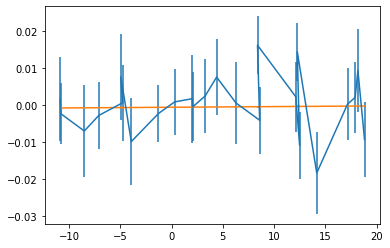

0.00002+/-0.00017


In [19]:
x = avgdata["nu_res_shift"].to_numpy()
y = avgdata["nu_z_shift"].to_numpy()
dy = avgdata["dnu_z"].to_numpy()
popt, pcov = np.polyfit(x, y, 1, w=dy, cov=True)
perr = np.sqrt(np.diag(pcov))
print(popt)
print(perr)

def lin(x, a, b):
    return a*x + b

plt.errorbar(x, y, dy)
plt.plot(x, lin(x, popt[0], popt[1]))
plt.show()

print(ufloat(popt[0], perr[0]))

In [20]:
fitdata3["masked"] = False
nu_z_guess = fitdata3["nu_z"].mean()
print(nu_z_guess)
fitdata3 = filtering.minmax_value(fitdata3, val="dnu_z", min_val=0, max_val=1)
halfspan = 0.2
fitdata3 = filtering.minmax_value(fitdata3, val="nu_z", min_val=nu_z_guess - halfspan, max_val=nu_z_guess + halfspan)
fitdata3 = filtering.minmax_value(fitdata3, val="dip_width", min_val=0.1, max_val=50)

filtered_data = fitdata3[fitdata3["masked"] == False]
filtered_data = filtered_data[filtered_data["cycle"] < 1e6]
print(len(fitdata2))
print(len(filtered_data))

472036.9479860182
filtered min max nu_z 9
573
965


In [21]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()


print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()


print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="cycle", y="nu_res", error_y="dnu_res", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()



print(" >>> AXIAL DATA >>> ")
fig = px.line(filtered_data, x="time", y="nu_res", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


 >>> AXIAL DATA >>> 


In [22]:
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_data, x="nu_res", y="nu_z", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


In [23]:
filtered_subed = pd.DataFrame()
for cyc, grp in filtered_data.groupby("cycle"):

    grp["nu_z"] -= grp["nu_z"].mean()
    filtered_subed = filtered_subed.append(grp, ignore_index=True)
    
print(" >>> AXIAL DATA >>> ")
fig = px.scatter(filtered_subed, x="cycle", y="nu_z", error_y="dnu_z", color="dUvar", hover_data=['dip_width', 'dnu_z'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

 >>> AXIAL DATA >>> 


In [24]:
avgdata = pd.DataFrame()

avgdata = statistics.average_subsets(filtered_data, groupby=["dUvar"], errortype="stderror", columns=["nu_z", "nu_res"], dcolumns=["dnu_z", "dnu_res"], masked=True)
avgdatasub = statistics.average_subsets(filtered_subed, groupby=["dUvar"], errortype="weighted", columns=["nu_z", "nu_res"], dcolumns=["dnu_z", "dnu_res"], masked=True)

In [25]:
print(" >>> AXIAL DATA >>> ")
display(avgdata)
fig = px.scatter(avgdata, x="nu_res", y="nu_z", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


,Q,cycle,dQ,dUvar,ddip_width,dip_width,dnu_res,dnu_z,fit_success,masked,nu_res,nu_z,time,trap
0,13751.073204495737,1.0,2112.100238548923,-0.012,0.662459696892,31.832850352572,0.061700687134,0.008170351719,3.913413138380,0.0,472015.988556414726,472036.904544287769,2022-05-15 01:14:53.514701,3.0
1,13732.922530445272,1.0,2060.315781588495,-0.011,0.644105367079,30.844170182340,0.084501305791,0.012277422039,3.863805505482,0.0,472017.737966801273,472036.908706808521,2022-05-15 01:21:24.562771,3.0
2,13734.053932831219,1.0,2083.937652307650,-0.010,0.631485526024,30.498656574284,0.074602617076,0.010522295160,3.817083385910,0.0,472019.442130161158,472036.930761250260,2022-05-15 01:17:29.937991,3.0
3,13717.329118797461,1.0,2085.982838914504,-0.009,0.687236344275,30.991203163621,0.072177848506,0.010606886803,4.486519902710,0.0,472021.590610918647,472036.915039117623,2022-05-15 01:09:40.355414,3.0
4,13734.890790700820,1.0,2108.570114000926,-0.008,0.656078715993,31.390747474066,0.065177156260,0.011497300438,4.053668090515,0.0,472023.421504833968,472036.919215525908,2022-05-15 01:24:00.974330,3.0
5,13726.555104360630,1.0,2104.156326289727,-0.007,0.650213542489,31.025123078979,0.066875652783,0.013276532229,4.066676072281,0.0,472025.401843743923,472036.927582190314,2022-05-15 01:39:39.272300,3.0
6,13820.352585519879,1.0,2139.411021021347,-0.006,0.619121451093,30.871431728670,0.055201425419,0.012103671381,3.742105675826,0.0,472027.467273469083,472036.937778300897,2022-05-15 01:34:26.527604,3.0
7,13766.475614045228,1.0,2127.096905230715,-0.005,0.670204417095,31.760026002382,0.077025986764,0.012428004795,4.272164695620,0.0,472029.292447626416,472036.929948486388,2022-05-15 01:22:42.755989,3.0
8,13728.509405753097,1.0,1974.710851593810,-0.004,0.654539610915,29.901736388841,0.069964087953,0.010886581909,4.360491217554,0.0,472031.266020530718,472036.943805067684,2022-05-15 01:29:13.760617,3.0
9,13710.364448696982,1.0,2022.578141907294,-0.003,0.673052590467,31.199342821168,0.081307432294,0.012276390957,4.414312304325,0.0,472033.201470536238,472036.940944062662,2022-05-15 01:35:44.711825,3.0


In [26]:
avgdata["nu_res_shift"] = avgdata["nu_res"] - filtered_data["nu_z"].mean()
avgdata["nu_z_shift"] = avgdata["nu_z"] - avgdata["nu_z"].mean()

print(" >>> AXIAL DATA >>> ")
fig = px.scatter(avgdata, x="nu_res_shift", y="nu_z_shift", error_y="dnu_z", error_x="dnu_res")
fig.show()

 >>> AXIAL DATA >>> 


[ 0.001650793666 -0.002182250708]
[0.00013334872  0.001689840409]


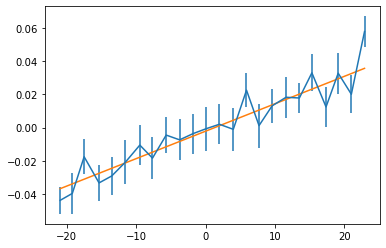

0.00165+/-0.00013


In [27]:
x = avgdata["nu_res_shift"].to_numpy()
y = avgdata["nu_z_shift"].to_numpy()
dy = avgdata["dnu_z"].to_numpy()
popt, pcov = np.polyfit(x, y, 1, w=dy, cov=True)
perr = np.sqrt(np.diag(pcov))
print(popt)
print(perr)

def lin(x, a, b):
    return a*x + b

plt.errorbar(x, y, dy)
plt.plot(x, lin(x, popt[0], popt[1]))
plt.show()

slope = ufloat(popt[0], perr[0]) 
print(slope)

In [28]:
impact = meas_config['traps'][3]['nu_z']/meas_config['traps'][3]['nu_p']*slope
print(impact)
print(impact/meas_config['traps'][3]['nu_p'] )

(2.97+/-0.24)e-05
(1.13+/-0.09)e-12
